In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LinearRegression
r import RandomForestRegressor, GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, StackingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
import math
from scipy.stats import skew
from catboost import CatBoostRegressor
import statsmodels.api as sm
from sklearn.metrics import r2_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from scipy.stats import bartlett
#import pingouin as pg
from scipy.stats import levene
import seaborn as sns
from scipy import stats
from scipy.special import boxcox1p
from scipy.special import boxcox

In [83]:
from sklearn.ensemble import StackingRegressor

In [2]:
scaler = StandardScaler()

In [3]:
df_house = pd.read_csv('C:/Users/thsong/df_house_wool_tmp2.csv')
df_house_extracted_wool = pd.read_csv('C:/Users/thsong/df_house_extracted_wool_tmp.csv')
df_house_test = pd.read_csv('C:/Users/thsong/Downloads/house-prices-advanced-regression-techniques/test.csv')
df_house_test_extracted = pd.read_csv('C:/Users/thsong/df_house_test_extracted_tmp.csv')

In [4]:
df_house.to_csv('C:/Users/thsong/df_house_wool_colab.csv')
df_house_extracted_wool.to_csv('C:/Users/thsong/df_house_extracted_wool_colab.csv')
df_house_test.to_csv('C:/Users/thsong/df_house_test_colab.csv')
df_house_test_extracted.to_csv('C:/Users/thsong/df_house_test_extracted_colab.csv')

In [7]:
df_house_extracted_wool = pd.read_csv('C:/Users/thsong/df_house_extracted_wool_tmp.csv')

In [6]:
df_house['SaleCondition_'] = 0
for i in range(len(df_house)):
    if df_house.SaleCondition.iloc[i] == 'Normal':
        df_house.SaleCondition_.iloc[i] = 1184
    elif df_house.SaleCondition.iloc[i] == 'Partial':
        df_house.SaleCondition_.iloc[i] = 122
    elif df_house.SaleCondition.iloc[i] == 'Abnorml':
        df_house.SaleCondition_.iloc[i] = 98
    elif df_house.SaleCondition.iloc[i] == 'Family':
        df_house.SaleCondition_.iloc[i] = 20
    elif df_house.SaleCondition.iloc[i] == 'Alloca':
        df_house.SaleCondition_.iloc[i] = 12
    elif df_house.SaleCondition.iloc[i] == 'AdjLand':
        df_house.SaleCondition_.iloc[i] = 4

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [14]:
df_house_test['SaleCondition_'] = 0
for i in range(len(df_house_test)):
    if df_house_test.SaleCondition.iloc[i] == 'Normal':
        df_house_test.SaleCondition_.iloc[i] = 1204
    elif df_house_test.SaleCondition.iloc[i] == 'Partial':
        df_house_test.SaleCondition_.iloc[i] = 120
    elif df_house_test.SaleCondition.iloc[i] == 'Abnorml':
        df_house_test.SaleCondition_.iloc[i] = 89
    elif df_house_test.SaleCondition.iloc[i] == 'Family':
        df_house_test.SaleCondition_.iloc[i] = 26
    elif df_house_test.SaleCondition.iloc[i] == 'Alloca':
        df_house_test.SaleCondition_.iloc[i] = 12
    elif df_house_test.SaleCondition.iloc[i] == 'AdjLand':
        df_house_test.SaleCondition_.iloc[i] = 8

In [10]:
######################################################################################
######################################################################################
#############    U S E R - D E F I N E D      F U N C T I O N S      #################
######################################################################################
######################################################################################
### define a fuction for printing RMSLE values of each regression model
def print_rmsle_values(model, X_train, X_test, y_train, y_test):
    model.fit(X_train,y_train)
    pred = model.predict(X_test)
    ### print and return RMSLE values of each model
    print('#'*5, model.__class__.__name__,'#'*5)
    # not to make nan values from np.log1p
    y_test_ = y_test - y_test.min() + 1
    # plug y_test_ into np.log1p
    log_y = np.log1p(y_test_)
    # not to make nan values from np.log1p
    pred_ = pred - pred.min() + 1
    # plug pred_ into np.log1p
    log_pred = np.log1p(pred_)
    # get squared error
    squared_error = (log_y - log_pred)**2 
    rmsle = np.sqrt(np.mean(squared_error))
    # print RMSLE value
    print('RMSLE : {}'.format(rmsle))
    # return RMSLE value
    return rmsle
###-------------------------------------------------------------------------------------------------
### define a function for printing best parameters for modeling
def print_best_params(model, params):
    grid_model = GridSearchCV(model, param_grid=params, scoring='neg_mean_squared_error', cv=5)
    grid_model.fit(X, y) # the same result as .fit(X_train,y_train)
    rmse = np.sqrt(-1*grid_model.best_score_)
    print('when the model {0} is taken with grid search cv = 5 the best avg rmse value is : {1}, and the best parameter is : {2}'.format(model.__class__.__name__, np.round(rmse,4), grid_model.best_params_))
###---------------------------------------------------------------------------------------------------
def print_best_params2(model, params):
    grid_model = GridSearchCV(model, param_grid=params, scoring='neg_mean_squared_error', cv=5)
    grid_model.fit(X, y) # the same result as .fit(X_train,y_train)
    rmse = np.sqrt(-1*grid_model.best_score_)
    print('when the model {0} is taken with grid search cv = 5 the best avg rmse value is : {1}, and the best parameter is : {2}'.format(model.__class__.__name__, np.round(rmse,4), grid_model.best_params_))
    
    return grid_model.best_params_
###------------------------------------------
# Ex : 5
# Gd : 4
# TA : 3
# Fa : 2
# Po : 1
def ordinal_encoder(col_name):
 
    str_col4orginal = col_name
    str_col4orginal_ = str_col4orginal + '_'
    df_house[str_col4orginal_] = 0
    #--------------------------------------
    for i in range(len(df_house)):
        if df_house[str_col4orginal].iloc[i] == 'TA':
            df_house[str_col4orginal_].iloc[i] = 3
        elif df_house[str_col4orginal].iloc[i] == 'Gd':
            df_house[str_col4orginal_].iloc[i] = 4
        elif df_house[str_col4orginal].iloc[i] == 'Ex':
            df_house[str_col4orginal_].iloc[i] = 5
        elif df_house[str_col4orginal].iloc[i] == 'Fa':
            df_house[str_col4orginal_].iloc[i] = 2  
        elif df_house[str_col4orginal].iloc[i] == 'Po':
            df_house[str_col4orginal_].iloc[i] = 1      
###-------------------------------------------------------------------
# Ex : 5
# Gd : 4
# TA : 3
# Fa : 2
# Po : 1
def ordinal_encoder2(col_name):
 
    str_col4orginal = col_name
    str_col4orginal_ = str_col4orginal + '_'
    df_house_test[str_col4orginal_] = 0
    #--------------------------------------
    for i in range(len(df_house_test)):
        if df_house_test[str_col4orginal].iloc[i] == 'TA':
            df_house_test[str_col4orginal_].iloc[i] = 3
        elif df_house_test[str_col4orginal].iloc[i] == 'Gd':
            df_house_test[str_col4orginal_].iloc[i] = 4
        elif df_house_test[str_col4orginal].iloc[i] == 'Ex':
            df_house_test[str_col4orginal_].iloc[i] = 5
        elif df_house_test[str_col4orginal].iloc[i] == 'Fa':
            df_house_test[str_col4orginal_].iloc[i] = 2  
        elif df_house_test[str_col4orginal].iloc[i] == 'Po':
            df_house_test[str_col4orginal_].iloc[i] = 1      

In [11]:
# ordinary linear regression model
line_fitter_tmp = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter_tmp = Ridge(alpha=54)
lasso_fitter_tmp = Lasso(alpha=0.001)
elasticNet_fitter_tmp = ElasticNet(alpha = 0.02, l1_ratio=0.05)
# ensemble models
xgb_fitter_tmp = XGBRegressor(n_estimators=50)
gbm_fitter_tmp = GradientBoostingRegressor(n_estimators=168)
rf_fitter_tmp = RandomForestRegressor(n_estimators=161)
lgbm_fitter_tmp = LGBMRegressor(n_estimators=121)
bg_fitter_tmp = BaggingRegressor(n_estimators=132)
et_fitter_tmp = ExtraTreesRegressor(n_estimators=133)

In [13]:
cat_fitter_tmp = CatBoostRegressor()
from sklearn.svm import SVR
# most important SVR parameter is Kernel type. It can be #linear,polynomial or gaussian SVR. We have a non-linear condition #so we can select polynomial or gaussian but here we select RBF(a #gaussian type) kernel.
svr_fitter = SVR(kernel='rbf')
#regressor.fit(X,y)

In [9]:
df_house_extracted_wool.columns

Index(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SalePrice', 'MSSubClass(scaled)',
       'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
       'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
       'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
       'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled

In [402]:
df_house_extracted_wool.corr()

,MSSubClass,MSZoning_,LotFrontage,LotArea,LotShape_,LotConfig_,Neighborhood_,HouseStyle_,OverallQual,OverallCond,...,Garage_Age(scaled),GarageFinish_(scaled),GarageCars(scaled),GarageArea(scaled),WoodDeckSF(scaled),OpenPorchSF(scaled),Exterior_Avg(scaled),SalePrice(log),SalePrice(log_stdz),SalePrice(log_mm)
MSSubClass,1.000000,-0.344093,-0.379111,-0.287624,0.116768,0.067271,-0.265488,-0.388877,0.034106,-0.060820,...,-0.102384,-0.060388,-0.042557,-0.103296,-0.026926,0.000803,-0.077400,-0.077423,-0.077423,-0.077423
MSZoning_,-0.344093,1.000000,0.327605,0.331763,-0.235270,-0.096727,0.176472,0.181696,0.117313,-0.052801,...,-0.079152,-0.070599,0.161950,0.155865,0.172630,-0.029458,0.075135,0.288971,0.288971,0.288971
LotFrontage,-0.379111,0.327605,1.000000,0.407580,-0.153438,-0.116685,0.155036,0.097072,0.204974,-0.047586,...,-0.024006,-0.070775,0.270919,0.298713,0.069126,0.112300,0.103383,0.337698,0.337698,0.337698
LotArea,-0.287624,0.331763,0.407580,1.000000,-0.331237,-0.180177,-0.015920,0.051078,0.135880,-0.013673,...,0.046454,0.007222,0.243578,0.268672,0.197000,0.132868,-0.005554,0.350231,0.350231,0.350231
LotShape_,0.116768,-0.235270,-0.153438,-0.331237,1.000000,0.280556,0.065860,-0.053699,-0.189730,0.025319,...,0.172291,0.094970,-0.191890,-0.159759,-0.168086,-0.110217,-0.106165,-0.283591,-0.283591,-0.283591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
OpenPorchSF(scaled),0.000803,-0.029458,0.112300,0.132868,-0.110217,-0.068293,-0.066081,0.025435,0.318172,-0.046061,...,-0.223288,-0.129770,0.235567,0.249303,0.067088,1.000000,0.188926,0.361345,0.361345,0.361345
Exterior_Avg(scaled),-0.077400,0.075135,0.103383,-0.005554,-0.106165,-0.003726,0.000891,0.113835,0.329538,-0.163584,...,-0.456945,-0.173607,0.298035,0.269583,0.083678,0.188926,1.000000,0.318213,0.318213,0.318213
SalePrice(log),-0.077423,0.288971,0.337698,0.350231,-0.283591,-0.085081,-0.151312,0.081252,0.819985,-0.040371,...,-0.408457,-0.138252,0.678743,0.652281,0.331597,0.361345,0.318213,1.000000,1.000000,1.000000
SalePrice(log_stdz),-0.077423,0.288971,0.337698,0.350231,-0.283591,-0.085081,-0.151312,0.081252,0.819985,-0.040371,...,-0.408457,-0.138252,0.678743,0.652281,0.331597,0.361345,0.318213,1.000000,1.000000,1.000000


In [403]:
df_house_extracted_wool_corr = df_house_extracted_wool.corr()

In [404]:
df_house_extracted_wool_corr.iloc[0,:]

MSSubClass              1.000000
MSZoning_              -0.344093
LotFrontage            -0.379111
LotArea                -0.287624
LotShape_               0.116768
                          ...   
OpenPorchSF(scaled)     0.000803
Exterior_Avg(scaled)   -0.077400
SalePrice(log)         -0.077423
SalePrice(log_stdz)    -0.077423
SalePrice(log_mm)      -0.077423
Name: MSSubClass, Length: 88, dtype: float64

In [408]:
df_house_extracted_wool_corr.iloc[0,0:43]

MSSubClass       1.000000
MSZoning_       -0.344093
LotFrontage     -0.379111
LotArea         -0.287624
LotShape_        0.116768
LotConfig_       0.067271
Neighborhood_   -0.265488
HouseStyle_     -0.388877
OverallQual      0.034106
OverallCond     -0.060820
RoofStyle_       0.126678
MasVnrType_      0.051479
MasVnrArea       0.025829
ExterQual_       0.017600
Foundation_     -0.023635
BsmtQual_        0.052678
BsmtExposure_   -0.060633
BsmtFinType1_    0.107422
BsmtFinSF1      -0.077364
BsmtUnfSF       -0.141913
TotalBsmtSF     -0.256904
HeatingQC_      -0.024540
1stFlrSF        -0.268443
2ndFlrSF         0.311862
GrLivArea        0.075160
BsmtFullBath     0.000297
FullBath         0.128028
HalfBath         0.179582
BedroomAbvGr    -0.031712
KitchenQual_    -0.011422
TotRmsAbvGrd     0.034206
Fireplaces      -0.050450
FireplaceQu_    -0.043574
GarageType_     -0.173800
House_Age       -0.043239
Garage_Age      -0.102384
GarageFinish_   -0.060388
GarageCars      -0.042557
GarageArea  

In [410]:
row0_data_tst = df_house_extracted_wool_corr.iloc[0,0:43].tolist()

In [411]:
row0_data_tst

[1.0,
 -0.344092792750307,
 -0.37911078263785697,
 -0.28762351452263596,
 0.11676753512157817,
 0.06727128087792215,
 -0.2654878563568115,
 -0.38887745566651727,
 0.034105581919242074,
 -0.060820226315497675,
 0.12667831758047043,
 0.051479236280677396,
 0.025828910156162288,
 0.017599879220291513,
 -0.023634672300511184,
 0.05267846900046402,
 -0.060632571850050394,
 0.10742223881065262,
 -0.07736431604368098,
 -0.14191294687250178,
 -0.25690395976079755,
 -0.024540146803587654,
 -0.2684427291669265,
 0.31186199665174297,
 0.07516022208370679,
 0.0002968162278661259,
 0.12802827115841403,
 0.17958176439526188,
 -0.031712261184146925,
 -0.011421769451473532,
 0.034205544338528175,
 -0.050449975063746426,
 -0.04357410789138163,
 -0.17379985995658837,
 -0.043238906500655,
 -0.1023840871660051,
 -0.0603881752280337,
 -0.042556939908281216,
 -0.1032959320339941,
 -0.026926160971242553,
 0.0008034264851674272,
 -0.07740027096146417,
 -0.08954665700313053]

In [412]:
tolerance_bag = []
for i in range(len(row0_data_tst)):
    tol_tst = 1 - row0_data_tst[i] ** 2
    tolerance_bag.append(tol_tst)

In [413]:
tolerance_bag

[0.0,
 0.8816001499772943,
 0.8562750144877116,
 0.9172727138936471,
 0.986365342741631,
 0.9954745747690437,
 0.929516198127065,
 0.8487743244743359,
 0.9988368092819498,
 0.9963009000709316,
 0.9839526038549815,
 0.9973498882319581,
 0.9993328674001449,
 0.9996902442514312,
 0.9994414022652475,
 0.9972249789037672,
 0.9963236912308485,
 0.9884604626089071,
 0.9940147626030934,
 0.9798607155099625,
 0.9340003554592226,
 0.9993977811948583,
 0.9279385011574122,
 0.9027420950443883,
 0.9943509410163279,
 0.9999999119001268,
 0.9836087617841877,
 0.9677503898966846,
 0.9989943324905884,
 0.9998695431825974,
 0.998829980736505,
 0.9974548000160673,
 0.9981012971214702,
 0.9697936086790703,
 0.9981303969646276,
 0.9895174986951839,
 0.9963532682926283,
 0.998188906865643,
 0.9893299504252284,
 0.9992749818553507,
 0.999999354505883,
 0.9940091980550919,
 0.9919813962195637]

In [405]:
df_house_extracted_wool_corr.iloc[0,0:50]

MSSubClass               1.000000
MSZoning_               -0.344093
LotFrontage             -0.379111
LotArea                 -0.287624
LotShape_                0.116768
LotConfig_               0.067271
Neighborhood_           -0.265488
HouseStyle_             -0.388877
OverallQual              0.034106
OverallCond             -0.060820
RoofStyle_               0.126678
MasVnrType_              0.051479
MasVnrArea               0.025829
ExterQual_               0.017600
Foundation_             -0.023635
BsmtQual_                0.052678
BsmtExposure_           -0.060633
BsmtFinType1_            0.107422
BsmtFinSF1              -0.077364
BsmtUnfSF               -0.141913
TotalBsmtSF             -0.256904
HeatingQC_              -0.024540
1stFlrSF                -0.268443
2ndFlrSF                 0.311862
GrLivArea                0.075160
BsmtFullBath             0.000297
FullBath                 0.128028
HalfBath                 0.179582
BedroomAbvGr            -0.031712
KitchenQual_  

In [406]:
df_house_extracted_wool_corr.iloc[0,50:]

HouseStyle_(scaled)     -0.388877
OverallQual(scaled)      0.034106
OverallCond(scaled)     -0.060820
RoofStyle_(scaled)       0.126678
MasVnrType_(scaled)      0.051479
MasVnrArea(scaled)       0.025829
ExterQual_(scaled)       0.017600
Foundation_(scaled)     -0.023635
BsmtQual_(scaled)        0.052678
BsmtExposure_(scaled)   -0.060633
BsmtFinType1_(scaled)    0.107422
BsmtFinSF1(scaled)      -0.077364
BsmtUnfSF(scaled)       -0.141913
TotalBsmtSF(scaled)     -0.256904
HeatingQC_(scaled)      -0.024540
1stFlrSF(scaled)        -0.268443
2ndFlrSF(scaled)         0.311862
GrLivArea(scaled)        0.075160
BsmtFullBath(scaled)     0.000297
FullBath(scaled)         0.128028
HalfBath(scaled)         0.179582
BedroomAbvGr(scaled)    -0.031712
KitchenQual_(scaled)    -0.011422
TotRmsAbvGrd(scaled)     0.034206
Fireplaces(scaled)      -0.050450
FireplaceQu_(scaled)    -0.043574
GarageType_(scaled)     -0.173800
House_Age(scaled)       -0.043239
Garage_Age(scaled)      -0.102384
GarageFinish_(

In [15]:
skew_features = df_house_extracted_wool.apply(lambda x : skew(x))

In [16]:
df_house.SaleCondition_.value_counts()

1184    1184
122      122
98        98
20        20
12        12
4          4
Name: SaleCondition_, dtype: int64

In [17]:
MSSubClass_tmp = (df_house['MSSubClass'] - df_house['MSSubClass'].mean())/df_house['MSSubClass'].std()
LotFrontage_tmp = (df_house['LotFrontage'] - df_house['LotFrontage'].mean())/df_house['LotFrontage'].std()
LotArea_tmp = (df_house['LotArea'] - df_house['LotArea'].mean())/df_house['LotArea'].std()
MasVnrArea_tmp = (df_house['MasVnrArea'] - df_house['MasVnrArea'].mean())/df_house['MasVnrArea'].std()
BsmtUnfSF_tmp = (df_house['BsmtUnfSF'] - df_house['BsmtUnfSF'].mean())/df_house['BsmtUnfSF'].std()
lstFlrSF_tmp = (df_house['1stFlrSF'] - df_house['1stFlrSF'].mean())/df_house['1stFlrSF'].std()
SndFlrSF_tmp = (df_house['2ndFlrSF'] - df_house['2ndFlrSF'].mean())/df_house['2ndFlrSF'].std()
GrLivArea_tmp = (df_house['GrLivArea'] - df_house['GrLivArea'].mean())/df_house['GrLivArea'].std()
WoodDeckSF_tmp = (df_house['WoodDeckSF'] - df_house['WoodDeckSF'].mean())/df_house['WoodDeckSF'].std()
OpenPorchSF_tmp = (df_house['OpenPorchSF'] - df_house['OpenPorchSF'].mean())/df_house['OpenPorchSF'].std()

In [18]:
# mssubclass_abs_larg3 = MSSubClass_tmp[MSSubClass_tmp>3]
lotfrontage_abs_larg11 = LotFrontage_tmp[LotFrontage_tmp>11]
lotarea_abs_larg8 = LotArea_tmp[LotArea_tmp>8]
masvnrarea_abs_larg6 = MasVnrArea_tmp[MasVnrArea_tmp>6]
#bsmtunfsf_abs_larg3 = BsmtUnfSF_tmp[BsmtUnfSF_tmp>3]
lstflrsf_abs_larg5 = lstFlrSF_tmp[lstFlrSF_tmp>5]
# Sndflrsf_abs_larg3 = SndFlrSF_tmp[SndFlrSF_tmp>3]
#grlivarea_abs_larg3 = GrLivArea_tmp[GrLivArea_tmp>3]
#woodeck_abs_larg3 = WoodDeckSF_tmp[WoodDeckSF_tmp>3]
#openporchsf_abs_larg3 = OpenPorchSF_tmp[OpenPorchSF_tmp>3]

In [19]:
idx_lotfrontage_abs_larg11 = lotfrontage_abs_larg11.index
idx_lotarea_abs_larg8 = lotarea_abs_larg8.index
idx_masvnrarea_abs_larg6 = masvnrarea_abs_larg6.index
idx_1stflrsf_abs_larg5 = lstflrsf_abs_larg5.index

In [20]:
idx_bag2 = []
for idx_outlier in [idx_lotfrontage_abs_larg11,idx_lotarea_abs_larg8,idx_masvnrarea_abs_larg6,idx_1stflrsf_abs_larg5]:
    for j in range(len(idx_outlier)):
        idx_bag2.append(idx_outlier[j])

idx_outlier_total_set2 = set(idx_bag2)
idx_outlier_total_lst2 = list(sorted(idx_outlier_total_set2))

In [21]:
df_house4 = df_house.loc[~df_house.index.isin(idx_outlier_total_lst2)]

In [27]:
df_house4.to_csv('C:/Users/thsong/df_house4_organized.csv')

In [22]:
df_house_extracted10 = df_house4[['MSSubClass','MSZoning_','LotFrontage','LotArea','LotShape_','LotConfig_','Neighborhood_',
          'HouseStyle_','OverallQual','OverallCond','RoofStyle_','MasVnrType_','MasVnrArea','ExterQual_','Foundation_','BsmtQual_',
          'BsmtExposure_','BsmtFinType1_','BsmtFinSF1','BsmtUnfSF','TotalBsmtSF','HeatingQC_','1stFlrSF','2ndFlrSF',
          'GrLivArea','BsmtFullBath','FullBath','HalfBath','BedroomAbvGr','KitchenQual_','TotRmsAbvGrd','Fireplaces','FireplaceQu_',
          'GarageType_','House_Age','Garage_Age','GarageFinish_','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','Exterior_Avg',
        'SaleCondition_',
          'SalePrice']]

##================================================================
col_lst = [
    'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg','SaleCondition_'
]
#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted10[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted10[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted10['SalePrice'])
df_house_extracted10['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted10[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

###---------------------------------
for i in range(len(col_lst_bxcx)):
    
    # initialization of columns for containing box-cox transformed data
    col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
    df_house_extracted10[col_lst_bxcx_] = 0
    
    # if data contains 0, convert it into positive value close to 0
    if len(df_house_extracted10[df_house_extracted10[col_lst_bxcx[i]]==0]) != 0:
        df_house_extracted10[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
    #-----------------------------------------------------------------------
    
    # box-cox transform
    data4bxcx = df_house_extracted10[col_lst_bxcx[i]]
    y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
    print('optimal lambda : {}'.format(lambda_optimal))
    ### box cox instead of boxcox1p
    y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
    # contain the transformed data
    df_house_extracted10[col_lst_bxcx_] = y_boxcox


###======================================================================================
X = df_house_extracted10[[
        'MSSubClass(scaled)',
        'MasVnrArea(scaled)','BsmtFinSF1(scaled)','BsmtUnfSF(scaled)', '2ndFlrSF(scaled)', 'BsmtFullBath(scaled)',
        'FullBath(scaled)', 'HalfBath(scaled)','Fireplaces(scaled)','WoodDeckSF(scaled)','OpenPorchSF(scaled)', 
        
        'House_Age(bxcx)','Garage_Age(bxcx)','Exterior_Avg(bxcx)',
    
    
       'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
       'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
       'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
       'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 
       'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
       'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 
       'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
       '1stFlrSF(scaled)', 'GrLivArea(scaled)',
        
       'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
        'FireplaceQu_(scaled)', 'GarageType_(scaled)',
       'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 
        'SaleCondition_(scaled)']]
y = df_house_extracted10['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

optimal lambda : -0.20996610068260413
optimal lambda : -0.08138632154540422
optimal lambda : 0.13047424659363616
optimal lambda : 0.36608618437691565
optimal lambda : -0.054893454861850884
optimal lambda : -0.12056429321320777
optimal lambda : 0.7830082499553019
optimal lambda : -0.17627524806041173
optimal lambda : 0.2526524036312396
optimal lambda : 0.02338796791302583
optimal lambda : 0.32054142033937727
optimal lambda : 0.3076403559539743
optimal lambda : -0.022551633683577224
optimal lambda : 0.0343905301555856
optimal lambda : 0.5494405759026996


C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3307006616.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted10[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3307006616.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted10[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3307006616.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [23]:
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params(et_fitter_tmp,candidate_params)
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1256, and the best parameter is : {'alpha': 47}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1257, and the best parameter is : {'alpha': 0.0006000000000000001}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.204e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.591e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.017e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.888e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.147e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.539e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1255, and the best parameter is : {'alpha': 0.02, 'l1_ratio': 0.04}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.137, and the best parameter is : {'n_estimators': 76}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1219, and the best parameter is : {'n_estimators': 169}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1354, and the best parameter is : {'n_estimators': 136}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1263, and the best parameter is : {'n_estimators': 78}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1351, and the best parameter is : {'n_estimators': 119}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best a

In [24]:
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=47)
lasso_fitter = Lasso(alpha=0.0006)
elasticNet_fitter = ElasticNet(alpha = 0.02, l1_ratio=0.04)
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=76)
gbm_fitter = GradientBoostingRegressor(n_estimators=169)
rf_fitter = RandomForestRegressor(n_estimators=136)
lgbm_fitter = LGBMRegressor(n_estimators=78)
bg_fitter = BaggingRegressor(n_estimators=119)
et_fitter = ExtraTreesRegressor(n_estimators=126)

### Print RMSLE values using the user-defined function above
dict_rmse = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmse_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmse[str(model)] = rmse_value
### Sort RMSLE values with ascending order
{k: v for k, v in sorted(dict_rmse.items(), key=lambda item: item[1])}

##### LinearRegression #####
RMSLE : 0.19637292897098202
##### Ridge #####
RMSLE : 0.20281315920258405
##### Lasso #####
RMSLE : 0.19696759719692117
##### ElasticNet #####
RMSLE : 0.20101559706341396
##### XGBRegressor #####
RMSLE : 0.18377293373796535
##### GradientBoostingRegressor #####
RMSLE : 0.17709407285070172
##### RandomForestRegressor #####
RMSLE : 0.18593914189311656
##### LGBMRegressor #####
RMSLE : 0.16910256783705024
##### BaggingRegressor #####
RMSLE : 0.185671454844382
##### ExtraTreesRegressor #####
RMSLE : 0.19389007785973528


{'LGBMRegressor(n_estimators=78)': 0.16910256783705024,
 'GradientBoostingRegressor(n_estimators=169)': 0.17709407285070172,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=76, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.18377293373796535,
 'BaggingRegressor(n_estimators=119)': 0.185671454844382,
 'RandomForestRegressor(n_estimators=136)': 0.18593914189311656,
 'ExtraTreesRegressor(n_estima

In [26]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_']]],axis=1)
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg','SaleCondition_'
] 
#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================


col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

###---------------------------------
for i in range(len(col_lst_bxcx)):
    
    # initialization of columns for containing box-cox transformed data
    col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
    df_house_test_extracted_[col_lst_bxcx_] = 0
    
    # if data contains 0, convert it into positive value close to 0
    if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
        df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
    #-----------------------------------------------------------------------
    
    # box-cox transform
    data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
    y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
    print('optimal lambda : {}'.format(lambda_optimal))
    ### box cox instead of boxcox1p
    y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
    # contain the transformed data
    df_house_test_extracted_[col_lst_bxcx_] = y_boxcox


###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
    
        'MSSubClass(scaled)',
        'MasVnrArea(scaled)', 'BsmtFinSF1(scaled)',
        'BsmtUnfSF(scaled)', '2ndFlrSF(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)', 
        'HalfBath(scaled)','Fireplaces(scaled)', 'WoodDeckSF(scaled)','OpenPorchSF(scaled)', 
   
        'House_Age(bxcx)','Garage_Age(bxcx)','Exterior_Avg(bxcx)',

       'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
       'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
       'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
       'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 
       'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
       'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
       '1stFlrSF(scaled)', 'GrLivArea(scaled)',
       
       'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
       'FireplaceQu_(scaled)', 'GarageType_(scaled)',
       'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 
       'SaleCondition_(scaled)' 
]]
### 'MasVnrArea(scaled)', 'BsmtFinSF1(scaled)',
### 'BsmtUnfSF(scaled)', '2ndFlrSF(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)', 
### 'HalfBath(scaled)','Fireplaces(scaled)', 'WoodDeckSF(scaled)','OpenPorchSF(scaled)', 
### 'House_Age(scaled)', 'Garage_Age(scaled)', 'Exterior_Avg(scaled)',
#  'MSSubClass(bxcx)','MasVnrArea(bxcx)','BsmtFinSF1(bxcx)',
#         'BsmtUnfSF(bxcx)','2ndFlrSF(bxcx)','BsmtFullBath(bxcx)','FullBath(bxcx)','HalfBath(bxcx)','Fireplaces(bxcx)',
#         'WoodDeckSF(bxcx)','OpenPorchSF(bxcx)',
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission13_6_2.csv',index=False)
df_house_test[['Id','SalePrice']]

optimal lambda : -0.21012855746741063
optimal lambda : -0.09630378304187932
optimal lambda : 0.13453068774842292
optimal lambda : 0.36067123882508634
optimal lambda : -0.05808223333409935
optimal lambda : -0.11015370297763621
optimal lambda : 0.6230506927982926
optimal lambda : -0.17827610696275192
optimal lambda : -0.031966167433352066
optimal lambda : -0.0020056713226048128
optimal lambda : 0.3262021704740391
optimal lambda : 0.3694310831814935
optimal lambda : -0.020408017378766654
optimal lambda : 0.04697273301264018
optimal lambda : 0.5385509583048569


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,124656.725177
1,1462,156423.424017
2,1463,181168.240634
3,1464,181696.609475
4,1465,198270.568273
...,...,...
1454,2915,72982.836884
1455,2916,79457.856074
1456,2917,166109.888466
1457,2918,115713.590787


### Hard tuning

In [80]:
ridge_fitter = Ridge(alpha=47)
lasso_fitter = Lasso(alpha=0.0005, selection='random')
elasticNet_fitter = ElasticNet(alpha = 0.02, l1_ratio=0.04)
###-------------------------------------------------------------
xgb_fitter = XGBRegressor(n_estimators=79, learning_rate=0.118)
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.6,max_depth=3,min_samples_split=3,random_state=42)
rf_fitter = RandomForestRegressor(n_estimators=144,max_depth=47)
###-------------------------------------------------------------------
lgbm_fitter = LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17,random_state = 42)
bg_fitter = BaggingRegressor(n_estimators=119, random_state=42)
et_fitter = ExtraTreesRegressor(n_estimators=126,min_samples_split=5,random_state=42)
###------------------------------------------------------
cat_fitter = CatBoostRegressor(n_estimators=139,random_state=42)
svr_fitter = SVR(degree=1,epsilon=0.009)

In [110]:
###########
#### worse than '-er' models ### I learned that using random_state many times was not always good; especially on random forest models
###########
ridge_fitter2 = Ridge(alpha=47,random_state=42)
lasso_fitter2 = Lasso(alpha=0.0005, selection='random',random_state=42)
elasticNet_fitter2 = ElasticNet(alpha = 0.02, l1_ratio=0.04,random_state=42)
###-------------------------------------------------------------
xgb_fitter2 = XGBRegressor(n_estimators=79, learning_rate=0.118,random_state=42)
gbm_fitter2 = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.6,max_depth=3,min_samples_split=3,random_state=42)
rf_fitter2 = RandomForestRegressor(n_estimators=144,max_depth=47,random_state=42)
###-------------------------------------------------------------------
lgbm_fitter2 = LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17,random_state = 42)
bg_fitter2 = BaggingRegressor(n_estimators=119, random_state=42)
et_fitter2 = ExtraTreesRegressor(n_estimators=126,min_samples_split=5,random_state=42)
###------------------------------------------------------
cat_fitter2 = CatBoostRegressor(n_estimators=139,random_state=42)
svr_fitter2 = SVR(degree=1,epsilon=0.009)

In [116]:
############
### this one was never submitted, but not much different from '-er2' models
###########
ridge_fitter3 = Ridge(alpha=47)
lasso_fitter3 = Lasso(alpha=0.0005, selection='random')
elasticNet_fitter3 = ElasticNet(alpha = 0.02, l1_ratio=0.04)
###-------------------------------------------------------------
xgb_fitter3 = XGBRegressor(n_estimators=79, learning_rate=0.118,random_state=42)
gbm_fitter3 = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.6,max_depth=3,min_samples_split=3,random_state=42)
rf_fitter3 = RandomForestRegressor(n_estimators=144,max_depth=47,random_state=42)
###-------------------------------------------------------------------
lgbm_fitter3 = LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17,random_state = 42)
bg_fitter3 = BaggingRegressor(n_estimators=119, random_state=42)
et_fitter3 = ExtraTreesRegressor(n_estimators=126,min_samples_split=5,random_state=42)
###------------------------------------------------------
cat_fitter3 = CatBoostRegressor(n_estimators=139,random_state=42)
svr_fitter3 = SVR(degree=1,epsilon=0.009)

In [81]:
### Print RMSLE values using the user-defined function above
dict_rmse = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter,cat_fitter,svr_fitter]:
    rmse_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmse[str(model)] = rmse_value
### Sort RMSLE values with ascending order
{k: v for k, v in sorted(dict_rmse.items(), key=lambda item: item[1])}

##### LinearRegression #####
RMSLE : 0.19637292897098202
##### Ridge #####
RMSLE : 0.20281315920258405
##### Lasso #####
RMSLE : 0.19695648016752618
##### ElasticNet #####
RMSLE : 0.20101559706341396
##### XGBRegressor #####
RMSLE : 0.15434585892303906
##### GradientBoostingRegressor #####
RMSLE : 0.16484210180434783
##### RandomForestRegressor #####
RMSLE : 0.19612629795982892
##### LGBMRegressor #####
RMSLE : 0.15405797657502762


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### BaggingRegressor #####
RMSLE : 0.21656032479629822
##### ExtraTreesRegressor #####
RMSLE : 0.1960876825485263
Learning rate set to 0.208065
0:	learn: 0.3324752	total: 2.5ms	remaining: 346ms
1:	learn: 0.2907625	total: 4.69ms	remaining: 321ms
2:	learn: 0.2609340	total: 6.72ms	remaining: 305ms
3:	learn: 0.2324442	total: 8.75ms	remaining: 295ms
4:	learn: 0.2098803	total: 10.9ms	remaining: 293ms
5:	learn: 0.1900279	total: 13ms	remaining: 288ms
6:	learn: 0.1757109	total: 15ms	remaining: 283ms
7:	learn: 0.1663611	total: 17.2ms	remaining: 281ms
8:	learn: 0.1561352	total: 19.3ms	remaining: 279ms
9:	learn: 0.1481667	total: 21.5ms	remaining: 277ms
10:	learn: 0.1422728	total: 23.5ms	remaining: 273ms
11:	learn: 0.1373649	total: 25.5ms	remaining: 270ms
12:	learn: 0.1325752	total: 27.7ms	remaining: 268ms
13:	learn: 0.1288453	total: 29.6ms	remaining: 265ms
14:	learn: 0.1257957	total: 31.7ms	remaining: 262ms
15:	learn: 0.1228426	total: 33.9ms	remaining: 260ms
16:	learn: 0.1197531	total: 35.9ms	re

{'<catboost.core.CatBoostRegressor object at 0x000002C5F866A700>': 0.14758880979657452,
 'LGBMRegressor(learning_rate=0.09, max_depth=3, min_child_samples=17,\n              n_estimators=78, num_iterations=226, num_leaves=26,\n              random_state=42)': 0.15405797657502762,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.118, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=79, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.15434585892303906,
 "G

In [79]:
result_from_model = cat_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_5.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,112114.068459
1,1462,158117.421380
2,1463,177490.191310
3,1464,183641.281502
4,1465,177614.306332
...,...,...
1454,2915,82868.442632
1455,2916,86890.693375
1456,2917,175055.395095
1457,2918,115036.205722


In [82]:
result_from_model = cat_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_5_2.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,117247.331169
1,1462,150441.686017
2,1463,173028.799442
3,1464,196089.671765
4,1465,184973.700524
...,...,...
1454,2915,83087.973151
1455,2916,83809.031920
1456,2917,174097.683879
1457,2918,112926.878151


In [ ]:
'''ridge_fitter = Ridge(alpha=47)
lasso_fitter = Lasso(alpha=0.0006)
elasticNet_fitter = ElasticNet(alpha = 0.02, l1_ratio=0.04)
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=76)
gbm_fitter = GradientBoostingRegressor(n_estimators=169)
rf_fitter = RandomForestRegressor(n_estimators=136)
lgbm_fitter = LGBMRegressor(n_estimators=78)
bg_fitter = BaggingRegressor(n_estimators=119)
et_fitter = ExtraTreesRegressor(n_estimators=126)'''

In [76]:
candidate_params = {
      'degree':range(1,5),
    'epsilon':np.arange(0,0.1,0.001)
}
var11 = print_best_params(svr_fitter,candidate_params)

when the model SVR is taken with grid search cv = 5 the best avg rmse value is : 0.1249, and the best parameter is : {'degree': 1, 'epsilon': 0.009000000000000001}


In [75]:
candidate_params = {
      'degree':range(1,5),
    'epsilon':np.arange(0,0.1,0.01)
}
var11 = print_best_params(svr_fitter,candidate_params)

when the model SVR is taken with grid search cv = 5 the best avg rmse value is : 0.125, and the best parameter is : {'degree': 1, 'epsilon': 0.01}


In [74]:
candidate_params = {
        'degree':range(1,5),
        'gamma':['scale','auto']
}
#   'kernel':['linear','poly','rbf','sigmoid','precomputed']
#'degree':range(1,5),
#    'gamma':['scale','auto'],
#    'epsilon':np.arange(0,0.1,0.01)
var11 = print_best_params(svr_fitter,candidate_params)

when the model SVR is taken with grid search cv = 5 the best avg rmse value is : 0.1272, and the best parameter is : {'degree': 1, 'gamma': 'scale'}


In [70]:
cat_fitter = CatBoostRegressor(n_estimators=139)

In [69]:
candidate_params = {
    
   'n_estimators':range(100,150),
   
}
# 'bootstrap_type':['Bayesian','No']  , 'iterations':range(1,50) 'learning_rate':np.arange(0,1,0.1)
var10 = print_best_params(cat_fitter,candidate_params)

Learning rate set to 0.271939
0:	learn: 0.3246686	total: 9.97ms	remaining: 987ms
1:	learn: 0.2763043	total: 17.9ms	remaining: 878ms
2:	learn: 0.2399958	total: 24.8ms	remaining: 801ms
3:	learn: 0.2118454	total: 31.5ms	remaining: 755ms
4:	learn: 0.1911774	total: 37.5ms	remaining: 713ms
5:	learn: 0.1744777	total: 43.3ms	remaining: 679ms
6:	learn: 0.1622037	total: 50ms	remaining: 665ms
7:	learn: 0.1527131	total: 55.5ms	remaining: 638ms
8:	learn: 0.1445089	total: 61.2ms	remaining: 619ms
9:	learn: 0.1386123	total: 66.7ms	remaining: 601ms
10:	learn: 0.1338376	total: 71.7ms	remaining: 580ms
11:	learn: 0.1281051	total: 77.3ms	remaining: 567ms
12:	learn: 0.1242005	total: 82.5ms	remaining: 552ms
13:	learn: 0.1219568	total: 87.7ms	remaining: 539ms
14:	learn: 0.1201878	total: 93.6ms	remaining: 530ms
15:	learn: 0.1171224	total: 99ms	remaining: 520ms
16:	learn: 0.1155674	total: 104ms	remaining: 510ms
17:	learn: 0.1135429	total: 111ms	remaining: 507ms
18:	learn: 0.1115583	total: 117ms	remaining: 498ms

9:	learn: 0.1349171	total: 25.1ms	remaining: 226ms
10:	learn: 0.1302558	total: 27.4ms	remaining: 222ms
11:	learn: 0.1253148	total: 29.6ms	remaining: 217ms
12:	learn: 0.1216940	total: 31.7ms	remaining: 212ms
13:	learn: 0.1191771	total: 35.9ms	remaining: 221ms
14:	learn: 0.1174001	total: 38.3ms	remaining: 217ms
15:	learn: 0.1143939	total: 40.6ms	remaining: 213ms
16:	learn: 0.1128675	total: 42.9ms	remaining: 209ms
17:	learn: 0.1113760	total: 45.1ms	remaining: 205ms
18:	learn: 0.1094387	total: 47.3ms	remaining: 201ms
19:	learn: 0.1080043	total: 50.8ms	remaining: 203ms
20:	learn: 0.1066706	total: 53ms	remaining: 199ms
21:	learn: 0.1053106	total: 55.2ms	remaining: 196ms
22:	learn: 0.1039360	total: 57.3ms	remaining: 192ms
23:	learn: 0.1024682	total: 59.5ms	remaining: 188ms
24:	learn: 0.1018226	total: 61.6ms	remaining: 185ms
25:	learn: 0.0997280	total: 63.8ms	remaining: 182ms
26:	learn: 0.0983193	total: 66.7ms	remaining: 180ms
27:	learn: 0.0980721	total: 69ms	remaining: 177ms
28:	learn: 0.0966

76:	learn: 0.0646930	total: 260ms	remaining: 77.7ms
77:	learn: 0.0641863	total: 263ms	remaining: 74.2ms
78:	learn: 0.0634698	total: 266ms	remaining: 70.8ms
79:	learn: 0.0630198	total: 270ms	remaining: 67.4ms
80:	learn: 0.0625080	total: 272ms	remaining: 63.9ms
81:	learn: 0.0621926	total: 276ms	remaining: 60.5ms
82:	learn: 0.0614650	total: 279ms	remaining: 57.1ms
83:	learn: 0.0609578	total: 281ms	remaining: 53.6ms
84:	learn: 0.0602372	total: 284ms	remaining: 50.1ms
85:	learn: 0.0600010	total: 287ms	remaining: 46.7ms
86:	learn: 0.0595257	total: 289ms	remaining: 43.3ms
87:	learn: 0.0588150	total: 292ms	remaining: 39.8ms
88:	learn: 0.0587675	total: 294ms	remaining: 36.4ms
89:	learn: 0.0582469	total: 298ms	remaining: 33.1ms
90:	learn: 0.0573862	total: 301ms	remaining: 29.8ms
91:	learn: 0.0569922	total: 313ms	remaining: 27.2ms
92:	learn: 0.0564639	total: 315ms	remaining: 23.7ms
93:	learn: 0.0558438	total: 319ms	remaining: 20.3ms
94:	learn: 0.0555872	total: 321ms	remaining: 16.9ms
95:	learn: 0

46:	learn: 0.0830356	total: 127ms	remaining: 146ms
47:	learn: 0.0820886	total: 129ms	remaining: 143ms
48:	learn: 0.0809598	total: 132ms	remaining: 140ms
49:	learn: 0.0800744	total: 134ms	remaining: 137ms
50:	learn: 0.0787811	total: 137ms	remaining: 134ms
51:	learn: 0.0778576	total: 139ms	remaining: 131ms
52:	learn: 0.0770352	total: 142ms	remaining: 128ms
53:	learn: 0.0763766	total: 144ms	remaining: 125ms
54:	learn: 0.0752872	total: 146ms	remaining: 122ms
55:	learn: 0.0744224	total: 149ms	remaining: 120ms
56:	learn: 0.0739534	total: 151ms	remaining: 117ms
57:	learn: 0.0734408	total: 153ms	remaining: 114ms
58:	learn: 0.0723580	total: 156ms	remaining: 111ms
59:	learn: 0.0716267	total: 158ms	remaining: 108ms
60:	learn: 0.0707411	total: 162ms	remaining: 106ms
61:	learn: 0.0701397	total: 167ms	remaining: 105ms
62:	learn: 0.0697301	total: 173ms	remaining: 104ms
63:	learn: 0.0690006	total: 179ms	remaining: 103ms
64:	learn: 0.0685279	total: 183ms	remaining: 102ms
65:	learn: 0.0674344	total: 189

9:	learn: 0.1368358	total: 49.2ms	remaining: 448ms
10:	learn: 0.1316080	total: 54.2ms	remaining: 443ms
11:	learn: 0.1268009	total: 59.1ms	remaining: 438ms
12:	learn: 0.1222385	total: 64.2ms	remaining: 434ms
13:	learn: 0.1194079	total: 68.9ms	remaining: 428ms
14:	learn: 0.1173068	total: 73.7ms	remaining: 422ms
15:	learn: 0.1153663	total: 78.4ms	remaining: 417ms
16:	learn: 0.1138372	total: 84.1ms	remaining: 416ms
17:	learn: 0.1121698	total: 88.7ms	remaining: 409ms
18:	learn: 0.1103235	total: 93.4ms	remaining: 403ms
19:	learn: 0.1088458	total: 98ms	remaining: 397ms
20:	learn: 0.1081419	total: 103ms	remaining: 392ms
21:	learn: 0.1068706	total: 108ms	remaining: 387ms
22:	learn: 0.1055703	total: 115ms	remaining: 390ms
23:	learn: 0.1041923	total: 120ms	remaining: 385ms
24:	learn: 0.1032819	total: 125ms	remaining: 379ms
25:	learn: 0.1020845	total: 129ms	remaining: 373ms
26:	learn: 0.0998868	total: 134ms	remaining: 368ms
27:	learn: 0.0986473	total: 139ms	remaining: 362ms
28:	learn: 0.0972022	to

73:	learn: 0.0612797	total: 374ms	remaining: 136ms
74:	learn: 0.0608778	total: 379ms	remaining: 131ms
75:	learn: 0.0607149	total: 383ms	remaining: 126ms
76:	learn: 0.0600527	total: 388ms	remaining: 121ms
77:	learn: 0.0598280	total: 393ms	remaining: 116ms
78:	learn: 0.0595103	total: 397ms	remaining: 111ms
79:	learn: 0.0585960	total: 402ms	remaining: 105ms
80:	learn: 0.0578315	total: 406ms	remaining: 100ms
81:	learn: 0.0576486	total: 411ms	remaining: 95.2ms
82:	learn: 0.0570804	total: 416ms	remaining: 90.1ms
83:	learn: 0.0570259	total: 420ms	remaining: 85ms
84:	learn: 0.0569304	total: 425ms	remaining: 79.9ms
85:	learn: 0.0564677	total: 429ms	remaining: 74.8ms
86:	learn: 0.0558538	total: 434ms	remaining: 69.8ms
87:	learn: 0.0553272	total: 438ms	remaining: 64.8ms
88:	learn: 0.0548450	total: 443ms	remaining: 59.7ms
89:	learn: 0.0544593	total: 447ms	remaining: 54.7ms
90:	learn: 0.0543293	total: 453ms	remaining: 49.7ms
91:	learn: 0.0541576	total: 458ms	remaining: 44.8ms
92:	learn: 0.0537792	t

31:	learn: 0.0946695	total: 184ms	remaining: 402ms
32:	learn: 0.0939645	total: 189ms	remaining: 395ms
33:	learn: 0.0927036	total: 196ms	remaining: 391ms
34:	learn: 0.0918930	total: 201ms	remaining: 385ms
35:	learn: 0.0910323	total: 206ms	remaining: 378ms
36:	learn: 0.0907124	total: 213ms	remaining: 374ms
37:	learn: 0.0898210	total: 219ms	remaining: 369ms
38:	learn: 0.0885272	total: 225ms	remaining: 363ms
39:	learn: 0.0877220	total: 231ms	remaining: 357ms
40:	learn: 0.0862645	total: 236ms	remaining: 351ms
41:	learn: 0.0849743	total: 241ms	remaining: 344ms
42:	learn: 0.0837228	total: 246ms	remaining: 338ms
43:	learn: 0.0831890	total: 251ms	remaining: 331ms
44:	learn: 0.0825558	total: 257ms	remaining: 325ms
45:	learn: 0.0819259	total: 262ms	remaining: 319ms
46:	learn: 0.0804466	total: 267ms	remaining: 312ms
47:	learn: 0.0793515	total: 272ms	remaining: 306ms
48:	learn: 0.0788659	total: 277ms	remaining: 299ms
49:	learn: 0.0787262	total: 283ms	remaining: 294ms
50:	learn: 0.0778210	total: 288

21:	learn: 0.1061985	total: 58ms	remaining: 211ms
22:	learn: 0.1052927	total: 60.5ms	remaining: 208ms
23:	learn: 0.1041610	total: 63.2ms	remaining: 205ms
24:	learn: 0.1026054	total: 65.8ms	remaining: 203ms
25:	learn: 0.1008202	total: 68.5ms	remaining: 200ms
26:	learn: 0.0984343	total: 71.1ms	remaining: 198ms
27:	learn: 0.0972658	total: 73.9ms	remaining: 195ms
28:	learn: 0.0963992	total: 76.4ms	remaining: 192ms
29:	learn: 0.0958499	total: 79.1ms	remaining: 190ms
30:	learn: 0.0949022	total: 81.6ms	remaining: 187ms
31:	learn: 0.0932715	total: 84.1ms	remaining: 184ms
32:	learn: 0.0925434	total: 86.8ms	remaining: 181ms
33:	learn: 0.0911689	total: 89.7ms	remaining: 179ms
34:	learn: 0.0903829	total: 92.4ms	remaining: 177ms
35:	learn: 0.0896425	total: 95ms	remaining: 174ms
36:	learn: 0.0889227	total: 97.5ms	remaining: 171ms
37:	learn: 0.0874956	total: 100ms	remaining: 169ms
38:	learn: 0.0861486	total: 103ms	remaining: 166ms
39:	learn: 0.0852509	total: 106ms	remaining: 164ms
40:	learn: 0.083809

100:	learn: 0.0538633	total: 280ms	remaining: 2.78ms
101:	learn: 0.0532619	total: 283ms	remaining: 0us
Learning rate set to 0.267632
0:	learn: 0.3266470	total: 2.63ms	remaining: 265ms
1:	learn: 0.2797749	total: 5.2ms	remaining: 260ms
2:	learn: 0.2442782	total: 7.61ms	remaining: 251ms
3:	learn: 0.2155556	total: 9.85ms	remaining: 241ms
4:	learn: 0.1943744	total: 12.2ms	remaining: 236ms
5:	learn: 0.1787671	total: 14.6ms	remaining: 234ms
6:	learn: 0.1664510	total: 17ms	remaining: 231ms
7:	learn: 0.1557643	total: 19.3ms	remaining: 227ms
8:	learn: 0.1470899	total: 22.1ms	remaining: 228ms
9:	learn: 0.1417828	total: 24.7ms	remaining: 227ms
10:	learn: 0.1371624	total: 27.1ms	remaining: 224ms
11:	learn: 0.1322566	total: 29.4ms	remaining: 220ms
12:	learn: 0.1292561	total: 31.7ms	remaining: 217ms
13:	learn: 0.1260167	total: 34.3ms	remaining: 216ms
14:	learn: 0.1244144	total: 37.4ms	remaining: 217ms
15:	learn: 0.1225417	total: 40.7ms	remaining: 219ms
16:	learn: 0.1204731	total: 43.6ms	remaining: 21

70:	learn: 0.0649752	total: 377ms	remaining: 170ms
71:	learn: 0.0647577	total: 383ms	remaining: 165ms
72:	learn: 0.0640171	total: 389ms	remaining: 160ms
73:	learn: 0.0630862	total: 396ms	remaining: 155ms
74:	learn: 0.0623839	total: 403ms	remaining: 150ms
75:	learn: 0.0617221	total: 410ms	remaining: 146ms
76:	learn: 0.0609597	total: 419ms	remaining: 141ms
77:	learn: 0.0607561	total: 424ms	remaining: 136ms
78:	learn: 0.0606799	total: 430ms	remaining: 131ms
79:	learn: 0.0600284	total: 436ms	remaining: 125ms
80:	learn: 0.0599114	total: 441ms	remaining: 120ms
81:	learn: 0.0592701	total: 446ms	remaining: 114ms
82:	learn: 0.0587852	total: 451ms	remaining: 109ms
83:	learn: 0.0583154	total: 455ms	remaining: 103ms
84:	learn: 0.0576299	total: 460ms	remaining: 97.4ms
85:	learn: 0.0574311	total: 465ms	remaining: 91.9ms
86:	learn: 0.0573521	total: 470ms	remaining: 86.4ms
87:	learn: 0.0570249	total: 474ms	remaining: 80.9ms
88:	learn: 0.0562766	total: 480ms	remaining: 75.5ms
89:	learn: 0.0556491	total

37:	learn: 0.0881693	total: 243ms	remaining: 416ms
38:	learn: 0.0870639	total: 249ms	remaining: 408ms
39:	learn: 0.0860376	total: 254ms	remaining: 401ms
40:	learn: 0.0858242	total: 259ms	remaining: 392ms
41:	learn: 0.0844728	total: 265ms	remaining: 385ms
42:	learn: 0.0835376	total: 271ms	remaining: 378ms
43:	learn: 0.0826944	total: 276ms	remaining: 370ms
44:	learn: 0.0814978	total: 283ms	remaining: 364ms
45:	learn: 0.0804472	total: 288ms	remaining: 357ms
46:	learn: 0.0794566	total: 293ms	remaining: 349ms
47:	learn: 0.0791200	total: 300ms	remaining: 344ms
48:	learn: 0.0780559	total: 306ms	remaining: 337ms
49:	learn: 0.0765612	total: 313ms	remaining: 331ms
50:	learn: 0.0757644	total: 319ms	remaining: 325ms
51:	learn: 0.0746891	total: 324ms	remaining: 318ms
52:	learn: 0.0740992	total: 331ms	remaining: 312ms
53:	learn: 0.0732886	total: 336ms	remaining: 305ms
54:	learn: 0.0727185	total: 342ms	remaining: 298ms
55:	learn: 0.0717896	total: 348ms	remaining: 292ms
56:	learn: 0.0706477	total: 353

Learning rate set to 0.265518
0:	learn: 0.3271428	total: 5.63ms	remaining: 575ms
1:	learn: 0.2804883	total: 10.9ms	remaining: 552ms
2:	learn: 0.2450705	total: 15.6ms	remaining: 519ms
3:	learn: 0.2163501	total: 20.1ms	remaining: 498ms
4:	learn: 0.1951022	total: 24.6ms	remaining: 482ms
5:	learn: 0.1794067	total: 29.3ms	remaining: 474ms
6:	learn: 0.1670130	total: 33.9ms	remaining: 464ms
7:	learn: 0.1562405	total: 38.5ms	remaining: 457ms
8:	learn: 0.1481217	total: 43.2ms	remaining: 451ms
9:	learn: 0.1428094	total: 48.1ms	remaining: 448ms
10:	learn: 0.1380047	total: 53.1ms	remaining: 444ms
11:	learn: 0.1332323	total: 57.8ms	remaining: 438ms
12:	learn: 0.1298391	total: 62.2ms	remaining: 430ms
13:	learn: 0.1266550	total: 66.8ms	remaining: 425ms
14:	learn: 0.1250048	total: 71.6ms	remaining: 420ms
15:	learn: 0.1233061	total: 76.3ms	remaining: 415ms
16:	learn: 0.1213512	total: 81.1ms	remaining: 410ms
17:	learn: 0.1200407	total: 85.7ms	remaining: 405ms
18:	learn: 0.1173772	total: 90.7ms	remaining

78:	learn: 0.0618138	total: 191ms	remaining: 60.4ms
79:	learn: 0.0614527	total: 193ms	remaining: 58ms
80:	learn: 0.0613090	total: 196ms	remaining: 55.6ms
81:	learn: 0.0607448	total: 198ms	remaining: 53.1ms
82:	learn: 0.0598657	total: 200ms	remaining: 50.6ms
83:	learn: 0.0591479	total: 203ms	remaining: 48.2ms
84:	learn: 0.0586507	total: 205ms	remaining: 45.8ms
85:	learn: 0.0580815	total: 207ms	remaining: 43.3ms
86:	learn: 0.0575569	total: 210ms	remaining: 41ms
87:	learn: 0.0569912	total: 213ms	remaining: 38.7ms
88:	learn: 0.0567610	total: 215ms	remaining: 36.2ms
89:	learn: 0.0564827	total: 217ms	remaining: 33.8ms
90:	learn: 0.0562466	total: 220ms	remaining: 31.4ms
91:	learn: 0.0557272	total: 222ms	remaining: 28.9ms
92:	learn: 0.0552511	total: 224ms	remaining: 26.5ms
93:	learn: 0.0547866	total: 227ms	remaining: 24.1ms
94:	learn: 0.0541077	total: 229ms	remaining: 21.7ms
95:	learn: 0.0537710	total: 231ms	remaining: 19.3ms
96:	learn: 0.0536451	total: 233ms	remaining: 16.8ms
97:	learn: 0.053

70:	learn: 0.0631693	total: 233ms	remaining: 108ms
71:	learn: 0.0623996	total: 236ms	remaining: 105ms
72:	learn: 0.0622541	total: 239ms	remaining: 102ms
73:	learn: 0.0619811	total: 243ms	remaining: 98.4ms
74:	learn: 0.0611621	total: 246ms	remaining: 95.1ms
75:	learn: 0.0606315	total: 249ms	remaining: 91.9ms
76:	learn: 0.0603917	total: 252ms	remaining: 88.5ms
77:	learn: 0.0597344	total: 255ms	remaining: 85ms
78:	learn: 0.0594936	total: 258ms	remaining: 81.5ms
79:	learn: 0.0590006	total: 261ms	remaining: 78.3ms
80:	learn: 0.0582056	total: 264ms	remaining: 75ms
81:	learn: 0.0577132	total: 268ms	remaining: 71.8ms
82:	learn: 0.0573992	total: 271ms	remaining: 68.5ms
83:	learn: 0.0568290	total: 274ms	remaining: 65.1ms
84:	learn: 0.0559730	total: 276ms	remaining: 61.7ms
85:	learn: 0.0556903	total: 279ms	remaining: 58.4ms
86:	learn: 0.0553741	total: 282ms	remaining: 55.1ms
87:	learn: 0.0548839	total: 285ms	remaining: 51.7ms
88:	learn: 0.0544461	total: 287ms	remaining: 48.4ms
89:	learn: 0.054371

25:	learn: 0.1062294	total: 173ms	remaining: 518ms
26:	learn: 0.1044842	total: 181ms	remaining: 517ms
27:	learn: 0.1029821	total: 189ms	remaining: 512ms
28:	learn: 0.1006301	total: 195ms	remaining: 505ms
29:	learn: 0.0993742	total: 203ms	remaining: 500ms
30:	learn: 0.0973191	total: 210ms	remaining: 494ms
31:	learn: 0.0959139	total: 216ms	remaining: 486ms
32:	learn: 0.0942119	total: 223ms	remaining: 479ms
33:	learn: 0.0931496	total: 229ms	remaining: 471ms
34:	learn: 0.0920851	total: 235ms	remaining: 463ms
35:	learn: 0.0907120	total: 243ms	remaining: 458ms
36:	learn: 0.0894538	total: 249ms	remaining: 451ms
37:	learn: 0.0884958	total: 255ms	remaining: 443ms
38:	learn: 0.0874215	total: 261ms	remaining: 436ms
39:	learn: 0.0866000	total: 267ms	remaining: 428ms
40:	learn: 0.0857996	total: 273ms	remaining: 420ms
41:	learn: 0.0840271	total: 279ms	remaining: 412ms
42:	learn: 0.0826788	total: 285ms	remaining: 405ms
43:	learn: 0.0815293	total: 292ms	remaining: 398ms
44:	learn: 0.0809379	total: 298

87:	learn: 0.0585533	total: 551ms	remaining: 106ms
88:	learn: 0.0581333	total: 557ms	remaining: 100ms
89:	learn: 0.0576223	total: 563ms	remaining: 93.8ms
90:	learn: 0.0572384	total: 569ms	remaining: 87.5ms
91:	learn: 0.0568230	total: 574ms	remaining: 81.2ms
92:	learn: 0.0563409	total: 580ms	remaining: 74.8ms
93:	learn: 0.0559390	total: 586ms	remaining: 68.6ms
94:	learn: 0.0553130	total: 593ms	remaining: 62.5ms
95:	learn: 0.0547670	total: 599ms	remaining: 56.2ms
96:	learn: 0.0544092	total: 605ms	remaining: 49.9ms
97:	learn: 0.0539975	total: 610ms	remaining: 43.6ms
98:	learn: 0.0536297	total: 616ms	remaining: 37.3ms
99:	learn: 0.0531289	total: 621ms	remaining: 31.1ms
100:	learn: 0.0526243	total: 626ms	remaining: 24.8ms
101:	learn: 0.0520025	total: 632ms	remaining: 18.6ms
102:	learn: 0.0515474	total: 638ms	remaining: 12.4ms
103:	learn: 0.0509479	total: 647ms	remaining: 6.22ms
104:	learn: 0.0506400	total: 653ms	remaining: 0us
Learning rate set to 0.261363
0:	learn: 0.3193822	total: 6.45ms	

62:	learn: 0.0696276	total: 361ms	remaining: 241ms
63:	learn: 0.0687835	total: 367ms	remaining: 235ms
64:	learn: 0.0682091	total: 372ms	remaining: 229ms
65:	learn: 0.0672175	total: 377ms	remaining: 222ms
66:	learn: 0.0663940	total: 382ms	remaining: 217ms
67:	learn: 0.0659507	total: 387ms	remaining: 211ms
68:	learn: 0.0655606	total: 392ms	remaining: 204ms
69:	learn: 0.0646433	total: 397ms	remaining: 199ms
70:	learn: 0.0638136	total: 403ms	remaining: 193ms
71:	learn: 0.0630881	total: 407ms	remaining: 187ms
72:	learn: 0.0623741	total: 412ms	remaining: 181ms
73:	learn: 0.0620715	total: 417ms	remaining: 175ms
74:	learn: 0.0613800	total: 422ms	remaining: 169ms
75:	learn: 0.0606053	total: 427ms	remaining: 163ms
76:	learn: 0.0600503	total: 432ms	remaining: 157ms
77:	learn: 0.0597229	total: 437ms	remaining: 151ms
78:	learn: 0.0590752	total: 442ms	remaining: 146ms
79:	learn: 0.0580122	total: 447ms	remaining: 140ms
80:	learn: 0.0575200	total: 452ms	remaining: 134ms
81:	learn: 0.0567915	total: 457

39:	learn: 0.0877244	total: 215ms	remaining: 350ms
40:	learn: 0.0870524	total: 220ms	remaining: 344ms
41:	learn: 0.0866001	total: 226ms	remaining: 338ms
42:	learn: 0.0851796	total: 231ms	remaining: 333ms
43:	learn: 0.0841276	total: 236ms	remaining: 327ms
44:	learn: 0.0835627	total: 241ms	remaining: 321ms
45:	learn: 0.0823819	total: 246ms	remaining: 315ms
46:	learn: 0.0818924	total: 251ms	remaining: 309ms
47:	learn: 0.0813629	total: 256ms	remaining: 304ms
48:	learn: 0.0806835	total: 260ms	remaining: 298ms
49:	learn: 0.0789460	total: 265ms	remaining: 292ms
50:	learn: 0.0780797	total: 270ms	remaining: 286ms
51:	learn: 0.0774957	total: 275ms	remaining: 281ms
52:	learn: 0.0770575	total: 280ms	remaining: 275ms
53:	learn: 0.0763991	total: 285ms	remaining: 269ms
54:	learn: 0.0756550	total: 290ms	remaining: 264ms
55:	learn: 0.0746324	total: 295ms	remaining: 258ms
56:	learn: 0.0743133	total: 300ms	remaining: 252ms
57:	learn: 0.0735067	total: 305ms	remaining: 247ms
58:	learn: 0.0726262	total: 310

29:	learn: 0.0981422	total: 74ms	remaining: 187ms
30:	learn: 0.0968259	total: 77.8ms	remaining: 188ms
31:	learn: 0.0949726	total: 80.3ms	remaining: 186ms
32:	learn: 0.0937122	total: 82.6ms	remaining: 183ms
33:	learn: 0.0928440	total: 84.9ms	remaining: 180ms
34:	learn: 0.0922263	total: 87ms	remaining: 177ms
35:	learn: 0.0909947	total: 89.2ms	remaining: 173ms
36:	learn: 0.0899449	total: 91.7ms	remaining: 171ms
37:	learn: 0.0890026	total: 95.2ms	remaining: 170ms
38:	learn: 0.0883546	total: 97.5ms	remaining: 167ms
39:	learn: 0.0872762	total: 99.6ms	remaining: 164ms
40:	learn: 0.0870873	total: 102ms	remaining: 161ms
41:	learn: 0.0862838	total: 104ms	remaining: 158ms
42:	learn: 0.0852799	total: 106ms	remaining: 156ms
43:	learn: 0.0838500	total: 110ms	remaining: 155ms
44:	learn: 0.0830052	total: 113ms	remaining: 153ms
45:	learn: 0.0815729	total: 115ms	remaining: 151ms
46:	learn: 0.0808151	total: 118ms	remaining: 148ms
47:	learn: 0.0800450	total: 120ms	remaining: 145ms
48:	learn: 0.0790716	tot

1:	learn: 0.2800955	total: 5.14ms	remaining: 267ms
2:	learn: 0.2435128	total: 8.25ms	remaining: 283ms
3:	learn: 0.2142351	total: 10.5ms	remaining: 268ms
4:	learn: 0.1927025	total: 12.9ms	remaining: 260ms
5:	learn: 0.1757895	total: 15.1ms	remaining: 252ms
6:	learn: 0.1631247	total: 17.4ms	remaining: 246ms
7:	learn: 0.1531646	total: 19.6ms	remaining: 240ms
8:	learn: 0.1439430	total: 22.1ms	remaining: 239ms
9:	learn: 0.1379279	total: 24.5ms	remaining: 236ms
10:	learn: 0.1334637	total: 27ms	remaining: 233ms
11:	learn: 0.1290848	total: 29.5ms	remaining: 231ms
12:	learn: 0.1257972	total: 31.9ms	remaining: 228ms
13:	learn: 0.1226888	total: 34.5ms	remaining: 227ms
14:	learn: 0.1207677	total: 37.3ms	remaining: 226ms
15:	learn: 0.1188915	total: 40ms	remaining: 225ms
16:	learn: 0.1170151	total: 42.7ms	remaining: 223ms
17:	learn: 0.1151477	total: 45.3ms	remaining: 221ms
18:	learn: 0.1131148	total: 47.8ms	remaining: 219ms
19:	learn: 0.1117070	total: 50.4ms	remaining: 217ms
20:	learn: 0.1099944	tota

69:	learn: 0.0668238	total: 258ms	remaining: 132ms
70:	learn: 0.0662431	total: 262ms	remaining: 129ms
71:	learn: 0.0658300	total: 267ms	remaining: 126ms
72:	learn: 0.0653077	total: 272ms	remaining: 123ms
73:	learn: 0.0644766	total: 277ms	remaining: 120ms
74:	learn: 0.0642462	total: 282ms	remaining: 116ms
75:	learn: 0.0637799	total: 286ms	remaining: 113ms
76:	learn: 0.0632300	total: 291ms	remaining: 110ms
77:	learn: 0.0625569	total: 296ms	remaining: 106ms
78:	learn: 0.0619343	total: 301ms	remaining: 103ms
79:	learn: 0.0615073	total: 306ms	remaining: 99.6ms
80:	learn: 0.0610783	total: 311ms	remaining: 96ms
81:	learn: 0.0610202	total: 316ms	remaining: 92.4ms
82:	learn: 0.0609715	total: 320ms	remaining: 88.7ms
83:	learn: 0.0605890	total: 325ms	remaining: 85.2ms
84:	learn: 0.0605384	total: 330ms	remaining: 81.5ms
85:	learn: 0.0600621	total: 335ms	remaining: 77.8ms
86:	learn: 0.0599736	total: 340ms	remaining: 74.2ms
87:	learn: 0.0590486	total: 345ms	remaining: 70.5ms
88:	learn: 0.0582823	tot

18:	learn: 0.1132850	total: 90.8ms	remaining: 421ms
19:	learn: 0.1108613	total: 95.5ms	remaining: 416ms
20:	learn: 0.1096576	total: 100ms	remaining: 409ms
21:	learn: 0.1086832	total: 105ms	remaining: 405ms
22:	learn: 0.1073295	total: 109ms	remaining: 400ms
23:	learn: 0.1064221	total: 114ms	remaining: 395ms
24:	learn: 0.1045254	total: 119ms	remaining: 389ms
25:	learn: 0.1033348	total: 123ms	remaining: 385ms
26:	learn: 0.1021906	total: 128ms	remaining: 380ms
27:	learn: 0.1005812	total: 133ms	remaining: 374ms
28:	learn: 0.0990189	total: 137ms	remaining: 370ms
29:	learn: 0.0980882	total: 142ms	remaining: 364ms
30:	learn: 0.0968550	total: 146ms	remaining: 359ms
31:	learn: 0.0958809	total: 151ms	remaining: 354ms
32:	learn: 0.0951903	total: 156ms	remaining: 349ms
33:	learn: 0.0935894	total: 160ms	remaining: 344ms
34:	learn: 0.0925964	total: 165ms	remaining: 340ms
35:	learn: 0.0922652	total: 170ms	remaining: 335ms
36:	learn: 0.0917250	total: 174ms	remaining: 329ms
37:	learn: 0.0901438	total: 1

103:	learn: 0.0483021	total: 228ms	remaining: 6.58ms
104:	learn: 0.0476689	total: 230ms	remaining: 4.39ms
105:	learn: 0.0475473	total: 233ms	remaining: 2.19ms
106:	learn: 0.0471302	total: 235ms	remaining: 0us
Learning rate set to 0.25742
0:	learn: 0.3271831	total: 2.73ms	remaining: 289ms
1:	learn: 0.2807821	total: 4.99ms	remaining: 262ms
2:	learn: 0.2442776	total: 7.37ms	remaining: 255ms
3:	learn: 0.2150221	total: 9.57ms	remaining: 247ms
4:	learn: 0.1934321	total: 11.8ms	remaining: 241ms
5:	learn: 0.1772162	total: 14ms	remaining: 236ms
6:	learn: 0.1652944	total: 16.2ms	remaining: 231ms
7:	learn: 0.1559635	total: 18.4ms	remaining: 228ms
8:	learn: 0.1476203	total: 20.6ms	remaining: 224ms
9:	learn: 0.1423370	total: 22.9ms	remaining: 223ms
10:	learn: 0.1364587	total: 25.2ms	remaining: 220ms
11:	learn: 0.1313413	total: 27.6ms	remaining: 218ms
12:	learn: 0.1273925	total: 29.8ms	remaining: 216ms
13:	learn: 0.1245457	total: 32.1ms	remaining: 213ms
14:	learn: 0.1228888	total: 34.3ms	remaining: 

67:	learn: 0.0681156	total: 166ms	remaining: 95.3ms
68:	learn: 0.0675337	total: 169ms	remaining: 93ms
69:	learn: 0.0673607	total: 171ms	remaining: 90.5ms
70:	learn: 0.0670357	total: 174ms	remaining: 88ms
71:	learn: 0.0661762	total: 176ms	remaining: 85.5ms
72:	learn: 0.0656087	total: 178ms	remaining: 83ms
73:	learn: 0.0650719	total: 180ms	remaining: 80.5ms
74:	learn: 0.0649027	total: 183ms	remaining: 78ms
75:	learn: 0.0641976	total: 185ms	remaining: 75.5ms
76:	learn: 0.0635871	total: 187ms	remaining: 73ms
77:	learn: 0.0630811	total: 190ms	remaining: 70.6ms
78:	learn: 0.0622518	total: 192ms	remaining: 68.1ms
79:	learn: 0.0618197	total: 194ms	remaining: 65.6ms
80:	learn: 0.0612882	total: 197ms	remaining: 63.2ms
81:	learn: 0.0605792	total: 199ms	remaining: 60.8ms
82:	learn: 0.0604614	total: 202ms	remaining: 58.3ms
83:	learn: 0.0604123	total: 204ms	remaining: 55.8ms
84:	learn: 0.0599530	total: 206ms	remaining: 53.4ms
85:	learn: 0.0595653	total: 209ms	remaining: 50.9ms
86:	learn: 0.0587867	t

43:	learn: 0.0826030	total: 108ms	remaining: 157ms
44:	learn: 0.0817189	total: 111ms	remaining: 155ms
45:	learn: 0.0808216	total: 113ms	remaining: 152ms
46:	learn: 0.0798587	total: 115ms	remaining: 150ms
47:	learn: 0.0792254	total: 118ms	remaining: 147ms
48:	learn: 0.0783336	total: 120ms	remaining: 145ms
49:	learn: 0.0775939	total: 123ms	remaining: 142ms
50:	learn: 0.0768508	total: 125ms	remaining: 140ms
51:	learn: 0.0760843	total: 127ms	remaining: 137ms
52:	learn: 0.0755364	total: 130ms	remaining: 134ms
53:	learn: 0.0753830	total: 132ms	remaining: 132ms
54:	learn: 0.0747286	total: 134ms	remaining: 130ms
55:	learn: 0.0739246	total: 137ms	remaining: 127ms
56:	learn: 0.0728416	total: 139ms	remaining: 125ms
57:	learn: 0.0721121	total: 142ms	remaining: 122ms
58:	learn: 0.0715230	total: 144ms	remaining: 120ms
59:	learn: 0.0704565	total: 146ms	remaining: 117ms
60:	learn: 0.0698962	total: 149ms	remaining: 115ms
61:	learn: 0.0691052	total: 151ms	remaining: 112ms
62:	learn: 0.0684243	total: 154

6:	learn: 0.1658495	total: 36.8ms	remaining: 531ms
7:	learn: 0.1569702	total: 42.2ms	remaining: 528ms
8:	learn: 0.1471162	total: 47.3ms	remaining: 520ms
9:	learn: 0.1405394	total: 52.6ms	remaining: 515ms
10:	learn: 0.1346080	total: 58ms	remaining: 511ms
11:	learn: 0.1300006	total: 63.4ms	remaining: 507ms
12:	learn: 0.1263810	total: 68.9ms	remaining: 504ms
13:	learn: 0.1225510	total: 73.8ms	remaining: 495ms
14:	learn: 0.1206114	total: 78.7ms	remaining: 488ms
15:	learn: 0.1184997	total: 83.9ms	remaining: 482ms
16:	learn: 0.1171164	total: 89.2ms	remaining: 477ms
17:	learn: 0.1155955	total: 94.1ms	remaining: 470ms
18:	learn: 0.1141952	total: 99.1ms	remaining: 464ms
19:	learn: 0.1130084	total: 104ms	remaining: 459ms
20:	learn: 0.1118213	total: 109ms	remaining: 452ms
21:	learn: 0.1098484	total: 114ms	remaining: 446ms
22:	learn: 0.1078861	total: 119ms	remaining: 441ms
23:	learn: 0.1067772	total: 124ms	remaining: 435ms
24:	learn: 0.1061117	total: 129ms	remaining: 429ms
25:	learn: 0.1050350	tot

59:	learn: 0.0716470	total: 310ms	remaining: 248ms
60:	learn: 0.0713810	total: 316ms	remaining: 243ms
61:	learn: 0.0711763	total: 320ms	remaining: 238ms
62:	learn: 0.0705853	total: 325ms	remaining: 232ms
63:	learn: 0.0697739	total: 331ms	remaining: 227ms
64:	learn: 0.0691707	total: 336ms	remaining: 222ms
65:	learn: 0.0686304	total: 341ms	remaining: 217ms
66:	learn: 0.0677383	total: 346ms	remaining: 212ms
67:	learn: 0.0672683	total: 351ms	remaining: 207ms
68:	learn: 0.0668197	total: 356ms	remaining: 201ms
69:	learn: 0.0662316	total: 361ms	remaining: 196ms
70:	learn: 0.0661911	total: 366ms	remaining: 191ms
71:	learn: 0.0656501	total: 371ms	remaining: 186ms
72:	learn: 0.0650478	total: 376ms	remaining: 180ms
73:	learn: 0.0648597	total: 381ms	remaining: 175ms
74:	learn: 0.0644487	total: 386ms	remaining: 170ms
75:	learn: 0.0642990	total: 391ms	remaining: 165ms
76:	learn: 0.0638065	total: 396ms	remaining: 160ms
77:	learn: 0.0631445	total: 402ms	remaining: 155ms
78:	learn: 0.0630000	total: 407

36:	learn: 0.0897484	total: 174ms	remaining: 339ms
37:	learn: 0.0887921	total: 179ms	remaining: 335ms
38:	learn: 0.0878293	total: 184ms	remaining: 330ms
39:	learn: 0.0866956	total: 189ms	remaining: 325ms
40:	learn: 0.0854335	total: 193ms	remaining: 320ms
41:	learn: 0.0847437	total: 198ms	remaining: 315ms
42:	learn: 0.0843593	total: 202ms	remaining: 310ms
43:	learn: 0.0835892	total: 206ms	remaining: 305ms
44:	learn: 0.0828223	total: 211ms	remaining: 300ms
45:	learn: 0.0825702	total: 216ms	remaining: 295ms
46:	learn: 0.0814021	total: 220ms	remaining: 290ms
47:	learn: 0.0805671	total: 225ms	remaining: 286ms
48:	learn: 0.0801154	total: 229ms	remaining: 281ms
49:	learn: 0.0790432	total: 234ms	remaining: 276ms
50:	learn: 0.0782099	total: 239ms	remaining: 272ms
51:	learn: 0.0776313	total: 244ms	remaining: 267ms
52:	learn: 0.0767024	total: 249ms	remaining: 263ms
53:	learn: 0.0763750	total: 253ms	remaining: 258ms
54:	learn: 0.0748300	total: 258ms	remaining: 253ms
55:	learn: 0.0737179	total: 263

89:	learn: 0.0559334	total: 245ms	remaining: 51.7ms
90:	learn: 0.0556253	total: 248ms	remaining: 49ms
91:	learn: 0.0554049	total: 250ms	remaining: 46.1ms
92:	learn: 0.0546997	total: 252ms	remaining: 43.3ms
93:	learn: 0.0542618	total: 255ms	remaining: 40.6ms
94:	learn: 0.0537875	total: 258ms	remaining: 38ms
95:	learn: 0.0529728	total: 260ms	remaining: 35.2ms
96:	learn: 0.0528294	total: 262ms	remaining: 32.4ms
97:	learn: 0.0522564	total: 264ms	remaining: 29.7ms
98:	learn: 0.0521762	total: 266ms	remaining: 26.9ms
99:	learn: 0.0515756	total: 269ms	remaining: 24.2ms
100:	learn: 0.0511725	total: 272ms	remaining: 21.6ms
101:	learn: 0.0503632	total: 275ms	remaining: 18.8ms
102:	learn: 0.0499417	total: 277ms	remaining: 16.1ms
103:	learn: 0.0494302	total: 279ms	remaining: 13.4ms
104:	learn: 0.0489458	total: 281ms	remaining: 10.7ms
105:	learn: 0.0487078	total: 284ms	remaining: 8.03ms
106:	learn: 0.0486837	total: 287ms	remaining: 5.36ms
107:	learn: 0.0483580	total: 289ms	remaining: 2.68ms
108:	lea

71:	learn: 0.0674662	total: 169ms	remaining: 86.7ms
72:	learn: 0.0671252	total: 171ms	remaining: 84.4ms
73:	learn: 0.0664334	total: 173ms	remaining: 82ms
74:	learn: 0.0658283	total: 176ms	remaining: 79.6ms
75:	learn: 0.0652367	total: 178ms	remaining: 77.3ms
76:	learn: 0.0648023	total: 180ms	remaining: 74.9ms
77:	learn: 0.0645333	total: 183ms	remaining: 72.6ms
78:	learn: 0.0642504	total: 185ms	remaining: 70.2ms
79:	learn: 0.0636467	total: 187ms	remaining: 67.9ms
80:	learn: 0.0635467	total: 190ms	remaining: 65.5ms
81:	learn: 0.0631209	total: 192ms	remaining: 63.2ms
82:	learn: 0.0627340	total: 194ms	remaining: 60.8ms
83:	learn: 0.0623229	total: 197ms	remaining: 58.5ms
84:	learn: 0.0617514	total: 199ms	remaining: 56.2ms
85:	learn: 0.0617003	total: 201ms	remaining: 53.9ms
86:	learn: 0.0611897	total: 204ms	remaining: 51.5ms
87:	learn: 0.0608275	total: 206ms	remaining: 49.1ms
88:	learn: 0.0604759	total: 208ms	remaining: 46.8ms
89:	learn: 0.0598992	total: 211ms	remaining: 44.5ms
90:	learn: 0.0

34:	learn: 0.0958366	total: 173ms	remaining: 370ms
35:	learn: 0.0950542	total: 177ms	remaining: 364ms
36:	learn: 0.0935360	total: 182ms	remaining: 359ms
37:	learn: 0.0919170	total: 187ms	remaining: 354ms
38:	learn: 0.0906362	total: 192ms	remaining: 349ms
39:	learn: 0.0898416	total: 196ms	remaining: 343ms
40:	learn: 0.0886206	total: 201ms	remaining: 338ms
41:	learn: 0.0878584	total: 206ms	remaining: 333ms
42:	learn: 0.0865757	total: 210ms	remaining: 328ms
43:	learn: 0.0856064	total: 215ms	remaining: 323ms
44:	learn: 0.0841577	total: 220ms	remaining: 317ms
45:	learn: 0.0831766	total: 224ms	remaining: 312ms
46:	learn: 0.0819126	total: 229ms	remaining: 307ms
47:	learn: 0.0807371	total: 234ms	remaining: 302ms
48:	learn: 0.0804229	total: 238ms	remaining: 297ms
49:	learn: 0.0796086	total: 243ms	remaining: 291ms
50:	learn: 0.0789904	total: 248ms	remaining: 287ms
51:	learn: 0.0774333	total: 252ms	remaining: 282ms
52:	learn: 0.0761662	total: 257ms	remaining: 277ms
53:	learn: 0.0760082	total: 262

91:	learn: 0.0558431	total: 456ms	remaining: 89.3ms
92:	learn: 0.0553829	total: 461ms	remaining: 84.3ms
93:	learn: 0.0547459	total: 466ms	remaining: 79.3ms
94:	learn: 0.0543462	total: 470ms	remaining: 74.3ms
95:	learn: 0.0539810	total: 475ms	remaining: 69.3ms
96:	learn: 0.0534587	total: 480ms	remaining: 64.3ms
97:	learn: 0.0527783	total: 484ms	remaining: 59.3ms
98:	learn: 0.0525833	total: 489ms	remaining: 54.3ms
99:	learn: 0.0521982	total: 493ms	remaining: 49.3ms
100:	learn: 0.0517400	total: 498ms	remaining: 44.4ms
101:	learn: 0.0513064	total: 503ms	remaining: 39.4ms
102:	learn: 0.0509025	total: 507ms	remaining: 34.5ms
103:	learn: 0.0501999	total: 512ms	remaining: 29.6ms
104:	learn: 0.0497339	total: 517ms	remaining: 24.6ms
105:	learn: 0.0491165	total: 522ms	remaining: 19.7ms
106:	learn: 0.0485790	total: 528ms	remaining: 14.8ms
107:	learn: 0.0481546	total: 533ms	remaining: 9.87ms
108:	learn: 0.0476003	total: 538ms	remaining: 4.93ms
109:	learn: 0.0474630	total: 543ms	remaining: 0us
Learn

36:	learn: 0.0933058	total: 180ms	remaining: 355ms
37:	learn: 0.0916279	total: 185ms	remaining: 351ms
38:	learn: 0.0905595	total: 190ms	remaining: 346ms
39:	learn: 0.0899029	total: 195ms	remaining: 341ms
40:	learn: 0.0887542	total: 200ms	remaining: 337ms
41:	learn: 0.0873908	total: 205ms	remaining: 332ms
42:	learn: 0.0867929	total: 210ms	remaining: 328ms
43:	learn: 0.0855667	total: 215ms	remaining: 323ms
44:	learn: 0.0852334	total: 220ms	remaining: 318ms
45:	learn: 0.0844373	total: 225ms	remaining: 313ms
46:	learn: 0.0833478	total: 230ms	remaining: 308ms
47:	learn: 0.0827070	total: 235ms	remaining: 303ms
48:	learn: 0.0818461	total: 239ms	remaining: 298ms
49:	learn: 0.0811940	total: 246ms	remaining: 295ms
50:	learn: 0.0805328	total: 250ms	remaining: 290ms
51:	learn: 0.0799879	total: 255ms	remaining: 284ms
52:	learn: 0.0794460	total: 261ms	remaining: 280ms
53:	learn: 0.0787632	total: 266ms	remaining: 275ms
54:	learn: 0.0779615	total: 270ms	remaining: 270ms
55:	learn: 0.0777207	total: 276

3:	learn: 0.2176561	total: 9.43ms	remaining: 252ms
4:	learn: 0.1968385	total: 11.7ms	remaining: 248ms
5:	learn: 0.1799030	total: 21.6ms	remaining: 378ms
6:	learn: 0.1670706	total: 23.6ms	remaining: 351ms
7:	learn: 0.1581610	total: 25.9ms	remaining: 334ms
8:	learn: 0.1502339	total: 28.1ms	remaining: 318ms
9:	learn: 0.1436656	total: 30.1ms	remaining: 304ms
10:	learn: 0.1379919	total: 32.3ms	remaining: 294ms
11:	learn: 0.1331509	total: 34.4ms	remaining: 284ms
12:	learn: 0.1298133	total: 36.7ms	remaining: 277ms
13:	learn: 0.1263945	total: 38.8ms	remaining: 269ms
14:	learn: 0.1237013	total: 41.1ms	remaining: 263ms
15:	learn: 0.1211150	total: 43.3ms	remaining: 257ms
16:	learn: 0.1187770	total: 45.6ms	remaining: 252ms
17:	learn: 0.1163866	total: 47.8ms	remaining: 247ms
18:	learn: 0.1139181	total: 50ms	remaining: 242ms
19:	learn: 0.1123363	total: 52.1ms	remaining: 237ms
20:	learn: 0.1101734	total: 54.3ms	remaining: 233ms
21:	learn: 0.1093993	total: 56.4ms	remaining: 228ms
22:	learn: 0.1078672	

104:	learn: 0.0505824	total: 247ms	remaining: 14.1ms
105:	learn: 0.0503212	total: 250ms	remaining: 11.8ms
106:	learn: 0.0498389	total: 252ms	remaining: 9.43ms
107:	learn: 0.0493122	total: 255ms	remaining: 7.08ms
108:	learn: 0.0490801	total: 258ms	remaining: 4.72ms
109:	learn: 0.0486419	total: 260ms	remaining: 2.36ms
110:	learn: 0.0482134	total: 263ms	remaining: 0us
Learning rate set to 0.249852
0:	learn: 0.3289772	total: 2.41ms	remaining: 266ms
1:	learn: 0.2834403	total: 4.56ms	remaining: 248ms
2:	learn: 0.2472605	total: 6.71ms	remaining: 242ms
3:	learn: 0.2181109	total: 9.04ms	remaining: 242ms
4:	learn: 0.1963177	total: 11.2ms	remaining: 238ms
5:	learn: 0.1797592	total: 13.5ms	remaining: 236ms
6:	learn: 0.1675404	total: 15.7ms	remaining: 234ms
7:	learn: 0.1579172	total: 18ms	remaining: 232ms
8:	learn: 0.1495350	total: 20.4ms	remaining: 231ms
9:	learn: 0.1432326	total: 22.8ms	remaining: 230ms
10:	learn: 0.1374982	total: 25.1ms	remaining: 228ms
11:	learn: 0.1316546	total: 27.4ms	remaini

79:	learn: 0.0630188	total: 191ms	remaining: 74.2ms
80:	learn: 0.0629685	total: 194ms	remaining: 71.8ms
81:	learn: 0.0625383	total: 196ms	remaining: 69.4ms
82:	learn: 0.0620920	total: 199ms	remaining: 67.1ms
83:	learn: 0.0613226	total: 201ms	remaining: 64.7ms
84:	learn: 0.0609165	total: 204ms	remaining: 62.3ms
85:	learn: 0.0606552	total: 206ms	remaining: 59.9ms
86:	learn: 0.0602662	total: 208ms	remaining: 57.5ms
87:	learn: 0.0601523	total: 211ms	remaining: 55ms
88:	learn: 0.0600324	total: 213ms	remaining: 52.6ms
89:	learn: 0.0592122	total: 215ms	remaining: 50.2ms
90:	learn: 0.0589185	total: 218ms	remaining: 47.8ms
91:	learn: 0.0583754	total: 220ms	remaining: 45.4ms
92:	learn: 0.0579412	total: 222ms	remaining: 43ms
93:	learn: 0.0575057	total: 225ms	remaining: 40.6ms
94:	learn: 0.0570079	total: 227ms	remaining: 38.2ms
95:	learn: 0.0562319	total: 230ms	remaining: 35.9ms
96:	learn: 0.0561201	total: 232ms	remaining: 33.5ms
97:	learn: 0.0555852	total: 234ms	remaining: 31.1ms
98:	learn: 0.055

36:	learn: 0.0878740	total: 176ms	remaining: 357ms
37:	learn: 0.0870753	total: 181ms	remaining: 353ms
38:	learn: 0.0863527	total: 186ms	remaining: 347ms
39:	learn: 0.0847771	total: 190ms	remaining: 342ms
40:	learn: 0.0837681	total: 195ms	remaining: 338ms
41:	learn: 0.0832802	total: 199ms	remaining: 332ms
42:	learn: 0.0822219	total: 204ms	remaining: 327ms
43:	learn: 0.0811459	total: 209ms	remaining: 322ms
44:	learn: 0.0802284	total: 213ms	remaining: 318ms
45:	learn: 0.0797129	total: 218ms	remaining: 313ms
46:	learn: 0.0786438	total: 223ms	remaining: 308ms
47:	learn: 0.0776701	total: 228ms	remaining: 303ms
48:	learn: 0.0767700	total: 232ms	remaining: 298ms
49:	learn: 0.0759228	total: 237ms	remaining: 293ms
50:	learn: 0.0754396	total: 241ms	remaining: 289ms
51:	learn: 0.0747799	total: 246ms	remaining: 284ms
52:	learn: 0.0746273	total: 250ms	remaining: 279ms
53:	learn: 0.0739513	total: 255ms	remaining: 274ms
54:	learn: 0.0730231	total: 260ms	remaining: 269ms
55:	learn: 0.0722850	total: 264

96:	learn: 0.0524410	total: 470ms	remaining: 72.7ms
97:	learn: 0.0522504	total: 475ms	remaining: 67.8ms
98:	learn: 0.0517934	total: 479ms	remaining: 62.9ms
99:	learn: 0.0510617	total: 484ms	remaining: 58.1ms
100:	learn: 0.0506492	total: 489ms	remaining: 53.3ms
101:	learn: 0.0506225	total: 493ms	remaining: 48.4ms
102:	learn: 0.0500122	total: 498ms	remaining: 43.5ms
103:	learn: 0.0494873	total: 503ms	remaining: 38.7ms
104:	learn: 0.0491387	total: 507ms	remaining: 33.8ms
105:	learn: 0.0489370	total: 512ms	remaining: 29ms
106:	learn: 0.0484371	total: 517ms	remaining: 24.1ms
107:	learn: 0.0484171	total: 536ms	remaining: 19.8ms
108:	learn: 0.0483935	total: 540ms	remaining: 14.9ms
109:	learn: 0.0480967	total: 545ms	remaining: 9.91ms
110:	learn: 0.0477346	total: 550ms	remaining: 4.95ms
111:	learn: 0.0472685	total: 555ms	remaining: 0us
Learning rate set to 0.248037
0:	learn: 0.3294085	total: 3ms	remaining: 333ms
1:	learn: 0.2840834	total: 5.58ms	remaining: 307ms
2:	learn: 0.2479873	total: 7.86m

50:	learn: 0.0803624	total: 121ms	remaining: 144ms
51:	learn: 0.0795247	total: 123ms	remaining: 142ms
52:	learn: 0.0786994	total: 126ms	remaining: 141ms
53:	learn: 0.0785130	total: 129ms	remaining: 138ms
54:	learn: 0.0772423	total: 131ms	remaining: 136ms
55:	learn: 0.0771380	total: 133ms	remaining: 133ms
56:	learn: 0.0765898	total: 136ms	remaining: 131ms
57:	learn: 0.0761875	total: 138ms	remaining: 128ms
58:	learn: 0.0755003	total: 140ms	remaining: 126ms
59:	learn: 0.0745939	total: 143ms	remaining: 124ms
60:	learn: 0.0735258	total: 145ms	remaining: 121ms
61:	learn: 0.0730378	total: 147ms	remaining: 119ms
62:	learn: 0.0723904	total: 150ms	remaining: 116ms
63:	learn: 0.0717795	total: 152ms	remaining: 114ms
64:	learn: 0.0711000	total: 154ms	remaining: 112ms
65:	learn: 0.0703844	total: 157ms	remaining: 109ms
66:	learn: 0.0698267	total: 159ms	remaining: 107ms
67:	learn: 0.0690868	total: 161ms	remaining: 104ms
68:	learn: 0.0687727	total: 164ms	remaining: 102ms
69:	learn: 0.0684433	total: 166

18:	learn: 0.1131114	total: 45.5ms	remaining: 225ms
19:	learn: 0.1115784	total: 47.9ms	remaining: 223ms
20:	learn: 0.1098755	total: 50.2ms	remaining: 220ms
21:	learn: 0.1089124	total: 52.7ms	remaining: 218ms
22:	learn: 0.1076685	total: 55.1ms	remaining: 215ms
23:	learn: 0.1068058	total: 57.4ms	remaining: 213ms
24:	learn: 0.1054986	total: 59.6ms	remaining: 210ms
25:	learn: 0.1032102	total: 62ms	remaining: 208ms
26:	learn: 0.1017706	total: 64.4ms	remaining: 205ms
27:	learn: 0.1001777	total: 66.6ms	remaining: 202ms
28:	learn: 0.0995169	total: 69.1ms	remaining: 200ms
29:	learn: 0.0978702	total: 71.4ms	remaining: 198ms
30:	learn: 0.0962830	total: 73.7ms	remaining: 195ms
31:	learn: 0.0952322	total: 76ms	remaining: 192ms
32:	learn: 0.0948344	total: 85.5ms	remaining: 207ms
33:	learn: 0.0935773	total: 87.9ms	remaining: 204ms
34:	learn: 0.0924992	total: 90.3ms	remaining: 201ms
35:	learn: 0.0920181	total: 92.5ms	remaining: 198ms
36:	learn: 0.0910622	total: 94.9ms	remaining: 195ms
37:	learn: 0.089

65:	learn: 0.0708099	total: 258ms	remaining: 184ms
66:	learn: 0.0700689	total: 263ms	remaining: 181ms
67:	learn: 0.0689386	total: 268ms	remaining: 178ms
68:	learn: 0.0682024	total: 273ms	remaining: 174ms
69:	learn: 0.0680859	total: 278ms	remaining: 171ms
70:	learn: 0.0674099	total: 283ms	remaining: 167ms
71:	learn: 0.0668428	total: 287ms	remaining: 164ms
72:	learn: 0.0658924	total: 292ms	remaining: 160ms
73:	learn: 0.0652816	total: 297ms	remaining: 157ms
74:	learn: 0.0648132	total: 302ms	remaining: 153ms
75:	learn: 0.0640500	total: 306ms	remaining: 149ms
76:	learn: 0.0635966	total: 311ms	remaining: 145ms
77:	learn: 0.0628281	total: 316ms	remaining: 142ms
78:	learn: 0.0626882	total: 320ms	remaining: 138ms
79:	learn: 0.0624042	total: 325ms	remaining: 134ms
80:	learn: 0.0619138	total: 330ms	remaining: 130ms
81:	learn: 0.0612737	total: 334ms	remaining: 126ms
82:	learn: 0.0606512	total: 339ms	remaining: 122ms
83:	learn: 0.0602187	total: 343ms	remaining: 119ms
84:	learn: 0.0596462	total: 348

7:	learn: 0.1559655	total: 40.1ms	remaining: 526ms
8:	learn: 0.1472022	total: 44.9ms	remaining: 518ms
9:	learn: 0.1417567	total: 49.5ms	remaining: 510ms
10:	learn: 0.1363933	total: 54ms	remaining: 501ms
11:	learn: 0.1313959	total: 58.6ms	remaining: 494ms
12:	learn: 0.1276964	total: 75.3ms	remaining: 579ms
13:	learn: 0.1243404	total: 80.5ms	remaining: 569ms
14:	learn: 0.1226139	total: 85.5ms	remaining: 559ms
15:	learn: 0.1197129	total: 90.6ms	remaining: 549ms
16:	learn: 0.1179581	total: 95.2ms	remaining: 538ms
17:	learn: 0.1164822	total: 99.8ms	remaining: 527ms
18:	learn: 0.1145925	total: 105ms	remaining: 517ms
19:	learn: 0.1127932	total: 109ms	remaining: 508ms
20:	learn: 0.1119945	total: 114ms	remaining: 497ms
21:	learn: 0.1101577	total: 118ms	remaining: 489ms
22:	learn: 0.1084971	total: 123ms	remaining: 480ms
23:	learn: 0.1073067	total: 127ms	remaining: 472ms
24:	learn: 0.1062955	total: 132ms	remaining: 464ms
25:	learn: 0.1046247	total: 137ms	remaining: 457ms
26:	learn: 0.1034921	tota

83:	learn: 0.0614729	total: 194ms	remaining: 69.3ms
84:	learn: 0.0611916	total: 196ms	remaining: 67ms
85:	learn: 0.0607360	total: 198ms	remaining: 64.6ms
86:	learn: 0.0601906	total: 201ms	remaining: 62.3ms
87:	learn: 0.0596175	total: 203ms	remaining: 59.9ms
88:	learn: 0.0590701	total: 205ms	remaining: 57.6ms
89:	learn: 0.0585593	total: 207ms	remaining: 55.2ms
90:	learn: 0.0578313	total: 209ms	remaining: 52.9ms
91:	learn: 0.0577827	total: 212ms	remaining: 50.6ms
92:	learn: 0.0573273	total: 214ms	remaining: 48.3ms
93:	learn: 0.0569022	total: 216ms	remaining: 46ms
94:	learn: 0.0564941	total: 218ms	remaining: 43.6ms
95:	learn: 0.0557951	total: 221ms	remaining: 41.3ms
96:	learn: 0.0552560	total: 223ms	remaining: 39ms
97:	learn: 0.0548598	total: 225ms	remaining: 36.7ms
98:	learn: 0.0543989	total: 227ms	remaining: 34.4ms
99:	learn: 0.0540845	total: 229ms	remaining: 32.1ms
100:	learn: 0.0538817	total: 232ms	remaining: 29.8ms
101:	learn: 0.0531809	total: 234ms	remaining: 27.5ms
102:	learn: 0.05

43:	learn: 0.0847435	total: 105ms	remaining: 167ms
44:	learn: 0.0839667	total: 108ms	remaining: 165ms
45:	learn: 0.0833296	total: 110ms	remaining: 163ms
46:	learn: 0.0826838	total: 112ms	remaining: 160ms
47:	learn: 0.0820768	total: 115ms	remaining: 158ms
48:	learn: 0.0814106	total: 117ms	remaining: 155ms
49:	learn: 0.0807774	total: 119ms	remaining: 153ms
50:	learn: 0.0798889	total: 122ms	remaining: 150ms
51:	learn: 0.0786849	total: 124ms	remaining: 148ms
52:	learn: 0.0783640	total: 126ms	remaining: 145ms
53:	learn: 0.0776872	total: 129ms	remaining: 143ms
54:	learn: 0.0769017	total: 131ms	remaining: 141ms
55:	learn: 0.0761881	total: 134ms	remaining: 138ms
56:	learn: 0.0751317	total: 136ms	remaining: 136ms
57:	learn: 0.0742969	total: 138ms	remaining: 134ms
58:	learn: 0.0734650	total: 141ms	remaining: 131ms
59:	learn: 0.0727201	total: 143ms	remaining: 129ms
60:	learn: 0.0720232	total: 146ms	remaining: 127ms
61:	learn: 0.0711819	total: 148ms	remaining: 124ms
62:	learn: 0.0705564	total: 150

7:	learn: 0.1564570	total: 21ms	remaining: 279ms
8:	learn: 0.1474992	total: 23.3ms	remaining: 272ms
9:	learn: 0.1414690	total: 25.6ms	remaining: 266ms
10:	learn: 0.1363099	total: 27.7ms	remaining: 260ms
11:	learn: 0.1313443	total: 30ms	remaining: 255ms
12:	learn: 0.1280307	total: 33.1ms	remaining: 257ms
13:	learn: 0.1240634	total: 35.9ms	remaining: 256ms
14:	learn: 0.1221431	total: 38.4ms	remaining: 254ms
15:	learn: 0.1194557	total: 40.7ms	remaining: 250ms
16:	learn: 0.1176482	total: 43ms	remaining: 245ms
17:	learn: 0.1161987	total: 45.4ms	remaining: 242ms
18:	learn: 0.1143229	total: 48ms	remaining: 240ms
19:	learn: 0.1129155	total: 50.4ms	remaining: 237ms
20:	learn: 0.1112722	total: 52.8ms	remaining: 234ms
21:	learn: 0.1093724	total: 55.2ms	remaining: 231ms
22:	learn: 0.1078066	total: 57.6ms	remaining: 228ms
23:	learn: 0.1066146	total: 60ms	remaining: 225ms
24:	learn: 0.1057456	total: 62.4ms	remaining: 222ms
25:	learn: 0.1046240	total: 64.9ms	remaining: 220ms
26:	learn: 0.1035172	tota

79:	learn: 0.0653975	total: 378ms	remaining: 165ms
80:	learn: 0.0646579	total: 383ms	remaining: 161ms
81:	learn: 0.0640293	total: 388ms	remaining: 156ms
82:	learn: 0.0635174	total: 392ms	remaining: 151ms
83:	learn: 0.0629891	total: 397ms	remaining: 147ms
84:	learn: 0.0624119	total: 402ms	remaining: 142ms
85:	learn: 0.0621000	total: 407ms	remaining: 137ms
86:	learn: 0.0616646	total: 411ms	remaining: 132ms
87:	learn: 0.0611030	total: 417ms	remaining: 128ms
88:	learn: 0.0606194	total: 421ms	remaining: 123ms
89:	learn: 0.0601068	total: 426ms	remaining: 118ms
90:	learn: 0.0595823	total: 431ms	remaining: 114ms
91:	learn: 0.0587011	total: 436ms	remaining: 109ms
92:	learn: 0.0581802	total: 440ms	remaining: 104ms
93:	learn: 0.0580661	total: 445ms	remaining: 99.4ms
94:	learn: 0.0575725	total: 449ms	remaining: 94.6ms
95:	learn: 0.0568852	total: 454ms	remaining: 89.9ms
96:	learn: 0.0564506	total: 459ms	remaining: 85.1ms
97:	learn: 0.0560128	total: 463ms	remaining: 80.4ms
98:	learn: 0.0558097	total

38:	learn: 0.0881029	total: 201ms	remaining: 392ms
39:	learn: 0.0870141	total: 206ms	remaining: 387ms
40:	learn: 0.0867700	total: 211ms	remaining: 381ms
41:	learn: 0.0858185	total: 217ms	remaining: 377ms
42:	learn: 0.0853021	total: 222ms	remaining: 372ms
43:	learn: 0.0839903	total: 227ms	remaining: 367ms
44:	learn: 0.0834324	total: 233ms	remaining: 362ms
45:	learn: 0.0825148	total: 238ms	remaining: 357ms
46:	learn: 0.0813637	total: 244ms	remaining: 353ms
47:	learn: 0.0809226	total: 249ms	remaining: 348ms
48:	learn: 0.0800285	total: 254ms	remaining: 342ms
49:	learn: 0.0794649	total: 259ms	remaining: 337ms
50:	learn: 0.0792545	total: 264ms	remaining: 332ms
51:	learn: 0.0780995	total: 270ms	remaining: 327ms
52:	learn: 0.0772857	total: 275ms	remaining: 322ms
53:	learn: 0.0767368	total: 280ms	remaining: 317ms
54:	learn: 0.0759441	total: 285ms	remaining: 311ms
55:	learn: 0.0750320	total: 291ms	remaining: 306ms
56:	learn: 0.0743006	total: 296ms	remaining: 301ms
57:	learn: 0.0735714	total: 301

83:	learn: 0.0632204	total: 439ms	remaining: 162ms
84:	learn: 0.0627443	total: 444ms	remaining: 157ms
85:	learn: 0.0618815	total: 449ms	remaining: 151ms
86:	learn: 0.0612740	total: 455ms	remaining: 146ms
87:	learn: 0.0607547	total: 461ms	remaining: 141ms
88:	learn: 0.0603145	total: 466ms	remaining: 136ms
89:	learn: 0.0596450	total: 472ms	remaining: 131ms
90:	learn: 0.0591788	total: 478ms	remaining: 126ms
91:	learn: 0.0588412	total: 484ms	remaining: 121ms
92:	learn: 0.0581510	total: 489ms	remaining: 116ms
93:	learn: 0.0576189	total: 495ms	remaining: 111ms
94:	learn: 0.0570659	total: 501ms	remaining: 105ms
95:	learn: 0.0570251	total: 506ms	remaining: 100ms
96:	learn: 0.0566925	total: 512ms	remaining: 95ms
97:	learn: 0.0561567	total: 517ms	remaining: 89.7ms
98:	learn: 0.0556962	total: 523ms	remaining: 84.6ms
99:	learn: 0.0554080	total: 529ms	remaining: 79.3ms
100:	learn: 0.0553669	total: 534ms	remaining: 74ms
101:	learn: 0.0551430	total: 540ms	remaining: 68.9ms
102:	learn: 0.0547551	total

41:	learn: 0.0917419	total: 212ms	remaining: 374ms
42:	learn: 0.0899825	total: 217ms	remaining: 369ms
43:	learn: 0.0892494	total: 221ms	remaining: 362ms
44:	learn: 0.0881232	total: 226ms	remaining: 357ms
45:	learn: 0.0870803	total: 231ms	remaining: 352ms
46:	learn: 0.0860916	total: 236ms	remaining: 346ms
47:	learn: 0.0846483	total: 241ms	remaining: 341ms
48:	learn: 0.0842469	total: 245ms	remaining: 335ms
49:	learn: 0.0832580	total: 250ms	remaining: 330ms
50:	learn: 0.0825282	total: 254ms	remaining: 324ms
51:	learn: 0.0814155	total: 259ms	remaining: 319ms
52:	learn: 0.0808093	total: 264ms	remaining: 314ms
53:	learn: 0.0797763	total: 269ms	remaining: 309ms
54:	learn: 0.0793843	total: 274ms	remaining: 304ms
55:	learn: 0.0783276	total: 278ms	remaining: 298ms
56:	learn: 0.0774092	total: 283ms	remaining: 293ms
57:	learn: 0.0771840	total: 287ms	remaining: 287ms
58:	learn: 0.0760238	total: 292ms	remaining: 282ms
59:	learn: 0.0750532	total: 297ms	remaining: 277ms
60:	learn: 0.0749140	total: 301

100:	learn: 0.0507415	total: 291ms	remaining: 43.3ms
101:	learn: 0.0503655	total: 294ms	remaining: 40.3ms
102:	learn: 0.0498565	total: 296ms	remaining: 37.3ms
103:	learn: 0.0494375	total: 298ms	remaining: 34.4ms
104:	learn: 0.0490578	total: 300ms	remaining: 31.4ms
105:	learn: 0.0486517	total: 302ms	remaining: 28.5ms
106:	learn: 0.0484561	total: 316ms	remaining: 26.6ms
107:	learn: 0.0481162	total: 318ms	remaining: 23.6ms
108:	learn: 0.0477595	total: 320ms	remaining: 20.6ms
109:	learn: 0.0475202	total: 323ms	remaining: 17.6ms
110:	learn: 0.0472154	total: 325ms	remaining: 14.6ms
111:	learn: 0.0467835	total: 327ms	remaining: 11.7ms
112:	learn: 0.0464435	total: 329ms	remaining: 8.74ms
113:	learn: 0.0462153	total: 331ms	remaining: 5.81ms
114:	learn: 0.0459189	total: 334ms	remaining: 2.9ms
115:	learn: 0.0456173	total: 336ms	remaining: 0us
Learning rate set to 0.241061
0:	learn: 0.3291456	total: 2.72ms	remaining: 313ms
1:	learn: 0.2851020	total: 4.92ms	remaining: 281ms
2:	learn: 0.2511755	tota

45:	learn: 0.0872602	total: 111ms	remaining: 170ms
46:	learn: 0.0860561	total: 114ms	remaining: 167ms
47:	learn: 0.0849118	total: 116ms	remaining: 165ms
48:	learn: 0.0836071	total: 119ms	remaining: 162ms
49:	learn: 0.0831240	total: 121ms	remaining: 160ms
50:	learn: 0.0822436	total: 123ms	remaining: 157ms
51:	learn: 0.0817435	total: 126ms	remaining: 155ms
52:	learn: 0.0812352	total: 128ms	remaining: 152ms
53:	learn: 0.0802167	total: 130ms	remaining: 150ms
54:	learn: 0.0801243	total: 132ms	remaining: 147ms
55:	learn: 0.0800497	total: 135ms	remaining: 144ms
56:	learn: 0.0797235	total: 137ms	remaining: 142ms
57:	learn: 0.0788701	total: 139ms	remaining: 139ms
58:	learn: 0.0787913	total: 141ms	remaining: 137ms
59:	learn: 0.0787400	total: 144ms	remaining: 134ms
60:	learn: 0.0779656	total: 146ms	remaining: 132ms
61:	learn: 0.0777846	total: 149ms	remaining: 129ms
62:	learn: 0.0769649	total: 151ms	remaining: 127ms
63:	learn: 0.0762233	total: 153ms	remaining: 125ms
64:	learn: 0.0754124	total: 156

Learning rate set to 0.239351
0:	learn: 0.3321605	total: 5.42ms	remaining: 628ms
1:	learn: 0.2875259	total: 10.1ms	remaining: 578ms
2:	learn: 0.2524061	total: 16.5ms	remaining: 628ms
3:	learn: 0.2262608	total: 21.3ms	remaining: 601ms
4:	learn: 0.2044348	total: 25.9ms	remaining: 581ms
5:	learn: 0.1862500	total: 31.8ms	remaining: 589ms
6:	learn: 0.1728512	total: 36.5ms	remaining: 574ms
7:	learn: 0.1628318	total: 41ms	remaining: 559ms
8:	learn: 0.1539698	total: 60.3ms	remaining: 724ms
9:	learn: 0.1471950	total: 65.2ms	remaining: 698ms
10:	learn: 0.1414986	total: 70ms	remaining: 674ms
11:	learn: 0.1357861	total: 74.9ms	remaining: 656ms
12:	learn: 0.1315217	total: 79.8ms	remaining: 639ms
13:	learn: 0.1286217	total: 84.5ms	remaining: 621ms
14:	learn: 0.1267090	total: 88.9ms	remaining: 605ms
15:	learn: 0.1237171	total: 93.9ms	remaining: 593ms
16:	learn: 0.1215746	total: 98.4ms	remaining: 579ms
17:	learn: 0.1194784	total: 103ms	remaining: 567ms
18:	learn: 0.1173146	total: 108ms	remaining: 557m

45:	learn: 0.0834107	total: 229ms	remaining: 354ms
46:	learn: 0.0827099	total: 234ms	remaining: 349ms
47:	learn: 0.0819355	total: 239ms	remaining: 344ms
48:	learn: 0.0811929	total: 245ms	remaining: 339ms
49:	learn: 0.0801356	total: 249ms	remaining: 334ms
50:	learn: 0.0799740	total: 254ms	remaining: 328ms
51:	learn: 0.0797949	total: 259ms	remaining: 324ms
52:	learn: 0.0789143	total: 264ms	remaining: 319ms
53:	learn: 0.0781382	total: 268ms	remaining: 313ms
54:	learn: 0.0772746	total: 274ms	remaining: 309ms
55:	learn: 0.0763181	total: 280ms	remaining: 304ms
56:	learn: 0.0762206	total: 284ms	remaining: 299ms
57:	learn: 0.0755113	total: 290ms	remaining: 295ms
58:	learn: 0.0753972	total: 294ms	remaining: 289ms
59:	learn: 0.0752022	total: 298ms	remaining: 283ms
60:	learn: 0.0742804	total: 303ms	remaining: 278ms
61:	learn: 0.0735556	total: 308ms	remaining: 273ms
62:	learn: 0.0728867	total: 313ms	remaining: 268ms
63:	learn: 0.0728080	total: 317ms	remaining: 263ms
64:	learn: 0.0727655	total: 322

30:	learn: 0.1004851	total: 70.7ms	remaining: 196ms
31:	learn: 0.0994325	total: 73ms	remaining: 194ms
32:	learn: 0.0985755	total: 75.2ms	remaining: 191ms
33:	learn: 0.0975178	total: 77.4ms	remaining: 189ms
34:	learn: 0.0963933	total: 79.7ms	remaining: 187ms
35:	learn: 0.0955598	total: 82.1ms	remaining: 185ms
36:	learn: 0.0944456	total: 84.4ms	remaining: 182ms
37:	learn: 0.0937931	total: 86.5ms	remaining: 180ms
38:	learn: 0.0933197	total: 88.6ms	remaining: 177ms
39:	learn: 0.0924562	total: 90.7ms	remaining: 175ms
40:	learn: 0.0914799	total: 93ms	remaining: 172ms
41:	learn: 0.0909161	total: 95.2ms	remaining: 170ms
42:	learn: 0.0905689	total: 97.5ms	remaining: 168ms
43:	learn: 0.0899749	total: 99.7ms	remaining: 165ms
44:	learn: 0.0892411	total: 102ms	remaining: 164ms
45:	learn: 0.0890813	total: 104ms	remaining: 161ms
46:	learn: 0.0889121	total: 107ms	remaining: 159ms
47:	learn: 0.0883346	total: 109ms	remaining: 156ms
48:	learn: 0.0879166	total: 111ms	remaining: 154ms
49:	learn: 0.0867235	

99:	learn: 0.0571998	total: 241ms	remaining: 41ms
100:	learn: 0.0571351	total: 244ms	remaining: 38.7ms
101:	learn: 0.0566531	total: 246ms	remaining: 36.2ms
102:	learn: 0.0560438	total: 249ms	remaining: 33.8ms
103:	learn: 0.0556683	total: 251ms	remaining: 31.4ms
104:	learn: 0.0551839	total: 254ms	remaining: 29ms
105:	learn: 0.0549267	total: 256ms	remaining: 26.6ms
106:	learn: 0.0543305	total: 259ms	remaining: 24.2ms
107:	learn: 0.0539663	total: 261ms	remaining: 21.7ms
108:	learn: 0.0536870	total: 263ms	remaining: 19.3ms
109:	learn: 0.0536646	total: 265ms	remaining: 16.9ms
110:	learn: 0.0530243	total: 282ms	remaining: 15.3ms
111:	learn: 0.0526928	total: 285ms	remaining: 12.7ms
112:	learn: 0.0526782	total: 287ms	remaining: 10.2ms
113:	learn: 0.0522816	total: 290ms	remaining: 7.62ms
114:	learn: 0.0516019	total: 292ms	remaining: 5.07ms
115:	learn: 0.0511739	total: 294ms	remaining: 2.54ms
116:	learn: 0.0506695	total: 296ms	remaining: 0us
Learning rate set to 0.237701
0:	learn: 0.3325433	tota

53:	learn: 0.0784470	total: 131ms	remaining: 155ms
54:	learn: 0.0775599	total: 133ms	remaining: 153ms
55:	learn: 0.0766134	total: 136ms	remaining: 150ms
56:	learn: 0.0757970	total: 138ms	remaining: 148ms
57:	learn: 0.0750290	total: 141ms	remaining: 145ms
58:	learn: 0.0744592	total: 143ms	remaining: 143ms
59:	learn: 0.0737198	total: 145ms	remaining: 140ms
60:	learn: 0.0730084	total: 147ms	remaining: 138ms
61:	learn: 0.0725195	total: 150ms	remaining: 135ms
62:	learn: 0.0717395	total: 152ms	remaining: 133ms
63:	learn: 0.0716406	total: 155ms	remaining: 131ms
64:	learn: 0.0707845	total: 157ms	remaining: 128ms
65:	learn: 0.0699243	total: 160ms	remaining: 126ms
66:	learn: 0.0697634	total: 162ms	remaining: 123ms
67:	learn: 0.0692163	total: 164ms	remaining: 121ms
68:	learn: 0.0685298	total: 167ms	remaining: 118ms
69:	learn: 0.0684455	total: 169ms	remaining: 116ms
70:	learn: 0.0677283	total: 172ms	remaining: 114ms
71:	learn: 0.0676805	total: 174ms	remaining: 111ms
72:	learn: 0.0670288	total: 176

0:	learn: 0.3318643	total: 6ms	remaining: 703ms
1:	learn: 0.2877740	total: 10.6ms	remaining: 615ms
2:	learn: 0.2521968	total: 15.2ms	remaining: 582ms
3:	learn: 0.2232873	total: 20.1ms	remaining: 574ms
4:	learn: 0.2012287	total: 24.7ms	remaining: 558ms
5:	learn: 0.1851412	total: 29.4ms	remaining: 548ms
6:	learn: 0.1704778	total: 34.3ms	remaining: 544ms
7:	learn: 0.1602826	total: 39ms	remaining: 536ms
8:	learn: 0.1510738	total: 43.6ms	remaining: 528ms
9:	learn: 0.1451130	total: 49.1ms	remaining: 530ms
10:	learn: 0.1410764	total: 53.9ms	remaining: 524ms
11:	learn: 0.1360565	total: 58.5ms	remaining: 517ms
12:	learn: 0.1317311	total: 63.2ms	remaining: 511ms
13:	learn: 0.1287227	total: 68ms	remaining: 505ms
14:	learn: 0.1260471	total: 72.6ms	remaining: 498ms
15:	learn: 0.1236493	total: 77.2ms	remaining: 492ms
16:	learn: 0.1218268	total: 82.2ms	remaining: 488ms
17:	learn: 0.1197278	total: 86.9ms	remaining: 483ms
18:	learn: 0.1175142	total: 91.8ms	remaining: 479ms
19:	learn: 0.1159205	total: 9

45:	learn: 0.0867704	total: 249ms	remaining: 390ms
46:	learn: 0.0857238	total: 255ms	remaining: 386ms
47:	learn: 0.0849356	total: 260ms	remaining: 379ms
48:	learn: 0.0840383	total: 265ms	remaining: 373ms
49:	learn: 0.0830099	total: 270ms	remaining: 368ms
50:	learn: 0.0826022	total: 275ms	remaining: 361ms
51:	learn: 0.0822009	total: 280ms	remaining: 355ms
52:	learn: 0.0813995	total: 285ms	remaining: 350ms
53:	learn: 0.0802720	total: 290ms	remaining: 343ms
54:	learn: 0.0787577	total: 295ms	remaining: 337ms
55:	learn: 0.0784868	total: 299ms	remaining: 331ms
56:	learn: 0.0781058	total: 303ms	remaining: 325ms
57:	learn: 0.0774873	total: 308ms	remaining: 319ms
58:	learn: 0.0766015	total: 313ms	remaining: 313ms
59:	learn: 0.0764168	total: 318ms	remaining: 307ms
60:	learn: 0.0755205	total: 322ms	remaining: 301ms
61:	learn: 0.0745378	total: 327ms	remaining: 295ms
62:	learn: 0.0740237	total: 332ms	remaining: 290ms
63:	learn: 0.0733571	total: 337ms	remaining: 284ms
64:	learn: 0.0723895	total: 341

95:	learn: 0.0576349	total: 523ms	remaining: 125ms
96:	learn: 0.0570867	total: 529ms	remaining: 120ms
97:	learn: 0.0563874	total: 534ms	remaining: 115ms
98:	learn: 0.0558226	total: 542ms	remaining: 109ms
99:	learn: 0.0553679	total: 546ms	remaining: 104ms
100:	learn: 0.0550673	total: 551ms	remaining: 98.2ms
101:	learn: 0.0545150	total: 557ms	remaining: 92.9ms
102:	learn: 0.0541737	total: 563ms	remaining: 87.5ms
103:	learn: 0.0538103	total: 569ms	remaining: 82ms
104:	learn: 0.0535519	total: 574ms	remaining: 76.6ms
105:	learn: 0.0533855	total: 579ms	remaining: 71ms
106:	learn: 0.0530563	total: 584ms	remaining: 65.4ms
107:	learn: 0.0528336	total: 590ms	remaining: 60.1ms
108:	learn: 0.0523732	total: 596ms	remaining: 54.7ms
109:	learn: 0.0518156	total: 603ms	remaining: 49.3ms
110:	learn: 0.0514926	total: 608ms	remaining: 43.8ms
111:	learn: 0.0509582	total: 612ms	remaining: 38.3ms
112:	learn: 0.0504448	total: 618ms	remaining: 32.8ms
113:	learn: 0.0502434	total: 624ms	remaining: 27.4ms
114:	le

53:	learn: 0.0793873	total: 137ms	remaining: 164ms
54:	learn: 0.0792712	total: 139ms	remaining: 162ms
55:	learn: 0.0784724	total: 142ms	remaining: 160ms
56:	learn: 0.0776315	total: 145ms	remaining: 157ms
57:	learn: 0.0768638	total: 147ms	remaining: 155ms
58:	learn: 0.0761364	total: 149ms	remaining: 152ms
59:	learn: 0.0751806	total: 152ms	remaining: 149ms
60:	learn: 0.0742949	total: 154ms	remaining: 146ms
61:	learn: 0.0741412	total: 157ms	remaining: 144ms
62:	learn: 0.0734019	total: 159ms	remaining: 142ms
63:	learn: 0.0728546	total: 162ms	remaining: 139ms
64:	learn: 0.0724951	total: 164ms	remaining: 136ms
65:	learn: 0.0719173	total: 166ms	remaining: 133ms
66:	learn: 0.0710424	total: 168ms	remaining: 131ms
67:	learn: 0.0703814	total: 172ms	remaining: 129ms
68:	learn: 0.0697081	total: 174ms	remaining: 126ms
69:	learn: 0.0691318	total: 176ms	remaining: 123ms
70:	learn: 0.0687063	total: 178ms	remaining: 121ms
71:	learn: 0.0679745	total: 181ms	remaining: 118ms
72:	learn: 0.0670004	total: 186

112:	learn: 0.0530698	total: 284ms	remaining: 15.1ms
113:	learn: 0.0529482	total: 286ms	remaining: 12.5ms
114:	learn: 0.0526917	total: 288ms	remaining: 10ms
115:	learn: 0.0520891	total: 291ms	remaining: 7.54ms
116:	learn: 0.0518215	total: 294ms	remaining: 5.02ms
117:	learn: 0.0514984	total: 296ms	remaining: 2.51ms
118:	learn: 0.0512285	total: 299ms	remaining: 0us
Learning rate set to 0.236108
0:	learn: 0.3340965	total: 2.58ms	remaining: 304ms
1:	learn: 0.2897199	total: 5.32ms	remaining: 311ms
2:	learn: 0.2523798	total: 7.59ms	remaining: 293ms
3:	learn: 0.2238585	total: 9.66ms	remaining: 278ms
4:	learn: 0.2018654	total: 11.8ms	remaining: 268ms
5:	learn: 0.1822724	total: 14ms	remaining: 263ms
6:	learn: 0.1691221	total: 16.1ms	remaining: 257ms
7:	learn: 0.1593912	total: 18.3ms	remaining: 253ms
8:	learn: 0.1497716	total: 20.7ms	remaining: 252ms
9:	learn: 0.1436748	total: 23ms	remaining: 250ms
10:	learn: 0.1383734	total: 25.2ms	remaining: 247ms
11:	learn: 0.1337138	total: 27.3ms	remaining: 

58:	learn: 0.0761718	total: 305ms	remaining: 315ms
59:	learn: 0.0753796	total: 311ms	remaining: 311ms
60:	learn: 0.0748727	total: 317ms	remaining: 306ms
61:	learn: 0.0742222	total: 322ms	remaining: 301ms
62:	learn: 0.0741029	total: 328ms	remaining: 296ms
63:	learn: 0.0737857	total: 333ms	remaining: 291ms
64:	learn: 0.0736972	total: 342ms	remaining: 289ms
65:	learn: 0.0726732	total: 348ms	remaining: 284ms
66:	learn: 0.0725938	total: 352ms	remaining: 279ms
67:	learn: 0.0719107	total: 358ms	remaining: 274ms
68:	learn: 0.0712511	total: 364ms	remaining: 269ms
69:	learn: 0.0707980	total: 369ms	remaining: 264ms
70:	learn: 0.0702682	total: 376ms	remaining: 260ms
71:	learn: 0.0699042	total: 382ms	remaining: 254ms
72:	learn: 0.0697125	total: 387ms	remaining: 249ms
73:	learn: 0.0695370	total: 393ms	remaining: 244ms
74:	learn: 0.0689974	total: 398ms	remaining: 239ms
75:	learn: 0.0687452	total: 403ms	remaining: 234ms
76:	learn: 0.0681444	total: 409ms	remaining: 228ms
77:	learn: 0.0675977	total: 414

106:	learn: 0.0506342	total: 528ms	remaining: 64.2ms
107:	learn: 0.0502040	total: 533ms	remaining: 59.2ms
108:	learn: 0.0496843	total: 538ms	remaining: 54.3ms
109:	learn: 0.0492089	total: 543ms	remaining: 49.3ms
110:	learn: 0.0491307	total: 547ms	remaining: 44.4ms
111:	learn: 0.0486266	total: 552ms	remaining: 39.4ms
112:	learn: 0.0485580	total: 556ms	remaining: 34.5ms
113:	learn: 0.0485151	total: 561ms	remaining: 29.5ms
114:	learn: 0.0480227	total: 565ms	remaining: 24.6ms
115:	learn: 0.0477274	total: 570ms	remaining: 19.7ms
116:	learn: 0.0475796	total: 575ms	remaining: 14.7ms
117:	learn: 0.0471517	total: 580ms	remaining: 9.83ms
118:	learn: 0.0468223	total: 584ms	remaining: 4.91ms
119:	learn: 0.0464666	total: 589ms	remaining: 0us
Learning rate set to 0.234507
0:	learn: 0.3306746	total: 6.13ms	remaining: 730ms
1:	learn: 0.2874209	total: 11.2ms	remaining: 663ms
2:	learn: 0.2538092	total: 15.9ms	remaining: 618ms
3:	learn: 0.2246324	total: 20.6ms	remaining: 596ms
4:	learn: 0.2033939	total: 

56:	learn: 0.0812868	total: 292ms	remaining: 323ms
57:	learn: 0.0803578	total: 297ms	remaining: 318ms
58:	learn: 0.0800388	total: 302ms	remaining: 312ms
59:	learn: 0.0791745	total: 307ms	remaining: 307ms
60:	learn: 0.0784550	total: 312ms	remaining: 302ms
61:	learn: 0.0783106	total: 316ms	remaining: 296ms
62:	learn: 0.0774905	total: 321ms	remaining: 290ms
63:	learn: 0.0767112	total: 326ms	remaining: 285ms
64:	learn: 0.0758497	total: 331ms	remaining: 280ms
65:	learn: 0.0751615	total: 335ms	remaining: 274ms
66:	learn: 0.0750880	total: 340ms	remaining: 269ms
67:	learn: 0.0749679	total: 345ms	remaining: 264ms
68:	learn: 0.0743747	total: 349ms	remaining: 258ms
69:	learn: 0.0739359	total: 354ms	remaining: 253ms
70:	learn: 0.0735452	total: 359ms	remaining: 247ms
71:	learn: 0.0727489	total: 363ms	remaining: 242ms
72:	learn: 0.0719569	total: 368ms	remaining: 237ms
73:	learn: 0.0714111	total: 373ms	remaining: 232ms
74:	learn: 0.0707931	total: 377ms	remaining: 226ms
75:	learn: 0.0700031	total: 382

25:	learn: 0.1086554	total: 58.5ms	remaining: 214ms
26:	learn: 0.1070949	total: 61ms	remaining: 212ms
27:	learn: 0.1061980	total: 63.3ms	remaining: 210ms
28:	learn: 0.1052944	total: 65.5ms	remaining: 208ms
29:	learn: 0.1046264	total: 67.5ms	remaining: 205ms
30:	learn: 0.1035043	total: 69.9ms	remaining: 203ms
31:	learn: 0.1021588	total: 72.4ms	remaining: 201ms
32:	learn: 0.1017613	total: 74.5ms	remaining: 199ms
33:	learn: 0.1000452	total: 77.2ms	remaining: 198ms
34:	learn: 0.0989131	total: 79.5ms	remaining: 195ms
35:	learn: 0.0981095	total: 81.7ms	remaining: 193ms
36:	learn: 0.0978218	total: 84.1ms	remaining: 191ms
37:	learn: 0.0968542	total: 95.1ms	remaining: 208ms
38:	learn: 0.0962934	total: 97.4ms	remaining: 205ms
39:	learn: 0.0956939	total: 99.7ms	remaining: 202ms
40:	learn: 0.0948384	total: 102ms	remaining: 199ms
41:	learn: 0.0937581	total: 104ms	remaining: 196ms
42:	learn: 0.0924836	total: 107ms	remaining: 193ms
43:	learn: 0.0915813	total: 109ms	remaining: 191ms
44:	learn: 0.09073

90:	learn: 0.0564770	total: 249ms	remaining: 82ms
91:	learn: 0.0564369	total: 251ms	remaining: 79.2ms
92:	learn: 0.0560844	total: 254ms	remaining: 76.4ms
93:	learn: 0.0557804	total: 257ms	remaining: 73.7ms
94:	learn: 0.0551701	total: 259ms	remaining: 70.9ms
95:	learn: 0.0551192	total: 262ms	remaining: 68.1ms
96:	learn: 0.0546358	total: 264ms	remaining: 65.4ms
97:	learn: 0.0544579	total: 267ms	remaining: 62.6ms
98:	learn: 0.0544251	total: 269ms	remaining: 59.8ms
99:	learn: 0.0539369	total: 272ms	remaining: 57.2ms
100:	learn: 0.0535327	total: 275ms	remaining: 54.4ms
101:	learn: 0.0532658	total: 277ms	remaining: 51.7ms
102:	learn: 0.0527739	total: 280ms	remaining: 49ms
103:	learn: 0.0523908	total: 283ms	remaining: 46.2ms
104:	learn: 0.0519494	total: 286ms	remaining: 43.5ms
105:	learn: 0.0516872	total: 288ms	remaining: 40.8ms
106:	learn: 0.0513699	total: 291ms	remaining: 38.1ms
107:	learn: 0.0509470	total: 293ms	remaining: 35.3ms
108:	learn: 0.0504568	total: 296ms	remaining: 32.6ms
109:	le

22:	learn: 0.1118770	total: 123ms	remaining: 526ms
23:	learn: 0.1108573	total: 130ms	remaining: 524ms
24:	learn: 0.1099594	total: 134ms	remaining: 516ms
25:	learn: 0.1088927	total: 140ms	remaining: 513ms
26:	learn: 0.1073715	total: 145ms	remaining: 506ms
27:	learn: 0.1068706	total: 151ms	remaining: 500ms
28:	learn: 0.1062666	total: 156ms	remaining: 495ms
29:	learn: 0.1043860	total: 161ms	remaining: 488ms
30:	learn: 0.1029404	total: 166ms	remaining: 482ms
31:	learn: 0.1017549	total: 172ms	remaining: 479ms
32:	learn: 0.1013546	total: 178ms	remaining: 474ms
33:	learn: 0.0999971	total: 184ms	remaining: 470ms
34:	learn: 0.0997672	total: 192ms	remaining: 471ms
35:	learn: 0.0987500	total: 200ms	remaining: 472ms
36:	learn: 0.0979334	total: 207ms	remaining: 469ms
37:	learn: 0.0964708	total: 213ms	remaining: 465ms
38:	learn: 0.0956206	total: 219ms	remaining: 461ms
39:	learn: 0.0948727	total: 224ms	remaining: 454ms
40:	learn: 0.0936555	total: 230ms	remaining: 448ms
41:	learn: 0.0934600	total: 235

84:	learn: 0.0623574	total: 531ms	remaining: 225ms
85:	learn: 0.0622792	total: 537ms	remaining: 219ms
86:	learn: 0.0616414	total: 542ms	remaining: 212ms
87:	learn: 0.0609826	total: 547ms	remaining: 205ms
88:	learn: 0.0604519	total: 552ms	remaining: 199ms
89:	learn: 0.0598813	total: 557ms	remaining: 192ms
90:	learn: 0.0588575	total: 562ms	remaining: 185ms
91:	learn: 0.0584325	total: 567ms	remaining: 179ms
92:	learn: 0.0578743	total: 572ms	remaining: 172ms
93:	learn: 0.0574221	total: 576ms	remaining: 166ms
94:	learn: 0.0569496	total: 582ms	remaining: 159ms
95:	learn: 0.0563886	total: 587ms	remaining: 153ms
96:	learn: 0.0558997	total: 591ms	remaining: 146ms
97:	learn: 0.0554073	total: 596ms	remaining: 140ms
98:	learn: 0.0550295	total: 601ms	remaining: 134ms
99:	learn: 0.0545002	total: 606ms	remaining: 127ms
100:	learn: 0.0544321	total: 611ms	remaining: 121ms
101:	learn: 0.0539331	total: 616ms	remaining: 115ms
102:	learn: 0.0535695	total: 621ms	remaining: 108ms
103:	learn: 0.0532236	total:

0:	learn: 0.3264759	total: 5.54ms	remaining: 671ms
1:	learn: 0.2853607	total: 10.5ms	remaining: 631ms
2:	learn: 0.2525068	total: 15.2ms	remaining: 602ms
3:	learn: 0.2248118	total: 19.9ms	remaining: 588ms
4:	learn: 0.2036923	total: 25ms	remaining: 585ms
5:	learn: 0.1860824	total: 29.8ms	remaining: 575ms
6:	learn: 0.1724305	total: 34.4ms	remaining: 565ms
7:	learn: 0.1601258	total: 39.5ms	remaining: 563ms
8:	learn: 0.1512364	total: 44.2ms	remaining: 555ms
9:	learn: 0.1444709	total: 48.8ms	remaining: 547ms
10:	learn: 0.1389978	total: 53.6ms	remaining: 541ms
11:	learn: 0.1328701	total: 59.2ms	remaining: 542ms
12:	learn: 0.1292697	total: 63.8ms	remaining: 535ms
13:	learn: 0.1255764	total: 68.5ms	remaining: 528ms
14:	learn: 0.1228224	total: 75ms	remaining: 535ms
15:	learn: 0.1201581	total: 80.1ms	remaining: 530ms
16:	learn: 0.1179393	total: 84.8ms	remaining: 523ms
17:	learn: 0.1156802	total: 90.3ms	remaining: 522ms
18:	learn: 0.1141182	total: 94.8ms	remaining: 514ms
19:	learn: 0.1125554	total

92:	learn: 0.0593599	total: 220ms	remaining: 68.6ms
93:	learn: 0.0589488	total: 222ms	remaining: 66.2ms
94:	learn: 0.0586096	total: 224ms	remaining: 63.8ms
95:	learn: 0.0585761	total: 227ms	remaining: 61.4ms
96:	learn: 0.0581924	total: 229ms	remaining: 59ms
97:	learn: 0.0579373	total: 231ms	remaining: 56.6ms
98:	learn: 0.0574776	total: 234ms	remaining: 54.4ms
99:	learn: 0.0570059	total: 236ms	remaining: 52ms
100:	learn: 0.0563282	total: 238ms	remaining: 49.6ms
101:	learn: 0.0562312	total: 241ms	remaining: 47.2ms
102:	learn: 0.0560044	total: 243ms	remaining: 44.9ms
103:	learn: 0.0556595	total: 246ms	remaining: 42.5ms
104:	learn: 0.0550256	total: 248ms	remaining: 40.2ms
105:	learn: 0.0545526	total: 251ms	remaining: 37.9ms
106:	learn: 0.0540358	total: 253ms	remaining: 35.5ms
107:	learn: 0.0535259	total: 255ms	remaining: 33.1ms
108:	learn: 0.0529828	total: 258ms	remaining: 30.7ms
109:	learn: 0.0525159	total: 260ms	remaining: 28.4ms
110:	learn: 0.0524751	total: 262ms	remaining: 26ms
111:	le

37:	learn: 0.0939316	total: 88ms	remaining: 194ms
38:	learn: 0.0932577	total: 90.7ms	remaining: 193ms
39:	learn: 0.0923702	total: 93.1ms	remaining: 191ms
40:	learn: 0.0913244	total: 95.5ms	remaining: 189ms
41:	learn: 0.0900034	total: 97.9ms	remaining: 186ms
42:	learn: 0.0888875	total: 101ms	remaining: 186ms
43:	learn: 0.0883277	total: 103ms	remaining: 183ms
44:	learn: 0.0879920	total: 106ms	remaining: 181ms
45:	learn: 0.0871286	total: 108ms	remaining: 179ms
46:	learn: 0.0857204	total: 111ms	remaining: 177ms
47:	learn: 0.0850259	total: 113ms	remaining: 174ms
48:	learn: 0.0835006	total: 115ms	remaining: 172ms
49:	learn: 0.0828575	total: 118ms	remaining: 170ms
50:	learn: 0.0821351	total: 120ms	remaining: 167ms
51:	learn: 0.0817030	total: 122ms	remaining: 165ms
52:	learn: 0.0811635	total: 125ms	remaining: 162ms
53:	learn: 0.0800998	total: 127ms	remaining: 160ms
54:	learn: 0.0787836	total: 130ms	remaining: 158ms
55:	learn: 0.0786681	total: 132ms	remaining: 155ms
56:	learn: 0.0783189	total: 

115:	learn: 0.0510856	total: 288ms	remaining: 17.4ms
116:	learn: 0.0510588	total: 293ms	remaining: 15ms
117:	learn: 0.0510057	total: 297ms	remaining: 12.6ms
118:	learn: 0.0505354	total: 302ms	remaining: 10.2ms
119:	learn: 0.0501245	total: 307ms	remaining: 7.67ms
120:	learn: 0.0495838	total: 312ms	remaining: 5.15ms
121:	learn: 0.0493824	total: 316ms	remaining: 2.59ms
122:	learn: 0.0493530	total: 321ms	remaining: 0us
Learning rate set to 0.229815
0:	learn: 0.3268401	total: 5.54ms	remaining: 676ms
1:	learn: 0.2859085	total: 10.6ms	remaining: 641ms
2:	learn: 0.2531489	total: 16.5ms	remaining: 661ms
3:	learn: 0.2254810	total: 22.1ms	remaining: 657ms
4:	learn: 0.2043409	total: 27.5ms	remaining: 650ms
5:	learn: 0.1866808	total: 32.6ms	remaining: 637ms
6:	learn: 0.1725189	total: 37.9ms	remaining: 628ms
7:	learn: 0.1602930	total: 42.9ms	remaining: 616ms
8:	learn: 0.1511385	total: 47.6ms	remaining: 603ms
9:	learn: 0.1454159	total: 52.4ms	remaining: 592ms
10:	learn: 0.1400730	total: 57ms	remainin

33:	learn: 0.0954177	total: 180ms	remaining: 471ms
34:	learn: 0.0943309	total: 185ms	remaining: 465ms
35:	learn: 0.0932261	total: 190ms	remaining: 458ms
36:	learn: 0.0927188	total: 194ms	remaining: 451ms
37:	learn: 0.0917168	total: 199ms	remaining: 445ms
38:	learn: 0.0901990	total: 204ms	remaining: 438ms
39:	learn: 0.0892673	total: 208ms	remaining: 432ms
40:	learn: 0.0883811	total: 213ms	remaining: 426ms
41:	learn: 0.0877161	total: 217ms	remaining: 419ms
42:	learn: 0.0872351	total: 222ms	remaining: 413ms
43:	learn: 0.0866606	total: 227ms	remaining: 407ms
44:	learn: 0.0855843	total: 231ms	remaining: 401ms
45:	learn: 0.0849988	total: 236ms	remaining: 395ms
46:	learn: 0.0841786	total: 240ms	remaining: 389ms
47:	learn: 0.0833211	total: 245ms	remaining: 383ms
48:	learn: 0.0829173	total: 250ms	remaining: 377ms
49:	learn: 0.0813280	total: 254ms	remaining: 371ms
50:	learn: 0.0803594	total: 259ms	remaining: 366ms
51:	learn: 0.0798963	total: 264ms	remaining: 360ms
52:	learn: 0.0790207	total: 268

71:	learn: 0.0728857	total: 401ms	remaining: 284ms
72:	learn: 0.0724963	total: 406ms	remaining: 278ms
73:	learn: 0.0720839	total: 412ms	remaining: 273ms
74:	learn: 0.0719538	total: 416ms	remaining: 267ms
75:	learn: 0.0710495	total: 421ms	remaining: 261ms
76:	learn: 0.0707151	total: 428ms	remaining: 256ms
77:	learn: 0.0702343	total: 433ms	remaining: 250ms
78:	learn: 0.0699173	total: 439ms	remaining: 244ms
79:	learn: 0.0698322	total: 444ms	remaining: 239ms
80:	learn: 0.0697727	total: 449ms	remaining: 233ms
81:	learn: 0.0694396	total: 454ms	remaining: 227ms
82:	learn: 0.0683804	total: 459ms	remaining: 221ms
83:	learn: 0.0683467	total: 464ms	remaining: 215ms
84:	learn: 0.0677805	total: 468ms	remaining: 209ms
85:	learn: 0.0671220	total: 474ms	remaining: 204ms
86:	learn: 0.0667594	total: 479ms	remaining: 198ms
87:	learn: 0.0660750	total: 483ms	remaining: 192ms
88:	learn: 0.0656114	total: 489ms	remaining: 187ms
89:	learn: 0.0648771	total: 494ms	remaining: 181ms
90:	learn: 0.0645309	total: 498

1:	learn: 0.2914856	total: 12.7ms	remaining: 774ms
2:	learn: 0.2569384	total: 17.8ms	remaining: 717ms
3:	learn: 0.2296990	total: 23.1ms	remaining: 693ms
4:	learn: 0.2079313	total: 28.1ms	remaining: 669ms
5:	learn: 0.1894429	total: 33.6ms	remaining: 660ms
6:	learn: 0.1755457	total: 40.4ms	remaining: 675ms
7:	learn: 0.1648332	total: 47.4ms	remaining: 688ms
8:	learn: 0.1559849	total: 53.3ms	remaining: 681ms
9:	learn: 0.1489636	total: 97.3ms	remaining: 1.11s
10:	learn: 0.1430038	total: 101ms	remaining: 1.04s
11:	learn: 0.1361995	total: 105ms	remaining: 982ms
12:	learn: 0.1320532	total: 110ms	remaining: 936ms
13:	learn: 0.1280295	total: 113ms	remaining: 891ms
14:	learn: 0.1250845	total: 116ms	remaining: 842ms
15:	learn: 0.1226131	total: 118ms	remaining: 799ms
16:	learn: 0.1204368	total: 122ms	remaining: 765ms
17:	learn: 0.1181650	total: 124ms	remaining: 730ms
18:	learn: 0.1157627	total: 127ms	remaining: 700ms
19:	learn: 0.1141188	total: 129ms	remaining: 673ms
20:	learn: 0.1133296	total: 132

95:	learn: 0.0558313	total: 246ms	remaining: 71.8ms
96:	learn: 0.0553239	total: 248ms	remaining: 69.1ms
97:	learn: 0.0551445	total: 251ms	remaining: 66.5ms
98:	learn: 0.0551147	total: 253ms	remaining: 63.9ms
99:	learn: 0.0546214	total: 255ms	remaining: 61.3ms
100:	learn: 0.0539903	total: 258ms	remaining: 58.7ms
101:	learn: 0.0534461	total: 260ms	remaining: 56ms
102:	learn: 0.0534280	total: 262ms	remaining: 53.5ms
103:	learn: 0.0531391	total: 265ms	remaining: 50.9ms
104:	learn: 0.0525391	total: 267ms	remaining: 48.3ms
105:	learn: 0.0519977	total: 269ms	remaining: 45.7ms
106:	learn: 0.0513906	total: 272ms	remaining: 43.2ms
107:	learn: 0.0509890	total: 274ms	remaining: 40.6ms
108:	learn: 0.0506511	total: 277ms	remaining: 38.1ms
109:	learn: 0.0504040	total: 279ms	remaining: 35.5ms
110:	learn: 0.0503811	total: 281ms	remaining: 33ms
111:	learn: 0.0498347	total: 284ms	remaining: 30.4ms
112:	learn: 0.0495125	total: 286ms	remaining: 27.8ms
113:	learn: 0.0491224	total: 288ms	remaining: 25.3ms
11

35:	learn: 0.0991951	total: 84.8ms	remaining: 207ms
36:	learn: 0.0986922	total: 87.2ms	remaining: 205ms
37:	learn: 0.0985789	total: 89.5ms	remaining: 203ms
38:	learn: 0.0978236	total: 91.8ms	remaining: 200ms
39:	learn: 0.0965705	total: 94.2ms	remaining: 198ms
40:	learn: 0.0952217	total: 96.7ms	remaining: 196ms
41:	learn: 0.0949286	total: 99ms	remaining: 193ms
42:	learn: 0.0943462	total: 101ms	remaining: 191ms
43:	learn: 0.0932996	total: 104ms	remaining: 189ms
44:	learn: 0.0921005	total: 106ms	remaining: 187ms
45:	learn: 0.0917806	total: 109ms	remaining: 184ms
46:	learn: 0.0905378	total: 111ms	remaining: 182ms
47:	learn: 0.0893651	total: 113ms	remaining: 180ms
48:	learn: 0.0891681	total: 116ms	remaining: 177ms
49:	learn: 0.0882971	total: 118ms	remaining: 174ms
50:	learn: 0.0875890	total: 120ms	remaining: 172ms
51:	learn: 0.0866431	total: 123ms	remaining: 170ms
52:	learn: 0.0858400	total: 125ms	remaining: 167ms
53:	learn: 0.0846652	total: 128ms	remaining: 166ms
54:	learn: 0.0845839	total

106:	learn: 0.0541972	total: 517ms	remaining: 82.1ms
107:	learn: 0.0536735	total: 522ms	remaining: 77.3ms
108:	learn: 0.0530362	total: 526ms	remaining: 72.4ms
109:	learn: 0.0526494	total: 531ms	remaining: 67.6ms
110:	learn: 0.0520016	total: 536ms	remaining: 62.7ms
111:	learn: 0.0517819	total: 540ms	remaining: 57.9ms
112:	learn: 0.0513436	total: 545ms	remaining: 53.1ms
113:	learn: 0.0511384	total: 550ms	remaining: 48.2ms
114:	learn: 0.0508230	total: 554ms	remaining: 43.4ms
115:	learn: 0.0505145	total: 559ms	remaining: 38.6ms
116:	learn: 0.0504839	total: 564ms	remaining: 33.7ms
117:	learn: 0.0504615	total: 568ms	remaining: 28.9ms
118:	learn: 0.0500620	total: 573ms	remaining: 24.1ms
119:	learn: 0.0495245	total: 582ms	remaining: 19.4ms
120:	learn: 0.0493855	total: 586ms	remaining: 14.5ms
121:	learn: 0.0493733	total: 591ms	remaining: 9.69ms
122:	learn: 0.0488394	total: 596ms	remaining: 4.84ms
123:	learn: 0.0485954	total: 600ms	remaining: 0us
Learning rate set to 0.226821
0:	learn: 0.3350751

37:	learn: 0.0900077	total: 255ms	remaining: 583ms
38:	learn: 0.0894151	total: 259ms	remaining: 572ms
39:	learn: 0.0882070	total: 264ms	remaining: 561ms
40:	learn: 0.0874425	total: 270ms	remaining: 553ms
41:	learn: 0.0864374	total: 274ms	remaining: 542ms
42:	learn: 0.0858772	total: 279ms	remaining: 532ms
43:	learn: 0.0846355	total: 285ms	remaining: 525ms
44:	learn: 0.0839341	total: 290ms	remaining: 515ms
45:	learn: 0.0829182	total: 296ms	remaining: 508ms
46:	learn: 0.0823650	total: 301ms	remaining: 500ms
47:	learn: 0.0817768	total: 306ms	remaining: 491ms
48:	learn: 0.0811366	total: 311ms	remaining: 482ms
49:	learn: 0.0805762	total: 316ms	remaining: 474ms
50:	learn: 0.0795487	total: 321ms	remaining: 465ms
51:	learn: 0.0787222	total: 326ms	remaining: 457ms
52:	learn: 0.0779811	total: 332ms	remaining: 451ms
53:	learn: 0.0776187	total: 337ms	remaining: 443ms
54:	learn: 0.0768926	total: 341ms	remaining: 435ms
55:	learn: 0.0760382	total: 348ms	remaining: 429ms
56:	learn: 0.0752688	total: 353

76:	learn: 0.0660323	total: 387ms	remaining: 242ms
77:	learn: 0.0658719	total: 392ms	remaining: 236ms
78:	learn: 0.0656643	total: 397ms	remaining: 231ms
79:	learn: 0.0648722	total: 401ms	remaining: 225ms
80:	learn: 0.0643566	total: 404ms	remaining: 219ms
81:	learn: 0.0639135	total: 407ms	remaining: 213ms
82:	learn: 0.0631894	total: 409ms	remaining: 207ms
83:	learn: 0.0628191	total: 412ms	remaining: 201ms
84:	learn: 0.0620464	total: 415ms	remaining: 195ms
85:	learn: 0.0619445	total: 417ms	remaining: 189ms
86:	learn: 0.0616328	total: 419ms	remaining: 183ms
87:	learn: 0.0610793	total: 421ms	remaining: 177ms
88:	learn: 0.0605131	total: 423ms	remaining: 171ms
89:	learn: 0.0600861	total: 425ms	remaining: 165ms
90:	learn: 0.0595919	total: 428ms	remaining: 160ms
91:	learn: 0.0591995	total: 430ms	remaining: 154ms
92:	learn: 0.0587868	total: 432ms	remaining: 149ms
93:	learn: 0.0584717	total: 434ms	remaining: 143ms
94:	learn: 0.0579181	total: 436ms	remaining: 138ms
95:	learn: 0.0575111	total: 438

27:	learn: 0.1040158	total: 65.9ms	remaining: 228ms
28:	learn: 0.1030614	total: 68.3ms	remaining: 226ms
29:	learn: 0.1020187	total: 70.6ms	remaining: 224ms
30:	learn: 0.1010516	total: 72.9ms	remaining: 221ms
31:	learn: 0.1001410	total: 75.2ms	remaining: 219ms
32:	learn: 0.0991251	total: 77.6ms	remaining: 216ms
33:	learn: 0.0969657	total: 79.9ms	remaining: 214ms
34:	learn: 0.0954388	total: 82.4ms	remaining: 212ms
35:	learn: 0.0942883	total: 84.7ms	remaining: 209ms
36:	learn: 0.0937847	total: 87ms	remaining: 207ms
37:	learn: 0.0925269	total: 89.3ms	remaining: 204ms
38:	learn: 0.0919951	total: 91.5ms	remaining: 202ms
39:	learn: 0.0911758	total: 93.8ms	remaining: 199ms
40:	learn: 0.0905091	total: 96.2ms	remaining: 197ms
41:	learn: 0.0896718	total: 98.5ms	remaining: 195ms
42:	learn: 0.0888322	total: 101ms	remaining: 192ms
43:	learn: 0.0883559	total: 103ms	remaining: 190ms
44:	learn: 0.0874196	total: 105ms	remaining: 187ms
45:	learn: 0.0867935	total: 108ms	remaining: 185ms
46:	learn: 0.08603

107:	learn: 0.0557529	total: 265ms	remaining: 44.2ms
108:	learn: 0.0554089	total: 268ms	remaining: 41.8ms
109:	learn: 0.0547912	total: 271ms	remaining: 39.4ms
110:	learn: 0.0544218	total: 273ms	remaining: 36.9ms
111:	learn: 0.0540802	total: 275ms	remaining: 34.4ms
112:	learn: 0.0536468	total: 278ms	remaining: 31.9ms
113:	learn: 0.0533265	total: 280ms	remaining: 29.5ms
114:	learn: 0.0530293	total: 282ms	remaining: 27ms
115:	learn: 0.0525150	total: 285ms	remaining: 24.6ms
116:	learn: 0.0521110	total: 287ms	remaining: 22.1ms
117:	learn: 0.0517677	total: 289ms	remaining: 19.6ms
118:	learn: 0.0515044	total: 292ms	remaining: 17.2ms
119:	learn: 0.0512366	total: 294ms	remaining: 14.7ms
120:	learn: 0.0509892	total: 297ms	remaining: 12.3ms
121:	learn: 0.0507689	total: 299ms	remaining: 9.8ms
122:	learn: 0.0504247	total: 302ms	remaining: 7.35ms
123:	learn: 0.0502714	total: 304ms	remaining: 4.9ms
124:	learn: 0.0501182	total: 306ms	remaining: 2.45ms
125:	learn: 0.0497513	total: 309ms	remaining: 0us


13:	learn: 0.1287810	total: 67.5ms	remaining: 540ms
14:	learn: 0.1261237	total: 72.5ms	remaining: 536ms
15:	learn: 0.1224095	total: 77ms	remaining: 530ms
16:	learn: 0.1206846	total: 81.6ms	remaining: 523ms
17:	learn: 0.1179092	total: 86.4ms	remaining: 518ms
18:	learn: 0.1159369	total: 91.1ms	remaining: 513ms
19:	learn: 0.1141836	total: 96.3ms	remaining: 510ms
20:	learn: 0.1122198	total: 101ms	remaining: 506ms
21:	learn: 0.1105898	total: 106ms	remaining: 500ms
22:	learn: 0.1085956	total: 111ms	remaining: 496ms
23:	learn: 0.1077920	total: 115ms	remaining: 490ms
24:	learn: 0.1065683	total: 121ms	remaining: 488ms
25:	learn: 0.1048687	total: 125ms	remaining: 482ms
26:	learn: 0.1036944	total: 130ms	remaining: 477ms
27:	learn: 0.1025908	total: 135ms	remaining: 473ms
28:	learn: 0.1012368	total: 140ms	remaining: 468ms
29:	learn: 0.0995441	total: 145ms	remaining: 463ms
30:	learn: 0.0978082	total: 150ms	remaining: 458ms
31:	learn: 0.0969208	total: 154ms	remaining: 453ms
32:	learn: 0.0959804	total

66:	learn: 0.0766449	total: 413ms	remaining: 364ms
67:	learn: 0.0757134	total: 419ms	remaining: 358ms
68:	learn: 0.0755269	total: 426ms	remaining: 352ms
69:	learn: 0.0745703	total: 431ms	remaining: 345ms
70:	learn: 0.0738029	total: 436ms	remaining: 337ms
71:	learn: 0.0735201	total: 443ms	remaining: 332ms
72:	learn: 0.0725815	total: 447ms	remaining: 325ms
73:	learn: 0.0718876	total: 452ms	remaining: 318ms
74:	learn: 0.0718036	total: 458ms	remaining: 312ms
75:	learn: 0.0712768	total: 463ms	remaining: 304ms
76:	learn: 0.0708083	total: 468ms	remaining: 298ms
77:	learn: 0.0703212	total: 474ms	remaining: 291ms
78:	learn: 0.0696416	total: 478ms	remaining: 285ms
79:	learn: 0.0691949	total: 483ms	remaining: 278ms
80:	learn: 0.0687539	total: 489ms	remaining: 271ms
81:	learn: 0.0681775	total: 494ms	remaining: 265ms
82:	learn: 0.0677701	total: 498ms	remaining: 258ms
83:	learn: 0.0670323	total: 504ms	remaining: 252ms
84:	learn: 0.0666317	total: 509ms	remaining: 245ms
85:	learn: 0.0658286	total: 514

Learning rate set to 0.223913
0:	learn: 0.3357541	total: 5.97ms	remaining: 753ms
1:	learn: 0.2930830	total: 11.3ms	remaining: 709ms
2:	learn: 0.2587884	total: 16.5ms	remaining: 681ms
3:	learn: 0.2316535	total: 21.6ms	remaining: 664ms
4:	learn: 0.2098338	total: 27.5ms	remaining: 670ms
5:	learn: 0.1912238	total: 33.5ms	remaining: 676ms
6:	learn: 0.1761709	total: 40.4ms	remaining: 692ms
7:	learn: 0.1654475	total: 48.1ms	remaining: 716ms
8:	learn: 0.1559690	total: 53.3ms	remaining: 699ms
9:	learn: 0.1490527	total: 59.5ms	remaining: 696ms
10:	learn: 0.1429872	total: 65.3ms	remaining: 689ms
11:	learn: 0.1362830	total: 70.5ms	remaining: 676ms
12:	learn: 0.1327077	total: 76.4ms	remaining: 670ms
13:	learn: 0.1285234	total: 81.6ms	remaining: 659ms
14:	learn: 0.1262592	total: 87.3ms	remaining: 652ms
15:	learn: 0.1232842	total: 95.1ms	remaining: 660ms
16:	learn: 0.1220531	total: 103ms	remaining: 665ms
17:	learn: 0.1193423	total: 110ms	remaining: 669ms
18:	learn: 0.1168246	total: 116ms	remaining: 6

42:	learn: 0.0867893	total: 269ms	remaining: 525ms
43:	learn: 0.0858104	total: 274ms	remaining: 518ms
44:	learn: 0.0851651	total: 281ms	remaining: 511ms
45:	learn: 0.0842552	total: 286ms	remaining: 503ms
46:	learn: 0.0835712	total: 290ms	remaining: 494ms
47:	learn: 0.0828184	total: 297ms	remaining: 488ms
48:	learn: 0.0825147	total: 302ms	remaining: 480ms
49:	learn: 0.0818063	total: 307ms	remaining: 472ms
50:	learn: 0.0810354	total: 313ms	remaining: 466ms
51:	learn: 0.0803333	total: 317ms	remaining: 458ms
52:	learn: 0.0797368	total: 322ms	remaining: 450ms
53:	learn: 0.0795490	total: 329ms	remaining: 445ms
54:	learn: 0.0785577	total: 334ms	remaining: 438ms
55:	learn: 0.0778074	total: 339ms	remaining: 430ms
56:	learn: 0.0771070	total: 345ms	remaining: 424ms
57:	learn: 0.0765160	total: 350ms	remaining: 417ms
58:	learn: 0.0756905	total: 355ms	remaining: 410ms
59:	learn: 0.0754588	total: 361ms	remaining: 403ms
60:	learn: 0.0749727	total: 366ms	remaining: 396ms
61:	learn: 0.0739172	total: 372

87:	learn: 0.0617803	total: 495ms	remaining: 220ms
88:	learn: 0.0614471	total: 499ms	remaining: 213ms
89:	learn: 0.0609844	total: 502ms	remaining: 206ms
90:	learn: 0.0602770	total: 505ms	remaining: 200ms
91:	learn: 0.0598892	total: 508ms	remaining: 193ms
92:	learn: 0.0596375	total: 513ms	remaining: 188ms
93:	learn: 0.0593029	total: 519ms	remaining: 182ms
94:	learn: 0.0586788	total: 525ms	remaining: 177ms
95:	learn: 0.0585853	total: 527ms	remaining: 170ms
96:	learn: 0.0580200	total: 532ms	remaining: 164ms
97:	learn: 0.0575211	total: 535ms	remaining: 158ms
98:	learn: 0.0568895	total: 538ms	remaining: 152ms
99:	learn: 0.0565466	total: 540ms	remaining: 146ms
100:	learn: 0.0559737	total: 543ms	remaining: 140ms
101:	learn: 0.0554301	total: 547ms	remaining: 134ms
102:	learn: 0.0548997	total: 550ms	remaining: 128ms
103:	learn: 0.0544777	total: 553ms	remaining: 122ms
104:	learn: 0.0538479	total: 556ms	remaining: 116ms
105:	learn: 0.0536593	total: 559ms	remaining: 111ms
106:	learn: 0.0534476	tot

25:	learn: 0.1078979	total: 89.5ms	remaining: 348ms
26:	learn: 0.1064829	total: 92.9ms	remaining: 344ms
27:	learn: 0.1057523	total: 96.7ms	remaining: 342ms
28:	learn: 0.1048777	total: 100ms	remaining: 339ms
29:	learn: 0.1035393	total: 103ms	remaining: 334ms
30:	learn: 0.1023657	total: 106ms	remaining: 329ms
31:	learn: 0.1014617	total: 109ms	remaining: 324ms
32:	learn: 0.1001945	total: 114ms	remaining: 324ms
33:	learn: 0.0986136	total: 117ms	remaining: 320ms
34:	learn: 0.0980512	total: 120ms	remaining: 315ms
35:	learn: 0.0973912	total: 123ms	remaining: 311ms
36:	learn: 0.0966124	total: 127ms	remaining: 309ms
37:	learn: 0.0954313	total: 131ms	remaining: 307ms
38:	learn: 0.0948695	total: 134ms	remaining: 303ms
39:	learn: 0.0937176	total: 137ms	remaining: 298ms
40:	learn: 0.0931254	total: 140ms	remaining: 293ms
41:	learn: 0.0919755	total: 145ms	remaining: 294ms
42:	learn: 0.0916968	total: 148ms	remaining: 290ms
43:	learn: 0.0909457	total: 151ms	remaining: 285ms
44:	learn: 0.0893512	total: 

73:	learn: 0.0710437	total: 432ms	remaining: 315ms
74:	learn: 0.0703334	total: 437ms	remaining: 309ms
75:	learn: 0.0698190	total: 444ms	remaining: 304ms
76:	learn: 0.0693674	total: 451ms	remaining: 298ms
77:	learn: 0.0691371	total: 456ms	remaining: 292ms
78:	learn: 0.0683080	total: 465ms	remaining: 289ms
79:	learn: 0.0678281	total: 471ms	remaining: 283ms
80:	learn: 0.0672258	total: 481ms	remaining: 279ms
81:	learn: 0.0667351	total: 486ms	remaining: 273ms
82:	learn: 0.0661991	total: 495ms	remaining: 268ms
83:	learn: 0.0658254	total: 501ms	remaining: 262ms
84:	learn: 0.0654109	total: 511ms	remaining: 259ms
85:	learn: 0.0648315	total: 517ms	remaining: 253ms
86:	learn: 0.0644693	total: 528ms	remaining: 249ms
87:	learn: 0.0639541	total: 534ms	remaining: 243ms
88:	learn: 0.0639069	total: 543ms	remaining: 238ms
89:	learn: 0.0633816	total: 549ms	remaining: 232ms
90:	learn: 0.0627640	total: 557ms	remaining: 226ms
91:	learn: 0.0621726	total: 562ms	remaining: 220ms
92:	learn: 0.0616035	total: 568

122:	learn: 0.0467044	total: 706ms	remaining: 28.7ms
123:	learn: 0.0463256	total: 711ms	remaining: 22.9ms
124:	learn: 0.0461985	total: 716ms	remaining: 17.2ms
125:	learn: 0.0461026	total: 721ms	remaining: 11.4ms
126:	learn: 0.0457346	total: 725ms	remaining: 5.71ms
127:	learn: 0.0456025	total: 730ms	remaining: 0us
Learning rate set to 0.22252
0:	learn: 0.3334838	total: 5.35ms	remaining: 679ms
1:	learn: 0.2917340	total: 10.1ms	remaining: 636ms
2:	learn: 0.2587749	total: 14.7ms	remaining: 613ms
3:	learn: 0.2303195	total: 19.1ms	remaining: 593ms
4:	learn: 0.2107239	total: 23.7ms	remaining: 582ms
5:	learn: 0.1916703	total: 28.2ms	remaining: 574ms
6:	learn: 0.1759456	total: 32.9ms	remaining: 569ms
7:	learn: 0.1641419	total: 37.5ms	remaining: 562ms
8:	learn: 0.1543369	total: 42.1ms	remaining: 557ms
9:	learn: 0.1480858	total: 46.9ms	remaining: 553ms
10:	learn: 0.1417187	total: 51.6ms	remaining: 549ms
11:	learn: 0.1350991	total: 56ms	remaining: 542ms
12:	learn: 0.1309626	total: 62.2ms	remaining

33:	learn: 0.1014383	total: 177ms	remaining: 491ms
34:	learn: 0.1012622	total: 182ms	remaining: 484ms
35:	learn: 0.1004722	total: 187ms	remaining: 477ms
36:	learn: 0.0998768	total: 191ms	remaining: 470ms
37:	learn: 0.0989439	total: 196ms	remaining: 464ms
38:	learn: 0.0987741	total: 200ms	remaining: 457ms
39:	learn: 0.0976794	total: 205ms	remaining: 451ms
40:	learn: 0.0967718	total: 210ms	remaining: 445ms
41:	learn: 0.0965643	total: 214ms	remaining: 439ms
42:	learn: 0.0959129	total: 219ms	remaining: 433ms
43:	learn: 0.0949825	total: 224ms	remaining: 427ms
44:	learn: 0.0939127	total: 228ms	remaining: 421ms
45:	learn: 0.0936002	total: 233ms	remaining: 415ms
46:	learn: 0.0920087	total: 238ms	remaining: 409ms
47:	learn: 0.0918550	total: 242ms	remaining: 403ms
48:	learn: 0.0910585	total: 247ms	remaining: 397ms
49:	learn: 0.0899038	total: 251ms	remaining: 392ms
50:	learn: 0.0892062	total: 256ms	remaining: 386ms
51:	learn: 0.0884170	total: 260ms	remaining: 381ms
52:	learn: 0.0877785	total: 265

100:	learn: 0.0557649	total: 243ms	remaining: 65ms
101:	learn: 0.0550157	total: 246ms	remaining: 62.6ms
102:	learn: 0.0545652	total: 248ms	remaining: 60.2ms
103:	learn: 0.0540636	total: 250ms	remaining: 57.8ms
104:	learn: 0.0535048	total: 253ms	remaining: 55.4ms
105:	learn: 0.0530766	total: 255ms	remaining: 52.9ms
106:	learn: 0.0528503	total: 257ms	remaining: 50.5ms
107:	learn: 0.0524249	total: 260ms	remaining: 48.1ms
108:	learn: 0.0518108	total: 262ms	remaining: 45.7ms
109:	learn: 0.0517245	total: 265ms	remaining: 43.3ms
110:	learn: 0.0512339	total: 267ms	remaining: 40.9ms
111:	learn: 0.0507330	total: 269ms	remaining: 38.5ms
112:	learn: 0.0504617	total: 272ms	remaining: 36.1ms
113:	learn: 0.0500081	total: 274ms	remaining: 33.6ms
114:	learn: 0.0496116	total: 276ms	remaining: 31.2ms
115:	learn: 0.0491044	total: 279ms	remaining: 28.8ms
116:	learn: 0.0489152	total: 281ms	remaining: 26.4ms
117:	learn: 0.0487378	total: 283ms	remaining: 24ms
118:	learn: 0.0481204	total: 285ms	remaining: 21.6

16:	learn: 0.1193699	total: 44.6ms	remaining: 294ms
17:	learn: 0.1166926	total: 48.1ms	remaining: 297ms
18:	learn: 0.1147687	total: 51ms	remaining: 295ms
19:	learn: 0.1132302	total: 53.5ms	remaining: 291ms
20:	learn: 0.1116162	total: 55.8ms	remaining: 287ms
21:	learn: 0.1098749	total: 58.8ms	remaining: 286ms
22:	learn: 0.1085627	total: 61.2ms	remaining: 282ms
23:	learn: 0.1075386	total: 63.6ms	remaining: 278ms
24:	learn: 0.1055508	total: 66ms	remaining: 275ms
25:	learn: 0.1043864	total: 68.5ms	remaining: 271ms
26:	learn: 0.1033164	total: 70.9ms	remaining: 268ms
27:	learn: 0.1022065	total: 73.2ms	remaining: 264ms
28:	learn: 0.1010284	total: 75.8ms	remaining: 261ms
29:	learn: 0.0994882	total: 78.6ms	remaining: 259ms
30:	learn: 0.0984494	total: 81.2ms	remaining: 257ms
31:	learn: 0.0968542	total: 83.8ms	remaining: 254ms
32:	learn: 0.0959248	total: 86.3ms	remaining: 251ms
33:	learn: 0.0950792	total: 88.6ms	remaining: 248ms
34:	learn: 0.0934245	total: 91.2ms	remaining: 245ms
35:	learn: 0.092

87:	learn: 0.0590176	total: 221ms	remaining: 103ms
88:	learn: 0.0585150	total: 224ms	remaining: 100ms
89:	learn: 0.0581329	total: 226ms	remaining: 97.9ms
90:	learn: 0.0577794	total: 228ms	remaining: 95.3ms
91:	learn: 0.0575270	total: 231ms	remaining: 93.1ms
92:	learn: 0.0568109	total: 234ms	remaining: 90.6ms
93:	learn: 0.0560827	total: 237ms	remaining: 88.1ms
94:	learn: 0.0555374	total: 239ms	remaining: 85.5ms
95:	learn: 0.0550672	total: 241ms	remaining: 82.9ms
96:	learn: 0.0547203	total: 244ms	remaining: 80.4ms
97:	learn: 0.0542143	total: 247ms	remaining: 78ms
98:	learn: 0.0536876	total: 249ms	remaining: 75.4ms
99:	learn: 0.0531216	total: 251ms	remaining: 72.9ms
100:	learn: 0.0528466	total: 254ms	remaining: 70.4ms
101:	learn: 0.0523710	total: 256ms	remaining: 67.9ms
102:	learn: 0.0519424	total: 259ms	remaining: 65.4ms
103:	learn: 0.0516534	total: 262ms	remaining: 62.9ms
104:	learn: 0.0512316	total: 265ms	remaining: 60.6ms
105:	learn: 0.0511095	total: 267ms	remaining: 58ms
106:	learn: 

2:	learn: 0.2588736	total: 21.4ms	remaining: 898ms
3:	learn: 0.2307142	total: 30ms	remaining: 939ms
4:	learn: 0.2088450	total: 35.3ms	remaining: 875ms
5:	learn: 0.1894689	total: 43.2ms	remaining: 886ms
6:	learn: 0.1751413	total: 48.1ms	remaining: 838ms
7:	learn: 0.1640933	total: 54.1ms	remaining: 818ms
8:	learn: 0.1551678	total: 60.1ms	remaining: 802ms
9:	learn: 0.1483518	total: 65.4ms	remaining: 778ms
10:	learn: 0.1424743	total: 73.8ms	remaining: 791ms
11:	learn: 0.1369221	total: 78.8ms	remaining: 768ms
12:	learn: 0.1325261	total: 86.4ms	remaining: 771ms
13:	learn: 0.1291090	total: 92.7ms	remaining: 761ms
14:	learn: 0.1269233	total: 97.3ms	remaining: 740ms
15:	learn: 0.1240744	total: 104ms	remaining: 733ms
16:	learn: 0.1220661	total: 108ms	remaining: 714ms
17:	learn: 0.1196064	total: 113ms	remaining: 696ms
18:	learn: 0.1174391	total: 119ms	remaining: 689ms
19:	learn: 0.1156005	total: 124ms	remaining: 674ms
20:	learn: 0.1138595	total: 128ms	remaining: 660ms
21:	learn: 0.1125998	total: 

33:	learn: 0.0996896	total: 170ms	remaining: 479ms
34:	learn: 0.0986590	total: 175ms	remaining: 475ms
35:	learn: 0.0980274	total: 179ms	remaining: 469ms
36:	learn: 0.0971917	total: 184ms	remaining: 462ms
37:	learn: 0.0953957	total: 189ms	remaining: 457ms
38:	learn: 0.0947394	total: 193ms	remaining: 451ms
39:	learn: 0.0942395	total: 198ms	remaining: 445ms
40:	learn: 0.0929485	total: 202ms	remaining: 439ms
41:	learn: 0.0919519	total: 208ms	remaining: 435ms
42:	learn: 0.0917369	total: 212ms	remaining: 429ms
43:	learn: 0.0915388	total: 217ms	remaining: 423ms
44:	learn: 0.0908166	total: 221ms	remaining: 418ms
45:	learn: 0.0898185	total: 226ms	remaining: 413ms
46:	learn: 0.0892745	total: 231ms	remaining: 407ms
47:	learn: 0.0889883	total: 237ms	remaining: 404ms
48:	learn: 0.0878649	total: 241ms	remaining: 399ms
49:	learn: 0.0868522	total: 246ms	remaining: 394ms
50:	learn: 0.0860926	total: 251ms	remaining: 388ms
51:	learn: 0.0850502	total: 255ms	remaining: 383ms
52:	learn: 0.0840902	total: 260

74:	learn: 0.0679622	total: 371ms	remaining: 272ms
75:	learn: 0.0674704	total: 376ms	remaining: 267ms
76:	learn: 0.0670743	total: 381ms	remaining: 262ms
77:	learn: 0.0668138	total: 387ms	remaining: 258ms
78:	learn: 0.0657924	total: 392ms	remaining: 253ms
79:	learn: 0.0652897	total: 397ms	remaining: 248ms
80:	learn: 0.0646011	total: 402ms	remaining: 243ms
81:	learn: 0.0643184	total: 406ms	remaining: 238ms
82:	learn: 0.0636027	total: 411ms	remaining: 233ms
83:	learn: 0.0631921	total: 416ms	remaining: 228ms
84:	learn: 0.0626610	total: 420ms	remaining: 222ms
85:	learn: 0.0619335	total: 425ms	remaining: 217ms
86:	learn: 0.0615079	total: 429ms	remaining: 212ms
87:	learn: 0.0611258	total: 434ms	remaining: 207ms
88:	learn: 0.0606299	total: 439ms	remaining: 202ms
89:	learn: 0.0603959	total: 444ms	remaining: 197ms
90:	learn: 0.0599442	total: 448ms	remaining: 192ms
91:	learn: 0.0595031	total: 453ms	remaining: 187ms
92:	learn: 0.0588740	total: 465ms	remaining: 185ms
93:	learn: 0.0582585	total: 470

26:	learn: 0.1091094	total: 61.5ms	remaining: 235ms
27:	learn: 0.1085413	total: 64.8ms	remaining: 236ms
28:	learn: 0.1075288	total: 68ms	remaining: 237ms
29:	learn: 0.1067257	total: 75.3ms	remaining: 251ms
30:	learn: 0.1059382	total: 79.6ms	remaining: 254ms
31:	learn: 0.1051650	total: 83.4ms	remaining: 255ms
32:	learn: 0.1033962	total: 86.9ms	remaining: 255ms
33:	learn: 0.1026142	total: 90.2ms	remaining: 255ms
34:	learn: 0.1018068	total: 93.5ms	remaining: 254ms
35:	learn: 0.1013887	total: 96.2ms	remaining: 251ms
36:	learn: 0.1011269	total: 98.7ms	remaining: 248ms
37:	learn: 0.0999276	total: 102ms	remaining: 247ms
38:	learn: 0.0993703	total: 105ms	remaining: 245ms
39:	learn: 0.0977625	total: 108ms	remaining: 244ms
40:	learn: 0.0966207	total: 111ms	remaining: 241ms
41:	learn: 0.0964328	total: 113ms	remaining: 237ms
42:	learn: 0.0951464	total: 116ms	remaining: 234ms
43:	learn: 0.0946369	total: 118ms	remaining: 232ms
44:	learn: 0.0939369	total: 121ms	remaining: 228ms
45:	learn: 0.0937652	t

87:	learn: 0.0643733	total: 238ms	remaining: 113ms
88:	learn: 0.0641069	total: 242ms	remaining: 111ms
89:	learn: 0.0633111	total: 245ms	remaining: 109ms
90:	learn: 0.0627221	total: 247ms	remaining: 106ms
91:	learn: 0.0624830	total: 249ms	remaining: 103ms
92:	learn: 0.0622510	total: 251ms	remaining: 100ms
93:	learn: 0.0619455	total: 254ms	remaining: 97.2ms
94:	learn: 0.0613283	total: 258ms	remaining: 95ms
95:	learn: 0.0606748	total: 261ms	remaining: 92.3ms
96:	learn: 0.0605296	total: 263ms	remaining: 89.4ms
97:	learn: 0.0599328	total: 265ms	remaining: 86.6ms
98:	learn: 0.0593572	total: 268ms	remaining: 83.8ms
99:	learn: 0.0589720	total: 270ms	remaining: 81ms
100:	learn: 0.0588118	total: 275ms	remaining: 79ms
101:	learn: 0.0583274	total: 278ms	remaining: 76.2ms
102:	learn: 0.0580668	total: 280ms	remaining: 73.4ms
103:	learn: 0.0575673	total: 282ms	remaining: 70.6ms
104:	learn: 0.0570190	total: 285ms	remaining: 67.8ms
105:	learn: 0.0568360	total: 289ms	remaining: 65.4ms
106:	learn: 0.0564

0:	learn: 0.3295805	total: 5.69ms	remaining: 740ms
1:	learn: 0.2900635	total: 10.5ms	remaining: 674ms
2:	learn: 0.2580579	total: 14.8ms	remaining: 633ms
3:	learn: 0.2306438	total: 19.7ms	remaining: 624ms
4:	learn: 0.2093953	total: 28.9ms	remaining: 729ms
5:	learn: 0.1906435	total: 33.6ms	remaining: 699ms
6:	learn: 0.1755639	total: 38.9ms	remaining: 689ms
7:	learn: 0.1644711	total: 43.4ms	remaining: 668ms
8:	learn: 0.1552665	total: 48.1ms	remaining: 653ms
9:	learn: 0.1487127	total: 53ms	remaining: 641ms
10:	learn: 0.1426121	total: 57.8ms	remaining: 631ms
11:	learn: 0.1369669	total: 62.4ms	remaining: 619ms
12:	learn: 0.1333481	total: 67.2ms	remaining: 610ms
13:	learn: 0.1293293	total: 71.8ms	remaining: 600ms
14:	learn: 0.1256291	total: 76.5ms	remaining: 591ms
15:	learn: 0.1233955	total: 81.2ms	remaining: 583ms
16:	learn: 0.1214291	total: 85.9ms	remaining: 576ms
17:	learn: 0.1188651	total: 90.6ms	remaining: 569ms
18:	learn: 0.1167027	total: 95.3ms	remaining: 562ms
19:	learn: 0.1145143	tot

40:	learn: 0.0905692	total: 199ms	remaining: 436ms
41:	learn: 0.0891477	total: 203ms	remaining: 431ms
42:	learn: 0.0889343	total: 208ms	remaining: 425ms
43:	learn: 0.0878025	total: 213ms	remaining: 421ms
44:	learn: 0.0875357	total: 217ms	remaining: 415ms
45:	learn: 0.0872191	total: 222ms	remaining: 410ms
46:	learn: 0.0869827	total: 226ms	remaining: 404ms
47:	learn: 0.0866721	total: 231ms	remaining: 399ms
48:	learn: 0.0855738	total: 236ms	remaining: 394ms
49:	learn: 0.0842730	total: 240ms	remaining: 389ms
50:	learn: 0.0834693	total: 245ms	remaining: 384ms
51:	learn: 0.0825944	total: 249ms	remaining: 379ms
52:	learn: 0.0821540	total: 254ms	remaining: 374ms
53:	learn: 0.0813097	total: 259ms	remaining: 369ms
54:	learn: 0.0811629	total: 263ms	remaining: 363ms
55:	learn: 0.0808405	total: 267ms	remaining: 358ms
56:	learn: 0.0798901	total: 272ms	remaining: 353ms
57:	learn: 0.0792625	total: 278ms	remaining: 350ms
58:	learn: 0.0788516	total: 283ms	remaining: 345ms
59:	learn: 0.0787464	total: 288

75:	learn: 0.0716152	total: 173ms	remaining: 125ms
76:	learn: 0.0710290	total: 175ms	remaining: 123ms
77:	learn: 0.0703506	total: 177ms	remaining: 120ms
78:	learn: 0.0696868	total: 180ms	remaining: 118ms
79:	learn: 0.0692862	total: 182ms	remaining: 116ms
80:	learn: 0.0687786	total: 184ms	remaining: 114ms
81:	learn: 0.0685023	total: 187ms	remaining: 111ms
82:	learn: 0.0678207	total: 189ms	remaining: 109ms
83:	learn: 0.0672984	total: 191ms	remaining: 107ms
84:	learn: 0.0665899	total: 193ms	remaining: 105ms
85:	learn: 0.0660966	total: 196ms	remaining: 102ms
86:	learn: 0.0659945	total: 198ms	remaining: 100ms
87:	learn: 0.0653918	total: 200ms	remaining: 97.8ms
88:	learn: 0.0649904	total: 202ms	remaining: 95.6ms
89:	learn: 0.0643020	total: 205ms	remaining: 93.4ms
90:	learn: 0.0637073	total: 207ms	remaining: 91.1ms
91:	learn: 0.0634940	total: 210ms	remaining: 88.9ms
92:	learn: 0.0630372	total: 212ms	remaining: 86.6ms
93:	learn: 0.0629853	total: 214ms	remaining: 84.3ms
94:	learn: 0.0625224	tot

7:	learn: 0.1705586	total: 18.4ms	remaining: 286ms
8:	learn: 0.1613002	total: 21ms	remaining: 287ms
9:	learn: 0.1535253	total: 23.2ms	remaining: 283ms
10:	learn: 0.1481112	total: 25.5ms	remaining: 280ms
11:	learn: 0.1410287	total: 27.8ms	remaining: 278ms
12:	learn: 0.1357912	total: 30.2ms	remaining: 277ms
13:	learn: 0.1320729	total: 32.5ms	remaining: 274ms
14:	learn: 0.1293366	total: 34.9ms	remaining: 272ms
15:	learn: 0.1258711	total: 37.3ms	remaining: 271ms
16:	learn: 0.1238188	total: 39.6ms	remaining: 268ms
17:	learn: 0.1213079	total: 42ms	remaining: 266ms
18:	learn: 0.1186584	total: 44.4ms	remaining: 264ms
19:	learn: 0.1167943	total: 46.6ms	remaining: 261ms
20:	learn: 0.1155454	total: 48.9ms	remaining: 259ms
21:	learn: 0.1136105	total: 51.5ms	remaining: 257ms
22:	learn: 0.1121634	total: 53.8ms	remaining: 255ms
23:	learn: 0.1111551	total: 56.1ms	remaining: 253ms
24:	learn: 0.1103167	total: 58.4ms	remaining: 250ms
25:	learn: 0.1083521	total: 60.8ms	remaining: 248ms
26:	learn: 0.107153

64:	learn: 0.0713033	total: 185ms	remaining: 190ms
65:	learn: 0.0712121	total: 187ms	remaining: 187ms
66:	learn: 0.0709682	total: 190ms	remaining: 184ms
67:	learn: 0.0702385	total: 193ms	remaining: 182ms
68:	learn: 0.0695339	total: 196ms	remaining: 179ms
69:	learn: 0.0694693	total: 198ms	remaining: 176ms
70:	learn: 0.0690294	total: 201ms	remaining: 173ms
71:	learn: 0.0684687	total: 203ms	remaining: 170ms
72:	learn: 0.0676265	total: 206ms	remaining: 167ms
73:	learn: 0.0669864	total: 209ms	remaining: 164ms
74:	learn: 0.0664838	total: 212ms	remaining: 161ms
75:	learn: 0.0656944	total: 215ms	remaining: 158ms
76:	learn: 0.0656449	total: 217ms	remaining: 155ms
77:	learn: 0.0646412	total: 223ms	remaining: 154ms
78:	learn: 0.0643280	total: 228ms	remaining: 153ms
79:	learn: 0.0636448	total: 234ms	remaining: 152ms
80:	learn: 0.0632087	total: 239ms	remaining: 150ms
81:	learn: 0.0625414	total: 244ms	remaining: 149ms
82:	learn: 0.0622571	total: 249ms	remaining: 147ms
83:	learn: 0.0618691	total: 254

103:	learn: 0.0551703	total: 534ms	remaining: 144ms
104:	learn: 0.0545917	total: 539ms	remaining: 139ms
105:	learn: 0.0542105	total: 544ms	remaining: 134ms
106:	learn: 0.0538388	total: 549ms	remaining: 128ms
107:	learn: 0.0536196	total: 554ms	remaining: 123ms
108:	learn: 0.0529982	total: 559ms	remaining: 118ms
109:	learn: 0.0527058	total: 564ms	remaining: 113ms
110:	learn: 0.0519657	total: 570ms	remaining: 108ms
111:	learn: 0.0517013	total: 575ms	remaining: 103ms
112:	learn: 0.0513251	total: 580ms	remaining: 97.5ms
113:	learn: 0.0512465	total: 585ms	remaining: 92.3ms
114:	learn: 0.0510173	total: 590ms	remaining: 87.2ms
115:	learn: 0.0504232	total: 595ms	remaining: 82.1ms
116:	learn: 0.0499803	total: 600ms	remaining: 77ms
117:	learn: 0.0497148	total: 605ms	remaining: 71.8ms
118:	learn: 0.0494480	total: 611ms	remaining: 66.7ms
119:	learn: 0.0491454	total: 616ms	remaining: 61.6ms
120:	learn: 0.0489315	total: 621ms	remaining: 56.4ms
121:	learn: 0.0487742	total: 626ms	remaining: 51.3ms
122:

1:	learn: 0.2967438	total: 10.7ms	remaining: 697ms
2:	learn: 0.2607024	total: 15.7ms	remaining: 675ms
3:	learn: 0.2326681	total: 20.2ms	remaining: 646ms
4:	learn: 0.2107565	total: 24.7ms	remaining: 627ms
5:	learn: 0.1912893	total: 29.6ms	remaining: 621ms
6:	learn: 0.1767725	total: 34.2ms	remaining: 611ms
7:	learn: 0.1649198	total: 38.8ms	remaining: 602ms
8:	learn: 0.1560059	total: 43.4ms	remaining: 594ms
9:	learn: 0.1486102	total: 48.2ms	remaining: 588ms
10:	learn: 0.1422717	total: 52.8ms	remaining: 581ms
11:	learn: 0.1370034	total: 57.3ms	remaining: 573ms
12:	learn: 0.1331660	total: 62.1ms	remaining: 569ms
13:	learn: 0.1297631	total: 66.8ms	remaining: 563ms
14:	learn: 0.1276198	total: 71.6ms	remaining: 559ms
15:	learn: 0.1240932	total: 76.6ms	remaining: 555ms
16:	learn: 0.1218800	total: 81.2ms	remaining: 550ms
17:	learn: 0.1197558	total: 85.8ms	remaining: 544ms
18:	learn: 0.1172368	total: 90.5ms	remaining: 538ms
19:	learn: 0.1152848	total: 95.2ms	remaining: 533ms
20:	learn: 0.1137076	

43:	learn: 0.0917880	total: 209ms	remaining: 423ms
44:	learn: 0.0914133	total: 214ms	remaining: 418ms
45:	learn: 0.0907177	total: 218ms	remaining: 413ms
46:	learn: 0.0899047	total: 223ms	remaining: 408ms
47:	learn: 0.0883900	total: 228ms	remaining: 403ms
48:	learn: 0.0876845	total: 232ms	remaining: 398ms
49:	learn: 0.0867581	total: 237ms	remaining: 393ms
50:	learn: 0.0858732	total: 241ms	remaining: 388ms
51:	learn: 0.0849642	total: 246ms	remaining: 384ms
52:	learn: 0.0841860	total: 251ms	remaining: 379ms
53:	learn: 0.0838210	total: 255ms	remaining: 373ms
54:	learn: 0.0829411	total: 260ms	remaining: 368ms
55:	learn: 0.0819693	total: 265ms	remaining: 364ms
56:	learn: 0.0818514	total: 269ms	remaining: 359ms
57:	learn: 0.0817393	total: 274ms	remaining: 354ms
58:	learn: 0.0812765	total: 278ms	remaining: 349ms
59:	learn: 0.0808686	total: 283ms	remaining: 344ms
60:	learn: 0.0800606	total: 287ms	remaining: 339ms
61:	learn: 0.0790022	total: 292ms	remaining: 334ms
62:	learn: 0.0780593	total: 296

77:	learn: 0.0667990	total: 173ms	remaining: 122ms
78:	learn: 0.0660172	total: 175ms	remaining: 120ms
79:	learn: 0.0655515	total: 177ms	remaining: 117ms
80:	learn: 0.0652035	total: 179ms	remaining: 115ms
81:	learn: 0.0645958	total: 182ms	remaining: 113ms
82:	learn: 0.0642496	total: 184ms	remaining: 111ms
83:	learn: 0.0639800	total: 186ms	remaining: 109ms
84:	learn: 0.0635408	total: 189ms	remaining: 106ms
85:	learn: 0.0628604	total: 191ms	remaining: 104ms
86:	learn: 0.0622412	total: 193ms	remaining: 102ms
87:	learn: 0.0618054	total: 196ms	remaining: 100ms
88:	learn: 0.0613007	total: 198ms	remaining: 97.8ms
89:	learn: 0.0606572	total: 200ms	remaining: 95.6ms
90:	learn: 0.0602250	total: 204ms	remaining: 94.3ms
91:	learn: 0.0598188	total: 207ms	remaining: 92.1ms
92:	learn: 0.0592144	total: 209ms	remaining: 89.8ms
93:	learn: 0.0588385	total: 211ms	remaining: 87.6ms
94:	learn: 0.0581703	total: 213ms	remaining: 85.4ms
95:	learn: 0.0572691	total: 216ms	remaining: 83.2ms
96:	learn: 0.0568767	to

130:	learn: 0.0467940	total: 359ms	remaining: 5.47ms
131:	learn: 0.0466353	total: 363ms	remaining: 2.75ms
132:	learn: 0.0461818	total: 366ms	remaining: 0us
Learning rate set to 0.215695
0:	learn: 0.3371590	total: 5.5ms	remaining: 726ms
1:	learn: 0.2951597	total: 10.9ms	remaining: 714ms
2:	learn: 0.2612058	total: 15.7ms	remaining: 679ms
3:	learn: 0.2331772	total: 19.3ms	remaining: 624ms
4:	learn: 0.2116198	total: 23ms	remaining: 588ms
5:	learn: 0.1943700	total: 31.8ms	remaining: 673ms
6:	learn: 0.1800369	total: 34.4ms	remaining: 619ms
7:	learn: 0.1678168	total: 36.9ms	remaining: 577ms
8:	learn: 0.1582282	total: 39.2ms	remaining: 541ms
9:	learn: 0.1510996	total: 41.7ms	remaining: 513ms
10:	learn: 0.1443123	total: 43.9ms	remaining: 487ms
11:	learn: 0.1391469	total: 46ms	remaining: 464ms
12:	learn: 0.1344794	total: 48.2ms	remaining: 445ms
13:	learn: 0.1302848	total: 50.4ms	remaining: 428ms
14:	learn: 0.1269401	total: 52.5ms	remaining: 413ms
15:	learn: 0.1239619	total: 54.6ms	remaining: 400

25:	learn: 0.1083955	total: 116ms	remaining: 476ms
26:	learn: 0.1070239	total: 121ms	remaining: 475ms
27:	learn: 0.1061972	total: 126ms	remaining: 472ms
28:	learn: 0.1058869	total: 130ms	remaining: 467ms
29:	learn: 0.1050368	total: 136ms	remaining: 466ms
30:	learn: 0.1033036	total: 141ms	remaining: 462ms
31:	learn: 0.1019066	total: 145ms	remaining: 458ms
32:	learn: 0.1010477	total: 150ms	remaining: 455ms
33:	learn: 0.0993471	total: 155ms	remaining: 451ms
34:	learn: 0.0977047	total: 160ms	remaining: 447ms
35:	learn: 0.0968325	total: 165ms	remaining: 443ms
36:	learn: 0.0961113	total: 170ms	remaining: 441ms
37:	learn: 0.0953689	total: 175ms	remaining: 436ms
38:	learn: 0.0948317	total: 179ms	remaining: 432ms
39:	learn: 0.0933466	total: 184ms	remaining: 428ms
40:	learn: 0.0927714	total: 189ms	remaining: 424ms
41:	learn: 0.0916143	total: 193ms	remaining: 419ms
42:	learn: 0.0908295	total: 199ms	remaining: 416ms
43:	learn: 0.0899289	total: 204ms	remaining: 412ms
44:	learn: 0.0888113	total: 213

52:	learn: 0.0845140	total: 371ms	remaining: 567ms
53:	learn: 0.0835010	total: 379ms	remaining: 562ms
54:	learn: 0.0827484	total: 385ms	remaining: 552ms
55:	learn: 0.0818787	total: 391ms	remaining: 544ms
56:	learn: 0.0812791	total: 397ms	remaining: 536ms
57:	learn: 0.0802980	total: 402ms	remaining: 527ms
58:	learn: 0.0796981	total: 409ms	remaining: 520ms
59:	learn: 0.0794033	total: 414ms	remaining: 511ms
60:	learn: 0.0788550	total: 420ms	remaining: 502ms
61:	learn: 0.0777281	total: 427ms	remaining: 496ms
62:	learn: 0.0772713	total: 432ms	remaining: 487ms
63:	learn: 0.0763794	total: 439ms	remaining: 480ms
64:	learn: 0.0754661	total: 445ms	remaining: 473ms
65:	learn: 0.0745919	total: 451ms	remaining: 464ms
66:	learn: 0.0740517	total: 458ms	remaining: 458ms
67:	learn: 0.0732849	total: 463ms	remaining: 449ms
68:	learn: 0.0726820	total: 469ms	remaining: 442ms
69:	learn: 0.0722325	total: 474ms	remaining: 434ms
70:	learn: 0.0715866	total: 479ms	remaining: 425ms
71:	learn: 0.0715226	total: 485

108:	learn: 0.0534553	total: 566ms	remaining: 130ms
109:	learn: 0.0529613	total: 571ms	remaining: 125ms
110:	learn: 0.0528962	total: 576ms	remaining: 119ms
111:	learn: 0.0522530	total: 582ms	remaining: 114ms
112:	learn: 0.0519036	total: 586ms	remaining: 109ms
113:	learn: 0.0515727	total: 591ms	remaining: 104ms
114:	learn: 0.0512122	total: 596ms	remaining: 98.5ms
115:	learn: 0.0508152	total: 601ms	remaining: 93.3ms
116:	learn: 0.0504864	total: 606ms	remaining: 88.1ms
117:	learn: 0.0504434	total: 616ms	remaining: 83.5ms
118:	learn: 0.0499516	total: 621ms	remaining: 78.2ms
119:	learn: 0.0494691	total: 626ms	remaining: 73.1ms
120:	learn: 0.0491200	total: 631ms	remaining: 67.8ms
121:	learn: 0.0487958	total: 636ms	remaining: 62.6ms
122:	learn: 0.0483289	total: 642ms	remaining: 57.4ms
123:	learn: 0.0481711	total: 647ms	remaining: 52.2ms
124:	learn: 0.0477119	total: 652ms	remaining: 46.9ms
125:	learn: 0.0474618	total: 657ms	remaining: 41.7ms
126:	learn: 0.0469798	total: 663ms	remaining: 36.6ms

13:	learn: 0.1335235	total: 42.8ms	remaining: 367ms
14:	learn: 0.1296815	total: 46.2ms	remaining: 366ms
15:	learn: 0.1270103	total: 49ms	remaining: 361ms
16:	learn: 0.1244383	total: 52.3ms	remaining: 360ms
17:	learn: 0.1221631	total: 55ms	remaining: 354ms
18:	learn: 0.1201084	total: 58.2ms	remaining: 352ms
19:	learn: 0.1182488	total: 61.8ms	remaining: 352ms
20:	learn: 0.1167434	total: 65ms	remaining: 350ms
21:	learn: 0.1151536	total: 68.4ms	remaining: 348ms
22:	learn: 0.1138561	total: 71ms	remaining: 343ms
23:	learn: 0.1125354	total: 73.7ms	remaining: 338ms
24:	learn: 0.1111880	total: 76.4ms	remaining: 333ms
25:	learn: 0.1099324	total: 79.2ms	remaining: 329ms
26:	learn: 0.1084996	total: 82ms	remaining: 325ms
27:	learn: 0.1077366	total: 85.3ms	remaining: 323ms
28:	learn: 0.1059396	total: 88.1ms	remaining: 319ms
29:	learn: 0.1049663	total: 90.9ms	remaining: 315ms
30:	learn: 0.1038760	total: 93.7ms	remaining: 311ms
31:	learn: 0.1025914	total: 96.7ms	remaining: 308ms
32:	learn: 0.1014076	t

56:	learn: 0.0805961	total: 140ms	remaining: 189ms
57:	learn: 0.0799727	total: 143ms	remaining: 187ms
58:	learn: 0.0795166	total: 145ms	remaining: 184ms
59:	learn: 0.0783846	total: 147ms	remaining: 182ms
60:	learn: 0.0780059	total: 149ms	remaining: 179ms
61:	learn: 0.0776589	total: 152ms	remaining: 176ms
62:	learn: 0.0772799	total: 154ms	remaining: 174ms
63:	learn: 0.0768158	total: 157ms	remaining: 171ms
64:	learn: 0.0760545	total: 159ms	remaining: 169ms
65:	learn: 0.0758323	total: 161ms	remaining: 166ms
66:	learn: 0.0748457	total: 163ms	remaining: 163ms
67:	learn: 0.0742546	total: 166ms	remaining: 161ms
68:	learn: 0.0735954	total: 168ms	remaining: 158ms
69:	learn: 0.0733507	total: 171ms	remaining: 156ms
70:	learn: 0.0724118	total: 173ms	remaining: 154ms
71:	learn: 0.0716738	total: 176ms	remaining: 151ms
72:	learn: 0.0709795	total: 178ms	remaining: 149ms
73:	learn: 0.0706180	total: 180ms	remaining: 146ms
74:	learn: 0.0702058	total: 182ms	remaining: 144ms
75:	learn: 0.0695143	total: 185

129:	learn: 0.0497477	total: 314ms	remaining: 12.1ms
130:	learn: 0.0493911	total: 317ms	remaining: 9.68ms
131:	learn: 0.0488951	total: 319ms	remaining: 7.26ms
132:	learn: 0.0486351	total: 322ms	remaining: 4.84ms
133:	learn: 0.0482705	total: 324ms	remaining: 2.42ms
134:	learn: 0.0478040	total: 327ms	remaining: 0us
Learning rate set to 0.213064
0:	learn: 0.3308445	total: 2.58ms	remaining: 346ms
1:	learn: 0.2919999	total: 4.79ms	remaining: 318ms
2:	learn: 0.2603688	total: 6.96ms	remaining: 306ms
3:	learn: 0.2331023	total: 9.11ms	remaining: 298ms
4:	learn: 0.2118319	total: 11.3ms	remaining: 293ms
5:	learn: 0.1929575	total: 13.5ms	remaining: 290ms
6:	learn: 0.1791092	total: 15.7ms	remaining: 287ms
7:	learn: 0.1678938	total: 18ms	remaining: 285ms
8:	learn: 0.1570739	total: 20.1ms	remaining: 281ms
9:	learn: 0.1492450	total: 22.2ms	remaining: 278ms
10:	learn: 0.1436188	total: 24.4ms	remaining: 275ms
11:	learn: 0.1374803	total: 26.6ms	remaining: 273ms
12:	learn: 0.1326621	total: 29.5ms	remainin

19:	learn: 0.1164492	total: 94.3ms	remaining: 542ms
20:	learn: 0.1148467	total: 99ms	remaining: 537ms
21:	learn: 0.1137127	total: 115ms	remaining: 589ms
22:	learn: 0.1109393	total: 119ms	remaining: 581ms
23:	learn: 0.1098331	total: 124ms	remaining: 574ms
24:	learn: 0.1089155	total: 129ms	remaining: 566ms
25:	learn: 0.1076405	total: 133ms	remaining: 559ms
26:	learn: 0.1059638	total: 138ms	remaining: 552ms
27:	learn: 0.1050782	total: 143ms	remaining: 545ms
28:	learn: 0.1042722	total: 147ms	remaining: 538ms
29:	learn: 0.1024675	total: 152ms	remaining: 531ms
30:	learn: 0.1008813	total: 157ms	remaining: 525ms
31:	learn: 0.1001151	total: 161ms	remaining: 519ms
32:	learn: 0.0985895	total: 166ms	remaining: 513ms
33:	learn: 0.0974308	total: 171ms	remaining: 508ms
34:	learn: 0.0952977	total: 175ms	remaining: 501ms
35:	learn: 0.0941675	total: 180ms	remaining: 495ms
36:	learn: 0.0935871	total: 185ms	remaining: 489ms
37:	learn: 0.0924502	total: 203ms	remaining: 519ms
38:	learn: 0.0914183	total: 208

54:	learn: 0.0869533	total: 268ms	remaining: 390ms
55:	learn: 0.0868547	total: 273ms	remaining: 385ms
56:	learn: 0.0866118	total: 278ms	remaining: 380ms
57:	learn: 0.0855503	total: 282ms	remaining: 375ms
58:	learn: 0.0848899	total: 287ms	remaining: 370ms
59:	learn: 0.0842128	total: 292ms	remaining: 365ms
60:	learn: 0.0841212	total: 296ms	remaining: 359ms
61:	learn: 0.0834938	total: 301ms	remaining: 354ms
62:	learn: 0.0824083	total: 306ms	remaining: 349ms
63:	learn: 0.0819526	total: 310ms	remaining: 344ms
64:	learn: 0.0811782	total: 315ms	remaining: 340ms
65:	learn: 0.0803167	total: 320ms	remaining: 335ms
66:	learn: 0.0802520	total: 325ms	remaining: 330ms
67:	learn: 0.0796330	total: 329ms	remaining: 325ms
68:	learn: 0.0790980	total: 343ms	remaining: 328ms
69:	learn: 0.0788602	total: 348ms	remaining: 323ms
70:	learn: 0.0785459	total: 352ms	remaining: 317ms
71:	learn: 0.0779751	total: 357ms	remaining: 313ms
72:	learn: 0.0774357	total: 362ms	remaining: 307ms
73:	learn: 0.0768008	total: 366

90:	learn: 0.0641676	total: 441ms	remaining: 213ms
91:	learn: 0.0638390	total: 446ms	remaining: 209ms
92:	learn: 0.0629325	total: 451ms	remaining: 204ms
93:	learn: 0.0626023	total: 456ms	remaining: 199ms
94:	learn: 0.0625294	total: 461ms	remaining: 194ms
95:	learn: 0.0622468	total: 466ms	remaining: 189ms
96:	learn: 0.0619165	total: 470ms	remaining: 184ms
97:	learn: 0.0616958	total: 476ms	remaining: 180ms
98:	learn: 0.0612998	total: 481ms	remaining: 175ms
99:	learn: 0.0605625	total: 485ms	remaining: 170ms
100:	learn: 0.0601606	total: 490ms	remaining: 165ms
101:	learn: 0.0596689	total: 495ms	remaining: 160ms
102:	learn: 0.0596425	total: 500ms	remaining: 155ms
103:	learn: 0.0590284	total: 504ms	remaining: 150ms
104:	learn: 0.0589974	total: 509ms	remaining: 145ms
105:	learn: 0.0587104	total: 514ms	remaining: 141ms
106:	learn: 0.0581763	total: 518ms	remaining: 136ms
107:	learn: 0.0577381	total: 524ms	remaining: 131ms
108:	learn: 0.0573930	total: 528ms	remaining: 126ms
109:	learn: 0.0568425	

22:	learn: 0.1103391	total: 51.7ms	remaining: 254ms
23:	learn: 0.1095604	total: 54.1ms	remaining: 252ms
24:	learn: 0.1081332	total: 56.3ms	remaining: 250ms
25:	learn: 0.1069177	total: 58.5ms	remaining: 247ms
26:	learn: 0.1056732	total: 60.7ms	remaining: 245ms
27:	learn: 0.1038456	total: 63ms	remaining: 243ms
28:	learn: 0.1025257	total: 65.2ms	remaining: 241ms
29:	learn: 0.1016247	total: 67.5ms	remaining: 238ms
30:	learn: 0.1004593	total: 69.8ms	remaining: 237ms
31:	learn: 0.0990885	total: 72.1ms	remaining: 234ms
32:	learn: 0.0984025	total: 74.5ms	remaining: 232ms
33:	learn: 0.0972417	total: 76.8ms	remaining: 230ms
34:	learn: 0.0965015	total: 79ms	remaining: 228ms
35:	learn: 0.0954037	total: 81.3ms	remaining: 226ms
36:	learn: 0.0943238	total: 83.7ms	remaining: 224ms
37:	learn: 0.0935962	total: 85.9ms	remaining: 221ms
38:	learn: 0.0931989	total: 88ms	remaining: 219ms
39:	learn: 0.0917524	total: 90.2ms	remaining: 216ms
40:	learn: 0.0911304	total: 92.5ms	remaining: 214ms
41:	learn: 0.09001

89:	learn: 0.0621998	total: 218ms	remaining: 112ms
90:	learn: 0.0616535	total: 221ms	remaining: 109ms
91:	learn: 0.0613911	total: 223ms	remaining: 107ms
92:	learn: 0.0612521	total: 226ms	remaining: 104ms
93:	learn: 0.0611662	total: 228ms	remaining: 102ms
94:	learn: 0.0607295	total: 230ms	remaining: 99.4ms
95:	learn: 0.0604125	total: 232ms	remaining: 96.8ms
96:	learn: 0.0599279	total: 235ms	remaining: 94.4ms
97:	learn: 0.0595524	total: 237ms	remaining: 91.9ms
98:	learn: 0.0588368	total: 240ms	remaining: 89.6ms
99:	learn: 0.0583258	total: 242ms	remaining: 87.1ms
100:	learn: 0.0579951	total: 244ms	remaining: 84.7ms
101:	learn: 0.0577561	total: 247ms	remaining: 82.2ms
102:	learn: 0.0572579	total: 249ms	remaining: 79.8ms
103:	learn: 0.0571837	total: 251ms	remaining: 77.3ms
104:	learn: 0.0568556	total: 254ms	remaining: 74.9ms
105:	learn: 0.0562161	total: 256ms	remaining: 72.5ms
106:	learn: 0.0557802	total: 259ms	remaining: 70.1ms
107:	learn: 0.0555358	total: 261ms	remaining: 67.7ms
108:	lear

3:	learn: 0.2352020	total: 21ms	remaining: 692ms
4:	learn: 0.2132514	total: 26.2ms	remaining: 685ms
5:	learn: 0.1940095	total: 30.8ms	remaining: 666ms
6:	learn: 0.1791090	total: 35.4ms	remaining: 653ms
7:	learn: 0.1671393	total: 40.4ms	remaining: 646ms
8:	learn: 0.1578148	total: 45.2ms	remaining: 638ms
9:	learn: 0.1505731	total: 49.8ms	remaining: 628ms
10:	learn: 0.1442402	total: 54.6ms	remaining: 620ms
11:	learn: 0.1388747	total: 59.1ms	remaining: 611ms
12:	learn: 0.1346297	total: 63.8ms	remaining: 604ms
13:	learn: 0.1312193	total: 68.6ms	remaining: 598ms
14:	learn: 0.1287068	total: 73.6ms	remaining: 594ms
15:	learn: 0.1260051	total: 78ms	remaining: 585ms
16:	learn: 0.1237987	total: 82.7ms	remaining: 579ms
17:	learn: 0.1212776	total: 87.5ms	remaining: 574ms
18:	learn: 0.1191048	total: 92.3ms	remaining: 569ms
19:	learn: 0.1170974	total: 96.8ms	remaining: 561ms
20:	learn: 0.1155552	total: 101ms	remaining: 556ms
21:	learn: 0.1142477	total: 106ms	remaining: 550ms
22:	learn: 0.1121868	tota

43:	learn: 0.0909707	total: 207ms	remaining: 437ms
44:	learn: 0.0902328	total: 211ms	remaining: 432ms
45:	learn: 0.0900273	total: 216ms	remaining: 427ms
46:	learn: 0.0888832	total: 221ms	remaining: 423ms
47:	learn: 0.0887078	total: 225ms	remaining: 418ms
48:	learn: 0.0884070	total: 230ms	remaining: 413ms
49:	learn: 0.0874930	total: 235ms	remaining: 408ms
50:	learn: 0.0859106	total: 239ms	remaining: 404ms
51:	learn: 0.0852521	total: 244ms	remaining: 399ms
52:	learn: 0.0842919	total: 249ms	remaining: 394ms
53:	learn: 0.0834900	total: 254ms	remaining: 390ms
54:	learn: 0.0826180	total: 258ms	remaining: 385ms
55:	learn: 0.0817783	total: 263ms	remaining: 380ms
56:	learn: 0.0812130	total: 268ms	remaining: 376ms
57:	learn: 0.0799974	total: 273ms	remaining: 372ms
58:	learn: 0.0794325	total: 278ms	remaining: 368ms
59:	learn: 0.0790779	total: 283ms	remaining: 363ms
60:	learn: 0.0787202	total: 287ms	remaining: 358ms
61:	learn: 0.0785900	total: 292ms	remaining: 353ms
62:	learn: 0.0777767	total: 296

80:	learn: 0.0670492	total: 392ms	remaining: 271ms
81:	learn: 0.0666295	total: 397ms	remaining: 266ms
82:	learn: 0.0661891	total: 402ms	remaining: 261ms
83:	learn: 0.0656517	total: 406ms	remaining: 256ms
84:	learn: 0.0652842	total: 411ms	remaining: 251ms
85:	learn: 0.0646999	total: 415ms	remaining: 246ms
86:	learn: 0.0642052	total: 420ms	remaining: 242ms
87:	learn: 0.0639725	total: 425ms	remaining: 237ms
88:	learn: 0.0635279	total: 429ms	remaining: 232ms
89:	learn: 0.0630764	total: 434ms	remaining: 227ms
90:	learn: 0.0626628	total: 439ms	remaining: 222ms
91:	learn: 0.0625175	total: 443ms	remaining: 217ms
92:	learn: 0.0624703	total: 447ms	remaining: 212ms
93:	learn: 0.0619841	total: 452ms	remaining: 207ms
94:	learn: 0.0612630	total: 457ms	remaining: 202ms
95:	learn: 0.0608699	total: 462ms	remaining: 197ms
96:	learn: 0.0600936	total: 467ms	remaining: 192ms
97:	learn: 0.0594874	total: 471ms	remaining: 188ms
98:	learn: 0.0588094	total: 476ms	remaining: 183ms
99:	learn: 0.0581902	total: 481

105:	learn: 0.0553552	total: 552ms	remaining: 161ms
106:	learn: 0.0547882	total: 557ms	remaining: 156ms
107:	learn: 0.0546808	total: 563ms	remaining: 151ms
108:	learn: 0.0543697	total: 568ms	remaining: 146ms
109:	learn: 0.0540014	total: 573ms	remaining: 141ms
110:	learn: 0.0536144	total: 578ms	remaining: 135ms
111:	learn: 0.0529987	total: 583ms	remaining: 130ms
112:	learn: 0.0527550	total: 589ms	remaining: 125ms
113:	learn: 0.0526166	total: 594ms	remaining: 120ms
114:	learn: 0.0524248	total: 599ms	remaining: 115ms
115:	learn: 0.0522349	total: 604ms	remaining: 109ms
116:	learn: 0.0521288	total: 610ms	remaining: 104ms
117:	learn: 0.0517015	total: 615ms	remaining: 99ms
118:	learn: 0.0516036	total: 620ms	remaining: 93.8ms
119:	learn: 0.0512910	total: 625ms	remaining: 88.6ms
120:	learn: 0.0507815	total: 631ms	remaining: 83.4ms
121:	learn: 0.0503751	total: 637ms	remaining: 78.3ms
122:	learn: 0.0499819	total: 642ms	remaining: 73.1ms
123:	learn: 0.0499101	total: 647ms	remaining: 67.8ms
124:	le

41:	learn: 0.0932714	total: 118ms	remaining: 266ms
42:	learn: 0.0927857	total: 120ms	remaining: 263ms
43:	learn: 0.0925733	total: 123ms	remaining: 260ms
44:	learn: 0.0912863	total: 125ms	remaining: 256ms
45:	learn: 0.0907402	total: 128ms	remaining: 252ms
46:	learn: 0.0897936	total: 130ms	remaining: 249ms
47:	learn: 0.0895587	total: 133ms	remaining: 246ms
48:	learn: 0.0885110	total: 135ms	remaining: 242ms
49:	learn: 0.0872230	total: 137ms	remaining: 239ms
50:	learn: 0.0856062	total: 140ms	remaining: 236ms
51:	learn: 0.0847794	total: 142ms	remaining: 233ms
52:	learn: 0.0841922	total: 145ms	remaining: 229ms
53:	learn: 0.0836682	total: 147ms	remaining: 226ms
54:	learn: 0.0827793	total: 149ms	remaining: 223ms
55:	learn: 0.0826028	total: 152ms	remaining: 220ms
56:	learn: 0.0818259	total: 154ms	remaining: 216ms
57:	learn: 0.0815970	total: 156ms	remaining: 213ms
58:	learn: 0.0808518	total: 159ms	remaining: 210ms
59:	learn: 0.0799451	total: 161ms	remaining: 207ms
60:	learn: 0.0795377	total: 164

113:	learn: 0.0551737	total: 284ms	remaining: 59.8ms
114:	learn: 0.0547683	total: 286ms	remaining: 57.3ms
115:	learn: 0.0547346	total: 295ms	remaining: 56ms
116:	learn: 0.0540737	total: 298ms	remaining: 53.5ms
117:	learn: 0.0536562	total: 301ms	remaining: 50.9ms
118:	learn: 0.0533590	total: 303ms	remaining: 48.4ms
119:	learn: 0.0530104	total: 305ms	remaining: 45.8ms
120:	learn: 0.0524722	total: 307ms	remaining: 43.2ms
121:	learn: 0.0523998	total: 310ms	remaining: 40.6ms
122:	learn: 0.0519706	total: 312ms	remaining: 38.1ms
123:	learn: 0.0516319	total: 315ms	remaining: 35.5ms
124:	learn: 0.0512895	total: 317ms	remaining: 33ms
125:	learn: 0.0507091	total: 319ms	remaining: 30.4ms
126:	learn: 0.0501805	total: 322ms	remaining: 27.9ms
127:	learn: 0.0498943	total: 324ms	remaining: 25.3ms
128:	learn: 0.0495286	total: 327ms	remaining: 22.8ms
129:	learn: 0.0490905	total: 329ms	remaining: 20.3ms
130:	learn: 0.0487349	total: 331ms	remaining: 17.7ms
131:	learn: 0.0483551	total: 334ms	remaining: 15.2

133:	learn: 0.0477646	total: 440ms	remaining: 13.1ms
134:	learn: 0.0474115	total: 446ms	remaining: 9.9ms
135:	learn: 0.0469738	total: 452ms	remaining: 6.64ms
136:	learn: 0.0467865	total: 457ms	remaining: 3.33ms
137:	learn: 0.0465689	total: 462ms	remaining: 0us
Learning rate set to 0.209319
0:	learn: 0.3365962	total: 7.34ms	remaining: 1s
1:	learn: 0.2965910	total: 12.4ms	remaining: 845ms
2:	learn: 0.2644683	total: 17.8ms	remaining: 801ms
3:	learn: 0.2365125	total: 24.3ms	remaining: 814ms
4:	learn: 0.2167563	total: 29.6ms	remaining: 788ms
5:	learn: 0.1986992	total: 36.9ms	remaining: 812ms
6:	learn: 0.1821625	total: 42.2ms	remaining: 789ms
7:	learn: 0.1706724	total: 48.1ms	remaining: 782ms
8:	learn: 0.1597434	total: 55.8ms	remaining: 800ms
9:	learn: 0.1524360	total: 61ms	remaining: 781ms
10:	learn: 0.1456858	total: 66.3ms	remaining: 765ms
11:	learn: 0.1394521	total: 72ms	remaining: 756ms
12:	learn: 0.1354425	total: 77.2ms	remaining: 742ms
13:	learn: 0.1314579	total: 82.8ms	remaining: 734m

42:	learn: 0.0932436	total: 248ms	remaining: 547ms
43:	learn: 0.0923497	total: 255ms	remaining: 544ms
44:	learn: 0.0914265	total: 262ms	remaining: 542ms
45:	learn: 0.0909256	total: 268ms	remaining: 535ms
46:	learn: 0.0896291	total: 277ms	remaining: 537ms
47:	learn: 0.0883128	total: 283ms	remaining: 531ms
48:	learn: 0.0879843	total: 288ms	remaining: 523ms
49:	learn: 0.0870410	total: 296ms	remaining: 520ms
50:	learn: 0.0868591	total: 302ms	remaining: 515ms
51:	learn: 0.0867379	total: 309ms	remaining: 510ms
52:	learn: 0.0860151	total: 314ms	remaining: 504ms
53:	learn: 0.0856421	total: 322ms	remaining: 501ms
54:	learn: 0.0854899	total: 328ms	remaining: 495ms
55:	learn: 0.0842902	total: 333ms	remaining: 488ms
56:	learn: 0.0839511	total: 341ms	remaining: 484ms
57:	learn: 0.0830115	total: 347ms	remaining: 478ms
58:	learn: 0.0819457	total: 355ms	remaining: 475ms
59:	learn: 0.0806630	total: 360ms	remaining: 469ms
60:	learn: 0.0805558	total: 366ms	remaining: 462ms
61:	learn: 0.0793851	total: 373

64:	learn: 0.0773153	total: 382ms	remaining: 429ms
65:	learn: 0.0768881	total: 389ms	remaining: 424ms
66:	learn: 0.0759534	total: 394ms	remaining: 417ms
67:	learn: 0.0753830	total: 399ms	remaining: 411ms
68:	learn: 0.0750021	total: 405ms	remaining: 405ms
69:	learn: 0.0747074	total: 410ms	remaining: 398ms
70:	learn: 0.0740121	total: 415ms	remaining: 392ms
71:	learn: 0.0731536	total: 422ms	remaining: 387ms
72:	learn: 0.0728917	total: 427ms	remaining: 380ms
73:	learn: 0.0727479	total: 432ms	remaining: 373ms
74:	learn: 0.0723326	total: 438ms	remaining: 368ms
75:	learn: 0.0717296	total: 443ms	remaining: 362ms
76:	learn: 0.0709561	total: 448ms	remaining: 355ms
77:	learn: 0.0705400	total: 454ms	remaining: 350ms
78:	learn: 0.0701632	total: 459ms	remaining: 343ms
79:	learn: 0.0695613	total: 464ms	remaining: 337ms
80:	learn: 0.0690575	total: 470ms	remaining: 330ms
81:	learn: 0.0690065	total: 478ms	remaining: 326ms
82:	learn: 0.0689307	total: 483ms	remaining: 320ms
83:	learn: 0.0683190	total: 488

88:	learn: 0.0652144	total: 548ms	remaining: 308ms
89:	learn: 0.0647144	total: 553ms	remaining: 301ms
90:	learn: 0.0642305	total: 560ms	remaining: 296ms
91:	learn: 0.0638287	total: 566ms	remaining: 289ms
92:	learn: 0.0635553	total: 572ms	remaining: 283ms
93:	learn: 0.0633501	total: 579ms	remaining: 277ms
94:	learn: 0.0633165	total: 584ms	remaining: 271ms
95:	learn: 0.0627160	total: 591ms	remaining: 265ms
96:	learn: 0.0622908	total: 597ms	remaining: 259ms
97:	learn: 0.0618492	total: 602ms	remaining: 252ms
98:	learn: 0.0613132	total: 610ms	remaining: 246ms
99:	learn: 0.0605108	total: 615ms	remaining: 240ms
100:	learn: 0.0598872	total: 621ms	remaining: 234ms
101:	learn: 0.0595172	total: 627ms	remaining: 227ms
102:	learn: 0.0589435	total: 634ms	remaining: 221ms
103:	learn: 0.0587086	total: 640ms	remaining: 216ms
104:	learn: 0.0582387	total: 647ms	remaining: 210ms
105:	learn: 0.0581208	total: 657ms	remaining: 205ms
106:	learn: 0.0577230	total: 664ms	remaining: 199ms
107:	learn: 0.0573361	to

122:	learn: 0.0525584	total: 702ms	remaining: 91.3ms
123:	learn: 0.0522333	total: 708ms	remaining: 85.7ms
124:	learn: 0.0518643	total: 713ms	remaining: 79.9ms
125:	learn: 0.0514213	total: 718ms	remaining: 74.1ms
126:	learn: 0.0512236	total: 725ms	remaining: 68.5ms
127:	learn: 0.0508007	total: 731ms	remaining: 62.8ms
128:	learn: 0.0502758	total: 736ms	remaining: 57.1ms
129:	learn: 0.0502321	total: 743ms	remaining: 51.4ms
130:	learn: 0.0500729	total: 748ms	remaining: 45.7ms
131:	learn: 0.0498512	total: 755ms	remaining: 40ms
132:	learn: 0.0494515	total: 760ms	remaining: 34.3ms
133:	learn: 0.0494252	total: 765ms	remaining: 28.6ms
134:	learn: 0.0490131	total: 772ms	remaining: 22.9ms
135:	learn: 0.0486559	total: 777ms	remaining: 17.1ms
136:	learn: 0.0484916	total: 782ms	remaining: 11.4ms
137:	learn: 0.0482552	total: 788ms	remaining: 5.71ms
138:	learn: 0.0479786	total: 792ms	remaining: 0us
Learning rate set to 0.208094
0:	learn: 0.3368860	total: 5.55ms	remaining: 767ms
1:	learn: 0.2970474	tot

32:	learn: 0.1019789	total: 175ms	remaining: 561ms
33:	learn: 0.1006070	total: 177ms	remaining: 548ms
34:	learn: 0.0998827	total: 180ms	remaining: 535ms
35:	learn: 0.0990655	total: 183ms	remaining: 522ms
36:	learn: 0.0986194	total: 185ms	remaining: 510ms
37:	learn: 0.0973699	total: 187ms	remaining: 498ms
38:	learn: 0.0967759	total: 191ms	remaining: 489ms
39:	learn: 0.0955786	total: 193ms	remaining: 478ms
40:	learn: 0.0953386	total: 195ms	remaining: 466ms
41:	learn: 0.0951298	total: 197ms	remaining: 456ms
42:	learn: 0.0940157	total: 199ms	remaining: 445ms
43:	learn: 0.0937955	total: 202ms	remaining: 436ms
44:	learn: 0.0930350	total: 205ms	remaining: 428ms
45:	learn: 0.0920993	total: 207ms	remaining: 419ms
46:	learn: 0.0913081	total: 210ms	remaining: 410ms
47:	learn: 0.0910996	total: 212ms	remaining: 401ms
48:	learn: 0.0909599	total: 214ms	remaining: 393ms
49:	learn: 0.0902012	total: 216ms	remaining: 385ms
50:	learn: 0.0894047	total: 219ms	remaining: 377ms
51:	learn: 0.0891737	total: 222

89:	learn: 0.0661263	total: 233ms	remaining: 127ms
90:	learn: 0.0655780	total: 235ms	remaining: 124ms
91:	learn: 0.0653203	total: 239ms	remaining: 122ms
92:	learn: 0.0644368	total: 241ms	remaining: 119ms
93:	learn: 0.0640162	total: 243ms	remaining: 117ms
94:	learn: 0.0637312	total: 246ms	remaining: 114ms
95:	learn: 0.0632980	total: 248ms	remaining: 111ms
96:	learn: 0.0631150	total: 250ms	remaining: 108ms
97:	learn: 0.0626295	total: 253ms	remaining: 106ms
98:	learn: 0.0620006	total: 256ms	remaining: 103ms
99:	learn: 0.0615395	total: 258ms	remaining: 101ms
100:	learn: 0.0610829	total: 261ms	remaining: 98.1ms
101:	learn: 0.0608815	total: 263ms	remaining: 95.4ms
102:	learn: 0.0602185	total: 265ms	remaining: 92.8ms
103:	learn: 0.0592844	total: 268ms	remaining: 90.1ms
104:	learn: 0.0589378	total: 271ms	remaining: 87.8ms
105:	learn: 0.0583640	total: 273ms	remaining: 85.1ms
106:	learn: 0.0581929	total: 276ms	remaining: 82.5ms
107:	learn: 0.0576771	total: 278ms	remaining: 79.8ms
108:	learn: 0.0

0:	learn: 0.3323361	total: 2.69ms	remaining: 374ms
1:	learn: 0.2943010	total: 4.96ms	remaining: 342ms
2:	learn: 0.2631335	total: 7.18ms	remaining: 328ms
3:	learn: 0.2360667	total: 10.2ms	remaining: 348ms
4:	learn: 0.2154221	total: 12.4ms	remaining: 334ms
5:	learn: 0.1964786	total: 14.6ms	remaining: 326ms
6:	learn: 0.1814644	total: 16.9ms	remaining: 320ms
7:	learn: 0.1685961	total: 19.2ms	remaining: 318ms
8:	learn: 0.1582518	total: 21.6ms	remaining: 314ms
9:	learn: 0.1511117	total: 24.9ms	remaining: 324ms
10:	learn: 0.1448421	total: 27.1ms	remaining: 318ms
11:	learn: 0.1380663	total: 29.5ms	remaining: 314ms
12:	learn: 0.1331272	total: 31.7ms	remaining: 310ms
13:	learn: 0.1295600	total: 34.1ms	remaining: 306ms
14:	learn: 0.1256959	total: 36.3ms	remaining: 303ms
15:	learn: 0.1228118	total: 39.1ms	remaining: 303ms
16:	learn: 0.1208139	total: 41.9ms	remaining: 303ms
17:	learn: 0.1182789	total: 44.3ms	remaining: 300ms
18:	learn: 0.1161116	total: 46.6ms	remaining: 297ms
19:	learn: 0.1140555	t

33:	learn: 0.1001235	total: 189ms	remaining: 590ms
34:	learn: 0.0994811	total: 194ms	remaining: 582ms
35:	learn: 0.0980422	total: 199ms	remaining: 574ms
36:	learn: 0.0974125	total: 204ms	remaining: 568ms
37:	learn: 0.0962014	total: 209ms	remaining: 560ms
38:	learn: 0.0956297	total: 213ms	remaining: 553ms
39:	learn: 0.0946090	total: 219ms	remaining: 547ms
40:	learn: 0.0938157	total: 224ms	remaining: 540ms
41:	learn: 0.0930072	total: 228ms	remaining: 532ms
42:	learn: 0.0923151	total: 234ms	remaining: 527ms
43:	learn: 0.0917624	total: 238ms	remaining: 520ms
44:	learn: 0.0911534	total: 243ms	remaining: 513ms
45:	learn: 0.0900754	total: 249ms	remaining: 508ms
46:	learn: 0.0892208	total: 253ms	remaining: 501ms
47:	learn: 0.0890372	total: 258ms	remaining: 494ms
48:	learn: 0.0882585	total: 264ms	remaining: 490ms
49:	learn: 0.0876353	total: 268ms	remaining: 483ms
50:	learn: 0.0870410	total: 273ms	remaining: 476ms
51:	learn: 0.0867072	total: 279ms	remaining: 471ms
52:	learn: 0.0854845	total: 283

56:	learn: 0.0895069	total: 302ms	remaining: 439ms
57:	learn: 0.0882229	total: 307ms	remaining: 435ms
58:	learn: 0.0876078	total: 312ms	remaining: 429ms
59:	learn: 0.0875324	total: 318ms	remaining: 425ms
60:	learn: 0.0863128	total: 324ms	remaining: 419ms
61:	learn: 0.0862098	total: 328ms	remaining: 413ms
62:	learn: 0.0852574	total: 335ms	remaining: 409ms
63:	learn: 0.0843806	total: 340ms	remaining: 404ms
64:	learn: 0.0833935	total: 345ms	remaining: 398ms
65:	learn: 0.0827595	total: 351ms	remaining: 394ms
66:	learn: 0.0819779	total: 356ms	remaining: 388ms
67:	learn: 0.0817625	total: 361ms	remaining: 382ms
68:	learn: 0.0807126	total: 366ms	remaining: 377ms
69:	learn: 0.0801406	total: 373ms	remaining: 373ms
70:	learn: 0.0795207	total: 378ms	remaining: 368ms
71:	learn: 0.0790411	total: 385ms	remaining: 364ms
72:	learn: 0.0781975	total: 391ms	remaining: 359ms
73:	learn: 0.0773637	total: 397ms	remaining: 354ms
74:	learn: 0.0767930	total: 400ms	remaining: 347ms
75:	learn: 0.0766736	total: 403

83:	learn: 0.0684726	total: 240ms	remaining: 160ms
84:	learn: 0.0677105	total: 243ms	remaining: 157ms
85:	learn: 0.0674429	total: 245ms	remaining: 154ms
86:	learn: 0.0668876	total: 247ms	remaining: 151ms
87:	learn: 0.0666851	total: 250ms	remaining: 148ms
88:	learn: 0.0664532	total: 253ms	remaining: 145ms
89:	learn: 0.0658948	total: 255ms	remaining: 142ms
90:	learn: 0.0658659	total: 257ms	remaining: 139ms
91:	learn: 0.0654899	total: 260ms	remaining: 136ms
92:	learn: 0.0646815	total: 262ms	remaining: 133ms
93:	learn: 0.0640318	total: 266ms	remaining: 130ms
94:	learn: 0.0639079	total: 268ms	remaining: 127ms
95:	learn: 0.0632458	total: 270ms	remaining: 124ms
96:	learn: 0.0627536	total: 273ms	remaining: 121ms
97:	learn: 0.0623690	total: 275ms	remaining: 118ms
98:	learn: 0.0620628	total: 277ms	remaining: 115ms
99:	learn: 0.0615271	total: 280ms	remaining: 112ms
100:	learn: 0.0611273	total: 283ms	remaining: 109ms
101:	learn: 0.0607028	total: 285ms	remaining: 106ms
102:	learn: 0.0602444	total: 

137:	learn: 0.0488214	total: 358ms	remaining: 7.77ms
138:	learn: 0.0485027	total: 360ms	remaining: 5.18ms
139:	learn: 0.0484094	total: 362ms	remaining: 2.59ms
140:	learn: 0.0483183	total: 365ms	remaining: 0us
Learning rate set to 0.205663
0:	learn: 0.3326232	total: 4.4ms	remaining: 616ms
1:	learn: 0.2947459	total: 7.81ms	remaining: 543ms
2:	learn: 0.2636704	total: 10.8ms	remaining: 498ms
3:	learn: 0.2366452	total: 13.7ms	remaining: 469ms
4:	learn: 0.2159897	total: 16.2ms	remaining: 440ms
5:	learn: 0.1970259	total: 18.7ms	remaining: 421ms
6:	learn: 0.1819734	total: 22ms	remaining: 422ms
7:	learn: 0.1690632	total: 24.4ms	remaining: 405ms
8:	learn: 0.1586807	total: 26.6ms	remaining: 390ms
9:	learn: 0.1514958	total: 28.9ms	remaining: 378ms
10:	learn: 0.1451907	total: 31.1ms	remaining: 367ms
11:	learn: 0.1399872	total: 33.7ms	remaining: 362ms
12:	learn: 0.1349969	total: 37.4ms	remaining: 368ms
13:	learn: 0.1311538	total: 39.9ms	remaining: 362ms
14:	learn: 0.1275362	total: 42.1ms	remaining: 

43:	learn: 0.0913666	total: 229ms	remaining: 505ms
44:	learn: 0.0909929	total: 234ms	remaining: 498ms
45:	learn: 0.0904516	total: 240ms	remaining: 495ms
46:	learn: 0.0898669	total: 244ms	remaining: 488ms
47:	learn: 0.0894768	total: 249ms	remaining: 482ms
48:	learn: 0.0883995	total: 255ms	remaining: 479ms
49:	learn: 0.0876895	total: 260ms	remaining: 473ms
50:	learn: 0.0866102	total: 265ms	remaining: 467ms
51:	learn: 0.0855573	total: 271ms	remaining: 463ms
52:	learn: 0.0850004	total: 276ms	remaining: 457ms
53:	learn: 0.0846679	total: 280ms	remaining: 451ms
54:	learn: 0.0841581	total: 287ms	remaining: 449ms
55:	learn: 0.0833746	total: 291ms	remaining: 442ms
56:	learn: 0.0824148	total: 296ms	remaining: 437ms
57:	learn: 0.0811963	total: 303ms	remaining: 433ms
58:	learn: 0.0804695	total: 307ms	remaining: 427ms
59:	learn: 0.0796174	total: 312ms	remaining: 421ms
60:	learn: 0.0790183	total: 318ms	remaining: 417ms
61:	learn: 0.0788135	total: 322ms	remaining: 411ms
62:	learn: 0.0781326	total: 327

67:	learn: 0.0813892	total: 365ms	remaining: 392ms
68:	learn: 0.0807978	total: 370ms	remaining: 386ms
69:	learn: 0.0802862	total: 375ms	remaining: 381ms
70:	learn: 0.0794626	total: 381ms	remaining: 375ms
71:	learn: 0.0787454	total: 386ms	remaining: 370ms
72:	learn: 0.0779112	total: 391ms	remaining: 364ms
73:	learn: 0.0778179	total: 395ms	remaining: 358ms
74:	learn: 0.0771382	total: 400ms	remaining: 352ms
75:	learn: 0.0770754	total: 405ms	remaining: 346ms
76:	learn: 0.0764889	total: 409ms	remaining: 340ms
77:	learn: 0.0754986	total: 416ms	remaining: 336ms
78:	learn: 0.0749490	total: 420ms	remaining: 330ms
79:	learn: 0.0747086	total: 425ms	remaining: 324ms
80:	learn: 0.0740140	total: 431ms	remaining: 319ms
81:	learn: 0.0737940	total: 435ms	remaining: 313ms
82:	learn: 0.0730159	total: 440ms	remaining: 308ms
83:	learn: 0.0723970	total: 454ms	remaining: 308ms
84:	learn: 0.0718545	total: 460ms	remaining: 303ms
85:	learn: 0.0716027	total: 465ms	remaining: 297ms
86:	learn: 0.0715595	total: 469

118:	learn: 0.0556988	total: 607ms	remaining: 112ms
119:	learn: 0.0555278	total: 612ms	remaining: 107ms
120:	learn: 0.0552476	total: 617ms	remaining: 102ms
121:	learn: 0.0551967	total: 622ms	remaining: 96.8ms
122:	learn: 0.0548840	total: 626ms	remaining: 91.6ms
123:	learn: 0.0544438	total: 631ms	remaining: 86.5ms
124:	learn: 0.0544283	total: 636ms	remaining: 81.5ms
125:	learn: 0.0543511	total: 641ms	remaining: 76.3ms
126:	learn: 0.0539219	total: 646ms	remaining: 71.2ms
127:	learn: 0.0534980	total: 651ms	remaining: 66.2ms
128:	learn: 0.0531693	total: 656ms	remaining: 61ms
129:	learn: 0.0529154	total: 661ms	remaining: 55.9ms
130:	learn: 0.0524957	total: 667ms	remaining: 50.9ms
131:	learn: 0.0520664	total: 671ms	remaining: 45.8ms
132:	learn: 0.0520046	total: 676ms	remaining: 40.7ms
133:	learn: 0.0519905	total: 681ms	remaining: 35.6ms
134:	learn: 0.0519820	total: 686ms	remaining: 30.5ms
135:	learn: 0.0517412	total: 690ms	remaining: 25.4ms
136:	learn: 0.0513927	total: 696ms	remaining: 20.3m

3:	learn: 0.2372192	total: 11.9ms	remaining: 411ms
4:	learn: 0.2165539	total: 14.4ms	remaining: 395ms
5:	learn: 0.1975710	total: 16.8ms	remaining: 381ms
6:	learn: 0.1824813	total: 20.6ms	remaining: 397ms
7:	learn: 0.1695301	total: 23.2ms	remaining: 389ms
8:	learn: 0.1594642	total: 26ms	remaining: 384ms
9:	learn: 0.1522548	total: 28.7ms	remaining: 379ms
10:	learn: 0.1459358	total: 31.4ms	remaining: 373ms
11:	learn: 0.1394896	total: 34.6ms	remaining: 375ms
12:	learn: 0.1345016	total: 37.6ms	remaining: 373ms
13:	learn: 0.1310922	total: 40.5ms	remaining: 370ms
14:	learn: 0.1277368	total: 43.1ms	remaining: 365ms
15:	learn: 0.1245247	total: 45.6ms	remaining: 359ms
16:	learn: 0.1224422	total: 47.9ms	remaining: 353ms
17:	learn: 0.1197725	total: 52.3ms	remaining: 360ms
18:	learn: 0.1171580	total: 54.9ms	remaining: 355ms
19:	learn: 0.1153232	total: 57.4ms	remaining: 350ms
20:	learn: 0.1138440	total: 59.9ms	remaining: 345ms
21:	learn: 0.1119047	total: 62.4ms	remaining: 340ms
22:	learn: 0.1102254	

34:	learn: 0.0994156	total: 102ms	remaining: 311ms
35:	learn: 0.0988391	total: 105ms	remaining: 308ms
36:	learn: 0.0980197	total: 108ms	remaining: 306ms
37:	learn: 0.0974133	total: 111ms	remaining: 305ms
38:	learn: 0.0972391	total: 114ms	remaining: 302ms
39:	learn: 0.0962859	total: 117ms	remaining: 298ms
40:	learn: 0.0953727	total: 120ms	remaining: 295ms
41:	learn: 0.0941145	total: 122ms	remaining: 291ms
42:	learn: 0.0934036	total: 125ms	remaining: 287ms
43:	learn: 0.0925543	total: 128ms	remaining: 285ms
44:	learn: 0.0921867	total: 131ms	remaining: 282ms
45:	learn: 0.0918573	total: 133ms	remaining: 278ms
46:	learn: 0.0908309	total: 136ms	remaining: 275ms
47:	learn: 0.0903823	total: 139ms	remaining: 271ms
48:	learn: 0.0899068	total: 142ms	remaining: 270ms
49:	learn: 0.0888477	total: 145ms	remaining: 266ms
50:	learn: 0.0879510	total: 147ms	remaining: 263ms
51:	learn: 0.0873938	total: 150ms	remaining: 259ms
52:	learn: 0.0866487	total: 153ms	remaining: 256ms
53:	learn: 0.0861230	total: 155

73:	learn: 0.0764905	total: 196ms	remaining: 180ms
74:	learn: 0.0757556	total: 198ms	remaining: 177ms
75:	learn: 0.0752587	total: 206ms	remaining: 178ms
76:	learn: 0.0744665	total: 209ms	remaining: 176ms
77:	learn: 0.0739865	total: 211ms	remaining: 173ms
78:	learn: 0.0733746	total: 213ms	remaining: 170ms
79:	learn: 0.0732906	total: 215ms	remaining: 167ms
80:	learn: 0.0723934	total: 217ms	remaining: 164ms
81:	learn: 0.0718011	total: 221ms	remaining: 161ms
82:	learn: 0.0710823	total: 226ms	remaining: 161ms
83:	learn: 0.0705979	total: 231ms	remaining: 159ms
84:	learn: 0.0698671	total: 236ms	remaining: 158ms
85:	learn: 0.0691471	total: 242ms	remaining: 157ms
86:	learn: 0.0688465	total: 246ms	remaining: 156ms
87:	learn: 0.0681179	total: 251ms	remaining: 154ms
88:	learn: 0.0674254	total: 257ms	remaining: 153ms
89:	learn: 0.0668844	total: 262ms	remaining: 151ms
90:	learn: 0.0665411	total: 266ms	remaining: 149ms
91:	learn: 0.0659713	total: 272ms	remaining: 148ms
92:	learn: 0.0653355	total: 277

100:	learn: 0.0620827	total: 530ms	remaining: 215ms
101:	learn: 0.0617968	total: 535ms	remaining: 210ms
102:	learn: 0.0617614	total: 541ms	remaining: 205ms
103:	learn: 0.0614964	total: 545ms	remaining: 199ms
104:	learn: 0.0614668	total: 550ms	remaining: 194ms
105:	learn: 0.0612810	total: 555ms	remaining: 189ms
106:	learn: 0.0611562	total: 560ms	remaining: 183ms
107:	learn: 0.0607925	total: 565ms	remaining: 178ms
108:	learn: 0.0603550	total: 571ms	remaining: 173ms
109:	learn: 0.0598858	total: 575ms	remaining: 167ms
110:	learn: 0.0595531	total: 580ms	remaining: 162ms
111:	learn: 0.0591713	total: 586ms	remaining: 157ms
112:	learn: 0.0585230	total: 591ms	remaining: 152ms
113:	learn: 0.0583337	total: 595ms	remaining: 146ms
114:	learn: 0.0578584	total: 601ms	remaining: 141ms
115:	learn: 0.0576361	total: 606ms	remaining: 136ms
116:	learn: 0.0571561	total: 611ms	remaining: 131ms
117:	learn: 0.0568499	total: 617ms	remaining: 125ms
118:	learn: 0.0565624	total: 622ms	remaining: 120ms
119:	learn: 

120:	learn: 0.0545315	total: 612ms	remaining: 111ms
121:	learn: 0.0543789	total: 617ms	remaining: 106ms
122:	learn: 0.0543567	total: 622ms	remaining: 101ms
123:	learn: 0.0539008	total: 627ms	remaining: 96ms
124:	learn: 0.0534357	total: 632ms	remaining: 91ms
125:	learn: 0.0528996	total: 637ms	remaining: 86ms
126:	learn: 0.0527268	total: 642ms	remaining: 80.8ms
127:	learn: 0.0523172	total: 647ms	remaining: 75.9ms
128:	learn: 0.0521058	total: 652ms	remaining: 70.8ms
129:	learn: 0.0520178	total: 657ms	remaining: 65.7ms
130:	learn: 0.0519947	total: 662ms	remaining: 60.6ms
131:	learn: 0.0515711	total: 666ms	remaining: 55.5ms
132:	learn: 0.0513670	total: 671ms	remaining: 50.4ms
133:	learn: 0.0508289	total: 676ms	remaining: 45.4ms
134:	learn: 0.0507596	total: 681ms	remaining: 40.3ms
135:	learn: 0.0506229	total: 685ms	remaining: 35.3ms
136:	learn: 0.0504430	total: 690ms	remaining: 30.2ms
137:	learn: 0.0502980	total: 695ms	remaining: 25.2ms
138:	learn: 0.0499115	total: 700ms	remaining: 20.2ms
13

Learning rate set to 0.203349
0:	learn: 0.3380100	total: 6.45ms	remaining: 916ms
1:	learn: 0.2988242	total: 11.2ms	remaining: 786ms
2:	learn: 0.2671213	total: 16.5ms	remaining: 771ms
3:	learn: 0.2394297	total: 26.4ms	remaining: 918ms
4:	learn: 0.2196357	total: 31.4ms	remaining: 866ms
5:	learn: 0.2010315	total: 37.9ms	remaining: 865ms
6:	learn: 0.1843025	total: 43.3ms	remaining: 840ms
7:	learn: 0.1724284	total: 48.2ms	remaining: 813ms
8:	learn: 0.1614002	total: 53.8ms	remaining: 801ms
9:	learn: 0.1535079	total: 58.6ms	remaining: 779ms
10:	learn: 0.1473091	total: 63.3ms	remaining: 759ms
11:	learn: 0.1407553	total: 69ms	remaining: 753ms
12:	learn: 0.1358175	total: 73.8ms	remaining: 738ms
13:	learn: 0.1322718	total: 78.5ms	remaining: 723ms
14:	learn: 0.1287851	total: 84.2ms	remaining: 719ms
15:	learn: 0.1247590	total: 88.9ms	remaining: 706ms
16:	learn: 0.1218706	total: 93.6ms	remaining: 694ms
17:	learn: 0.1189817	total: 99.5ms	remaining: 691ms
18:	learn: 0.1166803	total: 104ms	remaining: 6

64:	learn: 0.0827979	total: 172ms	remaining: 206ms
65:	learn: 0.0821866	total: 175ms	remaining: 205ms
66:	learn: 0.0820620	total: 178ms	remaining: 202ms
67:	learn: 0.0819481	total: 180ms	remaining: 198ms
68:	learn: 0.0814475	total: 182ms	remaining: 195ms
69:	learn: 0.0806414	total: 185ms	remaining: 192ms
70:	learn: 0.0796458	total: 187ms	remaining: 190ms
71:	learn: 0.0792165	total: 190ms	remaining: 188ms
72:	learn: 0.0779406	total: 193ms	remaining: 185ms
73:	learn: 0.0771315	total: 195ms	remaining: 182ms
74:	learn: 0.0763286	total: 197ms	remaining: 179ms
75:	learn: 0.0755478	total: 200ms	remaining: 176ms
76:	learn: 0.0750121	total: 202ms	remaining: 173ms
77:	learn: 0.0745643	total: 204ms	remaining: 170ms
78:	learn: 0.0739489	total: 208ms	remaining: 168ms
79:	learn: 0.0731639	total: 210ms	remaining: 166ms
80:	learn: 0.0731281	total: 212ms	remaining: 163ms
81:	learn: 0.0729624	total: 215ms	remaining: 160ms
82:	learn: 0.0719849	total: 217ms	remaining: 157ms
83:	learn: 0.0715786	total: 219

109:	learn: 0.0600577	total: 296ms	remaining: 88.8ms
110:	learn: 0.0594477	total: 298ms	remaining: 86ms
111:	learn: 0.0591143	total: 302ms	remaining: 83.6ms
112:	learn: 0.0589006	total: 304ms	remaining: 80.8ms
113:	learn: 0.0585730	total: 307ms	remaining: 78ms
114:	learn: 0.0582175	total: 309ms	remaining: 75.2ms
115:	learn: 0.0578579	total: 311ms	remaining: 72.5ms
116:	learn: 0.0578042	total: 314ms	remaining: 69.7ms
117:	learn: 0.0572316	total: 317ms	remaining: 67.2ms
118:	learn: 0.0568170	total: 320ms	remaining: 64.5ms
119:	learn: 0.0567387	total: 322ms	remaining: 61.7ms
120:	learn: 0.0563848	total: 324ms	remaining: 59ms
121:	learn: 0.0561093	total: 327ms	remaining: 56.3ms
122:	learn: 0.0556729	total: 329ms	remaining: 53.5ms
123:	learn: 0.0553438	total: 333ms	remaining: 51ms
124:	learn: 0.0551023	total: 335ms	remaining: 48.2ms
125:	learn: 0.0548517	total: 337ms	remaining: 45.5ms
126:	learn: 0.0547538	total: 340ms	remaining: 42.8ms
127:	learn: 0.0545495	total: 342ms	remaining: 40.1ms
1

129:	learn: 0.0527671	total: 418ms	remaining: 45ms
130:	learn: 0.0523618	total: 423ms	remaining: 42ms
131:	learn: 0.0519008	total: 428ms	remaining: 38.9ms
132:	learn: 0.0516115	total: 433ms	remaining: 35.8ms
133:	learn: 0.0513516	total: 438ms	remaining: 32.7ms
134:	learn: 0.0508549	total: 443ms	remaining: 29.6ms
135:	learn: 0.0507562	total: 448ms	remaining: 26.4ms
136:	learn: 0.0506427	total: 453ms	remaining: 23.1ms
137:	learn: 0.0503899	total: 458ms	remaining: 19.9ms
138:	learn: 0.0500865	total: 470ms	remaining: 16.9ms
139:	learn: 0.0499855	total: 476ms	remaining: 13.6ms
140:	learn: 0.0496938	total: 480ms	remaining: 10.2ms
141:	learn: 0.0493545	total: 485ms	remaining: 6.83ms
142:	learn: 0.0490555	total: 491ms	remaining: 3.43ms
143:	learn: 0.0486749	total: 495ms	remaining: 0us
Learning rate set to 0.202173
0:	learn: 0.3334639	total: 8.13ms	remaining: 1.16s
1:	learn: 0.2960523	total: 14.4ms	remaining: 1.02s
2:	learn: 0.2652512	total: 20.8ms	remaining: 977ms
3:	learn: 0.2383538	total: 30

15:	learn: 0.1251609	total: 94.7ms	remaining: 758ms
16:	learn: 0.1230292	total: 99.4ms	remaining: 743ms
17:	learn: 0.1202958	total: 105ms	remaining: 737ms
18:	learn: 0.1179825	total: 110ms	remaining: 724ms
19:	learn: 0.1159549	total: 115ms	remaining: 711ms
20:	learn: 0.1143105	total: 120ms	remaining: 705ms
21:	learn: 0.1129096	total: 125ms	remaining: 694ms
22:	learn: 0.1114771	total: 130ms	remaining: 682ms
23:	learn: 0.1105276	total: 135ms	remaining: 674ms
24:	learn: 0.1089053	total: 140ms	remaining: 665ms
25:	learn: 0.1065899	total: 145ms	remaining: 656ms
26:	learn: 0.1053871	total: 149ms	remaining: 647ms
27:	learn: 0.1038931	total: 154ms	remaining: 640ms
28:	learn: 0.1035627	total: 159ms	remaining: 631ms
29:	learn: 0.1025306	total: 164ms	remaining: 623ms
30:	learn: 0.1018191	total: 170ms	remaining: 620ms
31:	learn: 0.1008211	total: 175ms	remaining: 612ms
32:	learn: 0.0992161	total: 180ms	remaining: 604ms
33:	learn: 0.0983335	total: 185ms	remaining: 600ms
34:	learn: 0.0971645	total: 1

32:	learn: 0.1025241	total: 176ms	remaining: 591ms
33:	learn: 0.1011667	total: 181ms	remaining: 585ms
34:	learn: 0.1008181	total: 186ms	remaining: 579ms
35:	learn: 0.1003301	total: 192ms	remaining: 576ms
36:	learn: 0.0997142	total: 197ms	remaining: 569ms
37:	learn: 0.0986940	total: 203ms	remaining: 566ms
38:	learn: 0.0983226	total: 208ms	remaining: 559ms
39:	learn: 0.0970200	total: 212ms	remaining: 552ms
40:	learn: 0.0967747	total: 219ms	remaining: 549ms
41:	learn: 0.0958945	total: 223ms	remaining: 542ms
42:	learn: 0.0957090	total: 228ms	remaining: 535ms
43:	learn: 0.0951939	total: 234ms	remaining: 531ms
44:	learn: 0.0939650	total: 238ms	remaining: 525ms
45:	learn: 0.0933178	total: 243ms	remaining: 517ms
46:	learn: 0.0925529	total: 249ms	remaining: 513ms
47:	learn: 0.0922397	total: 253ms	remaining: 506ms
48:	learn: 0.0920392	total: 257ms	remaining: 499ms
49:	learn: 0.0908056	total: 263ms	remaining: 495ms
50:	learn: 0.0900461	total: 268ms	remaining: 489ms
51:	learn: 0.0895083	total: 273

54:	learn: 0.0840357	total: 254ms	remaining: 410ms
55:	learn: 0.0835029	total: 256ms	remaining: 402ms
56:	learn: 0.0827831	total: 258ms	remaining: 394ms
57:	learn: 0.0821919	total: 262ms	remaining: 388ms
58:	learn: 0.0819882	total: 264ms	remaining: 380ms
59:	learn: 0.0812191	total: 266ms	remaining: 372ms
60:	learn: 0.0807003	total: 268ms	remaining: 365ms
61:	learn: 0.0803623	total: 274ms	remaining: 363ms
62:	learn: 0.0798827	total: 277ms	remaining: 357ms
63:	learn: 0.0794016	total: 279ms	remaining: 349ms
64:	learn: 0.0790420	total: 282ms	remaining: 342ms
65:	learn: 0.0783922	total: 284ms	remaining: 335ms
66:	learn: 0.0776702	total: 286ms	remaining: 329ms
67:	learn: 0.0765656	total: 288ms	remaining: 322ms
68:	learn: 0.0760412	total: 291ms	remaining: 316ms
69:	learn: 0.0755800	total: 293ms	remaining: 310ms
70:	learn: 0.0748192	total: 296ms	remaining: 304ms
71:	learn: 0.0744648	total: 298ms	remaining: 298ms
72:	learn: 0.0737951	total: 300ms	remaining: 292ms
73:	learn: 0.0734494	total: 302

107:	learn: 0.0600479	total: 278ms	remaining: 95.3ms
108:	learn: 0.0595883	total: 281ms	remaining: 92.7ms
109:	learn: 0.0592025	total: 283ms	remaining: 90.1ms
110:	learn: 0.0589053	total: 286ms	remaining: 87.6ms
111:	learn: 0.0585281	total: 289ms	remaining: 85.1ms
112:	learn: 0.0580022	total: 291ms	remaining: 82.5ms
113:	learn: 0.0572462	total: 294ms	remaining: 79.9ms
114:	learn: 0.0568869	total: 296ms	remaining: 77.3ms
115:	learn: 0.0566156	total: 299ms	remaining: 74.7ms
116:	learn: 0.0562696	total: 302ms	remaining: 72.2ms
117:	learn: 0.0557951	total: 305ms	remaining: 69.7ms
118:	learn: 0.0555352	total: 307ms	remaining: 67.1ms
119:	learn: 0.0554368	total: 309ms	remaining: 64.4ms
120:	learn: 0.0550555	total: 312ms	remaining: 61.8ms
121:	learn: 0.0547368	total: 314ms	remaining: 59.2ms
122:	learn: 0.0544467	total: 316ms	remaining: 56.6ms
123:	learn: 0.0542645	total: 320ms	remaining: 54.2ms
124:	learn: 0.0538815	total: 322ms	remaining: 51.6ms
125:	learn: 0.0532972	total: 325ms	remaining: 

0:	learn: 0.3385517	total: 13.3ms	remaining: 1.92s
1:	learn: 0.2996843	total: 22.9ms	remaining: 1.64s
2:	learn: 0.2681488	total: 25.9ms	remaining: 1.23s
3:	learn: 0.2405648	total: 28.4ms	remaining: 1s
4:	learn: 0.2207623	total: 31ms	remaining: 867ms
5:	learn: 0.2025470	total: 35.8ms	remaining: 829ms
6:	learn: 0.1858346	total: 40.8ms	remaining: 803ms
7:	learn: 0.1739839	total: 43.4ms	remaining: 742ms
8:	learn: 0.1629643	total: 46ms	remaining: 695ms
9:	learn: 0.1549899	total: 48.7ms	remaining: 658ms
10:	learn: 0.1485453	total: 51.3ms	remaining: 625ms
11:	learn: 0.1420108	total: 54.8ms	remaining: 608ms
12:	learn: 0.1371592	total: 57.2ms	remaining: 581ms
13:	learn: 0.1333569	total: 59.6ms	remaining: 558ms
14:	learn: 0.1297500	total: 62ms	remaining: 537ms
15:	learn: 0.1263652	total: 64.4ms	remaining: 519ms
16:	learn: 0.1240872	total: 68.7ms	remaining: 518ms
17:	learn: 0.1216981	total: 71.5ms	remaining: 504ms
18:	learn: 0.1193955	total: 73.8ms	remaining: 489ms
19:	learn: 0.1171697	total: 76.

32:	learn: 0.1039502	total: 174ms	remaining: 590ms
33:	learn: 0.1023817	total: 181ms	remaining: 590ms
34:	learn: 0.1020106	total: 185ms	remaining: 582ms
35:	learn: 0.1009319	total: 190ms	remaining: 576ms
36:	learn: 0.1001690	total: 197ms	remaining: 574ms
37:	learn: 0.0989873	total: 202ms	remaining: 568ms
38:	learn: 0.0983827	total: 207ms	remaining: 562ms
39:	learn: 0.0971244	total: 213ms	remaining: 560ms
40:	learn: 0.0965184	total: 218ms	remaining: 554ms
41:	learn: 0.0964063	total: 224ms	remaining: 549ms
42:	learn: 0.0961320	total: 230ms	remaining: 545ms
43:	learn: 0.0952521	total: 236ms	remaining: 541ms
44:	learn: 0.0943062	total: 241ms	remaining: 534ms
45:	learn: 0.0940505	total: 247ms	remaining: 531ms
46:	learn: 0.0928028	total: 252ms	remaining: 525ms
47:	learn: 0.0926093	total: 256ms	remaining: 518ms
48:	learn: 0.0924288	total: 262ms	remaining: 514ms
49:	learn: 0.0917028	total: 267ms	remaining: 507ms
50:	learn: 0.0905452	total: 272ms	remaining: 501ms
51:	learn: 0.0896822	total: 278

77:	learn: 0.0716135	total: 418ms	remaining: 359ms
78:	learn: 0.0712954	total: 423ms	remaining: 353ms
79:	learn: 0.0706788	total: 428ms	remaining: 347ms
80:	learn: 0.0700565	total: 433ms	remaining: 343ms
81:	learn: 0.0696654	total: 438ms	remaining: 337ms
82:	learn: 0.0690538	total: 443ms	remaining: 331ms
83:	learn: 0.0688797	total: 449ms	remaining: 326ms
84:	learn: 0.0686141	total: 454ms	remaining: 320ms
85:	learn: 0.0683463	total: 459ms	remaining: 315ms
86:	learn: 0.0676389	total: 464ms	remaining: 310ms
87:	learn: 0.0672380	total: 469ms	remaining: 304ms
88:	learn: 0.0671982	total: 474ms	remaining: 298ms
89:	learn: 0.0665572	total: 480ms	remaining: 294ms
90:	learn: 0.0661686	total: 485ms	remaining: 288ms
91:	learn: 0.0655102	total: 491ms	remaining: 283ms
92:	learn: 0.0649855	total: 497ms	remaining: 278ms
93:	learn: 0.0647955	total: 502ms	remaining: 272ms
94:	learn: 0.0647436	total: 507ms	remaining: 267ms
95:	learn: 0.0641556	total: 513ms	remaining: 262ms
96:	learn: 0.0639547	total: 518

91:	learn: 0.0673615	total: 479ms	remaining: 281ms
92:	learn: 0.0672634	total: 485ms	remaining: 276ms
93:	learn: 0.0669152	total: 490ms	remaining: 271ms
94:	learn: 0.0665837	total: 494ms	remaining: 265ms
95:	learn: 0.0659515	total: 500ms	remaining: 260ms
96:	learn: 0.0657406	total: 504ms	remaining: 255ms
97:	learn: 0.0652886	total: 509ms	remaining: 249ms
98:	learn: 0.0641823	total: 515ms	remaining: 244ms
99:	learn: 0.0641381	total: 520ms	remaining: 239ms
100:	learn: 0.0635437	total: 524ms	remaining: 234ms
101:	learn: 0.0627330	total: 529ms	remaining: 228ms
102:	learn: 0.0620752	total: 534ms	remaining: 223ms
103:	learn: 0.0615428	total: 539ms	remaining: 218ms
104:	learn: 0.0612720	total: 543ms	remaining: 212ms
105:	learn: 0.0609121	total: 549ms	remaining: 207ms
106:	learn: 0.0606812	total: 554ms	remaining: 202ms
107:	learn: 0.0603229	total: 558ms	remaining: 196ms
108:	learn: 0.0596773	total: 565ms	remaining: 192ms
109:	learn: 0.0592290	total: 570ms	remaining: 186ms
110:	learn: 0.0591875

4:	learn: 0.2204552	total: 25.6ms	remaining: 723ms
5:	learn: 0.2024724	total: 29.3ms	remaining: 685ms
6:	learn: 0.1861557	total: 38.7ms	remaining: 769ms
7:	learn: 0.1741777	total: 41.8ms	remaining: 720ms
8:	learn: 0.1642033	total: 44.5ms	remaining: 678ms
9:	learn: 0.1563150	total: 47.2ms	remaining: 642ms
10:	learn: 0.1497032	total: 51.3ms	remaining: 629ms
11:	learn: 0.1425937	total: 55.5ms	remaining: 619ms
12:	learn: 0.1376468	total: 59.4ms	remaining: 608ms
13:	learn: 0.1339522	total: 62.2ms	remaining: 587ms
14:	learn: 0.1304844	total: 65.4ms	remaining: 571ms
15:	learn: 0.1274555	total: 68.2ms	remaining: 554ms
16:	learn: 0.1245073	total: 71.4ms	remaining: 542ms
17:	learn: 0.1211870	total: 74.6ms	remaining: 530ms
18:	learn: 0.1191544	total: 77.3ms	remaining: 517ms
19:	learn: 0.1172105	total: 80.3ms	remaining: 506ms
20:	learn: 0.1154503	total: 83.8ms	remaining: 499ms
21:	learn: 0.1140303	total: 89.8ms	remaining: 506ms
22:	learn: 0.1127117	total: 93.4ms	remaining: 500ms
23:	learn: 0.11172

43:	learn: 0.0961565	total: 107ms	remaining: 247ms
44:	learn: 0.0955869	total: 109ms	remaining: 245ms
45:	learn: 0.0948844	total: 111ms	remaining: 242ms
46:	learn: 0.0940890	total: 114ms	remaining: 240ms
47:	learn: 0.0932785	total: 116ms	remaining: 237ms
48:	learn: 0.0930725	total: 119ms	remaining: 236ms
49:	learn: 0.0928874	total: 122ms	remaining: 234ms
50:	learn: 0.0918987	total: 125ms	remaining: 232ms
51:	learn: 0.0911194	total: 127ms	remaining: 230ms
52:	learn: 0.0900856	total: 129ms	remaining: 227ms
53:	learn: 0.0900005	total: 132ms	remaining: 225ms
54:	learn: 0.0897299	total: 135ms	remaining: 223ms
55:	learn: 0.0895832	total: 137ms	remaining: 220ms
56:	learn: 0.0894597	total: 140ms	remaining: 218ms
57:	learn: 0.0883414	total: 142ms	remaining: 215ms
58:	learn: 0.0880830	total: 144ms	remaining: 213ms
59:	learn: 0.0872755	total: 147ms	remaining: 210ms
60:	learn: 0.0870270	total: 150ms	remaining: 209ms
61:	learn: 0.0859010	total: 152ms	remaining: 206ms
62:	learn: 0.0853095	total: 155

81:	learn: 0.0702324	total: 402ms	remaining: 313ms
82:	learn: 0.0696957	total: 406ms	remaining: 308ms
83:	learn: 0.0693254	total: 412ms	remaining: 304ms
84:	learn: 0.0691022	total: 416ms	remaining: 299ms
85:	learn: 0.0687112	total: 421ms	remaining: 294ms
86:	learn: 0.0679870	total: 426ms	remaining: 289ms
87:	learn: 0.0675298	total: 431ms	remaining: 284ms
88:	learn: 0.0666582	total: 436ms	remaining: 279ms
89:	learn: 0.0663186	total: 441ms	remaining: 274ms
90:	learn: 0.0656508	total: 446ms	remaining: 269ms
91:	learn: 0.0652751	total: 450ms	remaining: 264ms
92:	learn: 0.0650687	total: 455ms	remaining: 259ms
93:	learn: 0.0648569	total: 460ms	remaining: 254ms
94:	learn: 0.0648196	total: 464ms	remaining: 249ms
95:	learn: 0.0644380	total: 469ms	remaining: 244ms
96:	learn: 0.0639314	total: 474ms	remaining: 239ms
97:	learn: 0.0635757	total: 478ms	remaining: 234ms
98:	learn: 0.0628915	total: 483ms	remaining: 229ms
99:	learn: 0.0622689	total: 488ms	remaining: 225ms
100:	learn: 0.0617274	total: 49

125:	learn: 0.0544354	total: 703ms	remaining: 117ms
126:	learn: 0.0541551	total: 709ms	remaining: 112ms
127:	learn: 0.0537580	total: 714ms	remaining: 106ms
128:	learn: 0.0533854	total: 720ms	remaining: 100ms
129:	learn: 0.0530200	total: 725ms	remaining: 94.8ms
130:	learn: 0.0529711	total: 730ms	remaining: 89.2ms
131:	learn: 0.0528452	total: 735ms	remaining: 83.5ms
132:	learn: 0.0522894	total: 740ms	remaining: 77.9ms
133:	learn: 0.0519642	total: 745ms	remaining: 72.3ms
134:	learn: 0.0516921	total: 750ms	remaining: 66.7ms
135:	learn: 0.0515496	total: 755ms	remaining: 61.1ms
136:	learn: 0.0511720	total: 760ms	remaining: 55.5ms
137:	learn: 0.0511426	total: 765ms	remaining: 49.9ms
138:	learn: 0.0507960	total: 771ms	remaining: 44.4ms
139:	learn: 0.0507076	total: 776ms	remaining: 38.8ms
140:	learn: 0.0504480	total: 781ms	remaining: 33.2ms
141:	learn: 0.0501132	total: 786ms	remaining: 27.7ms
142:	learn: 0.0495986	total: 792ms	remaining: 22.1ms
143:	learn: 0.0492518	total: 797ms	remaining: 16.6

12:	learn: 0.1377347	total: 70ms	remaining: 722ms
13:	learn: 0.1341745	total: 76ms	remaining: 722ms
14:	learn: 0.1304208	total: 81.1ms	remaining: 714ms
15:	learn: 0.1268845	total: 86.4ms	remaining: 708ms
16:	learn: 0.1243519	total: 92.1ms	remaining: 704ms
17:	learn: 0.1214331	total: 97.4ms	remaining: 698ms
18:	learn: 0.1187785	total: 103ms	remaining: 692ms
19:	learn: 0.1168337	total: 109ms	remaining: 692ms
20:	learn: 0.1151446	total: 116ms	remaining: 693ms
21:	learn: 0.1134390	total: 120ms	remaining: 684ms
22:	learn: 0.1119675	total: 128ms	remaining: 690ms
23:	learn: 0.1109384	total: 133ms	remaining: 684ms
24:	learn: 0.1098294	total: 140ms	remaining: 681ms
25:	learn: 0.1078266	total: 145ms	remaining: 674ms
26:	learn: 0.1065074	total: 150ms	remaining: 665ms
27:	learn: 0.1054988	total: 156ms	remaining: 662ms
28:	learn: 0.1044663	total: 161ms	remaining: 654ms
29:	learn: 0.1031881	total: 166ms	remaining: 647ms
30:	learn: 0.1021615	total: 171ms	remaining: 641ms
31:	learn: 0.1014041	total: 1

36:	learn: 0.1014625	total: 96.1ms	remaining: 286ms
37:	learn: 0.1005275	total: 98.3ms	remaining: 282ms
38:	learn: 0.1002389	total: 100ms	remaining: 278ms
39:	learn: 0.0995425	total: 103ms	remaining: 274ms
40:	learn: 0.0993988	total: 105ms	remaining: 271ms
41:	learn: 0.0980974	total: 107ms	remaining: 267ms
42:	learn: 0.0970697	total: 109ms	remaining: 264ms
43:	learn: 0.0965032	total: 111ms	remaining: 260ms
44:	learn: 0.0958508	total: 114ms	remaining: 257ms
45:	learn: 0.0951817	total: 116ms	remaining: 254ms
46:	learn: 0.0949977	total: 118ms	remaining: 251ms
47:	learn: 0.0941742	total: 120ms	remaining: 248ms
48:	learn: 0.0939684	total: 122ms	remaining: 244ms
49:	learn: 0.0931608	total: 124ms	remaining: 241ms
50:	learn: 0.0921739	total: 126ms	remaining: 238ms
51:	learn: 0.0911937	total: 129ms	remaining: 235ms
52:	learn: 0.0905677	total: 131ms	remaining: 232ms
53:	learn: 0.0899419	total: 133ms	remaining: 229ms
54:	learn: 0.0896483	total: 135ms	remaining: 226ms
55:	learn: 0.0895195	total: 1

95:	learn: 0.0655508	total: 234ms	remaining: 124ms
96:	learn: 0.0653156	total: 236ms	remaining: 122ms
97:	learn: 0.0646836	total: 239ms	remaining: 119ms
98:	learn: 0.0640491	total: 241ms	remaining: 117ms
99:	learn: 0.0634222	total: 244ms	remaining: 114ms
100:	learn: 0.0633346	total: 246ms	remaining: 112ms
101:	learn: 0.0627304	total: 248ms	remaining: 109ms
102:	learn: 0.0624201	total: 250ms	remaining: 107ms
103:	learn: 0.0619474	total: 253ms	remaining: 105ms
104:	learn: 0.0615394	total: 255ms	remaining: 102ms
105:	learn: 0.0615087	total: 258ms	remaining: 99.6ms
106:	learn: 0.0614819	total: 260ms	remaining: 97.1ms
107:	learn: 0.0611217	total: 262ms	remaining: 94.6ms
108:	learn: 0.0606741	total: 264ms	remaining: 92.2ms
109:	learn: 0.0604618	total: 267ms	remaining: 89.7ms
110:	learn: 0.0598263	total: 269ms	remaining: 87.2ms
111:	learn: 0.0592627	total: 271ms	remaining: 84.8ms
112:	learn: 0.0587795	total: 274ms	remaining: 82.4ms
113:	learn: 0.0582661	total: 276ms	remaining: 80ms
114:	learn

Learning rate set to 0.197719
0:	learn: 0.3345387	total: 5.28ms	remaining: 777ms
1:	learn: 0.2977304	total: 10.3ms	remaining: 751ms
2:	learn: 0.2672909	total: 15.2ms	remaining: 735ms
3:	learn: 0.2405702	total: 20.1ms	remaining: 723ms
4:	learn: 0.2198685	total: 24.9ms	remaining: 711ms
5:	learn: 0.2007923	total: 29.5ms	remaining: 697ms
6:	learn: 0.1855744	total: 34ms	remaining: 686ms
7:	learn: 0.1723347	total: 38.9ms	remaining: 681ms
8:	learn: 0.1631040	total: 43.5ms	remaining: 672ms
9:	learn: 0.1552220	total: 48.1ms	remaining: 664ms
10:	learn: 0.1494503	total: 52.8ms	remaining: 658ms
11:	learn: 0.1433647	total: 57.5ms	remaining: 652ms
12:	learn: 0.1374851	total: 62.3ms	remaining: 647ms
13:	learn: 0.1336708	total: 66.8ms	remaining: 640ms
14:	learn: 0.1307800	total: 71.7ms	remaining: 635ms
15:	learn: 0.1269483	total: 76.3ms	remaining: 630ms
16:	learn: 0.1246783	total: 81ms	remaining: 624ms
17:	learn: 0.1217066	total: 85.7ms	remaining: 619ms
18:	learn: 0.1196050	total: 90.5ms	remaining: 61

21:	learn: 0.1135844	total: 104ms	remaining: 596ms
22:	learn: 0.1123765	total: 109ms	remaining: 591ms
23:	learn: 0.1110878	total: 114ms	remaining: 587ms
24:	learn: 0.1094679	total: 118ms	remaining: 583ms
25:	learn: 0.1081469	total: 123ms	remaining: 577ms
26:	learn: 0.1070321	total: 128ms	remaining: 573ms
27:	learn: 0.1059961	total: 132ms	remaining: 567ms
28:	learn: 0.1050195	total: 137ms	remaining: 562ms
29:	learn: 0.1036199	total: 141ms	remaining: 556ms
30:	learn: 0.1026987	total: 146ms	remaining: 552ms
31:	learn: 0.1015819	total: 151ms	remaining: 547ms
32:	learn: 0.1007032	total: 155ms	remaining: 542ms
33:	learn: 0.0993615	total: 160ms	remaining: 537ms
34:	learn: 0.0991165	total: 165ms	remaining: 532ms
35:	learn: 0.0980345	total: 169ms	remaining: 527ms
36:	learn: 0.0974226	total: 174ms	remaining: 522ms
37:	learn: 0.0969757	total: 178ms	remaining: 517ms
38:	learn: 0.0962178	total: 183ms	remaining: 512ms
39:	learn: 0.0949470	total: 188ms	remaining: 507ms
40:	learn: 0.0943080	total: 193

70:	learn: 0.0789090	total: 214ms	remaining: 232ms
71:	learn: 0.0783570	total: 216ms	remaining: 228ms
72:	learn: 0.0777599	total: 220ms	remaining: 226ms
73:	learn: 0.0774491	total: 223ms	remaining: 223ms
74:	learn: 0.0772812	total: 227ms	remaining: 221ms
75:	learn: 0.0764106	total: 230ms	remaining: 218ms
76:	learn: 0.0758893	total: 234ms	remaining: 216ms
77:	learn: 0.0751115	total: 236ms	remaining: 212ms
78:	learn: 0.0747364	total: 248ms	remaining: 217ms
79:	learn: 0.0740205	total: 252ms	remaining: 214ms
80:	learn: 0.0739898	total: 255ms	remaining: 211ms
81:	learn: 0.0733133	total: 257ms	remaining: 207ms
82:	learn: 0.0727566	total: 260ms	remaining: 204ms
83:	learn: 0.0726849	total: 262ms	remaining: 200ms
84:	learn: 0.0722228	total: 266ms	remaining: 197ms
85:	learn: 0.0718513	total: 268ms	remaining: 193ms
86:	learn: 0.0717681	total: 271ms	remaining: 190ms
87:	learn: 0.0712848	total: 274ms	remaining: 187ms
88:	learn: 0.0705836	total: 277ms	remaining: 184ms
89:	learn: 0.0699344	total: 281

82:	learn: 0.0720472	total: 251ms	remaining: 196ms
83:	learn: 0.0715161	total: 254ms	remaining: 193ms
84:	learn: 0.0712473	total: 257ms	remaining: 191ms
85:	learn: 0.0707713	total: 261ms	remaining: 188ms
86:	learn: 0.0702037	total: 264ms	remaining: 185ms
87:	learn: 0.0700701	total: 267ms	remaining: 182ms
88:	learn: 0.0698320	total: 270ms	remaining: 179ms
89:	learn: 0.0693305	total: 275ms	remaining: 177ms
90:	learn: 0.0685180	total: 280ms	remaining: 175ms
91:	learn: 0.0683196	total: 288ms	remaining: 175ms
92:	learn: 0.0679878	total: 292ms	remaining: 172ms
93:	learn: 0.0676344	total: 295ms	remaining: 170ms
94:	learn: 0.0675870	total: 298ms	remaining: 166ms
95:	learn: 0.0671335	total: 301ms	remaining: 163ms
96:	learn: 0.0670868	total: 304ms	remaining: 160ms
97:	learn: 0.0667804	total: 307ms	remaining: 157ms
98:	learn: 0.0665656	total: 310ms	remaining: 154ms
99:	learn: 0.0661030	total: 314ms	remaining: 150ms
100:	learn: 0.0654974	total: 317ms	remaining: 147ms
101:	learn: 0.0652274	total: 3

104:	learn: 0.0614399	total: 614ms	remaining: 257ms
105:	learn: 0.0608596	total: 624ms	remaining: 253ms
106:	learn: 0.0604958	total: 632ms	remaining: 248ms
107:	learn: 0.0603789	total: 641ms	remaining: 243ms
108:	learn: 0.0600510	total: 647ms	remaining: 237ms
109:	learn: 0.0594755	total: 656ms	remaining: 233ms
110:	learn: 0.0593543	total: 663ms	remaining: 227ms
111:	learn: 0.0590892	total: 670ms	remaining: 221ms
112:	learn: 0.0586524	total: 676ms	remaining: 215ms
113:	learn: 0.0580661	total: 684ms	remaining: 210ms
114:	learn: 0.0577881	total: 692ms	remaining: 204ms
115:	learn: 0.0572920	total: 700ms	remaining: 199ms
116:	learn: 0.0569186	total: 706ms	remaining: 193ms
117:	learn: 0.0565169	total: 712ms	remaining: 187ms
118:	learn: 0.0562982	total: 719ms	remaining: 181ms
119:	learn: 0.0560650	total: 725ms	remaining: 175ms
120:	learn: 0.0557611	total: 732ms	remaining: 169ms
121:	learn: 0.0555030	total: 740ms	remaining: 164ms
122:	learn: 0.0552235	total: 747ms	remaining: 158ms
123:	learn: 

118:	learn: 0.0546898	total: 723ms	remaining: 182ms
119:	learn: 0.0544792	total: 729ms	remaining: 176ms
120:	learn: 0.0542431	total: 734ms	remaining: 170ms
121:	learn: 0.0537810	total: 739ms	remaining: 164ms
122:	learn: 0.0535123	total: 745ms	remaining: 157ms
123:	learn: 0.0534830	total: 750ms	remaining: 151ms
124:	learn: 0.0532277	total: 755ms	remaining: 145ms
125:	learn: 0.0529007	total: 760ms	remaining: 139ms
126:	learn: 0.0525909	total: 765ms	remaining: 133ms
127:	learn: 0.0522409	total: 770ms	remaining: 126ms
128:	learn: 0.0517950	total: 776ms	remaining: 120ms
129:	learn: 0.0514766	total: 781ms	remaining: 114ms
130:	learn: 0.0510905	total: 786ms	remaining: 108ms
131:	learn: 0.0507860	total: 792ms	remaining: 102ms
132:	learn: 0.0502444	total: 797ms	remaining: 95.9ms
133:	learn: 0.0498929	total: 802ms	remaining: 89.8ms
134:	learn: 0.0497133	total: 808ms	remaining: 83.8ms
135:	learn: 0.0492684	total: 814ms	remaining: 77.8ms
136:	learn: 0.0490833	total: 819ms	remaining: 71.7ms
137:	le

Learning rate set to 0.196666
0:	learn: 0.3417742	total: 6.17ms	remaining: 914ms
1:	learn: 0.3024648	total: 13.4ms	remaining: 983ms
2:	learn: 0.2699220	total: 18.5ms	remaining: 898ms
3:	learn: 0.2425195	total: 25.3ms	remaining: 919ms
4:	learn: 0.2227369	total: 30.2ms	remaining: 870ms
5:	learn: 0.2043834	total: 35.3ms	remaining: 841ms
6:	learn: 0.1876179	total: 41.7ms	remaining: 845ms
7:	learn: 0.1747058	total: 46.4ms	remaining: 818ms
8:	learn: 0.1640012	total: 51.4ms	remaining: 799ms
9:	learn: 0.1549782	total: 57.6ms	remaining: 800ms
10:	learn: 0.1482004	total: 62.5ms	remaining: 784ms
11:	learn: 0.1420801	total: 68.1ms	remaining: 777ms
12:	learn: 0.1372798	total: 73.5ms	remaining: 769ms
13:	learn: 0.1331340	total: 78.5ms	remaining: 756ms
14:	learn: 0.1300916	total: 83.6ms	remaining: 746ms
15:	learn: 0.1270814	total: 89.2ms	remaining: 741ms
16:	learn: 0.1252249	total: 94.2ms	remaining: 732ms
17:	learn: 0.1232772	total: 101ms	remaining: 732ms
18:	learn: 0.1210449	total: 106ms	remaining: 

23:	learn: 0.1125771	total: 225ms	remaining: 1.17s
24:	learn: 0.1114258	total: 230ms	remaining: 1.14s
25:	learn: 0.1102149	total: 235ms	remaining: 1.11s
26:	learn: 0.1082401	total: 240ms	remaining: 1.08s
27:	learn: 0.1073586	total: 245ms	remaining: 1.06s
28:	learn: 0.1065306	total: 251ms	remaining: 1.04s
29:	learn: 0.1058256	total: 256ms	remaining: 1.01s
30:	learn: 0.1046826	total: 261ms	remaining: 992ms
31:	learn: 0.1036446	total: 267ms	remaining: 975ms
32:	learn: 0.1029064	total: 271ms	remaining: 954ms
33:	learn: 0.1014673	total: 276ms	remaining: 934ms
34:	learn: 0.1002643	total: 282ms	remaining: 918ms
35:	learn: 0.0997516	total: 286ms	remaining: 899ms
36:	learn: 0.0990826	total: 293ms	remaining: 886ms
37:	learn: 0.0979426	total: 298ms	remaining: 870ms
38:	learn: 0.0975316	total: 303ms	remaining: 853ms
39:	learn: 0.0964678	total: 307ms	remaining: 837ms
40:	learn: 0.0953363	total: 313ms	remaining: 825ms
41:	learn: 0.0944770	total: 318ms	remaining: 810ms
42:	learn: 0.0940125	total: 322

73:	learn: 0.0780290	total: 193ms	remaining: 170ms
74:	learn: 0.0775978	total: 197ms	remaining: 168ms
75:	learn: 0.0768996	total: 199ms	remaining: 165ms
76:	learn: 0.0765358	total: 202ms	remaining: 162ms
77:	learn: 0.0759574	total: 204ms	remaining: 159ms
78:	learn: 0.0753285	total: 206ms	remaining: 157ms
79:	learn: 0.0747782	total: 209ms	remaining: 154ms
80:	learn: 0.0747266	total: 212ms	remaining: 151ms
81:	learn: 0.0745570	total: 214ms	remaining: 149ms
82:	learn: 0.0743623	total: 216ms	remaining: 146ms
83:	learn: 0.0736680	total: 227ms	remaining: 148ms
84:	learn: 0.0732963	total: 229ms	remaining: 146ms
85:	learn: 0.0727466	total: 232ms	remaining: 143ms
86:	learn: 0.0723182	total: 234ms	remaining: 140ms
87:	learn: 0.0719556	total: 236ms	remaining: 137ms
88:	learn: 0.0714623	total: 238ms	remaining: 134ms
89:	learn: 0.0711476	total: 241ms	remaining: 131ms
90:	learn: 0.0706393	total: 244ms	remaining: 129ms
91:	learn: 0.0698431	total: 246ms	remaining: 126ms
92:	learn: 0.0694174	total: 249

In [66]:
candidate_params = {
    
   'learning_rate':np.arange(0,1,0.1)
   
}
# 'bootstrap_type':['Bayesian','No']  , 'iterations':range(1,50)
var10 = print_best_params(cat_fitter,candidate_params)

0:	learn: 0.3655171	total: 2.45ms	remaining: 2.45s
1:	learn: 0.3437770	total: 4.75ms	remaining: 2.37s
2:	learn: 0.3229593	total: 6.83ms	remaining: 2.27s
3:	learn: 0.3043702	total: 9.6ms	remaining: 2.39s
4:	learn: 0.2882530	total: 11.7ms	remaining: 2.32s
5:	learn: 0.2743747	total: 13.7ms	remaining: 2.26s
6:	learn: 0.2602875	total: 15.9ms	remaining: 2.26s
7:	learn: 0.2475519	total: 18ms	remaining: 2.23s
8:	learn: 0.2350762	total: 20.1ms	remaining: 2.21s
9:	learn: 0.2248865	total: 22.3ms	remaining: 2.2s
10:	learn: 0.2155384	total: 24.7ms	remaining: 2.22s
11:	learn: 0.2054372	total: 26.9ms	remaining: 2.21s
12:	learn: 0.1971741	total: 29ms	remaining: 2.2s
13:	learn: 0.1895581	total: 31.2ms	remaining: 2.2s
14:	learn: 0.1828923	total: 33.7ms	remaining: 2.21s
15:	learn: 0.1771708	total: 35.8ms	remaining: 2.2s
16:	learn: 0.1720641	total: 38ms	remaining: 2.2s
17:	learn: 0.1671350	total: 40.2ms	remaining: 2.19s
18:	learn: 0.1622645	total: 42.2ms	remaining: 2.18s
19:	learn: 0.1582290	total: 44.3ms

163:	learn: 0.0695957	total: 355ms	remaining: 1.81s
164:	learn: 0.0692708	total: 357ms	remaining: 1.81s
165:	learn: 0.0688322	total: 360ms	remaining: 1.81s
166:	learn: 0.0687637	total: 362ms	remaining: 1.8s
167:	learn: 0.0686912	total: 364ms	remaining: 1.8s
168:	learn: 0.0684014	total: 367ms	remaining: 1.8s
169:	learn: 0.0680036	total: 370ms	remaining: 1.8s
170:	learn: 0.0678113	total: 373ms	remaining: 1.81s
171:	learn: 0.0675690	total: 375ms	remaining: 1.81s
172:	learn: 0.0673316	total: 377ms	remaining: 1.8s
173:	learn: 0.0671074	total: 380ms	remaining: 1.8s
174:	learn: 0.0668907	total: 382ms	remaining: 1.8s
175:	learn: 0.0666766	total: 384ms	remaining: 1.8s
176:	learn: 0.0663882	total: 387ms	remaining: 1.8s
177:	learn: 0.0661917	total: 389ms	remaining: 1.8s
178:	learn: 0.0661586	total: 392ms	remaining: 1.8s
179:	learn: 0.0658301	total: 394ms	remaining: 1.79s
180:	learn: 0.0655806	total: 396ms	remaining: 1.79s
181:	learn: 0.0655197	total: 399ms	remaining: 1.79s
182:	learn: 0.0653844	t

398:	learn: 0.0353662	total: 883ms	remaining: 1.33s
399:	learn: 0.0353103	total: 886ms	remaining: 1.33s
400:	learn: 0.0351935	total: 888ms	remaining: 1.33s
401:	learn: 0.0350947	total: 890ms	remaining: 1.32s
402:	learn: 0.0350197	total: 892ms	remaining: 1.32s
403:	learn: 0.0349442	total: 895ms	remaining: 1.32s
404:	learn: 0.0348273	total: 898ms	remaining: 1.32s
405:	learn: 0.0347019	total: 900ms	remaining: 1.32s
406:	learn: 0.0345924	total: 903ms	remaining: 1.31s
407:	learn: 0.0345283	total: 905ms	remaining: 1.31s
408:	learn: 0.0344970	total: 907ms	remaining: 1.31s
409:	learn: 0.0343742	total: 910ms	remaining: 1.31s
410:	learn: 0.0341951	total: 912ms	remaining: 1.31s
411:	learn: 0.0340987	total: 915ms	remaining: 1.3s
412:	learn: 0.0340041	total: 917ms	remaining: 1.3s
413:	learn: 0.0338032	total: 919ms	remaining: 1.3s
414:	learn: 0.0336961	total: 921ms	remaining: 1.3s
415:	learn: 0.0335960	total: 923ms	remaining: 1.3s
416:	learn: 0.0335247	total: 925ms	remaining: 1.29s
417:	learn: 0.033

557:	learn: 0.0236997	total: 1.24s	remaining: 979ms
558:	learn: 0.0236005	total: 1.24s	remaining: 977ms
559:	learn: 0.0235871	total: 1.24s	remaining: 975ms
560:	learn: 0.0235121	total: 1.24s	remaining: 973ms
561:	learn: 0.0234397	total: 1.25s	remaining: 971ms
562:	learn: 0.0234188	total: 1.25s	remaining: 969ms
563:	learn: 0.0233272	total: 1.25s	remaining: 967ms
564:	learn: 0.0232835	total: 1.25s	remaining: 965ms
565:	learn: 0.0232681	total: 1.25s	remaining: 962ms
566:	learn: 0.0231665	total: 1.26s	remaining: 960ms
567:	learn: 0.0230982	total: 1.26s	remaining: 958ms
568:	learn: 0.0230547	total: 1.26s	remaining: 956ms
569:	learn: 0.0230195	total: 1.26s	remaining: 954ms
570:	learn: 0.0229393	total: 1.27s	remaining: 952ms
571:	learn: 0.0229038	total: 1.27s	remaining: 949ms
572:	learn: 0.0228750	total: 1.27s	remaining: 947ms
573:	learn: 0.0228043	total: 1.27s	remaining: 945ms
574:	learn: 0.0227702	total: 1.27s	remaining: 943ms
575:	learn: 0.0227051	total: 1.28s	remaining: 941ms
576:	learn: 

717:	learn: 0.0163353	total: 1.59s	remaining: 624ms
718:	learn: 0.0163104	total: 1.59s	remaining: 622ms
719:	learn: 0.0162794	total: 1.59s	remaining: 620ms
720:	learn: 0.0162524	total: 1.6s	remaining: 618ms
721:	learn: 0.0162050	total: 1.6s	remaining: 616ms
722:	learn: 0.0161875	total: 1.6s	remaining: 614ms
723:	learn: 0.0161445	total: 1.6s	remaining: 612ms
724:	learn: 0.0160987	total: 1.61s	remaining: 610ms
725:	learn: 0.0160783	total: 1.61s	remaining: 607ms
726:	learn: 0.0160523	total: 1.61s	remaining: 605ms
727:	learn: 0.0160070	total: 1.61s	remaining: 603ms
728:	learn: 0.0159733	total: 1.61s	remaining: 601ms
729:	learn: 0.0159566	total: 1.62s	remaining: 598ms
730:	learn: 0.0158991	total: 1.62s	remaining: 596ms
731:	learn: 0.0158499	total: 1.62s	remaining: 594ms
732:	learn: 0.0158175	total: 1.62s	remaining: 592ms
733:	learn: 0.0157876	total: 1.63s	remaining: 590ms
734:	learn: 0.0157596	total: 1.63s	remaining: 587ms
735:	learn: 0.0157286	total: 1.63s	remaining: 585ms
736:	learn: 0.01

898:	learn: 0.0114131	total: 2.29s	remaining: 258ms
899:	learn: 0.0113741	total: 2.3s	remaining: 256ms
900:	learn: 0.0113736	total: 2.31s	remaining: 253ms
901:	learn: 0.0113541	total: 2.31s	remaining: 251ms
902:	learn: 0.0113179	total: 2.31s	remaining: 249ms
903:	learn: 0.0112833	total: 2.32s	remaining: 246ms
904:	learn: 0.0112731	total: 2.33s	remaining: 244ms
905:	learn: 0.0112726	total: 2.33s	remaining: 242ms
906:	learn: 0.0112456	total: 2.33s	remaining: 239ms
907:	learn: 0.0112158	total: 2.34s	remaining: 237ms
908:	learn: 0.0111812	total: 2.34s	remaining: 235ms
909:	learn: 0.0111787	total: 2.35s	remaining: 232ms
910:	learn: 0.0111730	total: 2.35s	remaining: 230ms
911:	learn: 0.0111725	total: 2.36s	remaining: 227ms
912:	learn: 0.0111560	total: 2.36s	remaining: 225ms
913:	learn: 0.0111203	total: 2.37s	remaining: 223ms
914:	learn: 0.0110858	total: 2.37s	remaining: 220ms
915:	learn: 0.0110518	total: 2.38s	remaining: 218ms
916:	learn: 0.0110267	total: 2.38s	remaining: 215ms
917:	learn: 0

72:	learn: 0.0956292	total: 355ms	remaining: 4.5s
73:	learn: 0.0948962	total: 360ms	remaining: 4.5s
74:	learn: 0.0941753	total: 365ms	remaining: 4.5s
75:	learn: 0.0938142	total: 370ms	remaining: 4.5s
76:	learn: 0.0935301	total: 375ms	remaining: 4.5s
77:	learn: 0.0931249	total: 380ms	remaining: 4.49s
78:	learn: 0.0924662	total: 383ms	remaining: 4.47s
79:	learn: 0.0920579	total: 386ms	remaining: 4.44s
80:	learn: 0.0917812	total: 389ms	remaining: 4.41s
81:	learn: 0.0914922	total: 392ms	remaining: 4.38s
82:	learn: 0.0910575	total: 394ms	remaining: 4.35s
83:	learn: 0.0905311	total: 396ms	remaining: 4.32s
84:	learn: 0.0900887	total: 399ms	remaining: 4.29s
85:	learn: 0.0895489	total: 401ms	remaining: 4.26s
86:	learn: 0.0892878	total: 403ms	remaining: 4.23s
87:	learn: 0.0888919	total: 405ms	remaining: 4.2s
88:	learn: 0.0884653	total: 408ms	remaining: 4.17s
89:	learn: 0.0881745	total: 410ms	remaining: 4.14s
90:	learn: 0.0878108	total: 412ms	remaining: 4.12s
91:	learn: 0.0872792	total: 414ms	rem

302:	learn: 0.0429440	total: 880ms	remaining: 2.02s
303:	learn: 0.0427645	total: 883ms	remaining: 2.02s
304:	learn: 0.0426336	total: 885ms	remaining: 2.02s
305:	learn: 0.0425789	total: 888ms	remaining: 2.01s
306:	learn: 0.0424238	total: 890ms	remaining: 2.01s
307:	learn: 0.0423278	total: 893ms	remaining: 2s
308:	learn: 0.0422981	total: 895ms	remaining: 2s
309:	learn: 0.0421513	total: 897ms	remaining: 2s
310:	learn: 0.0420582	total: 900ms	remaining: 1.99s
311:	learn: 0.0419233	total: 902ms	remaining: 1.99s
312:	learn: 0.0418085	total: 905ms	remaining: 1.99s
313:	learn: 0.0416852	total: 908ms	remaining: 1.98s
314:	learn: 0.0415691	total: 911ms	remaining: 1.98s
315:	learn: 0.0415104	total: 913ms	remaining: 1.98s
316:	learn: 0.0413467	total: 915ms	remaining: 1.97s
317:	learn: 0.0412059	total: 917ms	remaining: 1.97s
318:	learn: 0.0410127	total: 920ms	remaining: 1.96s
319:	learn: 0.0409048	total: 922ms	remaining: 1.96s
320:	learn: 0.0408392	total: 924ms	remaining: 1.96s
321:	learn: 0.0407293

534:	learn: 0.0241496	total: 1.41s	remaining: 1.22s
535:	learn: 0.0240728	total: 1.41s	remaining: 1.22s
536:	learn: 0.0239915	total: 1.41s	remaining: 1.22s
537:	learn: 0.0238717	total: 1.41s	remaining: 1.21s
538:	learn: 0.0238464	total: 1.42s	remaining: 1.21s
539:	learn: 0.0238022	total: 1.42s	remaining: 1.21s
540:	learn: 0.0237935	total: 1.42s	remaining: 1.21s
541:	learn: 0.0237353	total: 1.42s	remaining: 1.2s
542:	learn: 0.0237036	total: 1.43s	remaining: 1.2s
543:	learn: 0.0236171	total: 1.43s	remaining: 1.2s
544:	learn: 0.0235330	total: 1.43s	remaining: 1.19s
545:	learn: 0.0234378	total: 1.43s	remaining: 1.19s
546:	learn: 0.0233489	total: 1.44s	remaining: 1.19s
547:	learn: 0.0232892	total: 1.44s	remaining: 1.19s
548:	learn: 0.0232248	total: 1.44s	remaining: 1.18s
549:	learn: 0.0231494	total: 1.44s	remaining: 1.18s
550:	learn: 0.0230631	total: 1.44s	remaining: 1.18s
551:	learn: 0.0230142	total: 1.45s	remaining: 1.17s
552:	learn: 0.0229564	total: 1.45s	remaining: 1.17s
553:	learn: 0.0

726:	learn: 0.0157389	total: 1.94s	remaining: 727ms
727:	learn: 0.0156908	total: 1.94s	remaining: 726ms
728:	learn: 0.0156615	total: 1.95s	remaining: 724ms
729:	learn: 0.0156590	total: 1.95s	remaining: 722ms
730:	learn: 0.0156046	total: 1.96s	remaining: 721ms
731:	learn: 0.0155828	total: 1.96s	remaining: 719ms
732:	learn: 0.0155339	total: 1.97s	remaining: 717ms
733:	learn: 0.0154884	total: 1.98s	remaining: 716ms
734:	learn: 0.0154713	total: 1.98s	remaining: 714ms
735:	learn: 0.0154514	total: 1.99s	remaining: 713ms
736:	learn: 0.0154146	total: 1.99s	remaining: 711ms
737:	learn: 0.0153863	total: 2s	remaining: 710ms
738:	learn: 0.0153316	total: 2s	remaining: 708ms
739:	learn: 0.0152991	total: 2.01s	remaining: 706ms
740:	learn: 0.0152724	total: 2.01s	remaining: 704ms
741:	learn: 0.0152590	total: 2.02s	remaining: 703ms
742:	learn: 0.0152578	total: 2.02s	remaining: 701ms
743:	learn: 0.0152485	total: 2.03s	remaining: 699ms
744:	learn: 0.0152231	total: 2.04s	remaining: 697ms
745:	learn: 0.0152

899:	learn: 0.0110583	total: 2.82s	remaining: 313ms
900:	learn: 0.0110447	total: 2.82s	remaining: 310ms
901:	learn: 0.0110204	total: 2.83s	remaining: 307ms
902:	learn: 0.0109944	total: 2.83s	remaining: 304ms
903:	learn: 0.0109829	total: 2.84s	remaining: 301ms
904:	learn: 0.0109692	total: 2.84s	remaining: 299ms
905:	learn: 0.0109431	total: 2.85s	remaining: 296ms
906:	learn: 0.0109088	total: 2.85s	remaining: 293ms
907:	learn: 0.0108963	total: 2.86s	remaining: 290ms
908:	learn: 0.0108690	total: 2.87s	remaining: 287ms
909:	learn: 0.0108537	total: 2.87s	remaining: 284ms
910:	learn: 0.0108196	total: 2.88s	remaining: 281ms
911:	learn: 0.0108123	total: 2.88s	remaining: 278ms
912:	learn: 0.0108106	total: 2.89s	remaining: 275ms
913:	learn: 0.0107894	total: 2.89s	remaining: 272ms
914:	learn: 0.0107461	total: 2.9s	remaining: 269ms
915:	learn: 0.0107335	total: 2.9s	remaining: 266ms
916:	learn: 0.0107275	total: 2.91s	remaining: 263ms
917:	learn: 0.0106935	total: 2.91s	remaining: 260ms
918:	learn: 0.

78:	learn: 0.0918085	total: 176ms	remaining: 2.05s
79:	learn: 0.0915920	total: 178ms	remaining: 2.05s
80:	learn: 0.0912267	total: 180ms	remaining: 2.04s
81:	learn: 0.0908924	total: 183ms	remaining: 2.04s
82:	learn: 0.0904792	total: 185ms	remaining: 2.04s
83:	learn: 0.0899265	total: 188ms	remaining: 2.04s
84:	learn: 0.0895775	total: 190ms	remaining: 2.05s
85:	learn: 0.0890984	total: 193ms	remaining: 2.05s
86:	learn: 0.0887813	total: 195ms	remaining: 2.05s
87:	learn: 0.0884480	total: 197ms	remaining: 2.04s
88:	learn: 0.0882024	total: 199ms	remaining: 2.04s
89:	learn: 0.0876104	total: 201ms	remaining: 2.04s
90:	learn: 0.0873209	total: 203ms	remaining: 2.03s
91:	learn: 0.0870143	total: 206ms	remaining: 2.03s
92:	learn: 0.0867113	total: 208ms	remaining: 2.03s
93:	learn: 0.0865376	total: 210ms	remaining: 2.03s
94:	learn: 0.0859824	total: 213ms	remaining: 2.03s
95:	learn: 0.0854941	total: 215ms	remaining: 2.02s
96:	learn: 0.0851539	total: 217ms	remaining: 2.02s
97:	learn: 0.0847950	total: 219

294:	learn: 0.0446905	total: 705ms	remaining: 1.69s
295:	learn: 0.0446821	total: 708ms	remaining: 1.68s
296:	learn: 0.0446114	total: 712ms	remaining: 1.69s
297:	learn: 0.0444049	total: 716ms	remaining: 1.69s
298:	learn: 0.0443183	total: 718ms	remaining: 1.68s
299:	learn: 0.0441174	total: 721ms	remaining: 1.68s
300:	learn: 0.0439203	total: 724ms	remaining: 1.68s
301:	learn: 0.0437312	total: 726ms	remaining: 1.68s
302:	learn: 0.0435822	total: 729ms	remaining: 1.68s
303:	learn: 0.0434017	total: 731ms	remaining: 1.67s
304:	learn: 0.0433738	total: 734ms	remaining: 1.67s
305:	learn: 0.0432199	total: 737ms	remaining: 1.67s
306:	learn: 0.0431914	total: 740ms	remaining: 1.67s
307:	learn: 0.0430394	total: 743ms	remaining: 1.67s
308:	learn: 0.0429843	total: 745ms	remaining: 1.67s
309:	learn: 0.0428678	total: 748ms	remaining: 1.67s
310:	learn: 0.0427665	total: 752ms	remaining: 1.67s
311:	learn: 0.0427091	total: 755ms	remaining: 1.66s
312:	learn: 0.0426511	total: 758ms	remaining: 1.66s
313:	learn: 

494:	learn: 0.0267399	total: 1.23s	remaining: 1.26s
495:	learn: 0.0266125	total: 1.24s	remaining: 1.26s
496:	learn: 0.0264957	total: 1.24s	remaining: 1.26s
497:	learn: 0.0264317	total: 1.25s	remaining: 1.26s
498:	learn: 0.0263849	total: 1.25s	remaining: 1.26s
499:	learn: 0.0262975	total: 1.26s	remaining: 1.26s
500:	learn: 0.0262205	total: 1.26s	remaining: 1.26s
501:	learn: 0.0261258	total: 1.27s	remaining: 1.26s
502:	learn: 0.0260168	total: 1.27s	remaining: 1.26s
503:	learn: 0.0259463	total: 1.28s	remaining: 1.26s
504:	learn: 0.0258909	total: 1.28s	remaining: 1.26s
505:	learn: 0.0257990	total: 1.29s	remaining: 1.26s
506:	learn: 0.0257392	total: 1.29s	remaining: 1.26s
507:	learn: 0.0256619	total: 1.3s	remaining: 1.26s
508:	learn: 0.0256203	total: 1.3s	remaining: 1.26s
509:	learn: 0.0255851	total: 1.31s	remaining: 1.26s
510:	learn: 0.0255733	total: 1.31s	remaining: 1.26s
511:	learn: 0.0255204	total: 1.32s	remaining: 1.26s
512:	learn: 0.0254655	total: 1.32s	remaining: 1.26s
513:	learn: 0.

673:	learn: 0.0177525	total: 2.11s	remaining: 1.02s
674:	learn: 0.0177355	total: 2.12s	remaining: 1.02s
675:	learn: 0.0177029	total: 2.12s	remaining: 1.02s
676:	learn: 0.0176628	total: 2.13s	remaining: 1.02s
677:	learn: 0.0176160	total: 2.13s	remaining: 1.01s
678:	learn: 0.0175870	total: 2.14s	remaining: 1.01s
679:	learn: 0.0175455	total: 2.15s	remaining: 1.01s
680:	learn: 0.0175288	total: 2.15s	remaining: 1.01s
681:	learn: 0.0175022	total: 2.16s	remaining: 1s
682:	learn: 0.0174599	total: 2.16s	remaining: 1s
683:	learn: 0.0174277	total: 2.17s	remaining: 1s
684:	learn: 0.0173783	total: 2.17s	remaining: 999ms
685:	learn: 0.0173247	total: 2.18s	remaining: 997ms
686:	learn: 0.0173027	total: 2.18s	remaining: 994ms
687:	learn: 0.0172772	total: 2.19s	remaining: 992ms
688:	learn: 0.0172615	total: 2.19s	remaining: 990ms
689:	learn: 0.0172154	total: 2.2s	remaining: 988ms
690:	learn: 0.0171832	total: 2.2s	remaining: 986ms
691:	learn: 0.0171383	total: 2.21s	remaining: 983ms
692:	learn: 0.0171126	t

836:	learn: 0.0131079	total: 2.81s	remaining: 548ms
837:	learn: 0.0130820	total: 2.81s	remaining: 544ms
838:	learn: 0.0130533	total: 2.82s	remaining: 541ms
839:	learn: 0.0130266	total: 2.82s	remaining: 537ms
840:	learn: 0.0129941	total: 2.82s	remaining: 533ms
841:	learn: 0.0129918	total: 2.82s	remaining: 530ms
842:	learn: 0.0129738	total: 2.83s	remaining: 526ms
843:	learn: 0.0129575	total: 2.83s	remaining: 523ms
844:	learn: 0.0129360	total: 2.83s	remaining: 519ms
845:	learn: 0.0129352	total: 2.83s	remaining: 516ms
846:	learn: 0.0129129	total: 2.83s	remaining: 512ms
847:	learn: 0.0129059	total: 2.84s	remaining: 509ms
848:	learn: 0.0128603	total: 2.84s	remaining: 505ms
849:	learn: 0.0128472	total: 2.84s	remaining: 502ms
850:	learn: 0.0128254	total: 2.84s	remaining: 498ms
851:	learn: 0.0127880	total: 2.85s	remaining: 495ms
852:	learn: 0.0127753	total: 2.85s	remaining: 491ms
853:	learn: 0.0127303	total: 2.85s	remaining: 487ms
854:	learn: 0.0127073	total: 2.85s	remaining: 484ms
855:	learn: 

36:	learn: 0.1200376	total: 84.9ms	remaining: 2.21s
37:	learn: 0.1188477	total: 87.6ms	remaining: 2.22s
38:	learn: 0.1179625	total: 90ms	remaining: 2.22s
39:	learn: 0.1168154	total: 92.4ms	remaining: 2.22s
40:	learn: 0.1160828	total: 94.7ms	remaining: 2.21s
41:	learn: 0.1153121	total: 97.1ms	remaining: 2.21s
42:	learn: 0.1144922	total: 99.7ms	remaining: 2.22s
43:	learn: 0.1137545	total: 104ms	remaining: 2.26s
44:	learn: 0.1131873	total: 106ms	remaining: 2.26s
45:	learn: 0.1123311	total: 109ms	remaining: 2.25s
46:	learn: 0.1113536	total: 111ms	remaining: 2.24s
47:	learn: 0.1104527	total: 113ms	remaining: 2.24s
48:	learn: 0.1097513	total: 115ms	remaining: 2.23s
49:	learn: 0.1091999	total: 117ms	remaining: 2.23s
50:	learn: 0.1085218	total: 120ms	remaining: 2.23s
51:	learn: 0.1078966	total: 122ms	remaining: 2.22s
52:	learn: 0.1072559	total: 124ms	remaining: 2.21s
53:	learn: 0.1067645	total: 126ms	remaining: 2.21s
54:	learn: 0.1062669	total: 128ms	remaining: 2.2s
55:	learn: 0.1057126	total:

268:	learn: 0.0503044	total: 614ms	remaining: 1.67s
269:	learn: 0.0501759	total: 616ms	remaining: 1.67s
270:	learn: 0.0500487	total: 619ms	remaining: 1.66s
271:	learn: 0.0499051	total: 621ms	remaining: 1.66s
272:	learn: 0.0497576	total: 624ms	remaining: 1.66s
273:	learn: 0.0495241	total: 626ms	remaining: 1.66s
274:	learn: 0.0493772	total: 629ms	remaining: 1.66s
275:	learn: 0.0493176	total: 632ms	remaining: 1.66s
276:	learn: 0.0492936	total: 634ms	remaining: 1.66s
277:	learn: 0.0491226	total: 637ms	remaining: 1.65s
278:	learn: 0.0490666	total: 639ms	remaining: 1.65s
279:	learn: 0.0489566	total: 641ms	remaining: 1.65s
280:	learn: 0.0488155	total: 643ms	remaining: 1.65s
281:	learn: 0.0487310	total: 645ms	remaining: 1.64s
282:	learn: 0.0486213	total: 647ms	remaining: 1.64s
283:	learn: 0.0485160	total: 650ms	remaining: 1.64s
284:	learn: 0.0484052	total: 652ms	remaining: 1.64s
285:	learn: 0.0482245	total: 655ms	remaining: 1.63s
286:	learn: 0.0482109	total: 657ms	remaining: 1.63s
287:	learn: 

433:	learn: 0.0337120	total: 1.32s	remaining: 1.72s
434:	learn: 0.0336385	total: 1.32s	remaining: 1.72s
435:	learn: 0.0335562	total: 1.33s	remaining: 1.72s
436:	learn: 0.0334616	total: 1.33s	remaining: 1.72s
437:	learn: 0.0333602	total: 1.34s	remaining: 1.72s
438:	learn: 0.0332963	total: 1.37s	remaining: 1.76s
439:	learn: 0.0332534	total: 1.38s	remaining: 1.76s
440:	learn: 0.0332484	total: 1.39s	remaining: 1.75s
441:	learn: 0.0332087	total: 1.39s	remaining: 1.75s
442:	learn: 0.0331659	total: 1.4s	remaining: 1.76s
443:	learn: 0.0331203	total: 1.41s	remaining: 1.76s
444:	learn: 0.0330372	total: 1.41s	remaining: 1.76s
445:	learn: 0.0329522	total: 1.42s	remaining: 1.76s
446:	learn: 0.0328465	total: 1.42s	remaining: 1.76s
447:	learn: 0.0327927	total: 1.42s	remaining: 1.75s
448:	learn: 0.0327084	total: 1.43s	remaining: 1.75s
449:	learn: 0.0326714	total: 1.43s	remaining: 1.75s
450:	learn: 0.0326660	total: 1.44s	remaining: 1.75s
451:	learn: 0.0326426	total: 1.44s	remaining: 1.75s
452:	learn: 0

607:	learn: 0.0230238	total: 2.2s	remaining: 1.42s
608:	learn: 0.0229593	total: 2.2s	remaining: 1.42s
609:	learn: 0.0229344	total: 2.21s	remaining: 1.41s
610:	learn: 0.0228798	total: 2.21s	remaining: 1.41s
611:	learn: 0.0228043	total: 2.22s	remaining: 1.41s
612:	learn: 0.0227174	total: 2.23s	remaining: 1.41s
613:	learn: 0.0226817	total: 2.23s	remaining: 1.4s
614:	learn: 0.0226455	total: 2.24s	remaining: 1.4s
615:	learn: 0.0225861	total: 2.24s	remaining: 1.4s
616:	learn: 0.0225578	total: 2.24s	remaining: 1.39s
617:	learn: 0.0225345	total: 2.25s	remaining: 1.39s
618:	learn: 0.0224938	total: 2.25s	remaining: 1.38s
619:	learn: 0.0224392	total: 2.25s	remaining: 1.38s
620:	learn: 0.0223958	total: 2.25s	remaining: 1.38s
621:	learn: 0.0223755	total: 2.26s	remaining: 1.37s
622:	learn: 0.0223345	total: 2.26s	remaining: 1.37s
623:	learn: 0.0223090	total: 2.26s	remaining: 1.36s
624:	learn: 0.0222738	total: 2.26s	remaining: 1.36s
625:	learn: 0.0222354	total: 2.27s	remaining: 1.35s
626:	learn: 0.022

801:	learn: 0.0152550	total: 2.72s	remaining: 672ms
802:	learn: 0.0152201	total: 2.72s	remaining: 668ms
803:	learn: 0.0151711	total: 2.72s	remaining: 664ms
804:	learn: 0.0151342	total: 2.73s	remaining: 661ms
805:	learn: 0.0151131	total: 2.73s	remaining: 657ms
806:	learn: 0.0150618	total: 2.73s	remaining: 654ms
807:	learn: 0.0150238	total: 2.73s	remaining: 650ms
808:	learn: 0.0149891	total: 2.74s	remaining: 646ms
809:	learn: 0.0149692	total: 2.74s	remaining: 643ms
810:	learn: 0.0149284	total: 2.74s	remaining: 639ms
811:	learn: 0.0149135	total: 2.75s	remaining: 636ms
812:	learn: 0.0148942	total: 2.75s	remaining: 632ms
813:	learn: 0.0148535	total: 2.75s	remaining: 629ms
814:	learn: 0.0147877	total: 2.75s	remaining: 625ms
815:	learn: 0.0147609	total: 2.76s	remaining: 622ms
816:	learn: 0.0147232	total: 2.76s	remaining: 618ms
817:	learn: 0.0146872	total: 2.76s	remaining: 615ms
818:	learn: 0.0146762	total: 2.77s	remaining: 611ms
819:	learn: 0.0146200	total: 2.77s	remaining: 608ms
820:	learn: 

0:	learn: 0.3675008	total: 2.95ms	remaining: 2.95s
1:	learn: 0.3451417	total: 5.09ms	remaining: 2.54s
2:	learn: 0.3255632	total: 7.17ms	remaining: 2.38s
3:	learn: 0.3055834	total: 9.33ms	remaining: 2.32s
4:	learn: 0.2888601	total: 11.5ms	remaining: 2.28s
5:	learn: 0.2736314	total: 13.6ms	remaining: 2.25s
6:	learn: 0.2584860	total: 15.6ms	remaining: 2.22s
7:	learn: 0.2454311	total: 18.6ms	remaining: 2.3s
8:	learn: 0.2344158	total: 21.2ms	remaining: 2.33s
9:	learn: 0.2232981	total: 23.5ms	remaining: 2.33s
10:	learn: 0.2135510	total: 25.7ms	remaining: 2.31s
11:	learn: 0.2039980	total: 27.9ms	remaining: 2.3s
12:	learn: 0.1959276	total: 30.3ms	remaining: 2.3s
13:	learn: 0.1889131	total: 32.6ms	remaining: 2.3s
14:	learn: 0.1823993	total: 34.9ms	remaining: 2.29s
15:	learn: 0.1767411	total: 37.1ms	remaining: 2.28s
16:	learn: 0.1717095	total: 39.4ms	remaining: 2.28s
17:	learn: 0.1667743	total: 41.8ms	remaining: 2.28s
18:	learn: 0.1621939	total: 43.9ms	remaining: 2.27s
19:	learn: 0.1577825	total

192:	learn: 0.0633220	total: 528ms	remaining: 2.21s
193:	learn: 0.0632462	total: 533ms	remaining: 2.21s
194:	learn: 0.0630275	total: 538ms	remaining: 2.22s
195:	learn: 0.0629215	total: 543ms	remaining: 2.23s
196:	learn: 0.0628740	total: 548ms	remaining: 2.23s
197:	learn: 0.0625439	total: 554ms	remaining: 2.24s
198:	learn: 0.0623553	total: 559ms	remaining: 2.25s
199:	learn: 0.0622290	total: 564ms	remaining: 2.25s
200:	learn: 0.0620027	total: 568ms	remaining: 2.26s
201:	learn: 0.0618886	total: 573ms	remaining: 2.26s
202:	learn: 0.0616629	total: 578ms	remaining: 2.27s
203:	learn: 0.0615112	total: 582ms	remaining: 2.27s
204:	learn: 0.0610468	total: 587ms	remaining: 2.28s
205:	learn: 0.0608718	total: 592ms	remaining: 2.28s
206:	learn: 0.0606495	total: 596ms	remaining: 2.28s
207:	learn: 0.0605417	total: 601ms	remaining: 2.29s
208:	learn: 0.0603843	total: 605ms	remaining: 2.29s
209:	learn: 0.0603051	total: 610ms	remaining: 2.29s
210:	learn: 0.0601032	total: 615ms	remaining: 2.3s
211:	learn: 0

376:	learn: 0.0387827	total: 1.41s	remaining: 2.33s
377:	learn: 0.0387251	total: 1.41s	remaining: 2.32s
378:	learn: 0.0386437	total: 1.42s	remaining: 2.32s
379:	learn: 0.0385896	total: 1.42s	remaining: 2.32s
380:	learn: 0.0384833	total: 1.43s	remaining: 2.32s
381:	learn: 0.0384786	total: 1.43s	remaining: 2.32s
382:	learn: 0.0384747	total: 1.44s	remaining: 2.31s
383:	learn: 0.0383401	total: 1.44s	remaining: 2.31s
384:	learn: 0.0383139	total: 1.45s	remaining: 2.31s
385:	learn: 0.0382087	total: 1.45s	remaining: 2.31s
386:	learn: 0.0381467	total: 1.46s	remaining: 2.31s
387:	learn: 0.0380264	total: 1.46s	remaining: 2.31s
388:	learn: 0.0378912	total: 1.47s	remaining: 2.3s
389:	learn: 0.0378131	total: 1.47s	remaining: 2.3s
390:	learn: 0.0377467	total: 1.48s	remaining: 2.3s
391:	learn: 0.0375645	total: 1.48s	remaining: 2.29s
392:	learn: 0.0374031	total: 1.48s	remaining: 2.29s
393:	learn: 0.0372670	total: 1.49s	remaining: 2.29s
394:	learn: 0.0371379	total: 1.49s	remaining: 2.29s
395:	learn: 0.0

572:	learn: 0.0238763	total: 2.1s	remaining: 1.56s
573:	learn: 0.0238193	total: 2.1s	remaining: 1.56s
574:	learn: 0.0237105	total: 2.11s	remaining: 1.56s
575:	learn: 0.0236400	total: 2.11s	remaining: 1.55s
576:	learn: 0.0235851	total: 2.11s	remaining: 1.55s
577:	learn: 0.0235453	total: 2.11s	remaining: 1.54s
578:	learn: 0.0234568	total: 2.12s	remaining: 1.54s
579:	learn: 0.0233954	total: 2.12s	remaining: 1.53s
580:	learn: 0.0233511	total: 2.12s	remaining: 1.53s
581:	learn: 0.0232645	total: 2.12s	remaining: 1.53s
582:	learn: 0.0232138	total: 2.13s	remaining: 1.52s
583:	learn: 0.0231392	total: 2.13s	remaining: 1.52s
584:	learn: 0.0230913	total: 2.13s	remaining: 1.51s
585:	learn: 0.0230064	total: 2.13s	remaining: 1.51s
586:	learn: 0.0230050	total: 2.14s	remaining: 1.5s
587:	learn: 0.0229143	total: 2.14s	remaining: 1.5s
588:	learn: 0.0228669	total: 2.14s	remaining: 1.49s
589:	learn: 0.0228136	total: 2.14s	remaining: 1.49s
590:	learn: 0.0227171	total: 2.15s	remaining: 1.49s
591:	learn: 0.02

796:	learn: 0.0145136	total: 2.63s	remaining: 670ms
797:	learn: 0.0144686	total: 2.63s	remaining: 666ms
798:	learn: 0.0144309	total: 2.63s	remaining: 663ms
799:	learn: 0.0143853	total: 2.64s	remaining: 659ms
800:	learn: 0.0143486	total: 2.64s	remaining: 656ms
801:	learn: 0.0143293	total: 2.64s	remaining: 652ms
802:	learn: 0.0142846	total: 2.64s	remaining: 649ms
803:	learn: 0.0142518	total: 2.65s	remaining: 645ms
804:	learn: 0.0142506	total: 2.65s	remaining: 642ms
805:	learn: 0.0142458	total: 2.65s	remaining: 638ms
806:	learn: 0.0142047	total: 2.65s	remaining: 635ms
807:	learn: 0.0141542	total: 2.66s	remaining: 632ms
808:	learn: 0.0141360	total: 2.66s	remaining: 628ms
809:	learn: 0.0141234	total: 2.66s	remaining: 625ms
810:	learn: 0.0140743	total: 2.67s	remaining: 621ms
811:	learn: 0.0140396	total: 2.67s	remaining: 618ms
812:	learn: 0.0140263	total: 2.67s	remaining: 614ms
813:	learn: 0.0139925	total: 2.67s	remaining: 611ms
814:	learn: 0.0139848	total: 2.67s	remaining: 607ms
815:	learn: 

0:	learn: 0.3413740	total: 5.51ms	remaining: 5.5s
1:	learn: 0.3019944	total: 11.5ms	remaining: 5.75s
2:	learn: 0.2693293	total: 16.9ms	remaining: 5.62s
3:	learn: 0.2432792	total: 22ms	remaining: 5.48s
4:	learn: 0.2226086	total: 27.3ms	remaining: 5.44s
5:	learn: 0.2037416	total: 32.8ms	remaining: 5.43s
6:	learn: 0.1871877	total: 38.6ms	remaining: 5.47s
7:	learn: 0.1754441	total: 43.7ms	remaining: 5.41s
8:	learn: 0.1649891	total: 48ms	remaining: 5.29s
9:	learn: 0.1567262	total: 52.8ms	remaining: 5.23s
10:	learn: 0.1500358	total: 58ms	remaining: 5.21s
11:	learn: 0.1441158	total: 63.9ms	remaining: 5.26s
12:	learn: 0.1384627	total: 69.4ms	remaining: 5.27s
13:	learn: 0.1338564	total: 77ms	remaining: 5.42s
14:	learn: 0.1303586	total: 83.1ms	remaining: 5.46s
15:	learn: 0.1272540	total: 89.2ms	remaining: 5.48s
16:	learn: 0.1250418	total: 95.1ms	remaining: 5.5s
17:	learn: 0.1222582	total: 101ms	remaining: 5.52s
18:	learn: 0.1199477	total: 107ms	remaining: 5.53s
19:	learn: 0.1180941	total: 113ms	

178:	learn: 0.0403902	total: 892ms	remaining: 4.09s
179:	learn: 0.0403807	total: 898ms	remaining: 4.09s
180:	learn: 0.0401925	total: 903ms	remaining: 4.09s
181:	learn: 0.0400185	total: 908ms	remaining: 4.08s
182:	learn: 0.0399397	total: 913ms	remaining: 4.08s
183:	learn: 0.0396342	total: 919ms	remaining: 4.07s
184:	learn: 0.0394655	total: 924ms	remaining: 4.07s
185:	learn: 0.0390994	total: 928ms	remaining: 4.06s
186:	learn: 0.0388344	total: 933ms	remaining: 4.06s
187:	learn: 0.0388244	total: 938ms	remaining: 4.05s
188:	learn: 0.0385594	total: 942ms	remaining: 4.04s
189:	learn: 0.0385412	total: 947ms	remaining: 4.04s
190:	learn: 0.0383981	total: 951ms	remaining: 4.03s
191:	learn: 0.0381405	total: 956ms	remaining: 4.02s
192:	learn: 0.0378236	total: 961ms	remaining: 4.02s
193:	learn: 0.0376105	total: 965ms	remaining: 4.01s
194:	learn: 0.0373321	total: 970ms	remaining: 4s
195:	learn: 0.0373194	total: 974ms	remaining: 4s
196:	learn: 0.0371916	total: 979ms	remaining: 3.99s
197:	learn: 0.0368

350:	learn: 0.0183526	total: 1.59s	remaining: 2.94s
351:	learn: 0.0183492	total: 1.59s	remaining: 2.94s
352:	learn: 0.0183033	total: 1.6s	remaining: 2.93s
353:	learn: 0.0182175	total: 1.6s	remaining: 2.92s
354:	learn: 0.0181531	total: 1.6s	remaining: 2.91s
355:	learn: 0.0180750	total: 1.6s	remaining: 2.9s
356:	learn: 0.0180305	total: 1.61s	remaining: 2.89s
357:	learn: 0.0179201	total: 1.61s	remaining: 2.89s
358:	learn: 0.0178563	total: 1.61s	remaining: 2.88s
359:	learn: 0.0178290	total: 1.61s	remaining: 2.87s
360:	learn: 0.0177242	total: 1.62s	remaining: 2.86s
361:	learn: 0.0176766	total: 1.62s	remaining: 2.85s
362:	learn: 0.0176275	total: 1.62s	remaining: 2.85s
363:	learn: 0.0175568	total: 1.62s	remaining: 2.84s
364:	learn: 0.0175122	total: 1.63s	remaining: 2.83s
365:	learn: 0.0174405	total: 1.63s	remaining: 2.82s
366:	learn: 0.0173354	total: 1.63s	remaining: 2.81s
367:	learn: 0.0172799	total: 1.63s	remaining: 2.81s
368:	learn: 0.0171778	total: 1.64s	remaining: 2.8s
369:	learn: 0.0171

579:	learn: 0.0071900	total: 2.12s	remaining: 1.53s
580:	learn: 0.0071547	total: 2.12s	remaining: 1.53s
581:	learn: 0.0071359	total: 2.13s	remaining: 1.53s
582:	learn: 0.0071302	total: 2.13s	remaining: 1.52s
583:	learn: 0.0071051	total: 2.13s	remaining: 1.52s
584:	learn: 0.0070751	total: 2.13s	remaining: 1.51s
585:	learn: 0.0070363	total: 2.13s	remaining: 1.51s
586:	learn: 0.0070026	total: 2.14s	remaining: 1.5s
587:	learn: 0.0069835	total: 2.14s	remaining: 1.5s
588:	learn: 0.0069550	total: 2.14s	remaining: 1.5s
589:	learn: 0.0069317	total: 2.15s	remaining: 1.49s
590:	learn: 0.0068859	total: 2.15s	remaining: 1.49s
591:	learn: 0.0068636	total: 2.15s	remaining: 1.48s
592:	learn: 0.0068196	total: 2.15s	remaining: 1.48s
593:	learn: 0.0067877	total: 2.15s	remaining: 1.47s
594:	learn: 0.0067544	total: 2.16s	remaining: 1.47s
595:	learn: 0.0067244	total: 2.16s	remaining: 1.46s
596:	learn: 0.0067115	total: 2.16s	remaining: 1.46s
597:	learn: 0.0066881	total: 2.16s	remaining: 1.45s
598:	learn: 0.0

805:	learn: 0.0030047	total: 2.65s	remaining: 638ms
806:	learn: 0.0029995	total: 2.65s	remaining: 635ms
807:	learn: 0.0029939	total: 2.66s	remaining: 631ms
808:	learn: 0.0029844	total: 2.66s	remaining: 628ms
809:	learn: 0.0029797	total: 2.66s	remaining: 624ms
810:	learn: 0.0029743	total: 2.66s	remaining: 621ms
811:	learn: 0.0029647	total: 2.67s	remaining: 617ms
812:	learn: 0.0029441	total: 2.67s	remaining: 614ms
813:	learn: 0.0029360	total: 2.67s	remaining: 610ms
814:	learn: 0.0029162	total: 2.67s	remaining: 607ms
815:	learn: 0.0029046	total: 2.68s	remaining: 603ms
816:	learn: 0.0029022	total: 2.68s	remaining: 600ms
817:	learn: 0.0028894	total: 2.68s	remaining: 596ms
818:	learn: 0.0028805	total: 2.68s	remaining: 593ms
819:	learn: 0.0028686	total: 2.69s	remaining: 589ms
820:	learn: 0.0028570	total: 2.69s	remaining: 586ms
821:	learn: 0.0028529	total: 2.69s	remaining: 582ms
822:	learn: 0.0028492	total: 2.69s	remaining: 579ms
823:	learn: 0.0028393	total: 2.69s	remaining: 576ms
824:	learn: 

999:	learn: 0.0016046	total: 3.35s	remaining: 0us
0:	learn: 0.3339880	total: 5.55ms	remaining: 5.54s
1:	learn: 0.2968695	total: 10.3ms	remaining: 5.15s
2:	learn: 0.2662432	total: 14.8ms	remaining: 4.92s
3:	learn: 0.2394301	total: 19.5ms	remaining: 4.84s
4:	learn: 0.2187369	total: 24.1ms	remaining: 4.79s
5:	learn: 0.1996889	total: 29ms	remaining: 4.8s
6:	learn: 0.1845358	total: 33.6ms	remaining: 4.76s
7:	learn: 0.1726960	total: 38.2ms	remaining: 4.73s
8:	learn: 0.1625098	total: 42.9ms	remaining: 4.72s
9:	learn: 0.1544434	total: 47.8ms	remaining: 4.73s
10:	learn: 0.1481067	total: 52.4ms	remaining: 4.71s
11:	learn: 0.1410909	total: 57ms	remaining: 4.69s
12:	learn: 0.1369575	total: 62ms	remaining: 4.71s
13:	learn: 0.1327860	total: 67.1ms	remaining: 4.73s
14:	learn: 0.1287302	total: 71.7ms	remaining: 4.71s
15:	learn: 0.1259765	total: 76.5ms	remaining: 4.71s
16:	learn: 0.1237982	total: 81.1ms	remaining: 4.69s
17:	learn: 0.1214958	total: 85.7ms	remaining: 4.67s
18:	learn: 0.1195494	total: 90.

169:	learn: 0.0386010	total: 806ms	remaining: 3.94s
170:	learn: 0.0383191	total: 811ms	remaining: 3.93s
171:	learn: 0.0380353	total: 816ms	remaining: 3.93s
172:	learn: 0.0376389	total: 822ms	remaining: 3.93s
173:	learn: 0.0374876	total: 827ms	remaining: 3.92s
174:	learn: 0.0374766	total: 832ms	remaining: 3.92s
175:	learn: 0.0374571	total: 837ms	remaining: 3.92s
176:	learn: 0.0370899	total: 842ms	remaining: 3.91s
177:	learn: 0.0367898	total: 846ms	remaining: 3.91s
178:	learn: 0.0365410	total: 851ms	remaining: 3.9s
179:	learn: 0.0363140	total: 856ms	remaining: 3.9s
180:	learn: 0.0361102	total: 861ms	remaining: 3.9s
181:	learn: 0.0360726	total: 867ms	remaining: 3.89s
182:	learn: 0.0360623	total: 871ms	remaining: 3.89s
183:	learn: 0.0357499	total: 876ms	remaining: 3.89s
184:	learn: 0.0355402	total: 881ms	remaining: 3.88s
185:	learn: 0.0352579	total: 886ms	remaining: 3.88s
186:	learn: 0.0351727	total: 891ms	remaining: 3.87s
187:	learn: 0.0350694	total: 896ms	remaining: 3.87s
188:	learn: 0.0

370:	learn: 0.0149284	total: 1.33s	remaining: 2.25s
371:	learn: 0.0147947	total: 1.33s	remaining: 2.25s
372:	learn: 0.0147219	total: 1.33s	remaining: 2.24s
373:	learn: 0.0146506	total: 1.34s	remaining: 2.24s
374:	learn: 0.0145361	total: 1.34s	remaining: 2.23s
375:	learn: 0.0144735	total: 1.34s	remaining: 2.23s
376:	learn: 0.0144190	total: 1.34s	remaining: 2.22s
377:	learn: 0.0143377	total: 1.35s	remaining: 2.22s
378:	learn: 0.0143170	total: 1.35s	remaining: 2.21s
379:	learn: 0.0142660	total: 1.35s	remaining: 2.21s
380:	learn: 0.0142643	total: 1.35s	remaining: 2.2s
381:	learn: 0.0142460	total: 1.36s	remaining: 2.19s
382:	learn: 0.0142163	total: 1.36s	remaining: 2.19s
383:	learn: 0.0141595	total: 1.36s	remaining: 2.18s
384:	learn: 0.0140789	total: 1.36s	remaining: 2.18s
385:	learn: 0.0140310	total: 1.37s	remaining: 2.17s
386:	learn: 0.0139904	total: 1.37s	remaining: 2.17s
387:	learn: 0.0139003	total: 1.37s	remaining: 2.16s
388:	learn: 0.0138385	total: 1.37s	remaining: 2.16s
389:	learn: 0

591:	learn: 0.0065807	total: 1.85s	remaining: 1.28s
592:	learn: 0.0065801	total: 1.86s	remaining: 1.27s
593:	learn: 0.0065602	total: 1.86s	remaining: 1.27s
594:	learn: 0.0065225	total: 1.86s	remaining: 1.27s
595:	learn: 0.0064932	total: 1.86s	remaining: 1.26s
596:	learn: 0.0064811	total: 1.87s	remaining: 1.26s
597:	learn: 0.0064626	total: 1.87s	remaining: 1.26s
598:	learn: 0.0064162	total: 1.87s	remaining: 1.25s
599:	learn: 0.0063941	total: 1.88s	remaining: 1.25s
600:	learn: 0.0063689	total: 1.88s	remaining: 1.25s
601:	learn: 0.0063646	total: 1.88s	remaining: 1.24s
602:	learn: 0.0063274	total: 1.88s	remaining: 1.24s
603:	learn: 0.0063229	total: 1.88s	remaining: 1.24s
604:	learn: 0.0063223	total: 1.89s	remaining: 1.23s
605:	learn: 0.0063052	total: 1.89s	remaining: 1.23s
606:	learn: 0.0062863	total: 1.89s	remaining: 1.22s
607:	learn: 0.0062687	total: 1.89s	remaining: 1.22s
608:	learn: 0.0062560	total: 1.9s	remaining: 1.22s
609:	learn: 0.0062334	total: 1.9s	remaining: 1.21s
610:	learn: 0.

779:	learn: 0.0035551	total: 2.39s	remaining: 674ms
780:	learn: 0.0035457	total: 2.39s	remaining: 671ms
781:	learn: 0.0035365	total: 2.4s	remaining: 669ms
782:	learn: 0.0035289	total: 2.4s	remaining: 666ms
783:	learn: 0.0035194	total: 2.41s	remaining: 664ms
784:	learn: 0.0035191	total: 2.41s	remaining: 661ms
785:	learn: 0.0035087	total: 2.42s	remaining: 659ms
786:	learn: 0.0035004	total: 2.42s	remaining: 656ms
787:	learn: 0.0034850	total: 2.43s	remaining: 654ms
788:	learn: 0.0034751	total: 2.43s	remaining: 651ms
789:	learn: 0.0034638	total: 2.44s	remaining: 648ms
790:	learn: 0.0034523	total: 2.44s	remaining: 646ms
791:	learn: 0.0034403	total: 2.45s	remaining: 643ms
792:	learn: 0.0034390	total: 2.45s	remaining: 640ms
793:	learn: 0.0034269	total: 2.46s	remaining: 638ms
794:	learn: 0.0034125	total: 2.46s	remaining: 635ms
795:	learn: 0.0034023	total: 2.47s	remaining: 632ms
796:	learn: 0.0033892	total: 2.47s	remaining: 629ms
797:	learn: 0.0033801	total: 2.48s	remaining: 627ms
798:	learn: 0.

963:	learn: 0.0022103	total: 3.26s	remaining: 122ms
964:	learn: 0.0022049	total: 3.27s	remaining: 119ms
965:	learn: 0.0021987	total: 3.27s	remaining: 115ms
966:	learn: 0.0021938	total: 3.28s	remaining: 112ms
967:	learn: 0.0021918	total: 3.28s	remaining: 109ms
968:	learn: 0.0021867	total: 3.29s	remaining: 105ms
969:	learn: 0.0021810	total: 3.29s	remaining: 102ms
970:	learn: 0.0021766	total: 3.3s	remaining: 98.5ms
971:	learn: 0.0021725	total: 3.3s	remaining: 95.2ms
972:	learn: 0.0021644	total: 3.31s	remaining: 91.8ms
973:	learn: 0.0021593	total: 3.31s	remaining: 88.5ms
974:	learn: 0.0021559	total: 3.32s	remaining: 85.1ms
975:	learn: 0.0021497	total: 3.32s	remaining: 81.7ms
976:	learn: 0.0021469	total: 3.33s	remaining: 78.3ms
977:	learn: 0.0021454	total: 3.33s	remaining: 75ms
978:	learn: 0.0021424	total: 3.34s	remaining: 71.6ms
979:	learn: 0.0021422	total: 3.34s	remaining: 68.2ms
980:	learn: 0.0021351	total: 3.35s	remaining: 64.8ms
981:	learn: 0.0021306	total: 3.35s	remaining: 61.4ms
982:

143:	learn: 0.0450566	total: 355ms	remaining: 2.11s
144:	learn: 0.0448634	total: 358ms	remaining: 2.11s
145:	learn: 0.0446890	total: 360ms	remaining: 2.11s
146:	learn: 0.0444969	total: 363ms	remaining: 2.1s
147:	learn: 0.0444494	total: 365ms	remaining: 2.1s
148:	learn: 0.0442232	total: 367ms	remaining: 2.1s
149:	learn: 0.0439609	total: 370ms	remaining: 2.1s
150:	learn: 0.0437278	total: 372ms	remaining: 2.09s
151:	learn: 0.0435425	total: 375ms	remaining: 2.09s
152:	learn: 0.0432908	total: 377ms	remaining: 2.09s
153:	learn: 0.0428489	total: 380ms	remaining: 2.08s
154:	learn: 0.0424210	total: 382ms	remaining: 2.08s
155:	learn: 0.0420723	total: 384ms	remaining: 2.08s
156:	learn: 0.0419896	total: 386ms	remaining: 2.07s
157:	learn: 0.0419295	total: 388ms	remaining: 2.07s
158:	learn: 0.0416808	total: 390ms	remaining: 2.06s
159:	learn: 0.0412853	total: 393ms	remaining: 2.06s
160:	learn: 0.0408830	total: 395ms	remaining: 2.06s
161:	learn: 0.0407041	total: 397ms	remaining: 2.05s
162:	learn: 0.04

372:	learn: 0.0157899	total: 885ms	remaining: 1.49s
373:	learn: 0.0157878	total: 887ms	remaining: 1.48s
374:	learn: 0.0157126	total: 889ms	remaining: 1.48s
375:	learn: 0.0156695	total: 892ms	remaining: 1.48s
376:	learn: 0.0156681	total: 894ms	remaining: 1.48s
377:	learn: 0.0156157	total: 897ms	remaining: 1.48s
378:	learn: 0.0155810	total: 899ms	remaining: 1.47s
379:	learn: 0.0155044	total: 902ms	remaining: 1.47s
380:	learn: 0.0154699	total: 904ms	remaining: 1.47s
381:	learn: 0.0154416	total: 906ms	remaining: 1.47s
382:	learn: 0.0153639	total: 909ms	remaining: 1.46s
383:	learn: 0.0152837	total: 912ms	remaining: 1.46s
384:	learn: 0.0152269	total: 914ms	remaining: 1.46s
385:	learn: 0.0151774	total: 916ms	remaining: 1.46s
386:	learn: 0.0151429	total: 918ms	remaining: 1.45s
387:	learn: 0.0150877	total: 921ms	remaining: 1.45s
388:	learn: 0.0150361	total: 923ms	remaining: 1.45s
389:	learn: 0.0149777	total: 925ms	remaining: 1.45s
390:	learn: 0.0149232	total: 928ms	remaining: 1.44s
391:	learn: 

599:	learn: 0.0073039	total: 1.41s	remaining: 943ms
600:	learn: 0.0073031	total: 1.42s	remaining: 940ms
601:	learn: 0.0072696	total: 1.42s	remaining: 938ms
602:	learn: 0.0072579	total: 1.42s	remaining: 936ms
603:	learn: 0.0072456	total: 1.42s	remaining: 934ms
604:	learn: 0.0072323	total: 1.43s	remaining: 931ms
605:	learn: 0.0072057	total: 1.43s	remaining: 929ms
606:	learn: 0.0072037	total: 1.43s	remaining: 927ms
607:	learn: 0.0071875	total: 1.43s	remaining: 925ms
608:	learn: 0.0071767	total: 1.44s	remaining: 923ms
609:	learn: 0.0071599	total: 1.44s	remaining: 920ms
610:	learn: 0.0071277	total: 1.44s	remaining: 918ms
611:	learn: 0.0071232	total: 1.44s	remaining: 916ms
612:	learn: 0.0070994	total: 1.45s	remaining: 913ms
613:	learn: 0.0070555	total: 1.45s	remaining: 911ms
614:	learn: 0.0070367	total: 1.45s	remaining: 909ms
615:	learn: 0.0070117	total: 1.45s	remaining: 906ms
616:	learn: 0.0069937	total: 1.46s	remaining: 904ms
617:	learn: 0.0069561	total: 1.46s	remaining: 902ms
618:	learn: 

763:	learn: 0.0042976	total: 2.12s	remaining: 655ms
764:	learn: 0.0042912	total: 2.12s	remaining: 653ms
765:	learn: 0.0042821	total: 2.13s	remaining: 651ms
766:	learn: 0.0042659	total: 2.13s	remaining: 649ms
767:	learn: 0.0042510	total: 2.14s	remaining: 647ms
768:	learn: 0.0042444	total: 2.16s	remaining: 649ms
769:	learn: 0.0042280	total: 2.17s	remaining: 650ms
770:	learn: 0.0042129	total: 2.18s	remaining: 648ms
771:	learn: 0.0041902	total: 2.19s	remaining: 646ms
772:	learn: 0.0041819	total: 2.19s	remaining: 643ms
773:	learn: 0.0041703	total: 2.2s	remaining: 643ms
774:	learn: 0.0041558	total: 2.21s	remaining: 641ms
775:	learn: 0.0041480	total: 2.21s	remaining: 638ms
776:	learn: 0.0041389	total: 2.22s	remaining: 636ms
777:	learn: 0.0041089	total: 2.22s	remaining: 634ms
778:	learn: 0.0040956	total: 2.23s	remaining: 632ms
779:	learn: 0.0040895	total: 2.23s	remaining: 629ms
780:	learn: 0.0040751	total: 2.23s	remaining: 627ms
781:	learn: 0.0040595	total: 2.24s	remaining: 624ms
782:	learn: 0

939:	learn: 0.0026039	total: 3s	remaining: 191ms
940:	learn: 0.0025973	total: 3s	remaining: 188ms
941:	learn: 0.0025950	total: 3s	remaining: 185ms
942:	learn: 0.0025873	total: 3.01s	remaining: 182ms
943:	learn: 0.0025805	total: 3.01s	remaining: 179ms
944:	learn: 0.0025743	total: 3.01s	remaining: 175ms
945:	learn: 0.0025674	total: 3.02s	remaining: 172ms
946:	learn: 0.0025590	total: 3.02s	remaining: 169ms
947:	learn: 0.0025557	total: 3.02s	remaining: 166ms
948:	learn: 0.0025480	total: 3.02s	remaining: 162ms
949:	learn: 0.0025348	total: 3.02s	remaining: 159ms
950:	learn: 0.0025280	total: 3.03s	remaining: 156ms
951:	learn: 0.0025219	total: 3.03s	remaining: 153ms
952:	learn: 0.0025175	total: 3.03s	remaining: 150ms
953:	learn: 0.0025156	total: 3.03s	remaining: 146ms
954:	learn: 0.0025068	total: 3.04s	remaining: 143ms
955:	learn: 0.0025032	total: 3.04s	remaining: 140ms
956:	learn: 0.0025009	total: 3.04s	remaining: 137ms
957:	learn: 0.0024949	total: 3.04s	remaining: 133ms
958:	learn: 0.0024909

155:	learn: 0.0469197	total: 356ms	remaining: 1.93s
156:	learn: 0.0465637	total: 359ms	remaining: 1.93s
157:	learn: 0.0464677	total: 361ms	remaining: 1.93s
158:	learn: 0.0462364	total: 364ms	remaining: 1.93s
159:	learn: 0.0458817	total: 367ms	remaining: 1.93s
160:	learn: 0.0456987	total: 369ms	remaining: 1.93s
161:	learn: 0.0453021	total: 382ms	remaining: 1.98s
162:	learn: 0.0450718	total: 384ms	remaining: 1.97s
163:	learn: 0.0449152	total: 387ms	remaining: 1.97s
164:	learn: 0.0445818	total: 389ms	remaining: 1.97s
165:	learn: 0.0442128	total: 391ms	remaining: 1.97s
166:	learn: 0.0438436	total: 393ms	remaining: 1.96s
167:	learn: 0.0435523	total: 396ms	remaining: 1.96s
168:	learn: 0.0432603	total: 398ms	remaining: 1.96s
169:	learn: 0.0431370	total: 401ms	remaining: 1.96s
170:	learn: 0.0428848	total: 403ms	remaining: 1.95s
171:	learn: 0.0426445	total: 405ms	remaining: 1.95s
172:	learn: 0.0424828	total: 407ms	remaining: 1.95s
173:	learn: 0.0421556	total: 410ms	remaining: 1.95s
174:	learn: 

353:	learn: 0.0177566	total: 883ms	remaining: 1.61s
354:	learn: 0.0177055	total: 886ms	remaining: 1.61s
355:	learn: 0.0176686	total: 889ms	remaining: 1.61s
356:	learn: 0.0176151	total: 892ms	remaining: 1.6s
357:	learn: 0.0175107	total: 895ms	remaining: 1.6s
358:	learn: 0.0174597	total: 898ms	remaining: 1.6s
359:	learn: 0.0173898	total: 901ms	remaining: 1.6s
360:	learn: 0.0172736	total: 904ms	remaining: 1.6s
361:	learn: 0.0172029	total: 907ms	remaining: 1.6s
362:	learn: 0.0171002	total: 910ms	remaining: 1.6s
363:	learn: 0.0170554	total: 914ms	remaining: 1.6s
364:	learn: 0.0169360	total: 916ms	remaining: 1.59s
365:	learn: 0.0168369	total: 919ms	remaining: 1.59s
366:	learn: 0.0168020	total: 922ms	remaining: 1.59s
367:	learn: 0.0166954	total: 925ms	remaining: 1.59s
368:	learn: 0.0166863	total: 928ms	remaining: 1.59s
369:	learn: 0.0165970	total: 930ms	remaining: 1.58s
370:	learn: 0.0165551	total: 933ms	remaining: 1.58s
371:	learn: 0.0165144	total: 936ms	remaining: 1.58s
372:	learn: 0.016399

524:	learn: 0.0086244	total: 1.59s	remaining: 1.44s
525:	learn: 0.0085915	total: 1.6s	remaining: 1.44s
526:	learn: 0.0085500	total: 1.61s	remaining: 1.44s
527:	learn: 0.0085286	total: 1.61s	remaining: 1.44s
528:	learn: 0.0085076	total: 1.62s	remaining: 1.44s
529:	learn: 0.0084602	total: 1.62s	remaining: 1.44s
530:	learn: 0.0084354	total: 1.63s	remaining: 1.44s
531:	learn: 0.0083981	total: 1.63s	remaining: 1.44s
532:	learn: 0.0083032	total: 1.64s	remaining: 1.44s
533:	learn: 0.0082632	total: 1.64s	remaining: 1.43s
534:	learn: 0.0082300	total: 1.65s	remaining: 1.43s
535:	learn: 0.0081797	total: 1.65s	remaining: 1.43s
536:	learn: 0.0081767	total: 1.66s	remaining: 1.43s
537:	learn: 0.0081589	total: 1.66s	remaining: 1.43s
538:	learn: 0.0081113	total: 1.67s	remaining: 1.43s
539:	learn: 0.0080782	total: 1.67s	remaining: 1.43s
540:	learn: 0.0080580	total: 1.68s	remaining: 1.43s
541:	learn: 0.0080394	total: 1.68s	remaining: 1.42s
542:	learn: 0.0080000	total: 1.69s	remaining: 1.42s
543:	learn: 0

698:	learn: 0.0045931	total: 2.47s	remaining: 1.06s
699:	learn: 0.0045775	total: 2.48s	remaining: 1.06s
700:	learn: 0.0045668	total: 2.48s	remaining: 1.06s
701:	learn: 0.0045581	total: 2.49s	remaining: 1.06s
702:	learn: 0.0045407	total: 2.49s	remaining: 1.05s
703:	learn: 0.0045350	total: 2.5s	remaining: 1.05s
704:	learn: 0.0045129	total: 2.5s	remaining: 1.05s
705:	learn: 0.0044848	total: 2.51s	remaining: 1.04s
706:	learn: 0.0044757	total: 2.51s	remaining: 1.04s
707:	learn: 0.0044455	total: 2.52s	remaining: 1.04s
708:	learn: 0.0044426	total: 2.52s	remaining: 1.04s
709:	learn: 0.0044268	total: 2.53s	remaining: 1.03s
710:	learn: 0.0044122	total: 2.53s	remaining: 1.03s
711:	learn: 0.0043834	total: 2.54s	remaining: 1.03s
712:	learn: 0.0043631	total: 2.54s	remaining: 1.02s
713:	learn: 0.0043623	total: 2.55s	remaining: 1.02s
714:	learn: 0.0043436	total: 2.55s	remaining: 1.02s
715:	learn: 0.0043314	total: 2.56s	remaining: 1.01s
716:	learn: 0.0043037	total: 2.56s	remaining: 1.01s
717:	learn: 0.

886:	learn: 0.0023567	total: 2.99s	remaining: 381ms
887:	learn: 0.0023478	total: 2.99s	remaining: 378ms
888:	learn: 0.0023450	total: 3s	remaining: 374ms
889:	learn: 0.0023378	total: 3s	remaining: 371ms
890:	learn: 0.0023346	total: 3s	remaining: 367ms
891:	learn: 0.0023297	total: 3s	remaining: 364ms
892:	learn: 0.0023183	total: 3.01s	remaining: 360ms
893:	learn: 0.0023177	total: 3.01s	remaining: 357ms
894:	learn: 0.0023075	total: 3.01s	remaining: 353ms
895:	learn: 0.0023031	total: 3.02s	remaining: 350ms
896:	learn: 0.0022996	total: 3.02s	remaining: 347ms
897:	learn: 0.0022989	total: 3.02s	remaining: 343ms
898:	learn: 0.0022848	total: 3.02s	remaining: 340ms
899:	learn: 0.0022762	total: 3.02s	remaining: 336ms
900:	learn: 0.0022648	total: 3.03s	remaining: 333ms
901:	learn: 0.0022543	total: 3.03s	remaining: 329ms
902:	learn: 0.0022425	total: 3.03s	remaining: 326ms
903:	learn: 0.0022317	total: 3.04s	remaining: 322ms
904:	learn: 0.0022315	total: 3.04s	remaining: 319ms
905:	learn: 0.0022235	to

75:	learn: 0.0731228	total: 181ms	remaining: 2.2s
76:	learn: 0.0723005	total: 183ms	remaining: 2.2s
77:	learn: 0.0719462	total: 186ms	remaining: 2.2s
78:	learn: 0.0714233	total: 189ms	remaining: 2.2s
79:	learn: 0.0709040	total: 191ms	remaining: 2.2s
80:	learn: 0.0704523	total: 194ms	remaining: 2.2s
81:	learn: 0.0702380	total: 197ms	remaining: 2.2s
82:	learn: 0.0696971	total: 199ms	remaining: 2.2s
83:	learn: 0.0691633	total: 202ms	remaining: 2.2s
84:	learn: 0.0690485	total: 204ms	remaining: 2.19s
85:	learn: 0.0688461	total: 206ms	remaining: 2.19s
86:	learn: 0.0685730	total: 208ms	remaining: 2.19s
87:	learn: 0.0680768	total: 211ms	remaining: 2.18s
88:	learn: 0.0680271	total: 213ms	remaining: 2.18s
89:	learn: 0.0676090	total: 215ms	remaining: 2.18s
90:	learn: 0.0671943	total: 218ms	remaining: 2.17s
91:	learn: 0.0666613	total: 220ms	remaining: 2.17s
92:	learn: 0.0663819	total: 222ms	remaining: 2.17s
93:	learn: 0.0661400	total: 225ms	remaining: 2.17s
94:	learn: 0.0659605	total: 227ms	remain

257:	learn: 0.0265545	total: 712ms	remaining: 2.05s
258:	learn: 0.0264543	total: 717ms	remaining: 2.05s
259:	learn: 0.0262984	total: 722ms	remaining: 2.06s
260:	learn: 0.0260837	total: 727ms	remaining: 2.06s
261:	learn: 0.0260288	total: 733ms	remaining: 2.06s
262:	learn: 0.0258427	total: 738ms	remaining: 2.07s
263:	learn: 0.0257445	total: 743ms	remaining: 2.07s
264:	learn: 0.0256494	total: 748ms	remaining: 2.07s
265:	learn: 0.0256323	total: 752ms	remaining: 2.08s
266:	learn: 0.0255763	total: 757ms	remaining: 2.08s
267:	learn: 0.0254875	total: 762ms	remaining: 2.08s
268:	learn: 0.0253688	total: 767ms	remaining: 2.08s
269:	learn: 0.0252936	total: 771ms	remaining: 2.08s
270:	learn: 0.0250933	total: 776ms	remaining: 2.09s
271:	learn: 0.0250656	total: 781ms	remaining: 2.09s
272:	learn: 0.0249223	total: 785ms	remaining: 2.09s
273:	learn: 0.0248603	total: 790ms	remaining: 2.09s
274:	learn: 0.0248160	total: 795ms	remaining: 2.09s
275:	learn: 0.0246962	total: 799ms	remaining: 2.1s
276:	learn: 0

440:	learn: 0.0122358	total: 1.59s	remaining: 2.02s
441:	learn: 0.0121757	total: 1.6s	remaining: 2.02s
442:	learn: 0.0121491	total: 1.6s	remaining: 2.02s
443:	learn: 0.0121049	total: 1.61s	remaining: 2.02s
444:	learn: 0.0120616	total: 1.61s	remaining: 2.01s
445:	learn: 0.0120344	total: 1.62s	remaining: 2.01s
446:	learn: 0.0119257	total: 1.63s	remaining: 2.01s
447:	learn: 0.0118654	total: 1.63s	remaining: 2.01s
448:	learn: 0.0118334	total: 1.64s	remaining: 2.01s
449:	learn: 0.0118017	total: 1.64s	remaining: 2s
450:	learn: 0.0117610	total: 1.64s	remaining: 2s
451:	learn: 0.0116882	total: 1.65s	remaining: 2s
452:	learn: 0.0116395	total: 1.65s	remaining: 2s
453:	learn: 0.0116032	total: 1.66s	remaining: 1.99s
454:	learn: 0.0115611	total: 1.66s	remaining: 1.99s
455:	learn: 0.0115121	total: 1.67s	remaining: 1.99s
456:	learn: 0.0114647	total: 1.67s	remaining: 1.99s
457:	learn: 0.0114141	total: 1.68s	remaining: 1.98s
458:	learn: 0.0113613	total: 1.68s	remaining: 1.98s
459:	learn: 0.0112747	tota

649:	learn: 0.0054344	total: 2.29s	remaining: 1.23s
650:	learn: 0.0054111	total: 2.29s	remaining: 1.23s
651:	learn: 0.0053784	total: 2.3s	remaining: 1.23s
652:	learn: 0.0053652	total: 2.3s	remaining: 1.22s
653:	learn: 0.0053550	total: 2.3s	remaining: 1.22s
654:	learn: 0.0053229	total: 2.31s	remaining: 1.21s
655:	learn: 0.0052985	total: 2.31s	remaining: 1.21s
656:	learn: 0.0052626	total: 2.31s	remaining: 1.21s
657:	learn: 0.0052346	total: 2.31s	remaining: 1.2s
658:	learn: 0.0052173	total: 2.31s	remaining: 1.2s
659:	learn: 0.0051850	total: 2.32s	remaining: 1.19s
660:	learn: 0.0051712	total: 2.32s	remaining: 1.19s
661:	learn: 0.0051406	total: 2.32s	remaining: 1.19s
662:	learn: 0.0051104	total: 2.32s	remaining: 1.18s
663:	learn: 0.0050948	total: 2.33s	remaining: 1.18s
664:	learn: 0.0050787	total: 2.33s	remaining: 1.17s
665:	learn: 0.0050485	total: 2.33s	remaining: 1.17s
666:	learn: 0.0050173	total: 2.33s	remaining: 1.17s
667:	learn: 0.0049893	total: 2.34s	remaining: 1.16s
668:	learn: 0.004

871:	learn: 0.0027010	total: 2.82s	remaining: 414ms
872:	learn: 0.0026957	total: 2.83s	remaining: 411ms
873:	learn: 0.0026914	total: 2.83s	remaining: 408ms
874:	learn: 0.0026775	total: 2.83s	remaining: 404ms
875:	learn: 0.0026702	total: 2.83s	remaining: 401ms
876:	learn: 0.0026674	total: 2.84s	remaining: 398ms
877:	learn: 0.0026640	total: 2.84s	remaining: 395ms
878:	learn: 0.0026628	total: 2.84s	remaining: 391ms
879:	learn: 0.0026627	total: 2.84s	remaining: 388ms
880:	learn: 0.0026525	total: 2.85s	remaining: 385ms
881:	learn: 0.0026431	total: 2.85s	remaining: 381ms
882:	learn: 0.0026417	total: 2.85s	remaining: 378ms
883:	learn: 0.0026396	total: 2.85s	remaining: 375ms
884:	learn: 0.0026363	total: 2.86s	remaining: 371ms
885:	learn: 0.0026267	total: 2.86s	remaining: 368ms
886:	learn: 0.0026197	total: 2.86s	remaining: 365ms
887:	learn: 0.0026156	total: 2.86s	remaining: 361ms
888:	learn: 0.0026033	total: 2.87s	remaining: 358ms
889:	learn: 0.0026012	total: 2.87s	remaining: 355ms
890:	learn: 

79:	learn: 0.0571307	total: 197ms	remaining: 2.26s
80:	learn: 0.0569743	total: 200ms	remaining: 2.26s
81:	learn: 0.0563807	total: 202ms	remaining: 2.26s
82:	learn: 0.0560354	total: 205ms	remaining: 2.26s
83:	learn: 0.0553454	total: 207ms	remaining: 2.26s
84:	learn: 0.0548681	total: 210ms	remaining: 2.26s
85:	learn: 0.0547058	total: 212ms	remaining: 2.25s
86:	learn: 0.0543530	total: 217ms	remaining: 2.28s
87:	learn: 0.0536891	total: 222ms	remaining: 2.3s
88:	learn: 0.0530197	total: 226ms	remaining: 2.32s
89:	learn: 0.0522070	total: 231ms	remaining: 2.34s
90:	learn: 0.0515647	total: 236ms	remaining: 2.36s
91:	learn: 0.0511653	total: 241ms	remaining: 2.38s
92:	learn: 0.0507309	total: 246ms	remaining: 2.4s
93:	learn: 0.0503435	total: 251ms	remaining: 2.42s
94:	learn: 0.0500183	total: 255ms	remaining: 2.43s
95:	learn: 0.0492837	total: 260ms	remaining: 2.45s
96:	learn: 0.0491467	total: 265ms	remaining: 2.46s
97:	learn: 0.0487081	total: 269ms	remaining: 2.48s
98:	learn: 0.0486611	total: 274ms

266:	learn: 0.0152670	total: 1.08s	remaining: 2.96s
267:	learn: 0.0151858	total: 1.08s	remaining: 2.96s
268:	learn: 0.0151132	total: 1.09s	remaining: 2.96s
269:	learn: 0.0150961	total: 1.09s	remaining: 2.96s
270:	learn: 0.0149541	total: 1.1s	remaining: 2.96s
271:	learn: 0.0147975	total: 1.1s	remaining: 2.96s
272:	learn: 0.0146866	total: 1.11s	remaining: 2.96s
273:	learn: 0.0145812	total: 1.11s	remaining: 2.96s
274:	learn: 0.0144211	total: 1.12s	remaining: 2.95s
275:	learn: 0.0143752	total: 1.13s	remaining: 2.95s
276:	learn: 0.0143668	total: 1.13s	remaining: 2.95s
277:	learn: 0.0142678	total: 1.13s	remaining: 2.95s
278:	learn: 0.0141568	total: 1.14s	remaining: 2.94s
279:	learn: 0.0140395	total: 1.14s	remaining: 2.94s
280:	learn: 0.0138918	total: 1.15s	remaining: 2.94s
281:	learn: 0.0137671	total: 1.15s	remaining: 2.94s
282:	learn: 0.0137454	total: 1.16s	remaining: 2.93s
283:	learn: 0.0136603	total: 1.16s	remaining: 2.93s
284:	learn: 0.0135560	total: 1.17s	remaining: 2.93s
285:	learn: 0.

503:	learn: 0.0042632	total: 1.96s	remaining: 1.92s
504:	learn: 0.0042527	total: 1.96s	remaining: 1.92s
505:	learn: 0.0042428	total: 1.96s	remaining: 1.91s
506:	learn: 0.0042394	total: 1.96s	remaining: 1.91s
507:	learn: 0.0042134	total: 1.96s	remaining: 1.9s
508:	learn: 0.0042053	total: 1.97s	remaining: 1.9s
509:	learn: 0.0041685	total: 1.97s	remaining: 1.89s
510:	learn: 0.0041225	total: 1.97s	remaining: 1.89s
511:	learn: 0.0041190	total: 1.98s	remaining: 1.88s
512:	learn: 0.0041113	total: 1.98s	remaining: 1.88s
513:	learn: 0.0040879	total: 1.98s	remaining: 1.87s
514:	learn: 0.0040774	total: 1.98s	remaining: 1.87s
515:	learn: 0.0040552	total: 1.98s	remaining: 1.86s
516:	learn: 0.0040193	total: 1.99s	remaining: 1.86s
517:	learn: 0.0040188	total: 1.99s	remaining: 1.85s
518:	learn: 0.0039782	total: 1.99s	remaining: 1.84s
519:	learn: 0.0039486	total: 1.99s	remaining: 1.84s
520:	learn: 0.0039229	total: 2s	remaining: 1.83s
521:	learn: 0.0038931	total: 2s	remaining: 1.83s
522:	learn: 0.003854

721:	learn: 0.0014811	total: 2.48s	remaining: 957ms
722:	learn: 0.0014748	total: 2.49s	remaining: 953ms
723:	learn: 0.0014610	total: 2.49s	remaining: 949ms
724:	learn: 0.0014545	total: 2.49s	remaining: 946ms
725:	learn: 0.0014485	total: 2.5s	remaining: 942ms
726:	learn: 0.0014447	total: 2.5s	remaining: 938ms
727:	learn: 0.0014413	total: 2.5s	remaining: 934ms
728:	learn: 0.0014314	total: 2.5s	remaining: 931ms
729:	learn: 0.0014196	total: 2.51s	remaining: 927ms
730:	learn: 0.0014164	total: 2.51s	remaining: 923ms
731:	learn: 0.0014116	total: 2.51s	remaining: 919ms
732:	learn: 0.0014039	total: 2.51s	remaining: 916ms
733:	learn: 0.0013975	total: 2.52s	remaining: 912ms
734:	learn: 0.0013898	total: 2.52s	remaining: 908ms
735:	learn: 0.0013826	total: 2.52s	remaining: 904ms
736:	learn: 0.0013729	total: 2.52s	remaining: 900ms
737:	learn: 0.0013670	total: 2.52s	remaining: 897ms
738:	learn: 0.0013636	total: 2.53s	remaining: 893ms
739:	learn: 0.0013579	total: 2.53s	remaining: 889ms
740:	learn: 0.00

931:	learn: 0.0005882	total: 3.02s	remaining: 221ms
932:	learn: 0.0005859	total: 3.03s	remaining: 217ms
933:	learn: 0.0005827	total: 3.03s	remaining: 214ms
934:	learn: 0.0005813	total: 3.04s	remaining: 211ms
935:	learn: 0.0005773	total: 3.04s	remaining: 208ms
936:	learn: 0.0005766	total: 3.05s	remaining: 205ms
937:	learn: 0.0005714	total: 3.05s	remaining: 202ms
938:	learn: 0.0005688	total: 3.06s	remaining: 199ms
939:	learn: 0.0005682	total: 3.06s	remaining: 196ms
940:	learn: 0.0005658	total: 3.07s	remaining: 192ms
941:	learn: 0.0005629	total: 3.07s	remaining: 189ms
942:	learn: 0.0005609	total: 3.08s	remaining: 186ms
943:	learn: 0.0005597	total: 3.08s	remaining: 183ms
944:	learn: 0.0005584	total: 3.09s	remaining: 180ms
945:	learn: 0.0005565	total: 3.09s	remaining: 176ms
946:	learn: 0.0005559	total: 3.1s	remaining: 173ms
947:	learn: 0.0005536	total: 3.1s	remaining: 170ms
948:	learn: 0.0005512	total: 3.1s	remaining: 167ms
949:	learn: 0.0005466	total: 3.11s	remaining: 164ms
950:	learn: 0.0

110:	learn: 0.0393740	total: 538ms	remaining: 4.31s
111:	learn: 0.0388773	total: 543ms	remaining: 4.31s
112:	learn: 0.0385773	total: 548ms	remaining: 4.3s
113:	learn: 0.0382201	total: 553ms	remaining: 4.3s
114:	learn: 0.0379558	total: 559ms	remaining: 4.3s
115:	learn: 0.0375035	total: 564ms	remaining: 4.3s
116:	learn: 0.0373812	total: 569ms	remaining: 4.3s
117:	learn: 0.0368408	total: 575ms	remaining: 4.3s
118:	learn: 0.0366526	total: 579ms	remaining: 4.29s
119:	learn: 0.0362990	total: 584ms	remaining: 4.28s
120:	learn: 0.0361200	total: 589ms	remaining: 4.28s
121:	learn: 0.0357769	total: 594ms	remaining: 4.27s
122:	learn: 0.0354153	total: 598ms	remaining: 4.27s
123:	learn: 0.0351984	total: 603ms	remaining: 4.26s
124:	learn: 0.0348751	total: 608ms	remaining: 4.26s
125:	learn: 0.0347297	total: 613ms	remaining: 4.25s
126:	learn: 0.0345638	total: 617ms	remaining: 4.24s
127:	learn: 0.0342053	total: 622ms	remaining: 4.24s
128:	learn: 0.0339249	total: 627ms	remaining: 4.23s
129:	learn: 0.0338

288:	learn: 0.0118482	total: 1.23s	remaining: 3.04s
289:	learn: 0.0117804	total: 1.24s	remaining: 3.03s
290:	learn: 0.0116803	total: 1.24s	remaining: 3.02s
291:	learn: 0.0115965	total: 1.24s	remaining: 3.01s
292:	learn: 0.0115463	total: 1.24s	remaining: 3s
293:	learn: 0.0114509	total: 1.25s	remaining: 2.99s
294:	learn: 0.0114398	total: 1.25s	remaining: 2.98s
295:	learn: 0.0113560	total: 1.25s	remaining: 2.98s
296:	learn: 0.0112570	total: 1.25s	remaining: 2.97s
297:	learn: 0.0111661	total: 1.26s	remaining: 2.96s
298:	learn: 0.0111249	total: 1.26s	remaining: 2.95s
299:	learn: 0.0110691	total: 1.26s	remaining: 2.94s
300:	learn: 0.0110302	total: 1.26s	remaining: 2.93s
301:	learn: 0.0109799	total: 1.26s	remaining: 2.92s
302:	learn: 0.0108813	total: 1.27s	remaining: 2.92s
303:	learn: 0.0108786	total: 1.27s	remaining: 2.91s
304:	learn: 0.0107760	total: 1.27s	remaining: 2.9s
305:	learn: 0.0107151	total: 1.27s	remaining: 2.89s
306:	learn: 0.0106584	total: 1.28s	remaining: 2.88s
307:	learn: 0.01

510:	learn: 0.0036614	total: 1.78s	remaining: 1.7s
511:	learn: 0.0036452	total: 1.78s	remaining: 1.7s
512:	learn: 0.0036117	total: 1.78s	remaining: 1.69s
513:	learn: 0.0035975	total: 1.79s	remaining: 1.69s
514:	learn: 0.0035734	total: 1.79s	remaining: 1.69s
515:	learn: 0.0035587	total: 1.79s	remaining: 1.68s
516:	learn: 0.0035579	total: 1.79s	remaining: 1.68s
517:	learn: 0.0035564	total: 1.8s	remaining: 1.67s
518:	learn: 0.0035548	total: 1.8s	remaining: 1.67s
519:	learn: 0.0035489	total: 1.8s	remaining: 1.66s
520:	learn: 0.0035380	total: 1.8s	remaining: 1.66s
521:	learn: 0.0035175	total: 1.81s	remaining: 1.65s
522:	learn: 0.0035092	total: 1.81s	remaining: 1.65s
523:	learn: 0.0034921	total: 1.81s	remaining: 1.65s
524:	learn: 0.0034742	total: 1.81s	remaining: 1.64s
525:	learn: 0.0034658	total: 1.81s	remaining: 1.64s
526:	learn: 0.0034525	total: 1.82s	remaining: 1.63s
527:	learn: 0.0034285	total: 1.82s	remaining: 1.63s
528:	learn: 0.0034074	total: 1.82s	remaining: 1.62s
529:	learn: 0.0033

727:	learn: 0.0017201	total: 2.31s	remaining: 863ms
728:	learn: 0.0017176	total: 2.31s	remaining: 860ms
729:	learn: 0.0017108	total: 2.32s	remaining: 857ms
730:	learn: 0.0017061	total: 2.32s	remaining: 853ms
731:	learn: 0.0017014	total: 2.32s	remaining: 850ms
732:	learn: 0.0016992	total: 2.32s	remaining: 847ms
733:	learn: 0.0016955	total: 2.33s	remaining: 843ms
734:	learn: 0.0016921	total: 2.33s	remaining: 840ms
735:	learn: 0.0016875	total: 2.33s	remaining: 836ms
736:	learn: 0.0016817	total: 2.33s	remaining: 833ms
737:	learn: 0.0016790	total: 2.34s	remaining: 830ms
738:	learn: 0.0016759	total: 2.34s	remaining: 826ms
739:	learn: 0.0016712	total: 2.34s	remaining: 823ms
740:	learn: 0.0016688	total: 2.34s	remaining: 819ms
741:	learn: 0.0016654	total: 2.35s	remaining: 816ms
742:	learn: 0.0016584	total: 2.35s	remaining: 812ms
743:	learn: 0.0016548	total: 2.35s	remaining: 809ms
744:	learn: 0.0016492	total: 2.35s	remaining: 806ms
745:	learn: 0.0016434	total: 2.35s	remaining: 802ms
746:	learn: 

908:	learn: 0.0013196	total: 3.02s	remaining: 302ms
909:	learn: 0.0013188	total: 3.02s	remaining: 299ms
910:	learn: 0.0013180	total: 3.03s	remaining: 296ms
911:	learn: 0.0013168	total: 3.03s	remaining: 293ms
912:	learn: 0.0013147	total: 3.04s	remaining: 290ms
913:	learn: 0.0013139	total: 3.04s	remaining: 286ms
914:	learn: 0.0013108	total: 3.05s	remaining: 283ms
915:	learn: 0.0013091	total: 3.05s	remaining: 280ms
916:	learn: 0.0013066	total: 3.06s	remaining: 277ms
917:	learn: 0.0013055	total: 3.06s	remaining: 274ms
918:	learn: 0.0013049	total: 3.07s	remaining: 271ms
919:	learn: 0.0013036	total: 3.07s	remaining: 267ms
920:	learn: 0.0013032	total: 3.08s	remaining: 264ms
921:	learn: 0.0013021	total: 3.08s	remaining: 261ms
922:	learn: 0.0013010	total: 3.09s	remaining: 258ms
923:	learn: 0.0013006	total: 3.09s	remaining: 254ms
924:	learn: 0.0013001	total: 3.1s	remaining: 251ms
925:	learn: 0.0012999	total: 3.1s	remaining: 248ms
926:	learn: 0.0012987	total: 3.11s	remaining: 245ms
927:	learn: 0.

79:	learn: 0.0523080	total: 379ms	remaining: 4.36s
80:	learn: 0.0520913	total: 384ms	remaining: 4.35s
81:	learn: 0.0515105	total: 389ms	remaining: 4.35s
82:	learn: 0.0509141	total: 394ms	remaining: 4.35s
83:	learn: 0.0506062	total: 399ms	remaining: 4.34s
84:	learn: 0.0498527	total: 404ms	remaining: 4.35s
85:	learn: 0.0493917	total: 409ms	remaining: 4.35s
86:	learn: 0.0487640	total: 414ms	remaining: 4.34s
87:	learn: 0.0483204	total: 419ms	remaining: 4.34s
88:	learn: 0.0479184	total: 424ms	remaining: 4.33s
89:	learn: 0.0477601	total: 428ms	remaining: 4.33s
90:	learn: 0.0472492	total: 433ms	remaining: 4.33s
91:	learn: 0.0469316	total: 438ms	remaining: 4.32s
92:	learn: 0.0466160	total: 442ms	remaining: 4.31s
93:	learn: 0.0463534	total: 447ms	remaining: 4.31s
94:	learn: 0.0460164	total: 452ms	remaining: 4.3s
95:	learn: 0.0457093	total: 456ms	remaining: 4.29s
96:	learn: 0.0453906	total: 461ms	remaining: 4.29s
97:	learn: 0.0450166	total: 466ms	remaining: 4.29s
98:	learn: 0.0447547	total: 470m

278:	learn: 0.0119699	total: 901ms	remaining: 2.33s
279:	learn: 0.0118821	total: 903ms	remaining: 2.32s
280:	learn: 0.0118437	total: 906ms	remaining: 2.32s
281:	learn: 0.0117595	total: 908ms	remaining: 2.31s
282:	learn: 0.0115954	total: 911ms	remaining: 2.31s
283:	learn: 0.0115628	total: 913ms	remaining: 2.3s
284:	learn: 0.0115004	total: 916ms	remaining: 2.3s
285:	learn: 0.0113765	total: 919ms	remaining: 2.29s
286:	learn: 0.0113085	total: 921ms	remaining: 2.29s
287:	learn: 0.0112655	total: 923ms	remaining: 2.28s
288:	learn: 0.0111734	total: 926ms	remaining: 2.28s
289:	learn: 0.0111196	total: 928ms	remaining: 2.27s
290:	learn: 0.0110499	total: 931ms	remaining: 2.27s
291:	learn: 0.0109914	total: 933ms	remaining: 2.26s
292:	learn: 0.0109217	total: 935ms	remaining: 2.26s
293:	learn: 0.0108517	total: 938ms	remaining: 2.25s
294:	learn: 0.0107390	total: 940ms	remaining: 2.25s
295:	learn: 0.0106290	total: 942ms	remaining: 2.24s
296:	learn: 0.0105691	total: 945ms	remaining: 2.24s
297:	learn: 0.

496:	learn: 0.0038001	total: 1.43s	remaining: 1.45s
497:	learn: 0.0037632	total: 1.43s	remaining: 1.44s
498:	learn: 0.0037485	total: 1.44s	remaining: 1.44s
499:	learn: 0.0037190	total: 1.44s	remaining: 1.44s
500:	learn: 0.0036796	total: 1.44s	remaining: 1.43s
501:	learn: 0.0036446	total: 1.44s	remaining: 1.43s
502:	learn: 0.0036304	total: 1.45s	remaining: 1.43s
503:	learn: 0.0036247	total: 1.45s	remaining: 1.43s
504:	learn: 0.0036179	total: 1.45s	remaining: 1.42s
505:	learn: 0.0036163	total: 1.45s	remaining: 1.42s
506:	learn: 0.0036030	total: 1.46s	remaining: 1.42s
507:	learn: 0.0035698	total: 1.46s	remaining: 1.41s
508:	learn: 0.0035508	total: 1.46s	remaining: 1.41s
509:	learn: 0.0035403	total: 1.46s	remaining: 1.41s
510:	learn: 0.0035220	total: 1.47s	remaining: 1.4s
511:	learn: 0.0035156	total: 1.47s	remaining: 1.4s
512:	learn: 0.0034932	total: 1.47s	remaining: 1.4s
513:	learn: 0.0034840	total: 1.47s	remaining: 1.39s
514:	learn: 0.0034656	total: 1.47s	remaining: 1.39s
515:	learn: 0.0

677:	learn: 0.0018698	total: 1.96s	remaining: 933ms
678:	learn: 0.0018614	total: 1.97s	remaining: 931ms
679:	learn: 0.0018437	total: 1.97s	remaining: 929ms
680:	learn: 0.0018390	total: 1.98s	remaining: 927ms
681:	learn: 0.0018257	total: 1.98s	remaining: 925ms
682:	learn: 0.0018147	total: 1.99s	remaining: 924ms
683:	learn: 0.0018114	total: 2s	remaining: 922ms
684:	learn: 0.0018013	total: 2s	remaining: 921ms
685:	learn: 0.0017932	total: 2.01s	remaining: 919ms
686:	learn: 0.0017878	total: 2.01s	remaining: 918ms
687:	learn: 0.0017812	total: 2.02s	remaining: 916ms
688:	learn: 0.0017737	total: 2.02s	remaining: 914ms
689:	learn: 0.0017686	total: 2.03s	remaining: 912ms
690:	learn: 0.0017658	total: 2.03s	remaining: 910ms
691:	learn: 0.0017567	total: 2.04s	remaining: 908ms
692:	learn: 0.0017498	total: 2.04s	remaining: 906ms
693:	learn: 0.0017470	total: 2.05s	remaining: 904ms
694:	learn: 0.0017368	total: 2.06s	remaining: 902ms
695:	learn: 0.0017335	total: 2.06s	remaining: 900ms
696:	learn: 0.0017

845:	learn: 0.0013254	total: 2.85s	remaining: 518ms
846:	learn: 0.0013246	total: 2.85s	remaining: 515ms
847:	learn: 0.0013245	total: 2.86s	remaining: 512ms
848:	learn: 0.0013238	total: 2.86s	remaining: 509ms
849:	learn: 0.0013237	total: 2.87s	remaining: 506ms
850:	learn: 0.0013232	total: 2.87s	remaining: 503ms
851:	learn: 0.0013221	total: 2.88s	remaining: 500ms
852:	learn: 0.0013194	total: 2.88s	remaining: 497ms
853:	learn: 0.0013176	total: 2.89s	remaining: 494ms
854:	learn: 0.0013164	total: 2.9s	remaining: 491ms
855:	learn: 0.0013155	total: 2.9s	remaining: 488ms
856:	learn: 0.0013150	total: 2.9s	remaining: 485ms
857:	learn: 0.0013133	total: 2.91s	remaining: 482ms
858:	learn: 0.0013110	total: 2.92s	remaining: 479ms
859:	learn: 0.0013092	total: 2.92s	remaining: 475ms
860:	learn: 0.0013081	total: 2.92s	remaining: 472ms
861:	learn: 0.0013076	total: 2.93s	remaining: 469ms
862:	learn: 0.0013065	total: 2.94s	remaining: 466ms
863:	learn: 0.0013040	total: 2.94s	remaining: 463ms
864:	learn: 0.0

33:	learn: 0.0902440	total: 180ms	remaining: 5.12s
34:	learn: 0.0898407	total: 186ms	remaining: 5.13s
35:	learn: 0.0888020	total: 192ms	remaining: 5.14s
36:	learn: 0.0874512	total: 198ms	remaining: 5.14s
37:	learn: 0.0855042	total: 204ms	remaining: 5.16s
38:	learn: 0.0843789	total: 211ms	remaining: 5.2s
39:	learn: 0.0840656	total: 216ms	remaining: 5.19s
40:	learn: 0.0831159	total: 221ms	remaining: 5.17s
41:	learn: 0.0827394	total: 226ms	remaining: 5.15s
42:	learn: 0.0817297	total: 231ms	remaining: 5.14s
43:	learn: 0.0801185	total: 235ms	remaining: 5.12s
44:	learn: 0.0799856	total: 240ms	remaining: 5.09s
45:	learn: 0.0788301	total: 245ms	remaining: 5.08s
46:	learn: 0.0784457	total: 249ms	remaining: 5.06s
47:	learn: 0.0775914	total: 254ms	remaining: 5.04s
48:	learn: 0.0766537	total: 259ms	remaining: 5.02s
49:	learn: 0.0760049	total: 264ms	remaining: 5.01s
50:	learn: 0.0748067	total: 268ms	remaining: 4.99s
51:	learn: 0.0738038	total: 273ms	remaining: 4.98s
52:	learn: 0.0728407	total: 278m

242:	learn: 0.0170126	total: 1.05s	remaining: 3.29s
243:	learn: 0.0169209	total: 1.06s	remaining: 3.28s
244:	learn: 0.0168526	total: 1.06s	remaining: 3.27s
245:	learn: 0.0167440	total: 1.06s	remaining: 3.26s
246:	learn: 0.0166687	total: 1.06s	remaining: 3.25s
247:	learn: 0.0164862	total: 1.07s	remaining: 3.24s
248:	learn: 0.0163470	total: 1.07s	remaining: 3.23s
249:	learn: 0.0162781	total: 1.07s	remaining: 3.22s
250:	learn: 0.0161640	total: 1.07s	remaining: 3.21s
251:	learn: 0.0160807	total: 1.08s	remaining: 3.2s
252:	learn: 0.0160127	total: 1.08s	remaining: 3.19s
253:	learn: 0.0159291	total: 1.08s	remaining: 3.18s
254:	learn: 0.0157311	total: 1.08s	remaining: 3.17s
255:	learn: 0.0156920	total: 1.09s	remaining: 3.16s
256:	learn: 0.0155489	total: 1.09s	remaining: 3.15s
257:	learn: 0.0155155	total: 1.09s	remaining: 3.14s
258:	learn: 0.0153849	total: 1.09s	remaining: 3.13s
259:	learn: 0.0153366	total: 1.09s	remaining: 3.12s
260:	learn: 0.0152300	total: 1.1s	remaining: 3.11s
261:	learn: 0.

467:	learn: 0.0043812	total: 1.59s	remaining: 1.8s
468:	learn: 0.0043760	total: 1.59s	remaining: 1.8s
469:	learn: 0.0043487	total: 1.59s	remaining: 1.8s
470:	learn: 0.0043051	total: 1.59s	remaining: 1.79s
471:	learn: 0.0042777	total: 1.6s	remaining: 1.79s
472:	learn: 0.0042560	total: 1.6s	remaining: 1.78s
473:	learn: 0.0042326	total: 1.6s	remaining: 1.78s
474:	learn: 0.0041877	total: 1.61s	remaining: 1.78s
475:	learn: 0.0041544	total: 1.61s	remaining: 1.77s
476:	learn: 0.0041432	total: 1.61s	remaining: 1.77s
477:	learn: 0.0041231	total: 1.61s	remaining: 1.76s
478:	learn: 0.0040933	total: 1.62s	remaining: 1.76s
479:	learn: 0.0040897	total: 1.62s	remaining: 1.75s
480:	learn: 0.0040516	total: 1.62s	remaining: 1.75s
481:	learn: 0.0040279	total: 1.62s	remaining: 1.75s
482:	learn: 0.0040062	total: 1.63s	remaining: 1.74s
483:	learn: 0.0039939	total: 1.63s	remaining: 1.74s
484:	learn: 0.0039606	total: 1.63s	remaining: 1.73s
485:	learn: 0.0039532	total: 1.63s	remaining: 1.73s
486:	learn: 0.0039

684:	learn: 0.0014476	total: 2.12s	remaining: 974ms
685:	learn: 0.0014416	total: 2.12s	remaining: 970ms
686:	learn: 0.0014381	total: 2.12s	remaining: 967ms
687:	learn: 0.0014357	total: 2.13s	remaining: 964ms
688:	learn: 0.0014356	total: 2.13s	remaining: 961ms
689:	learn: 0.0014305	total: 2.13s	remaining: 957ms
690:	learn: 0.0014131	total: 2.13s	remaining: 954ms
691:	learn: 0.0014060	total: 2.14s	remaining: 951ms
692:	learn: 0.0014022	total: 2.14s	remaining: 948ms
693:	learn: 0.0013921	total: 2.14s	remaining: 944ms
694:	learn: 0.0013880	total: 2.14s	remaining: 941ms
695:	learn: 0.0013799	total: 2.15s	remaining: 937ms
696:	learn: 0.0013715	total: 2.15s	remaining: 934ms
697:	learn: 0.0013668	total: 2.15s	remaining: 931ms
698:	learn: 0.0013662	total: 2.15s	remaining: 927ms
699:	learn: 0.0013649	total: 2.15s	remaining: 924ms
700:	learn: 0.0013499	total: 2.16s	remaining: 920ms
701:	learn: 0.0013468	total: 2.16s	remaining: 917ms
702:	learn: 0.0013431	total: 2.16s	remaining: 914ms
703:	learn: 

847:	learn: 0.0007254	total: 2.82s	remaining: 506ms
848:	learn: 0.0007213	total: 2.83s	remaining: 503ms
849:	learn: 0.0007186	total: 2.83s	remaining: 500ms
850:	learn: 0.0007164	total: 2.84s	remaining: 497ms
851:	learn: 0.0007130	total: 2.84s	remaining: 494ms
852:	learn: 0.0007061	total: 2.85s	remaining: 490ms
853:	learn: 0.0007052	total: 2.85s	remaining: 488ms
854:	learn: 0.0007023	total: 2.86s	remaining: 484ms
855:	learn: 0.0006969	total: 2.86s	remaining: 481ms
856:	learn: 0.0006949	total: 2.87s	remaining: 478ms
857:	learn: 0.0006949	total: 2.87s	remaining: 475ms
858:	learn: 0.0006906	total: 2.88s	remaining: 472ms
859:	learn: 0.0006872	total: 2.88s	remaining: 469ms
860:	learn: 0.0006850	total: 2.88s	remaining: 466ms
861:	learn: 0.0006806	total: 2.89s	remaining: 463ms
862:	learn: 0.0006772	total: 2.89s	remaining: 459ms
863:	learn: 0.0006737	total: 2.9s	remaining: 456ms
864:	learn: 0.0006697	total: 2.9s	remaining: 453ms
865:	learn: 0.0006676	total: 2.91s	remaining: 450ms
866:	learn: 0.

13:	learn: 0.1206613	total: 76.7ms	remaining: 5.41s
14:	learn: 0.1191220	total: 80.4ms	remaining: 5.28s
15:	learn: 0.1175344	total: 83.5ms	remaining: 5.14s
16:	learn: 0.1152459	total: 86.5ms	remaining: 5s
17:	learn: 0.1135656	total: 89.1ms	remaining: 4.86s
18:	learn: 0.1115004	total: 91.6ms	remaining: 4.73s
19:	learn: 0.1102120	total: 94.2ms	remaining: 4.62s
20:	learn: 0.1087267	total: 96.6ms	remaining: 4.5s
21:	learn: 0.1067504	total: 99.4ms	remaining: 4.42s
22:	learn: 0.1052366	total: 102ms	remaining: 4.31s
23:	learn: 0.1035452	total: 104ms	remaining: 4.22s
24:	learn: 0.1027896	total: 106ms	remaining: 4.13s
25:	learn: 0.1007408	total: 108ms	remaining: 4.04s
26:	learn: 0.0993620	total: 110ms	remaining: 3.97s
27:	learn: 0.0975047	total: 112ms	remaining: 3.9s
28:	learn: 0.0968293	total: 115ms	remaining: 3.84s
29:	learn: 0.0954950	total: 117ms	remaining: 3.77s
30:	learn: 0.0937652	total: 119ms	remaining: 3.71s
31:	learn: 0.0922932	total: 121ms	remaining: 3.66s
32:	learn: 0.0914557	total:

247:	learn: 0.0163082	total: 611ms	remaining: 1.85s
248:	learn: 0.0162496	total: 613ms	remaining: 1.85s
249:	learn: 0.0160279	total: 616ms	remaining: 1.85s
250:	learn: 0.0159399	total: 618ms	remaining: 1.84s
251:	learn: 0.0157736	total: 621ms	remaining: 1.84s
252:	learn: 0.0157257	total: 623ms	remaining: 1.84s
253:	learn: 0.0156935	total: 626ms	remaining: 1.84s
254:	learn: 0.0156312	total: 629ms	remaining: 1.84s
255:	learn: 0.0154705	total: 632ms	remaining: 1.83s
256:	learn: 0.0152733	total: 634ms	remaining: 1.83s
257:	learn: 0.0151847	total: 636ms	remaining: 1.83s
258:	learn: 0.0151171	total: 639ms	remaining: 1.83s
259:	learn: 0.0150596	total: 641ms	remaining: 1.82s
260:	learn: 0.0149553	total: 643ms	remaining: 1.82s
261:	learn: 0.0148645	total: 645ms	remaining: 1.82s
262:	learn: 0.0147201	total: 648ms	remaining: 1.82s
263:	learn: 0.0146523	total: 650ms	remaining: 1.81s
264:	learn: 0.0145415	total: 653ms	remaining: 1.81s
265:	learn: 0.0144383	total: 655ms	remaining: 1.81s
266:	learn: 

467:	learn: 0.0045324	total: 1.13s	remaining: 1.29s
468:	learn: 0.0044847	total: 1.14s	remaining: 1.29s
469:	learn: 0.0044707	total: 1.14s	remaining: 1.28s
470:	learn: 0.0044208	total: 1.14s	remaining: 1.28s
471:	learn: 0.0044013	total: 1.14s	remaining: 1.28s
472:	learn: 0.0043800	total: 1.15s	remaining: 1.28s
473:	learn: 0.0043360	total: 1.15s	remaining: 1.27s
474:	learn: 0.0042931	total: 1.15s	remaining: 1.27s
475:	learn: 0.0042676	total: 1.16s	remaining: 1.27s
476:	learn: 0.0042356	total: 1.16s	remaining: 1.27s
477:	learn: 0.0042185	total: 1.16s	remaining: 1.27s
478:	learn: 0.0042057	total: 1.16s	remaining: 1.26s
479:	learn: 0.0041750	total: 1.17s	remaining: 1.26s
480:	learn: 0.0041418	total: 1.17s	remaining: 1.26s
481:	learn: 0.0041227	total: 1.17s	remaining: 1.26s
482:	learn: 0.0041072	total: 1.17s	remaining: 1.25s
483:	learn: 0.0040879	total: 1.17s	remaining: 1.25s
484:	learn: 0.0040475	total: 1.18s	remaining: 1.25s
485:	learn: 0.0040381	total: 1.18s	remaining: 1.25s
486:	learn: 

646:	learn: 0.0020423	total: 1.67s	remaining: 910ms
647:	learn: 0.0020332	total: 1.67s	remaining: 908ms
648:	learn: 0.0020238	total: 1.68s	remaining: 907ms
649:	learn: 0.0020169	total: 1.68s	remaining: 906ms
650:	learn: 0.0020045	total: 1.69s	remaining: 905ms
651:	learn: 0.0020043	total: 1.69s	remaining: 903ms
652:	learn: 0.0019990	total: 1.7s	remaining: 902ms
653:	learn: 0.0019933	total: 1.7s	remaining: 901ms
654:	learn: 0.0019879	total: 1.71s	remaining: 899ms
655:	learn: 0.0019796	total: 1.71s	remaining: 898ms
656:	learn: 0.0019733	total: 1.72s	remaining: 896ms
657:	learn: 0.0019690	total: 1.72s	remaining: 895ms
658:	learn: 0.0019624	total: 1.73s	remaining: 893ms
659:	learn: 0.0019588	total: 1.73s	remaining: 892ms
660:	learn: 0.0019577	total: 1.74s	remaining: 890ms
661:	learn: 0.0019494	total: 1.75s	remaining: 893ms
662:	learn: 0.0019402	total: 1.75s	remaining: 891ms
663:	learn: 0.0019367	total: 1.76s	remaining: 890ms
664:	learn: 0.0019293	total: 1.76s	remaining: 888ms
665:	learn: 0.

829:	learn: 0.0013644	total: 2.55s	remaining: 522ms
830:	learn: 0.0013623	total: 2.55s	remaining: 519ms
831:	learn: 0.0013606	total: 2.56s	remaining: 517ms
832:	learn: 0.0013599	total: 2.56s	remaining: 514ms
833:	learn: 0.0013582	total: 2.57s	remaining: 511ms
834:	learn: 0.0013561	total: 2.57s	remaining: 509ms
835:	learn: 0.0013551	total: 2.58s	remaining: 506ms
836:	learn: 0.0013539	total: 2.58s	remaining: 503ms
837:	learn: 0.0013531	total: 2.59s	remaining: 500ms
838:	learn: 0.0013525	total: 2.59s	remaining: 498ms
839:	learn: 0.0013509	total: 2.6s	remaining: 495ms
840:	learn: 0.0013492	total: 2.6s	remaining: 492ms
841:	learn: 0.0013481	total: 2.61s	remaining: 489ms
842:	learn: 0.0013477	total: 2.61s	remaining: 486ms
843:	learn: 0.0013459	total: 2.62s	remaining: 484ms
844:	learn: 0.0013453	total: 2.62s	remaining: 481ms
845:	learn: 0.0013415	total: 2.63s	remaining: 478ms
846:	learn: 0.0013366	total: 2.63s	remaining: 475ms
847:	learn: 0.0013351	total: 2.63s	remaining: 472ms
848:	learn: 0.

12:	learn: 0.1168982	total: 32.7ms	remaining: 2.48s
13:	learn: 0.1140627	total: 35ms	remaining: 2.46s
14:	learn: 0.1124966	total: 37.5ms	remaining: 2.46s
15:	learn: 0.1115212	total: 39.9ms	remaining: 2.45s
16:	learn: 0.1103205	total: 42.2ms	remaining: 2.44s
17:	learn: 0.1083784	total: 44.6ms	remaining: 2.43s
18:	learn: 0.1064470	total: 47ms	remaining: 2.43s
19:	learn: 0.1042439	total: 49.8ms	remaining: 2.44s
20:	learn: 0.1013702	total: 52.3ms	remaining: 2.44s
21:	learn: 0.0986944	total: 54.8ms	remaining: 2.44s
22:	learn: 0.0972922	total: 57ms	remaining: 2.42s
23:	learn: 0.0966611	total: 59.2ms	remaining: 2.41s
24:	learn: 0.0949553	total: 61.3ms	remaining: 2.39s
25:	learn: 0.0931606	total: 63.4ms	remaining: 2.38s
26:	learn: 0.0919150	total: 65.6ms	remaining: 2.36s
27:	learn: 0.0903392	total: 68.1ms	remaining: 2.36s
28:	learn: 0.0875597	total: 70.4ms	remaining: 2.36s
29:	learn: 0.0859202	total: 72.5ms	remaining: 2.35s
30:	learn: 0.0840747	total: 74.7ms	remaining: 2.34s
31:	learn: 0.08240

232:	learn: 0.0113508	total: 558ms	remaining: 1.84s
233:	learn: 0.0112665	total: 561ms	remaining: 1.83s
234:	learn: 0.0111510	total: 563ms	remaining: 1.83s
235:	learn: 0.0109959	total: 566ms	remaining: 1.83s
236:	learn: 0.0109254	total: 568ms	remaining: 1.83s
237:	learn: 0.0107827	total: 571ms	remaining: 1.83s
238:	learn: 0.0106878	total: 574ms	remaining: 1.83s
239:	learn: 0.0106403	total: 583ms	remaining: 1.85s
240:	learn: 0.0106048	total: 594ms	remaining: 1.87s
241:	learn: 0.0104936	total: 597ms	remaining: 1.87s
242:	learn: 0.0104891	total: 600ms	remaining: 1.87s
243:	learn: 0.0103537	total: 603ms	remaining: 1.87s
244:	learn: 0.0102620	total: 608ms	remaining: 1.87s
245:	learn: 0.0102103	total: 611ms	remaining: 1.87s
246:	learn: 0.0101943	total: 613ms	remaining: 1.87s
247:	learn: 0.0101214	total: 616ms	remaining: 1.87s
248:	learn: 0.0100493	total: 618ms	remaining: 1.86s
249:	learn: 0.0100134	total: 621ms	remaining: 1.86s
250:	learn: 0.0099804	total: 623ms	remaining: 1.86s
251:	learn: 

427:	learn: 0.0027160	total: 1.09s	remaining: 1.46s
428:	learn: 0.0027106	total: 1.09s	remaining: 1.46s
429:	learn: 0.0026899	total: 1.1s	remaining: 1.46s
430:	learn: 0.0026733	total: 1.1s	remaining: 1.46s
431:	learn: 0.0026561	total: 1.11s	remaining: 1.46s
432:	learn: 0.0026294	total: 1.11s	remaining: 1.46s
433:	learn: 0.0025941	total: 1.12s	remaining: 1.46s
434:	learn: 0.0025718	total: 1.12s	remaining: 1.46s
435:	learn: 0.0025589	total: 1.13s	remaining: 1.46s
436:	learn: 0.0025454	total: 1.13s	remaining: 1.46s
437:	learn: 0.0025293	total: 1.14s	remaining: 1.46s
438:	learn: 0.0025120	total: 1.14s	remaining: 1.46s
439:	learn: 0.0024871	total: 1.15s	remaining: 1.46s
440:	learn: 0.0024715	total: 1.15s	remaining: 1.46s
441:	learn: 0.0024565	total: 1.16s	remaining: 1.46s
442:	learn: 0.0024428	total: 1.16s	remaining: 1.46s
443:	learn: 0.0024238	total: 1.17s	remaining: 1.46s
444:	learn: 0.0024121	total: 1.17s	remaining: 1.46s
445:	learn: 0.0024016	total: 1.18s	remaining: 1.46s
446:	learn: 0.

611:	learn: 0.0008508	total: 1.97s	remaining: 1.25s
612:	learn: 0.0008419	total: 1.97s	remaining: 1.24s
613:	learn: 0.0008369	total: 1.98s	remaining: 1.24s
614:	learn: 0.0008276	total: 1.98s	remaining: 1.24s
615:	learn: 0.0008257	total: 1.99s	remaining: 1.24s
616:	learn: 0.0008188	total: 1.99s	remaining: 1.24s
617:	learn: 0.0008167	total: 2s	remaining: 1.23s
618:	learn: 0.0008156	total: 2s	remaining: 1.23s
619:	learn: 0.0008094	total: 2.01s	remaining: 1.23s
620:	learn: 0.0008083	total: 2.01s	remaining: 1.23s
621:	learn: 0.0008046	total: 2.02s	remaining: 1.23s
622:	learn: 0.0007973	total: 2.02s	remaining: 1.22s
623:	learn: 0.0007970	total: 2.03s	remaining: 1.22s
624:	learn: 0.0007893	total: 2.03s	remaining: 1.22s
625:	learn: 0.0007833	total: 2.04s	remaining: 1.22s
626:	learn: 0.0007803	total: 2.04s	remaining: 1.21s
627:	learn: 0.0007745	total: 2.04s	remaining: 1.21s
628:	learn: 0.0007726	total: 2.05s	remaining: 1.21s
629:	learn: 0.0007719	total: 2.05s	remaining: 1.21s
630:	learn: 0.0007

789:	learn: 0.0002952	total: 2.66s	remaining: 708ms
790:	learn: 0.0002915	total: 2.67s	remaining: 705ms
791:	learn: 0.0002842	total: 2.67s	remaining: 701ms
792:	learn: 0.0002818	total: 2.67s	remaining: 698ms
793:	learn: 0.0002801	total: 2.67s	remaining: 694ms
794:	learn: 0.0002779	total: 2.68s	remaining: 690ms
795:	learn: 0.0002766	total: 2.68s	remaining: 687ms
796:	learn: 0.0002720	total: 2.68s	remaining: 683ms
797:	learn: 0.0002712	total: 2.68s	remaining: 680ms
798:	learn: 0.0002682	total: 2.69s	remaining: 676ms
799:	learn: 0.0002669	total: 2.69s	remaining: 672ms
800:	learn: 0.0002650	total: 2.69s	remaining: 669ms
801:	learn: 0.0002641	total: 2.69s	remaining: 665ms
802:	learn: 0.0002629	total: 2.7s	remaining: 661ms
803:	learn: 0.0002620	total: 2.7s	remaining: 658ms
804:	learn: 0.0002608	total: 2.7s	remaining: 654ms
805:	learn: 0.0002600	total: 2.7s	remaining: 651ms
806:	learn: 0.0002591	total: 2.71s	remaining: 647ms
807:	learn: 0.0002584	total: 2.71s	remaining: 643ms
808:	learn: 0.00

1:	learn: 0.2329895	total: 5.13ms	remaining: 2.56s
2:	learn: 0.2002793	total: 7.65ms	remaining: 2.54s
3:	learn: 0.1719614	total: 10.2ms	remaining: 2.55s
4:	learn: 0.1560240	total: 12.8ms	remaining: 2.55s
5:	learn: 0.1455103	total: 15.7ms	remaining: 2.6s
6:	learn: 0.1355495	total: 18.5ms	remaining: 2.62s
7:	learn: 0.1298421	total: 21ms	remaining: 2.6s
8:	learn: 0.1255300	total: 23.7ms	remaining: 2.61s
9:	learn: 0.1232417	total: 26.3ms	remaining: 2.61s
10:	learn: 0.1211714	total: 29ms	remaining: 2.61s
11:	learn: 0.1180117	total: 31.3ms	remaining: 2.58s
12:	learn: 0.1147454	total: 33.6ms	remaining: 2.55s
13:	learn: 0.1124471	total: 35.9ms	remaining: 2.53s
14:	learn: 0.1102340	total: 38.3ms	remaining: 2.51s
15:	learn: 0.1089821	total: 40.6ms	remaining: 2.49s
16:	learn: 0.1071916	total: 43.2ms	remaining: 2.5s
17:	learn: 0.1038632	total: 45.6ms	remaining: 2.49s
18:	learn: 0.1013674	total: 47.8ms	remaining: 2.47s
19:	learn: 0.0993629	total: 50.2ms	remaining: 2.46s
20:	learn: 0.0975951	total: 

220:	learn: 0.0114621	total: 532ms	remaining: 1.87s
221:	learn: 0.0114392	total: 534ms	remaining: 1.87s
222:	learn: 0.0114166	total: 537ms	remaining: 1.87s
223:	learn: 0.0113642	total: 539ms	remaining: 1.87s
224:	learn: 0.0112417	total: 542ms	remaining: 1.87s
225:	learn: 0.0110319	total: 545ms	remaining: 1.87s
226:	learn: 0.0109265	total: 548ms	remaining: 1.86s
227:	learn: 0.0108037	total: 551ms	remaining: 1.86s
228:	learn: 0.0107005	total: 553ms	remaining: 1.86s
229:	learn: 0.0106349	total: 556ms	remaining: 1.86s
230:	learn: 0.0104806	total: 558ms	remaining: 1.86s
231:	learn: 0.0104355	total: 561ms	remaining: 1.86s
232:	learn: 0.0102960	total: 563ms	remaining: 1.85s
233:	learn: 0.0102620	total: 566ms	remaining: 1.85s
234:	learn: 0.0101945	total: 568ms	remaining: 1.85s
235:	learn: 0.0101452	total: 572ms	remaining: 1.85s
236:	learn: 0.0100257	total: 575ms	remaining: 1.85s
237:	learn: 0.0099850	total: 577ms	remaining: 1.85s
238:	learn: 0.0099182	total: 579ms	remaining: 1.84s
239:	learn: 

405:	learn: 0.0032252	total: 1.25s	remaining: 1.82s
406:	learn: 0.0031818	total: 1.25s	remaining: 1.82s
407:	learn: 0.0031727	total: 1.26s	remaining: 1.82s
408:	learn: 0.0031592	total: 1.26s	remaining: 1.82s
409:	learn: 0.0031318	total: 1.27s	remaining: 1.82s
410:	learn: 0.0030989	total: 1.27s	remaining: 1.82s
411:	learn: 0.0030549	total: 1.28s	remaining: 1.82s
412:	learn: 0.0030359	total: 1.28s	remaining: 1.82s
413:	learn: 0.0030054	total: 1.29s	remaining: 1.82s
414:	learn: 0.0030044	total: 1.29s	remaining: 1.82s
415:	learn: 0.0029907	total: 1.3s	remaining: 1.82s
416:	learn: 0.0029728	total: 1.3s	remaining: 1.82s
417:	learn: 0.0029649	total: 1.3s	remaining: 1.82s
418:	learn: 0.0029409	total: 1.31s	remaining: 1.82s
419:	learn: 0.0029314	total: 1.31s	remaining: 1.82s
420:	learn: 0.0029255	total: 1.32s	remaining: 1.81s
421:	learn: 0.0029030	total: 1.32s	remaining: 1.81s
422:	learn: 0.0028873	total: 1.33s	remaining: 1.81s
423:	learn: 0.0028869	total: 1.33s	remaining: 1.81s
424:	learn: 0.0

586:	learn: 0.0014631	total: 2.13s	remaining: 1.5s
587:	learn: 0.0014568	total: 2.14s	remaining: 1.5s
588:	learn: 0.0014520	total: 2.14s	remaining: 1.5s
589:	learn: 0.0014486	total: 2.15s	remaining: 1.49s
590:	learn: 0.0014446	total: 2.15s	remaining: 1.49s
591:	learn: 0.0014430	total: 2.16s	remaining: 1.49s
592:	learn: 0.0014403	total: 2.17s	remaining: 1.49s
593:	learn: 0.0014381	total: 2.17s	remaining: 1.48s
594:	learn: 0.0014379	total: 2.17s	remaining: 1.48s
595:	learn: 0.0014345	total: 2.18s	remaining: 1.48s
596:	learn: 0.0014329	total: 2.18s	remaining: 1.47s
597:	learn: 0.0014319	total: 2.19s	remaining: 1.47s
598:	learn: 0.0014307	total: 2.19s	remaining: 1.47s
599:	learn: 0.0014274	total: 2.2s	remaining: 1.47s
600:	learn: 0.0014255	total: 2.2s	remaining: 1.46s
601:	learn: 0.0014214	total: 2.21s	remaining: 1.46s
602:	learn: 0.0014176	total: 2.21s	remaining: 1.46s
603:	learn: 0.0014175	total: 2.22s	remaining: 1.45s
604:	learn: 0.0014136	total: 2.22s	remaining: 1.45s
605:	learn: 0.001

786:	learn: 0.0012047	total: 2.66s	remaining: 720ms
787:	learn: 0.0012041	total: 2.66s	remaining: 716ms
788:	learn: 0.0012038	total: 2.66s	remaining: 712ms
789:	learn: 0.0012034	total: 2.67s	remaining: 709ms
790:	learn: 0.0012032	total: 2.67s	remaining: 705ms
791:	learn: 0.0012030	total: 2.67s	remaining: 702ms
792:	learn: 0.0012030	total: 2.67s	remaining: 698ms
793:	learn: 0.0012029	total: 2.68s	remaining: 695ms
794:	learn: 0.0012029	total: 2.68s	remaining: 691ms
795:	learn: 0.0012024	total: 2.68s	remaining: 687ms
796:	learn: 0.0012022	total: 2.68s	remaining: 684ms
797:	learn: 0.0012020	total: 2.69s	remaining: 680ms
798:	learn: 0.0012017	total: 2.69s	remaining: 676ms
799:	learn: 0.0012013	total: 2.69s	remaining: 673ms
800:	learn: 0.0012009	total: 2.69s	remaining: 669ms
801:	learn: 0.0012004	total: 2.69s	remaining: 666ms
802:	learn: 0.0011995	total: 2.7s	remaining: 662ms
803:	learn: 0.0011992	total: 2.7s	remaining: 658ms
804:	learn: 0.0011989	total: 2.7s	remaining: 655ms
805:	learn: 0.0

0:	learn: 0.2937903	total: 3.42ms	remaining: 3.42s
1:	learn: 0.2387477	total: 6.22ms	remaining: 3.1s
2:	learn: 0.2065159	total: 9.48ms	remaining: 3.15s
3:	learn: 0.1805843	total: 12.4ms	remaining: 3.08s
4:	learn: 0.1617307	total: 15.1ms	remaining: 3.01s
5:	learn: 0.1502747	total: 18.1ms	remaining: 3s
6:	learn: 0.1403919	total: 21.1ms	remaining: 2.99s
7:	learn: 0.1337686	total: 24.5ms	remaining: 3.04s
8:	learn: 0.1281010	total: 27.2ms	remaining: 2.99s
9:	learn: 0.1245959	total: 29.8ms	remaining: 2.95s
10:	learn: 0.1221864	total: 32.3ms	remaining: 2.91s
11:	learn: 0.1183824	total: 34.9ms	remaining: 2.88s
12:	learn: 0.1150048	total: 37.7ms	remaining: 2.87s
13:	learn: 0.1124313	total: 40.5ms	remaining: 2.85s
14:	learn: 0.1112688	total: 43.1ms	remaining: 2.83s
15:	learn: 0.1093860	total: 45.8ms	remaining: 2.82s
16:	learn: 0.1067446	total: 48.4ms	remaining: 2.8s
17:	learn: 0.1047976	total: 51.1ms	remaining: 2.79s
18:	learn: 0.1023124	total: 54ms	remaining: 2.79s
19:	learn: 0.1006031	total: 5

183:	learn: 0.0160221	total: 704ms	remaining: 3.12s
184:	learn: 0.0159691	total: 709ms	remaining: 3.12s
185:	learn: 0.0159012	total: 714ms	remaining: 3.13s
186:	learn: 0.0157897	total: 720ms	remaining: 3.13s
187:	learn: 0.0156530	total: 725ms	remaining: 3.13s
188:	learn: 0.0154319	total: 731ms	remaining: 3.14s
189:	learn: 0.0152644	total: 738ms	remaining: 3.15s
190:	learn: 0.0152057	total: 743ms	remaining: 3.15s
191:	learn: 0.0151092	total: 749ms	remaining: 3.15s
192:	learn: 0.0150151	total: 754ms	remaining: 3.15s
193:	learn: 0.0148530	total: 759ms	remaining: 3.15s
194:	learn: 0.0147862	total: 764ms	remaining: 3.15s
195:	learn: 0.0146986	total: 769ms	remaining: 3.16s
196:	learn: 0.0145195	total: 775ms	remaining: 3.16s
197:	learn: 0.0143752	total: 780ms	remaining: 3.16s
198:	learn: 0.0141145	total: 786ms	remaining: 3.16s
199:	learn: 0.0139653	total: 791ms	remaining: 3.16s
200:	learn: 0.0138356	total: 796ms	remaining: 3.16s
201:	learn: 0.0137175	total: 802ms	remaining: 3.17s
202:	learn: 

350:	learn: 0.0043286	total: 1.58s	remaining: 2.93s
351:	learn: 0.0043077	total: 1.59s	remaining: 2.93s
352:	learn: 0.0042904	total: 1.6s	remaining: 2.92s
353:	learn: 0.0042763	total: 1.6s	remaining: 2.92s
354:	learn: 0.0042318	total: 1.61s	remaining: 2.92s
355:	learn: 0.0042088	total: 1.61s	remaining: 2.92s
356:	learn: 0.0041674	total: 1.62s	remaining: 2.92s
357:	learn: 0.0041553	total: 1.62s	remaining: 2.91s
358:	learn: 0.0041194	total: 1.63s	remaining: 2.91s
359:	learn: 0.0040798	total: 1.64s	remaining: 2.91s
360:	learn: 0.0040466	total: 1.64s	remaining: 2.9s
361:	learn: 0.0040453	total: 1.64s	remaining: 2.9s
362:	learn: 0.0040293	total: 1.65s	remaining: 2.9s
363:	learn: 0.0040050	total: 1.66s	remaining: 2.89s
364:	learn: 0.0039802	total: 1.66s	remaining: 2.89s
365:	learn: 0.0039608	total: 1.67s	remaining: 2.88s
366:	learn: 0.0039268	total: 1.67s	remaining: 2.88s
367:	learn: 0.0039247	total: 1.68s	remaining: 2.88s
368:	learn: 0.0038998	total: 1.68s	remaining: 2.88s
369:	learn: 0.003

527:	learn: 0.0017309	total: 2.46s	remaining: 2.2s
528:	learn: 0.0017308	total: 2.46s	remaining: 2.19s
529:	learn: 0.0017223	total: 2.47s	remaining: 2.19s
530:	learn: 0.0017161	total: 2.48s	remaining: 2.19s
531:	learn: 0.0017115	total: 2.48s	remaining: 2.18s
532:	learn: 0.0017046	total: 2.49s	remaining: 2.18s
533:	learn: 0.0016996	total: 2.5s	remaining: 2.18s
534:	learn: 0.0016929	total: 2.5s	remaining: 2.17s
535:	learn: 0.0016896	total: 2.5s	remaining: 2.17s
536:	learn: 0.0016840	total: 2.51s	remaining: 2.16s
537:	learn: 0.0016765	total: 2.52s	remaining: 2.16s
538:	learn: 0.0016670	total: 2.52s	remaining: 2.15s
539:	learn: 0.0016620	total: 2.52s	remaining: 2.15s
540:	learn: 0.0016601	total: 2.53s	remaining: 2.15s
541:	learn: 0.0016529	total: 2.53s	remaining: 2.14s
542:	learn: 0.0016493	total: 2.54s	remaining: 2.14s
543:	learn: 0.0016473	total: 2.54s	remaining: 2.13s
544:	learn: 0.0016460	total: 2.55s	remaining: 2.13s
545:	learn: 0.0016406	total: 2.55s	remaining: 2.12s
546:	learn: 0.00

730:	learn: 0.0012359	total: 3.34s	remaining: 1.23s
731:	learn: 0.0012352	total: 3.34s	remaining: 1.22s
732:	learn: 0.0012345	total: 3.34s	remaining: 1.22s
733:	learn: 0.0012333	total: 3.35s	remaining: 1.21s
734:	learn: 0.0012327	total: 3.35s	remaining: 1.21s
735:	learn: 0.0012319	total: 3.35s	remaining: 1.2s
736:	learn: 0.0012301	total: 3.35s	remaining: 1.2s
737:	learn: 0.0012293	total: 3.36s	remaining: 1.19s
738:	learn: 0.0012280	total: 3.36s	remaining: 1.19s
739:	learn: 0.0012276	total: 3.36s	remaining: 1.18s
740:	learn: 0.0012271	total: 3.36s	remaining: 1.18s
741:	learn: 0.0012264	total: 3.37s	remaining: 1.17s
742:	learn: 0.0012249	total: 3.37s	remaining: 1.17s
743:	learn: 0.0012246	total: 3.37s	remaining: 1.16s
744:	learn: 0.0012236	total: 3.37s	remaining: 1.15s
745:	learn: 0.0012233	total: 3.38s	remaining: 1.15s
746:	learn: 0.0012224	total: 3.38s	remaining: 1.14s
747:	learn: 0.0012221	total: 3.38s	remaining: 1.14s
748:	learn: 0.0012217	total: 3.38s	remaining: 1.13s
749:	learn: 0.

955:	learn: 0.0011758	total: 3.87s	remaining: 178ms
956:	learn: 0.0011757	total: 3.87s	remaining: 174ms
957:	learn: 0.0011757	total: 3.87s	remaining: 170ms
958:	learn: 0.0011756	total: 3.87s	remaining: 166ms
959:	learn: 0.0011756	total: 3.88s	remaining: 162ms
960:	learn: 0.0011755	total: 3.88s	remaining: 157ms
961:	learn: 0.0011755	total: 3.88s	remaining: 153ms
962:	learn: 0.0011754	total: 3.88s	remaining: 149ms
963:	learn: 0.0011754	total: 3.89s	remaining: 145ms
964:	learn: 0.0011754	total: 3.89s	remaining: 141ms
965:	learn: 0.0011753	total: 3.89s	remaining: 137ms
966:	learn: 0.0011753	total: 3.9s	remaining: 133ms
967:	learn: 0.0011752	total: 3.9s	remaining: 129ms
968:	learn: 0.0011752	total: 3.9s	remaining: 125ms
969:	learn: 0.0011751	total: 3.9s	remaining: 121ms
970:	learn: 0.0011751	total: 3.9s	remaining: 117ms
971:	learn: 0.0011751	total: 3.91s	remaining: 113ms
972:	learn: 0.0011750	total: 3.91s	remaining: 109ms
973:	learn: 0.0011750	total: 3.92s	remaining: 105ms
974:	learn: 0.001

149:	learn: 0.0218337	total: 366ms	remaining: 2.07s
150:	learn: 0.0215419	total: 369ms	remaining: 2.08s
151:	learn: 0.0213082	total: 372ms	remaining: 2.07s
152:	learn: 0.0212271	total: 375ms	remaining: 2.07s
153:	learn: 0.0209871	total: 378ms	remaining: 2.08s
154:	learn: 0.0207594	total: 381ms	remaining: 2.08s
155:	learn: 0.0205506	total: 384ms	remaining: 2.08s
156:	learn: 0.0204728	total: 387ms	remaining: 2.08s
157:	learn: 0.0204656	total: 390ms	remaining: 2.08s
158:	learn: 0.0202546	total: 392ms	remaining: 2.07s
159:	learn: 0.0200045	total: 395ms	remaining: 2.07s
160:	learn: 0.0199391	total: 397ms	remaining: 2.07s
161:	learn: 0.0197394	total: 400ms	remaining: 2.07s
162:	learn: 0.0195034	total: 403ms	remaining: 2.07s
163:	learn: 0.0193885	total: 405ms	remaining: 2.06s
164:	learn: 0.0192943	total: 408ms	remaining: 2.06s
165:	learn: 0.0191470	total: 410ms	remaining: 2.06s
166:	learn: 0.0188415	total: 413ms	remaining: 2.06s
167:	learn: 0.0186942	total: 415ms	remaining: 2.06s
168:	learn: 

336:	learn: 0.0049082	total: 1.07s	remaining: 2.11s
337:	learn: 0.0048658	total: 1.08s	remaining: 2.11s
338:	learn: 0.0048038	total: 1.08s	remaining: 2.11s
339:	learn: 0.0047814	total: 1.09s	remaining: 2.11s
340:	learn: 0.0047414	total: 1.09s	remaining: 2.11s
341:	learn: 0.0047397	total: 1.1s	remaining: 2.11s
342:	learn: 0.0047174	total: 1.1s	remaining: 2.11s
343:	learn: 0.0046372	total: 1.11s	remaining: 2.11s
344:	learn: 0.0045837	total: 1.11s	remaining: 2.11s
345:	learn: 0.0045655	total: 1.12s	remaining: 2.11s
346:	learn: 0.0045643	total: 1.12s	remaining: 2.11s
347:	learn: 0.0045580	total: 1.14s	remaining: 2.13s
348:	learn: 0.0045250	total: 1.14s	remaining: 2.13s
349:	learn: 0.0044689	total: 1.14s	remaining: 2.13s
350:	learn: 0.0044427	total: 1.15s	remaining: 2.13s
351:	learn: 0.0044152	total: 1.15s	remaining: 2.12s
352:	learn: 0.0043988	total: 1.16s	remaining: 2.12s
353:	learn: 0.0043578	total: 1.16s	remaining: 2.12s
354:	learn: 0.0043392	total: 1.17s	remaining: 2.12s
355:	learn: 0.

516:	learn: 0.0015779	total: 1.97s	remaining: 1.84s
517:	learn: 0.0015686	total: 1.97s	remaining: 1.83s
518:	learn: 0.0015553	total: 1.98s	remaining: 1.83s
519:	learn: 0.0015551	total: 1.98s	remaining: 1.83s
520:	learn: 0.0015326	total: 1.99s	remaining: 1.83s
521:	learn: 0.0015164	total: 1.99s	remaining: 1.82s
522:	learn: 0.0015003	total: 2s	remaining: 1.82s
523:	learn: 0.0014911	total: 2s	remaining: 1.82s
524:	learn: 0.0014811	total: 2.01s	remaining: 1.82s
525:	learn: 0.0014773	total: 2.01s	remaining: 1.81s
526:	learn: 0.0014742	total: 2.02s	remaining: 1.81s
527:	learn: 0.0014609	total: 2.02s	remaining: 1.81s
528:	learn: 0.0014538	total: 2.03s	remaining: 1.8s
529:	learn: 0.0014424	total: 2.03s	remaining: 1.8s
530:	learn: 0.0014355	total: 2.04s	remaining: 1.8s
531:	learn: 0.0014243	total: 2.04s	remaining: 1.8s
532:	learn: 0.0014132	total: 2.05s	remaining: 1.79s
533:	learn: 0.0014061	total: 2.05s	remaining: 1.79s
534:	learn: 0.0013944	total: 2.06s	remaining: 1.79s
535:	learn: 0.0013809	

710:	learn: 0.0004579	total: 2.49s	remaining: 1.01s
711:	learn: 0.0004571	total: 2.49s	remaining: 1.01s
712:	learn: 0.0004551	total: 2.5s	remaining: 1s
713:	learn: 0.0004529	total: 2.5s	remaining: 1s
714:	learn: 0.0004512	total: 2.5s	remaining: 997ms
715:	learn: 0.0004466	total: 2.5s	remaining: 994ms
716:	learn: 0.0004450	total: 2.51s	remaining: 990ms
717:	learn: 0.0004420	total: 2.51s	remaining: 986ms
718:	learn: 0.0004391	total: 2.51s	remaining: 982ms
719:	learn: 0.0004341	total: 2.52s	remaining: 978ms
720:	learn: 0.0004312	total: 2.52s	remaining: 974ms
721:	learn: 0.0004288	total: 2.52s	remaining: 970ms
722:	learn: 0.0004268	total: 2.52s	remaining: 966ms
723:	learn: 0.0004254	total: 2.52s	remaining: 963ms
724:	learn: 0.0004238	total: 2.53s	remaining: 959ms
725:	learn: 0.0004196	total: 2.53s	remaining: 955ms
726:	learn: 0.0004179	total: 2.53s	remaining: 951ms
727:	learn: 0.0004148	total: 2.54s	remaining: 951ms
728:	learn: 0.0004133	total: 2.55s	remaining: 947ms
729:	learn: 0.0004077	

918:	learn: 0.0001358	total: 3.02s	remaining: 267ms
919:	learn: 0.0001347	total: 3.03s	remaining: 263ms
920:	learn: 0.0001336	total: 3.03s	remaining: 260ms
921:	learn: 0.0001333	total: 3.03s	remaining: 257ms
922:	learn: 0.0001326	total: 3.04s	remaining: 253ms
923:	learn: 0.0001325	total: 3.04s	remaining: 250ms
924:	learn: 0.0001315	total: 3.04s	remaining: 247ms
925:	learn: 0.0001304	total: 3.04s	remaining: 243ms
926:	learn: 0.0001297	total: 3.05s	remaining: 240ms
927:	learn: 0.0001289	total: 3.05s	remaining: 237ms
928:	learn: 0.0001285	total: 3.05s	remaining: 233ms
929:	learn: 0.0001279	total: 3.05s	remaining: 230ms
930:	learn: 0.0001270	total: 3.06s	remaining: 226ms
931:	learn: 0.0001269	total: 3.06s	remaining: 223ms
932:	learn: 0.0001262	total: 3.06s	remaining: 220ms
933:	learn: 0.0001259	total: 3.06s	remaining: 216ms
934:	learn: 0.0001253	total: 3.06s	remaining: 213ms
935:	learn: 0.0001248	total: 3.07s	remaining: 210ms
936:	learn: 0.0001246	total: 3.07s	remaining: 206ms
937:	learn: 

79:	learn: 0.0441043	total: 281ms	remaining: 3.24s
80:	learn: 0.0440611	total: 287ms	remaining: 3.25s
81:	learn: 0.0436712	total: 291ms	remaining: 3.26s
82:	learn: 0.0429400	total: 297ms	remaining: 3.27s
83:	learn: 0.0422551	total: 302ms	remaining: 3.29s
84:	learn: 0.0414678	total: 307ms	remaining: 3.3s
85:	learn: 0.0413340	total: 312ms	remaining: 3.31s
86:	learn: 0.0412854	total: 317ms	remaining: 3.32s
87:	learn: 0.0408306	total: 322ms	remaining: 3.33s
88:	learn: 0.0403634	total: 326ms	remaining: 3.34s
89:	learn: 0.0397952	total: 331ms	remaining: 3.35s
90:	learn: 0.0394747	total: 336ms	remaining: 3.35s
91:	learn: 0.0391903	total: 340ms	remaining: 3.36s
92:	learn: 0.0383107	total: 345ms	remaining: 3.37s
93:	learn: 0.0378412	total: 350ms	remaining: 3.37s
94:	learn: 0.0375355	total: 355ms	remaining: 3.38s
95:	learn: 0.0373010	total: 359ms	remaining: 3.38s
96:	learn: 0.0372687	total: 364ms	remaining: 3.39s
97:	learn: 0.0372051	total: 368ms	remaining: 3.39s
98:	learn: 0.0369362	total: 373m

258:	learn: 0.0088735	total: 1.16s	remaining: 3.31s
259:	learn: 0.0088052	total: 1.16s	remaining: 3.31s
260:	learn: 0.0087523	total: 1.17s	remaining: 3.31s
261:	learn: 0.0086852	total: 1.17s	remaining: 3.31s
262:	learn: 0.0086745	total: 1.18s	remaining: 3.3s
263:	learn: 0.0086328	total: 1.18s	remaining: 3.3s
264:	learn: 0.0085055	total: 1.19s	remaining: 3.3s
265:	learn: 0.0084410	total: 1.19s	remaining: 3.29s
266:	learn: 0.0083351	total: 1.2s	remaining: 3.29s
267:	learn: 0.0083075	total: 1.2s	remaining: 3.29s
268:	learn: 0.0082521	total: 1.21s	remaining: 3.28s
269:	learn: 0.0082125	total: 1.21s	remaining: 3.28s
270:	learn: 0.0080912	total: 1.22s	remaining: 3.27s
271:	learn: 0.0080618	total: 1.22s	remaining: 3.27s
272:	learn: 0.0079797	total: 1.23s	remaining: 3.27s
273:	learn: 0.0079450	total: 1.23s	remaining: 3.26s
274:	learn: 0.0078969	total: 1.24s	remaining: 3.26s
275:	learn: 0.0078813	total: 1.24s	remaining: 3.25s
276:	learn: 0.0077983	total: 1.25s	remaining: 3.25s
277:	learn: 0.007

463:	learn: 0.0023627	total: 1.86s	remaining: 2.15s
464:	learn: 0.0023451	total: 1.86s	remaining: 2.14s
465:	learn: 0.0023327	total: 1.86s	remaining: 2.14s
466:	learn: 0.0023138	total: 1.87s	remaining: 2.13s
467:	learn: 0.0022864	total: 1.87s	remaining: 2.13s
468:	learn: 0.0022777	total: 1.87s	remaining: 2.12s
469:	learn: 0.0022704	total: 1.88s	remaining: 2.11s
470:	learn: 0.0022609	total: 1.88s	remaining: 2.11s
471:	learn: 0.0022605	total: 1.88s	remaining: 2.1s
472:	learn: 0.0022457	total: 1.88s	remaining: 2.1s
473:	learn: 0.0022351	total: 1.89s	remaining: 2.09s
474:	learn: 0.0022344	total: 1.89s	remaining: 2.09s
475:	learn: 0.0022242	total: 1.89s	remaining: 2.08s
476:	learn: 0.0022173	total: 1.89s	remaining: 2.07s
477:	learn: 0.0022077	total: 1.89s	remaining: 2.07s
478:	learn: 0.0021997	total: 1.9s	remaining: 2.06s
479:	learn: 0.0021910	total: 1.9s	remaining: 2.06s
480:	learn: 0.0021801	total: 1.9s	remaining: 2.05s
481:	learn: 0.0021709	total: 1.9s	remaining: 2.04s
482:	learn: 0.0021

682:	learn: 0.0012668	total: 2.39s	remaining: 1.11s
683:	learn: 0.0012658	total: 2.39s	remaining: 1.11s
684:	learn: 0.0012648	total: 2.4s	remaining: 1.1s
685:	learn: 0.0012638	total: 2.4s	remaining: 1.1s
686:	learn: 0.0012627	total: 2.4s	remaining: 1.09s
687:	learn: 0.0012614	total: 2.4s	remaining: 1.09s
688:	learn: 0.0012603	total: 2.41s	remaining: 1.09s
689:	learn: 0.0012596	total: 2.41s	remaining: 1.08s
690:	learn: 0.0012581	total: 2.41s	remaining: 1.08s
691:	learn: 0.0012577	total: 2.42s	remaining: 1.07s
692:	learn: 0.0012567	total: 2.42s	remaining: 1.07s
693:	learn: 0.0012550	total: 2.42s	remaining: 1.07s
694:	learn: 0.0012536	total: 2.42s	remaining: 1.06s
695:	learn: 0.0012528	total: 2.43s	remaining: 1.06s
696:	learn: 0.0012514	total: 2.43s	remaining: 1.06s
697:	learn: 0.0012511	total: 2.43s	remaining: 1.05s
698:	learn: 0.0012487	total: 2.43s	remaining: 1.05s
699:	learn: 0.0012485	total: 2.44s	remaining: 1.04s
700:	learn: 0.0012478	total: 2.44s	remaining: 1.04s
701:	learn: 0.0012

892:	learn: 0.0011785	total: 2.92s	remaining: 351ms
893:	learn: 0.0011784	total: 2.93s	remaining: 348ms
894:	learn: 0.0011784	total: 2.94s	remaining: 344ms
895:	learn: 0.0011783	total: 2.94s	remaining: 341ms
896:	learn: 0.0011783	total: 2.94s	remaining: 338ms
897:	learn: 0.0011781	total: 2.95s	remaining: 335ms
898:	learn: 0.0011781	total: 2.96s	remaining: 332ms
899:	learn: 0.0011781	total: 2.96s	remaining: 329ms
900:	learn: 0.0011780	total: 3.01s	remaining: 330ms
901:	learn: 0.0011779	total: 3.01s	remaining: 327ms
902:	learn: 0.0011779	total: 3.02s	remaining: 324ms
903:	learn: 0.0011778	total: 3.02s	remaining: 321ms
904:	learn: 0.0011777	total: 3.03s	remaining: 318ms
905:	learn: 0.0011777	total: 3.04s	remaining: 315ms
906:	learn: 0.0011777	total: 3.04s	remaining: 312ms
907:	learn: 0.0011777	total: 3.04s	remaining: 309ms
908:	learn: 0.0011777	total: 3.05s	remaining: 305ms
909:	learn: 0.0011775	total: 3.05s	remaining: 302ms
910:	learn: 0.0011775	total: 3.06s	remaining: 299ms
911:	learn: 

52:	learn: 0.0535092	total: 251ms	remaining: 4.49s
53:	learn: 0.0528102	total: 256ms	remaining: 4.49s
54:	learn: 0.0518528	total: 261ms	remaining: 4.49s
55:	learn: 0.0515403	total: 266ms	remaining: 4.49s
56:	learn: 0.0506865	total: 272ms	remaining: 4.49s
57:	learn: 0.0496878	total: 277ms	remaining: 4.49s
58:	learn: 0.0487282	total: 282ms	remaining: 4.49s
59:	learn: 0.0480623	total: 287ms	remaining: 4.49s
60:	learn: 0.0476049	total: 291ms	remaining: 4.48s
61:	learn: 0.0475275	total: 296ms	remaining: 4.47s
62:	learn: 0.0471091	total: 301ms	remaining: 4.47s
63:	learn: 0.0466054	total: 305ms	remaining: 4.47s
64:	learn: 0.0459556	total: 310ms	remaining: 4.46s
65:	learn: 0.0448078	total: 315ms	remaining: 4.46s
66:	learn: 0.0444645	total: 320ms	remaining: 4.45s
67:	learn: 0.0437597	total: 324ms	remaining: 4.44s
68:	learn: 0.0433202	total: 329ms	remaining: 4.44s
69:	learn: 0.0423841	total: 333ms	remaining: 4.43s
70:	learn: 0.0419155	total: 338ms	remaining: 4.42s
71:	learn: 0.0417268	total: 343

222:	learn: 0.0077810	total: 952ms	remaining: 3.32s
223:	learn: 0.0076474	total: 955ms	remaining: 3.31s
224:	learn: 0.0075711	total: 957ms	remaining: 3.3s
225:	learn: 0.0075115	total: 960ms	remaining: 3.29s
226:	learn: 0.0074588	total: 962ms	remaining: 3.27s
227:	learn: 0.0073545	total: 964ms	remaining: 3.27s
228:	learn: 0.0073049	total: 967ms	remaining: 3.25s
229:	learn: 0.0072128	total: 970ms	remaining: 3.25s
230:	learn: 0.0071347	total: 980ms	remaining: 3.26s
231:	learn: 0.0070732	total: 982ms	remaining: 3.25s
232:	learn: 0.0069820	total: 984ms	remaining: 3.24s
233:	learn: 0.0068944	total: 987ms	remaining: 3.23s
234:	learn: 0.0067823	total: 989ms	remaining: 3.22s
235:	learn: 0.0067384	total: 991ms	remaining: 3.21s
236:	learn: 0.0066610	total: 993ms	remaining: 3.2s
237:	learn: 0.0065749	total: 995ms	remaining: 3.19s
238:	learn: 0.0064808	total: 997ms	remaining: 3.17s
239:	learn: 0.0064207	total: 1000ms	remaining: 3.17s
240:	learn: 0.0063702	total: 1s	remaining: 3.16s
241:	learn: 0.00

442:	learn: 0.0013460	total: 1.49s	remaining: 1.87s
443:	learn: 0.0013438	total: 1.49s	remaining: 1.86s
444:	learn: 0.0013353	total: 1.49s	remaining: 1.86s
445:	learn: 0.0013272	total: 1.49s	remaining: 1.85s
446:	learn: 0.0013169	total: 1.5s	remaining: 1.85s
447:	learn: 0.0013050	total: 1.5s	remaining: 1.85s
448:	learn: 0.0012973	total: 1.5s	remaining: 1.84s
449:	learn: 0.0012850	total: 1.5s	remaining: 1.84s
450:	learn: 0.0012834	total: 1.51s	remaining: 1.83s
451:	learn: 0.0012749	total: 1.51s	remaining: 1.83s
452:	learn: 0.0012636	total: 1.51s	remaining: 1.83s
453:	learn: 0.0012590	total: 1.51s	remaining: 1.82s
454:	learn: 0.0012538	total: 1.52s	remaining: 1.82s
455:	learn: 0.0012408	total: 1.52s	remaining: 1.81s
456:	learn: 0.0012332	total: 1.52s	remaining: 1.81s
457:	learn: 0.0012280	total: 1.52s	remaining: 1.8s
458:	learn: 0.0012123	total: 1.53s	remaining: 1.8s
459:	learn: 0.0012048	total: 1.53s	remaining: 1.79s
460:	learn: 0.0012000	total: 1.53s	remaining: 1.79s
461:	learn: 0.0011

661:	learn: 0.0002473	total: 2.01s	remaining: 1.03s
662:	learn: 0.0002460	total: 2.02s	remaining: 1.02s
663:	learn: 0.0002448	total: 2.02s	remaining: 1.02s
664:	learn: 0.0002427	total: 2.02s	remaining: 1.02s
665:	learn: 0.0002395	total: 2.02s	remaining: 1.01s
666:	learn: 0.0002379	total: 2.03s	remaining: 1.01s
667:	learn: 0.0002367	total: 2.03s	remaining: 1.01s
668:	learn: 0.0002349	total: 2.03s	remaining: 1s
669:	learn: 0.0002327	total: 2.04s	remaining: 1s
670:	learn: 0.0002292	total: 2.04s	remaining: 999ms
671:	learn: 0.0002258	total: 2.04s	remaining: 996ms
672:	learn: 0.0002244	total: 2.04s	remaining: 993ms
673:	learn: 0.0002225	total: 2.04s	remaining: 989ms
674:	learn: 0.0002197	total: 2.05s	remaining: 986ms
675:	learn: 0.0002184	total: 2.05s	remaining: 983ms
676:	learn: 0.0002162	total: 2.05s	remaining: 979ms
677:	learn: 0.0002145	total: 2.06s	remaining: 976ms
678:	learn: 0.0002134	total: 2.06s	remaining: 973ms
679:	learn: 0.0002111	total: 2.06s	remaining: 969ms
680:	learn: 0.0002

854:	learn: 0.0000633	total: 2.72s	remaining: 462ms
855:	learn: 0.0000630	total: 2.73s	remaining: 459ms
856:	learn: 0.0000626	total: 2.73s	remaining: 456ms
857:	learn: 0.0000622	total: 2.74s	remaining: 453ms
858:	learn: 0.0000619	total: 2.74s	remaining: 450ms
859:	learn: 0.0000614	total: 2.75s	remaining: 448ms
860:	learn: 0.0000609	total: 2.75s	remaining: 445ms
861:	learn: 0.0000608	total: 2.76s	remaining: 442ms
862:	learn: 0.0000605	total: 2.76s	remaining: 439ms
863:	learn: 0.0000602	total: 2.77s	remaining: 436ms
864:	learn: 0.0000600	total: 2.77s	remaining: 433ms
865:	learn: 0.0000595	total: 2.78s	remaining: 430ms
866:	learn: 0.0000582	total: 2.78s	remaining: 427ms
867:	learn: 0.0000580	total: 2.79s	remaining: 424ms
868:	learn: 0.0000573	total: 2.79s	remaining: 421ms
869:	learn: 0.0000561	total: 2.8s	remaining: 418ms
870:	learn: 0.0000557	total: 2.8s	remaining: 415ms
871:	learn: 0.0000552	total: 2.81s	remaining: 412ms
872:	learn: 0.0000551	total: 2.81s	remaining: 409ms
873:	learn: 0.

36:	learn: 0.0672845	total: 174ms	remaining: 4.54s
37:	learn: 0.0660009	total: 179ms	remaining: 4.54s
38:	learn: 0.0644219	total: 184ms	remaining: 4.54s
39:	learn: 0.0635728	total: 189ms	remaining: 4.55s
40:	learn: 0.0625243	total: 195ms	remaining: 4.55s
41:	learn: 0.0613416	total: 200ms	remaining: 4.55s
42:	learn: 0.0605527	total: 205ms	remaining: 4.55s
43:	learn: 0.0603872	total: 210ms	remaining: 4.57s
44:	learn: 0.0593647	total: 215ms	remaining: 4.56s
45:	learn: 0.0578701	total: 220ms	remaining: 4.55s
46:	learn: 0.0568909	total: 225ms	remaining: 4.55s
47:	learn: 0.0551800	total: 229ms	remaining: 4.55s
48:	learn: 0.0543792	total: 234ms	remaining: 4.54s
49:	learn: 0.0531231	total: 239ms	remaining: 4.54s
50:	learn: 0.0520366	total: 243ms	remaining: 4.53s
51:	learn: 0.0509903	total: 248ms	remaining: 4.52s
52:	learn: 0.0508448	total: 252ms	remaining: 4.51s
53:	learn: 0.0503134	total: 257ms	remaining: 4.5s
54:	learn: 0.0494737	total: 262ms	remaining: 4.5s
55:	learn: 0.0492268	total: 266ms

238:	learn: 0.0070224	total: 701ms	remaining: 2.23s
239:	learn: 0.0069396	total: 704ms	remaining: 2.23s
240:	learn: 0.0068691	total: 707ms	remaining: 2.23s
241:	learn: 0.0067954	total: 710ms	remaining: 2.22s
242:	learn: 0.0067333	total: 713ms	remaining: 2.22s
243:	learn: 0.0067228	total: 716ms	remaining: 2.22s
244:	learn: 0.0066701	total: 719ms	remaining: 2.21s
245:	learn: 0.0066602	total: 722ms	remaining: 2.21s
246:	learn: 0.0065870	total: 724ms	remaining: 2.21s
247:	learn: 0.0065444	total: 727ms	remaining: 2.2s
248:	learn: 0.0064958	total: 730ms	remaining: 2.2s
249:	learn: 0.0064272	total: 732ms	remaining: 2.2s
250:	learn: 0.0063689	total: 735ms	remaining: 2.19s
251:	learn: 0.0063650	total: 737ms	remaining: 2.19s
252:	learn: 0.0062785	total: 740ms	remaining: 2.19s
253:	learn: 0.0062321	total: 743ms	remaining: 2.18s
254:	learn: 0.0061382	total: 745ms	remaining: 2.18s
255:	learn: 0.0060640	total: 748ms	remaining: 2.17s
256:	learn: 0.0060107	total: 751ms	remaining: 2.17s
257:	learn: 0.0

428:	learn: 0.0018213	total: 1.23s	remaining: 1.63s
429:	learn: 0.0018159	total: 1.23s	remaining: 1.63s
430:	learn: 0.0018131	total: 1.23s	remaining: 1.63s
431:	learn: 0.0017996	total: 1.24s	remaining: 1.63s
432:	learn: 0.0017888	total: 1.24s	remaining: 1.62s
433:	learn: 0.0017730	total: 1.24s	remaining: 1.62s
434:	learn: 0.0017645	total: 1.25s	remaining: 1.63s
435:	learn: 0.0017583	total: 1.26s	remaining: 1.62s
436:	learn: 0.0017485	total: 1.26s	remaining: 1.62s
437:	learn: 0.0017422	total: 1.26s	remaining: 1.62s
438:	learn: 0.0017198	total: 1.26s	remaining: 1.61s
439:	learn: 0.0017161	total: 1.27s	remaining: 1.61s
440:	learn: 0.0017073	total: 1.27s	remaining: 1.61s
441:	learn: 0.0017032	total: 1.27s	remaining: 1.61s
442:	learn: 0.0016922	total: 1.27s	remaining: 1.6s
443:	learn: 0.0016880	total: 1.28s	remaining: 1.6s
444:	learn: 0.0016809	total: 1.28s	remaining: 1.6s
445:	learn: 0.0016757	total: 1.28s	remaining: 1.59s
446:	learn: 0.0016695	total: 1.28s	remaining: 1.59s
447:	learn: 0.0

610:	learn: 0.0012209	total: 1.93s	remaining: 1.23s
611:	learn: 0.0012203	total: 1.94s	remaining: 1.23s
612:	learn: 0.0012199	total: 1.94s	remaining: 1.23s
613:	learn: 0.0012194	total: 1.95s	remaining: 1.22s
614:	learn: 0.0012179	total: 1.95s	remaining: 1.22s
615:	learn: 0.0012173	total: 1.96s	remaining: 1.22s
616:	learn: 0.0012160	total: 1.96s	remaining: 1.22s
617:	learn: 0.0012146	total: 1.97s	remaining: 1.22s
618:	learn: 0.0012138	total: 1.97s	remaining: 1.21s
619:	learn: 0.0012137	total: 1.98s	remaining: 1.21s
620:	learn: 0.0012132	total: 1.98s	remaining: 1.21s
621:	learn: 0.0012128	total: 1.99s	remaining: 1.21s
622:	learn: 0.0012128	total: 1.99s	remaining: 1.21s
623:	learn: 0.0012118	total: 2s	remaining: 1.2s
624:	learn: 0.0012100	total: 2s	remaining: 1.2s
625:	learn: 0.0012092	total: 2.01s	remaining: 1.2s
626:	learn: 0.0012083	total: 2.01s	remaining: 1.2s
627:	learn: 0.0012077	total: 2.02s	remaining: 1.19s
628:	learn: 0.0012068	total: 2.02s	remaining: 1.19s
629:	learn: 0.0012061	

792:	learn: 0.0011757	total: 2.81s	remaining: 734ms
793:	learn: 0.0011757	total: 2.81s	remaining: 731ms
794:	learn: 0.0011757	total: 2.82s	remaining: 727ms
795:	learn: 0.0011756	total: 2.83s	remaining: 724ms
796:	learn: 0.0011756	total: 2.83s	remaining: 721ms
797:	learn: 0.0011755	total: 2.84s	remaining: 718ms
798:	learn: 0.0011754	total: 2.84s	remaining: 715ms
799:	learn: 0.0011753	total: 2.85s	remaining: 712ms
800:	learn: 0.0011753	total: 2.85s	remaining: 709ms
801:	learn: 0.0011752	total: 2.86s	remaining: 705ms
802:	learn: 0.0011752	total: 2.86s	remaining: 702ms
803:	learn: 0.0011752	total: 2.87s	remaining: 699ms
804:	learn: 0.0011752	total: 2.87s	remaining: 696ms
805:	learn: 0.0011751	total: 2.88s	remaining: 692ms
806:	learn: 0.0011751	total: 2.88s	remaining: 689ms
807:	learn: 0.0011750	total: 2.89s	remaining: 686ms
808:	learn: 0.0011749	total: 2.89s	remaining: 683ms
809:	learn: 0.0011749	total: 2.9s	remaining: 679ms
810:	learn: 0.0011747	total: 2.9s	remaining: 676ms
811:	learn: 0.

974:	learn: 0.0011724	total: 3.69s	remaining: 94.6ms
975:	learn: 0.0011724	total: 3.69s	remaining: 90.8ms
976:	learn: 0.0011724	total: 3.7s	remaining: 87.1ms
977:	learn: 0.0011724	total: 3.7s	remaining: 83.3ms
978:	learn: 0.0011724	total: 3.71s	remaining: 79.6ms
979:	learn: 0.0011724	total: 3.71s	remaining: 75.8ms
980:	learn: 0.0011723	total: 3.72s	remaining: 72ms
981:	learn: 0.0011723	total: 3.73s	remaining: 68.3ms
982:	learn: 0.0011723	total: 3.73s	remaining: 64.5ms
983:	learn: 0.0011723	total: 3.73s	remaining: 60.7ms
984:	learn: 0.0011723	total: 3.74s	remaining: 56.9ms
985:	learn: 0.0011723	total: 3.74s	remaining: 53.2ms
986:	learn: 0.0011723	total: 3.75s	remaining: 49.4ms
987:	learn: 0.0011723	total: 3.75s	remaining: 45.6ms
988:	learn: 0.0011723	total: 3.76s	remaining: 41.8ms
989:	learn: 0.0011723	total: 3.76s	remaining: 38ms
990:	learn: 0.0011723	total: 3.77s	remaining: 34.2ms
991:	learn: 0.0011723	total: 3.77s	remaining: 30.4ms
992:	learn: 0.0011723	total: 3.78s	remaining: 26.6ms

182:	learn: 0.0110776	total: 717ms	remaining: 3.2s
183:	learn: 0.0108784	total: 720ms	remaining: 3.19s
184:	learn: 0.0107256	total: 722ms	remaining: 3.18s
185:	learn: 0.0105963	total: 725ms	remaining: 3.17s
186:	learn: 0.0104589	total: 727ms	remaining: 3.16s
187:	learn: 0.0103451	total: 730ms	remaining: 3.15s
188:	learn: 0.0102884	total: 732ms	remaining: 3.14s
189:	learn: 0.0102295	total: 734ms	remaining: 3.13s
190:	learn: 0.0101862	total: 737ms	remaining: 3.12s
191:	learn: 0.0100983	total: 739ms	remaining: 3.11s
192:	learn: 0.0100273	total: 743ms	remaining: 3.11s
193:	learn: 0.0099077	total: 746ms	remaining: 3.1s
194:	learn: 0.0097508	total: 748ms	remaining: 3.09s
195:	learn: 0.0096211	total: 750ms	remaining: 3.08s
196:	learn: 0.0094861	total: 752ms	remaining: 3.06s
197:	learn: 0.0093079	total: 754ms	remaining: 3.05s
198:	learn: 0.0091870	total: 756ms	remaining: 3.04s
199:	learn: 0.0091061	total: 759ms	remaining: 3.03s
200:	learn: 0.0090754	total: 761ms	remaining: 3.02s
201:	learn: 0.

401:	learn: 0.0019440	total: 1.25s	remaining: 1.86s
402:	learn: 0.0019351	total: 1.25s	remaining: 1.85s
403:	learn: 0.0019299	total: 1.25s	remaining: 1.85s
404:	learn: 0.0019083	total: 1.26s	remaining: 1.84s
405:	learn: 0.0018967	total: 1.26s	remaining: 1.84s
406:	learn: 0.0018832	total: 1.26s	remaining: 1.84s
407:	learn: 0.0018781	total: 1.26s	remaining: 1.83s
408:	learn: 0.0018774	total: 1.27s	remaining: 1.83s
409:	learn: 0.0018764	total: 1.27s	remaining: 1.83s
410:	learn: 0.0018658	total: 1.27s	remaining: 1.82s
411:	learn: 0.0018543	total: 1.27s	remaining: 1.82s
412:	learn: 0.0018488	total: 1.28s	remaining: 1.81s
413:	learn: 0.0018397	total: 1.28s	remaining: 1.81s
414:	learn: 0.0018344	total: 1.28s	remaining: 1.81s
415:	learn: 0.0018179	total: 1.28s	remaining: 1.8s
416:	learn: 0.0018083	total: 1.29s	remaining: 1.8s
417:	learn: 0.0017982	total: 1.29s	remaining: 1.79s
418:	learn: 0.0017928	total: 1.29s	remaining: 1.79s
419:	learn: 0.0017777	total: 1.29s	remaining: 1.78s
420:	learn: 0.

611:	learn: 0.0012058	total: 1.77s	remaining: 1.12s
612:	learn: 0.0012051	total: 1.78s	remaining: 1.12s
613:	learn: 0.0012049	total: 1.78s	remaining: 1.12s
614:	learn: 0.0012042	total: 1.78s	remaining: 1.11s
615:	learn: 0.0012038	total: 1.78s	remaining: 1.11s
616:	learn: 0.0012033	total: 1.79s	remaining: 1.11s
617:	learn: 0.0012030	total: 1.79s	remaining: 1.11s
618:	learn: 0.0012029	total: 1.79s	remaining: 1.1s
619:	learn: 0.0012026	total: 1.8s	remaining: 1.1s
620:	learn: 0.0012021	total: 1.8s	remaining: 1.1s
621:	learn: 0.0012021	total: 1.8s	remaining: 1.09s
622:	learn: 0.0012021	total: 1.8s	remaining: 1.09s
623:	learn: 0.0012019	total: 1.8s	remaining: 1.09s
624:	learn: 0.0012015	total: 1.81s	remaining: 1.08s
625:	learn: 0.0012011	total: 1.81s	remaining: 1.08s
626:	learn: 0.0012006	total: 1.81s	remaining: 1.08s
627:	learn: 0.0012004	total: 1.81s	remaining: 1.07s
628:	learn: 0.0012003	total: 1.82s	remaining: 1.07s
629:	learn: 0.0011997	total: 1.82s	remaining: 1.07s
630:	learn: 0.001199

797:	learn: 0.0011747	total: 2.48s	remaining: 628ms
798:	learn: 0.0011747	total: 2.49s	remaining: 626ms
799:	learn: 0.0011746	total: 2.49s	remaining: 623ms
800:	learn: 0.0011746	total: 2.5s	remaining: 620ms
801:	learn: 0.0011746	total: 2.5s	remaining: 618ms
802:	learn: 0.0011745	total: 2.51s	remaining: 615ms
803:	learn: 0.0011745	total: 2.51s	remaining: 612ms
804:	learn: 0.0011745	total: 2.52s	remaining: 610ms
805:	learn: 0.0011745	total: 2.52s	remaining: 607ms
806:	learn: 0.0011744	total: 2.53s	remaining: 605ms
807:	learn: 0.0011744	total: 2.53s	remaining: 602ms
808:	learn: 0.0011744	total: 2.54s	remaining: 599ms
809:	learn: 0.0011744	total: 2.54s	remaining: 596ms
810:	learn: 0.0011743	total: 2.55s	remaining: 594ms
811:	learn: 0.0011742	total: 2.55s	remaining: 591ms
812:	learn: 0.0011742	total: 2.56s	remaining: 588ms
813:	learn: 0.0011741	total: 2.56s	remaining: 585ms
814:	learn: 0.0011741	total: 2.57s	remaining: 583ms
815:	learn: 0.0011740	total: 2.57s	remaining: 580ms
816:	learn: 0.

980:	learn: 0.0011718	total: 3.36s	remaining: 65ms
981:	learn: 0.0011718	total: 3.36s	remaining: 61.6ms
982:	learn: 0.0011718	total: 3.37s	remaining: 58.2ms
983:	learn: 0.0011718	total: 3.37s	remaining: 54.8ms
984:	learn: 0.0011718	total: 3.38s	remaining: 51.4ms
985:	learn: 0.0011718	total: 3.38s	remaining: 48ms
986:	learn: 0.0011718	total: 3.39s	remaining: 44.6ms
987:	learn: 0.0011718	total: 3.39s	remaining: 41.2ms
988:	learn: 0.0011718	total: 3.4s	remaining: 37.8ms
989:	learn: 0.0011718	total: 3.4s	remaining: 34.4ms
990:	learn: 0.0011718	total: 3.41s	remaining: 30.9ms
991:	learn: 0.0011718	total: 3.41s	remaining: 27.5ms
992:	learn: 0.0011718	total: 3.42s	remaining: 24.1ms
993:	learn: 0.0011718	total: 3.42s	remaining: 20.7ms
994:	learn: 0.0011718	total: 3.43s	remaining: 17.2ms
995:	learn: 0.0011718	total: 3.43s	remaining: 13.8ms
996:	learn: 0.0011718	total: 3.44s	remaining: 10.3ms
997:	learn: 0.0011718	total: 3.44s	remaining: 6.89ms
998:	learn: 0.0011718	total: 3.44s	remaining: 3.45ms

149:	learn: 0.0160938	total: 720ms	remaining: 4.08s
150:	learn: 0.0160255	total: 725ms	remaining: 4.07s
151:	learn: 0.0159238	total: 730ms	remaining: 4.07s
152:	learn: 0.0157080	total: 735ms	remaining: 4.07s
153:	learn: 0.0155415	total: 740ms	remaining: 4.06s
154:	learn: 0.0152470	total: 745ms	remaining: 4.06s
155:	learn: 0.0151140	total: 750ms	remaining: 4.06s
156:	learn: 0.0149872	total: 755ms	remaining: 4.05s
157:	learn: 0.0149211	total: 760ms	remaining: 4.05s
158:	learn: 0.0148214	total: 765ms	remaining: 4.04s
159:	learn: 0.0146389	total: 770ms	remaining: 4.04s
160:	learn: 0.0144727	total: 775ms	remaining: 4.04s
161:	learn: 0.0142692	total: 779ms	remaining: 4.03s
162:	learn: 0.0141799	total: 784ms	remaining: 4.03s
163:	learn: 0.0140806	total: 789ms	remaining: 4.02s
164:	learn: 0.0140187	total: 793ms	remaining: 4.01s
165:	learn: 0.0137877	total: 798ms	remaining: 4.01s
166:	learn: 0.0136310	total: 803ms	remaining: 4s
167:	learn: 0.0134469	total: 807ms	remaining: 4s
168:	learn: 0.0133

382:	learn: 0.0018459	total: 1.59s	remaining: 2.57s
383:	learn: 0.0018394	total: 1.6s	remaining: 2.56s
384:	learn: 0.0018343	total: 1.6s	remaining: 2.55s
385:	learn: 0.0018213	total: 1.6s	remaining: 2.55s
386:	learn: 0.0018046	total: 1.6s	remaining: 2.54s
387:	learn: 0.0017911	total: 1.6s	remaining: 2.53s
388:	learn: 0.0017807	total: 1.61s	remaining: 2.53s
389:	learn: 0.0017671	total: 1.61s	remaining: 2.52s
390:	learn: 0.0017500	total: 1.61s	remaining: 2.51s
391:	learn: 0.0017421	total: 1.62s	remaining: 2.51s
392:	learn: 0.0017349	total: 1.62s	remaining: 2.5s
393:	learn: 0.0017164	total: 1.62s	remaining: 2.49s
394:	learn: 0.0017155	total: 1.62s	remaining: 2.48s
395:	learn: 0.0016805	total: 1.63s	remaining: 2.48s
396:	learn: 0.0016625	total: 1.63s	remaining: 2.47s
397:	learn: 0.0016516	total: 1.63s	remaining: 2.46s
398:	learn: 0.0016511	total: 1.63s	remaining: 2.46s
399:	learn: 0.0016354	total: 1.63s	remaining: 2.45s
400:	learn: 0.0016107	total: 1.64s	remaining: 2.44s
401:	learn: 0.0016

603:	learn: 0.0003372	total: 2.12s	remaining: 1.39s
604:	learn: 0.0003328	total: 2.13s	remaining: 1.39s
605:	learn: 0.0003313	total: 2.13s	remaining: 1.38s
606:	learn: 0.0003292	total: 2.13s	remaining: 1.38s
607:	learn: 0.0003270	total: 2.13s	remaining: 1.38s
608:	learn: 0.0003249	total: 2.13s	remaining: 1.37s
609:	learn: 0.0003205	total: 2.14s	remaining: 1.37s
610:	learn: 0.0003193	total: 2.14s	remaining: 1.36s
611:	learn: 0.0003168	total: 2.14s	remaining: 1.36s
612:	learn: 0.0003153	total: 2.15s	remaining: 1.35s
613:	learn: 0.0003130	total: 2.15s	remaining: 1.35s
614:	learn: 0.0003084	total: 2.15s	remaining: 1.35s
615:	learn: 0.0003077	total: 2.15s	remaining: 1.34s
616:	learn: 0.0003028	total: 2.15s	remaining: 1.34s
617:	learn: 0.0003015	total: 2.16s	remaining: 1.33s
618:	learn: 0.0003013	total: 2.16s	remaining: 1.33s
619:	learn: 0.0002989	total: 2.16s	remaining: 1.32s
620:	learn: 0.0002964	total: 2.17s	remaining: 1.32s
621:	learn: 0.0002949	total: 2.17s	remaining: 1.32s
622:	learn: 

820:	learn: 0.0000721	total: 2.66s	remaining: 579ms
821:	learn: 0.0000718	total: 2.66s	remaining: 576ms
822:	learn: 0.0000712	total: 2.67s	remaining: 574ms
823:	learn: 0.0000707	total: 2.67s	remaining: 571ms
824:	learn: 0.0000707	total: 2.68s	remaining: 568ms
825:	learn: 0.0000697	total: 2.68s	remaining: 565ms
826:	learn: 0.0000691	total: 2.69s	remaining: 562ms
827:	learn: 0.0000691	total: 2.69s	remaining: 559ms
828:	learn: 0.0000683	total: 2.7s	remaining: 556ms
829:	learn: 0.0000674	total: 2.7s	remaining: 553ms
830:	learn: 0.0000671	total: 2.71s	remaining: 550ms
831:	learn: 0.0000663	total: 2.71s	remaining: 547ms
832:	learn: 0.0000658	total: 2.72s	remaining: 545ms
833:	learn: 0.0000649	total: 2.72s	remaining: 542ms
834:	learn: 0.0000646	total: 2.73s	remaining: 539ms
835:	learn: 0.0000644	total: 2.73s	remaining: 536ms
836:	learn: 0.0000642	total: 2.73s	remaining: 533ms
837:	learn: 0.0000637	total: 2.74s	remaining: 530ms
838:	learn: 0.0000633	total: 2.74s	remaining: 527ms
839:	learn: 0.

998:	learn: 0.0000183	total: 3.53s	remaining: 3.54ms
999:	learn: 0.0000181	total: 3.54s	remaining: 0us
0:	learn: 0.2762003	total: 7.25ms	remaining: 7.24s
1:	learn: 0.2150664	total: 12.7ms	remaining: 6.33s
2:	learn: 0.1816949	total: 17.8ms	remaining: 5.93s
3:	learn: 0.1611928	total: 22.8ms	remaining: 5.67s
4:	learn: 0.1477880	total: 27.5ms	remaining: 5.46s
5:	learn: 0.1406917	total: 32.1ms	remaining: 5.33s
6:	learn: 0.1356962	total: 36.6ms	remaining: 5.19s
7:	learn: 0.1324373	total: 41.2ms	remaining: 5.11s
8:	learn: 0.1250596	total: 45.9ms	remaining: 5.05s
9:	learn: 0.1215201	total: 50.7ms	remaining: 5.02s
10:	learn: 0.1191572	total: 55.1ms	remaining: 4.95s
11:	learn: 0.1156702	total: 59.7ms	remaining: 4.91s
12:	learn: 0.1132821	total: 64.3ms	remaining: 4.88s
13:	learn: 0.1084794	total: 69.1ms	remaining: 4.87s
14:	learn: 0.1066857	total: 73.6ms	remaining: 4.84s
15:	learn: 0.1040138	total: 78.2ms	remaining: 4.81s
16:	learn: 0.1018415	total: 82.9ms	remaining: 4.79s
17:	learn: 0.0993594	to

231:	learn: 0.0076574	total: 803ms	remaining: 2.66s
232:	learn: 0.0075984	total: 806ms	remaining: 2.65s
233:	learn: 0.0075138	total: 808ms	remaining: 2.65s
234:	learn: 0.0074764	total: 811ms	remaining: 2.64s
235:	learn: 0.0074593	total: 813ms	remaining: 2.63s
236:	learn: 0.0073800	total: 816ms	remaining: 2.63s
237:	learn: 0.0072736	total: 818ms	remaining: 2.62s
238:	learn: 0.0071447	total: 821ms	remaining: 2.61s
239:	learn: 0.0071011	total: 824ms	remaining: 2.61s
240:	learn: 0.0070110	total: 826ms	remaining: 2.6s
241:	learn: 0.0069352	total: 829ms	remaining: 2.6s
242:	learn: 0.0068702	total: 831ms	remaining: 2.59s
243:	learn: 0.0067846	total: 834ms	remaining: 2.58s
244:	learn: 0.0067491	total: 836ms	remaining: 2.58s
245:	learn: 0.0066754	total: 838ms	remaining: 2.57s
246:	learn: 0.0065992	total: 841ms	remaining: 2.56s
247:	learn: 0.0065481	total: 843ms	remaining: 2.56s
248:	learn: 0.0064927	total: 845ms	remaining: 2.55s
249:	learn: 0.0064664	total: 848ms	remaining: 2.54s
250:	learn: 0.

448:	learn: 0.0016381	total: 1.33s	remaining: 1.64s
449:	learn: 0.0016362	total: 1.33s	remaining: 1.63s
450:	learn: 0.0016310	total: 1.34s	remaining: 1.63s
451:	learn: 0.0016267	total: 1.34s	remaining: 1.63s
452:	learn: 0.0016170	total: 1.34s	remaining: 1.62s
453:	learn: 0.0016118	total: 1.35s	remaining: 1.62s
454:	learn: 0.0015966	total: 1.35s	remaining: 1.61s
455:	learn: 0.0015965	total: 1.35s	remaining: 1.61s
456:	learn: 0.0015911	total: 1.35s	remaining: 1.61s
457:	learn: 0.0015867	total: 1.36s	remaining: 1.6s
458:	learn: 0.0015792	total: 1.36s	remaining: 1.6s
459:	learn: 0.0015671	total: 1.36s	remaining: 1.6s
460:	learn: 0.0015588	total: 1.36s	remaining: 1.59s
461:	learn: 0.0015504	total: 1.37s	remaining: 1.59s
462:	learn: 0.0015460	total: 1.37s	remaining: 1.59s
463:	learn: 0.0015392	total: 1.37s	remaining: 1.58s
464:	learn: 0.0015355	total: 1.37s	remaining: 1.58s
465:	learn: 0.0015305	total: 1.38s	remaining: 1.58s
466:	learn: 0.0015283	total: 1.38s	remaining: 1.57s
467:	learn: 0.0

668:	learn: 0.0011918	total: 1.86s	remaining: 922ms
669:	learn: 0.0011914	total: 1.86s	remaining: 919ms
670:	learn: 0.0011909	total: 1.87s	remaining: 916ms
671:	learn: 0.0011907	total: 1.87s	remaining: 913ms
672:	learn: 0.0011904	total: 1.87s	remaining: 910ms
673:	learn: 0.0011902	total: 1.88s	remaining: 907ms
674:	learn: 0.0011900	total: 1.88s	remaining: 905ms
675:	learn: 0.0011896	total: 1.88s	remaining: 902ms
676:	learn: 0.0011890	total: 1.88s	remaining: 899ms
677:	learn: 0.0011888	total: 1.89s	remaining: 896ms
678:	learn: 0.0011885	total: 1.89s	remaining: 893ms
679:	learn: 0.0011883	total: 1.89s	remaining: 890ms
680:	learn: 0.0011881	total: 1.89s	remaining: 887ms
681:	learn: 0.0011877	total: 1.9s	remaining: 884ms
682:	learn: 0.0011874	total: 1.9s	remaining: 881ms
683:	learn: 0.0011871	total: 1.9s	remaining: 878ms
684:	learn: 0.0011869	total: 1.9s	remaining: 875ms
685:	learn: 0.0011865	total: 1.91s	remaining: 872ms
686:	learn: 0.0011863	total: 1.91s	remaining: 870ms
687:	learn: 0.00

861:	learn: 0.0011725	total: 2.74s	remaining: 439ms
862:	learn: 0.0011725	total: 2.75s	remaining: 436ms
863:	learn: 0.0011725	total: 2.75s	remaining: 433ms
864:	learn: 0.0011725	total: 2.76s	remaining: 430ms
865:	learn: 0.0011725	total: 2.76s	remaining: 428ms
866:	learn: 0.0011725	total: 2.77s	remaining: 425ms
867:	learn: 0.0011724	total: 2.77s	remaining: 422ms
868:	learn: 0.0011724	total: 2.78s	remaining: 419ms
869:	learn: 0.0011724	total: 2.78s	remaining: 416ms
870:	learn: 0.0011724	total: 2.79s	remaining: 413ms
871:	learn: 0.0011724	total: 2.79s	remaining: 410ms
872:	learn: 0.0011724	total: 2.8s	remaining: 407ms
873:	learn: 0.0011724	total: 2.8s	remaining: 404ms
874:	learn: 0.0011723	total: 2.81s	remaining: 401ms
875:	learn: 0.0011723	total: 2.81s	remaining: 398ms
876:	learn: 0.0011723	total: 2.82s	remaining: 395ms
877:	learn: 0.0011723	total: 2.82s	remaining: 392ms
878:	learn: 0.0011723	total: 2.83s	remaining: 389ms
879:	learn: 0.0011723	total: 2.83s	remaining: 386ms
880:	learn: 0.

36:	learn: 0.0626458	total: 176ms	remaining: 4.59s
37:	learn: 0.0611299	total: 182ms	remaining: 4.6s
38:	learn: 0.0599185	total: 187ms	remaining: 4.6s
39:	learn: 0.0587490	total: 192ms	remaining: 4.6s
40:	learn: 0.0575567	total: 197ms	remaining: 4.6s
41:	learn: 0.0564001	total: 202ms	remaining: 4.6s
42:	learn: 0.0553541	total: 207ms	remaining: 4.6s
43:	learn: 0.0548494	total: 213ms	remaining: 4.62s
44:	learn: 0.0541883	total: 217ms	remaining: 4.61s
45:	learn: 0.0535164	total: 222ms	remaining: 4.6s
46:	learn: 0.0528366	total: 226ms	remaining: 4.59s
47:	learn: 0.0518023	total: 231ms	remaining: 4.58s
48:	learn: 0.0508682	total: 236ms	remaining: 4.58s
49:	learn: 0.0499316	total: 240ms	remaining: 4.57s
50:	learn: 0.0491312	total: 245ms	remaining: 4.56s
51:	learn: 0.0483556	total: 250ms	remaining: 4.55s
52:	learn: 0.0473922	total: 254ms	remaining: 4.55s
53:	learn: 0.0465607	total: 259ms	remaining: 4.54s
54:	learn: 0.0456239	total: 264ms	remaining: 4.53s
55:	learn: 0.0445468	total: 268ms	rema

216:	learn: 0.0059662	total: 1.05s	remaining: 3.8s
217:	learn: 0.0059286	total: 1.06s	remaining: 3.8s
218:	learn: 0.0058569	total: 1.06s	remaining: 3.79s
219:	learn: 0.0058488	total: 1.07s	remaining: 3.79s
220:	learn: 0.0057959	total: 1.07s	remaining: 3.78s
221:	learn: 0.0057802	total: 1.08s	remaining: 3.78s
222:	learn: 0.0057429	total: 1.08s	remaining: 3.77s
223:	learn: 0.0056232	total: 1.09s	remaining: 3.77s
224:	learn: 0.0055123	total: 1.09s	remaining: 3.77s
225:	learn: 0.0054212	total: 1.1s	remaining: 3.76s
226:	learn: 0.0053426	total: 1.1s	remaining: 3.76s
227:	learn: 0.0052705	total: 1.11s	remaining: 3.75s
228:	learn: 0.0052343	total: 1.11s	remaining: 3.75s
229:	learn: 0.0051377	total: 1.12s	remaining: 3.74s
230:	learn: 0.0050654	total: 1.12s	remaining: 3.73s
231:	learn: 0.0050412	total: 1.13s	remaining: 3.73s
232:	learn: 0.0049922	total: 1.13s	remaining: 3.72s
233:	learn: 0.0048834	total: 1.14s	remaining: 3.72s
234:	learn: 0.0048299	total: 1.14s	remaining: 3.71s
235:	learn: 0.00

425:	learn: 0.0007293	total: 1.75s	remaining: 2.36s
426:	learn: 0.0007246	total: 1.75s	remaining: 2.35s
427:	learn: 0.0007154	total: 1.76s	remaining: 2.35s
428:	learn: 0.0007106	total: 1.76s	remaining: 2.34s
429:	learn: 0.0007068	total: 1.76s	remaining: 2.34s
430:	learn: 0.0006983	total: 1.77s	remaining: 2.33s
431:	learn: 0.0006981	total: 1.77s	remaining: 2.33s
432:	learn: 0.0006908	total: 1.78s	remaining: 2.33s
433:	learn: 0.0006779	total: 1.78s	remaining: 2.32s
434:	learn: 0.0006718	total: 1.78s	remaining: 2.31s
435:	learn: 0.0006636	total: 1.79s	remaining: 2.31s
436:	learn: 0.0006618	total: 1.79s	remaining: 2.31s
437:	learn: 0.0006614	total: 1.79s	remaining: 2.3s
438:	learn: 0.0006600	total: 1.79s	remaining: 2.29s
439:	learn: 0.0006531	total: 1.8s	remaining: 2.29s
440:	learn: 0.0006468	total: 1.8s	remaining: 2.28s
441:	learn: 0.0006317	total: 1.8s	remaining: 2.28s
442:	learn: 0.0006266	total: 1.81s	remaining: 2.27s
443:	learn: 0.0006233	total: 1.81s	remaining: 2.26s
444:	learn: 0.00

612:	learn: 0.0001374	total: 2.28s	remaining: 1.44s
613:	learn: 0.0001370	total: 2.28s	remaining: 1.43s
614:	learn: 0.0001343	total: 2.29s	remaining: 1.43s
615:	learn: 0.0001334	total: 2.29s	remaining: 1.43s
616:	learn: 0.0001327	total: 2.29s	remaining: 1.42s
617:	learn: 0.0001310	total: 2.29s	remaining: 1.42s
618:	learn: 0.0001282	total: 2.3s	remaining: 1.41s
619:	learn: 0.0001269	total: 2.3s	remaining: 1.41s
620:	learn: 0.0001255	total: 2.3s	remaining: 1.41s
621:	learn: 0.0001247	total: 2.31s	remaining: 1.4s
622:	learn: 0.0001243	total: 2.31s	remaining: 1.4s
623:	learn: 0.0001230	total: 2.31s	remaining: 1.39s
624:	learn: 0.0001227	total: 2.31s	remaining: 1.39s
625:	learn: 0.0001222	total: 2.32s	remaining: 1.38s
626:	learn: 0.0001212	total: 2.32s	remaining: 1.38s
627:	learn: 0.0001203	total: 2.32s	remaining: 1.38s
628:	learn: 0.0001190	total: 2.33s	remaining: 1.37s
629:	learn: 0.0001172	total: 2.33s	remaining: 1.37s
630:	learn: 0.0001161	total: 2.33s	remaining: 1.36s
631:	learn: 0.000

778:	learn: 0.0000336	total: 2.81s	remaining: 796ms
779:	learn: 0.0000334	total: 2.81s	remaining: 793ms
780:	learn: 0.0000330	total: 2.82s	remaining: 790ms
781:	learn: 0.0000322	total: 2.82s	remaining: 787ms
782:	learn: 0.0000322	total: 2.83s	remaining: 784ms
783:	learn: 0.0000321	total: 2.83s	remaining: 780ms
784:	learn: 0.0000317	total: 2.84s	remaining: 777ms
785:	learn: 0.0000314	total: 2.84s	remaining: 774ms
786:	learn: 0.0000311	total: 2.85s	remaining: 771ms
787:	learn: 0.0000308	total: 2.85s	remaining: 768ms
788:	learn: 0.0000305	total: 2.86s	remaining: 765ms
789:	learn: 0.0000300	total: 2.87s	remaining: 762ms
790:	learn: 0.0000300	total: 2.87s	remaining: 759ms
791:	learn: 0.0000300	total: 2.88s	remaining: 756ms
792:	learn: 0.0000298	total: 2.88s	remaining: 752ms
793:	learn: 0.0000294	total: 2.89s	remaining: 749ms
794:	learn: 0.0000291	total: 2.89s	remaining: 746ms
795:	learn: 0.0000288	total: 2.9s	remaining: 743ms
796:	learn: 0.0000286	total: 2.9s	remaining: 739ms
797:	learn: 0.

952:	learn: 0.0000081	total: 3.68s	remaining: 182ms
953:	learn: 0.0000080	total: 3.69s	remaining: 178ms
954:	learn: 0.0000079	total: 3.69s	remaining: 174ms
955:	learn: 0.0000079	total: 3.7s	remaining: 170ms
956:	learn: 0.0000079	total: 3.71s	remaining: 166ms
957:	learn: 0.0000079	total: 3.71s	remaining: 163ms
958:	learn: 0.0000078	total: 3.71s	remaining: 159ms
959:	learn: 0.0000077	total: 3.72s	remaining: 155ms
960:	learn: 0.0000077	total: 3.73s	remaining: 151ms
961:	learn: 0.0000076	total: 3.73s	remaining: 147ms
962:	learn: 0.0000074	total: 3.73s	remaining: 144ms
963:	learn: 0.0000073	total: 3.74s	remaining: 140ms
964:	learn: 0.0000072	total: 3.74s	remaining: 136ms
965:	learn: 0.0000072	total: 3.75s	remaining: 132ms
966:	learn: 0.0000072	total: 3.75s	remaining: 128ms
967:	learn: 0.0000069	total: 3.76s	remaining: 124ms
968:	learn: 0.0000069	total: 3.76s	remaining: 120ms
969:	learn: 0.0000068	total: 3.77s	remaining: 117ms
970:	learn: 0.0000068	total: 3.77s	remaining: 113ms
971:	learn: 0

132:	learn: 0.0144874	total: 408ms	remaining: 2.66s
133:	learn: 0.0144724	total: 410ms	remaining: 2.65s
134:	learn: 0.0143272	total: 413ms	remaining: 2.64s
135:	learn: 0.0141126	total: 415ms	remaining: 2.64s
136:	learn: 0.0139857	total: 417ms	remaining: 2.63s
137:	learn: 0.0136570	total: 420ms	remaining: 2.62s
138:	learn: 0.0135030	total: 423ms	remaining: 2.62s
139:	learn: 0.0133451	total: 425ms	remaining: 2.61s
140:	learn: 0.0131490	total: 428ms	remaining: 2.61s
141:	learn: 0.0129482	total: 430ms	remaining: 2.6s
142:	learn: 0.0128148	total: 433ms	remaining: 2.59s
143:	learn: 0.0126726	total: 435ms	remaining: 2.58s
144:	learn: 0.0124476	total: 437ms	remaining: 2.58s
145:	learn: 0.0123189	total: 440ms	remaining: 2.57s
146:	learn: 0.0121411	total: 442ms	remaining: 2.57s
147:	learn: 0.0119334	total: 445ms	remaining: 2.56s
148:	learn: 0.0117233	total: 447ms	remaining: 2.55s
149:	learn: 0.0115502	total: 449ms	remaining: 2.55s
150:	learn: 0.0114728	total: 452ms	remaining: 2.54s
151:	learn: 0

339:	learn: 0.0018996	total: 934ms	remaining: 1.81s
340:	learn: 0.0018929	total: 937ms	remaining: 1.81s
341:	learn: 0.0018779	total: 939ms	remaining: 1.81s
342:	learn: 0.0018669	total: 942ms	remaining: 1.8s
343:	learn: 0.0018579	total: 944ms	remaining: 1.8s
344:	learn: 0.0018490	total: 947ms	remaining: 1.8s
345:	learn: 0.0018266	total: 950ms	remaining: 1.79s
346:	learn: 0.0018116	total: 953ms	remaining: 1.79s
347:	learn: 0.0018054	total: 956ms	remaining: 1.79s
348:	learn: 0.0017950	total: 958ms	remaining: 1.79s
349:	learn: 0.0017930	total: 961ms	remaining: 1.78s
350:	learn: 0.0017853	total: 964ms	remaining: 1.78s
351:	learn: 0.0017685	total: 966ms	remaining: 1.78s
352:	learn: 0.0017598	total: 968ms	remaining: 1.77s
353:	learn: 0.0017447	total: 971ms	remaining: 1.77s
354:	learn: 0.0017344	total: 974ms	remaining: 1.77s
355:	learn: 0.0017196	total: 976ms	remaining: 1.76s
356:	learn: 0.0017149	total: 979ms	remaining: 1.76s
357:	learn: 0.0017062	total: 981ms	remaining: 1.76s
358:	learn: 0.0

552:	learn: 0.0011885	total: 1.47s	remaining: 1.18s
553:	learn: 0.0011884	total: 1.47s	remaining: 1.18s
554:	learn: 0.0011881	total: 1.47s	remaining: 1.18s
555:	learn: 0.0011880	total: 1.47s	remaining: 1.18s
556:	learn: 0.0011872	total: 1.48s	remaining: 1.17s
557:	learn: 0.0011869	total: 1.48s	remaining: 1.17s
558:	learn: 0.0011867	total: 1.48s	remaining: 1.17s
559:	learn: 0.0011867	total: 1.48s	remaining: 1.17s
560:	learn: 0.0011863	total: 1.49s	remaining: 1.16s
561:	learn: 0.0011859	total: 1.49s	remaining: 1.16s
562:	learn: 0.0011856	total: 1.49s	remaining: 1.16s
563:	learn: 0.0011854	total: 1.49s	remaining: 1.16s
564:	learn: 0.0011850	total: 1.5s	remaining: 1.15s
565:	learn: 0.0011848	total: 1.5s	remaining: 1.15s
566:	learn: 0.0011846	total: 1.5s	remaining: 1.15s
567:	learn: 0.0011843	total: 1.5s	remaining: 1.14s
568:	learn: 0.0011842	total: 1.51s	remaining: 1.14s
569:	learn: 0.0011840	total: 1.51s	remaining: 1.14s
570:	learn: 0.0011837	total: 1.51s	remaining: 1.14s
571:	learn: 0.00

719:	learn: 0.0011728	total: 2.17s	remaining: 845ms
720:	learn: 0.0011728	total: 2.18s	remaining: 843ms
721:	learn: 0.0011728	total: 2.18s	remaining: 841ms
722:	learn: 0.0011728	total: 2.19s	remaining: 839ms
723:	learn: 0.0011728	total: 2.19s	remaining: 837ms
724:	learn: 0.0011728	total: 2.2s	remaining: 834ms
725:	learn: 0.0011728	total: 2.21s	remaining: 832ms
726:	learn: 0.0011728	total: 2.21s	remaining: 831ms
727:	learn: 0.0011728	total: 2.22s	remaining: 828ms
728:	learn: 0.0011728	total: 2.22s	remaining: 826ms
729:	learn: 0.0011727	total: 2.23s	remaining: 824ms
730:	learn: 0.0011727	total: 2.23s	remaining: 821ms
731:	learn: 0.0011727	total: 2.24s	remaining: 819ms
732:	learn: 0.0011727	total: 2.24s	remaining: 817ms
733:	learn: 0.0011727	total: 2.25s	remaining: 815ms
734:	learn: 0.0011727	total: 2.25s	remaining: 812ms
735:	learn: 0.0011727	total: 2.26s	remaining: 810ms
736:	learn: 0.0011727	total: 2.26s	remaining: 807ms
737:	learn: 0.0011727	total: 2.27s	remaining: 805ms
738:	learn: 0

895:	learn: 0.0011721	total: 3.05s	remaining: 354ms
896:	learn: 0.0011721	total: 3.05s	remaining: 351ms
897:	learn: 0.0011721	total: 3.06s	remaining: 347ms
898:	learn: 0.0011721	total: 3.06s	remaining: 344ms
899:	learn: 0.0011721	total: 3.07s	remaining: 341ms
900:	learn: 0.0011721	total: 3.07s	remaining: 338ms
901:	learn: 0.0011721	total: 3.08s	remaining: 335ms
902:	learn: 0.0011721	total: 3.08s	remaining: 331ms
903:	learn: 0.0011721	total: 3.09s	remaining: 328ms
904:	learn: 0.0011721	total: 3.09s	remaining: 325ms
905:	learn: 0.0011721	total: 3.1s	remaining: 322ms
906:	learn: 0.0011721	total: 3.1s	remaining: 318ms
907:	learn: 0.0011721	total: 3.11s	remaining: 315ms
908:	learn: 0.0011721	total: 3.11s	remaining: 312ms
909:	learn: 0.0011721	total: 3.12s	remaining: 308ms
910:	learn: 0.0011721	total: 3.12s	remaining: 305ms
911:	learn: 0.0011721	total: 3.13s	remaining: 302ms
912:	learn: 0.0011721	total: 3.13s	remaining: 298ms
913:	learn: 0.0011721	total: 3.13s	remaining: 295ms
914:	learn: 0.

75:	learn: 0.0329603	total: 359ms	remaining: 4.37s
76:	learn: 0.0321997	total: 364ms	remaining: 4.36s
77:	learn: 0.0317011	total: 369ms	remaining: 4.36s
78:	learn: 0.0312760	total: 375ms	remaining: 4.37s
79:	learn: 0.0309568	total: 380ms	remaining: 4.36s
80:	learn: 0.0304499	total: 385ms	remaining: 4.36s
81:	learn: 0.0300259	total: 390ms	remaining: 4.36s
82:	learn: 0.0299852	total: 395ms	remaining: 4.36s
83:	learn: 0.0296909	total: 400ms	remaining: 4.36s
84:	learn: 0.0295826	total: 405ms	remaining: 4.35s
85:	learn: 0.0293523	total: 409ms	remaining: 4.35s
86:	learn: 0.0288859	total: 414ms	remaining: 4.35s
87:	learn: 0.0285137	total: 419ms	remaining: 4.34s
88:	learn: 0.0279282	total: 424ms	remaining: 4.34s
89:	learn: 0.0271459	total: 428ms	remaining: 4.33s
90:	learn: 0.0267604	total: 433ms	remaining: 4.33s
91:	learn: 0.0264871	total: 438ms	remaining: 4.32s
92:	learn: 0.0259412	total: 442ms	remaining: 4.31s
93:	learn: 0.0253897	total: 447ms	remaining: 4.31s
94:	learn: 0.0250192	total: 452

265:	learn: 0.0035370	total: 1.06s	remaining: 2.92s
266:	learn: 0.0035192	total: 1.06s	remaining: 2.91s
267:	learn: 0.0034917	total: 1.06s	remaining: 2.9s
268:	learn: 0.0034459	total: 1.06s	remaining: 2.89s
269:	learn: 0.0034379	total: 1.07s	remaining: 2.88s
270:	learn: 0.0034178	total: 1.07s	remaining: 2.88s
271:	learn: 0.0033645	total: 1.07s	remaining: 2.87s
272:	learn: 0.0033295	total: 1.07s	remaining: 2.86s
273:	learn: 0.0033153	total: 1.08s	remaining: 2.85s
274:	learn: 0.0032860	total: 1.08s	remaining: 2.85s
275:	learn: 0.0032352	total: 1.08s	remaining: 2.84s
276:	learn: 0.0031999	total: 1.08s	remaining: 2.83s
277:	learn: 0.0031664	total: 1.09s	remaining: 2.82s
278:	learn: 0.0031399	total: 1.09s	remaining: 2.81s
279:	learn: 0.0031097	total: 1.09s	remaining: 2.81s
280:	learn: 0.0030619	total: 1.09s	remaining: 2.8s
281:	learn: 0.0030407	total: 1.09s	remaining: 2.79s
282:	learn: 0.0030049	total: 1.1s	remaining: 2.78s
283:	learn: 0.0029836	total: 1.1s	remaining: 2.78s
284:	learn: 0.00

482:	learn: 0.0012304	total: 1.58s	remaining: 1.69s
483:	learn: 0.0012301	total: 1.58s	remaining: 1.69s
484:	learn: 0.0012288	total: 1.58s	remaining: 1.68s
485:	learn: 0.0012279	total: 1.59s	remaining: 1.68s
486:	learn: 0.0012271	total: 1.59s	remaining: 1.68s
487:	learn: 0.0012266	total: 1.59s	remaining: 1.67s
488:	learn: 0.0012258	total: 1.6s	remaining: 1.67s
489:	learn: 0.0012238	total: 1.6s	remaining: 1.66s
490:	learn: 0.0012223	total: 1.6s	remaining: 1.66s
491:	learn: 0.0012214	total: 1.6s	remaining: 1.66s
492:	learn: 0.0012205	total: 1.61s	remaining: 1.65s
493:	learn: 0.0012201	total: 1.61s	remaining: 1.65s
494:	learn: 0.0012191	total: 1.61s	remaining: 1.65s
495:	learn: 0.0012183	total: 1.61s	remaining: 1.64s
496:	learn: 0.0012174	total: 1.62s	remaining: 1.64s
497:	learn: 0.0012164	total: 1.62s	remaining: 1.63s
498:	learn: 0.0012161	total: 1.62s	remaining: 1.63s
499:	learn: 0.0012153	total: 1.62s	remaining: 1.62s
500:	learn: 0.0012132	total: 1.63s	remaining: 1.62s
501:	learn: 0.00

698:	learn: 0.0011730	total: 2.11s	remaining: 909ms
699:	learn: 0.0011730	total: 2.11s	remaining: 906ms
700:	learn: 0.0011729	total: 2.12s	remaining: 903ms
701:	learn: 0.0011729	total: 2.12s	remaining: 900ms
702:	learn: 0.0011729	total: 2.12s	remaining: 896ms
703:	learn: 0.0011729	total: 2.13s	remaining: 894ms
704:	learn: 0.0011728	total: 2.13s	remaining: 892ms
705:	learn: 0.0011728	total: 2.14s	remaining: 890ms
706:	learn: 0.0011728	total: 2.14s	remaining: 888ms
707:	learn: 0.0011727	total: 2.15s	remaining: 885ms
708:	learn: 0.0011727	total: 2.15s	remaining: 883ms
709:	learn: 0.0011727	total: 2.16s	remaining: 881ms
710:	learn: 0.0011727	total: 2.16s	remaining: 878ms
711:	learn: 0.0011727	total: 2.17s	remaining: 876ms
712:	learn: 0.0011726	total: 2.17s	remaining: 874ms
713:	learn: 0.0011726	total: 2.17s	remaining: 871ms
714:	learn: 0.0011726	total: 2.18s	remaining: 869ms
715:	learn: 0.0011725	total: 2.18s	remaining: 866ms
716:	learn: 0.0011725	total: 2.19s	remaining: 864ms
717:	learn: 

878:	learn: 0.0011716	total: 2.99s	remaining: 412ms
879:	learn: 0.0011716	total: 3s	remaining: 409ms
880:	learn: 0.0011716	total: 3s	remaining: 406ms
881:	learn: 0.0011716	total: 3.01s	remaining: 402ms
882:	learn: 0.0011716	total: 3.01s	remaining: 399ms
883:	learn: 0.0011716	total: 3.02s	remaining: 396ms
884:	learn: 0.0011716	total: 3.02s	remaining: 393ms
885:	learn: 0.0011716	total: 3.03s	remaining: 390ms
886:	learn: 0.0011716	total: 3.03s	remaining: 386ms
887:	learn: 0.0011716	total: 3.04s	remaining: 383ms
888:	learn: 0.0011716	total: 3.04s	remaining: 380ms
889:	learn: 0.0011716	total: 3.05s	remaining: 377ms
890:	learn: 0.0011716	total: 3.05s	remaining: 373ms
891:	learn: 0.0011716	total: 3.06s	remaining: 370ms
892:	learn: 0.0011716	total: 3.06s	remaining: 367ms
893:	learn: 0.0011716	total: 3.06s	remaining: 364ms
894:	learn: 0.0011716	total: 3.07s	remaining: 360ms
895:	learn: 0.0011716	total: 3.08s	remaining: 357ms
896:	learn: 0.0011716	total: 3.08s	remaining: 354ms
897:	learn: 0.0011

98:	learn: 0.0252230	total: 225ms	remaining: 2.05s
99:	learn: 0.0250731	total: 227ms	remaining: 2.05s
100:	learn: 0.0245533	total: 230ms	remaining: 2.04s
101:	learn: 0.0242208	total: 232ms	remaining: 2.04s
102:	learn: 0.0237360	total: 235ms	remaining: 2.04s
103:	learn: 0.0232743	total: 237ms	remaining: 2.04s
104:	learn: 0.0227625	total: 240ms	remaining: 2.04s
105:	learn: 0.0224527	total: 242ms	remaining: 2.04s
106:	learn: 0.0220860	total: 245ms	remaining: 2.04s
107:	learn: 0.0217087	total: 247ms	remaining: 2.04s
108:	learn: 0.0212901	total: 250ms	remaining: 2.04s
109:	learn: 0.0208890	total: 252ms	remaining: 2.04s
110:	learn: 0.0203754	total: 254ms	remaining: 2.04s
111:	learn: 0.0201538	total: 256ms	remaining: 2.03s
112:	learn: 0.0200649	total: 259ms	remaining: 2.03s
113:	learn: 0.0198499	total: 261ms	remaining: 2.03s
114:	learn: 0.0197737	total: 264ms	remaining: 2.03s
115:	learn: 0.0196125	total: 266ms	remaining: 2.02s
116:	learn: 0.0194686	total: 268ms	remaining: 2.02s
117:	learn: 0.

315:	learn: 0.0020025	total: 754ms	remaining: 1.63s
316:	learn: 0.0019787	total: 756ms	remaining: 1.63s
317:	learn: 0.0019597	total: 759ms	remaining: 1.63s
318:	learn: 0.0019444	total: 761ms	remaining: 1.63s
319:	learn: 0.0019175	total: 764ms	remaining: 1.62s
320:	learn: 0.0018922	total: 767ms	remaining: 1.62s
321:	learn: 0.0018739	total: 769ms	remaining: 1.62s
322:	learn: 0.0018539	total: 772ms	remaining: 1.62s
323:	learn: 0.0018303	total: 775ms	remaining: 1.62s
324:	learn: 0.0018186	total: 778ms	remaining: 1.61s
325:	learn: 0.0017911	total: 780ms	remaining: 1.61s
326:	learn: 0.0017694	total: 783ms	remaining: 1.61s
327:	learn: 0.0017481	total: 785ms	remaining: 1.61s
328:	learn: 0.0017391	total: 788ms	remaining: 1.61s
329:	learn: 0.0017218	total: 790ms	remaining: 1.6s
330:	learn: 0.0017042	total: 792ms	remaining: 1.6s
331:	learn: 0.0017021	total: 795ms	remaining: 1.6s
332:	learn: 0.0016796	total: 797ms	remaining: 1.6s
333:	learn: 0.0016514	total: 799ms	remaining: 1.59s
334:	learn: 0.00

530:	learn: 0.0002264	total: 1.29s	remaining: 1.14s
531:	learn: 0.0002246	total: 1.29s	remaining: 1.14s
532:	learn: 0.0002222	total: 1.3s	remaining: 1.14s
533:	learn: 0.0002207	total: 1.3s	remaining: 1.14s
534:	learn: 0.0002184	total: 1.31s	remaining: 1.14s
535:	learn: 0.0002160	total: 1.31s	remaining: 1.14s
536:	learn: 0.0002142	total: 1.32s	remaining: 1.14s
537:	learn: 0.0002106	total: 1.33s	remaining: 1.14s
538:	learn: 0.0002067	total: 1.33s	remaining: 1.14s
539:	learn: 0.0002034	total: 1.33s	remaining: 1.14s
540:	learn: 0.0001997	total: 1.34s	remaining: 1.14s
541:	learn: 0.0001983	total: 1.34s	remaining: 1.14s
542:	learn: 0.0001979	total: 1.35s	remaining: 1.14s
543:	learn: 0.0001968	total: 1.35s	remaining: 1.14s
544:	learn: 0.0001943	total: 1.36s	remaining: 1.13s
545:	learn: 0.0001924	total: 1.36s	remaining: 1.13s
546:	learn: 0.0001903	total: 1.37s	remaining: 1.13s
547:	learn: 0.0001879	total: 1.37s	remaining: 1.13s
548:	learn: 0.0001861	total: 1.38s	remaining: 1.13s
549:	learn: 0.

709:	learn: 0.0000397	total: 2.17s	remaining: 886ms
710:	learn: 0.0000393	total: 2.17s	remaining: 884ms
711:	learn: 0.0000392	total: 2.18s	remaining: 882ms
712:	learn: 0.0000387	total: 2.19s	remaining: 880ms
713:	learn: 0.0000384	total: 2.19s	remaining: 878ms
714:	learn: 0.0000383	total: 2.2s	remaining: 876ms
715:	learn: 0.0000383	total: 2.2s	remaining: 874ms
716:	learn: 0.0000379	total: 2.21s	remaining: 872ms
717:	learn: 0.0000378	total: 2.21s	remaining: 870ms
718:	learn: 0.0000374	total: 2.22s	remaining: 867ms
719:	learn: 0.0000368	total: 2.22s	remaining: 865ms
720:	learn: 0.0000360	total: 2.23s	remaining: 863ms
721:	learn: 0.0000358	total: 2.23s	remaining: 860ms
722:	learn: 0.0000355	total: 2.24s	remaining: 858ms
723:	learn: 0.0000353	total: 2.24s	remaining: 856ms
724:	learn: 0.0000350	total: 2.25s	remaining: 853ms
725:	learn: 0.0000344	total: 2.25s	remaining: 851ms
726:	learn: 0.0000341	total: 2.26s	remaining: 850ms
727:	learn: 0.0000336	total: 2.27s	remaining: 848ms
728:	learn: 0.

889:	learn: 0.0000074	total: 3.05s	remaining: 377ms
890:	learn: 0.0000073	total: 3.05s	remaining: 373ms
891:	learn: 0.0000072	total: 3.06s	remaining: 370ms
892:	learn: 0.0000071	total: 3.06s	remaining: 367ms
893:	learn: 0.0000070	total: 3.07s	remaining: 364ms
894:	learn: 0.0000069	total: 3.07s	remaining: 360ms
895:	learn: 0.0000068	total: 3.08s	remaining: 357ms
896:	learn: 0.0000068	total: 3.08s	remaining: 354ms
897:	learn: 0.0000067	total: 3.09s	remaining: 351ms
898:	learn: 0.0000066	total: 3.09s	remaining: 348ms
899:	learn: 0.0000065	total: 3.1s	remaining: 344ms
900:	learn: 0.0000065	total: 3.1s	remaining: 341ms
901:	learn: 0.0000064	total: 3.11s	remaining: 338ms
902:	learn: 0.0000064	total: 3.11s	remaining: 334ms
903:	learn: 0.0000064	total: 3.12s	remaining: 331ms
904:	learn: 0.0000063	total: 3.12s	remaining: 328ms
905:	learn: 0.0000063	total: 3.13s	remaining: 324ms
906:	learn: 0.0000063	total: 3.13s	remaining: 321ms
907:	learn: 0.0000062	total: 3.13s	remaining: 318ms
908:	learn: 0.

52:	learn: 0.0474755	total: 262ms	remaining: 4.69s
53:	learn: 0.0460991	total: 267ms	remaining: 4.68s
54:	learn: 0.0456354	total: 273ms	remaining: 4.68s
55:	learn: 0.0448352	total: 278ms	remaining: 4.68s
56:	learn: 0.0440543	total: 283ms	remaining: 4.67s
57:	learn: 0.0440164	total: 287ms	remaining: 4.67s
58:	learn: 0.0437238	total: 293ms	remaining: 4.67s
59:	learn: 0.0428096	total: 298ms	remaining: 4.67s
60:	learn: 0.0420819	total: 304ms	remaining: 4.67s
61:	learn: 0.0415000	total: 308ms	remaining: 4.66s
62:	learn: 0.0405097	total: 313ms	remaining: 4.65s
63:	learn: 0.0396483	total: 318ms	remaining: 4.65s
64:	learn: 0.0388625	total: 323ms	remaining: 4.64s
65:	learn: 0.0385422	total: 327ms	remaining: 4.63s
66:	learn: 0.0379562	total: 332ms	remaining: 4.62s
67:	learn: 0.0372750	total: 336ms	remaining: 4.61s
68:	learn: 0.0365945	total: 341ms	remaining: 4.6s
69:	learn: 0.0360767	total: 345ms	remaining: 4.59s
70:	learn: 0.0355773	total: 350ms	remaining: 4.58s
71:	learn: 0.0350507	total: 355m

269:	learn: 0.0037367	total: 961ms	remaining: 2.6s
270:	learn: 0.0036797	total: 963ms	remaining: 2.59s
271:	learn: 0.0036781	total: 965ms	remaining: 2.58s
272:	learn: 0.0036299	total: 968ms	remaining: 2.58s
273:	learn: 0.0036288	total: 970ms	remaining: 2.57s
274:	learn: 0.0035951	total: 973ms	remaining: 2.56s
275:	learn: 0.0035879	total: 975ms	remaining: 2.56s
276:	learn: 0.0035439	total: 978ms	remaining: 2.55s
277:	learn: 0.0034845	total: 980ms	remaining: 2.55s
278:	learn: 0.0034617	total: 983ms	remaining: 2.54s
279:	learn: 0.0034324	total: 985ms	remaining: 2.53s
280:	learn: 0.0033776	total: 988ms	remaining: 2.53s
281:	learn: 0.0033091	total: 990ms	remaining: 2.52s
282:	learn: 0.0032981	total: 993ms	remaining: 2.51s
283:	learn: 0.0032974	total: 995ms	remaining: 2.51s
284:	learn: 0.0032755	total: 997ms	remaining: 2.5s
285:	learn: 0.0032178	total: 1000ms	remaining: 2.5s
286:	learn: 0.0031945	total: 1s	remaining: 2.49s
287:	learn: 0.0031628	total: 1s	remaining: 2.48s
288:	learn: 0.003130

479:	learn: 0.0012606	total: 1.49s	remaining: 1.61s
480:	learn: 0.0012591	total: 1.49s	remaining: 1.61s
481:	learn: 0.0012541	total: 1.49s	remaining: 1.6s
482:	learn: 0.0012518	total: 1.5s	remaining: 1.6s
483:	learn: 0.0012513	total: 1.5s	remaining: 1.6s
484:	learn: 0.0012487	total: 1.5s	remaining: 1.59s
485:	learn: 0.0012479	total: 1.5s	remaining: 1.59s
486:	learn: 0.0012471	total: 1.51s	remaining: 1.59s
487:	learn: 0.0012456	total: 1.51s	remaining: 1.58s
488:	learn: 0.0012441	total: 1.51s	remaining: 1.58s
489:	learn: 0.0012433	total: 1.52s	remaining: 1.58s
490:	learn: 0.0012429	total: 1.52s	remaining: 1.57s
491:	learn: 0.0012412	total: 1.52s	remaining: 1.57s
492:	learn: 0.0012396	total: 1.52s	remaining: 1.57s
493:	learn: 0.0012387	total: 1.53s	remaining: 1.56s
494:	learn: 0.0012379	total: 1.53s	remaining: 1.56s
495:	learn: 0.0012378	total: 1.53s	remaining: 1.56s
496:	learn: 0.0012370	total: 1.54s	remaining: 1.55s
497:	learn: 0.0012359	total: 1.54s	remaining: 1.55s
498:	learn: 0.00123

656:	learn: 0.0011756	total: 2.02s	remaining: 1.05s
657:	learn: 0.0011755	total: 2.02s	remaining: 1.05s
658:	learn: 0.0011754	total: 2.03s	remaining: 1.05s
659:	learn: 0.0011752	total: 2.03s	remaining: 1.05s
660:	learn: 0.0011752	total: 2.04s	remaining: 1.04s
661:	learn: 0.0011750	total: 2.04s	remaining: 1.04s
662:	learn: 0.0011750	total: 2.05s	remaining: 1.04s
663:	learn: 0.0011749	total: 2.06s	remaining: 1.04s
664:	learn: 0.0011749	total: 2.06s	remaining: 1.04s
665:	learn: 0.0011748	total: 2.06s	remaining: 1.04s
666:	learn: 0.0011747	total: 2.07s	remaining: 1.03s
667:	learn: 0.0011747	total: 2.08s	remaining: 1.03s
668:	learn: 0.0011747	total: 2.08s	remaining: 1.03s
669:	learn: 0.0011746	total: 2.09s	remaining: 1.03s
670:	learn: 0.0011746	total: 2.09s	remaining: 1.02s
671:	learn: 0.0011744	total: 2.1s	remaining: 1.02s
672:	learn: 0.0011744	total: 2.1s	remaining: 1.02s
673:	learn: 0.0011743	total: 2.11s	remaining: 1.02s
674:	learn: 0.0011742	total: 2.11s	remaining: 1.02s
675:	learn: 0.

822:	learn: 0.0011718	total: 2.9s	remaining: 623ms
823:	learn: 0.0011718	total: 2.9s	remaining: 620ms
824:	learn: 0.0011718	total: 2.91s	remaining: 617ms
825:	learn: 0.0011718	total: 2.91s	remaining: 614ms
826:	learn: 0.0011718	total: 2.92s	remaining: 611ms
827:	learn: 0.0011718	total: 2.92s	remaining: 607ms
828:	learn: 0.0011718	total: 2.93s	remaining: 604ms
829:	learn: 0.0011718	total: 2.93s	remaining: 601ms
830:	learn: 0.0011718	total: 2.94s	remaining: 598ms
831:	learn: 0.0011718	total: 2.94s	remaining: 594ms
832:	learn: 0.0011718	total: 2.95s	remaining: 591ms
833:	learn: 0.0011718	total: 2.95s	remaining: 588ms
834:	learn: 0.0011718	total: 2.96s	remaining: 585ms
835:	learn: 0.0011718	total: 2.96s	remaining: 581ms
836:	learn: 0.0011718	total: 2.97s	remaining: 578ms
837:	learn: 0.0011718	total: 2.97s	remaining: 574ms
838:	learn: 0.0011718	total: 2.98s	remaining: 571ms
839:	learn: 0.0011717	total: 2.98s	remaining: 568ms
840:	learn: 0.0011717	total: 2.98s	remaining: 564ms
841:	learn: 0.

0:	learn: 0.2431452	total: 6.2ms	remaining: 6.2s
1:	learn: 0.1916679	total: 45.2ms	remaining: 22.5s
2:	learn: 0.1674350	total: 50ms	remaining: 16.6s
3:	learn: 0.1504599	total: 57.9ms	remaining: 14.4s
4:	learn: 0.1409319	total: 65.8ms	remaining: 13.1s
5:	learn: 0.1347048	total: 70.7ms	remaining: 11.7s
6:	learn: 0.1299653	total: 75.7ms	remaining: 10.7s
7:	learn: 0.1263332	total: 80.2ms	remaining: 9.94s
8:	learn: 0.1212829	total: 85.1ms	remaining: 9.37s
9:	learn: 0.1170075	total: 90ms	remaining: 8.91s
10:	learn: 0.1121359	total: 95.2ms	remaining: 8.56s
11:	learn: 0.1109184	total: 99.9ms	remaining: 8.22s
12:	learn: 0.1079828	total: 105ms	remaining: 7.94s
13:	learn: 0.1047429	total: 109ms	remaining: 7.69s
14:	learn: 0.1019443	total: 114ms	remaining: 7.47s
15:	learn: 0.0987197	total: 118ms	remaining: 7.28s
16:	learn: 0.0951586	total: 123ms	remaining: 7.11s
17:	learn: 0.0933301	total: 128ms	remaining: 6.96s
18:	learn: 0.0891546	total: 132ms	remaining: 6.83s
19:	learn: 0.0873719	total: 137ms	r

172:	learn: 0.0075940	total: 883ms	remaining: 4.22s
173:	learn: 0.0074680	total: 888ms	remaining: 4.22s
174:	learn: 0.0073476	total: 893ms	remaining: 4.21s
175:	learn: 0.0072668	total: 898ms	remaining: 4.21s
176:	learn: 0.0071427	total: 903ms	remaining: 4.2s
177:	learn: 0.0070073	total: 908ms	remaining: 4.19s
178:	learn: 0.0069033	total: 913ms	remaining: 4.19s
179:	learn: 0.0068135	total: 919ms	remaining: 4.18s
180:	learn: 0.0067111	total: 924ms	remaining: 4.18s
181:	learn: 0.0066194	total: 929ms	remaining: 4.17s
182:	learn: 0.0064849	total: 934ms	remaining: 4.17s
183:	learn: 0.0063247	total: 938ms	remaining: 4.16s
184:	learn: 0.0063016	total: 943ms	remaining: 4.15s
185:	learn: 0.0062069	total: 948ms	remaining: 4.15s
186:	learn: 0.0062003	total: 952ms	remaining: 4.14s
187:	learn: 0.0061319	total: 957ms	remaining: 4.13s
188:	learn: 0.0060120	total: 961ms	remaining: 4.12s
189:	learn: 0.0059786	total: 966ms	remaining: 4.12s
190:	learn: 0.0059368	total: 970ms	remaining: 4.11s
191:	learn: 0

368:	learn: 0.0006804	total: 1.41s	remaining: 2.4s
369:	learn: 0.0006714	total: 1.41s	remaining: 2.4s
370:	learn: 0.0006624	total: 1.41s	remaining: 2.39s
371:	learn: 0.0006598	total: 1.41s	remaining: 2.39s
372:	learn: 0.0006592	total: 1.42s	remaining: 2.38s
373:	learn: 0.0006539	total: 1.42s	remaining: 2.38s
374:	learn: 0.0006477	total: 1.42s	remaining: 2.37s
375:	learn: 0.0006432	total: 1.42s	remaining: 2.36s
376:	learn: 0.0006385	total: 1.43s	remaining: 2.36s
377:	learn: 0.0006307	total: 1.43s	remaining: 2.35s
378:	learn: 0.0006189	total: 1.43s	remaining: 2.35s
379:	learn: 0.0006185	total: 1.44s	remaining: 2.34s
380:	learn: 0.0006127	total: 1.44s	remaining: 2.33s
381:	learn: 0.0006032	total: 1.44s	remaining: 2.33s
382:	learn: 0.0006029	total: 1.44s	remaining: 2.32s
383:	learn: 0.0005985	total: 1.44s	remaining: 2.32s
384:	learn: 0.0005923	total: 1.45s	remaining: 2.31s
385:	learn: 0.0005864	total: 1.45s	remaining: 2.31s
386:	learn: 0.0005801	total: 1.45s	remaining: 2.3s
387:	learn: 0.0

576:	learn: 0.0000778	total: 1.93s	remaining: 1.42s
577:	learn: 0.0000770	total: 1.94s	remaining: 1.41s
578:	learn: 0.0000750	total: 1.94s	remaining: 1.41s
579:	learn: 0.0000748	total: 1.94s	remaining: 1.41s
580:	learn: 0.0000740	total: 1.94s	remaining: 1.4s
581:	learn: 0.0000729	total: 1.95s	remaining: 1.4s
582:	learn: 0.0000716	total: 1.95s	remaining: 1.39s
583:	learn: 0.0000704	total: 1.95s	remaining: 1.39s
584:	learn: 0.0000695	total: 1.95s	remaining: 1.39s
585:	learn: 0.0000688	total: 1.96s	remaining: 1.38s
586:	learn: 0.0000684	total: 1.96s	remaining: 1.38s
587:	learn: 0.0000682	total: 1.96s	remaining: 1.38s
588:	learn: 0.0000671	total: 1.96s	remaining: 1.37s
589:	learn: 0.0000663	total: 1.97s	remaining: 1.37s
590:	learn: 0.0000655	total: 1.97s	remaining: 1.36s
591:	learn: 0.0000638	total: 1.97s	remaining: 1.36s
592:	learn: 0.0000635	total: 1.97s	remaining: 1.35s
593:	learn: 0.0000629	total: 1.98s	remaining: 1.35s
594:	learn: 0.0000622	total: 1.98s	remaining: 1.35s
595:	learn: 0.

759:	learn: 0.0000111	total: 2.46s	remaining: 779ms
760:	learn: 0.0000110	total: 2.47s	remaining: 776ms
761:	learn: 0.0000108	total: 2.48s	remaining: 773ms
762:	learn: 0.0000107	total: 2.48s	remaining: 771ms
763:	learn: 0.0000106	total: 2.48s	remaining: 768ms
764:	learn: 0.0000106	total: 2.49s	remaining: 765ms
765:	learn: 0.0000105	total: 2.5s	remaining: 763ms
766:	learn: 0.0000104	total: 2.5s	remaining: 760ms
767:	learn: 0.0000104	total: 2.51s	remaining: 757ms
768:	learn: 0.0000102	total: 2.51s	remaining: 754ms
769:	learn: 0.0000102	total: 2.52s	remaining: 752ms
770:	learn: 0.0000101	total: 2.52s	remaining: 749ms
771:	learn: 0.0000099	total: 2.52s	remaining: 746ms
772:	learn: 0.0000099	total: 2.53s	remaining: 743ms
773:	learn: 0.0000099	total: 2.54s	remaining: 740ms
774:	learn: 0.0000097	total: 2.54s	remaining: 737ms
775:	learn: 0.0000096	total: 2.54s	remaining: 735ms
776:	learn: 0.0000096	total: 2.55s	remaining: 732ms
777:	learn: 0.0000095	total: 2.55s	remaining: 729ms
778:	learn: 0.

942:	learn: 0.0000019	total: 3.34s	remaining: 202ms
943:	learn: 0.0000019	total: 3.35s	remaining: 199ms
944:	learn: 0.0000019	total: 3.35s	remaining: 195ms
945:	learn: 0.0000018	total: 3.36s	remaining: 192ms
946:	learn: 0.0000018	total: 3.36s	remaining: 188ms
947:	learn: 0.0000018	total: 3.37s	remaining: 185ms
948:	learn: 0.0000017	total: 3.37s	remaining: 181ms
949:	learn: 0.0000017	total: 3.38s	remaining: 178ms
950:	learn: 0.0000017	total: 3.38s	remaining: 174ms
951:	learn: 0.0000017	total: 3.39s	remaining: 171ms
952:	learn: 0.0000017	total: 3.39s	remaining: 167ms
953:	learn: 0.0000017	total: 3.41s	remaining: 164ms
954:	learn: 0.0000016	total: 3.41s	remaining: 161ms
955:	learn: 0.0000016	total: 3.42s	remaining: 157ms
956:	learn: 0.0000016	total: 3.42s	remaining: 154ms
957:	learn: 0.0000016	total: 3.43s	remaining: 150ms
958:	learn: 0.0000016	total: 3.43s	remaining: 147ms
959:	learn: 0.0000015	total: 3.44s	remaining: 143ms
960:	learn: 0.0000015	total: 3.44s	remaining: 140ms
961:	learn: 

129:	learn: 0.0124118	total: 357ms	remaining: 2.39s
130:	learn: 0.0123144	total: 360ms	remaining: 2.39s
131:	learn: 0.0121944	total: 363ms	remaining: 2.38s
132:	learn: 0.0119454	total: 365ms	remaining: 2.38s
133:	learn: 0.0117742	total: 368ms	remaining: 2.38s
134:	learn: 0.0114513	total: 370ms	remaining: 2.37s
135:	learn: 0.0112285	total: 373ms	remaining: 2.37s
136:	learn: 0.0112094	total: 375ms	remaining: 2.36s
137:	learn: 0.0110474	total: 378ms	remaining: 2.36s
138:	learn: 0.0108408	total: 380ms	remaining: 2.36s
139:	learn: 0.0106336	total: 383ms	remaining: 2.35s
140:	learn: 0.0106237	total: 385ms	remaining: 2.35s
141:	learn: 0.0104810	total: 387ms	remaining: 2.34s
142:	learn: 0.0103802	total: 390ms	remaining: 2.33s
143:	learn: 0.0103044	total: 392ms	remaining: 2.33s
144:	learn: 0.0101050	total: 394ms	remaining: 2.32s
145:	learn: 0.0100696	total: 396ms	remaining: 2.32s
146:	learn: 0.0099067	total: 399ms	remaining: 2.31s
147:	learn: 0.0098093	total: 401ms	remaining: 2.31s
148:	learn: 

352:	learn: 0.0015008	total: 886ms	remaining: 1.62s
353:	learn: 0.0014968	total: 889ms	remaining: 1.62s
354:	learn: 0.0014943	total: 892ms	remaining: 1.62s
355:	learn: 0.0014905	total: 895ms	remaining: 1.62s
356:	learn: 0.0014818	total: 897ms	remaining: 1.62s
357:	learn: 0.0014742	total: 900ms	remaining: 1.61s
358:	learn: 0.0014675	total: 903ms	remaining: 1.61s
359:	learn: 0.0014628	total: 905ms	remaining: 1.61s
360:	learn: 0.0014520	total: 908ms	remaining: 1.61s
361:	learn: 0.0014478	total: 911ms	remaining: 1.6s
362:	learn: 0.0014383	total: 913ms	remaining: 1.6s
363:	learn: 0.0014320	total: 916ms	remaining: 1.6s
364:	learn: 0.0014265	total: 928ms	remaining: 1.61s
365:	learn: 0.0014186	total: 930ms	remaining: 1.61s
366:	learn: 0.0014098	total: 933ms	remaining: 1.61s
367:	learn: 0.0014026	total: 935ms	remaining: 1.6s
368:	learn: 0.0013962	total: 937ms	remaining: 1.6s
369:	learn: 0.0013917	total: 940ms	remaining: 1.6s
370:	learn: 0.0013863	total: 942ms	remaining: 1.6s
371:	learn: 0.00138

566:	learn: 0.0011755	total: 1.42s	remaining: 1.08s
567:	learn: 0.0011754	total: 1.42s	remaining: 1.08s
568:	learn: 0.0011754	total: 1.42s	remaining: 1.08s
569:	learn: 0.0011753	total: 1.43s	remaining: 1.07s
570:	learn: 0.0011753	total: 1.43s	remaining: 1.07s
571:	learn: 0.0011752	total: 1.43s	remaining: 1.07s
572:	learn: 0.0011751	total: 1.43s	remaining: 1.07s
573:	learn: 0.0011751	total: 1.44s	remaining: 1.07s
574:	learn: 0.0011751	total: 1.44s	remaining: 1.06s
575:	learn: 0.0011750	total: 1.44s	remaining: 1.06s
576:	learn: 0.0011749	total: 1.44s	remaining: 1.06s
577:	learn: 0.0011749	total: 1.45s	remaining: 1.06s
578:	learn: 0.0011748	total: 1.45s	remaining: 1.05s
579:	learn: 0.0011747	total: 1.45s	remaining: 1.05s
580:	learn: 0.0011747	total: 1.45s	remaining: 1.05s
581:	learn: 0.0011746	total: 1.46s	remaining: 1.05s
582:	learn: 0.0011746	total: 1.46s	remaining: 1.04s
583:	learn: 0.0011745	total: 1.46s	remaining: 1.04s
584:	learn: 0.0011745	total: 1.46s	remaining: 1.04s
585:	learn: 

753:	learn: 0.0011722	total: 2.29s	remaining: 749ms
754:	learn: 0.0011722	total: 2.3s	remaining: 747ms
755:	learn: 0.0011722	total: 2.31s	remaining: 745ms
756:	learn: 0.0011722	total: 2.31s	remaining: 742ms
757:	learn: 0.0011722	total: 2.32s	remaining: 740ms
758:	learn: 0.0011722	total: 2.32s	remaining: 738ms
759:	learn: 0.0011722	total: 2.33s	remaining: 736ms
760:	learn: 0.0011722	total: 2.34s	remaining: 734ms
761:	learn: 0.0011722	total: 2.34s	remaining: 731ms
762:	learn: 0.0011722	total: 2.35s	remaining: 729ms
763:	learn: 0.0011722	total: 2.35s	remaining: 727ms
764:	learn: 0.0011722	total: 2.36s	remaining: 724ms
765:	learn: 0.0011722	total: 2.36s	remaining: 722ms
766:	learn: 0.0011722	total: 2.37s	remaining: 719ms
767:	learn: 0.0011722	total: 2.37s	remaining: 717ms
768:	learn: 0.0011722	total: 2.38s	remaining: 714ms
769:	learn: 0.0011722	total: 2.38s	remaining: 712ms
770:	learn: 0.0011722	total: 2.39s	remaining: 710ms
771:	learn: 0.0011722	total: 2.39s	remaining: 707ms
772:	learn: 0

923:	learn: 0.0011721	total: 3.19s	remaining: 262ms
924:	learn: 0.0011721	total: 3.19s	remaining: 259ms
925:	learn: 0.0011721	total: 3.2s	remaining: 255ms
926:	learn: 0.0011721	total: 3.2s	remaining: 252ms
927:	learn: 0.0011721	total: 3.21s	remaining: 249ms
928:	learn: 0.0011721	total: 3.21s	remaining: 245ms
929:	learn: 0.0011721	total: 3.21s	remaining: 242ms
930:	learn: 0.0011721	total: 3.22s	remaining: 239ms
931:	learn: 0.0011721	total: 3.23s	remaining: 235ms
932:	learn: 0.0011721	total: 3.23s	remaining: 232ms
933:	learn: 0.0011721	total: 3.24s	remaining: 229ms
934:	learn: 0.0011721	total: 3.24s	remaining: 225ms
935:	learn: 0.0011721	total: 3.25s	remaining: 222ms
936:	learn: 0.0011721	total: 3.25s	remaining: 219ms
937:	learn: 0.0011721	total: 3.25s	remaining: 215ms
938:	learn: 0.0011721	total: 3.26s	remaining: 212ms
939:	learn: 0.0011721	total: 3.26s	remaining: 208ms
940:	learn: 0.0011721	total: 3.27s	remaining: 205ms
941:	learn: 0.0011721	total: 3.27s	remaining: 202ms
942:	learn: 0.

89:	learn: 0.0214306	total: 428ms	remaining: 4.33s
90:	learn: 0.0210805	total: 433ms	remaining: 4.33s
91:	learn: 0.0207717	total: 438ms	remaining: 4.32s
92:	learn: 0.0205816	total: 443ms	remaining: 4.32s
93:	learn: 0.0201237	total: 447ms	remaining: 4.31s
94:	learn: 0.0197669	total: 452ms	remaining: 4.31s
95:	learn: 0.0195976	total: 457ms	remaining: 4.3s
96:	learn: 0.0193147	total: 461ms	remaining: 4.29s
97:	learn: 0.0191444	total: 466ms	remaining: 4.29s
98:	learn: 0.0187323	total: 471ms	remaining: 4.28s
99:	learn: 0.0183184	total: 475ms	remaining: 4.28s
100:	learn: 0.0179715	total: 480ms	remaining: 4.27s
101:	learn: 0.0177653	total: 485ms	remaining: 4.27s
102:	learn: 0.0176484	total: 489ms	remaining: 4.26s
103:	learn: 0.0175002	total: 494ms	remaining: 4.25s
104:	learn: 0.0172294	total: 499ms	remaining: 4.25s
105:	learn: 0.0169337	total: 503ms	remaining: 4.25s
106:	learn: 0.0169075	total: 508ms	remaining: 4.24s
107:	learn: 0.0166809	total: 512ms	remaining: 4.23s
108:	learn: 0.0164490	to

294:	learn: 0.0020171	total: 1.13s	remaining: 2.69s
295:	learn: 0.0020013	total: 1.13s	remaining: 2.69s
296:	learn: 0.0019853	total: 1.13s	remaining: 2.68s
297:	learn: 0.0019843	total: 1.13s	remaining: 2.67s
298:	learn: 0.0019702	total: 1.14s	remaining: 2.67s
299:	learn: 0.0019686	total: 1.14s	remaining: 2.66s
300:	learn: 0.0019568	total: 1.14s	remaining: 2.65s
301:	learn: 0.0019401	total: 1.14s	remaining: 2.65s
302:	learn: 0.0019239	total: 1.15s	remaining: 2.64s
303:	learn: 0.0018992	total: 1.15s	remaining: 2.63s
304:	learn: 0.0018800	total: 1.15s	remaining: 2.63s
305:	learn: 0.0018729	total: 1.15s	remaining: 2.62s
306:	learn: 0.0018620	total: 1.16s	remaining: 2.61s
307:	learn: 0.0018466	total: 1.16s	remaining: 2.6s
308:	learn: 0.0018362	total: 1.16s	remaining: 2.6s
309:	learn: 0.0018229	total: 1.16s	remaining: 2.59s
310:	learn: 0.0018141	total: 1.17s	remaining: 2.58s
311:	learn: 0.0017953	total: 1.17s	remaining: 2.58s
312:	learn: 0.0017870	total: 1.17s	remaining: 2.57s
313:	learn: 0.

499:	learn: 0.0011840	total: 1.66s	remaining: 1.66s
500:	learn: 0.0011837	total: 1.66s	remaining: 1.65s
501:	learn: 0.0011834	total: 1.66s	remaining: 1.65s
502:	learn: 0.0011832	total: 1.67s	remaining: 1.65s
503:	learn: 0.0011827	total: 1.67s	remaining: 1.64s
504:	learn: 0.0011823	total: 1.67s	remaining: 1.64s
505:	learn: 0.0011822	total: 1.68s	remaining: 1.64s
506:	learn: 0.0011819	total: 1.68s	remaining: 1.63s
507:	learn: 0.0011817	total: 1.68s	remaining: 1.63s
508:	learn: 0.0011815	total: 1.68s	remaining: 1.62s
509:	learn: 0.0011812	total: 1.69s	remaining: 1.62s
510:	learn: 0.0011810	total: 1.69s	remaining: 1.62s
511:	learn: 0.0011809	total: 1.69s	remaining: 1.61s
512:	learn: 0.0011805	total: 1.69s	remaining: 1.61s
513:	learn: 0.0011804	total: 1.7s	remaining: 1.6s
514:	learn: 0.0011803	total: 1.7s	remaining: 1.6s
515:	learn: 0.0011802	total: 1.7s	remaining: 1.59s
516:	learn: 0.0011800	total: 1.7s	remaining: 1.59s
517:	learn: 0.0011797	total: 1.71s	remaining: 1.59s
518:	learn: 0.0011

679:	learn: 0.0011718	total: 2.19s	remaining: 1.03s
680:	learn: 0.0011718	total: 2.2s	remaining: 1.03s
681:	learn: 0.0011718	total: 2.2s	remaining: 1.03s
682:	learn: 0.0011718	total: 2.21s	remaining: 1.02s
683:	learn: 0.0011718	total: 2.21s	remaining: 1.02s
684:	learn: 0.0011718	total: 2.22s	remaining: 1.02s
685:	learn: 0.0011718	total: 2.22s	remaining: 1.02s
686:	learn: 0.0011718	total: 2.23s	remaining: 1.01s
687:	learn: 0.0011718	total: 2.23s	remaining: 1.01s
688:	learn: 0.0011718	total: 2.23s	remaining: 1.01s
689:	learn: 0.0011717	total: 2.24s	remaining: 1.01s
690:	learn: 0.0011717	total: 2.24s	remaining: 1s
691:	learn: 0.0011717	total: 2.25s	remaining: 1s
692:	learn: 0.0011717	total: 2.25s	remaining: 998ms
693:	learn: 0.0011717	total: 2.26s	remaining: 996ms
694:	learn: 0.0011717	total: 2.26s	remaining: 993ms
695:	learn: 0.0011717	total: 2.27s	remaining: 990ms
696:	learn: 0.0011717	total: 2.27s	remaining: 988ms
697:	learn: 0.0011717	total: 2.28s	remaining: 985ms
698:	learn: 0.001171

854:	learn: 0.0011716	total: 3.07s	remaining: 521ms
855:	learn: 0.0011716	total: 3.08s	remaining: 517ms
856:	learn: 0.0011716	total: 3.08s	remaining: 514ms
857:	learn: 0.0011716	total: 3.08s	remaining: 511ms
858:	learn: 0.0011716	total: 3.09s	remaining: 507ms
859:	learn: 0.0011716	total: 3.1s	remaining: 504ms
860:	learn: 0.0011716	total: 3.1s	remaining: 501ms
861:	learn: 0.0011716	total: 3.11s	remaining: 498ms
862:	learn: 0.0011716	total: 3.12s	remaining: 495ms
863:	learn: 0.0011716	total: 3.12s	remaining: 491ms
864:	learn: 0.0011716	total: 3.13s	remaining: 488ms
865:	learn: 0.0011716	total: 3.13s	remaining: 485ms
866:	learn: 0.0011716	total: 3.14s	remaining: 482ms
867:	learn: 0.0011716	total: 3.15s	remaining: 479ms
868:	learn: 0.0011716	total: 3.15s	remaining: 475ms
869:	learn: 0.0011716	total: 3.16s	remaining: 472ms
870:	learn: 0.0011716	total: 3.16s	remaining: 469ms
871:	learn: 0.0011716	total: 3.17s	remaining: 465ms
872:	learn: 0.0011716	total: 3.17s	remaining: 462ms
873:	learn: 0.

34:	learn: 0.0616048	total: 192ms	remaining: 5.3s
35:	learn: 0.0607527	total: 198ms	remaining: 5.29s
36:	learn: 0.0598489	total: 203ms	remaining: 5.28s
37:	learn: 0.0582959	total: 209ms	remaining: 5.29s
38:	learn: 0.0578394	total: 214ms	remaining: 5.28s
39:	learn: 0.0565513	total: 219ms	remaining: 5.26s
40:	learn: 0.0555689	total: 225ms	remaining: 5.26s
41:	learn: 0.0540815	total: 231ms	remaining: 5.26s
42:	learn: 0.0532084	total: 236ms	remaining: 5.26s
43:	learn: 0.0518435	total: 241ms	remaining: 5.24s
44:	learn: 0.0504275	total: 247ms	remaining: 5.24s
45:	learn: 0.0490149	total: 252ms	remaining: 5.23s
46:	learn: 0.0482620	total: 257ms	remaining: 5.21s
47:	learn: 0.0473459	total: 262ms	remaining: 5.2s
48:	learn: 0.0469817	total: 267ms	remaining: 5.19s
49:	learn: 0.0463882	total: 273ms	remaining: 5.19s
50:	learn: 0.0455486	total: 278ms	remaining: 5.18s
51:	learn: 0.0450715	total: 283ms	remaining: 5.17s
52:	learn: 0.0437722	total: 289ms	remaining: 5.16s
53:	learn: 0.0428961	total: 294ms

204:	learn: 0.0049342	total: 1.07s	remaining: 4.15s
205:	learn: 0.0048226	total: 1.07s	remaining: 4.13s
206:	learn: 0.0047707	total: 1.07s	remaining: 4.12s
207:	learn: 0.0046752	total: 1.08s	remaining: 4.1s
208:	learn: 0.0046072	total: 1.08s	remaining: 4.08s
209:	learn: 0.0045436	total: 1.08s	remaining: 4.07s
210:	learn: 0.0045275	total: 1.08s	remaining: 4.05s
211:	learn: 0.0044305	total: 1.08s	remaining: 4.03s
212:	learn: 0.0043326	total: 1.09s	remaining: 4.02s
213:	learn: 0.0042942	total: 1.09s	remaining: 4s
214:	learn: 0.0042834	total: 1.09s	remaining: 3.99s
215:	learn: 0.0042416	total: 1.09s	remaining: 3.97s
216:	learn: 0.0041744	total: 1.09s	remaining: 3.95s
217:	learn: 0.0041635	total: 1.1s	remaining: 3.94s
218:	learn: 0.0041024	total: 1.1s	remaining: 3.92s
219:	learn: 0.0040301	total: 1.1s	remaining: 3.91s
220:	learn: 0.0040027	total: 1.1s	remaining: 3.89s
221:	learn: 0.0039649	total: 1.11s	remaining: 3.88s
222:	learn: 0.0039168	total: 1.11s	remaining: 3.86s
223:	learn: 0.003880

412:	learn: 0.0004400	total: 1.6s	remaining: 2.27s
413:	learn: 0.0004348	total: 1.6s	remaining: 2.27s
414:	learn: 0.0004313	total: 1.6s	remaining: 2.26s
415:	learn: 0.0004297	total: 1.61s	remaining: 2.25s
416:	learn: 0.0004236	total: 1.61s	remaining: 2.25s
417:	learn: 0.0004177	total: 1.61s	remaining: 2.24s
418:	learn: 0.0004139	total: 1.61s	remaining: 2.24s
419:	learn: 0.0004075	total: 1.62s	remaining: 2.23s
420:	learn: 0.0004037	total: 1.62s	remaining: 2.23s
421:	learn: 0.0003982	total: 1.62s	remaining: 2.22s
422:	learn: 0.0003977	total: 1.63s	remaining: 2.22s
423:	learn: 0.0003919	total: 1.63s	remaining: 2.21s
424:	learn: 0.0003885	total: 1.63s	remaining: 2.21s
425:	learn: 0.0003825	total: 1.63s	remaining: 2.2s
426:	learn: 0.0003760	total: 1.64s	remaining: 2.19s
427:	learn: 0.0003707	total: 1.64s	remaining: 2.19s
428:	learn: 0.0003644	total: 1.64s	remaining: 2.19s
429:	learn: 0.0003619	total: 1.64s	remaining: 2.18s
430:	learn: 0.0003601	total: 1.65s	remaining: 2.17s
431:	learn: 0.00

606:	learn: 0.0000500	total: 2.13s	remaining: 1.38s
607:	learn: 0.0000492	total: 2.13s	remaining: 1.37s
608:	learn: 0.0000487	total: 2.13s	remaining: 1.37s
609:	learn: 0.0000484	total: 2.13s	remaining: 1.36s
610:	learn: 0.0000482	total: 2.14s	remaining: 1.36s
611:	learn: 0.0000478	total: 2.14s	remaining: 1.36s
612:	learn: 0.0000473	total: 2.14s	remaining: 1.35s
613:	learn: 0.0000466	total: 2.14s	remaining: 1.35s
614:	learn: 0.0000462	total: 2.15s	remaining: 1.34s
615:	learn: 0.0000459	total: 2.15s	remaining: 1.34s
616:	learn: 0.0000454	total: 2.15s	remaining: 1.34s
617:	learn: 0.0000448	total: 2.15s	remaining: 1.33s
618:	learn: 0.0000443	total: 2.16s	remaining: 1.33s
619:	learn: 0.0000439	total: 2.16s	remaining: 1.32s
620:	learn: 0.0000432	total: 2.16s	remaining: 1.32s
621:	learn: 0.0000427	total: 2.17s	remaining: 1.32s
622:	learn: 0.0000423	total: 2.17s	remaining: 1.31s
623:	learn: 0.0000418	total: 2.17s	remaining: 1.31s
624:	learn: 0.0000414	total: 2.17s	remaining: 1.3s
625:	learn: 0

773:	learn: 0.0000087	total: 2.65s	remaining: 775ms
774:	learn: 0.0000087	total: 2.66s	remaining: 772ms
775:	learn: 0.0000086	total: 2.66s	remaining: 769ms
776:	learn: 0.0000085	total: 2.67s	remaining: 766ms
777:	learn: 0.0000084	total: 2.67s	remaining: 763ms
778:	learn: 0.0000084	total: 2.68s	remaining: 760ms
779:	learn: 0.0000083	total: 2.68s	remaining: 757ms
780:	learn: 0.0000082	total: 2.69s	remaining: 754ms
781:	learn: 0.0000081	total: 2.69s	remaining: 751ms
782:	learn: 0.0000080	total: 2.7s	remaining: 748ms
783:	learn: 0.0000080	total: 2.7s	remaining: 744ms
784:	learn: 0.0000076	total: 2.71s	remaining: 741ms
785:	learn: 0.0000075	total: 2.71s	remaining: 738ms
786:	learn: 0.0000075	total: 2.72s	remaining: 735ms
787:	learn: 0.0000074	total: 2.72s	remaining: 732ms
788:	learn: 0.0000073	total: 2.73s	remaining: 729ms
789:	learn: 0.0000071	total: 2.73s	remaining: 726ms
790:	learn: 0.0000070	total: 2.73s	remaining: 723ms
791:	learn: 0.0000069	total: 2.74s	remaining: 720ms
792:	learn: 0.

960:	learn: 0.0000012	total: 3.54s	remaining: 143ms
961:	learn: 0.0000012	total: 3.54s	remaining: 140ms
962:	learn: 0.0000012	total: 3.54s	remaining: 136ms
963:	learn: 0.0000012	total: 3.55s	remaining: 133ms
964:	learn: 0.0000012	total: 3.55s	remaining: 129ms
965:	learn: 0.0000012	total: 3.56s	remaining: 125ms
966:	learn: 0.0000011	total: 3.56s	remaining: 122ms
967:	learn: 0.0000011	total: 3.57s	remaining: 118ms
968:	learn: 0.0000011	total: 3.57s	remaining: 114ms
969:	learn: 0.0000011	total: 3.58s	remaining: 111ms
970:	learn: 0.0000011	total: 3.58s	remaining: 107ms
971:	learn: 0.0000011	total: 3.59s	remaining: 103ms
972:	learn: 0.0000011	total: 3.59s	remaining: 99.7ms
973:	learn: 0.0000010	total: 3.6s	remaining: 96ms
974:	learn: 0.0000010	total: 3.6s	remaining: 92.4ms
975:	learn: 0.0000010	total: 3.61s	remaining: 88.7ms
976:	learn: 0.0000010	total: 3.61s	remaining: 85ms
977:	learn: 0.0000010	total: 3.62s	remaining: 81.3ms
978:	learn: 0.0000010	total: 3.62s	remaining: 77.7ms
979:	learn:

159:	learn: 0.0089346	total: 444ms	remaining: 2.33s
160:	learn: 0.0088444	total: 447ms	remaining: 2.33s
161:	learn: 0.0088037	total: 449ms	remaining: 2.32s
162:	learn: 0.0087072	total: 451ms	remaining: 2.32s
163:	learn: 0.0086295	total: 454ms	remaining: 2.31s
164:	learn: 0.0084613	total: 456ms	remaining: 2.31s
165:	learn: 0.0084564	total: 458ms	remaining: 2.3s
166:	learn: 0.0083319	total: 460ms	remaining: 2.3s
167:	learn: 0.0082236	total: 463ms	remaining: 2.29s
168:	learn: 0.0080826	total: 465ms	remaining: 2.29s
169:	learn: 0.0079178	total: 467ms	remaining: 2.28s
170:	learn: 0.0078008	total: 470ms	remaining: 2.28s
171:	learn: 0.0077574	total: 472ms	remaining: 2.27s
172:	learn: 0.0076521	total: 474ms	remaining: 2.27s
173:	learn: 0.0075807	total: 477ms	remaining: 2.26s
174:	learn: 0.0074986	total: 479ms	remaining: 2.26s
175:	learn: 0.0074266	total: 481ms	remaining: 2.25s
176:	learn: 0.0073236	total: 484ms	remaining: 2.25s
177:	learn: 0.0071943	total: 486ms	remaining: 2.24s
178:	learn: 0.

365:	learn: 0.0014529	total: 975ms	remaining: 1.69s
366:	learn: 0.0014441	total: 977ms	remaining: 1.69s
367:	learn: 0.0014397	total: 980ms	remaining: 1.68s
368:	learn: 0.0014333	total: 983ms	remaining: 1.68s
369:	learn: 0.0014330	total: 985ms	remaining: 1.68s
370:	learn: 0.0014310	total: 988ms	remaining: 1.67s
371:	learn: 0.0014264	total: 991ms	remaining: 1.67s
372:	learn: 0.0014202	total: 993ms	remaining: 1.67s
373:	learn: 0.0014185	total: 996ms	remaining: 1.67s
374:	learn: 0.0014182	total: 999ms	remaining: 1.66s
375:	learn: 0.0014181	total: 1s	remaining: 1.66s
376:	learn: 0.0014144	total: 1s	remaining: 1.66s
377:	learn: 0.0014093	total: 1.01s	remaining: 1.66s
378:	learn: 0.0013992	total: 1.01s	remaining: 1.65s
379:	learn: 0.0013920	total: 1.01s	remaining: 1.65s
380:	learn: 0.0013905	total: 1.02s	remaining: 1.67s
381:	learn: 0.0013880	total: 1.03s	remaining: 1.67s
382:	learn: 0.0013823	total: 1.03s	remaining: 1.66s
383:	learn: 0.0013772	total: 1.03s	remaining: 1.66s
384:	learn: 0.0013

540:	learn: 0.0011785	total: 1.5s	remaining: 1.28s
541:	learn: 0.0011784	total: 1.51s	remaining: 1.28s
542:	learn: 0.0011783	total: 1.51s	remaining: 1.27s
543:	learn: 0.0011782	total: 1.52s	remaining: 1.27s
544:	learn: 0.0011780	total: 1.52s	remaining: 1.27s
545:	learn: 0.0011780	total: 1.53s	remaining: 1.27s
546:	learn: 0.0011779	total: 1.53s	remaining: 1.27s
547:	learn: 0.0011778	total: 1.54s	remaining: 1.27s
548:	learn: 0.0011777	total: 1.54s	remaining: 1.27s
549:	learn: 0.0011776	total: 1.55s	remaining: 1.27s
550:	learn: 0.0011775	total: 1.55s	remaining: 1.27s
551:	learn: 0.0011774	total: 1.56s	remaining: 1.27s
552:	learn: 0.0011772	total: 1.56s	remaining: 1.26s
553:	learn: 0.0011771	total: 1.57s	remaining: 1.26s
554:	learn: 0.0011770	total: 1.57s	remaining: 1.26s
555:	learn: 0.0011769	total: 1.58s	remaining: 1.26s
556:	learn: 0.0011768	total: 1.58s	remaining: 1.26s
557:	learn: 0.0011767	total: 1.59s	remaining: 1.26s
558:	learn: 0.0011766	total: 1.59s	remaining: 1.26s
559:	learn: 0

725:	learn: 0.0011717	total: 2.38s	remaining: 900ms
726:	learn: 0.0011717	total: 2.39s	remaining: 897ms
727:	learn: 0.0011717	total: 2.39s	remaining: 895ms
728:	learn: 0.0011717	total: 2.4s	remaining: 892ms
729:	learn: 0.0011717	total: 2.4s	remaining: 889ms
730:	learn: 0.0011717	total: 2.41s	remaining: 886ms
731:	learn: 0.0011717	total: 2.41s	remaining: 884ms
732:	learn: 0.0011717	total: 2.42s	remaining: 881ms
733:	learn: 0.0011717	total: 2.42s	remaining: 878ms
734:	learn: 0.0011717	total: 2.43s	remaining: 875ms
735:	learn: 0.0011717	total: 2.43s	remaining: 873ms
736:	learn: 0.0011717	total: 2.44s	remaining: 870ms
737:	learn: 0.0011717	total: 2.44s	remaining: 867ms
738:	learn: 0.0011717	total: 2.45s	remaining: 865ms
739:	learn: 0.0011717	total: 2.45s	remaining: 862ms
740:	learn: 0.0011717	total: 2.46s	remaining: 859ms
741:	learn: 0.0011717	total: 2.46s	remaining: 856ms
742:	learn: 0.0011717	total: 2.47s	remaining: 853ms
743:	learn: 0.0011717	total: 2.47s	remaining: 850ms
744:	learn: 0.

910:	learn: 0.0011716	total: 3.26s	remaining: 319ms
911:	learn: 0.0011716	total: 3.27s	remaining: 315ms
912:	learn: 0.0011716	total: 3.27s	remaining: 312ms
913:	learn: 0.0011716	total: 3.28s	remaining: 308ms
914:	learn: 0.0011716	total: 3.28s	remaining: 305ms
915:	learn: 0.0011716	total: 3.29s	remaining: 301ms
916:	learn: 0.0011716	total: 3.29s	remaining: 298ms
917:	learn: 0.0011716	total: 3.29s	remaining: 294ms
918:	learn: 0.0011716	total: 3.3s	remaining: 291ms
919:	learn: 0.0011716	total: 3.3s	remaining: 287ms
920:	learn: 0.0011716	total: 3.31s	remaining: 284ms
921:	learn: 0.0011716	total: 3.31s	remaining: 280ms
922:	learn: 0.0011716	total: 3.32s	remaining: 277ms
923:	learn: 0.0011716	total: 3.32s	remaining: 273ms
924:	learn: 0.0011716	total: 3.33s	remaining: 270ms
925:	learn: 0.0011716	total: 3.33s	remaining: 266ms
926:	learn: 0.0011716	total: 3.34s	remaining: 263ms
927:	learn: 0.0011716	total: 3.34s	remaining: 259ms
928:	learn: 0.0011716	total: 3.36s	remaining: 257ms
929:	learn: 0.

81:	learn: 0.0239633	total: 380ms	remaining: 4.25s
82:	learn: 0.0234649	total: 385ms	remaining: 4.25s
83:	learn: 0.0229154	total: 390ms	remaining: 4.25s
84:	learn: 0.0222131	total: 394ms	remaining: 4.25s
85:	learn: 0.0220246	total: 399ms	remaining: 4.24s
86:	learn: 0.0218576	total: 404ms	remaining: 4.23s
87:	learn: 0.0210997	total: 408ms	remaining: 4.23s
88:	learn: 0.0208891	total: 413ms	remaining: 4.22s
89:	learn: 0.0205824	total: 417ms	remaining: 4.22s
90:	learn: 0.0203665	total: 422ms	remaining: 4.21s
91:	learn: 0.0200264	total: 426ms	remaining: 4.21s
92:	learn: 0.0196383	total: 431ms	remaining: 4.2s
93:	learn: 0.0190705	total: 436ms	remaining: 4.2s
94:	learn: 0.0187555	total: 440ms	remaining: 4.19s
95:	learn: 0.0185897	total: 445ms	remaining: 4.19s
96:	learn: 0.0184332	total: 449ms	remaining: 4.18s
97:	learn: 0.0181117	total: 454ms	remaining: 4.18s
98:	learn: 0.0177135	total: 458ms	remaining: 4.17s
99:	learn: 0.0173134	total: 463ms	remaining: 4.17s
100:	learn: 0.0172864	total: 468m

269:	learn: 0.0015119	total: 902ms	remaining: 2.44s
270:	learn: 0.0015015	total: 904ms	remaining: 2.43s
271:	learn: 0.0014810	total: 907ms	remaining: 2.43s
272:	learn: 0.0014635	total: 909ms	remaining: 2.42s
273:	learn: 0.0014405	total: 911ms	remaining: 2.41s
274:	learn: 0.0014316	total: 913ms	remaining: 2.41s
275:	learn: 0.0014210	total: 916ms	remaining: 2.4s
276:	learn: 0.0013923	total: 918ms	remaining: 2.4s
277:	learn: 0.0013756	total: 920ms	remaining: 2.39s
278:	learn: 0.0013656	total: 923ms	remaining: 2.38s
279:	learn: 0.0013453	total: 925ms	remaining: 2.38s
280:	learn: 0.0013357	total: 927ms	remaining: 2.37s
281:	learn: 0.0013174	total: 929ms	remaining: 2.37s
282:	learn: 0.0013050	total: 932ms	remaining: 2.36s
283:	learn: 0.0012882	total: 934ms	remaining: 2.35s
284:	learn: 0.0012802	total: 936ms	remaining: 2.35s
285:	learn: 0.0012744	total: 939ms	remaining: 2.34s
286:	learn: 0.0012664	total: 941ms	remaining: 2.34s
287:	learn: 0.0012555	total: 943ms	remaining: 2.33s
288:	learn: 0.

491:	learn: 0.0001068	total: 1.43s	remaining: 1.48s
492:	learn: 0.0001052	total: 1.44s	remaining: 1.48s
493:	learn: 0.0001044	total: 1.44s	remaining: 1.47s
494:	learn: 0.0001025	total: 1.44s	remaining: 1.47s
495:	learn: 0.0001018	total: 1.44s	remaining: 1.47s
496:	learn: 0.0001002	total: 1.45s	remaining: 1.46s
497:	learn: 0.0000994	total: 1.45s	remaining: 1.46s
498:	learn: 0.0000981	total: 1.45s	remaining: 1.46s
499:	learn: 0.0000980	total: 1.45s	remaining: 1.45s
500:	learn: 0.0000969	total: 1.46s	remaining: 1.45s
501:	learn: 0.0000940	total: 1.46s	remaining: 1.45s
502:	learn: 0.0000928	total: 1.46s	remaining: 1.44s
503:	learn: 0.0000921	total: 1.46s	remaining: 1.44s
504:	learn: 0.0000903	total: 1.46s	remaining: 1.44s
505:	learn: 0.0000885	total: 1.47s	remaining: 1.43s
506:	learn: 0.0000877	total: 1.47s	remaining: 1.43s
507:	learn: 0.0000869	total: 1.47s	remaining: 1.43s
508:	learn: 0.0000849	total: 1.47s	remaining: 1.42s
509:	learn: 0.0000845	total: 1.48s	remaining: 1.42s
510:	learn: 

712:	learn: 0.0000075	total: 1.96s	remaining: 791ms
713:	learn: 0.0000075	total: 1.97s	remaining: 788ms
714:	learn: 0.0000074	total: 1.97s	remaining: 785ms
715:	learn: 0.0000074	total: 1.97s	remaining: 782ms
716:	learn: 0.0000072	total: 1.97s	remaining: 779ms
717:	learn: 0.0000072	total: 1.98s	remaining: 777ms
718:	learn: 0.0000071	total: 1.98s	remaining: 775ms
719:	learn: 0.0000070	total: 1.99s	remaining: 773ms
720:	learn: 0.0000069	total: 1.99s	remaining: 771ms
721:	learn: 0.0000066	total: 2s	remaining: 769ms
722:	learn: 0.0000064	total: 2s	remaining: 767ms
723:	learn: 0.0000063	total: 2.01s	remaining: 765ms
724:	learn: 0.0000062	total: 2.01s	remaining: 763ms
725:	learn: 0.0000061	total: 2.02s	remaining: 761ms
726:	learn: 0.0000061	total: 2.02s	remaining: 759ms
727:	learn: 0.0000060	total: 2.02s	remaining: 757ms
728:	learn: 0.0000060	total: 2.03s	remaining: 755ms
729:	learn: 0.0000059	total: 2.03s	remaining: 752ms
730:	learn: 0.0000058	total: 2.04s	remaining: 750ms
731:	learn: 0.0000

901:	learn: 0.0000007	total: 2.84s	remaining: 309ms
902:	learn: 0.0000007	total: 2.85s	remaining: 306ms
903:	learn: 0.0000006	total: 2.85s	remaining: 303ms
904:	learn: 0.0000006	total: 2.86s	remaining: 300ms
905:	learn: 0.0000006	total: 2.86s	remaining: 297ms
906:	learn: 0.0000006	total: 2.87s	remaining: 294ms
907:	learn: 0.0000006	total: 2.87s	remaining: 291ms
908:	learn: 0.0000006	total: 2.88s	remaining: 288ms
909:	learn: 0.0000006	total: 2.88s	remaining: 285ms
910:	learn: 0.0000006	total: 2.89s	remaining: 282ms
911:	learn: 0.0000006	total: 2.89s	remaining: 279ms
912:	learn: 0.0000006	total: 2.9s	remaining: 276ms
913:	learn: 0.0000006	total: 2.9s	remaining: 273ms
914:	learn: 0.0000006	total: 2.91s	remaining: 270ms
915:	learn: 0.0000006	total: 2.91s	remaining: 267ms
916:	learn: 0.0000006	total: 2.92s	remaining: 264ms
917:	learn: 0.0000006	total: 2.92s	remaining: 261ms
918:	learn: 0.0000006	total: 2.93s	remaining: 258ms
919:	learn: 0.0000006	total: 2.93s	remaining: 255ms
920:	learn: 0.

75:	learn: 0.0240735	total: 360ms	remaining: 4.37s
76:	learn: 0.0235178	total: 365ms	remaining: 4.37s
77:	learn: 0.0234664	total: 369ms	remaining: 4.36s
78:	learn: 0.0228891	total: 374ms	remaining: 4.36s
79:	learn: 0.0223971	total: 378ms	remaining: 4.35s
80:	learn: 0.0219772	total: 383ms	remaining: 4.34s
81:	learn: 0.0216383	total: 388ms	remaining: 4.34s
82:	learn: 0.0212637	total: 392ms	remaining: 4.33s
83:	learn: 0.0209091	total: 397ms	remaining: 4.33s
84:	learn: 0.0204770	total: 401ms	remaining: 4.32s
85:	learn: 0.0201998	total: 406ms	remaining: 4.32s
86:	learn: 0.0198654	total: 411ms	remaining: 4.31s
87:	learn: 0.0193014	total: 416ms	remaining: 4.31s
88:	learn: 0.0190388	total: 420ms	remaining: 4.3s
89:	learn: 0.0187717	total: 425ms	remaining: 4.29s
90:	learn: 0.0187452	total: 429ms	remaining: 4.29s
91:	learn: 0.0183717	total: 434ms	remaining: 4.28s
92:	learn: 0.0179668	total: 439ms	remaining: 4.28s
93:	learn: 0.0175439	total: 443ms	remaining: 4.27s
94:	learn: 0.0172814	total: 448m

257:	learn: 0.0020226	total: 1.24s	remaining: 3.56s
258:	learn: 0.0020083	total: 1.24s	remaining: 3.56s
259:	learn: 0.0019949	total: 1.25s	remaining: 3.55s
260:	learn: 0.0019701	total: 1.25s	remaining: 3.55s
261:	learn: 0.0019567	total: 1.26s	remaining: 3.54s
262:	learn: 0.0019287	total: 1.26s	remaining: 3.54s
263:	learn: 0.0019080	total: 1.27s	remaining: 3.53s
264:	learn: 0.0018929	total: 1.27s	remaining: 3.53s
265:	learn: 0.0018836	total: 1.28s	remaining: 3.52s
266:	learn: 0.0018617	total: 1.28s	remaining: 3.52s
267:	learn: 0.0018517	total: 1.29s	remaining: 3.52s
268:	learn: 0.0018273	total: 1.29s	remaining: 3.51s
269:	learn: 0.0018182	total: 1.3s	remaining: 3.5s
270:	learn: 0.0018167	total: 1.3s	remaining: 3.5s
271:	learn: 0.0017979	total: 1.3s	remaining: 3.49s
272:	learn: 0.0017921	total: 1.31s	remaining: 3.49s
273:	learn: 0.0017801	total: 1.31s	remaining: 3.48s
274:	learn: 0.0017588	total: 1.32s	remaining: 3.48s
275:	learn: 0.0017484	total: 1.32s	remaining: 3.47s
276:	learn: 0.001

417:	learn: 0.0011928	total: 1.76s	remaining: 2.45s
418:	learn: 0.0011920	total: 1.76s	remaining: 2.44s
419:	learn: 0.0011915	total: 1.76s	remaining: 2.44s
420:	learn: 0.0011908	total: 1.77s	remaining: 2.43s
421:	learn: 0.0011905	total: 1.77s	remaining: 2.42s
422:	learn: 0.0011901	total: 1.77s	remaining: 2.42s
423:	learn: 0.0011900	total: 1.77s	remaining: 2.41s
424:	learn: 0.0011890	total: 1.78s	remaining: 2.4s
425:	learn: 0.0011887	total: 1.78s	remaining: 2.4s
426:	learn: 0.0011884	total: 1.78s	remaining: 2.39s
427:	learn: 0.0011878	total: 1.78s	remaining: 2.38s
428:	learn: 0.0011875	total: 1.78s	remaining: 2.38s
429:	learn: 0.0011873	total: 1.79s	remaining: 2.37s
430:	learn: 0.0011870	total: 1.79s	remaining: 2.36s
431:	learn: 0.0011870	total: 1.79s	remaining: 2.36s
432:	learn: 0.0011866	total: 1.79s	remaining: 2.35s
433:	learn: 0.0011865	total: 1.8s	remaining: 2.34s
434:	learn: 0.0011864	total: 1.8s	remaining: 2.34s
435:	learn: 0.0011859	total: 1.8s	remaining: 2.33s
436:	learn: 0.001

619:	learn: 0.0011722	total: 2.29s	remaining: 1.4s
620:	learn: 0.0011722	total: 2.29s	remaining: 1.4s
621:	learn: 0.0011722	total: 2.3s	remaining: 1.4s
622:	learn: 0.0011722	total: 2.3s	remaining: 1.39s
623:	learn: 0.0011722	total: 2.3s	remaining: 1.39s
624:	learn: 0.0011722	total: 2.31s	remaining: 1.38s
625:	learn: 0.0011722	total: 2.31s	remaining: 1.38s
626:	learn: 0.0011722	total: 2.31s	remaining: 1.38s
627:	learn: 0.0011722	total: 2.31s	remaining: 1.37s
628:	learn: 0.0011722	total: 2.32s	remaining: 1.37s
629:	learn: 0.0011722	total: 2.32s	remaining: 1.36s
630:	learn: 0.0011722	total: 2.32s	remaining: 1.36s
631:	learn: 0.0011722	total: 2.33s	remaining: 1.35s
632:	learn: 0.0011722	total: 2.33s	remaining: 1.35s
633:	learn: 0.0011722	total: 2.33s	remaining: 1.34s
634:	learn: 0.0011722	total: 2.33s	remaining: 1.34s
635:	learn: 0.0011722	total: 2.33s	remaining: 1.34s
636:	learn: 0.0011722	total: 2.34s	remaining: 1.33s
637:	learn: 0.0011722	total: 2.34s	remaining: 1.33s
638:	learn: 0.0011

826:	learn: 0.0011721	total: 2.82s	remaining: 591ms
827:	learn: 0.0011721	total: 2.83s	remaining: 587ms
828:	learn: 0.0011721	total: 2.83s	remaining: 584ms
829:	learn: 0.0011721	total: 2.84s	remaining: 581ms
830:	learn: 0.0011721	total: 2.84s	remaining: 578ms
831:	learn: 0.0011721	total: 2.85s	remaining: 575ms
832:	learn: 0.0011721	total: 2.85s	remaining: 572ms
833:	learn: 0.0011721	total: 2.86s	remaining: 568ms
834:	learn: 0.0011721	total: 2.86s	remaining: 565ms
835:	learn: 0.0011721	total: 2.87s	remaining: 562ms
836:	learn: 0.0011721	total: 2.87s	remaining: 559ms
837:	learn: 0.0011721	total: 2.88s	remaining: 556ms
838:	learn: 0.0011721	total: 2.88s	remaining: 553ms
839:	learn: 0.0011721	total: 2.88s	remaining: 549ms
840:	learn: 0.0011721	total: 2.89s	remaining: 546ms
841:	learn: 0.0011721	total: 2.89s	remaining: 543ms
842:	learn: 0.0011721	total: 2.9s	remaining: 540ms
843:	learn: 0.0011721	total: 2.9s	remaining: 537ms
844:	learn: 0.0011721	total: 2.91s	remaining: 533ms
845:	learn: 0.

0:	learn: 0.2272283	total: 5.49ms	remaining: 5.49s
1:	learn: 0.1802126	total: 10.1ms	remaining: 5.06s
2:	learn: 0.1646397	total: 14.8ms	remaining: 4.91s
3:	learn: 0.1493201	total: 19.2ms	remaining: 4.79s
4:	learn: 0.1401181	total: 24.1ms	remaining: 4.79s
5:	learn: 0.1324506	total: 28.5ms	remaining: 4.72s
6:	learn: 0.1273486	total: 33.1ms	remaining: 4.69s
7:	learn: 0.1238478	total: 37.3ms	remaining: 4.63s
8:	learn: 0.1180039	total: 42ms	remaining: 4.62s
9:	learn: 0.1143080	total: 46.6ms	remaining: 4.62s
10:	learn: 0.1086274	total: 51.1ms	remaining: 4.59s
11:	learn: 0.1041618	total: 55.8ms	remaining: 4.59s
12:	learn: 0.1013811	total: 60.1ms	remaining: 4.57s
13:	learn: 0.0977923	total: 64.6ms	remaining: 4.55s
14:	learn: 0.0942049	total: 69.1ms	remaining: 4.54s
15:	learn: 0.0900680	total: 73.7ms	remaining: 4.53s
16:	learn: 0.0858491	total: 78.3ms	remaining: 4.53s
17:	learn: 0.0836943	total: 83.1ms	remaining: 4.53s
18:	learn: 0.0830741	total: 87.5ms	remaining: 4.52s
19:	learn: 0.0807746	tot

190:	learn: 0.0044470	total: 705ms	remaining: 2.99s
191:	learn: 0.0043792	total: 708ms	remaining: 2.98s
192:	learn: 0.0043444	total: 710ms	remaining: 2.97s
193:	learn: 0.0043215	total: 712ms	remaining: 2.96s
194:	learn: 0.0042771	total: 714ms	remaining: 2.95s
195:	learn: 0.0042174	total: 716ms	remaining: 2.94s
196:	learn: 0.0041365	total: 718ms	remaining: 2.93s
197:	learn: 0.0041206	total: 721ms	remaining: 2.92s
198:	learn: 0.0040658	total: 725ms	remaining: 2.92s
199:	learn: 0.0040110	total: 727ms	remaining: 2.91s
200:	learn: 0.0039648	total: 729ms	remaining: 2.9s
201:	learn: 0.0039252	total: 731ms	remaining: 2.89s
202:	learn: 0.0038723	total: 733ms	remaining: 2.88s
203:	learn: 0.0038637	total: 735ms	remaining: 2.87s
204:	learn: 0.0038353	total: 738ms	remaining: 2.86s
205:	learn: 0.0037803	total: 740ms	remaining: 2.85s
206:	learn: 0.0036944	total: 742ms	remaining: 2.84s
207:	learn: 0.0036022	total: 744ms	remaining: 2.83s
208:	learn: 0.0035644	total: 746ms	remaining: 2.82s
209:	learn: 0

410:	learn: 0.0011914	total: 1.24s	remaining: 1.77s
411:	learn: 0.0011912	total: 1.24s	remaining: 1.77s
412:	learn: 0.0011911	total: 1.24s	remaining: 1.76s
413:	learn: 0.0011905	total: 1.24s	remaining: 1.76s
414:	learn: 0.0011904	total: 1.24s	remaining: 1.75s
415:	learn: 0.0011896	total: 1.25s	remaining: 1.75s
416:	learn: 0.0011886	total: 1.25s	remaining: 1.75s
417:	learn: 0.0011880	total: 1.25s	remaining: 1.74s
418:	learn: 0.0011876	total: 1.25s	remaining: 1.74s
419:	learn: 0.0011872	total: 1.26s	remaining: 1.74s
420:	learn: 0.0011867	total: 1.26s	remaining: 1.73s
421:	learn: 0.0011864	total: 1.26s	remaining: 1.73s
422:	learn: 0.0011859	total: 1.26s	remaining: 1.72s
423:	learn: 0.0011853	total: 1.27s	remaining: 1.72s
424:	learn: 0.0011846	total: 1.27s	remaining: 1.72s
425:	learn: 0.0011844	total: 1.27s	remaining: 1.71s
426:	learn: 0.0011838	total: 1.27s	remaining: 1.71s
427:	learn: 0.0011837	total: 1.27s	remaining: 1.7s
428:	learn: 0.0011833	total: 1.28s	remaining: 1.7s
429:	learn: 0.

619:	learn: 0.0011717	total: 1.76s	remaining: 1.08s
620:	learn: 0.0011717	total: 1.77s	remaining: 1.08s
621:	learn: 0.0011717	total: 1.77s	remaining: 1.07s
622:	learn: 0.0011717	total: 1.77s	remaining: 1.07s
623:	learn: 0.0011717	total: 1.77s	remaining: 1.07s
624:	learn: 0.0011717	total: 1.78s	remaining: 1.07s
625:	learn: 0.0011717	total: 1.78s	remaining: 1.06s
626:	learn: 0.0011717	total: 1.78s	remaining: 1.06s
627:	learn: 0.0011717	total: 1.79s	remaining: 1.06s
628:	learn: 0.0011717	total: 1.79s	remaining: 1.05s
629:	learn: 0.0011717	total: 1.79s	remaining: 1.05s
630:	learn: 0.0011717	total: 1.79s	remaining: 1.05s
631:	learn: 0.0011717	total: 1.8s	remaining: 1.05s
632:	learn: 0.0011717	total: 1.8s	remaining: 1.04s
633:	learn: 0.0011717	total: 1.8s	remaining: 1.04s
634:	learn: 0.0011717	total: 1.81s	remaining: 1.04s
635:	learn: 0.0011717	total: 1.81s	remaining: 1.04s
636:	learn: 0.0011717	total: 1.82s	remaining: 1.04s
637:	learn: 0.0011717	total: 1.82s	remaining: 1.03s
638:	learn: 0.0

797:	learn: 0.0011716	total: 2.65s	remaining: 671ms
798:	learn: 0.0011716	total: 2.65s	remaining: 668ms
799:	learn: 0.0011716	total: 2.66s	remaining: 665ms
800:	learn: 0.0011716	total: 2.67s	remaining: 662ms
801:	learn: 0.0011716	total: 2.67s	remaining: 659ms
802:	learn: 0.0011716	total: 2.67s	remaining: 656ms
803:	learn: 0.0011716	total: 2.68s	remaining: 653ms
804:	learn: 0.0011716	total: 2.69s	remaining: 651ms
805:	learn: 0.0011716	total: 2.69s	remaining: 648ms
806:	learn: 0.0011716	total: 2.69s	remaining: 645ms
807:	learn: 0.0011716	total: 2.7s	remaining: 642ms
808:	learn: 0.0011716	total: 2.71s	remaining: 639ms
809:	learn: 0.0011716	total: 2.71s	remaining: 636ms
810:	learn: 0.0011716	total: 2.72s	remaining: 633ms
811:	learn: 0.0011716	total: 2.72s	remaining: 631ms
812:	learn: 0.0011716	total: 2.73s	remaining: 628ms
813:	learn: 0.0011716	total: 2.73s	remaining: 625ms
814:	learn: 0.0011716	total: 2.74s	remaining: 622ms
815:	learn: 0.0011716	total: 2.74s	remaining: 619ms
816:	learn: 0

968:	learn: 0.0011716	total: 3.53s	remaining: 113ms
969:	learn: 0.0011716	total: 3.54s	remaining: 109ms
970:	learn: 0.0011716	total: 3.54s	remaining: 106ms
971:	learn: 0.0011716	total: 3.55s	remaining: 102ms
972:	learn: 0.0011716	total: 3.55s	remaining: 98.5ms
973:	learn: 0.0011716	total: 3.56s	remaining: 94.9ms
974:	learn: 0.0011716	total: 3.56s	remaining: 91.3ms
975:	learn: 0.0011716	total: 3.56s	remaining: 87.6ms
976:	learn: 0.0011716	total: 3.57s	remaining: 84ms
977:	learn: 0.0011716	total: 3.57s	remaining: 80.4ms
978:	learn: 0.0011716	total: 3.58s	remaining: 76.8ms
979:	learn: 0.0011716	total: 3.58s	remaining: 73.1ms
980:	learn: 0.0011716	total: 3.59s	remaining: 69.5ms
981:	learn: 0.0011716	total: 3.59s	remaining: 65.8ms
982:	learn: 0.0011716	total: 3.6s	remaining: 62.2ms
983:	learn: 0.0011716	total: 3.6s	remaining: 58.6ms
984:	learn: 0.0011716	total: 3.61s	remaining: 54.9ms
985:	learn: 0.0011716	total: 3.61s	remaining: 51.3ms
986:	learn: 0.0011716	total: 3.62s	remaining: 47.6ms
9

153:	learn: 0.0071614	total: 730ms	remaining: 4.01s
154:	learn: 0.0070264	total: 734ms	remaining: 4s
155:	learn: 0.0070188	total: 739ms	remaining: 4s
156:	learn: 0.0068600	total: 744ms	remaining: 3.99s
157:	learn: 0.0068545	total: 748ms	remaining: 3.99s
158:	learn: 0.0067898	total: 752ms	remaining: 3.98s
159:	learn: 0.0066661	total: 757ms	remaining: 3.98s
160:	learn: 0.0065497	total: 762ms	remaining: 3.97s
161:	learn: 0.0065022	total: 767ms	remaining: 3.96s
162:	learn: 0.0064112	total: 771ms	remaining: 3.96s
163:	learn: 0.0064055	total: 776ms	remaining: 3.95s
164:	learn: 0.0063099	total: 780ms	remaining: 3.95s
165:	learn: 0.0062173	total: 785ms	remaining: 3.94s
166:	learn: 0.0061240	total: 790ms	remaining: 3.94s
167:	learn: 0.0060071	total: 794ms	remaining: 3.93s
168:	learn: 0.0059899	total: 799ms	remaining: 3.93s
169:	learn: 0.0059062	total: 803ms	remaining: 3.92s
170:	learn: 0.0058178	total: 808ms	remaining: 3.92s
171:	learn: 0.0056716	total: 813ms	remaining: 3.91s
172:	learn: 0.0056

372:	learn: 0.0003822	total: 1.42s	remaining: 2.39s
373:	learn: 0.0003780	total: 1.43s	remaining: 2.39s
374:	learn: 0.0003750	total: 1.43s	remaining: 2.38s
375:	learn: 0.0003736	total: 1.43s	remaining: 2.37s
376:	learn: 0.0003671	total: 1.43s	remaining: 2.37s
377:	learn: 0.0003626	total: 1.44s	remaining: 2.36s
378:	learn: 0.0003595	total: 1.44s	remaining: 2.35s
379:	learn: 0.0003578	total: 1.44s	remaining: 2.35s
380:	learn: 0.0003557	total: 1.44s	remaining: 2.34s
381:	learn: 0.0003530	total: 1.44s	remaining: 2.34s
382:	learn: 0.0003528	total: 1.45s	remaining: 2.33s
383:	learn: 0.0003497	total: 1.45s	remaining: 2.32s
384:	learn: 0.0003466	total: 1.45s	remaining: 2.32s
385:	learn: 0.0003389	total: 1.45s	remaining: 2.31s
386:	learn: 0.0003334	total: 1.46s	remaining: 2.31s
387:	learn: 0.0003264	total: 1.46s	remaining: 2.3s
388:	learn: 0.0003193	total: 1.46s	remaining: 2.29s
389:	learn: 0.0003163	total: 1.46s	remaining: 2.29s
390:	learn: 0.0003133	total: 1.47s	remaining: 2.28s
391:	learn: 0

594:	learn: 0.0000248	total: 1.96s	remaining: 1.33s
595:	learn: 0.0000246	total: 1.96s	remaining: 1.33s
596:	learn: 0.0000244	total: 1.96s	remaining: 1.32s
597:	learn: 0.0000242	total: 1.97s	remaining: 1.32s
598:	learn: 0.0000237	total: 1.97s	remaining: 1.32s
599:	learn: 0.0000230	total: 1.97s	remaining: 1.31s
600:	learn: 0.0000226	total: 1.97s	remaining: 1.31s
601:	learn: 0.0000225	total: 1.98s	remaining: 1.31s
602:	learn: 0.0000223	total: 1.98s	remaining: 1.3s
603:	learn: 0.0000220	total: 1.98s	remaining: 1.3s
604:	learn: 0.0000218	total: 1.98s	remaining: 1.29s
605:	learn: 0.0000218	total: 1.99s	remaining: 1.29s
606:	learn: 0.0000216	total: 1.99s	remaining: 1.29s
607:	learn: 0.0000212	total: 1.99s	remaining: 1.28s
608:	learn: 0.0000209	total: 1.99s	remaining: 1.28s
609:	learn: 0.0000207	total: 2s	remaining: 1.27s
610:	learn: 0.0000203	total: 2s	remaining: 1.27s
611:	learn: 0.0000197	total: 2s	remaining: 1.27s
612:	learn: 0.0000196	total: 2s	remaining: 1.26s
613:	learn: 0.0000194	tota

796:	learn: 0.0000020	total: 2.49s	remaining: 634ms
797:	learn: 0.0000020	total: 2.49s	remaining: 632ms
798:	learn: 0.0000020	total: 2.5s	remaining: 629ms
799:	learn: 0.0000020	total: 2.5s	remaining: 626ms
800:	learn: 0.0000019	total: 2.51s	remaining: 623ms
801:	learn: 0.0000019	total: 2.51s	remaining: 621ms
802:	learn: 0.0000019	total: 2.52s	remaining: 618ms
803:	learn: 0.0000019	total: 2.52s	remaining: 615ms
804:	learn: 0.0000018	total: 2.53s	remaining: 612ms
805:	learn: 0.0000018	total: 2.53s	remaining: 609ms
806:	learn: 0.0000018	total: 2.54s	remaining: 607ms
807:	learn: 0.0000017	total: 2.54s	remaining: 604ms
808:	learn: 0.0000017	total: 2.55s	remaining: 601ms
809:	learn: 0.0000017	total: 2.55s	remaining: 598ms
810:	learn: 0.0000017	total: 2.56s	remaining: 595ms
811:	learn: 0.0000016	total: 2.56s	remaining: 593ms
812:	learn: 0.0000016	total: 2.56s	remaining: 590ms
813:	learn: 0.0000016	total: 2.57s	remaining: 587ms
814:	learn: 0.0000016	total: 2.57s	remaining: 584ms
815:	learn: 0.

977:	learn: 0.0000002	total: 3.37s	remaining: 75.7ms
978:	learn: 0.0000002	total: 3.37s	remaining: 72.3ms
979:	learn: 0.0000002	total: 3.37s	remaining: 68.9ms
980:	learn: 0.0000002	total: 3.38s	remaining: 65.4ms
981:	learn: 0.0000002	total: 3.38s	remaining: 62ms
982:	learn: 0.0000002	total: 3.39s	remaining: 58.6ms
983:	learn: 0.0000002	total: 3.39s	remaining: 55.2ms
984:	learn: 0.0000002	total: 3.4s	remaining: 51.7ms
985:	learn: 0.0000002	total: 3.4s	remaining: 48.3ms
986:	learn: 0.0000002	total: 3.41s	remaining: 44.9ms
987:	learn: 0.0000002	total: 3.41s	remaining: 41.4ms
988:	learn: 0.0000002	total: 3.42s	remaining: 38ms
989:	learn: 0.0000002	total: 3.42s	remaining: 34.6ms
990:	learn: 0.0000002	total: 3.42s	remaining: 31.1ms
991:	learn: 0.0000002	total: 3.43s	remaining: 27.7ms
992:	learn: 0.0000002	total: 3.43s	remaining: 24.2ms
993:	learn: 0.0000002	total: 3.44s	remaining: 20.8ms
994:	learn: 0.0000002	total: 3.44s	remaining: 17.3ms
995:	learn: 0.0000002	total: 3.45s	remaining: 13.8ms

151:	learn: 0.0070288	total: 532ms	remaining: 2.96s
152:	learn: 0.0068810	total: 534ms	remaining: 2.96s
153:	learn: 0.0067666	total: 536ms	remaining: 2.94s
154:	learn: 0.0066329	total: 538ms	remaining: 2.94s
155:	learn: 0.0064849	total: 541ms	remaining: 2.92s
156:	learn: 0.0064015	total: 543ms	remaining: 2.92s
157:	learn: 0.0063499	total: 545ms	remaining: 2.9s
158:	learn: 0.0062009	total: 547ms	remaining: 2.89s
159:	learn: 0.0060330	total: 550ms	remaining: 2.88s
160:	learn: 0.0059421	total: 552ms	remaining: 2.88s
161:	learn: 0.0058678	total: 554ms	remaining: 2.87s
162:	learn: 0.0057859	total: 556ms	remaining: 2.86s
163:	learn: 0.0056960	total: 558ms	remaining: 2.85s
164:	learn: 0.0056864	total: 561ms	remaining: 2.84s
165:	learn: 0.0056004	total: 563ms	remaining: 2.83s
166:	learn: 0.0054831	total: 565ms	remaining: 2.82s
167:	learn: 0.0053715	total: 567ms	remaining: 2.81s
168:	learn: 0.0053149	total: 569ms	remaining: 2.8s
169:	learn: 0.0052361	total: 572ms	remaining: 2.79s
170:	learn: 0.

375:	learn: 0.0012219	total: 1.06s	remaining: 1.76s
376:	learn: 0.0012207	total: 1.06s	remaining: 1.75s
377:	learn: 0.0012198	total: 1.06s	remaining: 1.75s
378:	learn: 0.0012187	total: 1.07s	remaining: 1.75s
379:	learn: 0.0012177	total: 1.07s	remaining: 1.75s
380:	learn: 0.0012176	total: 1.07s	remaining: 1.74s
381:	learn: 0.0012151	total: 1.07s	remaining: 1.74s
382:	learn: 0.0012144	total: 1.08s	remaining: 1.73s
383:	learn: 0.0012140	total: 1.08s	remaining: 1.73s
384:	learn: 0.0012108	total: 1.08s	remaining: 1.73s
385:	learn: 0.0012107	total: 1.08s	remaining: 1.72s
386:	learn: 0.0012107	total: 1.08s	remaining: 1.72s
387:	learn: 0.0012097	total: 1.09s	remaining: 1.72s
388:	learn: 0.0012093	total: 1.09s	remaining: 1.71s
389:	learn: 0.0012085	total: 1.09s	remaining: 1.71s
390:	learn: 0.0012071	total: 1.1s	remaining: 1.71s
391:	learn: 0.0012057	total: 1.1s	remaining: 1.7s
392:	learn: 0.0012043	total: 1.1s	remaining: 1.7s
393:	learn: 0.0012036	total: 1.1s	remaining: 1.7s
394:	learn: 0.00120

589:	learn: 0.0011718	total: 1.59s	remaining: 1.1s
590:	learn: 0.0011718	total: 1.59s	remaining: 1.1s
591:	learn: 0.0011718	total: 1.59s	remaining: 1.1s
592:	learn: 0.0011718	total: 1.59s	remaining: 1.09s
593:	learn: 0.0011718	total: 1.6s	remaining: 1.09s
594:	learn: 0.0011718	total: 1.6s	remaining: 1.09s
595:	learn: 0.0011718	total: 1.6s	remaining: 1.08s
596:	learn: 0.0011718	total: 1.6s	remaining: 1.08s
597:	learn: 0.0011717	total: 1.6s	remaining: 1.08s
598:	learn: 0.0011717	total: 1.61s	remaining: 1.08s
599:	learn: 0.0011717	total: 1.61s	remaining: 1.07s
600:	learn: 0.0011717	total: 1.61s	remaining: 1.07s
601:	learn: 0.0011717	total: 1.61s	remaining: 1.07s
602:	learn: 0.0011717	total: 1.62s	remaining: 1.06s
603:	learn: 0.0011717	total: 1.62s	remaining: 1.06s
604:	learn: 0.0011717	total: 1.62s	remaining: 1.06s
605:	learn: 0.0011717	total: 1.62s	remaining: 1.06s
606:	learn: 0.0011717	total: 1.63s	remaining: 1.05s
607:	learn: 0.0011717	total: 1.63s	remaining: 1.05s
608:	learn: 0.001171

781:	learn: 0.0011716	total: 2.47s	remaining: 688ms
782:	learn: 0.0011716	total: 2.48s	remaining: 686ms
783:	learn: 0.0011716	total: 2.48s	remaining: 683ms
784:	learn: 0.0011716	total: 2.48s	remaining: 681ms
785:	learn: 0.0011716	total: 2.49s	remaining: 678ms
786:	learn: 0.0011716	total: 2.49s	remaining: 675ms
787:	learn: 0.0011716	total: 2.5s	remaining: 672ms
788:	learn: 0.0011716	total: 2.5s	remaining: 669ms
789:	learn: 0.0011716	total: 2.51s	remaining: 667ms
790:	learn: 0.0011716	total: 2.51s	remaining: 664ms
791:	learn: 0.0011716	total: 2.52s	remaining: 661ms
792:	learn: 0.0011716	total: 2.52s	remaining: 658ms
793:	learn: 0.0011716	total: 2.53s	remaining: 655ms
794:	learn: 0.0011716	total: 2.53s	remaining: 653ms
795:	learn: 0.0011716	total: 2.54s	remaining: 650ms
796:	learn: 0.0011716	total: 2.54s	remaining: 647ms
797:	learn: 0.0011716	total: 2.54s	remaining: 644ms
798:	learn: 0.0011716	total: 2.55s	remaining: 641ms
799:	learn: 0.0011716	total: 2.55s	remaining: 639ms
800:	learn: 0.

0:	learn: 0.2217669	total: 2.46ms	remaining: 2.45s
1:	learn: 0.1815640	total: 4.61ms	remaining: 2.3s
2:	learn: 0.1640926	total: 6.76ms	remaining: 2.25s
3:	learn: 0.1540196	total: 9.08ms	remaining: 2.26s
4:	learn: 0.1418865	total: 11.4ms	remaining: 2.26s
5:	learn: 0.1363693	total: 13.6ms	remaining: 2.25s
6:	learn: 0.1296212	total: 15.9ms	remaining: 2.25s
7:	learn: 0.1273401	total: 18.2ms	remaining: 2.26s
8:	learn: 0.1228638	total: 20.4ms	remaining: 2.25s
9:	learn: 0.1191163	total: 22.8ms	remaining: 2.26s
10:	learn: 0.1166401	total: 25ms	remaining: 2.25s
11:	learn: 0.1103235	total: 27.3ms	remaining: 2.24s
12:	learn: 0.1040838	total: 29.4ms	remaining: 2.23s
13:	learn: 0.0987487	total: 34ms	remaining: 2.4s
14:	learn: 0.0942715	total: 36.2ms	remaining: 2.38s
15:	learn: 0.0936980	total: 38.2ms	remaining: 2.35s
16:	learn: 0.0898050	total: 40.3ms	remaining: 2.33s
17:	learn: 0.0871278	total: 42.4ms	remaining: 2.31s
18:	learn: 0.0839561	total: 44.5ms	remaining: 2.29s
19:	learn: 0.0804646	total: 

224:	learn: 0.0019473	total: 525ms	remaining: 1.81s
225:	learn: 0.0019144	total: 527ms	remaining: 1.8s
226:	learn: 0.0018753	total: 530ms	remaining: 1.8s
227:	learn: 0.0018413	total: 532ms	remaining: 1.8s
228:	learn: 0.0018190	total: 534ms	remaining: 1.8s
229:	learn: 0.0017906	total: 537ms	remaining: 1.8s
230:	learn: 0.0017624	total: 539ms	remaining: 1.79s
231:	learn: 0.0017279	total: 542ms	remaining: 1.79s
232:	learn: 0.0017044	total: 544ms	remaining: 1.79s
233:	learn: 0.0016693	total: 546ms	remaining: 1.79s
234:	learn: 0.0016320	total: 549ms	remaining: 1.79s
235:	learn: 0.0015570	total: 551ms	remaining: 1.78s
236:	learn: 0.0015340	total: 554ms	remaining: 1.78s
237:	learn: 0.0015089	total: 556ms	remaining: 1.78s
238:	learn: 0.0014896	total: 558ms	remaining: 1.78s
239:	learn: 0.0014711	total: 561ms	remaining: 1.77s
240:	learn: 0.0014526	total: 563ms	remaining: 1.77s
241:	learn: 0.0014450	total: 565ms	remaining: 1.77s
242:	learn: 0.0014438	total: 568ms	remaining: 1.77s
243:	learn: 0.001

441:	learn: 0.0000790	total: 1.05s	remaining: 1.32s
442:	learn: 0.0000781	total: 1.05s	remaining: 1.32s
443:	learn: 0.0000762	total: 1.05s	remaining: 1.32s
444:	learn: 0.0000755	total: 1.06s	remaining: 1.32s
445:	learn: 0.0000745	total: 1.06s	remaining: 1.31s
446:	learn: 0.0000732	total: 1.06s	remaining: 1.31s
447:	learn: 0.0000726	total: 1.07s	remaining: 1.31s
448:	learn: 0.0000717	total: 1.07s	remaining: 1.31s
449:	learn: 0.0000706	total: 1.07s	remaining: 1.31s
450:	learn: 0.0000697	total: 1.07s	remaining: 1.31s
451:	learn: 0.0000695	total: 1.07s	remaining: 1.3s
452:	learn: 0.0000687	total: 1.08s	remaining: 1.3s
453:	learn: 0.0000685	total: 1.08s	remaining: 1.3s
454:	learn: 0.0000678	total: 1.08s	remaining: 1.3s
455:	learn: 0.0000665	total: 1.08s	remaining: 1.29s
456:	learn: 0.0000650	total: 1.09s	remaining: 1.29s
457:	learn: 0.0000648	total: 1.09s	remaining: 1.29s
458:	learn: 0.0000637	total: 1.09s	remaining: 1.29s
459:	learn: 0.0000629	total: 1.09s	remaining: 1.28s
460:	learn: 0.00

615:	learn: 0.0000069	total: 1.76s	remaining: 1.09s
616:	learn: 0.0000068	total: 1.76s	remaining: 1.09s
617:	learn: 0.0000068	total: 1.77s	remaining: 1.09s
618:	learn: 0.0000067	total: 1.77s	remaining: 1.09s
619:	learn: 0.0000066	total: 1.78s	remaining: 1.09s
620:	learn: 0.0000065	total: 1.78s	remaining: 1.09s
621:	learn: 0.0000064	total: 1.79s	remaining: 1.08s
622:	learn: 0.0000063	total: 1.79s	remaining: 1.08s
623:	learn: 0.0000062	total: 1.79s	remaining: 1.08s
624:	learn: 0.0000061	total: 1.8s	remaining: 1.08s
625:	learn: 0.0000060	total: 1.8s	remaining: 1.08s
626:	learn: 0.0000059	total: 1.81s	remaining: 1.08s
627:	learn: 0.0000057	total: 1.81s	remaining: 1.07s
628:	learn: 0.0000057	total: 1.82s	remaining: 1.07s
629:	learn: 0.0000056	total: 1.83s	remaining: 1.07s
630:	learn: 0.0000055	total: 1.83s	remaining: 1.07s
631:	learn: 0.0000054	total: 1.84s	remaining: 1.07s
632:	learn: 0.0000053	total: 1.84s	remaining: 1.07s
633:	learn: 0.0000052	total: 1.84s	remaining: 1.06s
634:	learn: 0.

800:	learn: 0.0000005	total: 2.63s	remaining: 654ms
801:	learn: 0.0000005	total: 2.64s	remaining: 652ms
802:	learn: 0.0000004	total: 2.64s	remaining: 649ms
803:	learn: 0.0000004	total: 2.65s	remaining: 646ms
804:	learn: 0.0000004	total: 2.65s	remaining: 643ms
805:	learn: 0.0000004	total: 2.67s	remaining: 643ms
806:	learn: 0.0000004	total: 2.67s	remaining: 640ms
807:	learn: 0.0000004	total: 2.68s	remaining: 637ms
808:	learn: 0.0000004	total: 2.69s	remaining: 634ms
809:	learn: 0.0000004	total: 2.69s	remaining: 631ms
810:	learn: 0.0000004	total: 2.69s	remaining: 628ms
811:	learn: 0.0000004	total: 2.7s	remaining: 625ms
812:	learn: 0.0000004	total: 2.71s	remaining: 622ms
813:	learn: 0.0000004	total: 2.71s	remaining: 619ms
814:	learn: 0.0000004	total: 2.71s	remaining: 616ms
815:	learn: 0.0000004	total: 2.72s	remaining: 613ms
816:	learn: 0.0000004	total: 2.73s	remaining: 610ms
817:	learn: 0.0000004	total: 2.73s	remaining: 607ms
818:	learn: 0.0000004	total: 2.73s	remaining: 604ms
819:	learn: 0

982:	learn: 0.0000000	total: 3.51s	remaining: 60.7ms
983:	learn: 0.0000000	total: 3.51s	remaining: 57.1ms
984:	learn: 0.0000000	total: 3.52s	remaining: 53.6ms
985:	learn: 0.0000000	total: 3.52s	remaining: 50ms
986:	learn: 0.0000000	total: 3.53s	remaining: 46.5ms
987:	learn: 0.0000000	total: 3.53s	remaining: 42.9ms
988:	learn: 0.0000000	total: 3.54s	remaining: 39.3ms
989:	learn: 0.0000000	total: 3.54s	remaining: 35.8ms
990:	learn: 0.0000000	total: 3.55s	remaining: 32.2ms
991:	learn: 0.0000000	total: 3.55s	remaining: 28.6ms
992:	learn: 0.0000000	total: 3.56s	remaining: 25.1ms
993:	learn: 0.0000000	total: 3.56s	remaining: 21.5ms
994:	learn: 0.0000000	total: 3.56s	remaining: 17.9ms
995:	learn: 0.0000000	total: 3.57s	remaining: 14.3ms
996:	learn: 0.0000000	total: 3.57s	remaining: 10.8ms
997:	learn: 0.0000000	total: 3.58s	remaining: 7.17ms
998:	learn: 0.0000000	total: 3.58s	remaining: 3.59ms
999:	learn: 0.0000000	total: 3.59s	remaining: 0us
0:	learn: 0.2096035	total: 5.33ms	remaining: 5.32s


145:	learn: 0.0064509	total: 553ms	remaining: 3.24s
146:	learn: 0.0063329	total: 556ms	remaining: 3.22s
147:	learn: 0.0062477	total: 558ms	remaining: 3.21s
148:	learn: 0.0061725	total: 560ms	remaining: 3.2s
149:	learn: 0.0060634	total: 562ms	remaining: 3.19s
150:	learn: 0.0059914	total: 564ms	remaining: 3.17s
151:	learn: 0.0059156	total: 566ms	remaining: 3.16s
152:	learn: 0.0058441	total: 569ms	remaining: 3.15s
153:	learn: 0.0057150	total: 571ms	remaining: 3.13s
154:	learn: 0.0056327	total: 573ms	remaining: 3.12s
155:	learn: 0.0055362	total: 575ms	remaining: 3.11s
156:	learn: 0.0054231	total: 577ms	remaining: 3.1s
157:	learn: 0.0053255	total: 579ms	remaining: 3.09s
158:	learn: 0.0052070	total: 582ms	remaining: 3.08s
159:	learn: 0.0051525	total: 584ms	remaining: 3.06s
160:	learn: 0.0050515	total: 586ms	remaining: 3.05s
161:	learn: 0.0049717	total: 588ms	remaining: 3.04s
162:	learn: 0.0049392	total: 590ms	remaining: 3.03s
163:	learn: 0.0048687	total: 592ms	remaining: 3.02s
164:	learn: 0.

371:	learn: 0.0011909	total: 1.08s	remaining: 1.83s
372:	learn: 0.0011900	total: 1.08s	remaining: 1.82s
373:	learn: 0.0011896	total: 1.09s	remaining: 1.82s
374:	learn: 0.0011892	total: 1.09s	remaining: 1.82s
375:	learn: 0.0011889	total: 1.09s	remaining: 1.81s
376:	learn: 0.0011885	total: 1.09s	remaining: 1.81s
377:	learn: 0.0011880	total: 1.1s	remaining: 1.81s
378:	learn: 0.0011874	total: 1.1s	remaining: 1.8s
379:	learn: 0.0011869	total: 1.1s	remaining: 1.8s
380:	learn: 0.0011866	total: 1.1s	remaining: 1.79s
381:	learn: 0.0011859	total: 1.11s	remaining: 1.79s
382:	learn: 0.0011859	total: 1.11s	remaining: 1.79s
383:	learn: 0.0011857	total: 1.11s	remaining: 1.78s
384:	learn: 0.0011849	total: 1.11s	remaining: 1.78s
385:	learn: 0.0011848	total: 1.12s	remaining: 1.77s
386:	learn: 0.0011845	total: 1.12s	remaining: 1.77s
387:	learn: 0.0011842	total: 1.12s	remaining: 1.77s
388:	learn: 0.0011839	total: 1.12s	remaining: 1.76s
389:	learn: 0.0011835	total: 1.13s	remaining: 1.76s
390:	learn: 0.0011

588:	learn: 0.0011721	total: 1.61s	remaining: 1.13s
589:	learn: 0.0011721	total: 1.63s	remaining: 1.13s
590:	learn: 0.0011721	total: 1.63s	remaining: 1.13s
591:	learn: 0.0011721	total: 1.63s	remaining: 1.13s
592:	learn: 0.0011721	total: 1.63s	remaining: 1.12s
593:	learn: 0.0011721	total: 1.64s	remaining: 1.12s
594:	learn: 0.0011721	total: 1.64s	remaining: 1.11s
595:	learn: 0.0011721	total: 1.64s	remaining: 1.11s
596:	learn: 0.0011721	total: 1.64s	remaining: 1.11s
597:	learn: 0.0011721	total: 1.65s	remaining: 1.11s
598:	learn: 0.0011721	total: 1.65s	remaining: 1.1s
599:	learn: 0.0011721	total: 1.65s	remaining: 1.1s
600:	learn: 0.0011721	total: 1.65s	remaining: 1.1s
601:	learn: 0.0011721	total: 1.65s	remaining: 1.09s
602:	learn: 0.0011721	total: 1.66s	remaining: 1.09s
603:	learn: 0.0011721	total: 1.66s	remaining: 1.09s
604:	learn: 0.0011721	total: 1.66s	remaining: 1.08s
605:	learn: 0.0011721	total: 1.66s	remaining: 1.08s
606:	learn: 0.0011721	total: 1.67s	remaining: 1.08s
607:	learn: 0.0

781:	learn: 0.0011721	total: 2.49s	remaining: 695ms
782:	learn: 0.0011721	total: 2.5s	remaining: 693ms
783:	learn: 0.0011721	total: 2.5s	remaining: 690ms
784:	learn: 0.0011721	total: 2.51s	remaining: 687ms
785:	learn: 0.0011721	total: 2.51s	remaining: 685ms
786:	learn: 0.0011721	total: 2.52s	remaining: 682ms
787:	learn: 0.0011721	total: 2.52s	remaining: 679ms
788:	learn: 0.0011721	total: 2.53s	remaining: 677ms
789:	learn: 0.0011721	total: 2.54s	remaining: 674ms
790:	learn: 0.0011721	total: 2.54s	remaining: 671ms
791:	learn: 0.0011721	total: 2.55s	remaining: 669ms
792:	learn: 0.0011721	total: 2.55s	remaining: 666ms
793:	learn: 0.0011721	total: 2.56s	remaining: 664ms
794:	learn: 0.0011721	total: 2.56s	remaining: 661ms
795:	learn: 0.0011721	total: 2.57s	remaining: 658ms
796:	learn: 0.0011721	total: 2.57s	remaining: 656ms
797:	learn: 0.0011721	total: 2.58s	remaining: 653ms
798:	learn: 0.0011721	total: 2.58s	remaining: 650ms
799:	learn: 0.0011721	total: 2.59s	remaining: 648ms
800:	learn: 0.

948:	learn: 0.0011721	total: 3.38s	remaining: 182ms
949:	learn: 0.0011721	total: 3.38s	remaining: 178ms
950:	learn: 0.0011721	total: 3.39s	remaining: 175ms
951:	learn: 0.0011721	total: 3.39s	remaining: 171ms
952:	learn: 0.0011721	total: 3.4s	remaining: 168ms
953:	learn: 0.0011721	total: 3.4s	remaining: 164ms
954:	learn: 0.0011721	total: 3.41s	remaining: 161ms
955:	learn: 0.0011721	total: 3.41s	remaining: 157ms
956:	learn: 0.0011721	total: 3.42s	remaining: 154ms
957:	learn: 0.0011721	total: 3.42s	remaining: 150ms
958:	learn: 0.0011721	total: 3.43s	remaining: 147ms
959:	learn: 0.0011721	total: 3.43s	remaining: 143ms
960:	learn: 0.0011721	total: 3.44s	remaining: 140ms
961:	learn: 0.0011721	total: 3.44s	remaining: 136ms
962:	learn: 0.0011721	total: 3.45s	remaining: 133ms
963:	learn: 0.0011721	total: 3.46s	remaining: 129ms
964:	learn: 0.0011721	total: 3.46s	remaining: 126ms
965:	learn: 0.0011721	total: 3.47s	remaining: 122ms
966:	learn: 0.0011721	total: 3.47s	remaining: 118ms
967:	learn: 0.

121:	learn: 0.0106914	total: 746ms	remaining: 5.37s
122:	learn: 0.0105054	total: 751ms	remaining: 5.36s
123:	learn: 0.0103013	total: 756ms	remaining: 5.34s
124:	learn: 0.0100292	total: 761ms	remaining: 5.33s
125:	learn: 0.0097592	total: 766ms	remaining: 5.31s
126:	learn: 0.0097471	total: 771ms	remaining: 5.3s
127:	learn: 0.0094161	total: 776ms	remaining: 5.29s
128:	learn: 0.0093060	total: 780ms	remaining: 5.27s
129:	learn: 0.0092104	total: 786ms	remaining: 5.26s
130:	learn: 0.0090036	total: 791ms	remaining: 5.25s
131:	learn: 0.0088385	total: 796ms	remaining: 5.23s
132:	learn: 0.0086621	total: 803ms	remaining: 5.23s
133:	learn: 0.0084336	total: 809ms	remaining: 5.23s
134:	learn: 0.0081613	total: 816ms	remaining: 5.23s
135:	learn: 0.0080654	total: 822ms	remaining: 5.22s
136:	learn: 0.0079421	total: 826ms	remaining: 5.2s
137:	learn: 0.0079001	total: 832ms	remaining: 5.2s
138:	learn: 0.0077721	total: 841ms	remaining: 5.21s
139:	learn: 0.0075715	total: 846ms	remaining: 5.19s
140:	learn: 0.0

290:	learn: 0.0013456	total: 1.62s	remaining: 3.95s
291:	learn: 0.0013372	total: 1.63s	remaining: 3.95s
292:	learn: 0.0013304	total: 1.63s	remaining: 3.94s
293:	learn: 0.0013267	total: 1.64s	remaining: 3.94s
294:	learn: 0.0013230	total: 1.64s	remaining: 3.93s
295:	learn: 0.0013195	total: 1.65s	remaining: 3.92s
296:	learn: 0.0013145	total: 1.66s	remaining: 3.92s
297:	learn: 0.0013115	total: 1.66s	remaining: 3.91s
298:	learn: 0.0013088	total: 1.67s	remaining: 3.91s
299:	learn: 0.0013044	total: 1.67s	remaining: 3.91s
300:	learn: 0.0013025	total: 1.68s	remaining: 3.9s
301:	learn: 0.0013006	total: 1.68s	remaining: 3.89s
302:	learn: 0.0012969	total: 1.69s	remaining: 3.89s
303:	learn: 0.0012915	total: 1.69s	remaining: 3.88s
304:	learn: 0.0012875	total: 1.7s	remaining: 3.87s
305:	learn: 0.0012854	total: 1.7s	remaining: 3.87s
306:	learn: 0.0012810	total: 1.71s	remaining: 3.86s
307:	learn: 0.0012772	total: 1.72s	remaining: 3.85s
308:	learn: 0.0012726	total: 1.72s	remaining: 3.85s
309:	learn: 0.0

487:	learn: 0.0011723	total: 2.5s	remaining: 2.62s
488:	learn: 0.0011723	total: 2.5s	remaining: 2.62s
489:	learn: 0.0011723	total: 2.5s	remaining: 2.61s
490:	learn: 0.0011723	total: 2.51s	remaining: 2.6s
491:	learn: 0.0011722	total: 2.51s	remaining: 2.59s
492:	learn: 0.0011722	total: 2.51s	remaining: 2.58s
493:	learn: 0.0011722	total: 2.51s	remaining: 2.58s
494:	learn: 0.0011722	total: 2.52s	remaining: 2.57s
495:	learn: 0.0011722	total: 2.52s	remaining: 2.56s
496:	learn: 0.0011721	total: 2.52s	remaining: 2.55s
497:	learn: 0.0011721	total: 2.52s	remaining: 2.54s
498:	learn: 0.0011721	total: 2.52s	remaining: 2.54s
499:	learn: 0.0011721	total: 2.53s	remaining: 2.53s
500:	learn: 0.0011721	total: 2.53s	remaining: 2.52s
501:	learn: 0.0011721	total: 2.53s	remaining: 2.51s
502:	learn: 0.0011721	total: 2.53s	remaining: 2.5s
503:	learn: 0.0011721	total: 2.54s	remaining: 2.5s
504:	learn: 0.0011721	total: 2.54s	remaining: 2.49s
505:	learn: 0.0011720	total: 2.54s	remaining: 2.48s
506:	learn: 0.0011

706:	learn: 0.0011716	total: 3.03s	remaining: 1.25s
707:	learn: 0.0011716	total: 3.03s	remaining: 1.25s
708:	learn: 0.0011716	total: 3.04s	remaining: 1.25s
709:	learn: 0.0011716	total: 3.04s	remaining: 1.24s
710:	learn: 0.0011716	total: 3.04s	remaining: 1.24s
711:	learn: 0.0011716	total: 3.04s	remaining: 1.23s
712:	learn: 0.0011716	total: 3.04s	remaining: 1.23s
713:	learn: 0.0011716	total: 3.05s	remaining: 1.22s
714:	learn: 0.0011716	total: 3.05s	remaining: 1.22s
715:	learn: 0.0011716	total: 3.05s	remaining: 1.21s
716:	learn: 0.0011716	total: 3.05s	remaining: 1.21s
717:	learn: 0.0011716	total: 3.06s	remaining: 1.2s
718:	learn: 0.0011716	total: 3.06s	remaining: 1.2s
719:	learn: 0.0011716	total: 3.06s	remaining: 1.19s
720:	learn: 0.0011716	total: 3.06s	remaining: 1.19s
721:	learn: 0.0011716	total: 3.07s	remaining: 1.18s
722:	learn: 0.0011716	total: 3.07s	remaining: 1.18s
723:	learn: 0.0011716	total: 3.07s	remaining: 1.17s
724:	learn: 0.0011716	total: 3.07s	remaining: 1.17s
725:	learn: 0.

926:	learn: 0.0011716	total: 3.56s	remaining: 280ms
927:	learn: 0.0011716	total: 3.56s	remaining: 276ms
928:	learn: 0.0011716	total: 3.56s	remaining: 272ms
929:	learn: 0.0011716	total: 3.57s	remaining: 268ms
930:	learn: 0.0011716	total: 3.57s	remaining: 265ms
931:	learn: 0.0011716	total: 3.57s	remaining: 261ms
932:	learn: 0.0011716	total: 3.57s	remaining: 257ms
933:	learn: 0.0011716	total: 3.58s	remaining: 253ms
934:	learn: 0.0011716	total: 3.58s	remaining: 249ms
935:	learn: 0.0011716	total: 3.58s	remaining: 245ms
936:	learn: 0.0011716	total: 3.58s	remaining: 241ms
937:	learn: 0.0011716	total: 3.58s	remaining: 237ms
938:	learn: 0.0011716	total: 3.59s	remaining: 233ms
939:	learn: 0.0011716	total: 3.59s	remaining: 229ms
940:	learn: 0.0011716	total: 3.59s	remaining: 225ms
941:	learn: 0.0011716	total: 3.6s	remaining: 221ms
942:	learn: 0.0011716	total: 3.6s	remaining: 217ms
943:	learn: 0.0011716	total: 3.6s	remaining: 214ms
944:	learn: 0.0011716	total: 3.6s	remaining: 210ms
945:	learn: 0.00

109:	learn: 0.0139206	total: 529ms	remaining: 4.28s
110:	learn: 0.0136457	total: 534ms	remaining: 4.28s
111:	learn: 0.0132268	total: 539ms	remaining: 4.27s
112:	learn: 0.0127857	total: 544ms	remaining: 4.27s
113:	learn: 0.0126725	total: 548ms	remaining: 4.26s
114:	learn: 0.0124969	total: 553ms	remaining: 4.26s
115:	learn: 0.0123211	total: 558ms	remaining: 4.25s
116:	learn: 0.0120824	total: 562ms	remaining: 4.25s
117:	learn: 0.0118837	total: 567ms	remaining: 4.24s
118:	learn: 0.0114879	total: 572ms	remaining: 4.23s
119:	learn: 0.0111893	total: 576ms	remaining: 4.23s
120:	learn: 0.0109672	total: 581ms	remaining: 4.22s
121:	learn: 0.0108372	total: 586ms	remaining: 4.21s
122:	learn: 0.0105371	total: 591ms	remaining: 4.21s
123:	learn: 0.0102961	total: 596ms	remaining: 4.21s
124:	learn: 0.0101417	total: 601ms	remaining: 4.21s
125:	learn: 0.0100313	total: 605ms	remaining: 4.2s
126:	learn: 0.0098973	total: 610ms	remaining: 4.19s
127:	learn: 0.0096063	total: 615ms	remaining: 4.19s
128:	learn: 0

294:	learn: 0.0006898	total: 1.41s	remaining: 3.36s
295:	learn: 0.0006749	total: 1.41s	remaining: 3.36s
296:	learn: 0.0006669	total: 1.42s	remaining: 3.35s
297:	learn: 0.0006544	total: 1.42s	remaining: 3.35s
298:	learn: 0.0006434	total: 1.43s	remaining: 3.34s
299:	learn: 0.0006357	total: 1.43s	remaining: 3.34s
300:	learn: 0.0006292	total: 1.44s	remaining: 3.33s
301:	learn: 0.0006191	total: 1.44s	remaining: 3.32s
302:	learn: 0.0006152	total: 1.44s	remaining: 3.31s
303:	learn: 0.0006149	total: 1.44s	remaining: 3.31s
304:	learn: 0.0006101	total: 1.45s	remaining: 3.29s
305:	learn: 0.0005995	total: 1.45s	remaining: 3.29s
306:	learn: 0.0005850	total: 1.45s	remaining: 3.27s
307:	learn: 0.0005730	total: 1.45s	remaining: 3.26s
308:	learn: 0.0005622	total: 1.46s	remaining: 3.25s
309:	learn: 0.0005529	total: 1.46s	remaining: 3.24s
310:	learn: 0.0005510	total: 1.46s	remaining: 3.23s
311:	learn: 0.0005405	total: 1.46s	remaining: 3.22s
312:	learn: 0.0005294	total: 1.46s	remaining: 3.21s
313:	learn: 

502:	learn: 0.0000335	total: 1.93s	remaining: 1.91s
503:	learn: 0.0000331	total: 1.93s	remaining: 1.9s
504:	learn: 0.0000320	total: 1.94s	remaining: 1.9s
505:	learn: 0.0000312	total: 1.94s	remaining: 1.89s
506:	learn: 0.0000307	total: 1.94s	remaining: 1.89s
507:	learn: 0.0000303	total: 1.94s	remaining: 1.88s
508:	learn: 0.0000299	total: 1.95s	remaining: 1.88s
509:	learn: 0.0000293	total: 1.95s	remaining: 1.87s
510:	learn: 0.0000291	total: 1.95s	remaining: 1.87s
511:	learn: 0.0000286	total: 1.95s	remaining: 1.86s
512:	learn: 0.0000283	total: 1.96s	remaining: 1.86s
513:	learn: 0.0000279	total: 1.96s	remaining: 1.85s
514:	learn: 0.0000275	total: 1.96s	remaining: 1.85s
515:	learn: 0.0000271	total: 1.96s	remaining: 1.84s
516:	learn: 0.0000267	total: 1.97s	remaining: 1.84s
517:	learn: 0.0000263	total: 1.97s	remaining: 1.83s
518:	learn: 0.0000258	total: 1.97s	remaining: 1.83s
519:	learn: 0.0000257	total: 1.97s	remaining: 1.82s
520:	learn: 0.0000253	total: 1.98s	remaining: 1.82s
521:	learn: 0.

683:	learn: 0.0000029	total: 2.46s	remaining: 1.14s
684:	learn: 0.0000029	total: 2.47s	remaining: 1.13s
685:	learn: 0.0000029	total: 2.47s	remaining: 1.13s
686:	learn: 0.0000028	total: 2.47s	remaining: 1.13s
687:	learn: 0.0000028	total: 2.47s	remaining: 1.12s
688:	learn: 0.0000028	total: 2.48s	remaining: 1.12s
689:	learn: 0.0000027	total: 2.48s	remaining: 1.11s
690:	learn: 0.0000027	total: 2.48s	remaining: 1.11s
691:	learn: 0.0000026	total: 2.48s	remaining: 1.1s
692:	learn: 0.0000026	total: 2.49s	remaining: 1.1s
693:	learn: 0.0000026	total: 2.49s	remaining: 1.1s
694:	learn: 0.0000025	total: 2.49s	remaining: 1.09s
695:	learn: 0.0000025	total: 2.49s	remaining: 1.09s
696:	learn: 0.0000024	total: 2.5s	remaining: 1.08s
697:	learn: 0.0000024	total: 2.5s	remaining: 1.08s
698:	learn: 0.0000024	total: 2.5s	remaining: 1.08s
699:	learn: 0.0000024	total: 2.5s	remaining: 1.07s
700:	learn: 0.0000024	total: 2.51s	remaining: 1.07s
701:	learn: 0.0000024	total: 2.51s	remaining: 1.06s
702:	learn: 0.00000

874:	learn: 0.0000002	total: 3.17s	remaining: 453ms
875:	learn: 0.0000002	total: 3.18s	remaining: 450ms
876:	learn: 0.0000002	total: 3.18s	remaining: 446ms
877:	learn: 0.0000002	total: 3.19s	remaining: 443ms
878:	learn: 0.0000002	total: 3.19s	remaining: 439ms
879:	learn: 0.0000002	total: 3.2s	remaining: 436ms
880:	learn: 0.0000002	total: 3.2s	remaining: 432ms
881:	learn: 0.0000002	total: 3.21s	remaining: 429ms
882:	learn: 0.0000002	total: 3.21s	remaining: 425ms
883:	learn: 0.0000002	total: 3.21s	remaining: 422ms
884:	learn: 0.0000002	total: 3.22s	remaining: 418ms
885:	learn: 0.0000002	total: 3.22s	remaining: 415ms
886:	learn: 0.0000002	total: 3.23s	remaining: 411ms
887:	learn: 0.0000002	total: 3.23s	remaining: 408ms
888:	learn: 0.0000002	total: 3.24s	remaining: 404ms
889:	learn: 0.0000002	total: 3.24s	remaining: 401ms
890:	learn: 0.0000002	total: 3.25s	remaining: 397ms
891:	learn: 0.0000002	total: 3.25s	remaining: 394ms
892:	learn: 0.0000002	total: 3.26s	remaining: 390ms
893:	learn: 0.

44:	learn: 0.0458605	total: 210ms	remaining: 4.46s
45:	learn: 0.0444914	total: 215ms	remaining: 4.46s
46:	learn: 0.0433665	total: 220ms	remaining: 4.46s
47:	learn: 0.0426833	total: 225ms	remaining: 4.46s
48:	learn: 0.0416191	total: 229ms	remaining: 4.45s
49:	learn: 0.0411507	total: 234ms	remaining: 4.44s
50:	learn: 0.0399536	total: 238ms	remaining: 4.43s
51:	learn: 0.0388052	total: 243ms	remaining: 4.43s
52:	learn: 0.0386368	total: 248ms	remaining: 4.42s
53:	learn: 0.0373493	total: 252ms	remaining: 4.42s
54:	learn: 0.0361336	total: 257ms	remaining: 4.41s
55:	learn: 0.0356241	total: 262ms	remaining: 4.41s
56:	learn: 0.0355785	total: 266ms	remaining: 4.4s
57:	learn: 0.0350155	total: 270ms	remaining: 4.39s
58:	learn: 0.0341351	total: 275ms	remaining: 4.38s
59:	learn: 0.0336557	total: 280ms	remaining: 4.38s
60:	learn: 0.0326592	total: 284ms	remaining: 4.37s
61:	learn: 0.0318655	total: 289ms	remaining: 4.37s
62:	learn: 0.0311172	total: 293ms	remaining: 4.36s
63:	learn: 0.0306956	total: 298m

240:	learn: 0.0020095	total: 734ms	remaining: 2.31s
241:	learn: 0.0020029	total: 736ms	remaining: 2.31s
242:	learn: 0.0019746	total: 738ms	remaining: 2.3s
243:	learn: 0.0019609	total: 741ms	remaining: 2.29s
244:	learn: 0.0019505	total: 743ms	remaining: 2.29s
245:	learn: 0.0019057	total: 745ms	remaining: 2.28s
246:	learn: 0.0018854	total: 748ms	remaining: 2.28s
247:	learn: 0.0018759	total: 750ms	remaining: 2.27s
248:	learn: 0.0018521	total: 752ms	remaining: 2.27s
249:	learn: 0.0018202	total: 755ms	remaining: 2.26s
250:	learn: 0.0017986	total: 757ms	remaining: 2.26s
251:	learn: 0.0017928	total: 759ms	remaining: 2.25s
252:	learn: 0.0017690	total: 762ms	remaining: 2.25s
253:	learn: 0.0017479	total: 764ms	remaining: 2.24s
254:	learn: 0.0017473	total: 766ms	remaining: 2.24s
255:	learn: 0.0017339	total: 768ms	remaining: 2.23s
256:	learn: 0.0017106	total: 771ms	remaining: 2.23s
257:	learn: 0.0017044	total: 773ms	remaining: 2.22s
258:	learn: 0.0016842	total: 776ms	remaining: 2.22s
259:	learn: 0

432:	learn: 0.0011747	total: 1.26s	remaining: 1.65s
433:	learn: 0.0011746	total: 1.27s	remaining: 1.65s
434:	learn: 0.0011746	total: 1.27s	remaining: 1.65s
435:	learn: 0.0011745	total: 1.27s	remaining: 1.64s
436:	learn: 0.0011743	total: 1.27s	remaining: 1.64s
437:	learn: 0.0011742	total: 1.28s	remaining: 1.64s
438:	learn: 0.0011741	total: 1.28s	remaining: 1.64s
439:	learn: 0.0011741	total: 1.28s	remaining: 1.63s
440:	learn: 0.0011740	total: 1.28s	remaining: 1.63s
441:	learn: 0.0011740	total: 1.29s	remaining: 1.63s
442:	learn: 0.0011740	total: 1.29s	remaining: 1.62s
443:	learn: 0.0011739	total: 1.29s	remaining: 1.62s
444:	learn: 0.0011738	total: 1.3s	remaining: 1.62s
445:	learn: 0.0011738	total: 1.3s	remaining: 1.61s
446:	learn: 0.0011738	total: 1.3s	remaining: 1.61s
447:	learn: 0.0011737	total: 1.3s	remaining: 1.61s
448:	learn: 0.0011737	total: 1.31s	remaining: 1.6s
449:	learn: 0.0011735	total: 1.31s	remaining: 1.6s
450:	learn: 0.0011735	total: 1.31s	remaining: 1.6s
451:	learn: 0.00117

607:	learn: 0.0011716	total: 1.79s	remaining: 1.16s
608:	learn: 0.0011716	total: 1.8s	remaining: 1.15s
609:	learn: 0.0011716	total: 1.8s	remaining: 1.15s
610:	learn: 0.0011716	total: 1.81s	remaining: 1.15s
611:	learn: 0.0011716	total: 1.81s	remaining: 1.15s
612:	learn: 0.0011716	total: 1.82s	remaining: 1.15s
613:	learn: 0.0011716	total: 1.83s	remaining: 1.15s
614:	learn: 0.0011716	total: 1.83s	remaining: 1.15s
615:	learn: 0.0011716	total: 1.84s	remaining: 1.15s
616:	learn: 0.0011716	total: 1.84s	remaining: 1.14s
617:	learn: 0.0011716	total: 1.85s	remaining: 1.14s
618:	learn: 0.0011716	total: 1.85s	remaining: 1.14s
619:	learn: 0.0011716	total: 1.86s	remaining: 1.14s
620:	learn: 0.0011716	total: 1.87s	remaining: 1.14s
621:	learn: 0.0011716	total: 1.87s	remaining: 1.14s
622:	learn: 0.0011716	total: 1.88s	remaining: 1.14s
623:	learn: 0.0011716	total: 1.89s	remaining: 1.14s
624:	learn: 0.0011716	total: 1.89s	remaining: 1.14s
625:	learn: 0.0011716	total: 1.9s	remaining: 1.13s
626:	learn: 0.0

775:	learn: 0.0011716	total: 2.69s	remaining: 776ms
776:	learn: 0.0011716	total: 2.69s	remaining: 773ms
777:	learn: 0.0011716	total: 2.7s	remaining: 770ms
778:	learn: 0.0011716	total: 2.7s	remaining: 767ms
779:	learn: 0.0011716	total: 2.71s	remaining: 763ms
780:	learn: 0.0011716	total: 2.71s	remaining: 760ms
781:	learn: 0.0011716	total: 2.71s	remaining: 757ms
782:	learn: 0.0011716	total: 2.72s	remaining: 754ms
783:	learn: 0.0011716	total: 2.72s	remaining: 751ms
784:	learn: 0.0011716	total: 2.73s	remaining: 748ms
785:	learn: 0.0011716	total: 2.73s	remaining: 744ms
786:	learn: 0.0011716	total: 2.74s	remaining: 741ms
787:	learn: 0.0011716	total: 2.74s	remaining: 738ms
788:	learn: 0.0011716	total: 2.75s	remaining: 735ms
789:	learn: 0.0011716	total: 2.75s	remaining: 732ms
790:	learn: 0.0011716	total: 2.76s	remaining: 729ms
791:	learn: 0.0011716	total: 2.76s	remaining: 726ms
792:	learn: 0.0011716	total: 2.77s	remaining: 723ms
793:	learn: 0.0011716	total: 2.77s	remaining: 720ms
794:	learn: 0.

961:	learn: 0.0011716	total: 3.75s	remaining: 148ms
962:	learn: 0.0011716	total: 3.75s	remaining: 144ms
963:	learn: 0.0011716	total: 3.76s	remaining: 140ms
964:	learn: 0.0011716	total: 3.76s	remaining: 137ms
965:	learn: 0.0011716	total: 3.77s	remaining: 133ms
966:	learn: 0.0011716	total: 3.77s	remaining: 129ms
967:	learn: 0.0011716	total: 3.78s	remaining: 125ms
968:	learn: 0.0011716	total: 3.78s	remaining: 121ms
969:	learn: 0.0011716	total: 3.79s	remaining: 117ms
970:	learn: 0.0011716	total: 3.79s	remaining: 113ms
971:	learn: 0.0011716	total: 3.8s	remaining: 109ms
972:	learn: 0.0011716	total: 3.8s	remaining: 105ms
973:	learn: 0.0011716	total: 3.81s	remaining: 102ms
974:	learn: 0.0011716	total: 3.81s	remaining: 97.8ms
975:	learn: 0.0011716	total: 3.82s	remaining: 93.9ms
976:	learn: 0.0011716	total: 3.82s	remaining: 90ms
977:	learn: 0.0011716	total: 3.83s	remaining: 86.1ms
978:	learn: 0.0011716	total: 3.83s	remaining: 82.2ms
979:	learn: 0.0011716	total: 3.84s	remaining: 78.3ms
980:	learn

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\catboost\core.py", line 5730, in fit
    return self._fit(X, y, cat_features, text_features, embedding_features, None, sample_weight, None, None, None, None, baseline,
  File "C:\ProgramData\Anaconda3\lib\site-packages\catboost\core.py", line 2339, in _fit
    

19:	learn: 0.1564934	total: 103ms	remaining: 5.05s
20:	learn: 0.1524796	total: 108ms	remaining: 5.04s
21:	learn: 0.1492068	total: 113ms	remaining: 5.02s
22:	learn: 0.1457506	total: 119ms	remaining: 5.04s
23:	learn: 0.1429199	total: 123ms	remaining: 5.01s
24:	learn: 0.1404497	total: 128ms	remaining: 5s
25:	learn: 0.1379628	total: 133ms	remaining: 4.98s
26:	learn: 0.1352648	total: 138ms	remaining: 4.97s
27:	learn: 0.1336272	total: 143ms	remaining: 4.96s
28:	learn: 0.1318055	total: 148ms	remaining: 4.95s
29:	learn: 0.1299691	total: 153ms	remaining: 4.93s
30:	learn: 0.1282045	total: 158ms	remaining: 4.94s
31:	learn: 0.1267760	total: 163ms	remaining: 4.93s
32:	learn: 0.1254187	total: 168ms	remaining: 4.93s
33:	learn: 0.1236900	total: 173ms	remaining: 4.91s
34:	learn: 0.1223125	total: 178ms	remaining: 4.89s
35:	learn: 0.1208526	total: 182ms	remaining: 4.88s
36:	learn: 0.1200045	total: 187ms	remaining: 4.87s
37:	learn: 0.1189360	total: 192ms	remaining: 4.86s
38:	learn: 0.1181492	total: 197ms	

183:	learn: 0.0680281	total: 803ms	remaining: 3.56s
184:	learn: 0.0677073	total: 806ms	remaining: 3.55s
185:	learn: 0.0674610	total: 808ms	remaining: 3.54s
186:	learn: 0.0671703	total: 810ms	remaining: 3.52s
187:	learn: 0.0669728	total: 813ms	remaining: 3.51s
188:	learn: 0.0667948	total: 815ms	remaining: 3.5s
189:	learn: 0.0665395	total: 817ms	remaining: 3.48s
190:	learn: 0.0663635	total: 819ms	remaining: 3.47s
191:	learn: 0.0661751	total: 822ms	remaining: 3.46s
192:	learn: 0.0659729	total: 824ms	remaining: 3.44s
193:	learn: 0.0658365	total: 827ms	remaining: 3.43s
194:	learn: 0.0656957	total: 829ms	remaining: 3.42s
195:	learn: 0.0655089	total: 831ms	remaining: 3.41s
196:	learn: 0.0654854	total: 844ms	remaining: 3.44s
197:	learn: 0.0651730	total: 846ms	remaining: 3.43s
198:	learn: 0.0650267	total: 848ms	remaining: 3.41s
199:	learn: 0.0648762	total: 850ms	remaining: 3.4s
200:	learn: 0.0648495	total: 852ms	remaining: 3.39s
201:	learn: 0.0646784	total: 855ms	remaining: 3.38s
202:	learn: 0.

385:	learn: 0.0407920	total: 1.33s	remaining: 2.12s
386:	learn: 0.0406637	total: 1.33s	remaining: 2.11s
387:	learn: 0.0405895	total: 1.34s	remaining: 2.11s
388:	learn: 0.0404348	total: 1.34s	remaining: 2.1s
389:	learn: 0.0403883	total: 1.34s	remaining: 2.1s
390:	learn: 0.0402546	total: 1.34s	remaining: 2.1s
391:	learn: 0.0401697	total: 1.35s	remaining: 2.09s
392:	learn: 0.0401297	total: 1.35s	remaining: 2.08s
393:	learn: 0.0400700	total: 1.35s	remaining: 2.08s
394:	learn: 0.0399447	total: 1.35s	remaining: 2.08s
395:	learn: 0.0398289	total: 1.36s	remaining: 2.07s
396:	learn: 0.0397170	total: 1.36s	remaining: 2.07s
397:	learn: 0.0395780	total: 1.36s	remaining: 2.06s
398:	learn: 0.0395178	total: 1.36s	remaining: 2.06s
399:	learn: 0.0393971	total: 1.37s	remaining: 2.05s
400:	learn: 0.0393117	total: 1.37s	remaining: 2.05s
401:	learn: 0.0392436	total: 1.37s	remaining: 2.04s
402:	learn: 0.0391842	total: 1.38s	remaining: 2.04s
403:	learn: 0.0390898	total: 1.38s	remaining: 2.03s
404:	learn: 0.0

584:	learn: 0.0269002	total: 1.89s	remaining: 1.34s
585:	learn: 0.0268351	total: 1.89s	remaining: 1.34s
586:	learn: 0.0268153	total: 1.9s	remaining: 1.33s
587:	learn: 0.0267634	total: 1.9s	remaining: 1.33s
588:	learn: 0.0267164	total: 1.9s	remaining: 1.33s
589:	learn: 0.0267059	total: 1.91s	remaining: 1.33s
590:	learn: 0.0266726	total: 1.91s	remaining: 1.32s
591:	learn: 0.0266665	total: 1.92s	remaining: 1.32s
592:	learn: 0.0265648	total: 1.92s	remaining: 1.32s
593:	learn: 0.0264967	total: 1.93s	remaining: 1.32s
594:	learn: 0.0264597	total: 1.93s	remaining: 1.31s
595:	learn: 0.0264281	total: 1.93s	remaining: 1.31s
596:	learn: 0.0263992	total: 1.94s	remaining: 1.31s
597:	learn: 0.0263915	total: 1.94s	remaining: 1.3s
598:	learn: 0.0263657	total: 1.94s	remaining: 1.3s
599:	learn: 0.0263005	total: 1.94s	remaining: 1.29s
600:	learn: 0.0262737	total: 1.95s	remaining: 1.29s
601:	learn: 0.0262349	total: 1.95s	remaining: 1.29s
602:	learn: 0.0261812	total: 1.95s	remaining: 1.28s
603:	learn: 0.026

767:	learn: 0.0190271	total: 2.96s	remaining: 895ms
768:	learn: 0.0189782	total: 2.97s	remaining: 892ms
769:	learn: 0.0189669	total: 2.97s	remaining: 888ms
770:	learn: 0.0189575	total: 2.98s	remaining: 885ms
771:	learn: 0.0189029	total: 2.98s	remaining: 882ms
772:	learn: 0.0188583	total: 2.99s	remaining: 878ms
773:	learn: 0.0188246	total: 3s	remaining: 875ms
774:	learn: 0.0187940	total: 3s	remaining: 871ms
775:	learn: 0.0187479	total: 3.01s	remaining: 868ms
776:	learn: 0.0187208	total: 3.01s	remaining: 865ms
777:	learn: 0.0186935	total: 3.02s	remaining: 861ms
778:	learn: 0.0186857	total: 3.02s	remaining: 858ms
779:	learn: 0.0186585	total: 3.03s	remaining: 854ms
780:	learn: 0.0186384	total: 3.03s	remaining: 851ms
781:	learn: 0.0186378	total: 3.04s	remaining: 847ms
782:	learn: 0.0186194	total: 3.04s	remaining: 844ms
783:	learn: 0.0186166	total: 3.05s	remaining: 840ms
784:	learn: 0.0186047	total: 3.05s	remaining: 837ms
785:	learn: 0.0185707	total: 3.06s	remaining: 833ms
786:	learn: 0.0185

956:	learn: 0.0139821	total: 4.03s	remaining: 181ms
957:	learn: 0.0139742	total: 4.03s	remaining: 177ms
958:	learn: 0.0139353	total: 4.04s	remaining: 173ms
959:	learn: 0.0139108	total: 4.04s	remaining: 169ms
960:	learn: 0.0139103	total: 4.05s	remaining: 164ms
961:	learn: 0.0138673	total: 4.05s	remaining: 160ms
962:	learn: 0.0138502	total: 4.06s	remaining: 156ms
963:	learn: 0.0138260	total: 4.07s	remaining: 152ms
964:	learn: 0.0137858	total: 4.07s	remaining: 148ms
965:	learn: 0.0137416	total: 4.08s	remaining: 144ms
966:	learn: 0.0137123	total: 4.08s	remaining: 139ms
967:	learn: 0.0137022	total: 4.09s	remaining: 135ms
968:	learn: 0.0136724	total: 4.09s	remaining: 131ms
969:	learn: 0.0136604	total: 4.1s	remaining: 127ms
970:	learn: 0.0136372	total: 4.1s	remaining: 123ms
971:	learn: 0.0136015	total: 4.11s	remaining: 118ms
972:	learn: 0.0135866	total: 4.11s	remaining: 114ms
973:	learn: 0.0135558	total: 4.12s	remaining: 110ms
974:	learn: 0.0135388	total: 4.13s	remaining: 106ms
975:	learn: 0.

In [65]:
candidate_params = {
    
    'iterations':range(1,50)
   
}
# 'bootstrap_type':['Bayesian','No']  'learning_rate':np.arange(0,1,0.1),
var10 = print_best_params(cat_fitter,candidate_params)

Learning rate set to 0.5
0:	learn: 0.2765917	total: 3.1ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2673918	total: 3.33ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2736032	total: 2.73ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2741137	total: 2.57ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 2.55ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2765917	total: 2.51ms	remaining: 2.51ms
1:	learn: 0.2142555	total: 4.89ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2673918	total: 2.51ms	remaining: 2.51ms
1:	learn: 0.2082447	total: 4.64ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2736032	total: 2.63ms	remaining: 2.63ms
1:	learn: 0.2127425	total: 4.82ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2741137	total: 2.67ms	remaining: 2.67ms
1:	learn: 0.2115714	total: 4.98ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 3.29ms	remaining: 3.29ms
1:	learn: 0.2150664	total: 5.5ms	remaining: 0us
Le

7:	learn: 0.1285322	total: 20.5ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2741137	total: 2.85ms	remaining: 20ms
1:	learn: 0.2115714	total: 5.36ms	remaining: 16.1ms
2:	learn: 0.1754283	total: 8.37ms	remaining: 13.9ms
3:	learn: 0.1560608	total: 10.7ms	remaining: 10.7ms
4:	learn: 0.1419588	total: 13ms	remaining: 7.82ms
5:	learn: 0.1343793	total: 15.5ms	remaining: 5.18ms
6:	learn: 0.1297337	total: 18.1ms	remaining: 2.58ms
7:	learn: 0.1262636	total: 20.5ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 2.83ms	remaining: 19.8ms
1:	learn: 0.2150664	total: 5.19ms	remaining: 15.6ms
2:	learn: 0.1816949	total: 7.57ms	remaining: 12.6ms
3:	learn: 0.1611928	total: 9.9ms	remaining: 9.9ms
4:	learn: 0.1477880	total: 12.7ms	remaining: 7.64ms
5:	learn: 0.1406917	total: 15.2ms	remaining: 5.05ms
6:	learn: 0.1356962	total: 17.5ms	remaining: 2.49ms
7:	learn: 0.1324373	total: 19.8ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2765917	total: 2.81ms	remaining: 22.5ms
1:	l

0:	learn: 0.2762003	total: 6.3ms	remaining: 63ms
1:	learn: 0.2150664	total: 11.3ms	remaining: 51ms
2:	learn: 0.1816949	total: 16.6ms	remaining: 44.4ms
3:	learn: 0.1611928	total: 22.4ms	remaining: 39.3ms
4:	learn: 0.1477880	total: 27.4ms	remaining: 32.9ms
5:	learn: 0.1406917	total: 31.9ms	remaining: 26.6ms
6:	learn: 0.1356962	total: 37.4ms	remaining: 21.3ms
7:	learn: 0.1324373	total: 42ms	remaining: 15.8ms
8:	learn: 0.1250596	total: 46.8ms	remaining: 10.4ms
9:	learn: 0.1215201	total: 51.9ms	remaining: 5.19ms
10:	learn: 0.1191572	total: 56.3ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2765917	total: 5.52ms	remaining: 60.7ms
1:	learn: 0.2142555	total: 10.2ms	remaining: 51ms
2:	learn: 0.1799392	total: 15.3ms	remaining: 45.8ms
3:	learn: 0.1605863	total: 19.9ms	remaining: 39.8ms
4:	learn: 0.1478577	total: 24.6ms	remaining: 34.4ms
5:	learn: 0.1404802	total: 29.8ms	remaining: 29.8ms
6:	learn: 0.1349584	total: 34.5ms	remaining: 24.7ms
7:	learn: 0.1307857	total: 39.3ms	remaining: 19.7m

13:	learn: 0.1099563	total: 30.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2741137	total: 2.49ms	remaining: 32.4ms
1:	learn: 0.2115714	total: 4.77ms	remaining: 28.6ms
2:	learn: 0.1754283	total: 6.95ms	remaining: 25.5ms
3:	learn: 0.1560608	total: 9.05ms	remaining: 22.6ms
4:	learn: 0.1419588	total: 11.1ms	remaining: 20ms
5:	learn: 0.1343793	total: 13.6ms	remaining: 18.1ms
6:	learn: 0.1297337	total: 15.7ms	remaining: 15.7ms
7:	learn: 0.1262636	total: 17.8ms	remaining: 13.4ms
8:	learn: 0.1231232	total: 20.1ms	remaining: 11.2ms
9:	learn: 0.1205942	total: 22.3ms	remaining: 8.91ms
10:	learn: 0.1187741	total: 24.4ms	remaining: 6.65ms
11:	learn: 0.1164086	total: 26.6ms	remaining: 4.43ms
12:	learn: 0.1144023	total: 28.9ms	remaining: 2.22ms
13:	learn: 0.1112393	total: 31ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 2.45ms	remaining: 31.8ms
1:	learn: 0.2150664	total: 4.61ms	remaining: 27.7ms
2:	learn: 0.1816949	total: 6.79ms	remaining: 24.9ms
3:	learn: 0.1611928

0:	learn: 0.2765917	total: 3.02ms	remaining: 48.4ms
1:	learn: 0.2142555	total: 5.4ms	remaining: 40.5ms
2:	learn: 0.1799392	total: 7.75ms	remaining: 36.2ms
3:	learn: 0.1605863	total: 10.2ms	remaining: 33.1ms
4:	learn: 0.1478577	total: 12.7ms	remaining: 30.5ms
5:	learn: 0.1404802	total: 15.4ms	remaining: 28.2ms
6:	learn: 0.1349584	total: 18ms	remaining: 25.7ms
7:	learn: 0.1307857	total: 20.3ms	remaining: 22.8ms
8:	learn: 0.1267170	total: 22.5ms	remaining: 20ms
9:	learn: 0.1216857	total: 25.1ms	remaining: 17.6ms
10:	learn: 0.1197972	total: 27.7ms	remaining: 15.1ms
11:	learn: 0.1163874	total: 30.4ms	remaining: 12.7ms
12:	learn: 0.1136272	total: 33.2ms	remaining: 10.2ms
13:	learn: 0.1105916	total: 35.4ms	remaining: 7.59ms
14:	learn: 0.1083906	total: 37.6ms	remaining: 5.01ms
15:	learn: 0.1069194	total: 39.7ms	remaining: 2.48ms
16:	learn: 0.1043018	total: 42ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2673918	total: 2.47ms	remaining: 39.5ms
1:	learn: 0.2082447	total: 4.57ms	remainin

0:	learn: 0.2765917	total: 5.62ms	remaining: 101ms
1:	learn: 0.2142555	total: 10.7ms	remaining: 91ms
2:	learn: 0.1799392	total: 15.8ms	remaining: 84.1ms
3:	learn: 0.1605863	total: 20.8ms	remaining: 78.2ms
4:	learn: 0.1478577	total: 26.1ms	remaining: 73.1ms
5:	learn: 0.1404802	total: 31.5ms	remaining: 68.2ms
6:	learn: 0.1349584	total: 37.2ms	remaining: 63.8ms
7:	learn: 0.1307857	total: 42.7ms	remaining: 58.7ms
8:	learn: 0.1267170	total: 48.5ms	remaining: 53.9ms
9:	learn: 0.1216857	total: 53.6ms	remaining: 48.2ms
10:	learn: 0.1197972	total: 58.2ms	remaining: 42.3ms
11:	learn: 0.1163874	total: 64.2ms	remaining: 37.4ms
12:	learn: 0.1136272	total: 69.2ms	remaining: 32ms
13:	learn: 0.1105916	total: 74ms	remaining: 26.4ms
14:	learn: 0.1083906	total: 80ms	remaining: 21.3ms
15:	learn: 0.1069194	total: 85.3ms	remaining: 16ms
16:	learn: 0.1043018	total: 90.1ms	remaining: 10.6ms
17:	learn: 0.1015465	total: 95.6ms	remaining: 5.31ms
18:	learn: 0.0986284	total: 101ms	remaining: 0us
Learning rate set 

18:	learn: 0.1034397	total: 43.1ms	remaining: 2.27ms
19:	learn: 0.1015288	total: 45.7ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 2.99ms	remaining: 56.7ms
1:	learn: 0.2150664	total: 5.13ms	remaining: 46.2ms
2:	learn: 0.1816949	total: 7.3ms	remaining: 41.4ms
3:	learn: 0.1611928	total: 9.33ms	remaining: 37.3ms
4:	learn: 0.1477880	total: 11.4ms	remaining: 34.2ms
5:	learn: 0.1406917	total: 13.5ms	remaining: 31.4ms
6:	learn: 0.1356962	total: 15.7ms	remaining: 29.1ms
7:	learn: 0.1324373	total: 18.1ms	remaining: 27.1ms
8:	learn: 0.1250596	total: 20.3ms	remaining: 24.8ms
9:	learn: 0.1215201	total: 22.5ms	remaining: 22.5ms
10:	learn: 0.1191572	total: 24.6ms	remaining: 20.1ms
11:	learn: 0.1156702	total: 26.7ms	remaining: 17.8ms
12:	learn: 0.1132821	total: 28.8ms	remaining: 15.5ms
13:	learn: 0.1084794	total: 31ms	remaining: 13.3ms
14:	learn: 0.1066857	total: 33.3ms	remaining: 11.1ms
15:	learn: 0.1040138	total: 35.5ms	remaining: 8.87ms
16:	learn: 0.1018415	total: 37.7ms	re

10:	learn: 0.1187741	total: 29ms	remaining: 29ms
11:	learn: 0.1164086	total: 31.6ms	remaining: 26.3ms
12:	learn: 0.1144023	total: 33.8ms	remaining: 23.4ms
13:	learn: 0.1112393	total: 36ms	remaining: 20.6ms
14:	learn: 0.1096629	total: 38.5ms	remaining: 18ms
15:	learn: 0.1071736	total: 40.8ms	remaining: 15.3ms
16:	learn: 0.1068632	total: 43.2ms	remaining: 12.7ms
17:	learn: 0.1060460	total: 45.7ms	remaining: 10.1ms
18:	learn: 0.1034397	total: 48.3ms	remaining: 7.62ms
19:	learn: 0.1015288	total: 51.1ms	remaining: 5.11ms
20:	learn: 0.0992833	total: 53.6ms	remaining: 2.55ms
21:	learn: 0.0965096	total: 55.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 2.45ms	remaining: 51.6ms
1:	learn: 0.2150664	total: 4.63ms	remaining: 46.3ms
2:	learn: 0.1816949	total: 7.04ms	remaining: 44.6ms
3:	learn: 0.1611928	total: 9.18ms	remaining: 41.3ms
4:	learn: 0.1477880	total: 11.3ms	remaining: 38.3ms
5:	learn: 0.1406917	total: 13.4ms	remaining: 35.7ms
6:	learn: 0.1356962	total: 15.5ms	rema

5:	learn: 0.1327825	total: 31.3ms	remaining: 93.9ms
6:	learn: 0.1282507	total: 36.7ms	remaining: 89.1ms
7:	learn: 0.1250954	total: 41.8ms	remaining: 83.6ms
8:	learn: 0.1193369	total: 46.9ms	remaining: 78.1ms
9:	learn: 0.1170531	total: 52.1ms	remaining: 73ms
10:	learn: 0.1145511	total: 57.3ms	remaining: 67.7ms
11:	learn: 0.1106254	total: 62.2ms	remaining: 62.2ms
12:	learn: 0.1080727	total: 67.6ms	remaining: 57.2ms
13:	learn: 0.1057322	total: 72.4ms	remaining: 51.7ms
14:	learn: 0.1032345	total: 77.1ms	remaining: 46.2ms
15:	learn: 0.1003443	total: 82.1ms	remaining: 41.1ms
16:	learn: 0.0982042	total: 87.5ms	remaining: 36ms
17:	learn: 0.0967434	total: 92.3ms	remaining: 30.8ms
18:	learn: 0.0946425	total: 96.9ms	remaining: 25.5ms
19:	learn: 0.0915510	total: 102ms	remaining: 20.3ms
20:	learn: 0.0892985	total: 106ms	remaining: 15.2ms
21:	learn: 0.0875373	total: 111ms	remaining: 10.1ms
22:	learn: 0.0872665	total: 116ms	remaining: 5.04ms
23:	learn: 0.0858662	total: 121ms	remaining: 0us
Learning r

14:	learn: 0.1096629	total: 39.1ms	remaining: 26ms
15:	learn: 0.1071736	total: 41.8ms	remaining: 23.5ms
16:	learn: 0.1068632	total: 43.9ms	remaining: 20.7ms
17:	learn: 0.1060460	total: 46ms	remaining: 17.9ms
18:	learn: 0.1034397	total: 48.2ms	remaining: 15.2ms
19:	learn: 0.1015288	total: 51.3ms	remaining: 12.8ms
20:	learn: 0.0992833	total: 53.7ms	remaining: 10.2ms
21:	learn: 0.0965096	total: 56.3ms	remaining: 7.68ms
22:	learn: 0.0944249	total: 58.7ms	remaining: 5.1ms
23:	learn: 0.0927018	total: 61.1ms	remaining: 2.55ms
24:	learn: 0.0904958	total: 63.8ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 2.54ms	remaining: 60.9ms
1:	learn: 0.2150664	total: 4.66ms	remaining: 53.6ms
2:	learn: 0.1816949	total: 8.06ms	remaining: 59.1ms
3:	learn: 0.1611928	total: 10.6ms	remaining: 55.5ms
4:	learn: 0.1477880	total: 13.2ms	remaining: 52.6ms
5:	learn: 0.1406917	total: 15.4ms	remaining: 48.8ms
6:	learn: 0.1356962	total: 17.6ms	remaining: 45.1ms
7:	learn: 0.1324373	total: 19.7ms	re

0:	learn: 0.2673918	total: 2.81ms	remaining: 73.1ms
1:	learn: 0.2082447	total: 5.24ms	remaining: 65.5ms
2:	learn: 0.1709520	total: 7.63ms	remaining: 61.1ms
3:	learn: 0.1506849	total: 9.88ms	remaining: 56.8ms
4:	learn: 0.1393921	total: 12.4ms	remaining: 54.4ms
5:	learn: 0.1327825	total: 14.9ms	remaining: 52ms
6:	learn: 0.1282507	total: 17.4ms	remaining: 49.8ms
7:	learn: 0.1250954	total: 20.3ms	remaining: 48.2ms
8:	learn: 0.1193369	total: 23.1ms	remaining: 46.2ms
9:	learn: 0.1170531	total: 25.2ms	remaining: 42.8ms
10:	learn: 0.1145511	total: 27.3ms	remaining: 39.7ms
11:	learn: 0.1106254	total: 29.6ms	remaining: 37ms
12:	learn: 0.1080727	total: 31.8ms	remaining: 34.2ms
13:	learn: 0.1057322	total: 34ms	remaining: 31.6ms
14:	learn: 0.1032345	total: 36.8ms	remaining: 29.5ms
15:	learn: 0.1003443	total: 39.2ms	remaining: 26.9ms
16:	learn: 0.0982042	total: 41.4ms	remaining: 24.4ms
17:	learn: 0.0967434	total: 43.7ms	remaining: 21.9ms
18:	learn: 0.0946425	total: 45.9ms	remaining: 19.3ms
19:	learn

20:	learn: 0.0892985	total: 87.1ms	remaining: 29ms
21:	learn: 0.0875373	total: 94.5ms	remaining: 25.8ms
22:	learn: 0.0872665	total: 99.5ms	remaining: 21.6ms
23:	learn: 0.0858662	total: 105ms	remaining: 17.4ms
24:	learn: 0.0839135	total: 110ms	remaining: 13.2ms
25:	learn: 0.0814427	total: 115ms	remaining: 8.88ms
26:	learn: 0.0799653	total: 121ms	remaining: 4.49ms
27:	learn: 0.0783155	total: 127ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2736032	total: 6.39ms	remaining: 173ms
1:	learn: 0.2127425	total: 11.3ms	remaining: 147ms
2:	learn: 0.1793318	total: 16ms	remaining: 133ms
3:	learn: 0.1593334	total: 19.4ms	remaining: 117ms
4:	learn: 0.1477612	total: 24.6ms	remaining: 113ms
5:	learn: 0.1402152	total: 29.3ms	remaining: 107ms
6:	learn: 0.1340553	total: 34.1ms	remaining: 102ms
7:	learn: 0.1285322	total: 39.6ms	remaining: 99ms
8:	learn: 0.1254600	total: 44.4ms	remaining: 93.7ms
9:	learn: 0.1229555	total: 49ms	remaining: 88.3ms
10:	learn: 0.1184877	total: 53.7ms	remaining: 82.9ms
1

8:	learn: 0.1254600	total: 42.1ms	remaining: 93.7ms
9:	learn: 0.1229555	total: 47.5ms	remaining: 90.3ms
10:	learn: 0.1184877	total: 52.5ms	remaining: 86ms
11:	learn: 0.1157060	total: 57.9ms	remaining: 82.1ms
12:	learn: 0.1125090	total: 63.1ms	remaining: 77.6ms
13:	learn: 0.1099563	total: 68.9ms	remaining: 73.8ms
14:	learn: 0.1069114	total: 73.9ms	remaining: 69ms
15:	learn: 0.1040090	total: 78.9ms	remaining: 64.1ms
16:	learn: 0.1010696	total: 83.5ms	remaining: 58.9ms
17:	learn: 0.0983973	total: 88.1ms	remaining: 53.8ms
18:	learn: 0.0959445	total: 93ms	remaining: 49ms
19:	learn: 0.0952902	total: 97.7ms	remaining: 44ms
20:	learn: 0.0929207	total: 102ms	remaining: 39ms
21:	learn: 0.0916985	total: 107ms	remaining: 34.1ms
22:	learn: 0.0910391	total: 112ms	remaining: 29.2ms
23:	learn: 0.0889983	total: 117ms	remaining: 24.3ms
24:	learn: 0.0868612	total: 122ms	remaining: 19.5ms
25:	learn: 0.0844728	total: 127ms	remaining: 14.6ms
26:	learn: 0.0823827	total: 131ms	remaining: 9.72ms
27:	learn: 0.0

0:	learn: 0.2762003	total: 2.97ms	remaining: 86.1ms
1:	learn: 0.2150664	total: 5.36ms	remaining: 75ms
2:	learn: 0.1816949	total: 7.9ms	remaining: 71.1ms
3:	learn: 0.1611928	total: 10.2ms	remaining: 66.2ms
4:	learn: 0.1477880	total: 12.6ms	remaining: 63.1ms
5:	learn: 0.1406917	total: 15.1ms	remaining: 60.5ms
6:	learn: 0.1356962	total: 17.8ms	remaining: 58.4ms
7:	learn: 0.1324373	total: 20.3ms	remaining: 55.9ms
8:	learn: 0.1250596	total: 22.7ms	remaining: 53ms
9:	learn: 0.1215201	total: 25.2ms	remaining: 50.4ms
10:	learn: 0.1191572	total: 27.2ms	remaining: 46.9ms
11:	learn: 0.1156702	total: 29.2ms	remaining: 43.8ms
12:	learn: 0.1132821	total: 31.4ms	remaining: 41.1ms
13:	learn: 0.1084794	total: 33.5ms	remaining: 38.3ms
14:	learn: 0.1066857	total: 35.8ms	remaining: 35.8ms
15:	learn: 0.1040138	total: 37.9ms	remaining: 33.2ms
16:	learn: 0.1018415	total: 40.5ms	remaining: 30.9ms
17:	learn: 0.0993594	total: 42.7ms	remaining: 28.5ms
18:	learn: 0.0966342	total: 44.8ms	remaining: 26ms
19:	learn:

22:	learn: 0.0891663	total: 52.8ms	remaining: 18.4ms
23:	learn: 0.0876036	total: 55.2ms	remaining: 16.1ms
24:	learn: 0.0866572	total: 57.5ms	remaining: 13.8ms
25:	learn: 0.0843644	total: 60.1ms	remaining: 11.6ms
26:	learn: 0.0826804	total: 63.5ms	remaining: 9.4ms
27:	learn: 0.0816479	total: 66.3ms	remaining: 7.1ms
28:	learn: 0.0813712	total: 68.5ms	remaining: 4.72ms
29:	learn: 0.0800437	total: 70.7ms	remaining: 2.36ms
30:	learn: 0.0783452	total: 72.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2765917	total: 2.42ms	remaining: 75.1ms
1:	learn: 0.2142555	total: 4.53ms	remaining: 68ms
2:	learn: 0.1799392	total: 6.77ms	remaining: 65.5ms
3:	learn: 0.1605863	total: 8.9ms	remaining: 62.3ms
4:	learn: 0.1478577	total: 11ms	remaining: 59.4ms
5:	learn: 0.1404802	total: 13.1ms	remaining: 56.7ms
6:	learn: 0.1349584	total: 15.3ms	remaining: 54.6ms
7:	learn: 0.1307857	total: 17.4ms	remaining: 52.3ms
8:	learn: 0.1267170	total: 19.7ms	remaining: 50.3ms
9:	learn: 0.1216857	total: 21.8ms	remain

1:	learn: 0.2142555	total: 11.3ms	remaining: 175ms
2:	learn: 0.1799392	total: 16.4ms	remaining: 164ms
3:	learn: 0.1605863	total: 21.8ms	remaining: 158ms
4:	learn: 0.1478577	total: 26.7ms	remaining: 150ms
5:	learn: 0.1404802	total: 31.6ms	remaining: 142ms
6:	learn: 0.1349584	total: 37ms	remaining: 137ms
7:	learn: 0.1307857	total: 42.7ms	remaining: 133ms
8:	learn: 0.1267170	total: 48ms	remaining: 128ms
9:	learn: 0.1216857	total: 53ms	remaining: 122ms
10:	learn: 0.1197972	total: 57.7ms	remaining: 115ms
11:	learn: 0.1163874	total: 62.1ms	remaining: 109ms
12:	learn: 0.1136272	total: 67.3ms	remaining: 104ms
13:	learn: 0.1105916	total: 72ms	remaining: 97.7ms
14:	learn: 0.1083906	total: 76.4ms	remaining: 91.7ms
15:	learn: 0.1069194	total: 81.4ms	remaining: 86.4ms
16:	learn: 0.1043018	total: 86ms	remaining: 80.9ms
17:	learn: 0.1015465	total: 90.9ms	remaining: 75.7ms
18:	learn: 0.0986284	total: 95.8ms	remaining: 70.6ms
19:	learn: 0.0961265	total: 101ms	remaining: 65.6ms
20:	learn: 0.0943552	tota

12:	learn: 0.1136272	total: 32.1ms	remaining: 51.9ms
13:	learn: 0.1105916	total: 35ms	remaining: 50ms
14:	learn: 0.1083906	total: 38.2ms	remaining: 48.3ms
15:	learn: 0.1069194	total: 40.5ms	remaining: 45.6ms
16:	learn: 0.1043018	total: 42.9ms	remaining: 42.9ms
17:	learn: 0.1015465	total: 46ms	remaining: 40.8ms
18:	learn: 0.0986284	total: 48.1ms	remaining: 38ms
19:	learn: 0.0961265	total: 51.1ms	remaining: 35.8ms
20:	learn: 0.0943552	total: 54.3ms	remaining: 33.6ms
21:	learn: 0.0912135	total: 56.9ms	remaining: 31ms
22:	learn: 0.0899558	total: 59.3ms	remaining: 28.4ms
23:	learn: 0.0882506	total: 61.6ms	remaining: 25.7ms
24:	learn: 0.0879811	total: 63.9ms	remaining: 23ms
25:	learn: 0.0857726	total: 67.5ms	remaining: 20.8ms
26:	learn: 0.0853973	total: 70ms	remaining: 18.1ms
27:	learn: 0.0832680	total: 72.6ms	remaining: 15.6ms
28:	learn: 0.0818041	total: 74.7ms	remaining: 12.9ms
29:	learn: 0.0799226	total: 76.8ms	remaining: 10.2ms
30:	learn: 0.0782835	total: 79ms	remaining: 7.65ms
31:	learn

9:	learn: 0.1216857	total: 30ms	remaining: 74.9ms
10:	learn: 0.1197972	total: 32.3ms	remaining: 70.5ms
11:	learn: 0.1163874	total: 34.9ms	remaining: 66.8ms
12:	learn: 0.1136272	total: 37.2ms	remaining: 62.9ms
13:	learn: 0.1105916	total: 39.7ms	remaining: 59.5ms
14:	learn: 0.1083906	total: 42.5ms	remaining: 56.6ms
15:	learn: 0.1069194	total: 44.9ms	remaining: 53.3ms
16:	learn: 0.1043018	total: 47.3ms	remaining: 50ms
17:	learn: 0.1015465	total: 49.7ms	remaining: 46.9ms
18:	learn: 0.0986284	total: 52.5ms	remaining: 44.2ms
19:	learn: 0.0961265	total: 55.3ms	remaining: 41.5ms
20:	learn: 0.0943552	total: 57.4ms	remaining: 38.3ms
21:	learn: 0.0912135	total: 59.6ms	remaining: 35.2ms
22:	learn: 0.0899558	total: 61.8ms	remaining: 32.2ms
23:	learn: 0.0882506	total: 63.9ms	remaining: 29.3ms
24:	learn: 0.0879811	total: 66.5ms	remaining: 26.6ms
25:	learn: 0.0857726	total: 68.7ms	remaining: 23.8ms
26:	learn: 0.0853973	total: 71.3ms	remaining: 21.1ms
27:	learn: 0.0832680	total: 73.9ms	remaining: 18.5m

4:	learn: 0.1478577	total: 11.7ms	remaining: 72.3ms
5:	learn: 0.1404802	total: 14.1ms	remaining: 70.7ms
6:	learn: 0.1349584	total: 16.6ms	remaining: 69ms
7:	learn: 0.1307857	total: 19ms	remaining: 66.5ms
8:	learn: 0.1267170	total: 21.6ms	remaining: 64.7ms
9:	learn: 0.1216857	total: 24.6ms	remaining: 63.9ms
10:	learn: 0.1197972	total: 26.7ms	remaining: 60.7ms
11:	learn: 0.1163874	total: 28.9ms	remaining: 57.8ms
12:	learn: 0.1136272	total: 31ms	remaining: 54.8ms
13:	learn: 0.1105916	total: 33.2ms	remaining: 52.2ms
14:	learn: 0.1083906	total: 35.3ms	remaining: 49.4ms
15:	learn: 0.1069194	total: 37.6ms	remaining: 46.9ms
16:	learn: 0.1043018	total: 40.5ms	remaining: 45.2ms
17:	learn: 0.1015465	total: 42.9ms	remaining: 42.9ms
18:	learn: 0.0986284	total: 45.2ms	remaining: 40.5ms
19:	learn: 0.0961265	total: 47.4ms	remaining: 38ms
20:	learn: 0.0943552	total: 49.5ms	remaining: 35.4ms
21:	learn: 0.0912135	total: 51.7ms	remaining: 32.9ms
22:	learn: 0.0899558	total: 54.1ms	remaining: 30.6ms
23:	lea

34:	learn: 0.0724618	total: 194ms	remaining: 5.54ms
35:	learn: 0.0716688	total: 201ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2765917	total: 6.11ms	remaining: 220ms
1:	learn: 0.2142555	total: 11.2ms	remaining: 197ms
2:	learn: 0.1799392	total: 17.5ms	remaining: 199ms
3:	learn: 0.1605863	total: 23.2ms	remaining: 192ms
4:	learn: 0.1478577	total: 28.1ms	remaining: 180ms
5:	learn: 0.1404802	total: 33.5ms	remaining: 173ms
6:	learn: 0.1349584	total: 38.7ms	remaining: 166ms
7:	learn: 0.1307857	total: 44ms	remaining: 159ms
8:	learn: 0.1267170	total: 49.1ms	remaining: 153ms
9:	learn: 0.1216857	total: 54.3ms	remaining: 147ms
10:	learn: 0.1197972	total: 59.1ms	remaining: 140ms
11:	learn: 0.1163874	total: 64.8ms	remaining: 135ms
12:	learn: 0.1136272	total: 70.1ms	remaining: 129ms
13:	learn: 0.1105916	total: 75.2ms	remaining: 124ms
14:	learn: 0.1083906	total: 80.3ms	remaining: 118ms
15:	learn: 0.1069194	total: 85.3ms	remaining: 112ms
16:	learn: 0.1043018	total: 90.5ms	remaining: 107ms
17

7:	learn: 0.1307857	total: 21.5ms	remaining: 80.6ms
8:	learn: 0.1267170	total: 23.9ms	remaining: 77.1ms
9:	learn: 0.1216857	total: 26.6ms	remaining: 74.6ms
10:	learn: 0.1197972	total: 29.5ms	remaining: 72.4ms
11:	learn: 0.1163874	total: 32ms	remaining: 69.3ms
12:	learn: 0.1136272	total: 34.6ms	remaining: 66.6ms
13:	learn: 0.1105916	total: 37.1ms	remaining: 63.6ms
14:	learn: 0.1083906	total: 39.6ms	remaining: 60.7ms
15:	learn: 0.1069194	total: 41.9ms	remaining: 57.6ms
16:	learn: 0.1043018	total: 44.3ms	remaining: 54.7ms
17:	learn: 0.1015465	total: 47.2ms	remaining: 52.4ms
18:	learn: 0.0986284	total: 49.6ms	remaining: 49.6ms
19:	learn: 0.0961265	total: 51.9ms	remaining: 46.7ms
20:	learn: 0.0943552	total: 54.1ms	remaining: 43.8ms
21:	learn: 0.0912135	total: 56.3ms	remaining: 40.9ms
22:	learn: 0.0899558	total: 58.4ms	remaining: 38.1ms
23:	learn: 0.0882506	total: 60.6ms	remaining: 35.3ms
24:	learn: 0.0879811	total: 62.8ms	remaining: 32.7ms
25:	learn: 0.0857726	total: 65.7ms	remaining: 30.3m

14:	learn: 0.1066857	total: 67.8ms	remaining: 104ms
15:	learn: 0.1040138	total: 71.3ms	remaining: 98ms
16:	learn: 0.1018415	total: 74.5ms	remaining: 92ms
17:	learn: 0.0993594	total: 77.1ms	remaining: 85.7ms
18:	learn: 0.0966342	total: 79.7ms	remaining: 79.7ms
19:	learn: 0.0947870	total: 82.9ms	remaining: 74.6ms
20:	learn: 0.0929511	total: 85.4ms	remaining: 69.1ms
21:	learn: 0.0904208	total: 87.9ms	remaining: 63.9ms
22:	learn: 0.0891663	total: 90.3ms	remaining: 58.9ms
23:	learn: 0.0876036	total: 92.9ms	remaining: 54.2ms
24:	learn: 0.0866572	total: 95.7ms	remaining: 49.8ms
25:	learn: 0.0843644	total: 98.6ms	remaining: 45.5ms
26:	learn: 0.0826804	total: 101ms	remaining: 41.2ms
27:	learn: 0.0816479	total: 103ms	remaining: 36.9ms
28:	learn: 0.0813712	total: 105ms	remaining: 32.7ms
29:	learn: 0.0800437	total: 108ms	remaining: 28.7ms
30:	learn: 0.0783452	total: 110ms	remaining: 24.8ms
31:	learn: 0.0774314	total: 112ms	remaining: 21.1ms
32:	learn: 0.0753380	total: 115ms	remaining: 17.4ms
33:	l

29:	learn: 0.0817066	total: 97.6ms	remaining: 29.3ms
30:	learn: 0.0803480	total: 103ms	remaining: 26.5ms
31:	learn: 0.0787149	total: 108ms	remaining: 23.6ms
32:	learn: 0.0773225	total: 113ms	remaining: 20.6ms
33:	learn: 0.0757763	total: 118ms	remaining: 17.4ms
34:	learn: 0.0737515	total: 124ms	remaining: 14.2ms
35:	learn: 0.0728961	total: 129ms	remaining: 10.8ms
36:	learn: 0.0719724	total: 134ms	remaining: 7.22ms
37:	learn: 0.0717960	total: 138ms	remaining: 3.64ms
38:	learn: 0.0699174	total: 143ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2762003	total: 5.79ms	remaining: 220ms
1:	learn: 0.2150664	total: 11ms	remaining: 204ms
2:	learn: 0.1816949	total: 17ms	remaining: 204ms
3:	learn: 0.1611928	total: 22.1ms	remaining: 193ms
4:	learn: 0.1477880	total: 27.2ms	remaining: 185ms
5:	learn: 0.1406917	total: 32.4ms	remaining: 178ms
6:	learn: 0.1356962	total: 37.5ms	remaining: 172ms
7:	learn: 0.1324373	total: 42.8ms	remaining: 166ms
8:	learn: 0.1250596	total: 47.7ms	remaining: 159ms
9:

9:	learn: 0.1205942	total: 47.2ms	remaining: 142ms
10:	learn: 0.1187741	total: 52.4ms	remaining: 138ms
11:	learn: 0.1164086	total: 57.6ms	remaining: 134ms
12:	learn: 0.1144023	total: 62.7ms	remaining: 130ms
13:	learn: 0.1112393	total: 67.7ms	remaining: 126ms
14:	learn: 0.1096629	total: 73.9ms	remaining: 123ms
15:	learn: 0.1071736	total: 80.2ms	remaining: 120ms
16:	learn: 0.1068632	total: 85.8ms	remaining: 116ms
17:	learn: 0.1060460	total: 92.5ms	remaining: 113ms
18:	learn: 0.1034397	total: 98.8ms	remaining: 109ms
19:	learn: 0.1015288	total: 108ms	remaining: 108ms
20:	learn: 0.0992833	total: 114ms	remaining: 103ms
21:	learn: 0.0965096	total: 120ms	remaining: 98.4ms
22:	learn: 0.0944249	total: 127ms	remaining: 94ms
23:	learn: 0.0927018	total: 133ms	remaining: 88.8ms
24:	learn: 0.0904958	total: 139ms	remaining: 83.4ms
25:	learn: 0.0892044	total: 146ms	remaining: 78.5ms
26:	learn: 0.0876562	total: 152ms	remaining: 73ms
27:	learn: 0.0865566	total: 157ms	remaining: 67.4ms
28:	learn: 0.084001

22:	learn: 0.0910391	total: 49.9ms	remaining: 39ms
23:	learn: 0.0889983	total: 52.3ms	remaining: 37.1ms
24:	learn: 0.0868612	total: 54.7ms	remaining: 35ms
25:	learn: 0.0844728	total: 57ms	remaining: 32.9ms
26:	learn: 0.0823827	total: 59.5ms	remaining: 30.8ms
27:	learn: 0.0808198	total: 62.1ms	remaining: 28.8ms
28:	learn: 0.0798734	total: 64.7ms	remaining: 26.8ms
29:	learn: 0.0783915	total: 67.1ms	remaining: 24.6ms
30:	learn: 0.0764826	total: 69.3ms	remaining: 22.3ms
31:	learn: 0.0750794	total: 71.5ms	remaining: 20.1ms
32:	learn: 0.0733825	total: 73.6ms	remaining: 17.9ms
33:	learn: 0.0718150	total: 75.8ms	remaining: 15.6ms
34:	learn: 0.0709161	total: 78.5ms	remaining: 13.5ms
35:	learn: 0.0695977	total: 80.9ms	remaining: 11.2ms
36:	learn: 0.0687786	total: 83.1ms	remaining: 8.98ms
37:	learn: 0.0675435	total: 85.2ms	remaining: 6.72ms
38:	learn: 0.0663464	total: 87.3ms	remaining: 4.48ms
39:	learn: 0.0649411	total: 89.4ms	remaining: 2.23ms
40:	learn: 0.0637532	total: 91.5ms	remaining: 0us
Le

0:	learn: 0.2736032	total: 2.87ms	remaining: 118ms
1:	learn: 0.2127425	total: 5.34ms	remaining: 107ms
2:	learn: 0.1793318	total: 7.84ms	remaining: 102ms
3:	learn: 0.1593334	total: 9.47ms	remaining: 90ms
4:	learn: 0.1477612	total: 11.9ms	remaining: 87.8ms
5:	learn: 0.1402152	total: 14.5ms	remaining: 87.2ms
6:	learn: 0.1340553	total: 17.2ms	remaining: 86ms
7:	learn: 0.1285322	total: 19.8ms	remaining: 84.3ms
8:	learn: 0.1254600	total: 22ms	remaining: 80.8ms
9:	learn: 0.1229555	total: 24.3ms	remaining: 77.8ms
10:	learn: 0.1184877	total: 26.4ms	remaining: 74.4ms
11:	learn: 0.1157060	total: 28.6ms	remaining: 71.4ms
12:	learn: 0.1125090	total: 30.8ms	remaining: 68.6ms
13:	learn: 0.1099563	total: 33ms	remaining: 66.1ms
14:	learn: 0.1069114	total: 35.6ms	remaining: 64ms
15:	learn: 0.1040090	total: 37.7ms	remaining: 61.2ms
16:	learn: 0.1010696	total: 40ms	remaining: 58.8ms
17:	learn: 0.0983973	total: 42.2ms	remaining: 56.3ms
18:	learn: 0.0959445	total: 44.4ms	remaining: 53.7ms
19:	learn: 0.09529

6:	learn: 0.1282507	total: 34.2ms	remaining: 176ms
7:	learn: 0.1250954	total: 39.2ms	remaining: 172ms
8:	learn: 0.1193369	total: 44.3ms	remaining: 167ms
9:	learn: 0.1170531	total: 49.5ms	remaining: 163ms
10:	learn: 0.1145511	total: 54.4ms	remaining: 158ms
11:	learn: 0.1106254	total: 59.5ms	remaining: 154ms
12:	learn: 0.1080727	total: 64.2ms	remaining: 148ms
13:	learn: 0.1057322	total: 69.1ms	remaining: 143ms
14:	learn: 0.1032345	total: 73.7ms	remaining: 138ms
15:	learn: 0.1003443	total: 78.9ms	remaining: 133ms
16:	learn: 0.0982042	total: 84.5ms	remaining: 129ms
17:	learn: 0.0967434	total: 89.7ms	remaining: 125ms
18:	learn: 0.0946425	total: 95.2ms	remaining: 120ms
19:	learn: 0.0915510	total: 100ms	remaining: 115ms
20:	learn: 0.0892985	total: 105ms	remaining: 110ms
21:	learn: 0.0875373	total: 109ms	remaining: 104ms
22:	learn: 0.0872665	total: 114ms	remaining: 99.1ms
23:	learn: 0.0858662	total: 119ms	remaining: 93.9ms
24:	learn: 0.0839135	total: 123ms	remaining: 88.7ms
25:	learn: 0.081442

42:	learn: 0.0639346	total: 205ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2765917	total: 10.2ms	remaining: 436ms
1:	learn: 0.2142555	total: 15.4ms	remaining: 324ms
2:	learn: 0.1799392	total: 20.3ms	remaining: 278ms
3:	learn: 0.1605863	total: 24.9ms	remaining: 249ms
4:	learn: 0.1478577	total: 29.7ms	remaining: 231ms
5:	learn: 0.1404802	total: 34.3ms	remaining: 217ms
6:	learn: 0.1349584	total: 39ms	remaining: 206ms
7:	learn: 0.1307857	total: 43.4ms	remaining: 196ms
8:	learn: 0.1267170	total: 48.7ms	remaining: 189ms
9:	learn: 0.1216857	total: 53.6ms	remaining: 182ms
10:	learn: 0.1197972	total: 58.2ms	remaining: 175ms
11:	learn: 0.1163874	total: 63.1ms	remaining: 168ms
12:	learn: 0.1136272	total: 67.7ms	remaining: 161ms
13:	learn: 0.1105916	total: 72.3ms	remaining: 155ms
14:	learn: 0.1083906	total: 76.9ms	remaining: 149ms
15:	learn: 0.1069194	total: 81.4ms	remaining: 143ms
16:	learn: 0.1043018	total: 86.1ms	remaining: 137ms
17:	learn: 0.1015465	total: 90.7ms	remaining: 131ms
18

20:	learn: 0.0929511	total: 46.3ms	remaining: 50.7ms
21:	learn: 0.0904208	total: 48.8ms	remaining: 48.8ms
22:	learn: 0.0891663	total: 51.1ms	remaining: 46.6ms
23:	learn: 0.0876036	total: 53.7ms	remaining: 44.7ms
24:	learn: 0.0866572	total: 56.1ms	remaining: 42.6ms
25:	learn: 0.0843644	total: 58.7ms	remaining: 40.6ms
26:	learn: 0.0826804	total: 61.3ms	remaining: 38.6ms
27:	learn: 0.0816479	total: 63.8ms	remaining: 36.5ms
28:	learn: 0.0813712	total: 66ms	remaining: 34.1ms
29:	learn: 0.0800437	total: 68.2ms	remaining: 31.8ms
30:	learn: 0.0783452	total: 70.6ms	remaining: 29.6ms
31:	learn: 0.0774314	total: 72.8ms	remaining: 27.3ms
32:	learn: 0.0753380	total: 75.5ms	remaining: 25.2ms
33:	learn: 0.0737794	total: 77.7ms	remaining: 22.8ms
34:	learn: 0.0724618	total: 80ms	remaining: 20.6ms
35:	learn: 0.0716688	total: 82.3ms	remaining: 18.3ms
36:	learn: 0.0707395	total: 84.5ms	remaining: 16ms
37:	learn: 0.0696372	total: 86.9ms	remaining: 13.7ms
38:	learn: 0.0683970	total: 89.2ms	remaining: 11.4ms

10:	learn: 0.1187741	total: 29.9ms	remaining: 92.6ms
11:	learn: 0.1164086	total: 32.3ms	remaining: 89ms
12:	learn: 0.1144023	total: 34.8ms	remaining: 85.6ms
13:	learn: 0.1112393	total: 37.1ms	remaining: 82.1ms
14:	learn: 0.1096629	total: 39.4ms	remaining: 78.8ms
15:	learn: 0.1071736	total: 41.8ms	remaining: 75.8ms
16:	learn: 0.1068632	total: 44.5ms	remaining: 73.3ms
17:	learn: 0.1060460	total: 46.7ms	remaining: 70ms
18:	learn: 0.1034397	total: 48.8ms	remaining: 66.8ms
19:	learn: 0.1015288	total: 51ms	remaining: 63.7ms
20:	learn: 0.0992833	total: 53.1ms	remaining: 60.7ms
21:	learn: 0.0965096	total: 55.2ms	remaining: 57.7ms
22:	learn: 0.0944249	total: 57.5ms	remaining: 55ms
23:	learn: 0.0927018	total: 59.7ms	remaining: 52.3ms
24:	learn: 0.0904958	total: 62.3ms	remaining: 49.9ms
25:	learn: 0.0892044	total: 64.5ms	remaining: 47.2ms
26:	learn: 0.0876562	total: 66.7ms	remaining: 44.4ms
27:	learn: 0.0865566	total: 68.8ms	remaining: 41.8ms
28:	learn: 0.0840019	total: 70.9ms	remaining: 39.1ms
2

0:	learn: 0.2736032	total: 5.77ms	remaining: 260ms
1:	learn: 0.2127425	total: 11.3ms	remaining: 248ms
2:	learn: 0.1793318	total: 16.2ms	remaining: 233ms
3:	learn: 0.1593334	total: 19.8ms	remaining: 208ms
4:	learn: 0.1477612	total: 24.8ms	remaining: 203ms
5:	learn: 0.1402152	total: 30ms	remaining: 200ms
6:	learn: 0.1340553	total: 34.4ms	remaining: 192ms
7:	learn: 0.1285322	total: 39ms	remaining: 185ms
8:	learn: 0.1254600	total: 44.1ms	remaining: 181ms
9:	learn: 0.1229555	total: 48.6ms	remaining: 175ms
10:	learn: 0.1184877	total: 53.2ms	remaining: 169ms
11:	learn: 0.1157060	total: 58.3ms	remaining: 165ms
12:	learn: 0.1125090	total: 62.8ms	remaining: 159ms
13:	learn: 0.1099563	total: 67.8ms	remaining: 155ms
14:	learn: 0.1069114	total: 72.5ms	remaining: 150ms
15:	learn: 0.1040090	total: 77.2ms	remaining: 145ms
16:	learn: 0.1010696	total: 81.8ms	remaining: 140ms
17:	learn: 0.0983973	total: 86.5ms	remaining: 135ms
18:	learn: 0.0959445	total: 91ms	remaining: 129ms
19:	learn: 0.0952902	total: 

22:	learn: 0.0899558	total: 108ms	remaining: 113ms
23:	learn: 0.0882506	total: 114ms	remaining: 109ms
24:	learn: 0.0879811	total: 119ms	remaining: 104ms
25:	learn: 0.0857726	total: 124ms	remaining: 100ms
26:	learn: 0.0853973	total: 129ms	remaining: 95.3ms
27:	learn: 0.0832680	total: 134ms	remaining: 91.1ms
28:	learn: 0.0818041	total: 139ms	remaining: 86.4ms
29:	learn: 0.0799226	total: 144ms	remaining: 81.4ms
30:	learn: 0.0782835	total: 149ms	remaining: 76.7ms
31:	learn: 0.0775541	total: 153ms	remaining: 71.8ms
32:	learn: 0.0769491	total: 158ms	remaining: 66.9ms
33:	learn: 0.0754515	total: 163ms	remaining: 62.1ms
34:	learn: 0.0735139	total: 167ms	remaining: 57.3ms
35:	learn: 0.0724492	total: 172ms	remaining: 52.5ms
36:	learn: 0.0704008	total: 176ms	remaining: 47.7ms
37:	learn: 0.0689437	total: 181ms	remaining: 42.9ms
38:	learn: 0.0680699	total: 186ms	remaining: 38.1ms
39:	learn: 0.0679750	total: 190ms	remaining: 33.2ms
40:	learn: 0.0663145	total: 195ms	remaining: 28.5ms
41:	learn: 0.065

28:	learn: 0.0813712	total: 62.5ms	remaining: 38.8ms
29:	learn: 0.0800437	total: 65ms	remaining: 36.8ms
30:	learn: 0.0783452	total: 67.5ms	remaining: 34.9ms
31:	learn: 0.0774314	total: 69.9ms	remaining: 32.8ms
32:	learn: 0.0753380	total: 72.5ms	remaining: 30.8ms
33:	learn: 0.0737794	total: 75.1ms	remaining: 28.7ms
34:	learn: 0.0724618	total: 78.2ms	remaining: 26.8ms
35:	learn: 0.0716688	total: 80.5ms	remaining: 24.6ms
36:	learn: 0.0707395	total: 82.7ms	remaining: 22.4ms
37:	learn: 0.0696372	total: 85ms	remaining: 20.1ms
38:	learn: 0.0683970	total: 87.5ms	remaining: 18ms
39:	learn: 0.0672553	total: 89.9ms	remaining: 15.7ms
40:	learn: 0.0665532	total: 92.1ms	remaining: 13.5ms
41:	learn: 0.0655357	total: 94.3ms	remaining: 11.2ms
42:	learn: 0.0639346	total: 96.6ms	remaining: 8.98ms
43:	learn: 0.0625280	total: 98.7ms	remaining: 6.73ms
44:	learn: 0.0611739	total: 101ms	remaining: 4.49ms
45:	learn: 0.0605200	total: 104ms	remaining: 2.25ms
46:	learn: 0.0593940	total: 106ms	remaining: 0us
Learn

19:	learn: 0.1018095	total: 45.8ms	remaining: 64.1ms
20:	learn: 0.0992260	total: 48.3ms	remaining: 62.1ms
21:	learn: 0.0988959	total: 50.8ms	remaining: 60ms
22:	learn: 0.0971764	total: 53.2ms	remaining: 57.9ms
23:	learn: 0.0965579	total: 55.7ms	remaining: 55.7ms
24:	learn: 0.0931884	total: 58.2ms	remaining: 53.6ms
25:	learn: 0.0905463	total: 61.1ms	remaining: 51.7ms
26:	learn: 0.0889863	total: 63.6ms	remaining: 49.4ms
27:	learn: 0.0872610	total: 65.8ms	remaining: 47ms
28:	learn: 0.0854709	total: 68.1ms	remaining: 44.6ms
29:	learn: 0.0836520	total: 70.4ms	remaining: 42.2ms
30:	learn: 0.0821129	total: 72.8ms	remaining: 39.9ms
31:	learn: 0.0814352	total: 75.3ms	remaining: 37.7ms
32:	learn: 0.0793817	total: 77.7ms	remaining: 35.3ms
33:	learn: 0.0791700	total: 80ms	remaining: 32.9ms
34:	learn: 0.0771830	total: 82.3ms	remaining: 30.6ms
35:	learn: 0.0756238	total: 84.5ms	remaining: 28.2ms
36:	learn: 0.0745773	total: 86.7ms	remaining: 25.8ms
37:	learn: 0.0729962	total: 89.1ms	remaining: 23.4ms

2:	learn: 0.1822761	total: 15.8ms	remaining: 242ms
3:	learn: 0.1615110	total: 19.3ms	remaining: 217ms
4:	learn: 0.1492735	total: 24.7ms	remaining: 218ms
5:	learn: 0.1399994	total: 29.7ms	remaining: 213ms
6:	learn: 0.1334441	total: 34.6ms	remaining: 208ms
7:	learn: 0.1286845	total: 40.1ms	remaining: 205ms
8:	learn: 0.1250288	total: 44.9ms	remaining: 200ms
9:	learn: 0.1211393	total: 49.5ms	remaining: 193ms
10:	learn: 0.1174648	total: 54.6ms	remaining: 189ms
11:	learn: 0.1140020	total: 59.1ms	remaining: 182ms
12:	learn: 0.1119848	total: 63.7ms	remaining: 176ms
13:	learn: 0.1099463	total: 68.2ms	remaining: 171ms
14:	learn: 0.1078666	total: 72.9ms	remaining: 165ms
15:	learn: 0.1038598	total: 77.6ms	remaining: 160ms
16:	learn: 0.1015110	total: 82.3ms	remaining: 155ms
17:	learn: 0.0991770	total: 86.9ms	remaining: 150ms
18:	learn: 0.0967906	total: 91.5ms	remaining: 145ms
19:	learn: 0.0942641	total: 96.2ms	remaining: 139ms
20:	learn: 0.0936189	total: 101ms	remaining: 135ms
21:	learn: 0.0911047	

13:	learn: 0.1122696	total: 71.2ms	remaining: 178ms
14:	learn: 0.1103379	total: 76.6ms	remaining: 174ms
15:	learn: 0.1088364	total: 81.7ms	remaining: 169ms
16:	learn: 0.1067796	total: 86.9ms	remaining: 164ms
17:	learn: 0.1040280	total: 92.2ms	remaining: 159ms
18:	learn: 0.1025526	total: 97.8ms	remaining: 154ms
19:	learn: 0.1006973	total: 102ms	remaining: 149ms
20:	learn: 0.0973391	total: 107ms	remaining: 143ms
21:	learn: 0.0955731	total: 113ms	remaining: 138ms
22:	learn: 0.0954271	total: 117ms	remaining: 132ms
23:	learn: 0.0945622	total: 122ms	remaining: 127ms
24:	learn: 0.0926676	total: 127ms	remaining: 122ms
25:	learn: 0.0911309	total: 132ms	remaining: 116ms
26:	learn: 0.0908039	total: 136ms	remaining: 111ms
27:	learn: 0.0885974	total: 141ms	remaining: 106ms
28:	learn: 0.0879549	total: 146ms	remaining: 101ms
29:	learn: 0.0862740	total: 151ms	remaining: 95.4ms
30:	learn: 0.0845171	total: 155ms	remaining: 90.2ms
31:	learn: 0.0832022	total: 160ms	remaining: 85.1ms
32:	learn: 0.0829662	t

In [63]:
candidate_params = {
    
    'iterations':range(1,20),
    'learning_rate':np.arange(0,1,0.1),
    
}
# 'bootstrap_type':['Bayesian','No']
var10 = print_best_params(cat_fitter,candidate_params)

0:	learn: 0.3655171	total: 3.36ms	remaining: 0us
0:	learn: 0.3585924	total: 2.49ms	remaining: 0us
0:	learn: 0.3630575	total: 2.49ms	remaining: 0us
0:	learn: 0.3657880	total: 2.46ms	remaining: 0us
0:	learn: 0.3675008	total: 2.56ms	remaining: 0us
0:	learn: 0.3413740	total: 2.45ms	remaining: 0us
0:	learn: 0.3339880	total: 4.5ms	remaining: 0us
0:	learn: 0.3388049	total: 2.51ms	remaining: 0us
0:	learn: 0.3409628	total: 3.08ms	remaining: 0us
0:	learn: 0.3427713	total: 2.44ms	remaining: 0us
0:	learn: 0.3183248	total: 2.51ms	remaining: 0us
0:	learn: 0.3104074	total: 2.4ms	remaining: 0us
0:	learn: 0.3156307	total: 2.41ms	remaining: 0us
0:	learn: 0.3172225	total: 2.49ms	remaining: 0us
0:	learn: 0.3191274	total: 2.43ms	remaining: 0us
0:	learn: 0.2966249	total: 2.43ms	remaining: 0us
0:	learn: 0.2881022	total: 2.71ms	remaining: 0us
0:	learn: 0.2937903	total: 2.43ms	remaining: 0us
0:	learn: 0.2948293	total: 2.5ms	remaining: 0us
0:	learn: 0.2968284	total: 2.44ms	remaining: 0us
0:	learn: 0.2765917	tot

1:	learn: 0.2665202	total: 5.68ms	remaining: 2.84ms
2:	learn: 0.2306678	total: 7.87ms	remaining: 0us
0:	learn: 0.3191274	total: 3.19ms	remaining: 6.37ms
1:	learn: 0.2692247	total: 6.04ms	remaining: 3.02ms
2:	learn: 0.2328480	total: 8.19ms	remaining: 0us
0:	learn: 0.2966249	total: 2.57ms	remaining: 5.13ms
1:	learn: 0.2361472	total: 4.66ms	remaining: 2.33ms
2:	learn: 0.2040260	total: 6.91ms	remaining: 0us
0:	learn: 0.2881022	total: 3.02ms	remaining: 6.05ms
1:	learn: 0.2329895	total: 5.71ms	remaining: 2.86ms
2:	learn: 0.2002793	total: 8.29ms	remaining: 0us
0:	learn: 0.2937903	total: 2.72ms	remaining: 5.45ms
1:	learn: 0.2387477	total: 4.88ms	remaining: 2.44ms
2:	learn: 0.2065159	total: 7.03ms	remaining: 0us
0:	learn: 0.2948293	total: 2.49ms	remaining: 4.98ms
1:	learn: 0.2362302	total: 16.4ms	remaining: 8.21ms
2:	learn: 0.2001784	total: 18.6ms	remaining: 0us
0:	learn: 0.2968284	total: 2.5ms	remaining: 5.01ms
1:	learn: 0.2390239	total: 4.59ms	remaining: 2.3ms
2:	learn: 0.2018288	total: 6.79m

1:	learn: 0.2362302	total: 5.13ms	remaining: 5.13ms
2:	learn: 0.2001784	total: 7.55ms	remaining: 2.52ms
3:	learn: 0.1744826	total: 9.95ms	remaining: 0us
0:	learn: 0.2968284	total: 2.49ms	remaining: 7.46ms
1:	learn: 0.2390239	total: 4.8ms	remaining: 4.8ms
2:	learn: 0.2018288	total: 7.35ms	remaining: 2.45ms
3:	learn: 0.1722622	total: 9.51ms	remaining: 0us
0:	learn: 0.2765917	total: 2.55ms	remaining: 7.66ms
1:	learn: 0.2142555	total: 4.65ms	remaining: 4.65ms
2:	learn: 0.1799392	total: 6.75ms	remaining: 2.25ms
3:	learn: 0.1605863	total: 8.67ms	remaining: 0us
0:	learn: 0.2673918	total: 2.4ms	remaining: 7.19ms
1:	learn: 0.2082447	total: 4.7ms	remaining: 4.7ms
2:	learn: 0.1709520	total: 7.08ms	remaining: 2.36ms
3:	learn: 0.1506849	total: 9.19ms	remaining: 0us
0:	learn: 0.2736032	total: 2.5ms	remaining: 7.49ms
1:	learn: 0.2127425	total: 4.64ms	remaining: 4.64ms
2:	learn: 0.1793318	total: 6.75ms	remaining: 2.25ms
3:	learn: 0.1593334	total: 8.21ms	remaining: 0us
0:	learn: 0.2741137	total: 2.46ms

1:	learn: 0.2621214	total: 5.14ms	remaining: 7.71ms
2:	learn: 0.2263796	total: 7.59ms	remaining: 5.06ms
3:	learn: 0.1977626	total: 9.95ms	remaining: 2.49ms
4:	learn: 0.1784118	total: 12.3ms	remaining: 0us
0:	learn: 0.3156307	total: 2.5ms	remaining: 10ms
1:	learn: 0.2655037	total: 4.83ms	remaining: 7.25ms
2:	learn: 0.2311844	total: 6.94ms	remaining: 4.63ms
3:	learn: 0.2026601	total: 9.02ms	remaining: 2.25ms
4:	learn: 0.1811372	total: 11.1ms	remaining: 0us
0:	learn: 0.3172225	total: 2.54ms	remaining: 10.2ms
1:	learn: 0.2665202	total: 4.79ms	remaining: 7.19ms
2:	learn: 0.2306678	total: 7.02ms	remaining: 4.68ms
3:	learn: 0.2007930	total: 9.06ms	remaining: 2.26ms
4:	learn: 0.1796096	total: 11.1ms	remaining: 0us
0:	learn: 0.3191274	total: 2.45ms	remaining: 9.79ms
1:	learn: 0.2692247	total: 4.61ms	remaining: 6.92ms
2:	learn: 0.2328480	total: 6.71ms	remaining: 4.47ms
3:	learn: 0.2028171	total: 8.75ms	remaining: 2.19ms
4:	learn: 0.1820484	total: 10.7ms	remaining: 0us
0:	learn: 0.2966249	total: 

1:	learn: 0.3437770	total: 5.82ms	remaining: 11.6ms
2:	learn: 0.3229593	total: 8.34ms	remaining: 8.34ms
3:	learn: 0.3043702	total: 11ms	remaining: 5.49ms
4:	learn: 0.2882530	total: 13.3ms	remaining: 2.66ms
5:	learn: 0.2743747	total: 15.9ms	remaining: 0us
0:	learn: 0.3585924	total: 2.92ms	remaining: 14.6ms
1:	learn: 0.3375361	total: 5.15ms	remaining: 10.3ms
2:	learn: 0.3184721	total: 7.22ms	remaining: 7.22ms
3:	learn: 0.3009825	total: 9.36ms	remaining: 4.68ms
4:	learn: 0.2849744	total: 11.4ms	remaining: 2.29ms
5:	learn: 0.2693709	total: 13.4ms	remaining: 0us
0:	learn: 0.3630575	total: 2.46ms	remaining: 12.3ms
1:	learn: 0.3410584	total: 4.59ms	remaining: 9.19ms
2:	learn: 0.3210244	total: 6.73ms	remaining: 6.73ms
3:	learn: 0.3017573	total: 8.73ms	remaining: 4.37ms
4:	learn: 0.2861187	total: 10.8ms	remaining: 2.15ms
5:	learn: 0.2707025	total: 13ms	remaining: 0us
0:	learn: 0.3657880	total: 2.54ms	remaining: 12.7ms
1:	learn: 0.3431912	total: 4.74ms	remaining: 9.47ms
2:	learn: 0.3215432	total

0:	learn: 0.2431452	total: 2.53ms	remaining: 12.6ms
1:	learn: 0.1916679	total: 4.81ms	remaining: 9.61ms
2:	learn: 0.1674350	total: 6.89ms	remaining: 6.89ms
3:	learn: 0.1504599	total: 9.15ms	remaining: 4.57ms
4:	learn: 0.1409319	total: 11.2ms	remaining: 2.25ms
5:	learn: 0.1347048	total: 13.3ms	remaining: 0us
0:	learn: 0.2324334	total: 2.63ms	remaining: 13.1ms
1:	learn: 0.1841842	total: 4.84ms	remaining: 9.67ms
2:	learn: 0.1564143	total: 6.92ms	remaining: 6.92ms
3:	learn: 0.1433747	total: 9.02ms	remaining: 4.51ms
4:	learn: 0.1353181	total: 11.2ms	remaining: 2.24ms
5:	learn: 0.1308509	total: 13.4ms	remaining: 0us
0:	learn: 0.2398306	total: 4.55ms	remaining: 22.8ms
1:	learn: 0.1881435	total: 7.82ms	remaining: 15.6ms
2:	learn: 0.1603627	total: 10.8ms	remaining: 10.8ms
3:	learn: 0.1497683	total: 13.3ms	remaining: 6.66ms
4:	learn: 0.1440721	total: 15.7ms	remaining: 3.14ms
5:	learn: 0.1376868	total: 18.4ms	remaining: 0us
0:	learn: 0.2394275	total: 2.43ms	remaining: 12.2ms
1:	learn: 0.1839411	t

5:	learn: 0.1653513	total: 13.5ms	remaining: 2.25ms
6:	learn: 0.1527718	total: 15.9ms	remaining: 0us
0:	learn: 0.3172225	total: 3.61ms	remaining: 21.7ms
1:	learn: 0.2665202	total: 6.32ms	remaining: 15.8ms
2:	learn: 0.2306678	total: 8.9ms	remaining: 11.9ms
3:	learn: 0.2007930	total: 11.3ms	remaining: 8.46ms
4:	learn: 0.1796096	total: 13.7ms	remaining: 5.46ms
5:	learn: 0.1655634	total: 16.1ms	remaining: 2.68ms
6:	learn: 0.1546988	total: 18.6ms	remaining: 0us
0:	learn: 0.3191274	total: 2.43ms	remaining: 14.6ms
1:	learn: 0.2692247	total: 4.61ms	remaining: 11.5ms
2:	learn: 0.2328480	total: 6.78ms	remaining: 9.04ms
3:	learn: 0.2028171	total: 8.82ms	remaining: 6.62ms
4:	learn: 0.1820484	total: 10.8ms	remaining: 4.34ms
5:	learn: 0.1651808	total: 13ms	remaining: 2.16ms
6:	learn: 0.1541312	total: 15.1ms	remaining: 0us
0:	learn: 0.2966249	total: 5.61ms	remaining: 33.6ms
1:	learn: 0.2361472	total: 10.3ms	remaining: 25.8ms
2:	learn: 0.2040260	total: 14.8ms	remaining: 19.7ms
3:	learn: 0.1782333	tota

0:	learn: 0.2264922	total: 3.09ms	remaining: 18.6ms
1:	learn: 0.1830825	total: 5.54ms	remaining: 13.8ms
2:	learn: 0.1619808	total: 8.01ms	remaining: 10.7ms
3:	learn: 0.1527044	total: 10.6ms	remaining: 7.92ms
4:	learn: 0.1454142	total: 13.1ms	remaining: 5.24ms
5:	learn: 0.1382772	total: 15.2ms	remaining: 2.53ms
6:	learn: 0.1303784	total: 17.3ms	remaining: 0us
0:	learn: 0.2287212	total: 2.73ms	remaining: 16.4ms
1:	learn: 0.1817838	total: 5.04ms	remaining: 12.6ms
2:	learn: 0.1643587	total: 7.16ms	remaining: 9.54ms
3:	learn: 0.1522540	total: 9.22ms	remaining: 6.92ms
4:	learn: 0.1492563	total: 12ms	remaining: 4.79ms
5:	learn: 0.1420116	total: 15.3ms	remaining: 2.54ms
6:	learn: 0.1357705	total: 17.4ms	remaining: 0us
0:	learn: 0.2217669	total: 3.17ms	remaining: 19ms
1:	learn: 0.1815640	total: 6.67ms	remaining: 16.7ms
2:	learn: 0.1640926	total: 9.58ms	remaining: 12.8ms
3:	learn: 0.1540196	total: 12.2ms	remaining: 9.15ms
4:	learn: 0.1418865	total: 14.7ms	remaining: 5.87ms
5:	learn: 0.1363693	to

1:	learn: 0.2361472	total: 5.18ms	remaining: 15.5ms
2:	learn: 0.2040260	total: 7.72ms	remaining: 12.9ms
3:	learn: 0.1782333	total: 10ms	remaining: 10ms
4:	learn: 0.1605440	total: 12.3ms	remaining: 7.4ms
5:	learn: 0.1500495	total: 14.7ms	remaining: 4.91ms
6:	learn: 0.1417278	total: 17.5ms	remaining: 2.5ms
7:	learn: 0.1351829	total: 19.7ms	remaining: 0us
0:	learn: 0.2881022	total: 2.54ms	remaining: 17.8ms
1:	learn: 0.2329895	total: 4.7ms	remaining: 14.1ms
2:	learn: 0.2002793	total: 7.17ms	remaining: 11.9ms
3:	learn: 0.1719614	total: 9.28ms	remaining: 9.28ms
4:	learn: 0.1560240	total: 11.4ms	remaining: 6.83ms
5:	learn: 0.1455103	total: 13.6ms	remaining: 4.52ms
6:	learn: 0.1355495	total: 15.7ms	remaining: 2.24ms
7:	learn: 0.1298421	total: 18ms	remaining: 0us
0:	learn: 0.2937903	total: 2.53ms	remaining: 17.7ms
1:	learn: 0.2387477	total: 4.71ms	remaining: 14.1ms
2:	learn: 0.2065159	total: 6.89ms	remaining: 11.5ms
3:	learn: 0.1805843	total: 9.08ms	remaining: 9.08ms
4:	learn: 0.1617307	total: 

5:	learn: 0.1322520	total: 29.3ms	remaining: 9.77ms
6:	learn: 0.1283421	total: 34.4ms	remaining: 4.91ms
7:	learn: 0.1226218	total: 39.3ms	remaining: 0us
0:	learn: 0.2272283	total: 5.46ms	remaining: 38.2ms
1:	learn: 0.1802126	total: 10.3ms	remaining: 30.9ms
2:	learn: 0.1646397	total: 15ms	remaining: 24.9ms
3:	learn: 0.1493201	total: 19.7ms	remaining: 19.7ms
4:	learn: 0.1401181	total: 24.2ms	remaining: 14.5ms
5:	learn: 0.1324506	total: 28.8ms	remaining: 9.58ms
6:	learn: 0.1273486	total: 33.3ms	remaining: 4.75ms
7:	learn: 0.1238478	total: 37.9ms	remaining: 0us
0:	learn: 0.2264922	total: 5.49ms	remaining: 38.4ms
1:	learn: 0.1830825	total: 10.1ms	remaining: 30.2ms
2:	learn: 0.1619808	total: 14.7ms	remaining: 24.4ms
3:	learn: 0.1527044	total: 19.1ms	remaining: 19.1ms
4:	learn: 0.1454142	total: 23.5ms	remaining: 14.1ms
5:	learn: 0.1382772	total: 28.2ms	remaining: 9.4ms
6:	learn: 0.1303784	total: 32.6ms	remaining: 4.66ms
7:	learn: 0.1259046	total: 37.1ms	remaining: 0us
0:	learn: 0.2287212	tota

1:	learn: 0.2621214	total: 5.23ms	remaining: 18.3ms
2:	learn: 0.2263796	total: 7.69ms	remaining: 15.4ms
3:	learn: 0.1977626	total: 10ms	remaining: 12.6ms
4:	learn: 0.1784118	total: 12.4ms	remaining: 9.91ms
5:	learn: 0.1651780	total: 14.7ms	remaining: 7.37ms
6:	learn: 0.1540532	total: 17.6ms	remaining: 5.01ms
7:	learn: 0.1447192	total: 19.7ms	remaining: 2.46ms
8:	learn: 0.1373414	total: 21.9ms	remaining: 0us
0:	learn: 0.3156307	total: 2.76ms	remaining: 22.1ms
1:	learn: 0.2655037	total: 5.02ms	remaining: 17.6ms
2:	learn: 0.2311844	total: 7.27ms	remaining: 14.5ms
3:	learn: 0.2026601	total: 9.39ms	remaining: 11.7ms
4:	learn: 0.1811372	total: 11.4ms	remaining: 9.14ms
5:	learn: 0.1653513	total: 13.4ms	remaining: 6.71ms
6:	learn: 0.1527718	total: 15.5ms	remaining: 4.42ms
7:	learn: 0.1428051	total: 17.6ms	remaining: 2.21ms
8:	learn: 0.1355621	total: 19.7ms	remaining: 0us
0:	learn: 0.3172225	total: 2.59ms	remaining: 20.7ms
1:	learn: 0.2665202	total: 4.9ms	remaining: 17.2ms
2:	learn: 0.2306678	t

1:	learn: 0.1916679	total: 11.7ms	remaining: 40.8ms
2:	learn: 0.1674350	total: 18.2ms	remaining: 36.4ms
3:	learn: 0.1504599	total: 23.2ms	remaining: 29ms
4:	learn: 0.1409319	total: 28.3ms	remaining: 22.6ms
5:	learn: 0.1347048	total: 35.1ms	remaining: 17.6ms
6:	learn: 0.1299653	total: 39.9ms	remaining: 11.4ms
7:	learn: 0.1263332	total: 44.5ms	remaining: 5.56ms
8:	learn: 0.1212829	total: 50.6ms	remaining: 0us
0:	learn: 0.2324334	total: 5.78ms	remaining: 46.2ms
1:	learn: 0.1841842	total: 10.3ms	remaining: 36.2ms
2:	learn: 0.1564143	total: 15.3ms	remaining: 30.7ms
3:	learn: 0.1433747	total: 20.6ms	remaining: 25.8ms
4:	learn: 0.1353181	total: 25ms	remaining: 20ms
5:	learn: 0.1308509	total: 29.4ms	remaining: 14.7ms
6:	learn: 0.1278566	total: 35ms	remaining: 10ms
7:	learn: 0.1224823	total: 39.7ms	remaining: 4.97ms
8:	learn: 0.1167670	total: 44.4ms	remaining: 0us
0:	learn: 0.2398306	total: 5.47ms	remaining: 43.8ms
1:	learn: 0.1881435	total: 11.4ms	remaining: 40ms
2:	learn: 0.1603627	total: 16.

2:	learn: 0.3215432	total: 8.5ms	remaining: 19.8ms
3:	learn: 0.3038662	total: 11ms	remaining: 16.5ms
4:	learn: 0.2871574	total: 13.4ms	remaining: 13.4ms
5:	learn: 0.2719751	total: 16ms	remaining: 10.7ms
6:	learn: 0.2570515	total: 19.6ms	remaining: 8.41ms
7:	learn: 0.2440612	total: 22.2ms	remaining: 5.55ms
8:	learn: 0.2318131	total: 24.5ms	remaining: 2.72ms
9:	learn: 0.2215737	total: 26.6ms	remaining: 0us
0:	learn: 0.3675008	total: 3.15ms	remaining: 28.3ms
1:	learn: 0.3451417	total: 5.68ms	remaining: 22.7ms
2:	learn: 0.3255632	total: 8.3ms	remaining: 19.4ms
3:	learn: 0.3055834	total: 10.9ms	remaining: 16.4ms
4:	learn: 0.2888601	total: 13.4ms	remaining: 13.4ms
5:	learn: 0.2736314	total: 16.5ms	remaining: 11ms
6:	learn: 0.2584860	total: 19ms	remaining: 8.13ms
7:	learn: 0.2454311	total: 21.5ms	remaining: 5.36ms
8:	learn: 0.2344158	total: 23.6ms	remaining: 2.62ms
9:	learn: 0.2232981	total: 25.8ms	remaining: 0us
0:	learn: 0.3413740	total: 2.65ms	remaining: 23.9ms
1:	learn: 0.3019944	total: 5

1:	learn: 0.2127425	total: 5.16ms	remaining: 20.6ms
2:	learn: 0.1793318	total: 7.84ms	remaining: 18.3ms
3:	learn: 0.1593334	total: 9.76ms	remaining: 14.6ms
4:	learn: 0.1477612	total: 13.1ms	remaining: 13.1ms
5:	learn: 0.1402152	total: 15.6ms	remaining: 10.4ms
6:	learn: 0.1340553	total: 18.4ms	remaining: 7.89ms
7:	learn: 0.1285322	total: 20.7ms	remaining: 5.17ms
8:	learn: 0.1254600	total: 22.9ms	remaining: 2.54ms
9:	learn: 0.1229555	total: 25ms	remaining: 0us
0:	learn: 0.2741137	total: 2.49ms	remaining: 22.4ms
1:	learn: 0.2115714	total: 4.74ms	remaining: 19ms
2:	learn: 0.1754283	total: 6.94ms	remaining: 16.2ms
3:	learn: 0.1560608	total: 9.04ms	remaining: 13.6ms
4:	learn: 0.1419588	total: 12.2ms	remaining: 12.2ms
5:	learn: 0.1343793	total: 14.5ms	remaining: 9.66ms
6:	learn: 0.1297337	total: 16.7ms	remaining: 7.15ms
7:	learn: 0.1262636	total: 19ms	remaining: 4.74ms
8:	learn: 0.1231232	total: 21.2ms	remaining: 2.35ms
9:	learn: 0.1205942	total: 23.3ms	remaining: 0us
0:	learn: 0.2762003	tota

0:	learn: 0.2217669	total: 6.69ms	remaining: 60.2ms
1:	learn: 0.1815640	total: 11.8ms	remaining: 47ms
2:	learn: 0.1640926	total: 16.8ms	remaining: 39.1ms
3:	learn: 0.1540196	total: 21.7ms	remaining: 32.6ms
4:	learn: 0.1418865	total: 27.9ms	remaining: 27.9ms
5:	learn: 0.1363693	total: 32.5ms	remaining: 21.7ms
6:	learn: 0.1296212	total: 37ms	remaining: 15.9ms
7:	learn: 0.1273401	total: 42.6ms	remaining: 10.7ms
8:	learn: 0.1228638	total: 47.5ms	remaining: 5.27ms
9:	learn: 0.1191163	total: 52.1ms	remaining: 0us
0:	learn: 0.2096035	total: 5.33ms	remaining: 48ms
1:	learn: 0.1757415	total: 10.1ms	remaining: 40.3ms
2:	learn: 0.1587664	total: 15.6ms	remaining: 36.4ms
3:	learn: 0.1507763	total: 20.2ms	remaining: 30.3ms
4:	learn: 0.1444694	total: 24.8ms	remaining: 24.8ms
5:	learn: 0.1388465	total: 30.4ms	remaining: 20.3ms
6:	learn: 0.1321584	total: 36.7ms	remaining: 15.7ms
7:	learn: 0.1254513	total: 42.4ms	remaining: 10.6ms
8:	learn: 0.1178711	total: 48.9ms	remaining: 5.43ms
9:	learn: 0.1136018	t

1:	learn: 0.2621214	total: 5.13ms	remaining: 23.1ms
2:	learn: 0.2263796	total: 7.68ms	remaining: 20.5ms
3:	learn: 0.1977626	total: 10.2ms	remaining: 17.9ms
4:	learn: 0.1784118	total: 12.8ms	remaining: 15.3ms
5:	learn: 0.1651780	total: 15.3ms	remaining: 12.7ms
6:	learn: 0.1540532	total: 18ms	remaining: 10.3ms
7:	learn: 0.1447192	total: 20.3ms	remaining: 7.6ms
8:	learn: 0.1373414	total: 22.5ms	remaining: 5ms
9:	learn: 0.1331380	total: 24.7ms	remaining: 2.47ms
10:	learn: 0.1292817	total: 26.9ms	remaining: 0us
0:	learn: 0.3156307	total: 2.47ms	remaining: 24.7ms
1:	learn: 0.2655037	total: 4.59ms	remaining: 20.7ms
2:	learn: 0.2311844	total: 6.81ms	remaining: 18.2ms
3:	learn: 0.2026601	total: 8.93ms	remaining: 15.6ms
4:	learn: 0.1811372	total: 11.1ms	remaining: 13.3ms
5:	learn: 0.1653513	total: 13.3ms	remaining: 11.1ms
6:	learn: 0.1527718	total: 15.5ms	remaining: 8.85ms
7:	learn: 0.1428051	total: 17.6ms	remaining: 6.61ms
8:	learn: 0.1355621	total: 19.9ms	remaining: 4.42ms
9:	learn: 0.1307825	

10:	learn: 0.1169596	total: 24.9ms	remaining: 0us
0:	learn: 0.2486748	total: 2.63ms	remaining: 26.3ms
1:	learn: 0.1915480	total: 4.8ms	remaining: 21.6ms
2:	learn: 0.1624125	total: 7.02ms	remaining: 18.7ms
3:	learn: 0.1453671	total: 10ms	remaining: 17.5ms
4:	learn: 0.1360577	total: 12.2ms	remaining: 14.6ms
5:	learn: 0.1295134	total: 14.5ms	remaining: 12.1ms
6:	learn: 0.1255979	total: 16.9ms	remaining: 9.65ms
7:	learn: 0.1221242	total: 19.2ms	remaining: 7.18ms
8:	learn: 0.1199906	total: 21.3ms	remaining: 4.74ms
9:	learn: 0.1183024	total: 23.5ms	remaining: 2.35ms
10:	learn: 0.1167631	total: 25.8ms	remaining: 0us
0:	learn: 0.2554618	total: 5.5ms	remaining: 55ms
1:	learn: 0.1975943	total: 10.7ms	remaining: 48.3ms
2:	learn: 0.1698226	total: 15.8ms	remaining: 42.1ms
3:	learn: 0.1505250	total: 21.2ms	remaining: 37.1ms
4:	learn: 0.1436013	total: 26ms	remaining: 31.2ms
5:	learn: 0.1358214	total: 30.9ms	remaining: 25.7ms
6:	learn: 0.1301140	total: 36.1ms	remaining: 20.7ms
7:	learn: 0.1262660	tota

0:	learn: 0.2181803	total: 5.61ms	remaining: 56.1ms
1:	learn: 0.1830211	total: 10.4ms	remaining: 46.6ms
2:	learn: 0.1662150	total: 15.4ms	remaining: 41ms
3:	learn: 0.1560039	total: 19ms	remaining: 33.3ms
4:	learn: 0.1467721	total: 22ms	remaining: 26.3ms
5:	learn: 0.1395622	total: 24.9ms	remaining: 20.8ms
6:	learn: 0.1343453	total: 27.5ms	remaining: 15.7ms
7:	learn: 0.1275682	total: 30.1ms	remaining: 11.3ms
8:	learn: 0.1249776	total: 32.5ms	remaining: 7.23ms
9:	learn: 0.1197884	total: 34.8ms	remaining: 3.48ms
10:	learn: 0.1133799	total: 36.9ms	remaining: 0us
0:	learn: 0.2172365	total: 2.51ms	remaining: 25.1ms
1:	learn: 0.1801966	total: 4.63ms	remaining: 20.8ms
2:	learn: 0.1621558	total: 6.9ms	remaining: 18.4ms
3:	learn: 0.1500441	total: 8.95ms	remaining: 15.7ms
4:	learn: 0.1403305	total: 11ms	remaining: 13.2ms
5:	learn: 0.1367996	total: 13.1ms	remaining: 10.9ms
6:	learn: 0.1293860	total: 15.2ms	remaining: 8.71ms
7:	learn: 0.1265200	total: 17.4ms	remaining: 6.52ms
8:	learn: 0.1226377	tot

6:	learn: 0.1540532	total: 15.9ms	remaining: 11.3ms
7:	learn: 0.1447192	total: 18.4ms	remaining: 9.18ms
8:	learn: 0.1373414	total: 20.8ms	remaining: 6.92ms
9:	learn: 0.1331380	total: 23.2ms	remaining: 4.63ms
10:	learn: 0.1292817	total: 25.6ms	remaining: 2.33ms
11:	learn: 0.1245201	total: 28.6ms	remaining: 0us
0:	learn: 0.3156307	total: 2.44ms	remaining: 26.8ms
1:	learn: 0.2655037	total: 4.59ms	remaining: 23ms
2:	learn: 0.2311844	total: 7.12ms	remaining: 21.4ms
3:	learn: 0.2026601	total: 9.39ms	remaining: 18.8ms
4:	learn: 0.1811372	total: 11.6ms	remaining: 16.2ms
5:	learn: 0.1653513	total: 13.7ms	remaining: 13.7ms
6:	learn: 0.1527718	total: 15.8ms	remaining: 11.3ms
7:	learn: 0.1428051	total: 18ms	remaining: 9.02ms
8:	learn: 0.1355621	total: 20.1ms	remaining: 6.7ms
9:	learn: 0.1307825	total: 22.3ms	remaining: 4.46ms
10:	learn: 0.1267594	total: 24.4ms	remaining: 2.22ms
11:	learn: 0.1234919	total: 26.6ms	remaining: 0us
0:	learn: 0.3172225	total: 2.49ms	remaining: 27.4ms
1:	learn: 0.2665202

0:	learn: 0.2486748	total: 6.82ms	remaining: 75.1ms
1:	learn: 0.1915480	total: 13.6ms	remaining: 67.9ms
2:	learn: 0.1624125	total: 19.6ms	remaining: 58.9ms
3:	learn: 0.1453671	total: 24.8ms	remaining: 49.6ms
4:	learn: 0.1360577	total: 30.1ms	remaining: 42.1ms
5:	learn: 0.1295134	total: 35.3ms	remaining: 35.3ms
6:	learn: 0.1255979	total: 40.5ms	remaining: 28.9ms
7:	learn: 0.1221242	total: 45.7ms	remaining: 22.9ms
8:	learn: 0.1199906	total: 52.3ms	remaining: 17.4ms
9:	learn: 0.1183024	total: 58.7ms	remaining: 11.7ms
10:	learn: 0.1167631	total: 64.2ms	remaining: 5.83ms
11:	learn: 0.1113292	total: 69.3ms	remaining: 0us
0:	learn: 0.2554618	total: 6.01ms	remaining: 66.1ms
1:	learn: 0.1975943	total: 11.6ms	remaining: 58.2ms
2:	learn: 0.1698226	total: 17.4ms	remaining: 52.3ms
3:	learn: 0.1505250	total: 22.3ms	remaining: 44.7ms
4:	learn: 0.1436013	total: 27.2ms	remaining: 38ms
5:	learn: 0.1358214	total: 32.2ms	remaining: 32.2ms
6:	learn: 0.1301140	total: 38.4ms	remaining: 27.4ms
7:	learn: 0.126

11:	learn: 0.1068206	total: 27.2ms	remaining: 0us
0:	learn: 0.2181803	total: 3.67ms	remaining: 40.4ms
1:	learn: 0.1830211	total: 6.49ms	remaining: 32.5ms
2:	learn: 0.1662150	total: 8.86ms	remaining: 26.6ms
3:	learn: 0.1560039	total: 11ms	remaining: 22ms
4:	learn: 0.1467721	total: 13.1ms	remaining: 18.3ms
5:	learn: 0.1395622	total: 15.2ms	remaining: 15.2ms
6:	learn: 0.1343453	total: 17.8ms	remaining: 12.7ms
7:	learn: 0.1275682	total: 19.9ms	remaining: 9.95ms
8:	learn: 0.1249776	total: 22.1ms	remaining: 7.37ms
9:	learn: 0.1197884	total: 24.4ms	remaining: 4.88ms
10:	learn: 0.1133799	total: 26.6ms	remaining: 2.42ms
11:	learn: 0.1099236	total: 28.8ms	remaining: 0us
0:	learn: 0.2172365	total: 2.54ms	remaining: 27.9ms
1:	learn: 0.1801966	total: 4.67ms	remaining: 23.3ms
2:	learn: 0.1621558	total: 6.86ms	remaining: 20.6ms
3:	learn: 0.1500441	total: 8.91ms	remaining: 17.8ms
4:	learn: 0.1403305	total: 11ms	remaining: 15.4ms
5:	learn: 0.1367996	total: 13.1ms	remaining: 13.1ms
6:	learn: 0.1293860	t

6:	learn: 0.1560649	total: 15.8ms	remaining: 13.6ms
7:	learn: 0.1481347	total: 18.3ms	remaining: 11.4ms
8:	learn: 0.1409081	total: 20.6ms	remaining: 9.16ms
9:	learn: 0.1355199	total: 23.1ms	remaining: 6.94ms
10:	learn: 0.1316667	total: 25.8ms	remaining: 4.69ms
11:	learn: 0.1274875	total: 29.5ms	remaining: 2.46ms
12:	learn: 0.1235876	total: 32.1ms	remaining: 0us
0:	learn: 0.3104074	total: 3.11ms	remaining: 37.4ms
1:	learn: 0.2621214	total: 5.58ms	remaining: 30.7ms
2:	learn: 0.2263796	total: 8ms	remaining: 26.7ms
3:	learn: 0.1977626	total: 10.4ms	remaining: 23.3ms
4:	learn: 0.1784118	total: 12.7ms	remaining: 20.3ms
5:	learn: 0.1651780	total: 15.3ms	remaining: 17.8ms
6:	learn: 0.1540532	total: 17.4ms	remaining: 14.9ms
7:	learn: 0.1447192	total: 19.6ms	remaining: 12.3ms
8:	learn: 0.1373414	total: 21.8ms	remaining: 9.67ms
9:	learn: 0.1331380	total: 24ms	remaining: 7.21ms
10:	learn: 0.1292817	total: 26.2ms	remaining: 4.76ms
11:	learn: 0.1245201	total: 28.4ms	remaining: 2.37ms
12:	learn: 0.12

0:	learn: 0.2741137	total: 8.14ms	remaining: 97.7ms
1:	learn: 0.2115714	total: 14.6ms	remaining: 80.3ms
2:	learn: 0.1754283	total: 20.3ms	remaining: 67.7ms
3:	learn: 0.1560608	total: 25.4ms	remaining: 57.1ms
4:	learn: 0.1419588	total: 32.2ms	remaining: 51.6ms
5:	learn: 0.1343793	total: 37.2ms	remaining: 43.4ms
6:	learn: 0.1297337	total: 42.1ms	remaining: 36.1ms
7:	learn: 0.1262636	total: 47.6ms	remaining: 29.8ms
8:	learn: 0.1231232	total: 52.8ms	remaining: 23.5ms
9:	learn: 0.1205942	total: 58ms	remaining: 17.4ms
10:	learn: 0.1187741	total: 63.6ms	remaining: 11.6ms
11:	learn: 0.1164086	total: 68.7ms	remaining: 5.72ms
12:	learn: 0.1144023	total: 75.5ms	remaining: 0us
0:	learn: 0.2762003	total: 6.08ms	remaining: 73ms
1:	learn: 0.2150664	total: 11.6ms	remaining: 63.6ms
2:	learn: 0.1816949	total: 20.3ms	remaining: 67.7ms
3:	learn: 0.1611928	total: 25.6ms	remaining: 57.7ms
4:	learn: 0.1477880	total: 31.2ms	remaining: 49.9ms
5:	learn: 0.1406917	total: 36.3ms	remaining: 42.4ms
6:	learn: 0.1356

9:	learn: 0.1154541	total: 38.3ms	remaining: 11.5ms
10:	learn: 0.1116891	total: 41.3ms	remaining: 7.51ms
11:	learn: 0.1054915	total: 44ms	remaining: 3.67ms
12:	learn: 0.1015659	total: 46.7ms	remaining: 0us
0:	learn: 0.2272283	total: 2.82ms	remaining: 33.8ms
1:	learn: 0.1802126	total: 5.25ms	remaining: 28.9ms
2:	learn: 0.1646397	total: 7.87ms	remaining: 26.2ms
3:	learn: 0.1493201	total: 11ms	remaining: 24.9ms
4:	learn: 0.1401181	total: 15.6ms	remaining: 25ms
5:	learn: 0.1324506	total: 20.1ms	remaining: 23.4ms
6:	learn: 0.1273486	total: 22.8ms	remaining: 19.6ms
7:	learn: 0.1238478	total: 25.4ms	remaining: 15.9ms
8:	learn: 0.1180039	total: 28ms	remaining: 12.4ms
9:	learn: 0.1143080	total: 30.9ms	remaining: 9.28ms
10:	learn: 0.1086274	total: 33.4ms	remaining: 6.08ms
11:	learn: 0.1041618	total: 35.8ms	remaining: 2.98ms
12:	learn: 0.1013811	total: 38.3ms	remaining: 0us
0:	learn: 0.2264922	total: 2.91ms	remaining: 34.9ms
1:	learn: 0.1830825	total: 5.6ms	remaining: 30.8ms
2:	learn: 0.1619808	t

1:	learn: 0.3451417	total: 5.24ms	remaining: 31.4ms
2:	learn: 0.3255632	total: 7.71ms	remaining: 28.3ms
3:	learn: 0.3055834	total: 10.1ms	remaining: 25.3ms
4:	learn: 0.2888601	total: 12.5ms	remaining: 22.5ms
5:	learn: 0.2736314	total: 14.9ms	remaining: 19.8ms
6:	learn: 0.2584860	total: 17.8ms	remaining: 17.8ms
7:	learn: 0.2454311	total: 20.1ms	remaining: 15.1ms
8:	learn: 0.2344158	total: 22.3ms	remaining: 12.4ms
9:	learn: 0.2232981	total: 24.6ms	remaining: 9.84ms
10:	learn: 0.2135510	total: 27.1ms	remaining: 7.4ms
11:	learn: 0.2039980	total: 29.3ms	remaining: 4.88ms
12:	learn: 0.1959276	total: 31.4ms	remaining: 2.41ms
13:	learn: 0.1889131	total: 33.5ms	remaining: 0us
0:	learn: 0.3413740	total: 4.96ms	remaining: 64.5ms
1:	learn: 0.3019944	total: 8.66ms	remaining: 51.9ms
2:	learn: 0.2693293	total: 11.7ms	remaining: 43ms
3:	learn: 0.2432792	total: 14.5ms	remaining: 36.4ms
4:	learn: 0.2226086	total: 17.3ms	remaining: 31.2ms
5:	learn: 0.2037416	total: 19.9ms	remaining: 26.5ms
6:	learn: 0.18

7:	learn: 0.1298421	total: 55.2ms	remaining: 41.4ms
8:	learn: 0.1255300	total: 61ms	remaining: 33.9ms
9:	learn: 0.1232417	total: 67.3ms	remaining: 26.9ms
10:	learn: 0.1211714	total: 72.8ms	remaining: 19.8ms
11:	learn: 0.1180117	total: 80.1ms	remaining: 13.3ms
12:	learn: 0.1147454	total: 87.3ms	remaining: 6.72ms
13:	learn: 0.1124471	total: 93.2ms	remaining: 0us
0:	learn: 0.2937903	total: 6.37ms	remaining: 82.8ms
1:	learn: 0.2387477	total: 11.9ms	remaining: 71.2ms
2:	learn: 0.2065159	total: 16.5ms	remaining: 60.5ms
3:	learn: 0.1805843	total: 21.2ms	remaining: 52.9ms
4:	learn: 0.1617307	total: 27.2ms	remaining: 48.9ms
5:	learn: 0.1502747	total: 31.9ms	remaining: 42.6ms
6:	learn: 0.1403919	total: 36.5ms	remaining: 36.5ms
7:	learn: 0.1337686	total: 41.8ms	remaining: 31.4ms
8:	learn: 0.1281010	total: 46.6ms	remaining: 25.9ms
9:	learn: 0.1245959	total: 51.3ms	remaining: 20.5ms
10:	learn: 0.1221864	total: 56.7ms	remaining: 15.5ms
11:	learn: 0.1183824	total: 61.3ms	remaining: 10.2ms
12:	learn: 

1:	learn: 0.1916679	total: 5.71ms	remaining: 34.3ms
2:	learn: 0.1674350	total: 8.4ms	remaining: 30.8ms
3:	learn: 0.1504599	total: 11ms	remaining: 27.6ms
4:	learn: 0.1409319	total: 13.7ms	remaining: 24.6ms
5:	learn: 0.1347048	total: 16.3ms	remaining: 21.8ms
6:	learn: 0.1299653	total: 19.4ms	remaining: 19.4ms
7:	learn: 0.1263332	total: 22.1ms	remaining: 16.6ms
8:	learn: 0.1212829	total: 24.5ms	remaining: 13.6ms
9:	learn: 0.1170075	total: 27ms	remaining: 10.8ms
10:	learn: 0.1121359	total: 29.5ms	remaining: 8.06ms
11:	learn: 0.1109184	total: 31.9ms	remaining: 5.31ms
12:	learn: 0.1079828	total: 34.5ms	remaining: 2.66ms
13:	learn: 0.1047429	total: 37.6ms	remaining: 0us
0:	learn: 0.2324334	total: 2.72ms	remaining: 35.3ms
1:	learn: 0.1841842	total: 4.94ms	remaining: 29.7ms
2:	learn: 0.1564143	total: 7.29ms	remaining: 26.7ms
3:	learn: 0.1433747	total: 9.79ms	remaining: 24.5ms
4:	learn: 0.1353181	total: 12.1ms	remaining: 21.8ms
5:	learn: 0.1308509	total: 14.5ms	remaining: 19.3ms
6:	learn: 0.1278

10:	learn: 0.1133799	total: 26.8ms	remaining: 7.32ms
11:	learn: 0.1099236	total: 29.4ms	remaining: 4.9ms
12:	learn: 0.1046535	total: 32.1ms	remaining: 2.47ms
13:	learn: 0.1016393	total: 34.7ms	remaining: 0us
0:	learn: 0.2172365	total: 2.71ms	remaining: 35.2ms
1:	learn: 0.1801966	total: 5.03ms	remaining: 30.2ms
2:	learn: 0.1621558	total: 7.38ms	remaining: 27ms
3:	learn: 0.1500441	total: 9.88ms	remaining: 24.7ms
4:	learn: 0.1403305	total: 13ms	remaining: 23.4ms
5:	learn: 0.1367996	total: 18.3ms	remaining: 24.4ms
6:	learn: 0.1293860	total: 23.4ms	remaining: 23.4ms
7:	learn: 0.1265200	total: 28.3ms	remaining: 21.2ms
8:	learn: 0.1226377	total: 33.2ms	remaining: 18.4ms
9:	learn: 0.1172589	total: 38.1ms	remaining: 15.2ms
10:	learn: 0.1124578	total: 43ms	remaining: 11.7ms
11:	learn: 0.1053497	total: 47.9ms	remaining: 7.99ms
12:	learn: 0.1017747	total: 52.8ms	remaining: 4.06ms
13:	learn: 0.0985525	total: 57.8ms	remaining: 0us
0:	learn: 0.2194350	total: 6.27ms	remaining: 81.5ms
1:	learn: 0.18071

13:	learn: 0.1347713	total: 66.7ms	remaining: 4.77ms
14:	learn: 0.1313643	total: 71.9ms	remaining: 0us
0:	learn: 0.3427713	total: 5.53ms	remaining: 77.4ms
1:	learn: 0.3033650	total: 10.3ms	remaining: 66.8ms
2:	learn: 0.2686758	total: 14.7ms	remaining: 58.9ms
3:	learn: 0.2422956	total: 19.6ms	remaining: 54ms
4:	learn: 0.2203630	total: 24.6ms	remaining: 49.3ms
5:	learn: 0.2027756	total: 29.3ms	remaining: 44ms
6:	learn: 0.1883165	total: 34ms	remaining: 38.9ms
7:	learn: 0.1758756	total: 38.7ms	remaining: 33.9ms
8:	learn: 0.1645436	total: 43.4ms	remaining: 28.9ms
9:	learn: 0.1569668	total: 48.1ms	remaining: 24ms
10:	learn: 0.1496000	total: 52.7ms	remaining: 19.2ms
11:	learn: 0.1432273	total: 57.4ms	remaining: 14.3ms
12:	learn: 0.1380519	total: 62ms	remaining: 9.54ms
13:	learn: 0.1338656	total: 66.6ms	remaining: 4.75ms
14:	learn: 0.1305452	total: 71.3ms	remaining: 0us
0:	learn: 0.3183248	total: 5.5ms	remaining: 77ms
1:	learn: 0.2671986	total: 10.2ms	remaining: 66.2ms
2:	learn: 0.2304291	tota

8:	learn: 0.1193369	total: 22.1ms	remaining: 14.7ms
9:	learn: 0.1170531	total: 24.9ms	remaining: 12.4ms
10:	learn: 0.1145511	total: 27.5ms	remaining: 10ms
11:	learn: 0.1106254	total: 30.1ms	remaining: 7.51ms
12:	learn: 0.1080727	total: 32.6ms	remaining: 5.01ms
13:	learn: 0.1057322	total: 35.3ms	remaining: 2.52ms
14:	learn: 0.1032345	total: 37.7ms	remaining: 0us
0:	learn: 0.2736032	total: 2.53ms	remaining: 35.5ms
1:	learn: 0.2127425	total: 5.17ms	remaining: 33.6ms
2:	learn: 0.1793318	total: 7.32ms	remaining: 29.3ms
3:	learn: 0.1593334	total: 8.8ms	remaining: 24.2ms
4:	learn: 0.1477612	total: 10.9ms	remaining: 21.8ms
5:	learn: 0.1402152	total: 13ms	remaining: 19.5ms
6:	learn: 0.1340553	total: 15.1ms	remaining: 17.3ms
7:	learn: 0.1285322	total: 17.2ms	remaining: 15ms
8:	learn: 0.1254600	total: 19.2ms	remaining: 12.8ms
9:	learn: 0.1229555	total: 21.4ms	remaining: 10.7ms
10:	learn: 0.1184877	total: 23.6ms	remaining: 8.6ms
11:	learn: 0.1157060	total: 25.8ms	remaining: 6.44ms
12:	learn: 0.112

0:	learn: 0.2394275	total: 6.25ms	remaining: 87.5ms
1:	learn: 0.1839411	total: 11.3ms	remaining: 73.8ms
2:	learn: 0.1584721	total: 16.5ms	remaining: 65.9ms
3:	learn: 0.1460848	total: 21.2ms	remaining: 58.3ms
4:	learn: 0.1394333	total: 26.4ms	remaining: 52.7ms
5:	learn: 0.1348166	total: 31.5ms	remaining: 47.3ms
6:	learn: 0.1304242	total: 36ms	remaining: 41.2ms
7:	learn: 0.1277917	total: 40.9ms	remaining: 35.8ms
8:	learn: 0.1256392	total: 45.7ms	remaining: 30.4ms
9:	learn: 0.1219440	total: 50.3ms	remaining: 25.1ms
10:	learn: 0.1162649	total: 55.2ms	remaining: 20.1ms
11:	learn: 0.1126564	total: 59.9ms	remaining: 15ms
12:	learn: 0.1076424	total: 64.4ms	remaining: 9.9ms
13:	learn: 0.1048244	total: 68.8ms	remaining: 4.92ms
14:	learn: 0.1022647	total: 73.4ms	remaining: 0us
0:	learn: 0.2416397	total: 5.67ms	remaining: 79.4ms
1:	learn: 0.1873875	total: 10.2ms	remaining: 66.6ms
2:	learn: 0.1669209	total: 15ms	remaining: 60ms
3:	learn: 0.1512927	total: 19.8ms	remaining: 54.6ms
4:	learn: 0.1436072

2:	learn: 0.1651098	total: 15.8ms	remaining: 63.3ms
3:	learn: 0.1531875	total: 20.9ms	remaining: 57.5ms
4:	learn: 0.1444401	total: 25.9ms	remaining: 51.8ms
5:	learn: 0.1381766	total: 31.1ms	remaining: 46.6ms
6:	learn: 0.1319893	total: 36.5ms	remaining: 41.7ms
7:	learn: 0.1282825	total: 41.4ms	remaining: 36.2ms
8:	learn: 0.1233415	total: 46.5ms	remaining: 31ms
9:	learn: 0.1194365	total: 51ms	remaining: 25.5ms
10:	learn: 0.1125492	total: 55.6ms	remaining: 20.2ms
11:	learn: 0.1080202	total: 60.4ms	remaining: 15.1ms
12:	learn: 0.1039044	total: 65ms	remaining: 10ms
13:	learn: 0.0992598	total: 69.6ms	remaining: 4.97ms
14:	learn: 0.0951489	total: 74.1ms	remaining: 0us
0:	learn: 0.3655171	total: 5.3ms	remaining: 79.4ms
1:	learn: 0.3437770	total: 10.1ms	remaining: 70.8ms
2:	learn: 0.3229593	total: 14ms	remaining: 60.5ms
3:	learn: 0.3043702	total: 17.6ms	remaining: 52.9ms
4:	learn: 0.2882530	total: 20.4ms	remaining: 44.9ms
5:	learn: 0.2743747	total: 23.3ms	remaining: 38.9ms
6:	learn: 0.2602875	t

1:	learn: 0.2655037	total: 5.31ms	remaining: 37.2ms
2:	learn: 0.2311844	total: 7.81ms	remaining: 33.8ms
3:	learn: 0.2026601	total: 10.2ms	remaining: 30.7ms
4:	learn: 0.1811372	total: 12.7ms	remaining: 27.9ms
5:	learn: 0.1653513	total: 15.1ms	remaining: 25.2ms
6:	learn: 0.1527718	total: 17.7ms	remaining: 22.7ms
7:	learn: 0.1428051	total: 20.5ms	remaining: 20.5ms
8:	learn: 0.1355621	total: 23.1ms	remaining: 17.9ms
9:	learn: 0.1307825	total: 25.2ms	remaining: 15.1ms
10:	learn: 0.1267594	total: 27.5ms	remaining: 12.5ms
11:	learn: 0.1234919	total: 29.7ms	remaining: 9.9ms
12:	learn: 0.1193850	total: 31.8ms	remaining: 7.35ms
13:	learn: 0.1168465	total: 34ms	remaining: 4.86ms
14:	learn: 0.1153034	total: 36.2ms	remaining: 2.41ms
15:	learn: 0.1125368	total: 38.7ms	remaining: 0us
0:	learn: 0.3172225	total: 2.48ms	remaining: 37.3ms
1:	learn: 0.2665202	total: 4.74ms	remaining: 33.2ms
2:	learn: 0.2306678	total: 6.91ms	remaining: 29.9ms
3:	learn: 0.2007930	total: 8.97ms	remaining: 26.9ms
4:	learn: 0.

14:	learn: 0.1069114	total: 69.7ms	remaining: 4.64ms
15:	learn: 0.1040090	total: 74.9ms	remaining: 0us
0:	learn: 0.2741137	total: 5.92ms	remaining: 88.8ms
1:	learn: 0.2115714	total: 10.8ms	remaining: 75.3ms
2:	learn: 0.1754283	total: 15.4ms	remaining: 66.8ms
3:	learn: 0.1560608	total: 20.3ms	remaining: 60.8ms
4:	learn: 0.1419588	total: 25.2ms	remaining: 55.5ms
5:	learn: 0.1343793	total: 30ms	remaining: 50ms
6:	learn: 0.1297337	total: 34.5ms	remaining: 44.4ms
7:	learn: 0.1262636	total: 38.9ms	remaining: 38.9ms
8:	learn: 0.1231232	total: 43.4ms	remaining: 33.8ms
9:	learn: 0.1205942	total: 48.3ms	remaining: 29ms
10:	learn: 0.1187741	total: 53.4ms	remaining: 24.3ms
11:	learn: 0.1164086	total: 58.5ms	remaining: 19.5ms
12:	learn: 0.1144023	total: 63.5ms	remaining: 14.7ms
13:	learn: 0.1112393	total: 68.7ms	remaining: 9.81ms
14:	learn: 0.1096629	total: 73.6ms	remaining: 4.9ms
15:	learn: 0.1071736	total: 78.6ms	remaining: 0us
0:	learn: 0.2762003	total: 5.49ms	remaining: 82.4ms
1:	learn: 0.21506

0:	learn: 0.2394275	total: 8.13ms	remaining: 122ms
1:	learn: 0.1839411	total: 11ms	remaining: 77ms
2:	learn: 0.1584721	total: 13.8ms	remaining: 59.9ms
3:	learn: 0.1460848	total: 16.3ms	remaining: 48.9ms
4:	learn: 0.1394333	total: 18.8ms	remaining: 41.4ms
5:	learn: 0.1348166	total: 21.2ms	remaining: 35.4ms
6:	learn: 0.1304242	total: 23.6ms	remaining: 30.4ms
7:	learn: 0.1277917	total: 26.1ms	remaining: 26.1ms
8:	learn: 0.1256392	total: 28.5ms	remaining: 22.2ms
9:	learn: 0.1219440	total: 30.9ms	remaining: 18.6ms
10:	learn: 0.1162649	total: 33.4ms	remaining: 15.2ms
11:	learn: 0.1126564	total: 35.7ms	remaining: 11.9ms
12:	learn: 0.1076424	total: 38.2ms	remaining: 8.81ms
13:	learn: 0.1048244	total: 40.5ms	remaining: 5.78ms
14:	learn: 0.1022647	total: 43ms	remaining: 2.86ms
15:	learn: 0.0996662	total: 45.4ms	remaining: 0us
0:	learn: 0.2416397	total: 2.82ms	remaining: 42.3ms
1:	learn: 0.1873875	total: 5.31ms	remaining: 37.2ms
2:	learn: 0.1669209	total: 7.58ms	remaining: 32.9ms
3:	learn: 0.1512

0:	learn: 0.3655171	total: 4.38ms	remaining: 70ms
1:	learn: 0.3437770	total: 8.04ms	remaining: 60.3ms
2:	learn: 0.3229593	total: 11.8ms	remaining: 54.9ms
3:	learn: 0.3043702	total: 15.4ms	remaining: 50ms
4:	learn: 0.2882530	total: 19ms	remaining: 45.7ms
5:	learn: 0.2743747	total: 23ms	remaining: 42.1ms
6:	learn: 0.2602875	total: 27ms	remaining: 38.6ms
7:	learn: 0.2475519	total: 31ms	remaining: 34.9ms
8:	learn: 0.2350762	total: 34.9ms	remaining: 31.1ms
9:	learn: 0.2248865	total: 38.7ms	remaining: 27.1ms
10:	learn: 0.2155384	total: 41.8ms	remaining: 22.8ms
11:	learn: 0.2054372	total: 44.8ms	remaining: 18.7ms
12:	learn: 0.1971741	total: 47.7ms	remaining: 14.7ms
13:	learn: 0.1895581	total: 50.3ms	remaining: 10.8ms
14:	learn: 0.1828923	total: 52.8ms	remaining: 7.04ms
15:	learn: 0.1771708	total: 55.1ms	remaining: 3.44ms
16:	learn: 0.1720641	total: 57.4ms	remaining: 0us
0:	learn: 0.3585924	total: 4.8ms	remaining: 76.9ms
1:	learn: 0.3375361	total: 8.62ms	remaining: 64.7ms
2:	learn: 0.3184721	t

10:	learn: 0.1316667	total: 60.9ms	remaining: 33.2ms
11:	learn: 0.1274875	total: 66.7ms	remaining: 27.8ms
12:	learn: 0.1235876	total: 71.6ms	remaining: 22ms
13:	learn: 0.1213119	total: 76.4ms	remaining: 16.4ms
14:	learn: 0.1188215	total: 82.3ms	remaining: 11ms
15:	learn: 0.1173106	total: 87.6ms	remaining: 5.47ms
16:	learn: 0.1158641	total: 92.2ms	remaining: 0us
0:	learn: 0.3104074	total: 5.16ms	remaining: 82.5ms
1:	learn: 0.2621214	total: 10.9ms	remaining: 81.5ms
2:	learn: 0.2263796	total: 15.7ms	remaining: 73.3ms
3:	learn: 0.1977626	total: 20.4ms	remaining: 66.2ms
4:	learn: 0.1784118	total: 26ms	remaining: 62.4ms
5:	learn: 0.1651780	total: 31.3ms	remaining: 57.4ms
6:	learn: 0.1540532	total: 36.2ms	remaining: 51.8ms
7:	learn: 0.1447192	total: 41.8ms	remaining: 47ms
8:	learn: 0.1373414	total: 46.8ms	remaining: 41.6ms
9:	learn: 0.1331380	total: 51.6ms	remaining: 36.1ms
10:	learn: 0.1292817	total: 56.7ms	remaining: 30.9ms
11:	learn: 0.1245201	total: 61.8ms	remaining: 25.7ms
12:	learn: 0.1

3:	learn: 0.1593334	total: 8.64ms	remaining: 28.1ms
4:	learn: 0.1477612	total: 11.2ms	remaining: 26.9ms
5:	learn: 0.1402152	total: 13.6ms	remaining: 24.9ms
6:	learn: 0.1340553	total: 15.9ms	remaining: 22.6ms
7:	learn: 0.1285322	total: 18.2ms	remaining: 20.5ms
8:	learn: 0.1254600	total: 20.6ms	remaining: 18.3ms
9:	learn: 0.1229555	total: 23.3ms	remaining: 16.3ms
10:	learn: 0.1184877	total: 25.5ms	remaining: 13.9ms
11:	learn: 0.1157060	total: 27.6ms	remaining: 11.5ms
12:	learn: 0.1125090	total: 29.7ms	remaining: 9.13ms
13:	learn: 0.1099563	total: 31.8ms	remaining: 6.81ms
14:	learn: 0.1069114	total: 33.8ms	remaining: 4.51ms
15:	learn: 0.1040090	total: 35.9ms	remaining: 2.24ms
16:	learn: 0.1010696	total: 38.6ms	remaining: 0us
0:	learn: 0.2741137	total: 2.46ms	remaining: 39.4ms
1:	learn: 0.2115714	total: 4.56ms	remaining: 34.2ms
2:	learn: 0.1754283	total: 6.77ms	remaining: 31.6ms
3:	learn: 0.1560608	total: 8.95ms	remaining: 29.1ms
4:	learn: 0.1419588	total: 11ms	remaining: 26.4ms
5:	learn: 

1:	learn: 0.1873875	total: 5.39ms	remaining: 40.4ms
2:	learn: 0.1669209	total: 7.73ms	remaining: 36.1ms
3:	learn: 0.1512927	total: 10.1ms	remaining: 32.8ms
4:	learn: 0.1436072	total: 12.5ms	remaining: 29.9ms
5:	learn: 0.1379188	total: 14.8ms	remaining: 27.1ms
6:	learn: 0.1318331	total: 17.2ms	remaining: 24.6ms
7:	learn: 0.1277520	total: 20.1ms	remaining: 22.6ms
8:	learn: 0.1195742	total: 22.7ms	remaining: 20.2ms
9:	learn: 0.1144974	total: 24.8ms	remaining: 17.4ms
10:	learn: 0.1101364	total: 27.1ms	remaining: 14.8ms
11:	learn: 0.1078112	total: 29.2ms	remaining: 12.2ms
12:	learn: 0.1040117	total: 31.3ms	remaining: 9.64ms
13:	learn: 0.1002212	total: 33.5ms	remaining: 7.18ms
14:	learn: 0.0971553	total: 35.6ms	remaining: 4.75ms
15:	learn: 0.0963482	total: 38.2ms	remaining: 2.39ms
16:	learn: 0.0934375	total: 40.5ms	remaining: 0us
0:	learn: 0.2306936	total: 2.47ms	remaining: 39.5ms
1:	learn: 0.1827878	total: 4.65ms	remaining: 34.9ms
2:	learn: 0.1599226	total: 6.75ms	remaining: 31.5ms
3:	learn

8:	learn: 0.1233415	total: 43.5ms	remaining: 38.7ms
9:	learn: 0.1194365	total: 48.6ms	remaining: 34ms
10:	learn: 0.1125492	total: 54ms	remaining: 29.4ms
11:	learn: 0.1080202	total: 59ms	remaining: 24.6ms
12:	learn: 0.1039044	total: 64ms	remaining: 19.7ms
13:	learn: 0.0992598	total: 69.1ms	remaining: 14.8ms
14:	learn: 0.0951489	total: 73.8ms	remaining: 9.84ms
15:	learn: 0.0930237	total: 78.3ms	remaining: 4.89ms
16:	learn: 0.0903834	total: 83.1ms	remaining: 0us
0:	learn: 0.3655171	total: 5.66ms	remaining: 96.2ms
1:	learn: 0.3437770	total: 11.6ms	remaining: 92.5ms
2:	learn: 0.3229593	total: 16.3ms	remaining: 81.3ms
3:	learn: 0.3043702	total: 20.9ms	remaining: 73.2ms
4:	learn: 0.2882530	total: 27.1ms	remaining: 70.4ms
5:	learn: 0.2743747	total: 32ms	remaining: 63.9ms
6:	learn: 0.2602875	total: 36.5ms	remaining: 57.3ms
7:	learn: 0.2475519	total: 41.1ms	remaining: 51.4ms
8:	learn: 0.2350762	total: 46.4ms	remaining: 46.4ms
9:	learn: 0.2248865	total: 52.3ms	remaining: 41.8ms
10:	learn: 0.21553

0:	learn: 0.3104074	total: 3.19ms	remaining: 54.2ms
1:	learn: 0.2621214	total: 5.84ms	remaining: 46.7ms
2:	learn: 0.2263796	total: 8.22ms	remaining: 41.1ms
3:	learn: 0.1977626	total: 10.6ms	remaining: 37.3ms
4:	learn: 0.1784118	total: 13.1ms	remaining: 34ms
5:	learn: 0.1651780	total: 17.4ms	remaining: 34.8ms
6:	learn: 0.1540532	total: 19.9ms	remaining: 31.2ms
7:	learn: 0.1447192	total: 22.2ms	remaining: 27.7ms
8:	learn: 0.1373414	total: 24.5ms	remaining: 24.5ms
9:	learn: 0.1331380	total: 26.7ms	remaining: 21.4ms
10:	learn: 0.1292817	total: 28.8ms	remaining: 18.3ms
11:	learn: 0.1245201	total: 32.2ms	remaining: 16.1ms
12:	learn: 0.1220842	total: 34.8ms	remaining: 13.4ms
13:	learn: 0.1194082	total: 37ms	remaining: 10.6ms
14:	learn: 0.1171928	total: 39.2ms	remaining: 7.85ms
15:	learn: 0.1152578	total: 41.4ms	remaining: 5.18ms
16:	learn: 0.1132949	total: 43.7ms	remaining: 2.57ms
17:	learn: 0.1116599	total: 46.6ms	remaining: 0us
0:	learn: 0.3156307	total: 2.47ms	remaining: 42ms
1:	learn: 0.2

1:	learn: 0.2142555	total: 5.07ms	remaining: 40.5ms
2:	learn: 0.1799392	total: 7.51ms	remaining: 37.5ms
3:	learn: 0.1605863	total: 9.9ms	remaining: 34.7ms
4:	learn: 0.1478577	total: 12.5ms	remaining: 32.6ms
5:	learn: 0.1404802	total: 15ms	remaining: 29.9ms
6:	learn: 0.1349584	total: 17.5ms	remaining: 27.5ms
7:	learn: 0.1307857	total: 19.9ms	remaining: 24.9ms
8:	learn: 0.1267170	total: 22.2ms	remaining: 22.2ms
9:	learn: 0.1216857	total: 24.5ms	remaining: 19.6ms
10:	learn: 0.1197972	total: 26.6ms	remaining: 16.9ms
11:	learn: 0.1163874	total: 29.1ms	remaining: 14.6ms
12:	learn: 0.1136272	total: 31.2ms	remaining: 12ms
13:	learn: 0.1105916	total: 33.5ms	remaining: 9.56ms
14:	learn: 0.1083906	total: 35.6ms	remaining: 7.13ms
15:	learn: 0.1069194	total: 37.7ms	remaining: 4.71ms
16:	learn: 0.1043018	total: 40ms	remaining: 2.35ms
17:	learn: 0.1015465	total: 42.3ms	remaining: 0us
0:	learn: 0.2673918	total: 2.52ms	remaining: 42.8ms
1:	learn: 0.2082447	total: 4.84ms	remaining: 38.7ms
2:	learn: 0.17

0:	learn: 0.2431452	total: 6.03ms	remaining: 103ms
1:	learn: 0.1916679	total: 11.6ms	remaining: 92.6ms
2:	learn: 0.1674350	total: 16.1ms	remaining: 80.7ms
3:	learn: 0.1504599	total: 21.1ms	remaining: 74ms
4:	learn: 0.1409319	total: 26.6ms	remaining: 69.3ms
5:	learn: 0.1347048	total: 33ms	remaining: 65.9ms
6:	learn: 0.1299653	total: 39.1ms	remaining: 61.5ms
7:	learn: 0.1263332	total: 45.3ms	remaining: 56.6ms
8:	learn: 0.1212829	total: 50.9ms	remaining: 50.9ms
9:	learn: 0.1170075	total: 56ms	remaining: 44.8ms
10:	learn: 0.1121359	total: 60.9ms	remaining: 38.7ms
11:	learn: 0.1109184	total: 65.4ms	remaining: 32.7ms
12:	learn: 0.1079828	total: 69.9ms	remaining: 26.9ms
13:	learn: 0.1047429	total: 74.7ms	remaining: 21.3ms
14:	learn: 0.1019443	total: 79.2ms	remaining: 15.8ms
15:	learn: 0.0987197	total: 83.8ms	remaining: 10.5ms
16:	learn: 0.0951586	total: 88.4ms	remaining: 5.2ms
17:	learn: 0.0933301	total: 92.9ms	remaining: 0us
0:	learn: 0.2324334	total: 5.85ms	remaining: 99.4ms
1:	learn: 0.184

16:	learn: 0.0922376	total: 85.1ms	remaining: 5.01ms
17:	learn: 0.0901016	total: 91ms	remaining: 0us
0:	learn: 0.2287212	total: 5.37ms	remaining: 91.3ms
1:	learn: 0.1817838	total: 10.1ms	remaining: 80.4ms
2:	learn: 0.1643587	total: 14.9ms	remaining: 74.3ms
3:	learn: 0.1522540	total: 19.2ms	remaining: 67.1ms
4:	learn: 0.1492563	total: 23.5ms	remaining: 61.2ms
5:	learn: 0.1420116	total: 28.2ms	remaining: 56.3ms
6:	learn: 0.1357705	total: 32.5ms	remaining: 51.1ms
7:	learn: 0.1309074	total: 37ms	remaining: 46.3ms
8:	learn: 0.1250061	total: 42.5ms	remaining: 42.5ms
9:	learn: 0.1202827	total: 46.2ms	remaining: 37ms
10:	learn: 0.1146232	total: 49.5ms	remaining: 31.5ms
11:	learn: 0.1104341	total: 52.3ms	remaining: 26.1ms
12:	learn: 0.1055852	total: 55.1ms	remaining: 21.2ms
13:	learn: 0.1025420	total: 57.6ms	remaining: 16.5ms
14:	learn: 0.1010207	total: 60.1ms	remaining: 12ms
15:	learn: 0.0968199	total: 62.5ms	remaining: 7.81ms
16:	learn: 0.0924041	total: 64.7ms	remaining: 3.81ms
17:	learn: 0.0

0:	learn: 0.3675008	total: 2.48ms	remaining: 44.6ms
1:	learn: 0.3451417	total: 5.04ms	remaining: 42.9ms
2:	learn: 0.3255632	total: 7.27ms	remaining: 38.8ms
3:	learn: 0.3055834	total: 9.44ms	remaining: 35.4ms
4:	learn: 0.2888601	total: 11.6ms	remaining: 32.5ms
5:	learn: 0.2736314	total: 13.8ms	remaining: 29.9ms
6:	learn: 0.2584860	total: 15.9ms	remaining: 27.2ms
7:	learn: 0.2454311	total: 18ms	remaining: 24.8ms
8:	learn: 0.2344158	total: 20.6ms	remaining: 22.9ms
9:	learn: 0.2232981	total: 22.8ms	remaining: 20.5ms
10:	learn: 0.2135510	total: 24.9ms	remaining: 18.1ms
11:	learn: 0.2039980	total: 27.1ms	remaining: 15.8ms
12:	learn: 0.1959276	total: 29.4ms	remaining: 13.6ms
13:	learn: 0.1889131	total: 31.6ms	remaining: 11.3ms
14:	learn: 0.1823993	total: 33.9ms	remaining: 9.03ms
15:	learn: 0.1767411	total: 36.1ms	remaining: 6.77ms
16:	learn: 0.1717095	total: 38.4ms	remaining: 4.52ms
17:	learn: 0.1667743	total: 40.7ms	remaining: 2.26ms
18:	learn: 0.1621939	total: 42.9ms	remaining: 0us
0:	learn

16:	learn: 0.1107548	total: 38.4ms	remaining: 4.51ms
17:	learn: 0.1088920	total: 41ms	remaining: 2.27ms
18:	learn: 0.1073570	total: 43.3ms	remaining: 0us
0:	learn: 0.3172225	total: 4.91ms	remaining: 88.3ms
1:	learn: 0.2665202	total: 8.69ms	remaining: 73.8ms
2:	learn: 0.2306678	total: 11.7ms	remaining: 62.5ms
3:	learn: 0.2007930	total: 14.5ms	remaining: 54.5ms
4:	learn: 0.1796096	total: 17.3ms	remaining: 48.3ms
5:	learn: 0.1655634	total: 19.9ms	remaining: 43.1ms
6:	learn: 0.1546988	total: 22.4ms	remaining: 38.3ms
7:	learn: 0.1448487	total: 24.6ms	remaining: 33.8ms
8:	learn: 0.1376239	total: 26.8ms	remaining: 29.7ms
9:	learn: 0.1327226	total: 29.1ms	remaining: 26.2ms
10:	learn: 0.1290547	total: 31.3ms	remaining: 22.8ms
11:	learn: 0.1248474	total: 33.5ms	remaining: 19.6ms
12:	learn: 0.1213458	total: 35.7ms	remaining: 16.5ms
13:	learn: 0.1186345	total: 37.9ms	remaining: 13.5ms
14:	learn: 0.1171607	total: 40ms	remaining: 10.7ms
15:	learn: 0.1162031	total: 42.1ms	remaining: 7.9ms
16:	learn: 

17:	learn: 0.0967434	total: 84.5ms	remaining: 4.7ms
18:	learn: 0.0946425	total: 89.7ms	remaining: 0us
0:	learn: 0.2736032	total: 5.45ms	remaining: 98.2ms
1:	learn: 0.2127425	total: 10.2ms	remaining: 86.3ms
2:	learn: 0.1793318	total: 14.9ms	remaining: 79.5ms
3:	learn: 0.1593334	total: 18.2ms	remaining: 68.3ms
4:	learn: 0.1477612	total: 23ms	remaining: 64.4ms
5:	learn: 0.1402152	total: 27.7ms	remaining: 60.1ms
6:	learn: 0.1340553	total: 32.2ms	remaining: 55.2ms
7:	learn: 0.1285322	total: 37ms	remaining: 50.9ms
8:	learn: 0.1254600	total: 41.6ms	remaining: 46.2ms
9:	learn: 0.1229555	total: 46.2ms	remaining: 41.6ms
10:	learn: 0.1184877	total: 50.9ms	remaining: 37ms
11:	learn: 0.1157060	total: 55.7ms	remaining: 32.5ms
12:	learn: 0.1125090	total: 60.4ms	remaining: 27.9ms
13:	learn: 0.1099563	total: 65.2ms	remaining: 23.3ms
14:	learn: 0.1069114	total: 70.7ms	remaining: 18.8ms
15:	learn: 0.1040090	total: 76.2ms	remaining: 14.3ms
16:	learn: 0.1010696	total: 81.2ms	remaining: 9.55ms
17:	learn: 0.

16:	learn: 0.0880046	total: 38.3ms	remaining: 4.5ms
17:	learn: 0.0855480	total: 40.7ms	remaining: 2.26ms
18:	learn: 0.0832815	total: 43.2ms	remaining: 0us
0:	learn: 0.2398306	total: 2.48ms	remaining: 44.7ms
1:	learn: 0.1881435	total: 4.71ms	remaining: 40ms
2:	learn: 0.1603627	total: 6.87ms	remaining: 36.6ms
3:	learn: 0.1497683	total: 8.93ms	remaining: 33.5ms
4:	learn: 0.1440721	total: 11.3ms	remaining: 31.7ms
5:	learn: 0.1376868	total: 13.5ms	remaining: 29.3ms
6:	learn: 0.1309397	total: 15.9ms	remaining: 27.3ms
7:	learn: 0.1279248	total: 18.2ms	remaining: 25ms
8:	learn: 0.1241831	total: 20.3ms	remaining: 22.6ms
9:	learn: 0.1196655	total: 22.5ms	remaining: 20.2ms
10:	learn: 0.1158970	total: 24.6ms	remaining: 17.9ms
11:	learn: 0.1105058	total: 26.8ms	remaining: 15.7ms
12:	learn: 0.1075846	total: 29ms	remaining: 13.4ms
13:	learn: 0.1037126	total: 31.1ms	remaining: 11.1ms
14:	learn: 0.1024857	total: 33.3ms	remaining: 8.88ms
15:	learn: 0.0981035	total: 35.4ms	remaining: 6.64ms
16:	learn: 0.

1:	learn: 0.1830211	total: 5.3ms	remaining: 45.1ms
2:	learn: 0.1662150	total: 7.78ms	remaining: 41.5ms
3:	learn: 0.1560039	total: 10.3ms	remaining: 38.7ms
4:	learn: 0.1467721	total: 12.7ms	remaining: 35.6ms
5:	learn: 0.1395622	total: 15.1ms	remaining: 32.8ms
6:	learn: 0.1343453	total: 17.7ms	remaining: 30.3ms
7:	learn: 0.1275682	total: 20.3ms	remaining: 28ms
8:	learn: 0.1249776	total: 22.6ms	remaining: 25.1ms
9:	learn: 0.1197884	total: 25.1ms	remaining: 22.6ms
10:	learn: 0.1133799	total: 27.3ms	remaining: 19.9ms
11:	learn: 0.1099236	total: 29.5ms	remaining: 17.2ms
12:	learn: 0.1046535	total: 31.7ms	remaining: 14.6ms
13:	learn: 0.1016393	total: 33.9ms	remaining: 12.1ms
14:	learn: 0.0965451	total: 36.1ms	remaining: 9.64ms
15:	learn: 0.0948579	total: 38.4ms	remaining: 7.19ms
16:	learn: 0.0927681	total: 40.8ms	remaining: 4.8ms
17:	learn: 0.0899338	total: 43ms	remaining: 2.39ms
18:	learn: 0.0876421	total: 45.2ms	remaining: 0us
0:	learn: 0.2172365	total: 2.52ms	remaining: 45.4ms
1:	learn: 0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
95 fits failed out of a total of 950.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
95 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\catboost\core.py", line 5730, in fit
    return self._fit(X, y, cat_features, text_features, embedding_features, None, sample_weight, None, None, None, None, baseline,
  File "C:\ProgramData\Anaconda3\lib\site-packages\catboost\core.py", line 2339, in _fit
 

In [61]:
cat_fitter = CatBoostRegressor()

In [59]:
candidate_params = {
    
    'max_features':['sqrt','log2',None]
    
}
var9 = print_best_params(et_fitter,candidate_params)

when the model ExtraTreesRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1346, and the best parameter is : {'max_features': None}


In [58]:
# candidate_params = {
    
#     'min_weight_fraction_leaf':range(1,10)
    
# }
# var9 = print_best_params(et_fitter,candidate_params)

In [56]:
candidate_params = {
    
    'min_samples_leaf':range(1,10)
    
}
var9 = print_best_params(et_fitter,candidate_params)

when the model ExtraTreesRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1332, and the best parameter is : {'min_samples_leaf': 1}


In [55]:
et_fitter = ExtraTreesRegressor(n_estimators=126,min_samples_split=5)

In [54]:
candidate_params = {
    
    'min_samples_split':range(1,10)
    
}
var9 = print_best_params(et_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 45.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 476, in fit
    trees = Parallel(
  File "C:\ProgramData\Anaconda3\lib\site-packages\joblib\parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\ProgramData\Anaconda3\lib\site-packages\jobl

when the model ExtraTreesRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.133, and the best parameter is : {'min_samples_split': 5}


In [52]:
candidate_params = {
    
    'max_depth':range(90,200)
    
}
var9 = print_best_params(et_fitter,candidate_params)

when the model ExtraTreesRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1326, and the best parameter is : {'max_depth': 190}


In [51]:
candidate_params = {
    
    'max_depth':range(1,100)
    
}
var9 = print_best_params(et_fitter,candidate_params)

when the model ExtraTreesRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1326, and the best parameter is : {'max_depth': 99}


In [50]:
candidate_params = {
    
    'max_samples':range(250,500)
    
}
var8= print_best_params(bg_fitter,candidate_params)

when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1366, and the best parameter is : {'max_samples': 492}


In [49]:
candidate_params = {
    
    'max_samples':range(50,300)
    
}
var8= print_best_params(bg_fitter,candidate_params)

when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1397, and the best parameter is : {'max_samples': 297}


In [48]:
candidate_params = {
    
    'max_samples':range(0,100)
    
}
var8= print_best_params(bg_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_bagging.py", line 297, in fit
    return self._fit(X, y, self.max_samples, sample_weight=sample_weight)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_bagging.py", line 368, in _fit
    raise ValueError("max_samples must

when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1506, and the best parameter is : {'max_samples': 97}


In [44]:
lgbm_fitter = LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17)
# boosting_type='goss',

In [47]:
candidate_params = {
        'subsample':np.arange(0.1,1,0.1)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1219, and the best parameter is : {'subsample': 0.1}


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


In [45]:
candidate_params = {
        'min_split_gain':range(0,50)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1219, and the best parameter is : {'min_split_gain': 0}


In [43]:
candidate_params = {
        'min_child_samples':range(10,50)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1219, and the best parameter is : {'min_child_samples': 17}


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


In [41]:
candidate_params = {
        'num_iterations':range(100,500)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1223, and the best parameter is : {'num_iterations': 226}


In [40]:
candidate_params = {
        'num_iterations':range(100,200)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1225, and the best parameter is : {'num_iterations': 192}


In [38]:
candidate_params = {
        'tree_learner':['serial', 'feature', 'data', 'voting']
}
var7 = print_best_params(lgbm_fitter,candidate_params)

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1257, and the best parameter is : {'tree_learner': 'serial'}


In [35]:
candidate_params = {
        'max_depth':range(1,10)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boostin

In [33]:
candidate_params = {
        'num_leaves':range(20,50)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boostin

[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] boostin

In [28]:
candidate_params = {
        'boosting':['gbdt','rf','dart','goss']

}
var7 = print_best_params(lgbm_fitter,candidate_params)

[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] boosting is set=rf, boosting_type=gbdt will be ignored. Current value: boosting=rf
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] boosting is

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 20.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\sklearn.py", line 895, in fit
    super().fit(X, y, sample_weight=sample_weight, init_score=init_score,
  File "C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\sklearn.py", line 748, in fit
    self._Booster = train(
  File "C:\ProgramData\Anaconda

In [ ]:
'''lgbm = LGBMRegressor(objective = 'regression',
                     boosting_type = 'gbdt',
                     learning_rate = 0.03,
                     num_leaves = 105,
                     n_estimators = 6000,
                     max_depth = 4,
                     min_child_samples = 1,
                     min_split_gain = 0,
                     subsample = 0.4,
                     subsample_freq = 3,
                     colsample_bytree = 0.6,
                     reg_alpha = 0.008,
                     reg_lambda = 0.03,
                     verbose = -1,
                     random_state = 42
                    )'''

### Stacking models

In [85]:
estimators = [
    ('lf',line_fitter),('rdg',ridge_fitter),('las',lasso_fitter),('eln',elasticNet_fitter),('xgb',xgb_fitter),('gbr',gbm_fitter),
    ('rf',rf_fitter),('lgbm',lgbm_fitter),('bg',bg_fitter),('et',et_fitter)
]
# ('cat':cat_fitter),('svr':svr_fitter)

In [ ]:
line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter,cat_fitter,svr_fitter

In [86]:
st_reg = StackingRegressor(estimators=estimators,final_estimator=line_fitter)

In [ ]:
#st_reg.fit()

In [87]:
model = st_reg
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### StackingRegressor #####


In [88]:
result_from_model = st_reg.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_6.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121166.525520
1,1462,158168.867836
2,1463,178153.039165
3,1464,189286.494919
4,1465,186292.567836
...,...,...
1454,2915,82668.773601
1455,2916,83031.104386
1456,2917,170216.355065
1457,2918,114424.435018


In [ ]:
'''estimators = [
     ('lr', Lasso(alpha = 0.0005)),
     ('rr', Ridge(alpha = 10)),
     ('xgb', clf.best_estimator_)
]

reg = StackingRegressor(
    estimators=estimators,
    final_estimator=Ridge(alpha = 10))

reg.fit(X_train, y)
y_pred = np.expm1(reg.predict(X_test))'''

In [90]:
st_reg2 = StackingRegressor(estimators=estimators,final_estimator=gbm_fitter)

In [91]:
model = st_reg2
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### StackingRegressor #####


In [92]:
result_from_model = st_reg2.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_7.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121673.705045
1,1462,156874.156583
2,1463,176836.344883
3,1464,187611.339514
4,1465,190407.027005
...,...,...
1454,2915,86891.886520
1455,2916,82783.335941
1456,2917,165481.057163
1457,2918,110072.936566


In [93]:
st_reg3 = StackingRegressor(estimators=estimators,final_estimator=ridge_fitter)

In [94]:
model = st_reg3
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### StackingRegressor #####


In [95]:
result_from_model = st_reg3.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_8.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,120110.241605
1,1462,156752.217054
2,1463,175988.868513
3,1464,185901.287350
4,1465,185462.154816
...,...,...
1454,2915,83574.663841
1455,2916,86386.890073
1456,2917,168506.856848
1457,2918,109739.197770


In [97]:
estimators2 = [
    ('lf',line_fitter),('rdg',ridge_fitter),('las',lasso_fitter),('eln',elasticNet_fitter),('xgb',xgb_fitter),('gbr',gbm_fitter),
    ('rf',rf_fitter),('lgbm',lgbm_fitter),('bg',bg_fitter),('et',et_fitter),('cat',cat_fitter),('svr',svr_fitter)
]

In [98]:
st_reg4 = StackingRegressor(estimators=estimators2,final_estimator=line_fitter)

In [99]:
model = st_reg4
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 3.84ms	remaining: 530ms
1:	learn: 0.2907625	total: 6.39ms	remaining: 438ms
2:	learn: 0.2609340	total: 10.4ms	remaining: 473ms
3:	learn: 0.2324442	total: 13.3ms	remaining: 451ms
4:	learn: 0.2098803	total: 16.3ms	remaining: 436ms
5:	learn: 0.1900279	total: 19.4ms	remaining: 429ms
6:	learn: 0.1757109	total: 22.2ms	remaining: 419ms
7:	learn: 0.1663611	total: 26.1ms	remaining: 427ms
8:	learn: 0.1561352	total: 28.9ms	remaining: 418ms
9:	learn: 0.1481667	total: 32ms	remaining: 413ms
10:	learn: 0.1422728	total: 35.1ms	remaining: 409ms
11:	learn: 0.1373649	total: 37.6ms	remaining: 398ms
12:	learn: 0.1325752	total: 41.5ms	remaining: 402ms
13:	learn: 0.1288453	total: 44.3ms	remaining: 395ms
14:	learn: 0.1257957	total: 47.6ms	remaining: 393ms
15:	learn: 0.1228426	total: 50.5ms	remaining: 389ms
16:	learn: 0.1197531	total: 52.9ms	remaining: 380ms
17:	learn: 0.1171979	total: 56.8ms	remaining: 382ms
18:	learn: 0.1149888	total: 59.6ms	remaining: 

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.93ms	remaining: 404ms
1:	learn: 0.3005728	total: 5.65ms	remaining: 387ms
2:	learn: 0.2710859	total: 8.13ms	remaining: 369ms
3:	learn: 0.2437347	total: 10.7ms	remaining: 360ms
4:	learn: 0.2213272	total: 13.2ms	remaining: 355ms
5:	learn: 0.2004523	total: 16.1ms	remaining: 357ms
6:	learn: 0.1843274	total: 18.7ms	remaining: 352ms
7:	learn: 0.1725308	total: 21.3ms	remaining: 349ms
8:	learn: 0.1627062	total: 24ms	remaining: 346ms
9:	learn: 0.1544441	total: 26.4ms	remaining: 341ms
10:	learn: 0.1475977	total: 28.9ms	remaining: 337ms
11:	learn: 0.1410674	total: 31.5ms	remaining: 334ms
12:	learn: 0.1363715	total: 34ms	remaining: 330ms
13:	learn: 0.1325707	total: 36.8ms	remaining: 329ms
14:	learn: 0.1286167	total: 39.8ms	remaining: 329ms
15:	learn: 0.1253350	total: 42.6ms	remaining: 327ms
16:	learn: 0.1226291	total: 45.4ms	remaining: 326ms
17:	learn: 0.1201830	total: 47.9ms	remaining: 322ms
18:	learn: 0.1178434	total: 51.3ms	remaining: 32

60:	learn: 0.0713989	total: 188ms	remaining: 240ms
61:	learn: 0.0700280	total: 191ms	remaining: 238ms
62:	learn: 0.0698821	total: 195ms	remaining: 235ms
63:	learn: 0.0692211	total: 198ms	remaining: 232ms
64:	learn: 0.0684218	total: 201ms	remaining: 229ms
65:	learn: 0.0676264	total: 205ms	remaining: 227ms
66:	learn: 0.0668094	total: 209ms	remaining: 224ms
67:	learn: 0.0660316	total: 212ms	remaining: 221ms
68:	learn: 0.0653465	total: 215ms	remaining: 218ms
69:	learn: 0.0645703	total: 218ms	remaining: 215ms
70:	learn: 0.0637309	total: 223ms	remaining: 214ms
71:	learn: 0.0636274	total: 226ms	remaining: 210ms
72:	learn: 0.0634120	total: 229ms	remaining: 207ms
73:	learn: 0.0628153	total: 232ms	remaining: 203ms
74:	learn: 0.0625295	total: 234ms	remaining: 200ms
75:	learn: 0.0620830	total: 237ms	remaining: 197ms
76:	learn: 0.0620293	total: 240ms	remaining: 193ms
77:	learn: 0.0615448	total: 243ms	remaining: 190ms
78:	learn: 0.0608257	total: 247ms	remaining: 187ms
79:	learn: 0.0607629	total: 250

83:	learn: 0.0610889	total: 256ms	remaining: 168ms
84:	learn: 0.0605954	total: 260ms	remaining: 165ms
85:	learn: 0.0604580	total: 263ms	remaining: 162ms
86:	learn: 0.0602861	total: 266ms	remaining: 159ms
87:	learn: 0.0599050	total: 270ms	remaining: 156ms
88:	learn: 0.0594524	total: 273ms	remaining: 153ms
89:	learn: 0.0591738	total: 277ms	remaining: 151ms
90:	learn: 0.0587817	total: 280ms	remaining: 148ms
91:	learn: 0.0585084	total: 283ms	remaining: 144ms
92:	learn: 0.0579241	total: 286ms	remaining: 141ms
93:	learn: 0.0577524	total: 288ms	remaining: 138ms
94:	learn: 0.0575039	total: 292ms	remaining: 135ms
95:	learn: 0.0571331	total: 295ms	remaining: 132ms
96:	learn: 0.0567010	total: 298ms	remaining: 129ms
97:	learn: 0.0564291	total: 301ms	remaining: 126ms
98:	learn: 0.0561918	total: 304ms	remaining: 123ms
99:	learn: 0.0553183	total: 307ms	remaining: 120ms
100:	learn: 0.0549401	total: 310ms	remaining: 117ms
101:	learn: 0.0548821	total: 313ms	remaining: 113ms
102:	learn: 0.0542847	total: 

120:	learn: 0.0453205	total: 371ms	remaining: 55.2ms
121:	learn: 0.0450788	total: 375ms	remaining: 52.2ms
122:	learn: 0.0448186	total: 378ms	remaining: 49.1ms
123:	learn: 0.0444869	total: 381ms	remaining: 46.1ms
124:	learn: 0.0440982	total: 385ms	remaining: 43.1ms
125:	learn: 0.0436263	total: 388ms	remaining: 40ms
126:	learn: 0.0435568	total: 392ms	remaining: 37ms
127:	learn: 0.0431470	total: 395ms	remaining: 33.9ms
128:	learn: 0.0428164	total: 398ms	remaining: 30.9ms
129:	learn: 0.0426099	total: 401ms	remaining: 27.8ms
130:	learn: 0.0421964	total: 405ms	remaining: 24.7ms
131:	learn: 0.0418723	total: 408ms	remaining: 21.6ms
132:	learn: 0.0417540	total: 411ms	remaining: 18.5ms
133:	learn: 0.0414507	total: 414ms	remaining: 15.5ms
134:	learn: 0.0411852	total: 417ms	remaining: 12.4ms
135:	learn: 0.0407503	total: 421ms	remaining: 9.28ms
136:	learn: 0.0405164	total: 424ms	remaining: 6.18ms
137:	learn: 0.0400443	total: 427ms	remaining: 3.09ms
138:	learn: 0.0397910	total: 430ms	remaining: 0us


##### StackingRegressor #####


In [100]:
result_from_model = st_reg4.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_9.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121960.015791
1,1462,157324.250806
2,1463,176762.198013
3,1464,188922.465844
4,1465,183459.443186
...,...,...
1454,2915,83848.051065
1455,2916,83052.755808
1456,2917,170096.827838
1457,2918,112819.872599


In [101]:
st_reg5 = StackingRegressor(estimators=estimators2,final_estimator=svr_fitter)

In [102]:
model = st_reg5
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 2.72ms	remaining: 375ms
1:	learn: 0.2907625	total: 4.96ms	remaining: 340ms
2:	learn: 0.2609340	total: 7.02ms	remaining: 318ms
3:	learn: 0.2324442	total: 9.15ms	remaining: 309ms
4:	learn: 0.2098803	total: 11.4ms	remaining: 306ms
5:	learn: 0.1900279	total: 13.5ms	remaining: 299ms
6:	learn: 0.1757109	total: 15.6ms	remaining: 293ms
7:	learn: 0.1663611	total: 17.6ms	remaining: 288ms
8:	learn: 0.1561352	total: 19.7ms	remaining: 284ms
9:	learn: 0.1481667	total: 21.7ms	remaining: 280ms
10:	learn: 0.1422728	total: 23.7ms	remaining: 276ms
11:	learn: 0.1373649	total: 25.9ms	remaining: 274ms
12:	learn: 0.1325752	total: 27.9ms	remaining: 271ms
13:	learn: 0.1288453	total: 30.1ms	remaining: 268ms
14:	learn: 0.1257957	total: 32.3ms	remaining: 267ms
15:	learn: 0.1228426	total: 34.4ms	remaining: 264ms
16:	learn: 0.1197531	total: 36.3ms	remaining: 261ms
17:	learn: 0.1171979	total: 38.4ms	remaining: 258ms
18:	learn: 0.1149888	total: 40.6ms	remaining

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.27ms	remaining: 314ms
1:	learn: 0.3005728	total: 4.37ms	remaining: 299ms
2:	learn: 0.2710859	total: 6.33ms	remaining: 287ms
3:	learn: 0.2437347	total: 8.35ms	remaining: 282ms
4:	learn: 0.2213272	total: 10.3ms	remaining: 277ms
5:	learn: 0.2004523	total: 12.3ms	remaining: 273ms
6:	learn: 0.1843274	total: 14.5ms	remaining: 273ms
7:	learn: 0.1725308	total: 16.4ms	remaining: 269ms
8:	learn: 0.1627062	total: 18.5ms	remaining: 267ms
9:	learn: 0.1544441	total: 20.5ms	remaining: 265ms
10:	learn: 0.1475977	total: 22.5ms	remaining: 262ms
11:	learn: 0.1410674	total: 24.4ms	remaining: 258ms
12:	learn: 0.1363715	total: 26.4ms	remaining: 256ms
13:	learn: 0.1325707	total: 28.5ms	remaining: 254ms
14:	learn: 0.1286167	total: 30.6ms	remaining: 253ms
15:	learn: 0.1253350	total: 32.6ms	remaining: 251ms
16:	learn: 0.1226291	total: 34.6ms	remaining: 249ms
17:	learn: 0.1201830	total: 36.9ms	remaining: 248ms
18:	learn: 0.1178434	total: 38.9ms	remaining

105:	learn: 0.0501886	total: 218ms	remaining: 67.9ms
106:	learn: 0.0498425	total: 220ms	remaining: 65.9ms
107:	learn: 0.0494096	total: 223ms	remaining: 63.9ms
108:	learn: 0.0488991	total: 225ms	remaining: 61.9ms
109:	learn: 0.0488726	total: 227ms	remaining: 59.9ms
110:	learn: 0.0483023	total: 229ms	remaining: 57.9ms
111:	learn: 0.0479717	total: 232ms	remaining: 55.9ms
112:	learn: 0.0476515	total: 234ms	remaining: 53.9ms
113:	learn: 0.0471784	total: 236ms	remaining: 51.8ms
114:	learn: 0.0470589	total: 238ms	remaining: 49.8ms
115:	learn: 0.0467007	total: 241ms	remaining: 47.8ms
116:	learn: 0.0463426	total: 243ms	remaining: 45.7ms
117:	learn: 0.0459640	total: 245ms	remaining: 43.6ms
118:	learn: 0.0459061	total: 247ms	remaining: 41.5ms
119:	learn: 0.0454138	total: 249ms	remaining: 39.4ms
120:	learn: 0.0449975	total: 251ms	remaining: 37.4ms
121:	learn: 0.0444313	total: 253ms	remaining: 35.3ms
122:	learn: 0.0439744	total: 256ms	remaining: 33.2ms
123:	learn: 0.0437884	total: 258ms	remaining: 

125:	learn: 0.0450766	total: 257ms	remaining: 26.6ms
126:	learn: 0.0446032	total: 260ms	remaining: 24.5ms
127:	learn: 0.0442940	total: 262ms	remaining: 22.5ms
128:	learn: 0.0438223	total: 264ms	remaining: 20.5ms
129:	learn: 0.0434940	total: 267ms	remaining: 18.5ms
130:	learn: 0.0431634	total: 269ms	remaining: 16.4ms
131:	learn: 0.0428039	total: 272ms	remaining: 14.4ms
132:	learn: 0.0427036	total: 274ms	remaining: 12.4ms
133:	learn: 0.0423083	total: 277ms	remaining: 10.3ms
134:	learn: 0.0419881	total: 279ms	remaining: 8.28ms
135:	learn: 0.0418548	total: 282ms	remaining: 6.22ms
136:	learn: 0.0414716	total: 284ms	remaining: 4.15ms
137:	learn: 0.0410973	total: 287ms	remaining: 2.08ms
138:	learn: 0.0408931	total: 289ms	remaining: 0us
Learning rate set to 0.200857
0:	learn: 0.3380167	total: 2.33ms	remaining: 321ms
1:	learn: 0.2953097	total: 4.31ms	remaining: 295ms
2:	learn: 0.2643683	total: 6.27ms	remaining: 284ms
3:	learn: 0.2358072	total: 8.28ms	remaining: 279ms
4:	learn: 0.2107220	total: 

86:	learn: 0.0575770	total: 178ms	remaining: 106ms
87:	learn: 0.0574869	total: 180ms	remaining: 104ms
88:	learn: 0.0570997	total: 182ms	remaining: 102ms
89:	learn: 0.0565787	total: 185ms	remaining: 101ms
90:	learn: 0.0564501	total: 187ms	remaining: 98.6ms
91:	learn: 0.0558751	total: 189ms	remaining: 96.6ms
92:	learn: 0.0557664	total: 191ms	remaining: 94.7ms
93:	learn: 0.0553151	total: 194ms	remaining: 92.9ms
94:	learn: 0.0546512	total: 197ms	remaining: 91ms
95:	learn: 0.0542608	total: 199ms	remaining: 88.9ms
96:	learn: 0.0539010	total: 201ms	remaining: 86.8ms
97:	learn: 0.0535730	total: 203ms	remaining: 84.8ms
98:	learn: 0.0532970	total: 205ms	remaining: 82.7ms
99:	learn: 0.0526017	total: 207ms	remaining: 80.7ms
100:	learn: 0.0522625	total: 209ms	remaining: 78.6ms
101:	learn: 0.0518232	total: 211ms	remaining: 76.7ms
102:	learn: 0.0511596	total: 213ms	remaining: 74.6ms
103:	learn: 0.0504248	total: 215ms	remaining: 72.5ms
104:	learn: 0.0499842	total: 217ms	remaining: 70.4ms
105:	learn: 0

In [103]:
result_from_model = st_reg5.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_10.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,125954.313615
1,1462,156831.163778
2,1463,176053.305272
3,1464,189881.668818
4,1465,182151.826970
...,...,...
1454,2915,80852.176982
1455,2916,80724.502412
1456,2917,171204.325756
1457,2918,113543.391780


In [104]:
st_reg6 = StackingRegressor(estimators=estimators2,final_estimator=bg_fitter)

In [105]:
model = st_reg6
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 2.74ms	remaining: 378ms
1:	learn: 0.2907625	total: 5.04ms	remaining: 345ms
2:	learn: 0.2609340	total: 7.15ms	remaining: 324ms
3:	learn: 0.2324442	total: 9.24ms	remaining: 312ms
4:	learn: 0.2098803	total: 12.2ms	remaining: 328ms
5:	learn: 0.1900279	total: 14.8ms	remaining: 327ms
6:	learn: 0.1757109	total: 16.9ms	remaining: 319ms
7:	learn: 0.1663611	total: 19ms	remaining: 311ms
8:	learn: 0.1561352	total: 21.1ms	remaining: 305ms
9:	learn: 0.1481667	total: 23.2ms	remaining: 299ms
10:	learn: 0.1422728	total: 25.3ms	remaining: 295ms
11:	learn: 0.1373649	total: 27.8ms	remaining: 295ms
12:	learn: 0.1325752	total: 29.8ms	remaining: 289ms
13:	learn: 0.1288453	total: 31.9ms	remaining: 285ms
14:	learn: 0.1257957	total: 34ms	remaining: 281ms
15:	learn: 0.1228426	total: 36.2ms	remaining: 278ms
16:	learn: 0.1197531	total: 38.2ms	remaining: 274ms
17:	learn: 0.1171979	total: 40.4ms	remaining: 272ms
18:	learn: 0.1149888	total: 43.1ms	remaining: 27

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.37ms	remaining: 327ms
1:	learn: 0.3005728	total: 4.49ms	remaining: 308ms
2:	learn: 0.2710859	total: 6.55ms	remaining: 297ms
3:	learn: 0.2437347	total: 8.62ms	remaining: 291ms
4:	learn: 0.2213272	total: 10.6ms	remaining: 284ms
5:	learn: 0.2004523	total: 12.7ms	remaining: 280ms
6:	learn: 0.1843274	total: 14.7ms	remaining: 278ms
7:	learn: 0.1725308	total: 16.8ms	remaining: 275ms
8:	learn: 0.1627062	total: 18.8ms	remaining: 272ms
9:	learn: 0.1544441	total: 21ms	remaining: 271ms
10:	learn: 0.1475977	total: 23.1ms	remaining: 269ms
11:	learn: 0.1410674	total: 25.3ms	remaining: 267ms
12:	learn: 0.1363715	total: 27.4ms	remaining: 266ms
13:	learn: 0.1325707	total: 29.7ms	remaining: 265ms
14:	learn: 0.1286167	total: 31.7ms	remaining: 262ms
15:	learn: 0.1253350	total: 33.6ms	remaining: 259ms
16:	learn: 0.1226291	total: 35.8ms	remaining: 257ms
17:	learn: 0.1201830	total: 37.7ms	remaining: 254ms
18:	learn: 0.1178434	total: 39.8ms	remaining: 

80:	learn: 0.0602680	total: 175ms	remaining: 125ms
81:	learn: 0.0601663	total: 177ms	remaining: 123ms
82:	learn: 0.0595420	total: 180ms	remaining: 121ms
83:	learn: 0.0593886	total: 182ms	remaining: 119ms
84:	learn: 0.0589572	total: 184ms	remaining: 117ms
85:	learn: 0.0589219	total: 186ms	remaining: 115ms
86:	learn: 0.0582016	total: 189ms	remaining: 113ms
87:	learn: 0.0575392	total: 191ms	remaining: 111ms
88:	learn: 0.0568306	total: 193ms	remaining: 109ms
89:	learn: 0.0562354	total: 196ms	remaining: 107ms
90:	learn: 0.0556689	total: 198ms	remaining: 104ms
91:	learn: 0.0555895	total: 200ms	remaining: 102ms
92:	learn: 0.0550585	total: 202ms	remaining: 99.8ms
93:	learn: 0.0550220	total: 204ms	remaining: 97.5ms
94:	learn: 0.0548198	total: 206ms	remaining: 95.5ms
95:	learn: 0.0543011	total: 208ms	remaining: 93.3ms
96:	learn: 0.0540238	total: 210ms	remaining: 91.1ms
97:	learn: 0.0535137	total: 212ms	remaining: 88.9ms
98:	learn: 0.0531450	total: 214ms	remaining: 86.7ms
99:	learn: 0.0528797	tot

101:	learn: 0.0548821	total: 217ms	remaining: 78.6ms
102:	learn: 0.0542847	total: 219ms	remaining: 76.6ms
103:	learn: 0.0537318	total: 221ms	remaining: 74.5ms
104:	learn: 0.0532445	total: 224ms	remaining: 72.4ms
105:	learn: 0.0526947	total: 226ms	remaining: 70.3ms
106:	learn: 0.0522535	total: 228ms	remaining: 68.2ms
107:	learn: 0.0518829	total: 231ms	remaining: 66.2ms
108:	learn: 0.0512032	total: 233ms	remaining: 64.1ms
109:	learn: 0.0507260	total: 235ms	remaining: 61.9ms
110:	learn: 0.0504497	total: 237ms	remaining: 59.8ms
111:	learn: 0.0503580	total: 239ms	remaining: 57.6ms
112:	learn: 0.0501734	total: 241ms	remaining: 55.5ms
113:	learn: 0.0497676	total: 244ms	remaining: 53.6ms
114:	learn: 0.0492240	total: 247ms	remaining: 51.5ms
115:	learn: 0.0487656	total: 249ms	remaining: 49.3ms
116:	learn: 0.0482375	total: 251ms	remaining: 47.2ms
117:	learn: 0.0481962	total: 253ms	remaining: 45ms
118:	learn: 0.0476015	total: 255ms	remaining: 42.8ms
119:	learn: 0.0474503	total: 257ms	remaining: 40

26:	learn: 0.0990353	total: 56.4ms	remaining: 234ms
27:	learn: 0.0976716	total: 58.6ms	remaining: 232ms
28:	learn: 0.0969741	total: 60.7ms	remaining: 230ms
29:	learn: 0.0956149	total: 63ms	remaining: 229ms
30:	learn: 0.0947139	total: 65.2ms	remaining: 227ms
31:	learn: 0.0935011	total: 67.4ms	remaining: 225ms
32:	learn: 0.0926638	total: 69.6ms	remaining: 224ms
33:	learn: 0.0917313	total: 72.3ms	remaining: 223ms
34:	learn: 0.0904046	total: 74.4ms	remaining: 221ms
35:	learn: 0.0898003	total: 76.4ms	remaining: 219ms
36:	learn: 0.0890361	total: 78.5ms	remaining: 216ms
37:	learn: 0.0876829	total: 80.5ms	remaining: 214ms
38:	learn: 0.0866376	total: 82.4ms	remaining: 211ms
39:	learn: 0.0855483	total: 84.5ms	remaining: 209ms
40:	learn: 0.0851996	total: 87ms	remaining: 208ms
41:	learn: 0.0846099	total: 89.2ms	remaining: 206ms
42:	learn: 0.0840426	total: 91.2ms	remaining: 204ms
43:	learn: 0.0829076	total: 93.3ms	remaining: 201ms
44:	learn: 0.0827201	total: 95.2ms	remaining: 199ms
45:	learn: 0.082

In [106]:
result_from_model = st_reg6.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_11.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,117561.860769
1,1462,155673.965847
2,1463,178129.004156
3,1464,188105.491654
4,1465,186372.992649
...,...,...
1454,2915,82948.791620
1455,2916,79288.147909
1456,2917,166623.191129
1457,2918,114112.633683


In [107]:
st_reg7 = StackingRegressor(estimators=estimators2,final_estimator=cat_fitter)

In [108]:
model = st_reg7
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 2.45ms	remaining: 338ms
1:	learn: 0.2907625	total: 4.57ms	remaining: 313ms
2:	learn: 0.2609340	total: 6.61ms	remaining: 300ms
3:	learn: 0.2324442	total: 8.85ms	remaining: 299ms
4:	learn: 0.2098803	total: 10.9ms	remaining: 293ms
5:	learn: 0.1900279	total: 13.1ms	remaining: 291ms
6:	learn: 0.1757109	total: 15.1ms	remaining: 285ms
7:	learn: 0.1663611	total: 17.3ms	remaining: 283ms
8:	learn: 0.1561352	total: 19.4ms	remaining: 280ms
9:	learn: 0.1481667	total: 21.4ms	remaining: 276ms
10:	learn: 0.1422728	total: 23.4ms	remaining: 273ms
11:	learn: 0.1373649	total: 25.8ms	remaining: 273ms
12:	learn: 0.1325752	total: 28ms	remaining: 271ms
13:	learn: 0.1288453	total: 30ms	remaining: 268ms
14:	learn: 0.1257957	total: 32.1ms	remaining: 265ms
15:	learn: 0.1228426	total: 34.3ms	remaining: 264ms
16:	learn: 0.1197531	total: 36.3ms	remaining: 260ms
17:	learn: 0.1171979	total: 38.4ms	remaining: 258ms
18:	learn: 0.1149888	total: 40.7ms	remaining: 25

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.47ms	remaining: 341ms
1:	learn: 0.3005728	total: 4.66ms	remaining: 319ms
2:	learn: 0.2710859	total: 6.68ms	remaining: 303ms
3:	learn: 0.2437347	total: 8.81ms	remaining: 297ms
4:	learn: 0.2213272	total: 10.9ms	remaining: 291ms
5:	learn: 0.2004523	total: 13ms	remaining: 288ms
6:	learn: 0.1843274	total: 15.3ms	remaining: 288ms
7:	learn: 0.1725308	total: 17.5ms	remaining: 287ms
8:	learn: 0.1627062	total: 19.7ms	remaining: 285ms
9:	learn: 0.1544441	total: 21.9ms	remaining: 283ms
10:	learn: 0.1475977	total: 24.1ms	remaining: 280ms
11:	learn: 0.1410674	total: 26.3ms	remaining: 279ms
12:	learn: 0.1363715	total: 28.5ms	remaining: 276ms
13:	learn: 0.1325707	total: 30.9ms	remaining: 276ms
14:	learn: 0.1286167	total: 33ms	remaining: 273ms
15:	learn: 0.1253350	total: 34.9ms	remaining: 268ms
16:	learn: 0.1226291	total: 36.8ms	remaining: 264ms
17:	learn: 0.1201830	total: 38.9ms	remaining: 261ms
18:	learn: 0.1178434	total: 40.8ms	remaining: 25

26:	learn: 0.0982577	total: 55.2ms	remaining: 229ms
27:	learn: 0.0968491	total: 57.6ms	remaining: 228ms
28:	learn: 0.0963805	total: 59.9ms	remaining: 227ms
29:	learn: 0.0946673	total: 62.2ms	remaining: 226ms
30:	learn: 0.0938268	total: 64.3ms	remaining: 224ms
31:	learn: 0.0926434	total: 66.7ms	remaining: 223ms
32:	learn: 0.0915224	total: 69ms	remaining: 222ms
33:	learn: 0.0904840	total: 71.8ms	remaining: 222ms
34:	learn: 0.0899070	total: 73.8ms	remaining: 219ms
35:	learn: 0.0887830	total: 75.9ms	remaining: 217ms
36:	learn: 0.0879590	total: 77.9ms	remaining: 215ms
37:	learn: 0.0872052	total: 80ms	remaining: 213ms
38:	learn: 0.0863322	total: 82.4ms	remaining: 211ms
39:	learn: 0.0859180	total: 84.5ms	remaining: 209ms
40:	learn: 0.0854392	total: 86.5ms	remaining: 207ms
41:	learn: 0.0850479	total: 88.4ms	remaining: 204ms
42:	learn: 0.0837772	total: 90.6ms	remaining: 202ms
43:	learn: 0.0827531	total: 92.7ms	remaining: 200ms
44:	learn: 0.0823575	total: 94.6ms	remaining: 198ms
45:	learn: 0.082

118:	learn: 0.0476015	total: 260ms	remaining: 43.8ms
119:	learn: 0.0474503	total: 262ms	remaining: 41.6ms
120:	learn: 0.0470408	total: 265ms	remaining: 39.4ms
121:	learn: 0.0465506	total: 267ms	remaining: 37.1ms
122:	learn: 0.0459368	total: 269ms	remaining: 34.9ms
123:	learn: 0.0455988	total: 271ms	remaining: 32.7ms
124:	learn: 0.0451304	total: 273ms	remaining: 30.6ms
125:	learn: 0.0450766	total: 275ms	remaining: 28.4ms
126:	learn: 0.0446032	total: 277ms	remaining: 26.2ms
127:	learn: 0.0442940	total: 280ms	remaining: 24ms
128:	learn: 0.0438223	total: 282ms	remaining: 21.9ms
129:	learn: 0.0434940	total: 284ms	remaining: 19.7ms
130:	learn: 0.0431634	total: 287ms	remaining: 17.5ms
131:	learn: 0.0428039	total: 290ms	remaining: 15.4ms
132:	learn: 0.0427036	total: 292ms	remaining: 13.2ms
133:	learn: 0.0423083	total: 294ms	remaining: 11ms
134:	learn: 0.0419881	total: 296ms	remaining: 8.76ms
135:	learn: 0.0418548	total: 298ms	remaining: 6.57ms
136:	learn: 0.0414716	total: 300ms	remaining: 4.38

58:	learn: 0.0740288	total: 123ms	remaining: 167ms
59:	learn: 0.0727801	total: 126ms	remaining: 165ms
60:	learn: 0.0721389	total: 128ms	remaining: 163ms
61:	learn: 0.0716287	total: 130ms	remaining: 162ms
62:	learn: 0.0712425	total: 132ms	remaining: 160ms
63:	learn: 0.0708230	total: 135ms	remaining: 158ms
64:	learn: 0.0705380	total: 137ms	remaining: 156ms
65:	learn: 0.0700956	total: 139ms	remaining: 154ms
66:	learn: 0.0689345	total: 142ms	remaining: 152ms
67:	learn: 0.0687457	total: 144ms	remaining: 150ms
68:	learn: 0.0679403	total: 146ms	remaining: 148ms
69:	learn: 0.0672367	total: 148ms	remaining: 146ms
70:	learn: 0.0662385	total: 150ms	remaining: 144ms
71:	learn: 0.0658129	total: 152ms	remaining: 142ms
72:	learn: 0.0653637	total: 154ms	remaining: 140ms
73:	learn: 0.0647087	total: 156ms	remaining: 137ms
74:	learn: 0.0640472	total: 158ms	remaining: 135ms
75:	learn: 0.0636448	total: 160ms	remaining: 133ms
76:	learn: 0.0628574	total: 163ms	remaining: 131ms
77:	learn: 0.0624937	total: 165

94:	learn: 0.0812136	total: 176ms	remaining: 81.4ms
95:	learn: 0.0808667	total: 178ms	remaining: 79.7ms
96:	learn: 0.0804505	total: 180ms	remaining: 77.8ms
97:	learn: 0.0803668	total: 182ms	remaining: 76ms
98:	learn: 0.0800399	total: 184ms	remaining: 74.2ms
99:	learn: 0.0798098	total: 186ms	remaining: 72.4ms
100:	learn: 0.0797154	total: 188ms	remaining: 70.6ms
101:	learn: 0.0791635	total: 190ms	remaining: 68.8ms
102:	learn: 0.0787107	total: 192ms	remaining: 67.1ms
103:	learn: 0.0784536	total: 194ms	remaining: 65.4ms
104:	learn: 0.0783182	total: 196ms	remaining: 63.5ms
105:	learn: 0.0777316	total: 204ms	remaining: 63.6ms
106:	learn: 0.0775618	total: 206ms	remaining: 61.7ms
107:	learn: 0.0772513	total: 208ms	remaining: 59.7ms
108:	learn: 0.0768662	total: 210ms	remaining: 57.8ms
109:	learn: 0.0765401	total: 212ms	remaining: 55.8ms
110:	learn: 0.0762368	total: 214ms	remaining: 53.9ms
111:	learn: 0.0761320	total: 216ms	remaining: 52.1ms
112:	learn: 0.0757440	total: 218ms	remaining: 50.1ms
1

In [109]:
result_from_model = st_reg7.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_12.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,124782.829140
1,1462,159110.031249
2,1463,178582.166032
3,1464,180418.775419
4,1465,188706.037769
...,...,...
1454,2915,81416.249336
1455,2916,88992.726509
1456,2917,171124.210090
1457,2918,103926.506673


In [112]:
estimators3 = [
    ('lf',line_fitter),('rdg',ridge_fitter2),('las',lasso_fitter2),('eln',elasticNet_fitter2),('xgb',xgb_fitter2),('gbr',gbm_fitter2),
    ('rf',rf_fitter2),('lgbm',lgbm_fitter2),('bg',bg_fitter2),('et',et_fitter2),('cat',cat_fitter2),('svr',svr_fitter2)
]

In [118]:
st_reg8 = StackingRegressor(estimators=estimators3,final_estimator=svr_fitter)

In [119]:
model = st_reg8
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 3.94ms	remaining: 544ms
1:	learn: 0.2907625	total: 6.82ms	remaining: 467ms
2:	learn: 0.2609340	total: 9.28ms	remaining: 421ms
3:	learn: 0.2324442	total: 11.6ms	remaining: 391ms
4:	learn: 0.2098803	total: 13.7ms	remaining: 367ms
5:	learn: 0.1900279	total: 15.7ms	remaining: 348ms
6:	learn: 0.1757109	total: 17.8ms	remaining: 336ms
7:	learn: 0.1663611	total: 20.1ms	remaining: 329ms
8:	learn: 0.1561352	total: 22.3ms	remaining: 322ms
9:	learn: 0.1481667	total: 24.3ms	remaining: 314ms
10:	learn: 0.1422728	total: 26.5ms	remaining: 308ms
11:	learn: 0.1373649	total: 28.6ms	remaining: 302ms
12:	learn: 0.1325752	total: 30.7ms	remaining: 297ms
13:	learn: 0.1288453	total: 32.7ms	remaining: 292ms
14:	learn: 0.1257957	total: 34.9ms	remaining: 288ms
15:	learn: 0.1228426	total: 37ms	remaining: 284ms
16:	learn: 0.1197531	total: 39.1ms	remaining: 280ms
17:	learn: 0.1171979	total: 41.1ms	remaining: 276ms
18:	learn: 0.1149888	total: 43.3ms	remaining: 

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.36ms	remaining: 326ms
1:	learn: 0.3005728	total: 4.64ms	remaining: 318ms
2:	learn: 0.2710859	total: 6.63ms	remaining: 300ms
3:	learn: 0.2437347	total: 8.72ms	remaining: 294ms
4:	learn: 0.2213272	total: 10.8ms	remaining: 291ms
5:	learn: 0.2004523	total: 12.9ms	remaining: 285ms
6:	learn: 0.1843274	total: 14.8ms	remaining: 280ms
7:	learn: 0.1725308	total: 16.9ms	remaining: 277ms
8:	learn: 0.1627062	total: 19ms	remaining: 275ms
9:	learn: 0.1544441	total: 21.1ms	remaining: 272ms
10:	learn: 0.1475977	total: 23.1ms	remaining: 268ms
11:	learn: 0.1410674	total: 25.1ms	remaining: 265ms
12:	learn: 0.1363715	total: 27ms	remaining: 262ms
13:	learn: 0.1325707	total: 29.1ms	remaining: 260ms
14:	learn: 0.1286167	total: 31.2ms	remaining: 258ms
15:	learn: 0.1253350	total: 33.2ms	remaining: 255ms
16:	learn: 0.1226291	total: 35.4ms	remaining: 254ms
17:	learn: 0.1201830	total: 37.5ms	remaining: 252ms
18:	learn: 0.1178434	total: 39.5ms	remaining: 24

101:	learn: 0.0516624	total: 210ms	remaining: 76.1ms
102:	learn: 0.0516328	total: 212ms	remaining: 74.1ms
103:	learn: 0.0513515	total: 214ms	remaining: 72.1ms
104:	learn: 0.0508480	total: 217ms	remaining: 70.1ms
105:	learn: 0.0501886	total: 219ms	remaining: 68.1ms
106:	learn: 0.0498425	total: 221ms	remaining: 66.1ms
107:	learn: 0.0494096	total: 224ms	remaining: 64.2ms
108:	learn: 0.0488991	total: 226ms	remaining: 62.2ms
109:	learn: 0.0488726	total: 228ms	remaining: 60.2ms
110:	learn: 0.0483023	total: 230ms	remaining: 58.1ms
111:	learn: 0.0479717	total: 233ms	remaining: 56.1ms
112:	learn: 0.0476515	total: 235ms	remaining: 54ms
113:	learn: 0.0471784	total: 237ms	remaining: 51.9ms
114:	learn: 0.0470589	total: 239ms	remaining: 49.9ms
115:	learn: 0.0467007	total: 241ms	remaining: 47.8ms
116:	learn: 0.0463426	total: 243ms	remaining: 45.8ms
117:	learn: 0.0459640	total: 245ms	remaining: 43.7ms
118:	learn: 0.0459061	total: 247ms	remaining: 41.6ms
119:	learn: 0.0454138	total: 249ms	remaining: 39

48:	learn: 0.0812972	total: 98.7ms	remaining: 181ms
49:	learn: 0.0810132	total: 101ms	remaining: 180ms
50:	learn: 0.0801733	total: 103ms	remaining: 178ms
51:	learn: 0.0793834	total: 105ms	remaining: 176ms
52:	learn: 0.0787912	total: 108ms	remaining: 175ms
53:	learn: 0.0776508	total: 110ms	remaining: 173ms
54:	learn: 0.0775276	total: 112ms	remaining: 171ms
55:	learn: 0.0768074	total: 115ms	remaining: 170ms
56:	learn: 0.0758016	total: 117ms	remaining: 168ms
57:	learn: 0.0750920	total: 119ms	remaining: 166ms
58:	learn: 0.0745842	total: 121ms	remaining: 164ms
59:	learn: 0.0733385	total: 123ms	remaining: 163ms
60:	learn: 0.0726388	total: 126ms	remaining: 161ms
61:	learn: 0.0721791	total: 128ms	remaining: 159ms
62:	learn: 0.0712669	total: 130ms	remaining: 157ms
63:	learn: 0.0704413	total: 132ms	remaining: 155ms
64:	learn: 0.0695578	total: 134ms	remaining: 153ms
65:	learn: 0.0691655	total: 136ms	remaining: 151ms
66:	learn: 0.0685082	total: 138ms	remaining: 149ms
67:	learn: 0.0676722	total: 14

##### StackingRegressor #####


In [115]:
result_from_model = st_reg8.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_13.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,125296.551903
1,1462,156176.418690
2,1463,175458.824294
3,1464,189692.431635
4,1465,182512.001009
...,...,...
1454,2915,80724.392059
1455,2916,80583.898259
1456,2917,170590.560400
1457,2918,113491.115453


In [120]:
result_from_model = st_reg8.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_13_re.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,125062.401177
1,1462,156642.889914
2,1463,175894.198397
3,1464,189475.095621
4,1465,182423.541060
...,...,...
1454,2915,80752.355299
1455,2916,80690.173734
1456,2917,170916.078884
1457,2918,113581.452505


In [117]:
estimators4 = [
    ('lf',line_fitter),('rdg',ridge_fitter3),('las',lasso_fitter3),('eln',elasticNet_fitter3),('xgb',xgb_fitter3),('gbr',gbm_fitter3),
    ('rf',rf_fitter3),('lgbm',lgbm_fitter3),('bg',bg_fitter3),('et',et_fitter3),('cat',cat_fitter3),('svr',svr_fitter3)
]

In [121]:
st_reg9 = StackingRegressor(estimators=estimators4,final_estimator=svr_fitter)

In [122]:
model = st_reg9
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 2.57ms	remaining: 355ms
1:	learn: 0.2907625	total: 4.79ms	remaining: 328ms
2:	learn: 0.2609340	total: 6.95ms	remaining: 315ms
3:	learn: 0.2324442	total: 9.19ms	remaining: 310ms
4:	learn: 0.2098803	total: 11.3ms	remaining: 304ms
5:	learn: 0.1900279	total: 13.5ms	remaining: 299ms
6:	learn: 0.1757109	total: 15.6ms	remaining: 295ms
7:	learn: 0.1663611	total: 17.8ms	remaining: 291ms
8:	learn: 0.1561352	total: 20ms	remaining: 289ms
9:	learn: 0.1481667	total: 22.2ms	remaining: 286ms
10:	learn: 0.1422728	total: 24.3ms	remaining: 283ms
11:	learn: 0.1373649	total: 26.5ms	remaining: 280ms
12:	learn: 0.1325752	total: 28.5ms	remaining: 276ms
13:	learn: 0.1288453	total: 30.6ms	remaining: 273ms
14:	learn: 0.1257957	total: 32.7ms	remaining: 270ms
15:	learn: 0.1228426	total: 35.2ms	remaining: 271ms
16:	learn: 0.1197531	total: 37.7ms	remaining: 270ms
17:	learn: 0.1171979	total: 40.2ms	remaining: 270ms
18:	learn: 0.1149888	total: 42.4ms	remaining: 

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.38ms	remaining: 329ms
1:	learn: 0.3005728	total: 4.48ms	remaining: 307ms
2:	learn: 0.2710859	total: 6.53ms	remaining: 296ms
3:	learn: 0.2437347	total: 8.6ms	remaining: 290ms
4:	learn: 0.2213272	total: 10.6ms	remaining: 285ms
5:	learn: 0.2004523	total: 12.7ms	remaining: 281ms
6:	learn: 0.1843274	total: 14.7ms	remaining: 277ms
7:	learn: 0.1725308	total: 17ms	remaining: 278ms
8:	learn: 0.1627062	total: 19ms	remaining: 275ms
9:	learn: 0.1544441	total: 21.1ms	remaining: 272ms
10:	learn: 0.1475977	total: 22.9ms	remaining: 267ms
11:	learn: 0.1410674	total: 25ms	remaining: 264ms
12:	learn: 0.1363715	total: 27ms	remaining: 262ms
13:	learn: 0.1325707	total: 29ms	remaining: 259ms
14:	learn: 0.1286167	total: 31.1ms	remaining: 257ms
15:	learn: 0.1253350	total: 33.2ms	remaining: 255ms
16:	learn: 0.1226291	total: 35.2ms	remaining: 253ms
17:	learn: 0.1201830	total: 37.1ms	remaining: 250ms
18:	learn: 0.1178434	total: 39ms	remaining: 246ms
19:	l

101:	learn: 0.0516624	total: 213ms	remaining: 77.1ms
102:	learn: 0.0516328	total: 215ms	remaining: 75.1ms
103:	learn: 0.0513515	total: 217ms	remaining: 73.1ms
104:	learn: 0.0508480	total: 220ms	remaining: 71.1ms
105:	learn: 0.0501886	total: 222ms	remaining: 69.2ms
106:	learn: 0.0498425	total: 225ms	remaining: 67.3ms
107:	learn: 0.0494096	total: 227ms	remaining: 65.3ms
108:	learn: 0.0488991	total: 230ms	remaining: 63.2ms
109:	learn: 0.0488726	total: 232ms	remaining: 61.2ms
110:	learn: 0.0483023	total: 234ms	remaining: 59.1ms
111:	learn: 0.0479717	total: 237ms	remaining: 57ms
112:	learn: 0.0476515	total: 239ms	remaining: 54.9ms
113:	learn: 0.0471784	total: 241ms	remaining: 52.8ms
114:	learn: 0.0470589	total: 243ms	remaining: 50.7ms
115:	learn: 0.0467007	total: 245ms	remaining: 48.6ms
116:	learn: 0.0463426	total: 247ms	remaining: 46.5ms
117:	learn: 0.0459640	total: 249ms	remaining: 44.3ms
118:	learn: 0.0459061	total: 251ms	remaining: 42.2ms
119:	learn: 0.0454138	total: 253ms	remaining: 40

45:	learn: 0.0836923	total: 91.8ms	remaining: 186ms
46:	learn: 0.0831501	total: 94ms	remaining: 184ms
47:	learn: 0.0824026	total: 96.3ms	remaining: 183ms
48:	learn: 0.0812972	total: 98.4ms	remaining: 181ms
49:	learn: 0.0810132	total: 101ms	remaining: 179ms
50:	learn: 0.0801733	total: 103ms	remaining: 178ms
51:	learn: 0.0793834	total: 105ms	remaining: 176ms
52:	learn: 0.0787912	total: 108ms	remaining: 175ms
53:	learn: 0.0776508	total: 110ms	remaining: 174ms
54:	learn: 0.0775276	total: 112ms	remaining: 172ms
55:	learn: 0.0768074	total: 115ms	remaining: 170ms
56:	learn: 0.0758016	total: 117ms	remaining: 168ms
57:	learn: 0.0750920	total: 119ms	remaining: 166ms
58:	learn: 0.0745842	total: 121ms	remaining: 165ms
59:	learn: 0.0733385	total: 123ms	remaining: 163ms
60:	learn: 0.0726388	total: 125ms	remaining: 160ms
61:	learn: 0.0721791	total: 127ms	remaining: 158ms
62:	learn: 0.0712669	total: 129ms	remaining: 156ms
63:	learn: 0.0704413	total: 132ms	remaining: 154ms
64:	learn: 0.0695578	total: 1

##### StackingRegressor #####


In [123]:
### not to be submitted ### due to lack of number of submissions available per day
result_from_model = st_reg9.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_14.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,125053.495016
1,1462,156649.166622
2,1463,175952.859775
3,1464,189557.534377
4,1465,182523.236577
...,...,...
1454,2915,80780.091655
1455,2916,80707.943427
1456,2917,170957.572678
1457,2918,113543.956779


### Optimizing weights

In [89]:
from scipy.optimize import minimize

In [124]:
type([0])

list

In [125]:
[0]

[0]

In [131]:
predictions_tst = [1,2,3,4,5,6,7]

In [127]:
starting_values_tst = [0]*len(predictions_tst)

In [128]:
starting_values_tst

[0, 0, 0, 0, 0, 0, 0]

In [132]:
bounds_tst = [(0.05,1)]*len(predictions_tst)

In [133]:
bounds_tst

[(0.05, 1), (0.05, 1), (0.05, 1), (0.05, 1), (0.05, 1), (0.05, 1), (0.05, 1)]

In [134]:
def mse_func(weights):
    #scipy minimize will pass the weights as a numpy array
    final_prediction = 0
    for weight, prediction in zip(weights, predictions):
            final_prediction += weight*prediction
    #return np.mean((y_test-final_prediction)**2)
    return np.sqrt(mean_squared_error(y, final_prediction))

In [ ]:
starting_values = [0]*len(predictions)

In [ ]:
bounds = [(0.05,1)]*len(predictions)

In [ ]:
model.fit(X_train,y_train)
    pred = model.predict(X_test)
    ### print and return RMSLE values of each model
    print('#'*5, model.__class__.__name__,'#'*5)
    # not to make nan values from np.log1p
    y_test_ = y_test - y_test.min() + 1
    # plug y_test_ into np.log1p
    log_y = np.log1p(y_test_)
    # not to make nan values from np.log1p
    pred_ = pred - pred.min() + 1
    # plug pred_ into np.log1p
    log_pred = np.log1p(pred_)
    # get squared error
    squared_error = (log_y - log_pred)**2 
    rmsle = np.sqrt(np.mean(squared_error))
    # print RMSLE value
    print('RMSLE : {}'.format(rmsle))
    # return RMSLE value
    return rmsle

In [ ]:
ridge_fitter = Ridge(alpha=47)
lasso_fitter = Lasso(alpha=0.0005, selection='random')
elasticNet_fitter = ElasticNet(alpha = 0.02, l1_ratio=0.04)
###-------------------------------------------------------------
xgb_fitter = XGBRegressor(n_estimators=79, learning_rate=0.118)
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.6,max_depth=3,min_samples_split=3,random_state=42)
rf_fitter = RandomForestRegressor(n_estimators=144,max_depth=47)
###-------------------------------------------------------------------
lgbm_fitter = LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17,random_state = 42)
bg_fitter = BaggingRegressor(n_estimators=119, random_state=42)
et_fitter = ExtraTreesRegressor(n_estimators=126,min_samples_split=5,random_state=42)
###------------------------------------------------------
cat_fitter = CatBoostRegressor(n_estimators=139,random_state=42)
svr_fitter = SVR(degree=1,epsilon=0.009)

In [ ]:
'''y = df_house_extracted10['SalePrice(log)']'''

In [ ]:
st_reg5

In [164]:
st_reg_fitted = st_reg5.fit(X_train,y_train)
#--------------------------------------
lin_reg_fitted = line_fitter.fit(X_train,y_train)
ridge_fitted = ridge_fitter.fit(X_train,y_train)
lasso_fitted = lasso_fitter.fit(X_train,y_train)
eln_fitted = elasticNet_fitter.fit(X_train,y_train)
#-------------
xgb_fitted = xgb_fitter.fit(X_train,y_train)
gbr_fitted = gbm_fitter.fit(X_train,y_train)
rf_fitted = rf_fitter.fit(X_train,y_train)
#------------------
lgbm_fitted = lgbm_fitter.fit(X_train,y_train)
bg_fitted = bg_fitter.fit(X_train,y_train)
et_fitted = et_fitter.fit(X_train,y_train)
#----------------------
cat_fitted = cat_fitter.fit(X_train,y_train)
svr_fitted = svr_fitter.fit(X_train,y_train)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 4.39ms	remaining: 606ms
1:	learn: 0.2907625	total: 7.82ms	remaining: 536ms
2:	learn: 0.2609340	total: 10.9ms	remaining: 495ms
3:	learn: 0.2324442	total: 13.9ms	remaining: 468ms
4:	learn: 0.2098803	total: 17.4ms	remaining: 466ms
5:	learn: 0.1900279	total: 20.2ms	remaining: 448ms
6:	learn: 0.1757109	total: 23.2ms	remaining: 438ms
7:	learn: 0.1663611	total: 26.3ms	remaining: 431ms
8:	learn: 0.1561352	total: 29.5ms	remaining: 426ms
9:	learn: 0.1481667	total: 32.7ms	remaining: 421ms
10:	learn: 0.1422728	total: 35.3ms	remaining: 410ms
11:	learn: 0.1373649	total: 38ms	remaining: 402ms
12:	learn: 0.1325752	total: 40.3ms	remaining: 391ms
13:	learn: 0.1288453	total: 42.7ms	remaining: 381ms
14:	learn: 0.1257957	total: 45.1ms	remaining: 373ms
15:	learn: 0.1228426	total: 48ms	remaining: 369ms
16:	learn: 0.1197531	total: 50.4ms	remaining: 362ms
17:	learn: 0.1171979	total: 52.8ms	remaining: 355ms
18:	learn: 0.1149888	total: 55.4ms	remaining: 35

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.200857
0:	learn: 0.3411827	total: 2.46ms	remaining: 340ms
1:	learn: 0.3005728	total: 4.54ms	remaining: 311ms
2:	learn: 0.2710859	total: 6.56ms	remaining: 298ms
3:	learn: 0.2437347	total: 8.74ms	remaining: 295ms
4:	learn: 0.2213272	total: 10.8ms	remaining: 290ms
5:	learn: 0.2004523	total: 12.8ms	remaining: 285ms
6:	learn: 0.1843274	total: 14.8ms	remaining: 280ms
7:	learn: 0.1725308	total: 17ms	remaining: 278ms
8:	learn: 0.1627062	total: 19ms	remaining: 274ms
9:	learn: 0.1544441	total: 21ms	remaining: 271ms
10:	learn: 0.1475977	total: 23.1ms	remaining: 268ms
11:	learn: 0.1410674	total: 25.3ms	remaining: 268ms
12:	learn: 0.1363715	total: 27.4ms	remaining: 265ms
13:	learn: 0.1325707	total: 29.4ms	remaining: 262ms
14:	learn: 0.1286167	total: 31.4ms	remaining: 259ms
15:	learn: 0.1253350	total: 33.3ms	remaining: 256ms
16:	learn: 0.1226291	total: 35.3ms	remaining: 254ms
17:	learn: 0.1201830	total: 37.4ms	remaining: 251ms
18:	learn: 0.1178434	total: 39.4ms	remaining: 249m

87:	learn: 0.0575392	total: 187ms	remaining: 108ms
88:	learn: 0.0568306	total: 189ms	remaining: 106ms
89:	learn: 0.0562354	total: 192ms	remaining: 104ms
90:	learn: 0.0556689	total: 194ms	remaining: 102ms
91:	learn: 0.0555895	total: 198ms	remaining: 101ms
92:	learn: 0.0550585	total: 200ms	remaining: 99ms
93:	learn: 0.0550220	total: 202ms	remaining: 96.8ms
94:	learn: 0.0548198	total: 205ms	remaining: 94.7ms
95:	learn: 0.0543011	total: 207ms	remaining: 92.9ms
96:	learn: 0.0540238	total: 210ms	remaining: 90.7ms
97:	learn: 0.0535137	total: 212ms	remaining: 88.5ms
98:	learn: 0.0531450	total: 214ms	remaining: 86.3ms
99:	learn: 0.0528797	total: 216ms	remaining: 84.1ms
100:	learn: 0.0525236	total: 218ms	remaining: 82ms
101:	learn: 0.0516624	total: 220ms	remaining: 79.9ms
102:	learn: 0.0516328	total: 223ms	remaining: 77.8ms
103:	learn: 0.0513515	total: 225ms	remaining: 75.7ms
104:	learn: 0.0508480	total: 227ms	remaining: 73.5ms
105:	learn: 0.0501886	total: 229ms	remaining: 71.3ms
106:	learn: 0.0

1:	learn: 0.2953097	total: 5.19ms	remaining: 356ms
2:	learn: 0.2643683	total: 7.32ms	remaining: 332ms
3:	learn: 0.2358072	total: 9.44ms	remaining: 318ms
4:	learn: 0.2107220	total: 11.8ms	remaining: 316ms
5:	learn: 0.1913624	total: 14.2ms	remaining: 315ms
6:	learn: 0.1756984	total: 16.6ms	remaining: 313ms
7:	learn: 0.1651998	total: 18.9ms	remaining: 310ms
8:	learn: 0.1552278	total: 21.3ms	remaining: 307ms
9:	learn: 0.1481756	total: 23.7ms	remaining: 306ms
10:	learn: 0.1416633	total: 26.2ms	remaining: 305ms
11:	learn: 0.1351041	total: 28.7ms	remaining: 303ms
12:	learn: 0.1304322	total: 31.6ms	remaining: 306ms
13:	learn: 0.1264298	total: 33.7ms	remaining: 301ms
14:	learn: 0.1232542	total: 35.8ms	remaining: 296ms
15:	learn: 0.1202826	total: 37.9ms	remaining: 291ms
16:	learn: 0.1179188	total: 40ms	remaining: 287ms
17:	learn: 0.1146929	total: 43ms	remaining: 289ms
18:	learn: 0.1123850	total: 45.1ms	remaining: 285ms
19:	learn: 0.1104268	total: 47.2ms	remaining: 281ms
20:	learn: 0.1087498	tota

86:	learn: 0.0575770	total: 191ms	remaining: 114ms
87:	learn: 0.0574869	total: 194ms	remaining: 112ms
88:	learn: 0.0570997	total: 196ms	remaining: 110ms
89:	learn: 0.0565787	total: 198ms	remaining: 108ms
90:	learn: 0.0564501	total: 200ms	remaining: 105ms
91:	learn: 0.0558751	total: 202ms	remaining: 103ms
92:	learn: 0.0557664	total: 204ms	remaining: 101ms
93:	learn: 0.0553151	total: 207ms	remaining: 99.1ms
94:	learn: 0.0546512	total: 209ms	remaining: 97ms
95:	learn: 0.0542608	total: 212ms	remaining: 94.9ms
96:	learn: 0.0539010	total: 214ms	remaining: 92.8ms
97:	learn: 0.0535730	total: 217ms	remaining: 90.6ms
98:	learn: 0.0532970	total: 219ms	remaining: 88.6ms
99:	learn: 0.0526017	total: 222ms	remaining: 86.4ms
100:	learn: 0.0522625	total: 224ms	remaining: 84.4ms
101:	learn: 0.0518232	total: 227ms	remaining: 82.3ms
102:	learn: 0.0511596	total: 229ms	remaining: 80.1ms
103:	learn: 0.0504248	total: 232ms	remaining: 78ms
104:	learn: 0.0499842	total: 235ms	remaining: 76.1ms
105:	learn: 0.0492

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.208065
0:	learn: 0.3324752	total: 2.86ms	remaining: 395ms
1:	learn: 0.2907625	total: 5.51ms	remaining: 377ms
2:	learn: 0.2609340	total: 8.49ms	remaining: 385ms
3:	learn: 0.2324442	total: 10.9ms	remaining: 369ms
4:	learn: 0.2098803	total: 13.2ms	remaining: 353ms
5:	learn: 0.1900279	total: 16.3ms	remaining: 361ms
6:	learn: 0.1757109	total: 18.8ms	remaining: 355ms
7:	learn: 0.1663611	total: 21.7ms	remaining: 355ms
8:	learn: 0.1561352	total: 24.8ms	remaining: 359ms
9:	learn: 0.1481667	total: 27.1ms	remaining: 349ms
10:	learn: 0.1422728	total: 29.5ms	remaining: 344ms
11:	learn: 0.1373649	total: 32.2ms	remaining: 341ms
12:	learn: 0.1325752	total: 34.7ms	remaining: 336ms
13:	learn: 0.1288453	total: 37.2ms	remaining: 333ms
14:	learn: 0.1257957	total: 40.2ms	remaining: 332ms
15:	learn: 0.1228426	total: 42.4ms	remaining: 326ms
16:	learn: 0.1197531	total: 45.2ms	remaining: 324ms
17:	learn: 0.1171979	total: 47.6ms	remaining: 320ms
18:	learn: 0.1149888	total: 49.7ms	remaining

In [165]:
models = []
models.append(lin_reg_fitted)
models.append(ridge_fitted)
models.append(lasso_fitted)
models.append(eln_fitted)
#------------------------------------
models.append(xgb_fitted)
models.append(gbr_fitted)
models.append(rf_fitted)
#--------------------------
models.append(lgbm_fitted)
models.append(bg_fitted)
models.append(et_fitted)
#----------------------------
models.append(cat_fitted)
models.append(svr_fitted)
#----------------------------------
models.append(st_reg_fitted)

In [185]:
models = []
models.append(lin_reg_fitted)
models.append(ridge_fitted)
models.append(lasso_fitted)
models.append(eln_fitted)
#------------------------------------
models.append(xgb_fitted)
models.append(gbr_fitted)
models.append(rf_fitted)
#--------------------------
models.append(lgbm_fitted)
models.append(bg_fitted)
models.append(et_fitted)
#----------------------------
models.append(cat_fitted)
models.append(svr_fitted)
#----------------------------------
###models.append(st_reg_fitted)

In [218]:
models2 = []
#models2.append(lin_reg_fitted)
#models2.append(ridge_fitted)
#models2.append(lasso_fitted)
#models2.append(eln_fitted)
#------------------------------------
models2.append(xgb_fitted)
models2.append(gbr_fitted)
models2.append(rf_fitted)
#--------------------------
models2.append(lgbm_fitted)
#models2.append(bg_fitted)
models2.append(et_fitted)
#----------------------------
models2.append(cat_fitted)
#models2.append(svr_fitted)
#----------------------------------
###models2.append(st_reg_fitted)

In [166]:
models[1]

Ridge(alpha=47)

In [167]:
predictions = []
for model in models:
    predictions.append(model.predict(X))

In [186]:
predictions = []
for model in models:
    predictions.append(model.predict(X))

In [219]:
predictions2 = []
for model in models2:
    predictions2.append(model.predict(X))

In [168]:
len(X_train), len(X_test)

(1145, 287)

In [169]:
len(X), len(y)

(1432, 1432)

In [170]:
predictions

[array([12.24283142, 12.18347266, 12.33288233, ..., 12.32940707,
        12.35114057, 11.80881906]),
 array([12.24344408, 12.17688808, 12.33069795, ..., 12.31721913,
        12.35396548, 11.80082918]),
 array([12.24625619, 12.17856694, 12.33056518, ..., 12.32319567,
        12.34967119, 11.80009345]),
 array([12.24692852, 12.17097314, 12.32941357, ..., 12.31593102,
        12.35237803, 11.7938622 ]),
 array([12.234935, 12.105296, 12.263813, ..., 12.251566, 12.499999,
        11.839779], dtype=float32),
 array([12.20349176, 12.08896005, 12.24767867, ..., 12.20126414,
        12.46190512, 11.81671071]),
 array([12.2244561 , 12.08192365, 12.29133768, ..., 12.25305463,
        12.45859658, 11.78051074]),
 array([12.24067954, 12.06530087, 12.22123839, ..., 12.25378301,
        12.43736824, 11.81263584]),
 array([12.23271757, 12.08803112, 12.28681714, ..., 12.24329369,
        12.46062168, 11.78036353]),
 array([12.23883779, 12.11047003, 12.31223451, ..., 12.26021135,
        12.47190046, 11

In [187]:
predictions

[array([12.24283142, 12.18347266, 12.33288233, ..., 12.32940707,
        12.35114057, 11.80881906]),
 array([12.24344408, 12.17688808, 12.33069795, ..., 12.31721913,
        12.35396548, 11.80082918]),
 array([12.24625619, 12.17856694, 12.33056518, ..., 12.32319567,
        12.34967119, 11.80009345]),
 array([12.24692852, 12.17097314, 12.32941357, ..., 12.31593102,
        12.35237803, 11.7938622 ]),
 array([12.234935, 12.105296, 12.263813, ..., 12.251566, 12.499999,
        11.839779], dtype=float32),
 array([12.20349176, 12.08896005, 12.24767867, ..., 12.20126414,
        12.46190512, 11.81671071]),
 array([12.2244561 , 12.08192365, 12.29133768, ..., 12.25305463,
        12.45859658, 11.78051074]),
 array([12.24067954, 12.06530087, 12.22123839, ..., 12.25378301,
        12.43736824, 11.81263584]),
 array([12.23271757, 12.08803112, 12.28681714, ..., 12.24329369,
        12.46062168, 11.78036353]),
 array([12.23883779, 12.11047003, 12.31223451, ..., 12.26021135,
        12.47190046, 11

In [171]:
len(predictions)

13

In [172]:
predictions[0]

array([12.24283142, 12.18347266, 12.33288233, ..., 12.32940707,
       12.35114057, 11.80881906])

In [154]:
len(predictions[0])

1145

In [160]:
len(predictions[0])

1432

In [173]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

In [188]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

In [195]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.01,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


In [202]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='COBYLA', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:544: RuntimeWarning: Method COBYLA cannot handle bounds.
  warn('Method %s cannot handle bounds.' % method,


In [209]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.1,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

In [213]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.075,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

In [220]:
starting_values = [0]*len(predictions2)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions2)

res2 = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

In [228]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='Nelder-Mead', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:541: RuntimeWarning: Method Nelder-Mead cannot handle constraints.
  warn('Method %s cannot handle constraints.' % method,
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/582559110.py:7: OptimizeWarning: Initial guess is not within the specified bounds
  res = minimize(mse_func, starting_values, method='Nelder-Mead', bounds=bounds, constraints=cons)


In [236]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='Powell', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:541: RuntimeWarning: Method Powell cannot handle constraints.
  warn('Method %s cannot handle constraints.' % method,
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3742677720.py:7: OptimizeWarning: Initial guess is not within the specified bounds
  res = minimize(mse_func, starting_values, method='Powell', bounds=bounds, constraints=cons)


In [239]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='CG', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method CG cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [242]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='BFGS', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method BFGS cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [ ]:
# fprime = lambda x: optimize.approx_fprime(x, f, 0.01)
# result = optimize.minimize(f, x0, method = 'Newton-CG', jac = fprime)

In [250]:
from scipy import optimize

In [275]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime = lambda w: 1 - sum(w)
#------------------------------------------
res = minimize(mse_func, starting_values, method='Newton-CG', bounds=bounds, constraints=cons, jac=fprime)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method Newton-CG cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [304]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime = lambda w: 1 - 2*sum(w)
#------------------------------------------
res = minimize(mse_func, starting_values, method='Newton-CG', bounds=bounds, constraints=cons, jac=fprime)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method Newton-CG cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [309]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime = lambda w: 1 - w**2
#------------------------------------------
res = minimize(mse_func, starting_values, method='Newton-CG', bounds=bounds, constraints=cons, jac=fprime)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method Newton-CG cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [289]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
#------------------------------------------
res = minimize(mse_func, starting_values, method='TNC', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:541: RuntimeWarning: Method TNC cannot handle constraints.
  warn('Method %s cannot handle constraints.' % method,


In [311]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime = lambda w: 1 - sum(w)
#------------------------------------------
res = minimize(mse_func, starting_values, method='dogleg', bounds=bounds, constraints=cons, jac=fprime, hess=fprime)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method dogleg cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [321]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime = lambda w: 1 - 2*np.dot(w,w)
#------------------------------------------
res = minimize(mse_func, starting_values, method='dogleg', bounds=bounds, constraints=cons, jac=fprime, hess=fprime)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method dogleg cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [326]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime1 = lambda w: - 2 * sum(pow(w,2))
fprime2 = lambda w: 3 * sum(pow(w,3))
#------------------------------------------
res = minimize(mse_func, starting_values, method='dogleg', bounds=bounds, constraints=cons, jac=fprime1, hess=fprime2)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method dogleg cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [327]:
res

     fun: 4.214257644311367
    hess: array([[0.05125781]])
     jac: array([-0.30375])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 29
    nhev: 2
     nit: 27
    njev: 2
  status: 2
 success: False
       x: array([0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125,
       0.1125, 0.1125, 0.1125, 0.1125])

In [328]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime1 = lambda w: - (1/2) * sum(pow(w,2))
fprime2 = lambda w: (1/6) * sum(pow(w,3))
#------------------------------------------
res = minimize(mse_func, starting_values, method='dogleg', bounds=bounds, constraints=cons, jac=fprime1, hess=fprime2)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method dogleg cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [329]:
res

     fun: 4.214257644311367
    hess: array([[0.00284766]])
     jac: array([-0.0759375])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 28
    nhev: 2
     nit: 26
    njev: 2
  status: 2
 success: False
       x: array([0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125,
       0.1125, 0.1125, 0.1125, 0.1125])

In [333]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime1 = lambda w: 1 - sum(pow(w,2))
fprime2 = lambda w: 1 - sum(pow(w,3))
#------------------------------------------
res = minimize(mse_func, starting_values, method='dogleg', bounds=bounds, constraints=cons, jac=fprime1, hess=fprime2)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method dogleg cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [334]:
res

     fun: 4.806788370918569
    hess: array([[0.9985]])
     jac: array([0.97])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 28
    nhev: 1
     nit: 26
    njev: 1
  status: 2
 success: False
       x: array([0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05])

In [330]:
0.1125*12

1.35

In [352]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime1 = lambda w : -(1/2) * sum(w)
fprime2 = lambda w : -(1/2) * sum(pow(w,2))
#------------------------------------------
res = minimize(mse_func, starting_values, method='trust-ncg', bounds=bounds, constraints=cons, jac=fprime1, hess=fprime2)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:538: RuntimeWarning: Method trust-ncg cannot handle constraints nor bounds.
  warn('Method %s cannot handle constraints nor bounds.' % method,


In [353]:
res

     fun: 4.214257644311367
    hess: array([[-0.0759375]])
     jac: array([-0.675])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 29
    nhev: 2
     nit: 27
    njev: 2
  status: 2
 success: False
       x: array([0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125, 0.1125,
       0.1125, 0.1125, 0.1125, 0.1125])

In [367]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime1 = lambda w : 1 - sum(pow(w,2))
fprime2 = lambda w : 1 - sum(pow(w,3))
#------------------------------------------
res = minimize(mse_func, starting_values, method='trust-exact', bounds=bounds, constraints=cons, jac=fprime1, hess=fprime2)

In [368]:
res

     fun: 4.806788370918569
    hess: array([[0.9985]])
     jac: array([0.97])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 28
    nhev: 28
     nit: 26
    njev: 1
  status: 2
 success: False
       x: array([0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05])

In [386]:
starting_values = [0.05]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)
#-------------------------------------
fprime1 = lambda w : 1 - sum(pow(w,2))
fprime2 = lambda w : 1 - sum(pow(w,3))
#------------------------------------------
res = minimize(mse_func, starting_values, method='trust-krylov', bounds=bounds, constraints=cons, jac=fprime1, hess=fprime2)

In [387]:
res

     fun: 4.806788370918569
    hess: array([[0.9985]])
     jac: array([0.97])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 28
    nhev: 1
     nit: 26
    njev: 28
  status: 2
 success: False
       x: array([0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05])

In [388]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='L-BFGS-B', bounds=bounds, constraints=cons)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\_minimize.py:541: RuntimeWarning: Method L-BFGS-B cannot handle constraints.
  warn('Method %s cannot handle constraints.' % method,


In [389]:
res

      fun: 0.08230469794227538
 hess_inv: <12x12 LbfgsInvHessProduct with dtype=float64>
      jac: array([0.04975718, 0.0501463 , 0.05010562, 0.05038823, 0.10510826,
       0.02404543, 0.02049216, 0.02419338, 0.02128426, 0.00251022,
       0.01032023, 0.04776584])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 715
      nit: 24
     njev: 55
   status: 0
  success: True
        x: array([0.05060254, 0.05005187, 0.05016878, 0.05      , 0.09426842,
       0.09694995, 0.10444952, 0.09689213, 0.10344044, 0.13052913,
       0.11753533, 0.05477495])

In [310]:
# newton-cg 2
res

     fun: 12.02172119180892
     jac: array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])
 message: 'Warning: Desired error not necessarily achieved due to precision loss.'
    nfev: 31
    nhev: 0
     nit: 0
    njev: 20
  status: 2
 success: False
       x: array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [301]:
# dog-leg
res

     fun: 4.806788370918569
    hess: array([[0.4]])
     jac: array([0.4])
 message: 'A bad approximation caused failure to predict improvement.'
    nfev: 27
    nhev: 1
     nit: 25
    njev: 1
  status: 2
 success: False
       x: array([0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05])

In [290]:
### TNC
res

     fun: 0.0827066993812705
     jac: array([0.11922714, 0.11962228, 0.11957468, 0.11986015, 0.07294633,
       0.0931169 , 0.08952377, 0.09324076, 0.09031885, 0.07143326,
       0.07926017, 0.11726317])
 message: 'Max. number of function evaluations reached'
    nfev: 1573
     nit: 11
  status: 3
 success: False
       x: array([0.05254176, 0.05      , 0.05238643, 0.05180721, 0.07134502,
       0.09948661, 0.10684334, 0.09931675, 0.10569631, 0.13328239,
       0.12044153, 0.0565538 ])

In [276]:
### newton-cg
res 

     fun: 12.02172119180892
     jac: array([1.])
 message: 'Warning: Desired error not necessarily achieved due to precision loss.'
    nfev: 17
    nhev: 0
     nit: 0
    njev: 6
  status: 2
 success: False
       x: array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [261]:
res 

     fun: 12.02172119180892
     jac: array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])
 message: 'Warning: Desired error not necessarily achieved due to precision loss.'
    nfev: 19
    nhev: 0
     nit: 0
    njev: 8
  status: 2
 success: False
       x: array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [257]:
res 

     fun: 12.02172119180892
     jac: array([1.])
 message: 'Warning: Desired error not necessarily achieved due to precision loss.'
    nfev: 17
    nhev: 0
     nit: 0
    njev: 6
  status: 2
 success: False
       x: array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [162]:
res

     fun: 0.08176805438340856
     jac: array([0.04239701, 0.04273924, 0.04265464, 0.04288146, 0.08729975,
       0.01605821, 0.00901491, 0.00585318, 0.03973522, 0.02489626])
 message: 'Optimization terminated successfully'
    nfev: 178
     nit: 15
    njev: 15
  status: 0
 success: True
       x: array([0.05      , 0.05      , 0.05      , 0.05      , 0.10347795,
       0.05      , 0.05      , 0.49617915, 0.05      , 0.05      ])

In [174]:
res

     fun: 0.07926036841287191
     jac: array([ 0.03881015,  0.03930386,  0.03912153,  0.03946817,  0.00982272,
        0.01279369,  0.01146819,  0.01304315,  0.01246585, -0.00318385,
        0.00046045,  0.03743238,  0.02279378])
 message: 'Optimization terminated successfully'
    nfev: 199
     nit: 14
    njev: 14
  status: 0
 success: True
       x: array([0.05      , 0.05      , 0.05      , 0.05      , 0.06062629,
       0.05      , 0.05      , 0.05      , 0.05      , 0.38905234,
       0.05      , 0.05      , 0.05      ])

In [189]:
res

     fun: 0.0818098531230834
     jac: array([0.63559974, 0.63595495, 0.635944  , 0.63620508, 0.77544939,
       0.61031606, 0.60674672, 0.61043962, 0.60750175, 0.5889716 ,
       0.59683251, 0.63384105])
 message: 'Optimization terminated successfully'
    nfev: 65
     nit: 4
    njev: 4
  status: 0
 success: True
       x: array([0.05      , 0.05      , 0.05      , 0.05      , 0.14348128,
       0.08801755, 0.09670702, 0.08710428, 0.09512953, 0.12740424,
       0.1121556 , 0.05      ])

In [196]:
res

     fun: 0.07082754403813458
     jac: array([0.06185331, 0.06230363, 0.06213097, 0.06247648, 0.12970853,
       0.05083549, 0.05379739, 0.05140708, 0.05490816, 0.04533956,
       0.04503568, 0.06214771])
 message: 'Optimization terminated successfully'
    nfev: 269
     nit: 20
    njev: 20
  status: 0
 success: True
       x: array([0.01      , 0.01      , 0.01      , 0.01      , 0.09442584,
       0.01      , 0.01      , 0.01      , 0.01      , 0.58722201,
       0.22806446, 0.01      ])

In [163]:
print('Ensamble Score: {best_score}'.format(best_score=res['fun']))
print('Best Weights: {weights}'.format(weights=res['x']))

Ensamble Score: 0.08176805438340856
Best Weights: [0.05       0.05       0.05       0.05       0.10347795 0.05
 0.05       0.49617915 0.05       0.05      ]


In [175]:
print('Ensamble Score: {best_score}'.format(best_score=res['fun']))
print('Best Weights: {weights}'.format(weights=res['x']))

Ensamble Score: 0.07926036841287191
Best Weights: [0.05       0.05       0.05       0.05       0.06062629 0.05
 0.05       0.05       0.05       0.38905234 0.05       0.05
 0.05      ]


In [ ]:
'''models = []
models.append(lin_reg_fitted)
models.append(ridge_fitted)
models.append(lasso_fitted)
models.append(eln_fitted)
#------------------------------------
models.append(xgb_fitted)
models.append(gbr_fitted)
models.append(rf_fitted)
#--------------------------
models.append(lgbm_fitted)
models.append(bg_fitted)
models.append(et_fitted)
#----------------------------
models.append(cat_fitted)
models.append(svr_fitted)
#----------------------------------
models.append(st_reg_fitted)'''

In [176]:
mlist = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr','st_reg']
blend_wts = pd.DataFrame({'model': mlist, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [190]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts2 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [197]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts3 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [203]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts4 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [210]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts5 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [214]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts6 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [221]:
mlist3 = ['xgb','gbr', 'rf','lgbm','et','cat']
blend_wts7 = pd.DataFrame({'model': mlist3, 'optimised_wts': list(res2['x'])}, columns=['model', 'optimised_wts'])

In [229]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts8 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [237]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts9 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [240]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts10 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [243]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts11 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [254]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts12 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [291]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts13 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [354]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts_eq_tst = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [390]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts14 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [391]:
blend_wts14

,model,optimised_wts
0,lin,0.050603
1,ridge,0.050052
2,lasso,0.050169
3,eln,0.050000
4,xgb,0.094268
5,gbr,0.096950
6,rf,0.104450
7,lgbm,0.096892
8,bg,0.103440
9,et,0.130529


In [355]:
blend_wts_eq_tst

,model,optimised_wts
0,lin,0.1125
1,ridge,0.1125
2,lasso,0.1125
3,eln,0.1125
4,xgb,0.1125
5,gbr,0.1125
6,rf,0.1125
7,lgbm,0.1125
8,bg,0.1125
9,et,0.1125


In [230]:
blend_wts8

,model,optimised_wts
0,lin,0.073916
1,ridge,0.060739
2,lasso,0.067721
3,eln,0.069255
4,xgb,0.080722
5,gbr,0.095555
6,rf,0.095642
7,lgbm,0.097049
8,bg,0.092173
9,et,0.075350


In [222]:
blend_wts7

,model,optimised_wts
0,xgb,0.050000
1,gbr,0.050000
2,rf,0.050000
3,lgbm,0.050000
4,et,0.536769
5,cat,0.262922


In [223]:
blend_wts7['optimised_wts'].sum()

0.9996910050901603

In [215]:
blend_wts6

,model,optimised_wts
0,lin,0.075000
1,ridge,0.075000
2,lasso,0.075000
3,eln,0.075000
4,xgb,0.116322
5,gbr,0.075000
6,rf,0.075000
7,lgbm,0.075000
8,bg,0.075000
9,et,0.133303


In [177]:
blend_wts

,model,optimised_wts
0,lin,0.050000
1,ridge,0.050000
2,lasso,0.050000
3,eln,0.050000
4,xgb,0.060626
5,gbr,0.050000
6,rf,0.050000
7,lgbm,0.050000
8,bg,0.050000
9,et,0.389052


In [191]:
blend_wts2

,model,optimised_wts
0,lin,0.050000
1,ridge,0.050000
2,lasso,0.050000
3,eln,0.050000
4,xgb,0.143481
5,gbr,0.088018
6,rf,0.096707
7,lgbm,0.087104
8,bg,0.095130
9,et,0.127404


In [198]:
blend_wts3

,model,optimised_wts
0,lin,0.010000
1,ridge,0.010000
2,lasso,0.010000
3,eln,0.010000
4,xgb,0.094426
5,gbr,0.010000
6,rf,0.010000
7,lgbm,0.010000
8,bg,0.010000
9,et,0.587222


In [204]:
blend_wts4

,model,optimised_wts
0,lin,0.817871
1,ridge,-0.209766
2,lasso,-0.334218
3,eln,-0.342124
4,xgb,0.211953
5,gbr,0.051143
6,rf,0.121911
7,lgbm,-0.053959
8,bg,-0.447604
9,et,0.779663


In [211]:
blend_wts5

,model,optimised_wts
0,lin,0.1
1,ridge,0.1
2,lasso,0.1
3,eln,0.1
4,xgb,0.1
5,gbr,0.1
6,rf,0.1
7,lgbm,0.1
8,bg,0.1
9,et,0.1


In [212]:
blend_wts5['optimised_wts'].sum()

1.2000000000000002

In [205]:
blend_wts4['optimised_wts'].sum()

0.9998778468368248

In [178]:
blend_wts['optimised_wts'].sum()

0.9996786254076304

In [179]:
def blended_predictions(X):
    return ((0.05 * lin_reg_fitted.predict(X)) + \
            (0.05 * ridge_fitted.predict(X)) + \
            (0.05 * lasso_fitted.predict(X)) + \
            (0.05 * eln_fitted.predict(X)) + \
            
            (0.060626 * xgb_fitted.predict(X)) + \
            (0.05 * gbr_fitted.predict(X)) + \
            (0.05 * rf_fitted.predict(X)) + \
            
            (0.05 * lgbm_fitted.predict(X)) + \
            (0.05 * bg_fitted.predict(X)) + \
            (0.389052 * et_fitted.predict(X)) + \
            
            (0.05 * cat_fitted.predict(X)) + \
            (0.05 * svr_fitted.predict(X)) + \
            
            (0.05 * st_reg_fitted.predict(X)))

In [206]:
blend_wts4

,model,optimised_wts
0,lin,0.817871
1,ridge,-0.209766
2,lasso,-0.334218
3,eln,-0.342124
4,xgb,0.211953
5,gbr,0.051143
6,rf,0.121911
7,lgbm,-0.053959
8,bg,-0.447604
9,et,0.779663


In [224]:
def blended_predictions3(X):
    # blend_wts7
  
    
    pr5 = 0.05
    pr6 = 0.05
    pr7 = 0.05
    pr8 = 0.05
    pr10 = 0.536769 
    pr11 = 0.262922
 
    
    return (
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X))
  
           )

In [216]:
def blended_predictions2(X):
    # blend_wts6
    pr1 = 0.075
    pr2 = 0.075
    pr3 = 0.075
    pr4 = 0.075
    
    pr5 = 0.116322
    
    pr6 = 0.075
    pr7 = 0.075
    pr8 = 0.075
    pr9 = 0.075
    
    pr10 = 0.133303
    
    pr11 = 0.075
    pr12 = 0.075
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [207]:
def blended_predictions2(X):
    # blend_wts4
    pr1 = 0.817871
    pr2 = -0.209766
    pr3 = -0.334218
    pr4 = -0.342124
    pr5 = 0.211953
    pr6 = 0.051143
    pr7 = 0.121911
    pr8 = -0.053959
    pr9 = -0.447604
    pr10 = 0.779663
    pr11 = 0.393113
    pr12 = 0.011894
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [200]:
def blended_predictions2(X):
    # blend_wts3
    pr1 = 0.01
    pr2 = 0.01
    pr3 = 0.01
    pr4 = 0.01
    pr5 = 0.094426
    pr6 = 0.01
    pr7 = 0.01
    pr8 = 0.01
    pr9 = 0.01
    pr10 = 0.587222
    pr11 = 0.228064
    pr12 = 0.01
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [192]:
def blended_predictions2(X):
    
    pr1 = 0.05
    pr2 = 0.05
    pr3 = 0.05
    pr4 = 0.05
    pr5 = 0.143481
    pr6 = 0.088018
    pr7 = 0.096707
    pr8 = 0.087104
    pr9 = 0.095130
    pr10 = 0.127404
    pr11 = 0.112156
    pr12 = 0.05
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [226]:
def blended_predictions_eq(X):
    
    pr1 = 0.08333
    pr2 = 0.08333
    pr3 = 0.08333
    pr4 = 0.08333
    pr5 = 0.08333
    pr6 = 0.08333
    pr7 = 0.08333
    pr8 = 0.08333
    pr9 = 0.08333
    pr10 = 0.08333
    pr11 = 0.08333
    pr12 = 0.08333
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [232]:
blend_wts8

,model,optimised_wts
0,lin,0.073916
1,ridge,0.060739
2,lasso,0.067721
3,eln,0.069255
4,xgb,0.080722
5,gbr,0.095555
6,rf,0.095642
7,lgbm,0.097049
8,bg,0.092173
9,et,0.075350


In [293]:
blend_wts13

,model,optimised_wts
0,lin,0.052542
1,ridge,0.050000
2,lasso,0.052386
3,eln,0.051807
4,xgb,0.071345
5,gbr,0.099487
6,rf,0.106843
7,lgbm,0.099317
8,bg,0.105696
9,et,0.133282


In [295]:
def blended_predictions4(X):
    # blend_wts13
    
    pr1 = 0.052542
    pr2 = 0.050000
    pr3 = 0.052386
    pr4 = 0.051807
    
    pr5 = 0.071345
    pr6 = 0.099487
    pr7 = 0.106843
    pr8 = 0.099317
    
    pr9 = 0.105696
    pr10 = 0.133282
    pr11 = 0.120442
    pr12 = 0.056554
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [294]:
blend_wts13['optimised_wts'].sum()

0.999701151025521

In [233]:
blend_wts8['optimised_wts'].sum()

0.9995239673921333

In [234]:
def blended_predictions4(X):
    # blend_wts8
    
    pr1 = 0.073916
    pr2 = 0.060739
    pr3 = 0.067721
    pr4 = 0.069255
    pr5 = 0.080722
    pr6 = 0.095555
    pr7 = 0.095642
    pr8 = 0.097049
    pr9 = 0.092173
    pr10 = 0.075350
    pr11 = 0.082581
    pr12 = 0.108820
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [238]:
blend_wts9

,model,optimised_wts
0,lin,0.448875
1,ridge,0.050048
2,lasso,0.050068
3,eln,0.050068
4,xgb,0.050126
5,gbr,0.050068
6,rf,0.050068
7,lgbm,0.050048
8,bg,0.050068
9,et,0.050081


In [241]:
blend_wts10

,model,optimised_wts
0,lin,0.083279
1,ridge,0.083278
2,lasso,0.083279
3,eln,0.083278
4,xgb,0.083284
5,gbr,0.083295
6,rf,0.083291
7,lgbm,0.083287
8,bg,0.083289
9,et,0.083282


In [244]:
blend_wts11

,model,optimised_wts
0,lin,-0.061894
1,ridge,-0.064911
2,lasso,-0.064478
3,eln,-0.066623
4,xgb,0.096794
5,gbr,0.146624
6,rf,0.176447
7,lgbm,0.145733
8,bg,0.170509
9,et,0.314140


In [245]:
def blended_predictions4(X):
    # blend_wts11
    
    pr1 = -0.061894
    pr2 = -0.064911
    pr3 = -0.064478
    pr4 = -0.066623
    pr5 = 0.096794
    pr6 = 0.146624
    pr7 = 0.176447
    pr8 = 0.145733
    pr9 = 0.170509
    pr10 = 0.314140
    pr11 = 0.252704
    pr12 = -0.045048
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [358]:
0.1125*12

1.35

In [359]:
1/1.35

0.7407407407407407

In [360]:
0.08333/1.35

0.06172592592592592

In [356]:
def blended_predictions_eq(X):
    
    pr1 = 0.1125
    pr2 = 0.1125
    pr3 = 0.1125
    pr4 = 0.1125
    pr5 = 0.1125
    pr6 = 0.1125
    pr7 = 0.1125
    pr8 = 0.1125
    pr9 = 0.1125
    pr10 = 0.1125
    pr11 = 0.1125
    pr12 = 0.1125
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [255]:
blend_wts12

,model,optimised_wts
0,lin,0.0
1,ridge,0.0
2,lasso,0.0
3,eln,0.0
4,xgb,0.0
5,gbr,0.0
6,rf,0.0
7,lgbm,0.0
8,bg,0.0
9,et,0.0


In [392]:
blend_wts14

,model,optimised_wts
0,lin,0.050603
1,ridge,0.050052
2,lasso,0.050169
3,eln,0.050000
4,xgb,0.094268
5,gbr,0.096950
6,rf,0.104450
7,lgbm,0.096892
8,bg,0.103440
9,et,0.130529


In [393]:
def blended_predictions4(X):
    # blend_wts14
    
    pr1 = 0.050603
    pr2 = 0.050052
    pr3 = 0.050169
    pr4 = 0.050000
    
    pr5 = 0.094268
    pr6 = 0.096950
    pr7 = 0.104450
    pr8 = 0.096892
    
    pr9 = 0.103440
    pr10 = 0.130529
    pr11 = 0.117535
    pr12 = 0.054775
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [396]:
def blended_predictions5(X):
    # giving a shot
    
    pr1 = 0.01
    pr2 = 0.02
    pr3 = 0.02
    pr4 = 0.02
    
    pr5 = 0.05
    
    pr6 = 0.75
    
    pr7 = 0.05
    pr8 = 0.05
    
    pr9 = 0.01
    pr10 = 0.01
    
    pr11 = 0.005
    pr12 = 0.005
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [395]:
0.01+0.02*3+0.05+0.7+0.1+0.02+0.01

0.95

In [180]:
def get_rmsle(y, y_pred):
    return np.sqrt(mean_squared_error(y, y_pred))

In [182]:
blended_score = get_rmsle(y, blended_predictions(X))

In [183]:
blended_score

0.07926035896348511

In [184]:
result_from_model = st_reg9.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_15.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,125053.495016
1,1462,156649.166622
2,1463,175952.859775
3,1464,189557.534377
4,1465,182523.236577
...,...,...
1454,2915,80780.091655
1455,2916,80707.943427
1456,2917,170957.572678
1457,2918,113543.956779


In [193]:
result_from_model = blended_predictions(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_15_re.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,119802.040390
1,1462,154397.339003
2,1463,174002.778565
3,1464,185435.971995
4,1465,184528.661042
...,...,...
1454,2915,86646.523577
1455,2916,87915.005166
1456,2917,166766.632831
1457,2918,109991.984702


### csvs to be submitted on nov04

In [194]:
result_from_model = blended_predictions2(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_16.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121395.742166
1,1462,156186.516602
2,1463,176027.360382
3,1464,186843.014317
4,1465,186627.591586
...,...,...
1454,2915,83404.535237
1455,2916,86310.002421
1456,2917,167931.273515
1457,2918,110985.800919


In [201]:
result_from_model = blended_predictions2(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_17.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,119001.632419
1,1462,152289.359709
2,1463,172634.909963
3,1464,186584.948006
4,1465,185464.989973
...,...,...
1454,2915,87903.176952
1455,2916,89050.224700
1456,2917,165876.590015
1457,2918,110926.703867


In [208]:
result_from_model = blended_predictions2(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_18.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,117943.799029
1,1462,153019.076781
2,1463,173146.975726
3,1464,189435.834345
4,1465,184236.259419
...,...,...
1454,2915,88628.087324
1455,2916,89527.231187
1456,2917,166743.903460
1457,2918,112673.250640


### experiments in the morning on nov04

In [217]:
result_from_model = blended_predictions2(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_19.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,119712.462631
1,1462,155817.912618
2,1463,175269.194374
3,1464,186176.550667
4,1465,184242.209788
...,...,...
1454,2915,84292.180353
1455,2916,86654.607447
1456,2917,168198.475401
1457,2918,109834.866557


In [225]:
result_from_model = blended_predictions3(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_20.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,119955.599566
1,1462,152269.675675
2,1463,172726.612857
3,1464,186493.257167
4,1465,186223.708489
...,...,...
1454,2915,86624.189768
1455,2916,87715.213912
1456,2917,165797.659324
1457,2918,111446.071632


In [227]:
result_from_model = blended_predictions_eq(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_21.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,120108.176752
1,1462,156503.992332
2,1463,176081.683402
3,1464,187042.275392
4,1465,184712.856133
...,...,...
1454,2915,84481.459103
1455,2916,86618.368949
1456,2917,169455.018244
1457,2918,110062.907759


In [235]:
result_from_model = blended_predictions4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_22.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,120316.428026
1,1462,155749.862730
2,1463,175312.555513
3,1464,185778.692186
4,1465,184161.055529
...,...,...
1454,2915,83733.934056
1455,2916,85906.414322
1456,2917,168052.196120
1457,2918,109895.991974


In [246]:
result_from_model = blended_predictions4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_23.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126093.037505
1,1462,153123.697537
2,1463,174468.542564
3,1464,184921.627827
4,1465,192816.172808
...,...,...
1454,2915,81047.823126
1455,2916,84265.394492
1456,2917,162996.492323
1457,2918,113471.998745


In [296]:
result_from_model = blended_predictions4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_24.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121035.514209
1,1462,155172.948547
2,1463,175109.667682
3,1464,185894.529786
4,1465,185839.208989
...,...,...
1454,2915,83544.836979
1455,2916,85786.905037
1456,2917,167515.618997
1457,2918,110396.113422


In [363]:
result_from_model = blended_predictions_eq(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)/60
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_25_tst.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,120102.162693
1,1462,171688.917703
2,1463,201302.637792
3,1464,218401.313328
4,1465,214737.256589
...,...,...
1454,2915,74687.782742
1455,2916,77249.482872
1456,2917,191142.858733
1457,2918,106743.539615


In [362]:
7.206130e+06/121035

59.53757177675879

In [401]:
result_from_model = blended_predictions4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_25.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121023.008577
1,1462,155253.004715
2,1463,175130.682409
3,1464,185871.896082
4,1465,185838.738732
...,...,...
1454,2915,83327.427395
1455,2916,85790.295341
1456,2917,167339.232166
1457,2918,110439.559587


In [398]:
### not submitted
result_from_model = blended_predictions4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_25_tst2.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121023.008577
1,1462,155253.004715
2,1463,175130.682409
3,1464,185871.896082
4,1465,185838.738732
...,...,...
1454,2915,83327.427395
1455,2916,85790.295341
1456,2917,167339.232166
1457,2918,110439.559587


In [400]:
result_from_model = blended_predictions5(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_26.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,129253.364600
1,1462,160211.250573
2,1463,177290.096566
3,1464,183799.505727
4,1465,188720.454689
...,...,...
1454,2915,79511.396838
1455,2916,80906.199211
1456,2917,166284.244146
1457,2918,116126.125706


<AxesSubplot:>

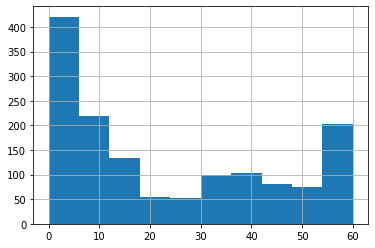

In [453]:
df_house['House_Age'].hist()

<AxesSubplot:>

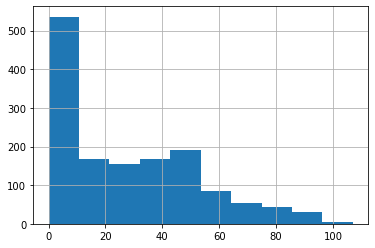

In [454]:
df_house['Garage_Age'].hist()

<AxesSubplot:>

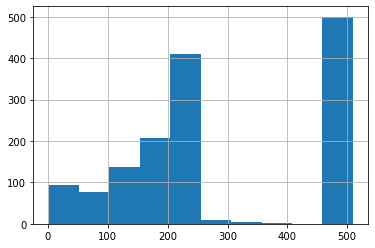

In [455]:
df_house['Exterior_Avg'].hist()

In [ ]:
# ### not to be submitted ### due to lack of number of submissions available per day
# result_from_model = blended_predictions(df_house_test_extracted2b_predicted)
# df_house_test['SalePrice'] = 0
# df_house_test['SalePrice'] = np.expm1(result_from_model)
# df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission14_14.csv',index=False)
# df_house_test[['Id','SalePrice']]

In [ ]:
# submissions = pd.DataFrame()
# submissions['SalePrice'] = np.expm1(blended_predictions(X_test))
# submissions['Id'] = test['Id']

In [ ]:
# print("Training stack_regressor")
# stack_gen_model = stack_regressor.fit(X_train,y)
# print("Training light gradient boosted model")
# light_gradient_boost_model = lgbm.fit(X_train,y)
# print("Training XGBoost model")
# xgb_regressor_model = xgbRegressor.fit(X_train, y)
# print("Training Ridge Model")
# ridge_model_fitted = ridge_model.fit(X_train, y)
# print("Training SVR model")
# svr_model = svr.fit(X_train, y)
# print("Training Gradient Boosted Model")
# gbr_model = gbr.fit(X_train, y)
# print("Training random forest regressor")
# rf_model = rf.fit(X_train, y)

In [ ]:
# models=[]
# models.append(ridge_model_fitted)
# models.append(svr_model)
# models.append(gbr_model)
# models.append(xgb_regressor_model)
# models.append(light_gradient_boost_model)
# models.append(rf_model)
# models.append(stack_gen_model)

In [ ]:
# predictions = []
# for model in models:
#     if model in ['stack_gen_model']:
#         predictions.append(model.predict(np.array(X_train)))
#     else:
#         predictions.append(model.predict(X_train))

In [ ]:
'''from sklearn.metrics import mean_squared_error
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

print('Ensamble Score: {best_score}'.format(best_score=res['fun']))
print('Best Weights: {weights}'.format(weights=res['x']))

mlist = ['ridge', 'svr', 'gbr' , 'xgb', 'lgb', 'rf', 'stack_gen']
blend_wts = pd.DataFrame({'model': mlist, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])'''

In [431]:
from statsmodels.formula.api import ols

In [433]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [436]:
X.columns

Index(['MSSubClass(scaled)', 'MasVnrArea(scaled)', 'BsmtFinSF1(scaled)',
       'BsmtUnfSF(scaled)', '2ndFlrSF(scaled)', 'BsmtFullBath(scaled)',
       'FullBath(scaled)', 'HalfBath(scaled)', 'Fireplaces(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'House_Age(bxcx)',
       'Garage_Age(bxcx)', 'Exterior_Avg(bxcx)', 'MSZoning_(scaled)',
       'LotFrontage(scaled)', 'LotArea(scaled)', 'LotShape_(scaled)',
       'LotConfig_(scaled)', 'Neighborhood_(scaled)', 'HouseStyle_(scaled)',
       'OverallQual(scaled)', 'OverallCond(scaled)', 'RoofStyle_(scaled)',
       'MasVnrType_(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)', '1stFlrSF(scaled)',
       'GrLivArea(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(

In [439]:
df_house_extracted10.columns[:50]

Index(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_', 'SalePrice',
       'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)'],
      dtype='object')

In [446]:
df_house_extracted10.columns[50:]

Index(['Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)', 'SalePrice(log)', 'MSSubClass(bxcx)',
       'MasVnrArea(bxcx)', 'BsmtF

In [441]:
X_tmp_tst = df_house_extracted10[['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_']]

In [442]:
y_tmp_tst = df_house_extracted10[['SalePrice']]

In [445]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(X_tmp_tst.values,i) for i in range(X_tmp_tst.shape[1])]
vif["features"] = X_tmp_tst.columns
vif = vif.sort_values("VIF Factor").reset_index(drop=True)
vif

,VIF Factor,features
0,1.911739,OpenPorchSF
1,1.957383,WoodDeckSF
2,2.941661,MasVnrArea
3,2.967174,MasVnrType_
4,3.337839,HalfBath
5,3.522952,BsmtFullBath
6,4.502741,Neighborhood_
7,4.682639,House_Age
8,4.819628,MSSubClass
9,5.611467,BsmtExposure_


In [447]:
X_tmp_tst2 = df_house_extracted10[['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)']]

In [448]:
y_tmp_tst2 = df_house_extracted10[['SalePrice(log)']]

In [450]:
X_tmp_tst3 = df_house_extracted10[['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)','SalePrice(log)']]

In [449]:
vif2 = pd.DataFrame()
vif2["VIF Factor"] = [variance_inflation_factor(X_tmp_tst2.values,i) for i in range(X_tmp_tst2.shape[1])]
vif2["features"] = X_tmp_tst2.columns
vif2 = vif2.sort_values("VIF Factor").reset_index(drop=True)
vif2

,VIF Factor,features
0,1.123853,LotConfig_(scaled)
1,1.131094,SaleCondition_(scaled)
2,1.216336,RoofStyle_(scaled)
3,1.230873,WoodDeckSF(scaled)
4,1.239832,OpenPorchSF(scaled)
5,1.299440,Neighborhood_(scaled)
6,1.317301,LotShape_(scaled)
7,1.340886,BsmtExposure_(scaled)
8,1.453299,OverallCond(scaled)
9,1.561224,Foundation_(scaled)


In [451]:
vif3 = pd.DataFrame()
vif3["VIF Factor"] = [variance_inflation_factor(X_tmp_tst3.values,i) for i in range(X_tmp_tst3.shape[1])]
vif3["features"] = X_tmp_tst3.columns
vif3 = vif3.sort_values("VIF Factor").reset_index(drop=True)
vif3

,VIF Factor,features
0,1.000948,SalePrice(log)
1,1.123853,LotConfig_(scaled)
2,1.131094,SaleCondition_(scaled)
3,1.216336,RoofStyle_(scaled)
4,1.230873,WoodDeckSF(scaled)
5,1.239832,OpenPorchSF(scaled)
6,1.299440,Neighborhood_(scaled)
7,1.317302,LotShape_(scaled)
8,1.340888,BsmtExposure_(scaled)
9,1.453310,OverallCond(scaled)


In [452]:
len([ 'MSSubClass(bxcx)','MasVnrArea(bxcx)','BsmtFinSF1(bxcx)',
        'BsmtUnfSF(bxcx)','2ndFlrSF(bxcx)','BsmtFullBath(bxcx)','FullBath(bxcx)','HalfBath(bxcx)','Fireplaces(bxcx)',
        'WoodDeckSF(bxcx)','OpenPorchSF(bxcx)',
        'House_Age(bxcx)','Garage_Age(bxcx)','Exterior_Avg(bxcx)'])

14

### nov10.2022 - VIF

In [ ]:
10.798438 // BsmtUnfSF(scaled)
12.524479 // TotalBsmtSF(scaled)
66.802089 // 1stFlrSF(scaled)
88.071885 // 2ndFlrSF(scaled)
110.928046 // GrLivArea(scaled)

In [458]:
df_house4.columns[50:]

Index(['HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'PoolQC',
       'Fence', 'MiscFeature', 'MiscVal', 'MoSold', 'YrSold', 'SaleType',
       'SaleCondition', 'SalePrice', 'MSZoning_', 'LotShape_', 'LotConfig_',
       'Neighborhood_', 'BldgType_', 'HouseStyle_', 'House_Age', 'Garage_Age',
       'RoofStyle_', 'Exterior1st_', 'Exterior2nd_', 'Exterior_Avg',
       'MasVnrType_', 'ExterQual_', 'Foundation_', 'BsmtQual_', 'BsmtCond_',
       'BsmtExposure_', 'BsmtFinType1_', 'HeatingQC_', 'KitchenQual_',
       'FireplaceQu_', 'GarageType_', 'GarageFinish_', 'SaleCondition_'],
      dtype='object')

##### Removing 'GrLivArea'

In [459]:
### REMOVE 'GrLivArea'
#================================================================================================================================
df_house_extracted_vif1 = df_house4[['MSSubClass','MSZoning_','LotFrontage','LotArea','LotShape_','LotConfig_','Neighborhood_',
          'HouseStyle_','OverallQual','OverallCond','RoofStyle_','MasVnrType_','MasVnrArea','ExterQual_','Foundation_','BsmtQual_',
          'BsmtExposure_','BsmtFinType1_','BsmtFinSF1','BsmtUnfSF','TotalBsmtSF','HeatingQC_','1stFlrSF','2ndFlrSF',
          'BsmtFullBath','FullBath','HalfBath','BedroomAbvGr','KitchenQual_','TotRmsAbvGrd','Fireplaces','FireplaceQu_',
          'GarageType_','House_Age','Garage_Age','GarageFinish_','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','Exterior_Avg',
        'SaleCondition_',
          'SalePrice']]
# 'GrLivArea',
##================================================================
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF',  'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg','SaleCondition_'
] 
# 'GrLivArea',
#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif1[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif1[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif1['SalePrice'])
df_house_extracted_vif1['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted_vif1[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_extracted_vif1[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_extracted_vif1[df_house_extracted_vif1[col_lst_bxcx[i]]==0]) != 0:
#         df_house_extracted_vif1[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_extracted_vif1[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_extracted_vif1[col_lst_bxcx_] = y_boxcox

###======================================================================================
X = df_house_extracted_vif1[[
        'MSSubClass(scaled)',
       'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
       'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
       'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
       'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
       'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
       'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
       'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
       '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 
       'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
       'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
       'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
       'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
       'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)'
]]
# 'GrLivArea(scaled)',
y = df_house_extracted_vif1['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1121027493.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1121027493.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1121027493.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

In [ ]:
df_house_test

In [460]:
df_house_test_extracted.columns

Index(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg'],
      dtype='object')

In [462]:
# ordinary linear regression model
line_fitter_tmp = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter_tmp = Ridge(alpha=54)
lasso_fitter_tmp = Lasso(alpha=0.001)
elasticNet_fitter_tmp = ElasticNet(alpha = 0.02, l1_ratio=0.05)
# ensemble models
xgb_fitter_tmp = XGBRegressor(n_estimators=50)
gbm_fitter_tmp = GradientBoostingRegressor(n_estimators=168)
rf_fitter_tmp = RandomForestRegressor(n_estimators=161)
lgbm_fitter_tmp = LGBMRegressor(n_estimators=121)
bg_fitter_tmp = BaggingRegressor(n_estimators=132)
et_fitter_tmp = ExtraTreesRegressor(n_estimators=133)

In [463]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params(ridge_fitter_tmp,ridge_params)
### 'max_iter':range(500,18000),
### 'solver':['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga', 'lbfgs']
#####---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params(lasso_fitter_tmp,lasso_params)
### 'max_iter':range(800,1200),
### 'selection':['cyclic','random']
#####---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params(elasticNet_fitter_tmp,eln_params)
#####--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var10 = print_best_params(cat_fitter_tmp,candidate_params)
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1263, and the best parameter is : {'alpha': 21}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.585e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.126, and the best parameter is : {'alpha': 0.0021000000000000003}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.585e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.455e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.465e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.465e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.465e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.455e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the featur

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.303e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.191e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.921e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.781e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1261, and the best parameter is : {'alpha': 0.01, 'l1_ratio': 0.09}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1381, and the best parameter is : {'n_estimators': 66}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1259, and the best parameter is : {'n_estimators': 165}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1385, and the best parameter is : {'n_estimators': 146}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1273, and the best parameter is : {'n_estimators': 79}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1387, and the best parameter is : {'n_estimators': 101}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best 

0:	learn: 0.3223723	total: 2.94ms	remaining: 291ms
1:	learn: 0.2722626	total: 5.36ms	remaining: 263ms
2:	learn: 0.2398344	total: 7.91ms	remaining: 256ms
3:	learn: 0.2121911	total: 11.1ms	remaining: 267ms
4:	learn: 0.1894673	total: 13.5ms	remaining: 256ms
5:	learn: 0.1729354	total: 15.9ms	remaining: 248ms
6:	learn: 0.1592738	total: 18.4ms	remaining: 244ms
7:	learn: 0.1511975	total: 20.8ms	remaining: 239ms
8:	learn: 0.1444977	total: 23.5ms	remaining: 238ms
9:	learn: 0.1375704	total: 26.1ms	remaining: 235ms
10:	learn: 0.1321455	total: 28.5ms	remaining: 230ms
11:	learn: 0.1281379	total: 30.8ms	remaining: 226ms
12:	learn: 0.1254209	total: 33ms	remaining: 221ms
13:	learn: 0.1226805	total: 35.4ms	remaining: 218ms
14:	learn: 0.1191245	total: 37.7ms	remaining: 214ms
15:	learn: 0.1167196	total: 40ms	remaining: 210ms
16:	learn: 0.1141401	total: 42.7ms	remaining: 208ms
17:	learn: 0.1122021	total: 45ms	remaining: 205ms
18:	learn: 0.1106852	total: 47.3ms	remaining: 202ms
19:	learn: 0.1093858	total: 

0:	learn: 0.3257171	total: 2.85ms	remaining: 282ms
1:	learn: 0.2757982	total: 5.25ms	remaining: 257ms
2:	learn: 0.2414322	total: 7.75ms	remaining: 250ms
3:	learn: 0.2135087	total: 10.5ms	remaining: 252ms
4:	learn: 0.1911451	total: 13.1ms	remaining: 248ms
5:	learn: 0.1724625	total: 15.6ms	remaining: 244ms
6:	learn: 0.1594811	total: 17.9ms	remaining: 238ms
7:	learn: 0.1503386	total: 20.4ms	remaining: 235ms
8:	learn: 0.1439521	total: 23.3ms	remaining: 236ms
9:	learn: 0.1367328	total: 25.8ms	remaining: 232ms
10:	learn: 0.1311189	total: 28.2ms	remaining: 228ms
11:	learn: 0.1265779	total: 30.5ms	remaining: 223ms
12:	learn: 0.1234237	total: 32.8ms	remaining: 219ms
13:	learn: 0.1204548	total: 35.2ms	remaining: 216ms
14:	learn: 0.1180413	total: 37.4ms	remaining: 212ms
15:	learn: 0.1160696	total: 39.7ms	remaining: 208ms
16:	learn: 0.1140969	total: 42.3ms	remaining: 207ms
17:	learn: 0.1123981	total: 45ms	remaining: 205ms
18:	learn: 0.1111654	total: 47.5ms	remaining: 203ms
19:	learn: 0.1100225	tot

Learning rate set to 0.269748
0:	learn: 0.3208692	total: 2.79ms	remaining: 280ms
1:	learn: 0.2735797	total: 5.15ms	remaining: 255ms
2:	learn: 0.2386407	total: 7.38ms	remaining: 241ms
3:	learn: 0.2108566	total: 9.72ms	remaining: 236ms
4:	learn: 0.1893152	total: 12.3ms	remaining: 237ms
5:	learn: 0.1714276	total: 14.5ms	remaining: 229ms
6:	learn: 0.1585412	total: 16.5ms	remaining: 222ms
7:	learn: 0.1506634	total: 19.1ms	remaining: 222ms
8:	learn: 0.1429739	total: 21.2ms	remaining: 217ms
9:	learn: 0.1369906	total: 23.5ms	remaining: 214ms
10:	learn: 0.1315865	total: 25.8ms	remaining: 211ms
11:	learn: 0.1276577	total: 27.9ms	remaining: 207ms
12:	learn: 0.1250779	total: 30.2ms	remaining: 204ms
13:	learn: 0.1212584	total: 32.3ms	remaining: 201ms
14:	learn: 0.1179858	total: 35ms	remaining: 200ms
15:	learn: 0.1157327	total: 37.3ms	remaining: 198ms
16:	learn: 0.1133842	total: 39.5ms	remaining: 195ms
17:	learn: 0.1111691	total: 41.8ms	remaining: 193ms
18:	learn: 0.1100102	total: 44.1ms	remaining: 

Learning rate set to 0.269785
0:	learn: 0.3232201	total: 5.18ms	remaining: 518ms
1:	learn: 0.2748559	total: 8.84ms	remaining: 438ms
2:	learn: 0.2426616	total: 12.5ms	remaining: 409ms
3:	learn: 0.2156399	total: 15.5ms	remaining: 376ms
4:	learn: 0.1944617	total: 18.2ms	remaining: 350ms
5:	learn: 0.1787797	total: 21.3ms	remaining: 338ms
6:	learn: 0.1656029	total: 23.6ms	remaining: 317ms
7:	learn: 0.1558064	total: 26ms	remaining: 303ms
8:	learn: 0.1474024	total: 28.7ms	remaining: 293ms
9:	learn: 0.1394830	total: 30.8ms	remaining: 280ms
10:	learn: 0.1344231	total: 32.9ms	remaining: 269ms
11:	learn: 0.1302059	total: 35.4ms	remaining: 262ms
12:	learn: 0.1276396	total: 37.5ms	remaining: 254ms
13:	learn: 0.1244742	total: 39.7ms	remaining: 247ms
14:	learn: 0.1213959	total: 41.7ms	remaining: 239ms
15:	learn: 0.1192428	total: 43.9ms	remaining: 233ms
16:	learn: 0.1169379	total: 46ms	remaining: 227ms
17:	learn: 0.1152859	total: 48.3ms	remaining: 223ms
18:	learn: 0.1138086	total: 50.8ms	remaining: 21

80:	learn: 0.0621277	total: 240ms	remaining: 59.4ms
81:	learn: 0.0616339	total: 243ms	remaining: 56.3ms
82:	learn: 0.0612078	total: 246ms	remaining: 53.3ms
83:	learn: 0.0611566	total: 248ms	remaining: 50.2ms
84:	learn: 0.0611190	total: 251ms	remaining: 47.2ms
85:	learn: 0.0610644	total: 253ms	remaining: 44.1ms
86:	learn: 0.0607976	total: 256ms	remaining: 41.2ms
87:	learn: 0.0603435	total: 258ms	remaining: 38.2ms
88:	learn: 0.0600163	total: 261ms	remaining: 35.2ms
89:	learn: 0.0595697	total: 263ms	remaining: 32.2ms
90:	learn: 0.0592118	total: 266ms	remaining: 29.2ms
91:	learn: 0.0587374	total: 268ms	remaining: 26.2ms
92:	learn: 0.0580828	total: 270ms	remaining: 23.2ms
93:	learn: 0.0577864	total: 273ms	remaining: 20.3ms
94:	learn: 0.0572335	total: 275ms	remaining: 17.4ms
95:	learn: 0.0563898	total: 278ms	remaining: 14.5ms
96:	learn: 0.0556853	total: 280ms	remaining: 11.6ms
97:	learn: 0.0550565	total: 282ms	remaining: 8.65ms
98:	learn: 0.0542594	total: 285ms	remaining: 5.75ms
99:	learn: 0

72:	learn: 0.0679627	total: 174ms	remaining: 69.1ms
73:	learn: 0.0673324	total: 176ms	remaining: 66.8ms
74:	learn: 0.0665656	total: 179ms	remaining: 64.5ms
75:	learn: 0.0659684	total: 182ms	remaining: 62.2ms
76:	learn: 0.0652355	total: 184ms	remaining: 59.8ms
77:	learn: 0.0647095	total: 187ms	remaining: 57.5ms
78:	learn: 0.0640428	total: 191ms	remaining: 55.5ms
79:	learn: 0.0632775	total: 201ms	remaining: 55.2ms
80:	learn: 0.0627131	total: 212ms	remaining: 54.9ms
81:	learn: 0.0621419	total: 221ms	remaining: 54ms
82:	learn: 0.0612777	total: 232ms	remaining: 53.1ms
83:	learn: 0.0607844	total: 235ms	remaining: 50.4ms
84:	learn: 0.0599643	total: 238ms	remaining: 47.6ms
85:	learn: 0.0594599	total: 242ms	remaining: 45.1ms
86:	learn: 0.0589351	total: 247ms	remaining: 42.6ms
87:	learn: 0.0585869	total: 251ms	remaining: 40ms
88:	learn: 0.0581467	total: 255ms	remaining: 37.3ms
89:	learn: 0.0574108	total: 260ms	remaining: 34.7ms
90:	learn: 0.0572988	total: 263ms	remaining: 31.8ms
91:	learn: 0.056

69:	learn: 0.0693654	total: 243ms	remaining: 111ms
70:	learn: 0.0682848	total: 249ms	remaining: 109ms
71:	learn: 0.0676901	total: 253ms	remaining: 105ms
72:	learn: 0.0671134	total: 258ms	remaining: 102ms
73:	learn: 0.0662946	total: 261ms	remaining: 98.6ms
74:	learn: 0.0660732	total: 264ms	remaining: 94.9ms
75:	learn: 0.0656196	total: 267ms	remaining: 91.2ms
76:	learn: 0.0654638	total: 270ms	remaining: 87.6ms
77:	learn: 0.0650235	total: 273ms	remaining: 84ms
78:	learn: 0.0645951	total: 276ms	remaining: 80.3ms
79:	learn: 0.0639129	total: 279ms	remaining: 76.6ms
80:	learn: 0.0634153	total: 281ms	remaining: 73ms
81:	learn: 0.0633876	total: 284ms	remaining: 69.3ms
82:	learn: 0.0623636	total: 287ms	remaining: 65.7ms
83:	learn: 0.0620793	total: 290ms	remaining: 62.1ms
84:	learn: 0.0618489	total: 293ms	remaining: 58.5ms
85:	learn: 0.0615582	total: 295ms	remaining: 55ms
86:	learn: 0.0615236	total: 298ms	remaining: 51.4ms
87:	learn: 0.0610832	total: 301ms	remaining: 47.8ms
88:	learn: 0.0606362	t

24:	learn: 0.1029250	total: 68.3ms	remaining: 213ms
25:	learn: 0.1018356	total: 71.1ms	remaining: 211ms
26:	learn: 0.1008487	total: 74.2ms	remaining: 209ms
27:	learn: 0.1001645	total: 79.7ms	remaining: 213ms
28:	learn: 0.0993601	total: 82.6ms	remaining: 211ms
29:	learn: 0.0973328	total: 85.5ms	remaining: 208ms
30:	learn: 0.0967547	total: 88.4ms	remaining: 205ms
31:	learn: 0.0955817	total: 91.9ms	remaining: 204ms
32:	learn: 0.0943968	total: 94.6ms	remaining: 201ms
33:	learn: 0.0934128	total: 97.2ms	remaining: 197ms
34:	learn: 0.0927558	total: 99.8ms	remaining: 194ms
35:	learn: 0.0919017	total: 102ms	remaining: 191ms
36:	learn: 0.0912934	total: 105ms	remaining: 188ms
37:	learn: 0.0902981	total: 108ms	remaining: 185ms
38:	learn: 0.0887999	total: 111ms	remaining: 182ms
39:	learn: 0.0884794	total: 113ms	remaining: 179ms
40:	learn: 0.0875150	total: 116ms	remaining: 175ms
41:	learn: 0.0869231	total: 118ms	remaining: 172ms
42:	learn: 0.0863142	total: 121ms	remaining: 169ms
43:	learn: 0.0860194

Learning rate set to 0.265518
0:	learn: 0.3238444	total: 3.21ms	remaining: 328ms
1:	learn: 0.2782621	total: 6.15ms	remaining: 311ms
2:	learn: 0.2474952	total: 8.85ms	remaining: 295ms
3:	learn: 0.2208501	total: 12.1ms	remaining: 299ms
4:	learn: 0.1992012	total: 14.9ms	remaining: 293ms
5:	learn: 0.1819018	total: 17.9ms	remaining: 290ms
6:	learn: 0.1692202	total: 20.6ms	remaining: 283ms
7:	learn: 0.1585621	total: 23.3ms	remaining: 277ms
8:	learn: 0.1513291	total: 26ms	remaining: 272ms
9:	learn: 0.1427474	total: 29ms	remaining: 270ms
10:	learn: 0.1362213	total: 31.6ms	remaining: 264ms
11:	learn: 0.1312153	total: 34.3ms	remaining: 260ms
12:	learn: 0.1270546	total: 36.9ms	remaining: 255ms
13:	learn: 0.1239272	total: 39.6ms	remaining: 251ms
14:	learn: 0.1203357	total: 42.6ms	remaining: 250ms
15:	learn: 0.1178574	total: 45.2ms	remaining: 246ms
16:	learn: 0.1158749	total: 47.9ms	remaining: 242ms
17:	learn: 0.1142739	total: 50.6ms	remaining: 239ms
18:	learn: 0.1127919	total: 53.2ms	remaining: 23

76:	learn: 0.0682421	total: 212ms	remaining: 71.7ms
77:	learn: 0.0675574	total: 215ms	remaining: 69ms
78:	learn: 0.0673609	total: 218ms	remaining: 66.2ms
79:	learn: 0.0666141	total: 221ms	remaining: 63.5ms
80:	learn: 0.0660826	total: 224ms	remaining: 60.8ms
81:	learn: 0.0656221	total: 227ms	remaining: 58.1ms
82:	learn: 0.0650801	total: 230ms	remaining: 55.4ms
83:	learn: 0.0640006	total: 233ms	remaining: 52.7ms
84:	learn: 0.0633870	total: 236ms	remaining: 50ms
85:	learn: 0.0629622	total: 239ms	remaining: 47.2ms
86:	learn: 0.0628504	total: 241ms	remaining: 44.4ms
87:	learn: 0.0624822	total: 244ms	remaining: 41.6ms
88:	learn: 0.0620847	total: 247ms	remaining: 38.8ms
89:	learn: 0.0610556	total: 250ms	remaining: 36ms
90:	learn: 0.0610175	total: 252ms	remaining: 33.3ms
91:	learn: 0.0607338	total: 255ms	remaining: 30.5ms
92:	learn: 0.0606995	total: 258ms	remaining: 27.7ms
93:	learn: 0.0599516	total: 261ms	remaining: 24.9ms
94:	learn: 0.0591172	total: 263ms	remaining: 22.2ms
95:	learn: 0.05909

41:	learn: 0.0884467	total: 107ms	remaining: 159ms
42:	learn: 0.0875365	total: 111ms	remaining: 157ms
43:	learn: 0.0867078	total: 114ms	remaining: 155ms
44:	learn: 0.0854389	total: 117ms	remaining: 153ms
45:	learn: 0.0845094	total: 119ms	remaining: 151ms
46:	learn: 0.0843642	total: 122ms	remaining: 148ms
47:	learn: 0.0832548	total: 125ms	remaining: 146ms
48:	learn: 0.0831580	total: 128ms	remaining: 144ms
49:	learn: 0.0823075	total: 131ms	remaining: 142ms
50:	learn: 0.0817237	total: 134ms	remaining: 139ms
51:	learn: 0.0806231	total: 137ms	remaining: 137ms
52:	learn: 0.0798851	total: 140ms	remaining: 134ms
53:	learn: 0.0786432	total: 142ms	remaining: 132ms
54:	learn: 0.0773018	total: 145ms	remaining: 129ms
55:	learn: 0.0761888	total: 148ms	remaining: 127ms
56:	learn: 0.0752424	total: 150ms	remaining: 124ms
57:	learn: 0.0744597	total: 153ms	remaining: 121ms
58:	learn: 0.0738583	total: 156ms	remaining: 119ms
59:	learn: 0.0737676	total: 158ms	remaining: 116ms
60:	learn: 0.0728456	total: 161

5:	learn: 0.1825352	total: 20.6ms	remaining: 336ms
6:	learn: 0.1697918	total: 23.3ms	remaining: 323ms
7:	learn: 0.1590828	total: 26.2ms	remaining: 314ms
8:	learn: 0.1518117	total: 28.9ms	remaining: 305ms
9:	learn: 0.1431695	total: 31.5ms	remaining: 296ms
10:	learn: 0.1366058	total: 34.2ms	remaining: 289ms
11:	learn: 0.1315444	total: 36.8ms	remaining: 283ms
12:	learn: 0.1273475	total: 39.5ms	remaining: 277ms
13:	learn: 0.1234957	total: 42.9ms	remaining: 276ms
14:	learn: 0.1195639	total: 45.5ms	remaining: 270ms
15:	learn: 0.1168917	total: 48.1ms	remaining: 264ms
16:	learn: 0.1146805	total: 50.5ms	remaining: 259ms
17:	learn: 0.1126337	total: 53ms	remaining: 253ms
18:	learn: 0.1113229	total: 55.5ms	remaining: 248ms
19:	learn: 0.1100007	total: 58.5ms	remaining: 246ms
20:	learn: 0.1086691	total: 61ms	remaining: 241ms
21:	learn: 0.1067282	total: 63.5ms	remaining: 237ms
22:	learn: 0.1048431	total: 66.2ms	remaining: 233ms
23:	learn: 0.1033636	total: 68.7ms	remaining: 229ms
24:	learn: 0.1022089	

74:	learn: 0.0670200	total: 226ms	remaining: 87.5ms
75:	learn: 0.0664784	total: 229ms	remaining: 84.5ms
76:	learn: 0.0658323	total: 233ms	remaining: 81.6ms
77:	learn: 0.0657739	total: 235ms	remaining: 78.4ms
78:	learn: 0.0647931	total: 238ms	remaining: 75.3ms
79:	learn: 0.0644009	total: 241ms	remaining: 72.2ms
80:	learn: 0.0641377	total: 244ms	remaining: 69.2ms
81:	learn: 0.0636085	total: 247ms	remaining: 66.2ms
82:	learn: 0.0630697	total: 250ms	remaining: 63.3ms
83:	learn: 0.0621983	total: 253ms	remaining: 60.2ms
84:	learn: 0.0616784	total: 256ms	remaining: 57.2ms
85:	learn: 0.0613506	total: 259ms	remaining: 54.1ms
86:	learn: 0.0605734	total: 261ms	remaining: 51.1ms
87:	learn: 0.0597423	total: 265ms	remaining: 48.1ms
88:	learn: 0.0594448	total: 268ms	remaining: 45.1ms
89:	learn: 0.0589534	total: 270ms	remaining: 42.1ms
90:	learn: 0.0584861	total: 273ms	remaining: 39ms
91:	learn: 0.0582820	total: 276ms	remaining: 36ms
92:	learn: 0.0581209	total: 279ms	remaining: 33ms
93:	learn: 0.05775

30:	learn: 0.0955827	total: 84.1ms	remaining: 201ms
31:	learn: 0.0949460	total: 86.9ms	remaining: 198ms
32:	learn: 0.0937014	total: 89.7ms	remaining: 196ms
33:	learn: 0.0922603	total: 92.5ms	remaining: 193ms
34:	learn: 0.0920749	total: 95.6ms	remaining: 191ms
35:	learn: 0.0908138	total: 98.5ms	remaining: 189ms
36:	learn: 0.0906547	total: 101ms	remaining: 186ms
37:	learn: 0.0895816	total: 104ms	remaining: 184ms
38:	learn: 0.0893388	total: 107ms	remaining: 181ms
39:	learn: 0.0883127	total: 110ms	remaining: 179ms
40:	learn: 0.0873702	total: 113ms	remaining: 176ms
41:	learn: 0.0863539	total: 116ms	remaining: 173ms
42:	learn: 0.0855669	total: 118ms	remaining: 170ms
43:	learn: 0.0851430	total: 121ms	remaining: 168ms
44:	learn: 0.0849239	total: 123ms	remaining: 165ms
45:	learn: 0.0841622	total: 127ms	remaining: 163ms
46:	learn: 0.0831187	total: 130ms	remaining: 160ms
47:	learn: 0.0821229	total: 133ms	remaining: 158ms
48:	learn: 0.0817476	total: 136ms	remaining: 155ms
49:	learn: 0.0807433	tota

Learning rate set to 0.261399
0:	learn: 0.3247861	total: 3.01ms	remaining: 313ms
1:	learn: 0.2796324	total: 5.62ms	remaining: 289ms
2:	learn: 0.2489693	total: 8.17ms	remaining: 278ms
3:	learn: 0.2208837	total: 10.7ms	remaining: 271ms
4:	learn: 0.1993203	total: 13.7ms	remaining: 274ms
5:	learn: 0.1822171	total: 16.2ms	remaining: 268ms
6:	learn: 0.1688202	total: 18.7ms	remaining: 261ms
7:	learn: 0.1568256	total: 21.3ms	remaining: 258ms
8:	learn: 0.1493891	total: 23.9ms	remaining: 255ms
9:	learn: 0.1419554	total: 26.4ms	remaining: 251ms
10:	learn: 0.1355203	total: 29.2ms	remaining: 249ms
11:	learn: 0.1307044	total: 31.7ms	remaining: 245ms
12:	learn: 0.1269408	total: 34.3ms	remaining: 243ms
13:	learn: 0.1240185	total: 36.9ms	remaining: 240ms
14:	learn: 0.1201147	total: 39.3ms	remaining: 236ms
15:	learn: 0.1175498	total: 41.9ms	remaining: 233ms
16:	learn: 0.1157419	total: 44.7ms	remaining: 231ms
17:	learn: 0.1134353	total: 47.2ms	remaining: 228ms
18:	learn: 0.1121865	total: 49.7ms	remaining

77:	learn: 0.0623188	total: 211ms	remaining: 73ms
78:	learn: 0.0617347	total: 214ms	remaining: 70.4ms
79:	learn: 0.0612687	total: 217ms	remaining: 67.8ms
80:	learn: 0.0610929	total: 221ms	remaining: 65.6ms
81:	learn: 0.0605876	total: 224ms	remaining: 62.9ms
82:	learn: 0.0602066	total: 227ms	remaining: 60.2ms
83:	learn: 0.0598604	total: 230ms	remaining: 57.5ms
84:	learn: 0.0589796	total: 233ms	remaining: 54.8ms
85:	learn: 0.0584512	total: 236ms	remaining: 52.1ms
86:	learn: 0.0584156	total: 238ms	remaining: 49.3ms
87:	learn: 0.0579130	total: 241ms	remaining: 46.6ms
88:	learn: 0.0572855	total: 244ms	remaining: 43.8ms
89:	learn: 0.0569435	total: 247ms	remaining: 41.1ms
90:	learn: 0.0564852	total: 249ms	remaining: 38.4ms
91:	learn: 0.0563905	total: 252ms	remaining: 35.6ms
92:	learn: 0.0558246	total: 255ms	remaining: 32.9ms
93:	learn: 0.0551465	total: 257ms	remaining: 30.1ms
94:	learn: 0.0544793	total: 260ms	remaining: 27.4ms
95:	learn: 0.0541758	total: 263ms	remaining: 24.6ms
96:	learn: 0.0

37:	learn: 0.0907369	total: 99.2ms	remaining: 178ms
38:	learn: 0.0900488	total: 102ms	remaining: 175ms
39:	learn: 0.0895101	total: 105ms	remaining: 173ms
40:	learn: 0.0883165	total: 108ms	remaining: 171ms
41:	learn: 0.0873726	total: 110ms	remaining: 168ms
42:	learn: 0.0867736	total: 113ms	remaining: 166ms
43:	learn: 0.0865348	total: 116ms	remaining: 164ms
44:	learn: 0.0861271	total: 119ms	remaining: 161ms
45:	learn: 0.0857722	total: 122ms	remaining: 160ms
46:	learn: 0.0846934	total: 125ms	remaining: 157ms
47:	learn: 0.0843329	total: 128ms	remaining: 154ms
48:	learn: 0.0836242	total: 130ms	remaining: 152ms
49:	learn: 0.0835295	total: 133ms	remaining: 149ms
50:	learn: 0.0823176	total: 135ms	remaining: 146ms
51:	learn: 0.0813087	total: 138ms	remaining: 144ms
52:	learn: 0.0805645	total: 141ms	remaining: 141ms
53:	learn: 0.0792226	total: 144ms	remaining: 139ms
54:	learn: 0.0790994	total: 146ms	remaining: 136ms
55:	learn: 0.0790087	total: 149ms	remaining: 133ms
56:	learn: 0.0789264	total: 15

0:	learn: 0.3252458	total: 5.03ms	remaining: 528ms
1:	learn: 0.2803040	total: 8.83ms	remaining: 459ms
2:	learn: 0.2496951	total: 11.9ms	remaining: 409ms
3:	learn: 0.2216072	total: 15ms	remaining: 383ms
4:	learn: 0.2000064	total: 18.2ms	remaining: 367ms
5:	learn: 0.1824385	total: 21ms	remaining: 350ms
6:	learn: 0.1697872	total: 23.7ms	remaining: 336ms
7:	learn: 0.1580019	total: 26.9ms	remaining: 329ms
8:	learn: 0.1499823	total: 29.7ms	remaining: 320ms
9:	learn: 0.1416937	total: 32.8ms	remaining: 315ms
10:	learn: 0.1364746	total: 35.6ms	remaining: 308ms
11:	learn: 0.1312814	total: 38.5ms	remaining: 302ms
12:	learn: 0.1269504	total: 41.2ms	remaining: 295ms
13:	learn: 0.1237635	total: 43.7ms	remaining: 287ms
14:	learn: 0.1208187	total: 46.2ms	remaining: 280ms
15:	learn: 0.1183013	total: 49.3ms	remaining: 277ms
16:	learn: 0.1168190	total: 51.8ms	remaining: 271ms
17:	learn: 0.1148097	total: 54.4ms	remaining: 266ms
18:	learn: 0.1134355	total: 56.9ms	remaining: 260ms
19:	learn: 0.1121217	total

76:	learn: 0.0684105	total: 204ms	remaining: 76.7ms
77:	learn: 0.0682004	total: 207ms	remaining: 74.2ms
78:	learn: 0.0679932	total: 209ms	remaining: 71.5ms
79:	learn: 0.0674131	total: 212ms	remaining: 68.9ms
80:	learn: 0.0673734	total: 215ms	remaining: 66.3ms
81:	learn: 0.0667392	total: 218ms	remaining: 63.8ms
82:	learn: 0.0657951	total: 221ms	remaining: 61.2ms
83:	learn: 0.0657592	total: 224ms	remaining: 58.6ms
84:	learn: 0.0656772	total: 227ms	remaining: 56ms
85:	learn: 0.0650332	total: 229ms	remaining: 53.4ms
86:	learn: 0.0649966	total: 233ms	remaining: 50.8ms
87:	learn: 0.0642352	total: 235ms	remaining: 48.1ms
88:	learn: 0.0635093	total: 238ms	remaining: 45.4ms
89:	learn: 0.0627676	total: 240ms	remaining: 42.7ms
90:	learn: 0.0621166	total: 243ms	remaining: 40.1ms
91:	learn: 0.0614716	total: 246ms	remaining: 37.4ms
92:	learn: 0.0609432	total: 249ms	remaining: 34.8ms
93:	learn: 0.0604258	total: 251ms	remaining: 32.1ms
94:	learn: 0.0597074	total: 254ms	remaining: 29.4ms
95:	learn: 0.0

33:	learn: 0.0956362	total: 92.7ms	remaining: 199ms
34:	learn: 0.0946592	total: 95.5ms	remaining: 196ms
35:	learn: 0.0935358	total: 98.3ms	remaining: 194ms
36:	learn: 0.0932777	total: 101ms	remaining: 191ms
37:	learn: 0.0917859	total: 104ms	remaining: 189ms
38:	learn: 0.0910961	total: 107ms	remaining: 186ms
39:	learn: 0.0902560	total: 110ms	remaining: 185ms
40:	learn: 0.0890843	total: 113ms	remaining: 182ms
41:	learn: 0.0874987	total: 116ms	remaining: 180ms
42:	learn: 0.0868858	total: 119ms	remaining: 177ms
43:	learn: 0.0862696	total: 122ms	remaining: 174ms
44:	learn: 0.0855409	total: 125ms	remaining: 172ms
45:	learn: 0.0842490	total: 127ms	remaining: 169ms
46:	learn: 0.0841716	total: 130ms	remaining: 166ms
47:	learn: 0.0832975	total: 132ms	remaining: 163ms
48:	learn: 0.0827290	total: 135ms	remaining: 160ms
49:	learn: 0.0819888	total: 138ms	remaining: 157ms
50:	learn: 0.0811747	total: 141ms	remaining: 155ms
51:	learn: 0.0802735	total: 143ms	remaining: 152ms
52:	learn: 0.0793693	total: 

Learning rate set to 0.25742
0:	learn: 0.3256978	total: 3.25ms	remaining: 345ms
1:	learn: 0.2809665	total: 6.76ms	remaining: 355ms
2:	learn: 0.2504130	total: 9.71ms	remaining: 337ms
3:	learn: 0.2223253	total: 13.3ms	remaining: 342ms
4:	learn: 0.2006891	total: 16.2ms	remaining: 331ms
5:	learn: 0.1830607	total: 19.5ms	remaining: 328ms
6:	learn: 0.1701216	total: 22.3ms	remaining: 319ms
7:	learn: 0.1583182	total: 25ms	remaining: 309ms
8:	learn: 0.1502855	total: 27.9ms	remaining: 304ms
9:	learn: 0.1421199	total: 30.6ms	remaining: 297ms
10:	learn: 0.1357928	total: 33.4ms	remaining: 291ms
11:	learn: 0.1305786	total: 36.3ms	remaining: 287ms
12:	learn: 0.1278390	total: 38.9ms	remaining: 281ms
13:	learn: 0.1246708	total: 41.5ms	remaining: 275ms
14:	learn: 0.1213582	total: 44.4ms	remaining: 272ms
15:	learn: 0.1185007	total: 46.9ms	remaining: 267ms
16:	learn: 0.1157893	total: 49.6ms	remaining: 263ms
17:	learn: 0.1140535	total: 52.3ms	remaining: 259ms
18:	learn: 0.1120117	total: 55.1ms	remaining: 2

61:	learn: 0.0802512	total: 189ms	remaining: 137ms
62:	learn: 0.0787667	total: 192ms	remaining: 134ms
63:	learn: 0.0779458	total: 196ms	remaining: 132ms
64:	learn: 0.0774275	total: 199ms	remaining: 128ms
65:	learn: 0.0767073	total: 202ms	remaining: 126ms
66:	learn: 0.0762126	total: 206ms	remaining: 123ms
67:	learn: 0.0753922	total: 209ms	remaining: 120ms
68:	learn: 0.0753336	total: 213ms	remaining: 117ms
69:	learn: 0.0746907	total: 216ms	remaining: 114ms
70:	learn: 0.0735863	total: 219ms	remaining: 111ms
71:	learn: 0.0728317	total: 222ms	remaining: 108ms
72:	learn: 0.0721314	total: 225ms	remaining: 105ms
73:	learn: 0.0716020	total: 229ms	remaining: 102ms
74:	learn: 0.0706571	total: 232ms	remaining: 99.1ms
75:	learn: 0.0698123	total: 235ms	remaining: 95.9ms
76:	learn: 0.0688949	total: 238ms	remaining: 92.7ms
77:	learn: 0.0682001	total: 241ms	remaining: 89.6ms
78:	learn: 0.0680991	total: 245ms	remaining: 86.7ms
79:	learn: 0.0675956	total: 248ms	remaining: 83.6ms
80:	learn: 0.0670897	tota

50:	learn: 0.0807900	total: 164ms	remaining: 183ms
51:	learn: 0.0802888	total: 167ms	remaining: 180ms
52:	learn: 0.0794103	total: 170ms	remaining: 177ms
53:	learn: 0.0786464	total: 174ms	remaining: 174ms
54:	learn: 0.0779883	total: 177ms	remaining: 171ms
55:	learn: 0.0765387	total: 181ms	remaining: 168ms
56:	learn: 0.0760225	total: 184ms	remaining: 164ms
57:	learn: 0.0751854	total: 187ms	remaining: 161ms
58:	learn: 0.0748392	total: 190ms	remaining: 158ms
59:	learn: 0.0747021	total: 193ms	remaining: 155ms
60:	learn: 0.0738131	total: 196ms	remaining: 151ms
61:	learn: 0.0728063	total: 199ms	remaining: 148ms
62:	learn: 0.0721794	total: 203ms	remaining: 145ms
63:	learn: 0.0715806	total: 206ms	remaining: 141ms
64:	learn: 0.0714872	total: 209ms	remaining: 138ms
65:	learn: 0.0706729	total: 211ms	remaining: 135ms
66:	learn: 0.0705183	total: 214ms	remaining: 131ms
67:	learn: 0.0700643	total: 218ms	remaining: 128ms
68:	learn: 0.0694584	total: 221ms	remaining: 125ms
69:	learn: 0.0694080	total: 224

105:	learn: 0.0518979	total: 312ms	remaining: 5.88ms
106:	learn: 0.0515370	total: 315ms	remaining: 2.94ms
107:	learn: 0.0512467	total: 317ms	remaining: 0us
Learning rate set to 0.25548
0:	learn: 0.3261431	total: 3.32ms	remaining: 356ms
1:	learn: 0.2816206	total: 5.99ms	remaining: 317ms
2:	learn: 0.2511240	total: 8.66ms	remaining: 303ms
3:	learn: 0.2230386	total: 11.3ms	remaining: 294ms
4:	learn: 0.2013692	total: 13.9ms	remaining: 287ms
5:	learn: 0.1836822	total: 16.6ms	remaining: 282ms
6:	learn: 0.1706724	total: 19.4ms	remaining: 280ms
7:	learn: 0.1589631	total: 22ms	remaining: 275ms
8:	learn: 0.1502774	total: 24.7ms	remaining: 272ms
9:	learn: 0.1419340	total: 27.4ms	remaining: 268ms
10:	learn: 0.1360493	total: 30ms	remaining: 264ms
11:	learn: 0.1314386	total: 32.6ms	remaining: 261ms
12:	learn: 0.1268097	total: 35.4ms	remaining: 258ms
13:	learn: 0.1240308	total: 38.1ms	remaining: 256ms
14:	learn: 0.1206532	total: 40.6ms	remaining: 252ms
15:	learn: 0.1185187	total: 43.3ms	remaining: 249

64:	learn: 0.0761319	total: 178ms	remaining: 118ms
65:	learn: 0.0755599	total: 181ms	remaining: 115ms
66:	learn: 0.0745286	total: 184ms	remaining: 112ms
67:	learn: 0.0732696	total: 187ms	remaining: 110ms
68:	learn: 0.0726827	total: 190ms	remaining: 107ms
69:	learn: 0.0721366	total: 192ms	remaining: 104ms
70:	learn: 0.0710099	total: 196ms	remaining: 102ms
71:	learn: 0.0703718	total: 199ms	remaining: 99.3ms
72:	learn: 0.0692553	total: 202ms	remaining: 96.7ms
73:	learn: 0.0687145	total: 204ms	remaining: 93.9ms
74:	learn: 0.0682848	total: 207ms	remaining: 91.2ms
75:	learn: 0.0676542	total: 210ms	remaining: 88.6ms
76:	learn: 0.0672869	total: 213ms	remaining: 85.8ms
77:	learn: 0.0669665	total: 216ms	remaining: 83ms
78:	learn: 0.0663662	total: 218ms	remaining: 80.2ms
79:	learn: 0.0655516	total: 221ms	remaining: 77.4ms
80:	learn: 0.0648955	total: 224ms	remaining: 74.6ms
81:	learn: 0.0642344	total: 227ms	remaining: 71.9ms
82:	learn: 0.0639314	total: 229ms	remaining: 69.1ms
83:	learn: 0.0632810	

21:	learn: 0.1093763	total: 58ms	remaining: 229ms
22:	learn: 0.1083375	total: 61ms	remaining: 228ms
23:	learn: 0.1071766	total: 63.6ms	remaining: 225ms
24:	learn: 0.1056689	total: 66.5ms	remaining: 223ms
25:	learn: 0.1044753	total: 69.1ms	remaining: 221ms
26:	learn: 0.1030942	total: 71.8ms	remaining: 218ms
27:	learn: 0.1022286	total: 74.9ms	remaining: 217ms
28:	learn: 0.1012805	total: 77.6ms	remaining: 214ms
29:	learn: 0.0996147	total: 80.9ms	remaining: 213ms
30:	learn: 0.0983784	total: 83.6ms	remaining: 210ms
31:	learn: 0.0968744	total: 86.3ms	remaining: 208ms
32:	learn: 0.0961040	total: 88.9ms	remaining: 205ms
33:	learn: 0.0944161	total: 92ms	remaining: 203ms
34:	learn: 0.0939070	total: 94.7ms	remaining: 200ms
35:	learn: 0.0929542	total: 97.2ms	remaining: 197ms
36:	learn: 0.0919817	total: 99.8ms	remaining: 194ms
37:	learn: 0.0914728	total: 102ms	remaining: 191ms
38:	learn: 0.0908721	total: 105ms	remaining: 189ms
39:	learn: 0.0905345	total: 108ms	remaining: 187ms
40:	learn: 0.0897475	

95:	learn: 0.0571379	total: 256ms	remaining: 34.7ms
96:	learn: 0.0564527	total: 259ms	remaining: 32.1ms
97:	learn: 0.0564045	total: 262ms	remaining: 29.4ms
98:	learn: 0.0558603	total: 265ms	remaining: 26.8ms
99:	learn: 0.0551166	total: 268ms	remaining: 24.1ms
100:	learn: 0.0545939	total: 271ms	remaining: 21.4ms
101:	learn: 0.0542064	total: 273ms	remaining: 18.8ms
102:	learn: 0.0536084	total: 276ms	remaining: 16.1ms
103:	learn: 0.0532252	total: 279ms	remaining: 13.4ms
104:	learn: 0.0531452	total: 282ms	remaining: 10.8ms
105:	learn: 0.0527545	total: 285ms	remaining: 8.06ms
106:	learn: 0.0527102	total: 287ms	remaining: 5.37ms
107:	learn: 0.0524778	total: 290ms	remaining: 2.68ms
108:	learn: 0.0521266	total: 293ms	remaining: 0us
Learning rate set to 0.253573
0:	learn: 0.3265812	total: 2.97ms	remaining: 320ms
1:	learn: 0.2822660	total: 5.54ms	remaining: 297ms
2:	learn: 0.2518274	total: 8.01ms	remaining: 283ms
3:	learn: 0.2237465	total: 10.5ms	remaining: 276ms
4:	learn: 0.2020460	total: 13.1m

47:	learn: 0.0882427	total: 130ms	remaining: 165ms
48:	learn: 0.0871824	total: 133ms	remaining: 162ms
49:	learn: 0.0865075	total: 136ms	remaining: 160ms
50:	learn: 0.0860679	total: 138ms	remaining: 157ms
51:	learn: 0.0851798	total: 141ms	remaining: 155ms
52:	learn: 0.0844946	total: 144ms	remaining: 152ms
53:	learn: 0.0832158	total: 147ms	remaining: 150ms
54:	learn: 0.0822898	total: 150ms	remaining: 147ms
55:	learn: 0.0808289	total: 152ms	remaining: 144ms
56:	learn: 0.0800173	total: 156ms	remaining: 142ms
57:	learn: 0.0792709	total: 158ms	remaining: 139ms
58:	learn: 0.0790091	total: 161ms	remaining: 136ms
59:	learn: 0.0788127	total: 164ms	remaining: 134ms
60:	learn: 0.0780597	total: 166ms	remaining: 131ms
61:	learn: 0.0774328	total: 169ms	remaining: 128ms
62:	learn: 0.0766195	total: 172ms	remaining: 125ms
63:	learn: 0.0751904	total: 174ms	remaining: 123ms
64:	learn: 0.0747827	total: 177ms	remaining: 120ms
65:	learn: 0.0742355	total: 179ms	remaining: 117ms
66:	learn: 0.0738209	total: 182

2:	learn: 0.2482458	total: 9.09ms	remaining: 324ms
3:	learn: 0.2205035	total: 11.9ms	remaining: 316ms
4:	learn: 0.1994141	total: 14.6ms	remaining: 307ms
5:	learn: 0.1833032	total: 17.5ms	remaining: 303ms
6:	learn: 0.1685835	total: 20.3ms	remaining: 299ms
7:	learn: 0.1588308	total: 23.5ms	remaining: 300ms
8:	learn: 0.1513637	total: 26.3ms	remaining: 296ms
9:	learn: 0.1440257	total: 29.1ms	remaining: 291ms
10:	learn: 0.1383889	total: 32ms	remaining: 288ms
11:	learn: 0.1336662	total: 34.6ms	remaining: 282ms
12:	learn: 0.1305058	total: 37.1ms	remaining: 277ms
13:	learn: 0.1263847	total: 39.7ms	remaining: 272ms
14:	learn: 0.1232345	total: 42.3ms	remaining: 268ms
15:	learn: 0.1203983	total: 44.8ms	remaining: 263ms
16:	learn: 0.1181416	total: 47.4ms	remaining: 259ms
17:	learn: 0.1157447	total: 50ms	remaining: 255ms
18:	learn: 0.1142160	total: 52.9ms	remaining: 254ms
19:	learn: 0.1121814	total: 55.6ms	remaining: 250ms
20:	learn: 0.1104717	total: 58.2ms	remaining: 247ms
21:	learn: 0.1085236	tot

71:	learn: 0.0687603	total: 201ms	remaining: 106ms
72:	learn: 0.0681411	total: 204ms	remaining: 104ms
73:	learn: 0.0677435	total: 207ms	remaining: 101ms
74:	learn: 0.0674354	total: 210ms	remaining: 98ms
75:	learn: 0.0668962	total: 213ms	remaining: 95.2ms
76:	learn: 0.0662890	total: 216ms	remaining: 92.6ms
77:	learn: 0.0660364	total: 219ms	remaining: 89.8ms
78:	learn: 0.0651273	total: 222ms	remaining: 87ms
79:	learn: 0.0644377	total: 225ms	remaining: 84.2ms
80:	learn: 0.0637063	total: 228ms	remaining: 81.5ms
81:	learn: 0.0629851	total: 230ms	remaining: 78.6ms
82:	learn: 0.0623001	total: 233ms	remaining: 75.9ms
83:	learn: 0.0616174	total: 236ms	remaining: 73ms
84:	learn: 0.0615165	total: 239ms	remaining: 70.2ms
85:	learn: 0.0613069	total: 241ms	remaining: 67.4ms
86:	learn: 0.0608665	total: 244ms	remaining: 64.5ms
87:	learn: 0.0605597	total: 247ms	remaining: 61.8ms
88:	learn: 0.0598871	total: 250ms	remaining: 59ms
89:	learn: 0.0592020	total: 253ms	remaining: 56.2ms
90:	learn: 0.0587160	to

10:	learn: 0.1390514	total: 34.1ms	remaining: 306ms
11:	learn: 0.1337975	total: 37.9ms	remaining: 309ms
12:	learn: 0.1298023	total: 40.9ms	remaining: 305ms
13:	learn: 0.1262199	total: 44ms	remaining: 302ms
14:	learn: 0.1227937	total: 47.1ms	remaining: 299ms
15:	learn: 0.1210905	total: 50ms	remaining: 294ms
16:	learn: 0.1184770	total: 53.6ms	remaining: 293ms
17:	learn: 0.1165549	total: 56.7ms	remaining: 290ms
18:	learn: 0.1149012	total: 59.8ms	remaining: 287ms
19:	learn: 0.1135942	total: 62.5ms	remaining: 281ms
20:	learn: 0.1121345	total: 65.3ms	remaining: 277ms
21:	learn: 0.1097494	total: 68.5ms	remaining: 274ms
22:	learn: 0.1079501	total: 71.5ms	remaining: 270ms
23:	learn: 0.1070681	total: 75.1ms	remaining: 269ms
24:	learn: 0.1056896	total: 78.6ms	remaining: 267ms
25:	learn: 0.1046652	total: 81.9ms	remaining: 265ms
26:	learn: 0.1035872	total: 85.8ms	remaining: 264ms
27:	learn: 0.1025863	total: 89.4ms	remaining: 262ms
28:	learn: 0.1017888	total: 92.7ms	remaining: 259ms
29:	learn: 0.101

65:	learn: 0.0709010	total: 184ms	remaining: 123ms
66:	learn: 0.0697078	total: 187ms	remaining: 120ms
67:	learn: 0.0688960	total: 191ms	remaining: 118ms
68:	learn: 0.0684270	total: 193ms	remaining: 115ms
69:	learn: 0.0680837	total: 196ms	remaining: 112ms
70:	learn: 0.0674413	total: 199ms	remaining: 109ms
71:	learn: 0.0673655	total: 202ms	remaining: 107ms
72:	learn: 0.0669549	total: 205ms	remaining: 104ms
73:	learn: 0.0667073	total: 208ms	remaining: 101ms
74:	learn: 0.0666406	total: 211ms	remaining: 98.5ms
75:	learn: 0.0665917	total: 214ms	remaining: 95.6ms
76:	learn: 0.0661102	total: 216ms	remaining: 92.7ms
77:	learn: 0.0653776	total: 219ms	remaining: 89.8ms
78:	learn: 0.0647186	total: 222ms	remaining: 87.2ms
79:	learn: 0.0644192	total: 225ms	remaining: 84.3ms
80:	learn: 0.0643335	total: 227ms	remaining: 81.4ms
81:	learn: 0.0640013	total: 230ms	remaining: 78.5ms
82:	learn: 0.0630474	total: 233ms	remaining: 75.7ms
83:	learn: 0.0625698	total: 235ms	remaining: 72.8ms
84:	learn: 0.0623333	

30:	learn: 0.0991592	total: 105ms	remaining: 271ms
31:	learn: 0.0984773	total: 108ms	remaining: 266ms
32:	learn: 0.0976562	total: 112ms	remaining: 265ms
33:	learn: 0.0964183	total: 116ms	remaining: 262ms
34:	learn: 0.0957302	total: 119ms	remaining: 259ms
35:	learn: 0.0949830	total: 122ms	remaining: 255ms
36:	learn: 0.0940364	total: 127ms	remaining: 254ms
37:	learn: 0.0922740	total: 131ms	remaining: 251ms
38:	learn: 0.0912537	total: 135ms	remaining: 249ms
39:	learn: 0.0910577	total: 138ms	remaining: 245ms
40:	learn: 0.0901317	total: 142ms	remaining: 243ms
41:	learn: 0.0888448	total: 146ms	remaining: 240ms
42:	learn: 0.0886670	total: 149ms	remaining: 235ms
43:	learn: 0.0879408	total: 152ms	remaining: 231ms
44:	learn: 0.0878053	total: 154ms	remaining: 226ms
45:	learn: 0.0870243	total: 158ms	remaining: 223ms
46:	learn: 0.0856357	total: 161ms	remaining: 220ms
47:	learn: 0.0846169	total: 164ms	remaining: 215ms
48:	learn: 0.0837857	total: 167ms	remaining: 211ms
49:	learn: 0.0832219	total: 170

Learning rate set to 0.249852
0:	learn: 0.3280071	total: 3.54ms	remaining: 390ms
1:	learn: 0.2814795	total: 7.85ms	remaining: 428ms
2:	learn: 0.2501339	total: 11.3ms	remaining: 406ms
3:	learn: 0.2230135	total: 14.4ms	remaining: 386ms
4:	learn: 0.2010375	total: 17.4ms	remaining: 369ms
5:	learn: 0.1833831	total: 21.1ms	remaining: 369ms
6:	learn: 0.1685741	total: 24.3ms	remaining: 361ms
7:	learn: 0.1588484	total: 27.4ms	remaining: 352ms
8:	learn: 0.1523778	total: 30.3ms	remaining: 344ms
9:	learn: 0.1454407	total: 33.1ms	remaining: 335ms
10:	learn: 0.1397437	total: 37.1ms	remaining: 337ms
11:	learn: 0.1347657	total: 40.2ms	remaining: 332ms
12:	learn: 0.1317253	total: 43.2ms	remaining: 326ms
13:	learn: 0.1285833	total: 46.3ms	remaining: 321ms
14:	learn: 0.1247041	total: 49.4ms	remaining: 316ms
15:	learn: 0.1226252	total: 52.9ms	remaining: 314ms
16:	learn: 0.1201297	total: 55.7ms	remaining: 308ms
17:	learn: 0.1177808	total: 58.4ms	remaining: 302ms
18:	learn: 0.1162130	total: 61.1ms	remaining

86:	learn: 0.0626373	total: 289ms	remaining: 79.7ms
87:	learn: 0.0620517	total: 292ms	remaining: 76.4ms
88:	learn: 0.0614204	total: 296ms	remaining: 73.1ms
89:	learn: 0.0613139	total: 299ms	remaining: 69.7ms
90:	learn: 0.0609089	total: 302ms	remaining: 66.3ms
91:	learn: 0.0606600	total: 305ms	remaining: 63ms
92:	learn: 0.0602158	total: 308ms	remaining: 59.6ms
93:	learn: 0.0601254	total: 312ms	remaining: 56.4ms
94:	learn: 0.0595231	total: 315ms	remaining: 53.1ms
95:	learn: 0.0587576	total: 318ms	remaining: 49.7ms
96:	learn: 0.0581016	total: 321ms	remaining: 46.4ms
97:	learn: 0.0575241	total: 325ms	remaining: 43.1ms
98:	learn: 0.0573106	total: 328ms	remaining: 39.8ms
99:	learn: 0.0567317	total: 331ms	remaining: 36.5ms
100:	learn: 0.0565273	total: 335ms	remaining: 33.1ms
101:	learn: 0.0563619	total: 338ms	remaining: 29.8ms
102:	learn: 0.0561142	total: 342ms	remaining: 26.6ms
103:	learn: 0.0555203	total: 346ms	remaining: 23.3ms
104:	learn: 0.0548984	total: 349ms	remaining: 19.9ms
105:	lear

54:	learn: 0.0842902	total: 175ms	remaining: 182ms
55:	learn: 0.0837791	total: 179ms	remaining: 179ms
56:	learn: 0.0826701	total: 183ms	remaining: 177ms
57:	learn: 0.0818897	total: 186ms	remaining: 173ms
58:	learn: 0.0809707	total: 189ms	remaining: 170ms
59:	learn: 0.0804312	total: 193ms	remaining: 167ms
60:	learn: 0.0796612	total: 197ms	remaining: 165ms
61:	learn: 0.0795470	total: 200ms	remaining: 162ms
62:	learn: 0.0794672	total: 204ms	remaining: 159ms
63:	learn: 0.0781732	total: 207ms	remaining: 155ms
64:	learn: 0.0776894	total: 210ms	remaining: 152ms
65:	learn: 0.0772994	total: 214ms	remaining: 149ms
66:	learn: 0.0765028	total: 216ms	remaining: 145ms
67:	learn: 0.0760525	total: 220ms	remaining: 142ms
68:	learn: 0.0756228	total: 223ms	remaining: 139ms
69:	learn: 0.0749668	total: 226ms	remaining: 136ms
70:	learn: 0.0742066	total: 229ms	remaining: 132ms
71:	learn: 0.0734771	total: 232ms	remaining: 129ms
72:	learn: 0.0724664	total: 235ms	remaining: 126ms
73:	learn: 0.0718769	total: 238

103:	learn: 0.0511592	total: 313ms	remaining: 24.1ms
104:	learn: 0.0508010	total: 316ms	remaining: 21.1ms
105:	learn: 0.0503196	total: 320ms	remaining: 18.1ms
106:	learn: 0.0500084	total: 323ms	remaining: 15.1ms
107:	learn: 0.0495000	total: 326ms	remaining: 12.1ms
108:	learn: 0.0492830	total: 329ms	remaining: 9.05ms
109:	learn: 0.0488019	total: 332ms	remaining: 6.04ms
110:	learn: 0.0485650	total: 335ms	remaining: 3.02ms
111:	learn: 0.0483079	total: 339ms	remaining: 0us
Learning rate set to 0.248037
0:	learn: 0.3284454	total: 3.16ms	remaining: 351ms
1:	learn: 0.2852382	total: 7.17ms	remaining: 395ms
2:	learn: 0.2533011	total: 10.1ms	remaining: 366ms
3:	learn: 0.2256153	total: 12.9ms	remaining: 349ms
4:	learn: 0.2042626	total: 15.6ms	remaining: 333ms
5:	learn: 0.1859541	total: 18.5ms	remaining: 327ms
6:	learn: 0.1719511	total: 21.8ms	remaining: 326ms
7:	learn: 0.1604386	total: 24.7ms	remaining: 321ms
8:	learn: 0.1538092	total: 27.5ms	remaining: 315ms
9:	learn: 0.1461987	total: 30.2ms	rem

95:	learn: 0.0584683	total: 274ms	remaining: 45.7ms
96:	learn: 0.0581596	total: 277ms	remaining: 42.9ms
97:	learn: 0.0575683	total: 281ms	remaining: 40.2ms
98:	learn: 0.0571210	total: 284ms	remaining: 37.3ms
99:	learn: 0.0567377	total: 287ms	remaining: 34.4ms
100:	learn: 0.0564173	total: 290ms	remaining: 31.6ms
101:	learn: 0.0559729	total: 293ms	remaining: 28.7ms
102:	learn: 0.0554225	total: 297ms	remaining: 26ms
103:	learn: 0.0547751	total: 300ms	remaining: 23.1ms
104:	learn: 0.0544204	total: 304ms	remaining: 20.3ms
105:	learn: 0.0540304	total: 307ms	remaining: 17.4ms
106:	learn: 0.0535149	total: 309ms	remaining: 14.4ms
107:	learn: 0.0532713	total: 313ms	remaining: 11.6ms
108:	learn: 0.0532426	total: 316ms	remaining: 8.69ms
109:	learn: 0.0529804	total: 319ms	remaining: 5.79ms
110:	learn: 0.0526231	total: 322ms	remaining: 2.9ms
111:	learn: 0.0523084	total: 325ms	remaining: 0us
Learning rate set to 0.246217
0:	learn: 0.3287728	total: 2.97ms	remaining: 333ms
1:	learn: 0.2861877	total: 5.

28:	learn: 0.1043317	total: 85ms	remaining: 246ms
29:	learn: 0.1033128	total: 87.9ms	remaining: 243ms
30:	learn: 0.1021203	total: 90.7ms	remaining: 240ms
31:	learn: 0.1007921	total: 93.7ms	remaining: 237ms
32:	learn: 0.0995977	total: 96.9ms	remaining: 235ms
33:	learn: 0.0984187	total: 99.8ms	remaining: 232ms
34:	learn: 0.0976487	total: 103ms	remaining: 229ms
35:	learn: 0.0972439	total: 105ms	remaining: 225ms
36:	learn: 0.0960782	total: 108ms	remaining: 223ms
37:	learn: 0.0954532	total: 111ms	remaining: 220ms
38:	learn: 0.0931503	total: 114ms	remaining: 216ms
39:	learn: 0.0928113	total: 117ms	remaining: 213ms
40:	learn: 0.0918550	total: 119ms	remaining: 209ms
41:	learn: 0.0905372	total: 122ms	remaining: 206ms
42:	learn: 0.0894381	total: 125ms	remaining: 204ms
43:	learn: 0.0890923	total: 128ms	remaining: 200ms
44:	learn: 0.0883989	total: 130ms	remaining: 197ms
45:	learn: 0.0880166	total: 133ms	remaining: 193ms
46:	learn: 0.0873148	total: 135ms	remaining: 190ms
47:	learn: 0.0865472	total:

89:	learn: 0.0549362	total: 268ms	remaining: 68.5ms
90:	learn: 0.0543707	total: 271ms	remaining: 65.5ms
91:	learn: 0.0537640	total: 274ms	remaining: 62.5ms
92:	learn: 0.0532502	total: 277ms	remaining: 59.5ms
93:	learn: 0.0526910	total: 280ms	remaining: 56.6ms
94:	learn: 0.0523670	total: 283ms	remaining: 53.6ms
95:	learn: 0.0518743	total: 286ms	remaining: 50.6ms
96:	learn: 0.0510932	total: 289ms	remaining: 47.6ms
97:	learn: 0.0507329	total: 291ms	remaining: 44.6ms
98:	learn: 0.0506743	total: 295ms	remaining: 41.7ms
99:	learn: 0.0505459	total: 298ms	remaining: 38.7ms
100:	learn: 0.0502245	total: 300ms	remaining: 35.7ms
101:	learn: 0.0497800	total: 303ms	remaining: 32.7ms
102:	learn: 0.0494596	total: 306ms	remaining: 29.7ms
103:	learn: 0.0488121	total: 309ms	remaining: 26.7ms
104:	learn: 0.0484577	total: 311ms	remaining: 23.7ms
105:	learn: 0.0481533	total: 314ms	remaining: 20.7ms
106:	learn: 0.0477219	total: 317ms	remaining: 17.8ms
107:	learn: 0.0473224	total: 319ms	remaining: 14.8ms
108:

84:	learn: 0.0645280	total: 237ms	remaining: 78.1ms
85:	learn: 0.0640048	total: 240ms	remaining: 75.4ms
86:	learn: 0.0631721	total: 243ms	remaining: 72.6ms
87:	learn: 0.0625452	total: 246ms	remaining: 69.9ms
88:	learn: 0.0620937	total: 250ms	remaining: 67.3ms
89:	learn: 0.0620370	total: 252ms	remaining: 64.5ms
90:	learn: 0.0618806	total: 255ms	remaining: 61.8ms
91:	learn: 0.0612434	total: 258ms	remaining: 59ms
92:	learn: 0.0611998	total: 261ms	remaining: 56.2ms
93:	learn: 0.0611703	total: 265ms	remaining: 53.5ms
94:	learn: 0.0605248	total: 268ms	remaining: 50.7ms
95:	learn: 0.0601246	total: 270ms	remaining: 47.9ms
96:	learn: 0.0596818	total: 273ms	remaining: 45ms
97:	learn: 0.0595917	total: 276ms	remaining: 42.2ms
98:	learn: 0.0592444	total: 279ms	remaining: 39.4ms
99:	learn: 0.0587190	total: 282ms	remaining: 36.6ms
100:	learn: 0.0583444	total: 284ms	remaining: 33.8ms
101:	learn: 0.0582303	total: 287ms	remaining: 31ms
102:	learn: 0.0581530	total: 290ms	remaining: 28.1ms
103:	learn: 0.0

16:	learn: 0.1199139	total: 57.8ms	remaining: 330ms
17:	learn: 0.1180881	total: 60.6ms	remaining: 323ms
18:	learn: 0.1165556	total: 63.2ms	remaining: 316ms
19:	learn: 0.1152212	total: 66ms	remaining: 310ms
20:	learn: 0.1137336	total: 69ms	remaining: 306ms
21:	learn: 0.1121865	total: 72.2ms	remaining: 302ms
22:	learn: 0.1103275	total: 75ms	remaining: 297ms
23:	learn: 0.1094738	total: 77.7ms	remaining: 292ms
24:	learn: 0.1081652	total: 80.6ms	remaining: 287ms
25:	learn: 0.1070510	total: 83.3ms	remaining: 282ms
26:	learn: 0.1060510	total: 86.9ms	remaining: 280ms
27:	learn: 0.1045279	total: 89.4ms	remaining: 275ms
28:	learn: 0.1032876	total: 92.2ms	remaining: 270ms
29:	learn: 0.1019304	total: 94.8ms	remaining: 265ms
30:	learn: 0.1006936	total: 97.4ms	remaining: 261ms
31:	learn: 0.0994384	total: 100ms	remaining: 257ms
32:	learn: 0.0980959	total: 103ms	remaining: 253ms
33:	learn: 0.0968078	total: 106ms	remaining: 249ms
34:	learn: 0.0957499	total: 108ms	remaining: 245ms
35:	learn: 0.0945662	t

Learning rate set to 0.244493
0:	learn: 0.3293023	total: 3.53ms	remaining: 399ms
1:	learn: 0.2865007	total: 6.3ms	remaining: 353ms
2:	learn: 0.2546988	total: 9.23ms	remaining: 342ms
3:	learn: 0.2270280	total: 12.2ms	remaining: 335ms
4:	learn: 0.2056598	total: 15.5ms	remaining: 339ms
5:	learn: 0.1873060	total: 18.4ms	remaining: 331ms
6:	learn: 0.1731454	total: 21.3ms	remaining: 325ms
7:	learn: 0.1614753	total: 24ms	remaining: 319ms
8:	learn: 0.1547751	total: 26.9ms	remaining: 313ms
9:	learn: 0.1470367	total: 30ms	remaining: 312ms
10:	learn: 0.1409192	total: 32.8ms	remaining: 307ms
11:	learn: 0.1361199	total: 35.9ms	remaining: 305ms
12:	learn: 0.1323019	total: 38.8ms	remaining: 301ms
13:	learn: 0.1296570	total: 41.5ms	remaining: 297ms
14:	learn: 0.1258929	total: 44.2ms	remaining: 292ms
15:	learn: 0.1235513	total: 47.6ms	remaining: 291ms
16:	learn: 0.1205955	total: 50.4ms	remaining: 287ms
17:	learn: 0.1187219	total: 53.2ms	remaining: 283ms
18:	learn: 0.1173789	total: 56ms	remaining: 280ms

50:	learn: 0.0815222	total: 163ms	remaining: 202ms
51:	learn: 0.0807707	total: 168ms	remaining: 200ms
52:	learn: 0.0804693	total: 171ms	remaining: 197ms
53:	learn: 0.0799122	total: 174ms	remaining: 194ms
54:	learn: 0.0789790	total: 177ms	remaining: 190ms
55:	learn: 0.0787563	total: 180ms	remaining: 186ms
56:	learn: 0.0784424	total: 184ms	remaining: 184ms
57:	learn: 0.0778311	total: 187ms	remaining: 181ms
58:	learn: 0.0772983	total: 191ms	remaining: 178ms
59:	learn: 0.0765793	total: 194ms	remaining: 175ms
60:	learn: 0.0763852	total: 198ms	remaining: 172ms
61:	learn: 0.0753524	total: 201ms	remaining: 169ms
62:	learn: 0.0749891	total: 204ms	remaining: 165ms
63:	learn: 0.0745336	total: 207ms	remaining: 162ms
64:	learn: 0.0735974	total: 210ms	remaining: 158ms
65:	learn: 0.0732673	total: 213ms	remaining: 155ms
66:	learn: 0.0728669	total: 216ms	remaining: 152ms
67:	learn: 0.0727847	total: 219ms	remaining: 148ms
68:	learn: 0.0721782	total: 222ms	remaining: 145ms
69:	learn: 0.0716552	total: 226

12:	learn: 0.1326280	total: 50.9ms	remaining: 399ms
13:	learn: 0.1296322	total: 55.2ms	remaining: 398ms
14:	learn: 0.1260412	total: 59.1ms	remaining: 394ms
15:	learn: 0.1235685	total: 63.6ms	remaining: 393ms
16:	learn: 0.1207417	total: 67.6ms	remaining: 390ms
17:	learn: 0.1182860	total: 71.7ms	remaining: 387ms
18:	learn: 0.1162062	total: 75.6ms	remaining: 382ms
19:	learn: 0.1145940	total: 79.9ms	remaining: 380ms
20:	learn: 0.1126636	total: 83.3ms	remaining: 373ms
21:	learn: 0.1107050	total: 86.9ms	remaining: 367ms
22:	learn: 0.1094362	total: 90.3ms	remaining: 361ms
23:	learn: 0.1084958	total: 93.2ms	remaining: 354ms
24:	learn: 0.1068386	total: 96.1ms	remaining: 346ms
25:	learn: 0.1051786	total: 99.7ms	remaining: 341ms
26:	learn: 0.1041349	total: 103ms	remaining: 337ms
27:	learn: 0.1030426	total: 107ms	remaining: 331ms
28:	learn: 0.1014961	total: 110ms	remaining: 326ms
29:	learn: 0.1001934	total: 113ms	remaining: 321ms
30:	learn: 0.0998023	total: 117ms	remaining: 316ms
31:	learn: 0.0993

64:	learn: 0.0708511	total: 180ms	remaining: 139ms
65:	learn: 0.0702258	total: 183ms	remaining: 136ms
66:	learn: 0.0695740	total: 186ms	remaining: 133ms
67:	learn: 0.0689419	total: 189ms	remaining: 131ms
68:	learn: 0.0680255	total: 192ms	remaining: 128ms
69:	learn: 0.0674594	total: 195ms	remaining: 125ms
70:	learn: 0.0670008	total: 198ms	remaining: 122ms
71:	learn: 0.0662852	total: 200ms	remaining: 120ms
72:	learn: 0.0654017	total: 203ms	remaining: 117ms
73:	learn: 0.0649447	total: 206ms	remaining: 114ms
74:	learn: 0.0647225	total: 210ms	remaining: 112ms
75:	learn: 0.0642551	total: 212ms	remaining: 109ms
76:	learn: 0.0637021	total: 215ms	remaining: 106ms
77:	learn: 0.0635655	total: 219ms	remaining: 104ms
78:	learn: 0.0634119	total: 223ms	remaining: 102ms
79:	learn: 0.0627430	total: 227ms	remaining: 99.1ms
80:	learn: 0.0619828	total: 231ms	remaining: 96.9ms
81:	learn: 0.0614878	total: 235ms	remaining: 94.4ms
82:	learn: 0.0604778	total: 238ms	remaining: 91.9ms
83:	learn: 0.0603420	total:

Learning rate set to 0.242763
0:	learn: 0.3325903	total: 3.9ms	remaining: 444ms
1:	learn: 0.2863185	total: 7.54ms	remaining: 426ms
2:	learn: 0.2515318	total: 10.8ms	remaining: 402ms
3:	learn: 0.2241057	total: 14.3ms	remaining: 395ms
4:	learn: 0.2011488	total: 17.6ms	remaining: 387ms
5:	learn: 0.1842950	total: 20.9ms	remaining: 380ms
6:	learn: 0.1710586	total: 24.6ms	remaining: 379ms
7:	learn: 0.1606586	total: 27.7ms	remaining: 371ms
8:	learn: 0.1541750	total: 30.8ms	remaining: 363ms
9:	learn: 0.1460484	total: 34.1ms	remaining: 358ms
10:	learn: 0.1404843	total: 37.1ms	remaining: 351ms
11:	learn: 0.1349441	total: 40.8ms	remaining: 350ms
12:	learn: 0.1318058	total: 43.7ms	remaining: 343ms
13:	learn: 0.1285422	total: 46.9ms	remaining: 339ms
14:	learn: 0.1253854	total: 50.1ms	remaining: 334ms
15:	learn: 0.1214203	total: 53.2ms	remaining: 329ms
16:	learn: 0.1180150	total: 56.4ms	remaining: 325ms
17:	learn: 0.1154087	total: 59.4ms	remaining: 320ms
18:	learn: 0.1135818	total: 62.5ms	remaining:

92:	learn: 0.0629606	total: 293ms	remaining: 72.4ms
93:	learn: 0.0626392	total: 296ms	remaining: 69.3ms
94:	learn: 0.0618928	total: 300ms	remaining: 66.3ms
95:	learn: 0.0614533	total: 303ms	remaining: 63.2ms
96:	learn: 0.0609136	total: 307ms	remaining: 60.1ms
97:	learn: 0.0602651	total: 310ms	remaining: 57ms
98:	learn: 0.0598904	total: 313ms	remaining: 53.8ms
99:	learn: 0.0598128	total: 317ms	remaining: 50.6ms
100:	learn: 0.0593737	total: 320ms	remaining: 47.6ms
101:	learn: 0.0591014	total: 323ms	remaining: 44.4ms
102:	learn: 0.0585269	total: 327ms	remaining: 41.3ms
103:	learn: 0.0579719	total: 330ms	remaining: 38.1ms
104:	learn: 0.0577485	total: 333ms	remaining: 34.9ms
105:	learn: 0.0571559	total: 336ms	remaining: 31.7ms
106:	learn: 0.0569179	total: 339ms	remaining: 28.5ms
107:	learn: 0.0566532	total: 342ms	remaining: 25.3ms
108:	learn: 0.0562033	total: 345ms	remaining: 22.2ms
109:	learn: 0.0555991	total: 348ms	remaining: 19ms
110:	learn: 0.0554277	total: 351ms	remaining: 15.8ms
111:	

59:	learn: 0.0734786	total: 186ms	remaining: 174ms
60:	learn: 0.0729441	total: 189ms	remaining: 171ms
61:	learn: 0.0727894	total: 193ms	remaining: 168ms
62:	learn: 0.0722050	total: 196ms	remaining: 165ms
63:	learn: 0.0719371	total: 199ms	remaining: 161ms
64:	learn: 0.0712432	total: 202ms	remaining: 158ms
65:	learn: 0.0706255	total: 204ms	remaining: 155ms
66:	learn: 0.0704779	total: 208ms	remaining: 152ms
67:	learn: 0.0700802	total: 211ms	remaining: 149ms
68:	learn: 0.0696501	total: 214ms	remaining: 146ms
69:	learn: 0.0688375	total: 217ms	remaining: 143ms
70:	learn: 0.0678037	total: 220ms	remaining: 140ms
71:	learn: 0.0674327	total: 225ms	remaining: 137ms
72:	learn: 0.0670523	total: 228ms	remaining: 134ms
73:	learn: 0.0666315	total: 231ms	remaining: 131ms
74:	learn: 0.0665065	total: 234ms	remaining: 128ms
75:	learn: 0.0655904	total: 237ms	remaining: 125ms
76:	learn: 0.0650316	total: 241ms	remaining: 122ms
77:	learn: 0.0643201	total: 245ms	remaining: 119ms
78:	learn: 0.0639069	total: 248

29:	learn: 0.1005130	total: 81.9ms	remaining: 235ms
30:	learn: 0.0998799	total: 84.7ms	remaining: 232ms
31:	learn: 0.0989873	total: 87.5ms	remaining: 230ms
32:	learn: 0.0976842	total: 90.4ms	remaining: 227ms
33:	learn: 0.0970504	total: 93.2ms	remaining: 225ms
34:	learn: 0.0961357	total: 96ms	remaining: 222ms
35:	learn: 0.0950291	total: 98.9ms	remaining: 220ms
36:	learn: 0.0939373	total: 102ms	remaining: 217ms
37:	learn: 0.0925505	total: 105ms	remaining: 216ms
38:	learn: 0.0918958	total: 108ms	remaining: 213ms
39:	learn: 0.0904323	total: 111ms	remaining: 211ms
40:	learn: 0.0898244	total: 114ms	remaining: 208ms
41:	learn: 0.0886863	total: 117ms	remaining: 205ms
42:	learn: 0.0884127	total: 120ms	remaining: 203ms
43:	learn: 0.0878092	total: 123ms	remaining: 201ms
44:	learn: 0.0869654	total: 125ms	remaining: 198ms
45:	learn: 0.0865849	total: 128ms	remaining: 195ms
46:	learn: 0.0858298	total: 131ms	remaining: 192ms
47:	learn: 0.0846712	total: 133ms	remaining: 189ms
48:	learn: 0.0834337	total

93:	learn: 0.0600576	total: 253ms	remaining: 62ms
94:	learn: 0.0596592	total: 257ms	remaining: 59.4ms
95:	learn: 0.0590205	total: 259ms	remaining: 56.7ms
96:	learn: 0.0583421	total: 262ms	remaining: 54.1ms
97:	learn: 0.0577975	total: 265ms	remaining: 51.4ms
98:	learn: 0.0575124	total: 268ms	remaining: 48.7ms
99:	learn: 0.0573384	total: 271ms	remaining: 46ms
100:	learn: 0.0568318	total: 274ms	remaining: 43.3ms
101:	learn: 0.0565581	total: 276ms	remaining: 40.6ms
102:	learn: 0.0559232	total: 280ms	remaining: 38ms
103:	learn: 0.0554518	total: 283ms	remaining: 35.4ms
104:	learn: 0.0551829	total: 286ms	remaining: 32.7ms
105:	learn: 0.0548166	total: 289ms	remaining: 30ms
106:	learn: 0.0543665	total: 292ms	remaining: 27.2ms
107:	learn: 0.0538432	total: 295ms	remaining: 24.6ms
108:	learn: 0.0531993	total: 298ms	remaining: 21.9ms
109:	learn: 0.0527065	total: 300ms	remaining: 19.1ms
110:	learn: 0.0524516	total: 303ms	remaining: 16.4ms
111:	learn: 0.0519950	total: 306ms	remaining: 13.6ms
112:	lea

24:	learn: 0.1054333	total: 66.7ms	remaining: 245ms
25:	learn: 0.1040897	total: 69.3ms	remaining: 243ms
26:	learn: 0.1030307	total: 71.9ms	remaining: 240ms
27:	learn: 0.1018873	total: 74.5ms	remaining: 237ms
28:	learn: 0.1008794	total: 77ms	remaining: 234ms
29:	learn: 0.0999274	total: 79.7ms	remaining: 231ms
30:	learn: 0.0984774	total: 82.3ms	remaining: 228ms
31:	learn: 0.0975035	total: 85ms	remaining: 226ms
32:	learn: 0.0961448	total: 87.8ms	remaining: 223ms
33:	learn: 0.0951602	total: 90.4ms	remaining: 221ms
34:	learn: 0.0942079	total: 93ms	remaining: 218ms
35:	learn: 0.0932723	total: 96ms	remaining: 216ms
36:	learn: 0.0917791	total: 98.7ms	remaining: 213ms
37:	learn: 0.0908522	total: 101ms	remaining: 211ms
38:	learn: 0.0898044	total: 104ms	remaining: 208ms
39:	learn: 0.0891743	total: 107ms	remaining: 206ms
40:	learn: 0.0885299	total: 110ms	remaining: 203ms
41:	learn: 0.0876524	total: 113ms	remaining: 201ms
42:	learn: 0.0871497	total: 115ms	remaining: 198ms
43:	learn: 0.0864988	total

87:	learn: 0.0653479	total: 245ms	remaining: 80.8ms
88:	learn: 0.0644348	total: 248ms	remaining: 78.1ms
89:	learn: 0.0638610	total: 251ms	remaining: 75.3ms
90:	learn: 0.0637698	total: 254ms	remaining: 72.5ms
91:	learn: 0.0635017	total: 257ms	remaining: 69.8ms
92:	learn: 0.0634228	total: 260ms	remaining: 67ms
93:	learn: 0.0633523	total: 263ms	remaining: 64.3ms
94:	learn: 0.0626112	total: 266ms	remaining: 61.5ms
95:	learn: 0.0622290	total: 269ms	remaining: 58.7ms
96:	learn: 0.0617483	total: 271ms	remaining: 55.9ms
97:	learn: 0.0617083	total: 274ms	remaining: 53.1ms
98:	learn: 0.0613441	total: 278ms	remaining: 50.5ms
99:	learn: 0.0610029	total: 281ms	remaining: 47.7ms
100:	learn: 0.0606723	total: 284ms	remaining: 44.9ms
101:	learn: 0.0599441	total: 287ms	remaining: 42.2ms
102:	learn: 0.0592866	total: 290ms	remaining: 39.4ms
103:	learn: 0.0586973	total: 294ms	remaining: 36.8ms
104:	learn: 0.0580182	total: 297ms	remaining: 33.9ms
105:	learn: 0.0577179	total: 300ms	remaining: 31.1ms
106:	lea

66:	learn: 0.0752403	total: 189ms	remaining: 144ms
67:	learn: 0.0745889	total: 192ms	remaining: 141ms
68:	learn: 0.0736369	total: 195ms	remaining: 139ms
69:	learn: 0.0729604	total: 198ms	remaining: 136ms
70:	learn: 0.0721439	total: 201ms	remaining: 133ms
71:	learn: 0.0719331	total: 204ms	remaining: 130ms
72:	learn: 0.0715109	total: 207ms	remaining: 127ms
73:	learn: 0.0714498	total: 209ms	remaining: 125ms
74:	learn: 0.0705589	total: 212ms	remaining: 122ms
75:	learn: 0.0701193	total: 215ms	remaining: 119ms
76:	learn: 0.0697107	total: 218ms	remaining: 116ms
77:	learn: 0.0690111	total: 221ms	remaining: 113ms
78:	learn: 0.0687170	total: 224ms	remaining: 111ms
79:	learn: 0.0681310	total: 227ms	remaining: 108ms
80:	learn: 0.0676534	total: 230ms	remaining: 105ms
81:	learn: 0.0669067	total: 233ms	remaining: 102ms
82:	learn: 0.0665736	total: 236ms	remaining: 99.6ms
83:	learn: 0.0664927	total: 239ms	remaining: 96.6ms
84:	learn: 0.0659289	total: 241ms	remaining: 93.7ms
85:	learn: 0.0656041	total: 

110:	learn: 0.0516770	total: 345ms	remaining: 21.8ms
111:	learn: 0.0511952	total: 349ms	remaining: 18.7ms
112:	learn: 0.0508605	total: 352ms	remaining: 15.6ms
113:	learn: 0.0504877	total: 355ms	remaining: 12.5ms
114:	learn: 0.0501000	total: 358ms	remaining: 9.34ms
115:	learn: 0.0497718	total: 361ms	remaining: 6.22ms
116:	learn: 0.0493346	total: 365ms	remaining: 3.12ms
117:	learn: 0.0490393	total: 368ms	remaining: 0us
Learning rate set to 0.237734
0:	learn: 0.3302368	total: 3.35ms	remaining: 393ms
1:	learn: 0.2877167	total: 6.38ms	remaining: 370ms
2:	learn: 0.2576413	total: 9.72ms	remaining: 373ms
3:	learn: 0.2297755	total: 12.7ms	remaining: 362ms
4:	learn: 0.2066816	total: 15.9ms	remaining: 358ms
5:	learn: 0.1902892	total: 18.9ms	remaining: 352ms
6:	learn: 0.1745953	total: 21.8ms	remaining: 346ms
7:	learn: 0.1649724	total: 25.2ms	remaining: 347ms
8:	learn: 0.1574913	total: 28.2ms	remaining: 342ms
9:	learn: 0.1492212	total: 31.2ms	remaining: 337ms
10:	learn: 0.1425307	total: 34.1ms	rema

92:	learn: 0.0646675	total: 255ms	remaining: 68.6ms
93:	learn: 0.0639544	total: 258ms	remaining: 65.9ms
94:	learn: 0.0632863	total: 261ms	remaining: 63.2ms
95:	learn: 0.0627674	total: 264ms	remaining: 60.5ms
96:	learn: 0.0621935	total: 267ms	remaining: 57.7ms
97:	learn: 0.0614493	total: 269ms	remaining: 55ms
98:	learn: 0.0610945	total: 273ms	remaining: 52.3ms
99:	learn: 0.0605723	total: 276ms	remaining: 49.6ms
100:	learn: 0.0599647	total: 279ms	remaining: 46.9ms
101:	learn: 0.0594464	total: 282ms	remaining: 44.2ms
102:	learn: 0.0592201	total: 285ms	remaining: 41.5ms
103:	learn: 0.0590715	total: 288ms	remaining: 38.8ms
104:	learn: 0.0585773	total: 291ms	remaining: 36ms
105:	learn: 0.0583542	total: 294ms	remaining: 33.3ms
106:	learn: 0.0576905	total: 297ms	remaining: 30.5ms
107:	learn: 0.0573041	total: 300ms	remaining: 27.7ms
108:	learn: 0.0568412	total: 302ms	remaining: 25ms
109:	learn: 0.0566638	total: 305ms	remaining: 22.2ms
110:	learn: 0.0563915	total: 308ms	remaining: 19.4ms
111:	le

16:	learn: 0.1192288	total: 53ms	remaining: 318ms
17:	learn: 0.1175706	total: 55.9ms	remaining: 314ms
18:	learn: 0.1160089	total: 59.8ms	remaining: 315ms
19:	learn: 0.1141194	total: 62.6ms	remaining: 310ms
20:	learn: 0.1123107	total: 65.4ms	remaining: 305ms
21:	learn: 0.1110196	total: 68.3ms	remaining: 301ms
22:	learn: 0.1095560	total: 71.1ms	remaining: 297ms
23:	learn: 0.1086806	total: 74.5ms	remaining: 295ms
24:	learn: 0.1069566	total: 77.4ms	remaining: 291ms
25:	learn: 0.1057664	total: 80.2ms	remaining: 287ms
26:	learn: 0.1045316	total: 82.9ms	remaining: 282ms
27:	learn: 0.1033463	total: 85.8ms	remaining: 279ms
28:	learn: 0.1019922	total: 88.9ms	remaining: 276ms
29:	learn: 0.1008485	total: 91.7ms	remaining: 272ms
30:	learn: 0.1000133	total: 94.9ms	remaining: 270ms
31:	learn: 0.0987373	total: 98.7ms	remaining: 268ms
32:	learn: 0.0982146	total: 102ms	remaining: 265ms
33:	learn: 0.0968606	total: 106ms	remaining: 264ms
34:	learn: 0.0962743	total: 109ms	remaining: 261ms
35:	learn: 0.0953

59:	learn: 0.0819976	total: 175ms	remaining: 172ms
60:	learn: 0.0813290	total: 178ms	remaining: 169ms
61:	learn: 0.0802966	total: 180ms	remaining: 166ms
62:	learn: 0.0800458	total: 184ms	remaining: 163ms
63:	learn: 0.0795720	total: 187ms	remaining: 160ms
64:	learn: 0.0789513	total: 190ms	remaining: 158ms
65:	learn: 0.0777883	total: 192ms	remaining: 155ms
66:	learn: 0.0766659	total: 195ms	remaining: 152ms
67:	learn: 0.0758997	total: 199ms	remaining: 149ms
68:	learn: 0.0753992	total: 201ms	remaining: 146ms
69:	learn: 0.0745379	total: 204ms	remaining: 143ms
70:	learn: 0.0738234	total: 207ms	remaining: 140ms
71:	learn: 0.0731994	total: 211ms	remaining: 137ms
72:	learn: 0.0723187	total: 214ms	remaining: 135ms
73:	learn: 0.0716656	total: 217ms	remaining: 132ms
74:	learn: 0.0710793	total: 220ms	remaining: 129ms
75:	learn: 0.0706805	total: 223ms	remaining: 126ms
76:	learn: 0.0701413	total: 225ms	remaining: 123ms
77:	learn: 0.0699842	total: 228ms	remaining: 120ms
78:	learn: 0.0698592	total: 231

116:	learn: 0.0489625	total: 357ms	remaining: 6.1ms
117:	learn: 0.0485193	total: 361ms	remaining: 3.06ms
118:	learn: 0.0481589	total: 365ms	remaining: 0us
Learning rate set to 0.236108
0:	learn: 0.3313359	total: 3.37ms	remaining: 398ms
1:	learn: 0.2885235	total: 6.8ms	remaining: 398ms
2:	learn: 0.2566600	total: 9.7ms	remaining: 375ms
3:	learn: 0.2297161	total: 12.5ms	remaining: 360ms
4:	learn: 0.2071507	total: 15.3ms	remaining: 348ms
5:	learn: 0.1884326	total: 18.1ms	remaining: 340ms
6:	learn: 0.1731685	total: 21.5ms	remaining: 344ms
7:	learn: 0.1622435	total: 24.3ms	remaining: 337ms
8:	learn: 0.1544999	total: 27.2ms	remaining: 333ms
9:	learn: 0.1469725	total: 30ms	remaining: 327ms
10:	learn: 0.1415161	total: 32.8ms	remaining: 322ms
11:	learn: 0.1363204	total: 36.1ms	remaining: 322ms
12:	learn: 0.1329633	total: 38.9ms	remaining: 317ms
13:	learn: 0.1295261	total: 42ms	remaining: 315ms
14:	learn: 0.1256150	total: 44.9ms	remaining: 311ms
15:	learn: 0.1230446	total: 47.6ms	remaining: 306ms

93:	learn: 0.0603326	total: 263ms	remaining: 70ms
94:	learn: 0.0599432	total: 266ms	remaining: 67.2ms
95:	learn: 0.0595302	total: 269ms	remaining: 64.4ms
96:	learn: 0.0588383	total: 272ms	remaining: 61.6ms
97:	learn: 0.0585587	total: 275ms	remaining: 58.8ms
98:	learn: 0.0577627	total: 277ms	remaining: 56.1ms
99:	learn: 0.0574518	total: 280ms	remaining: 53.3ms
100:	learn: 0.0569202	total: 283ms	remaining: 50.5ms
101:	learn: 0.0565696	total: 286ms	remaining: 47.7ms
102:	learn: 0.0558802	total: 289ms	remaining: 45ms
103:	learn: 0.0553368	total: 292ms	remaining: 42.1ms
104:	learn: 0.0546605	total: 295ms	remaining: 39.4ms
105:	learn: 0.0542071	total: 298ms	remaining: 36.6ms
106:	learn: 0.0541790	total: 301ms	remaining: 33.8ms
107:	learn: 0.0538680	total: 304ms	remaining: 30.9ms
108:	learn: 0.0536026	total: 307ms	remaining: 28.1ms
109:	learn: 0.0530773	total: 309ms	remaining: 25.3ms
110:	learn: 0.0529766	total: 312ms	remaining: 22.5ms
111:	learn: 0.0529568	total: 314ms	remaining: 19.6ms
112:

69:	learn: 0.0729370	total: 194ms	remaining: 139ms
70:	learn: 0.0723518	total: 197ms	remaining: 136ms
71:	learn: 0.0718979	total: 200ms	remaining: 133ms
72:	learn: 0.0717979	total: 202ms	remaining: 130ms
73:	learn: 0.0712000	total: 206ms	remaining: 128ms
74:	learn: 0.0704616	total: 209ms	remaining: 125ms
75:	learn: 0.0702344	total: 212ms	remaining: 123ms
76:	learn: 0.0700763	total: 215ms	remaining: 120ms
77:	learn: 0.0695471	total: 217ms	remaining: 117ms
78:	learn: 0.0689917	total: 221ms	remaining: 115ms
79:	learn: 0.0688598	total: 223ms	remaining: 112ms
80:	learn: 0.0683947	total: 226ms	remaining: 109ms
81:	learn: 0.0679237	total: 229ms	remaining: 106ms
82:	learn: 0.0677921	total: 232ms	remaining: 103ms
83:	learn: 0.0672989	total: 235ms	remaining: 101ms
84:	learn: 0.0670972	total: 237ms	remaining: 97.8ms
85:	learn: 0.0668815	total: 240ms	remaining: 95ms
86:	learn: 0.0665712	total: 243ms	remaining: 92.2ms
87:	learn: 0.0661032	total: 246ms	remaining: 89.3ms
88:	learn: 0.0652402	total: 2

Learning rate set to 0.234507
0:	learn: 0.3317251	total: 3.42ms	remaining: 407ms
1:	learn: 0.2891116	total: 6.31ms	remaining: 372ms
2:	learn: 0.2573253	total: 9.02ms	remaining: 352ms
3:	learn: 0.2304020	total: 12.1ms	remaining: 351ms
4:	learn: 0.2078309	total: 14.9ms	remaining: 343ms
5:	learn: 0.1890885	total: 17.9ms	remaining: 340ms
6:	learn: 0.1737554	total: 20.7ms	remaining: 335ms
7:	learn: 0.1627595	total: 24.1ms	remaining: 338ms
8:	learn: 0.1549636	total: 27.8ms	remaining: 342ms
9:	learn: 0.1473843	total: 30.6ms	remaining: 336ms
10:	learn: 0.1418865	total: 33.9ms	remaining: 336ms
11:	learn: 0.1366363	total: 36.7ms	remaining: 330ms
12:	learn: 0.1332525	total: 39.3ms	remaining: 324ms
13:	learn: 0.1297825	total: 43ms	remaining: 326ms
14:	learn: 0.1258488	total: 46ms	remaining: 322ms
15:	learn: 0.1232456	total: 48.7ms	remaining: 317ms
16:	learn: 0.1198969	total: 51.4ms	remaining: 311ms
17:	learn: 0.1176015	total: 54.1ms	remaining: 306ms
18:	learn: 0.1158284	total: 57.2ms	remaining: 30

62:	learn: 0.0754718	total: 175ms	remaining: 159ms
63:	learn: 0.0747224	total: 179ms	remaining: 156ms
64:	learn: 0.0736795	total: 182ms	remaining: 154ms
65:	learn: 0.0731307	total: 185ms	remaining: 151ms
66:	learn: 0.0725864	total: 187ms	remaining: 148ms
67:	learn: 0.0723545	total: 190ms	remaining: 145ms
68:	learn: 0.0717052	total: 193ms	remaining: 143ms
69:	learn: 0.0715800	total: 196ms	remaining: 140ms
70:	learn: 0.0705388	total: 199ms	remaining: 137ms
71:	learn: 0.0702488	total: 202ms	remaining: 135ms
72:	learn: 0.0698781	total: 205ms	remaining: 132ms
73:	learn: 0.0696048	total: 208ms	remaining: 129ms
74:	learn: 0.0688812	total: 211ms	remaining: 127ms
75:	learn: 0.0687011	total: 214ms	remaining: 124ms
76:	learn: 0.0680778	total: 217ms	remaining: 121ms
77:	learn: 0.0671302	total: 220ms	remaining: 118ms
78:	learn: 0.0670526	total: 223ms	remaining: 115ms
79:	learn: 0.0668845	total: 226ms	remaining: 113ms
80:	learn: 0.0662638	total: 229ms	remaining: 110ms
81:	learn: 0.0659139	total: 231

119:	learn: 0.0518256	total: 341ms	remaining: 2.84ms
120:	learn: 0.0516176	total: 344ms	remaining: 0us
Learning rate set to 0.232898
0:	learn: 0.3290415	total: 13.5ms	remaining: 1.62s
1:	learn: 0.2863558	total: 23.6ms	remaining: 1.4s
2:	learn: 0.2543562	total: 35.5ms	remaining: 1.4s
3:	learn: 0.2263927	total: 48.1ms	remaining: 1.41s
4:	learn: 0.2044117	total: 52.3ms	remaining: 1.21s
5:	learn: 0.1852534	total: 57.4ms	remaining: 1.1s
6:	learn: 0.1725113	total: 61.1ms	remaining: 994ms
7:	learn: 0.1628634	total: 64.9ms	remaining: 917ms
8:	learn: 0.1549308	total: 68.5ms	remaining: 852ms
9:	learn: 0.1474879	total: 71.5ms	remaining: 794ms
10:	learn: 0.1418992	total: 74.9ms	remaining: 749ms
11:	learn: 0.1372321	total: 77.8ms	remaining: 707ms
12:	learn: 0.1332749	total: 81.9ms	remaining: 681ms
13:	learn: 0.1299650	total: 91ms	remaining: 695ms
14:	learn: 0.1265865	total: 94.8ms	remaining: 670ms
15:	learn: 0.1238036	total: 98ms	remaining: 643ms
16:	learn: 0.1209086	total: 101ms	remaining: 620ms
1

81:	learn: 0.0622504	total: 221ms	remaining: 105ms
82:	learn: 0.0617148	total: 224ms	remaining: 102ms
83:	learn: 0.0613880	total: 227ms	remaining: 99.8ms
84:	learn: 0.0609924	total: 230ms	remaining: 97.3ms
85:	learn: 0.0601428	total: 233ms	remaining: 94.6ms
86:	learn: 0.0596043	total: 235ms	remaining: 91.9ms
87:	learn: 0.0593640	total: 238ms	remaining: 89.2ms
88:	learn: 0.0592982	total: 241ms	remaining: 86.5ms
89:	learn: 0.0586087	total: 244ms	remaining: 84ms
90:	learn: 0.0582927	total: 247ms	remaining: 81.4ms
91:	learn: 0.0578869	total: 250ms	remaining: 78.8ms
92:	learn: 0.0576886	total: 253ms	remaining: 76ms
93:	learn: 0.0572462	total: 255ms	remaining: 73.3ms
94:	learn: 0.0565567	total: 258ms	remaining: 70.5ms
95:	learn: 0.0560017	total: 261ms	remaining: 67.9ms
96:	learn: 0.0555919	total: 264ms	remaining: 65.2ms
97:	learn: 0.0554986	total: 266ms	remaining: 62.4ms
98:	learn: 0.0549024	total: 269ms	remaining: 59.7ms
99:	learn: 0.0547990	total: 271ms	remaining: 57ms
100:	learn: 0.054550

0:	learn: 0.3349269	total: 3.45ms	remaining: 414ms
1:	learn: 0.2899779	total: 6.38ms	remaining: 379ms
2:	learn: 0.2557060	total: 9.25ms	remaining: 364ms
3:	learn: 0.2284089	total: 12.3ms	remaining: 359ms
4:	learn: 0.2054400	total: 15ms	remaining: 347ms
5:	learn: 0.1883021	total: 18.3ms	remaining: 350ms
6:	learn: 0.1746219	total: 21.1ms	remaining: 344ms
7:	learn: 0.1638045	total: 23.9ms	remaining: 338ms
8:	learn: 0.1563964	total: 27.1ms	remaining: 338ms
9:	learn: 0.1486065	total: 30ms	remaining: 333ms
10:	learn: 0.1426329	total: 33.8ms	remaining: 338ms
11:	learn: 0.1369791	total: 37.1ms	remaining: 337ms
12:	learn: 0.1323421	total: 40.1ms	remaining: 333ms
13:	learn: 0.1287258	total: 42.8ms	remaining: 327ms
14:	learn: 0.1252531	total: 45.6ms	remaining: 322ms
15:	learn: 0.1221724	total: 48.7ms	remaining: 320ms
16:	learn: 0.1197369	total: 52ms	remaining: 318ms
17:	learn: 0.1175382	total: 55.1ms	remaining: 315ms
18:	learn: 0.1158570	total: 58ms	remaining: 311ms
19:	learn: 0.1140518	total: 60

63:	learn: 0.0752125	total: 174ms	remaining: 157ms
64:	learn: 0.0743197	total: 177ms	remaining: 155ms
65:	learn: 0.0736125	total: 179ms	remaining: 152ms
66:	learn: 0.0731356	total: 182ms	remaining: 149ms
67:	learn: 0.0724312	total: 185ms	remaining: 147ms
68:	learn: 0.0718923	total: 188ms	remaining: 144ms
69:	learn: 0.0713182	total: 191ms	remaining: 142ms
70:	learn: 0.0706828	total: 193ms	remaining: 139ms
71:	learn: 0.0703074	total: 196ms	remaining: 136ms
72:	learn: 0.0691809	total: 199ms	remaining: 133ms
73:	learn: 0.0685549	total: 202ms	remaining: 131ms
74:	learn: 0.0678815	total: 205ms	remaining: 129ms
75:	learn: 0.0672405	total: 208ms	remaining: 126ms
76:	learn: 0.0665915	total: 211ms	remaining: 123ms
77:	learn: 0.0662315	total: 213ms	remaining: 120ms
78:	learn: 0.0656014	total: 216ms	remaining: 117ms
79:	learn: 0.0650188	total: 219ms	remaining: 115ms
80:	learn: 0.0644713	total: 221ms	remaining: 112ms
81:	learn: 0.0641140	total: 224ms	remaining: 109ms
82:	learn: 0.0637016	total: 227

121:	learn: 0.0537902	total: 352ms	remaining: 0us
Learning rate set to 0.231377
0:	learn: 0.3317125	total: 3.13ms	remaining: 378ms
1:	learn: 0.2899496	total: 5.89ms	remaining: 353ms
2:	learn: 0.2601385	total: 8.52ms	remaining: 338ms
3:	learn: 0.2323674	total: 11.3ms	remaining: 333ms
4:	learn: 0.2092589	total: 14.3ms	remaining: 335ms
5:	learn: 0.1926914	total: 17.1ms	remaining: 331ms
6:	learn: 0.1767566	total: 19.7ms	remaining: 324ms
7:	learn: 0.1669770	total: 22.4ms	remaining: 319ms
8:	learn: 0.1588476	total: 25.3ms	remaining: 317ms
9:	learn: 0.1506966	total: 27.9ms	remaining: 313ms
10:	learn: 0.1439948	total: 30.9ms	remaining: 312ms
11:	learn: 0.1379874	total: 34.2ms	remaining: 313ms
12:	learn: 0.1339596	total: 37.6ms	remaining: 315ms
13:	learn: 0.1302654	total: 40.5ms	remaining: 312ms
14:	learn: 0.1263124	total: 43.2ms	remaining: 308ms
15:	learn: 0.1239707	total: 46.6ms	remaining: 309ms
16:	learn: 0.1214053	total: 49.6ms	remaining: 306ms
17:	learn: 0.1189802	total: 53.2ms	remaining: 

73:	learn: 0.0740608	total: 256ms	remaining: 166ms
74:	learn: 0.0731858	total: 259ms	remaining: 162ms
75:	learn: 0.0724644	total: 261ms	remaining: 158ms
76:	learn: 0.0718431	total: 264ms	remaining: 154ms
77:	learn: 0.0712532	total: 267ms	remaining: 151ms
78:	learn: 0.0704413	total: 270ms	remaining: 147ms
79:	learn: 0.0700206	total: 273ms	remaining: 143ms
80:	learn: 0.0694986	total: 276ms	remaining: 140ms
81:	learn: 0.0694636	total: 278ms	remaining: 136ms
82:	learn: 0.0688234	total: 281ms	remaining: 132ms
83:	learn: 0.0683196	total: 284ms	remaining: 128ms
84:	learn: 0.0680724	total: 286ms	remaining: 125ms
85:	learn: 0.0675131	total: 289ms	remaining: 121ms
86:	learn: 0.0674824	total: 292ms	remaining: 117ms
87:	learn: 0.0664803	total: 295ms	remaining: 114ms
88:	learn: 0.0659386	total: 297ms	remaining: 110ms
89:	learn: 0.0653520	total: 300ms	remaining: 107ms
90:	learn: 0.0651120	total: 303ms	remaining: 103ms
91:	learn: 0.0645135	total: 306ms	remaining: 99.7ms
92:	learn: 0.0644646	total: 30

120:	learn: 0.0491675	total: 355ms	remaining: 2.94ms
121:	learn: 0.0490755	total: 358ms	remaining: 0us
Learning rate set to 0.229815
0:	learn: 0.3327034	total: 3.02ms	remaining: 368ms
1:	learn: 0.2920391	total: 5.65ms	remaining: 342ms
2:	learn: 0.2608810	total: 8.3ms	remaining: 332ms
3:	learn: 0.2324939	total: 10.9ms	remaining: 325ms
4:	learn: 0.2106606	total: 13.9ms	remaining: 328ms
5:	learn: 0.1932421	total: 16.8ms	remaining: 327ms
6:	learn: 0.1796178	total: 19.4ms	remaining: 321ms
7:	learn: 0.1689762	total: 22ms	remaining: 317ms
8:	learn: 0.1606381	total: 24.5ms	remaining: 311ms
9:	learn: 0.1525692	total: 27.4ms	remaining: 310ms
10:	learn: 0.1460651	total: 30ms	remaining: 306ms
11:	learn: 0.1407405	total: 32.6ms	remaining: 302ms
12:	learn: 0.1360278	total: 35.4ms	remaining: 299ms
13:	learn: 0.1322777	total: 38.2ms	remaining: 298ms
14:	learn: 0.1281411	total: 40.9ms	remaining: 294ms
15:	learn: 0.1249366	total: 44ms	remaining: 294ms
16:	learn: 0.1221341	total: 46.9ms	remaining: 292ms


41:	learn: 0.0927360	total: 118ms	remaining: 227ms
42:	learn: 0.0914493	total: 121ms	remaining: 224ms
43:	learn: 0.0912890	total: 124ms	remaining: 222ms
44:	learn: 0.0911603	total: 127ms	remaining: 220ms
45:	learn: 0.0909797	total: 130ms	remaining: 217ms
46:	learn: 0.0901868	total: 132ms	remaining: 214ms
47:	learn: 0.0889553	total: 136ms	remaining: 212ms
48:	learn: 0.0887180	total: 138ms	remaining: 209ms
49:	learn: 0.0886131	total: 142ms	remaining: 207ms
50:	learn: 0.0880113	total: 145ms	remaining: 204ms
51:	learn: 0.0866883	total: 148ms	remaining: 202ms
52:	learn: 0.0860181	total: 151ms	remaining: 199ms
53:	learn: 0.0858678	total: 154ms	remaining: 196ms
54:	learn: 0.0852061	total: 157ms	remaining: 195ms
55:	learn: 0.0838607	total: 160ms	remaining: 192ms
56:	learn: 0.0830809	total: 163ms	remaining: 189ms
57:	learn: 0.0822073	total: 166ms	remaining: 186ms
58:	learn: 0.0815467	total: 169ms	remaining: 183ms
59:	learn: 0.0806886	total: 173ms	remaining: 181ms
60:	learn: 0.0801078	total: 176

82:	learn: 0.0630070	total: 234ms	remaining: 113ms
83:	learn: 0.0624742	total: 238ms	remaining: 111ms
84:	learn: 0.0621647	total: 242ms	remaining: 108ms
85:	learn: 0.0614970	total: 245ms	remaining: 106ms
86:	learn: 0.0611279	total: 249ms	remaining: 103ms
87:	learn: 0.0602311	total: 252ms	remaining: 100ms
88:	learn: 0.0599650	total: 255ms	remaining: 97.4ms
89:	learn: 0.0596544	total: 258ms	remaining: 94.7ms
90:	learn: 0.0594651	total: 262ms	remaining: 92ms
91:	learn: 0.0593118	total: 265ms	remaining: 89.2ms
92:	learn: 0.0590162	total: 268ms	remaining: 86.5ms
93:	learn: 0.0584594	total: 271ms	remaining: 83.7ms
94:	learn: 0.0577058	total: 275ms	remaining: 80.9ms
95:	learn: 0.0575840	total: 278ms	remaining: 78.2ms
96:	learn: 0.0572095	total: 281ms	remaining: 75.4ms
97:	learn: 0.0570634	total: 284ms	remaining: 72.6ms
98:	learn: 0.0566237	total: 288ms	remaining: 69.7ms
99:	learn: 0.0564960	total: 291ms	remaining: 67ms
100:	learn: 0.0560822	total: 294ms	remaining: 64.1ms
101:	learn: 0.0556849

28:	learn: 0.1034881	total: 106ms	remaining: 343ms
29:	learn: 0.1023407	total: 110ms	remaining: 339ms
30:	learn: 0.1016585	total: 113ms	remaining: 335ms
31:	learn: 0.1005758	total: 117ms	remaining: 334ms
32:	learn: 0.0994278	total: 121ms	remaining: 330ms
33:	learn: 0.0986469	total: 124ms	remaining: 325ms
34:	learn: 0.0976192	total: 128ms	remaining: 321ms
35:	learn: 0.0967889	total: 133ms	remaining: 320ms
36:	learn: 0.0954390	total: 136ms	remaining: 316ms
37:	learn: 0.0942937	total: 140ms	remaining: 312ms
38:	learn: 0.0937208	total: 143ms	remaining: 308ms
39:	learn: 0.0928617	total: 149ms	remaining: 308ms
40:	learn: 0.0923223	total: 152ms	remaining: 304ms
41:	learn: 0.0913720	total: 155ms	remaining: 300ms
42:	learn: 0.0912348	total: 159ms	remaining: 296ms
43:	learn: 0.0904585	total: 163ms	remaining: 293ms
44:	learn: 0.0896078	total: 167ms	remaining: 289ms
45:	learn: 0.0892048	total: 170ms	remaining: 284ms
46:	learn: 0.0890825	total: 173ms	remaining: 280ms
47:	learn: 0.0889784	total: 177

114:	learn: 0.0536880	total: 346ms	remaining: 27.1ms
115:	learn: 0.0533882	total: 349ms	remaining: 24ms
116:	learn: 0.0532553	total: 351ms	remaining: 21ms
117:	learn: 0.0528445	total: 354ms	remaining: 18ms
118:	learn: 0.0524093	total: 357ms	remaining: 15ms
119:	learn: 0.0519350	total: 360ms	remaining: 12ms
120:	learn: 0.0516030	total: 362ms	remaining: 8.98ms
121:	learn: 0.0512308	total: 365ms	remaining: 5.98ms
122:	learn: 0.0508100	total: 368ms	remaining: 2.99ms
123:	learn: 0.0507844	total: 370ms	remaining: 0us
Learning rate set to 0.228307
0:	learn: 0.3300714	total: 3.07ms	remaining: 378ms
1:	learn: 0.2880016	total: 5.75ms	remaining: 351ms
2:	learn: 0.2562657	total: 8.38ms	remaining: 338ms
3:	learn: 0.2291672	total: 11ms	remaining: 330ms
4:	learn: 0.2072233	total: 13.8ms	remaining: 328ms
5:	learn: 0.1881175	total: 16.5ms	remaining: 324ms
6:	learn: 0.1753410	total: 19.1ms	remaining: 319ms
7:	learn: 0.1649612	total: 21.7ms	remaining: 315ms
8:	learn: 0.1561765	total: 24.4ms	remaining: 31

84:	learn: 0.0602270	total: 236ms	remaining: 108ms
85:	learn: 0.0597790	total: 239ms	remaining: 105ms
86:	learn: 0.0594249	total: 241ms	remaining: 103ms
87:	learn: 0.0590798	total: 244ms	remaining: 99.9ms
88:	learn: 0.0588418	total: 247ms	remaining: 97.1ms
89:	learn: 0.0585079	total: 250ms	remaining: 94.3ms
90:	learn: 0.0582915	total: 252ms	remaining: 91.5ms
91:	learn: 0.0578667	total: 255ms	remaining: 88.7ms
92:	learn: 0.0577295	total: 257ms	remaining: 85.8ms
93:	learn: 0.0569568	total: 260ms	remaining: 83.1ms
94:	learn: 0.0564575	total: 263ms	remaining: 80.4ms
95:	learn: 0.0561996	total: 266ms	remaining: 77.6ms
96:	learn: 0.0558089	total: 269ms	remaining: 74.7ms
97:	learn: 0.0550552	total: 271ms	remaining: 72ms
98:	learn: 0.0548645	total: 274ms	remaining: 69.2ms
99:	learn: 0.0545440	total: 277ms	remaining: 66.5ms
100:	learn: 0.0541527	total: 280ms	remaining: 63.7ms
101:	learn: 0.0537749	total: 283ms	remaining: 61ms
102:	learn: 0.0535920	total: 285ms	remaining: 58.1ms
103:	learn: 0.05

42:	learn: 0.0915870	total: 120ms	remaining: 226ms
43:	learn: 0.0905713	total: 123ms	remaining: 224ms
44:	learn: 0.0898352	total: 126ms	remaining: 221ms
45:	learn: 0.0891361	total: 128ms	remaining: 218ms
46:	learn: 0.0890375	total: 131ms	remaining: 214ms
47:	learn: 0.0889640	total: 133ms	remaining: 211ms
48:	learn: 0.0880275	total: 136ms	remaining: 208ms
49:	learn: 0.0869202	total: 139ms	remaining: 205ms
50:	learn: 0.0856853	total: 141ms	remaining: 202ms
51:	learn: 0.0846674	total: 144ms	remaining: 200ms
52:	learn: 0.0841148	total: 147ms	remaining: 197ms
53:	learn: 0.0835989	total: 149ms	remaining: 194ms
54:	learn: 0.0834044	total: 152ms	remaining: 191ms
55:	learn: 0.0832703	total: 155ms	remaining: 188ms
56:	learn: 0.0826051	total: 157ms	remaining: 185ms
57:	learn: 0.0819094	total: 160ms	remaining: 182ms
58:	learn: 0.0814257	total: 162ms	remaining: 179ms
59:	learn: 0.0806874	total: 165ms	remaining: 176ms
60:	learn: 0.0795515	total: 168ms	remaining: 173ms
61:	learn: 0.0786156	total: 170

100:	learn: 0.0617283	total: 278ms	remaining: 66ms
101:	learn: 0.0615106	total: 280ms	remaining: 63.2ms
102:	learn: 0.0609691	total: 283ms	remaining: 60.5ms
103:	learn: 0.0604812	total: 286ms	remaining: 57.7ms
104:	learn: 0.0601070	total: 288ms	remaining: 54.9ms
105:	learn: 0.0594253	total: 291ms	remaining: 52.2ms
106:	learn: 0.0593363	total: 294ms	remaining: 49.4ms
107:	learn: 0.0589313	total: 296ms	remaining: 46.7ms
108:	learn: 0.0581970	total: 299ms	remaining: 43.9ms
109:	learn: 0.0578493	total: 302ms	remaining: 41.2ms
110:	learn: 0.0574881	total: 305ms	remaining: 38.5ms
111:	learn: 0.0572850	total: 308ms	remaining: 35.7ms
112:	learn: 0.0568645	total: 311ms	remaining: 33ms
113:	learn: 0.0562174	total: 314ms	remaining: 30.3ms
114:	learn: 0.0561837	total: 316ms	remaining: 27.5ms
115:	learn: 0.0555244	total: 319ms	remaining: 24.7ms
116:	learn: 0.0551110	total: 322ms	remaining: 22ms
117:	learn: 0.0546199	total: 324ms	remaining: 19.2ms
118:	learn: 0.0542995	total: 327ms	remaining: 16.5ms

53:	learn: 0.0792833	total: 170ms	remaining: 224ms
54:	learn: 0.0783845	total: 173ms	remaining: 220ms
55:	learn: 0.0777126	total: 176ms	remaining: 217ms
56:	learn: 0.0774151	total: 179ms	remaining: 213ms
57:	learn: 0.0765478	total: 182ms	remaining: 210ms
58:	learn: 0.0755667	total: 184ms	remaining: 206ms
59:	learn: 0.0747306	total: 187ms	remaining: 203ms
60:	learn: 0.0740289	total: 190ms	remaining: 199ms
61:	learn: 0.0735851	total: 193ms	remaining: 196ms
62:	learn: 0.0727462	total: 196ms	remaining: 192ms
63:	learn: 0.0720521	total: 198ms	remaining: 189ms
64:	learn: 0.0719383	total: 201ms	remaining: 186ms
65:	learn: 0.0716599	total: 204ms	remaining: 182ms
66:	learn: 0.0710761	total: 206ms	remaining: 179ms
67:	learn: 0.0705364	total: 209ms	remaining: 175ms
68:	learn: 0.0704757	total: 212ms	remaining: 172ms
69:	learn: 0.0699342	total: 215ms	remaining: 169ms
70:	learn: 0.0698091	total: 217ms	remaining: 165ms
71:	learn: 0.0692176	total: 220ms	remaining: 162ms
72:	learn: 0.0690889	total: 223

101:	learn: 0.0591752	total: 299ms	remaining: 67.4ms
102:	learn: 0.0587957	total: 302ms	remaining: 64.4ms
103:	learn: 0.0579866	total: 306ms	remaining: 61.7ms
104:	learn: 0.0575481	total: 308ms	remaining: 58.7ms
105:	learn: 0.0574839	total: 311ms	remaining: 55.8ms
106:	learn: 0.0568139	total: 314ms	remaining: 52.8ms
107:	learn: 0.0562928	total: 317ms	remaining: 49.9ms
108:	learn: 0.0560420	total: 321ms	remaining: 47.1ms
109:	learn: 0.0556105	total: 324ms	remaining: 44.1ms
110:	learn: 0.0555867	total: 326ms	remaining: 41.2ms
111:	learn: 0.0552718	total: 329ms	remaining: 38.2ms
112:	learn: 0.0547433	total: 332ms	remaining: 35.3ms
113:	learn: 0.0546071	total: 336ms	remaining: 32.4ms
114:	learn: 0.0542231	total: 339ms	remaining: 29.5ms
115:	learn: 0.0535433	total: 342ms	remaining: 26.5ms
116:	learn: 0.0533045	total: 345ms	remaining: 23.6ms
117:	learn: 0.0525582	total: 348ms	remaining: 20.7ms
118:	learn: 0.0523097	total: 351ms	remaining: 17.7ms
119:	learn: 0.0520092	total: 355ms	remaining: 

64:	learn: 0.0773532	total: 170ms	remaining: 160ms
65:	learn: 0.0768524	total: 173ms	remaining: 157ms
66:	learn: 0.0763812	total: 175ms	remaining: 154ms
67:	learn: 0.0759037	total: 178ms	remaining: 152ms
68:	learn: 0.0752197	total: 181ms	remaining: 149ms
69:	learn: 0.0744176	total: 183ms	remaining: 147ms
70:	learn: 0.0738326	total: 186ms	remaining: 144ms
71:	learn: 0.0734345	total: 189ms	remaining: 141ms
72:	learn: 0.0726075	total: 191ms	remaining: 139ms
73:	learn: 0.0719585	total: 194ms	remaining: 136ms
74:	learn: 0.0714747	total: 197ms	remaining: 134ms
75:	learn: 0.0707956	total: 200ms	remaining: 132ms
76:	learn: 0.0703559	total: 203ms	remaining: 129ms
77:	learn: 0.0697638	total: 206ms	remaining: 127ms
78:	learn: 0.0697135	total: 209ms	remaining: 124ms
79:	learn: 0.0693227	total: 212ms	remaining: 122ms
80:	learn: 0.0687743	total: 214ms	remaining: 119ms
81:	learn: 0.0681980	total: 217ms	remaining: 116ms
82:	learn: 0.0675077	total: 220ms	remaining: 114ms
83:	learn: 0.0668049	total: 222

Learning rate set to 0.225387
0:	learn: 0.3331072	total: 3.18ms	remaining: 398ms
1:	learn: 0.2920771	total: 5.69ms	remaining: 353ms
2:	learn: 0.2625387	total: 8.09ms	remaining: 332ms
3:	learn: 0.2348816	total: 10.7ms	remaining: 325ms
4:	learn: 0.2115045	total: 13.2ms	remaining: 321ms
5:	learn: 0.1952667	total: 15.8ms	remaining: 317ms
6:	learn: 0.1817781	total: 18.6ms	remaining: 316ms
7:	learn: 0.1713286	total: 21.1ms	remaining: 312ms
8:	learn: 0.1632604	total: 23.8ms	remaining: 309ms
9:	learn: 0.1535153	total: 26.3ms	remaining: 306ms
10:	learn: 0.1467958	total: 28.9ms	remaining: 302ms
11:	learn: 0.1400830	total: 31.4ms	remaining: 299ms
12:	learn: 0.1362112	total: 34ms	remaining: 296ms
13:	learn: 0.1319754	total: 36.7ms	remaining: 293ms
14:	learn: 0.1278090	total: 39.2ms	remaining: 290ms
15:	learn: 0.1245505	total: 41.7ms	remaining: 287ms
16:	learn: 0.1211573	total: 44.2ms	remaining: 283ms
17:	learn: 0.1186461	total: 46.7ms	remaining: 280ms
18:	learn: 0.1170534	total: 49.3ms	remaining: 

67:	learn: 0.0780677	total: 179ms	remaining: 153ms
68:	learn: 0.0771430	total: 182ms	remaining: 150ms
69:	learn: 0.0771062	total: 184ms	remaining: 147ms
70:	learn: 0.0762512	total: 187ms	remaining: 145ms
71:	learn: 0.0754510	total: 190ms	remaining: 142ms
72:	learn: 0.0743587	total: 192ms	remaining: 140ms
73:	learn: 0.0734059	total: 195ms	remaining: 137ms
74:	learn: 0.0731895	total: 198ms	remaining: 134ms
75:	learn: 0.0728349	total: 200ms	remaining: 132ms
76:	learn: 0.0721915	total: 203ms	remaining: 129ms
77:	learn: 0.0719818	total: 206ms	remaining: 127ms
78:	learn: 0.0712841	total: 208ms	remaining: 124ms
79:	learn: 0.0708645	total: 211ms	remaining: 121ms
80:	learn: 0.0702455	total: 213ms	remaining: 119ms
81:	learn: 0.0697747	total: 216ms	remaining: 116ms
82:	learn: 0.0691500	total: 219ms	remaining: 113ms
83:	learn: 0.0688210	total: 222ms	remaining: 111ms
84:	learn: 0.0680524	total: 224ms	remaining: 108ms
85:	learn: 0.0675352	total: 227ms	remaining: 105ms
86:	learn: 0.0672007	total: 229

114:	learn: 0.0519701	total: 350ms	remaining: 33.5ms
115:	learn: 0.0512305	total: 353ms	remaining: 30.4ms
116:	learn: 0.0508293	total: 355ms	remaining: 27.3ms
117:	learn: 0.0505086	total: 358ms	remaining: 24.3ms
118:	learn: 0.0504389	total: 361ms	remaining: 21.2ms
119:	learn: 0.0504149	total: 364ms	remaining: 18.2ms
120:	learn: 0.0501053	total: 366ms	remaining: 15.1ms
121:	learn: 0.0499033	total: 369ms	remaining: 12.1ms
122:	learn: 0.0497517	total: 372ms	remaining: 9.07ms
123:	learn: 0.0495883	total: 375ms	remaining: 6.04ms
124:	learn: 0.0490590	total: 378ms	remaining: 3.02ms
125:	learn: 0.0485818	total: 381ms	remaining: 0us
Learning rate set to 0.223913
0:	learn: 0.3341253	total: 3ms	remaining: 378ms
1:	learn: 0.2927602	total: 5.75ms	remaining: 359ms
2:	learn: 0.2593879	total: 8.46ms	remaining: 350ms
3:	learn: 0.2317615	total: 11.2ms	remaining: 345ms
4:	learn: 0.2120059	total: 13.8ms	remaining: 336ms
5:	learn: 0.1947534	total: 16.6ms	remaining: 335ms
6:	learn: 0.1788121	total: 19.1ms	

24:	learn: 0.1092446	total: 69.3ms	remaining: 283ms
25:	learn: 0.1083352	total: 72.1ms	remaining: 280ms
26:	learn: 0.1072474	total: 74.7ms	remaining: 277ms
27:	learn: 0.1062797	total: 77.2ms	remaining: 273ms
28:	learn: 0.1052705	total: 79.8ms	remaining: 270ms
29:	learn: 0.1044203	total: 82.6ms	remaining: 267ms
30:	learn: 0.1030405	total: 85.2ms	remaining: 264ms
31:	learn: 0.1012346	total: 87.8ms	remaining: 261ms
32:	learn: 0.1005129	total: 90.4ms	remaining: 258ms
33:	learn: 0.0993869	total: 93.2ms	remaining: 255ms
34:	learn: 0.0987023	total: 95.8ms	remaining: 252ms
35:	learn: 0.0981172	total: 98.7ms	remaining: 250ms
36:	learn: 0.0967847	total: 101ms	remaining: 247ms
37:	learn: 0.0957258	total: 104ms	remaining: 244ms
38:	learn: 0.0945789	total: 107ms	remaining: 241ms
39:	learn: 0.0944094	total: 110ms	remaining: 238ms
40:	learn: 0.0935585	total: 113ms	remaining: 236ms
41:	learn: 0.0930563	total: 115ms	remaining: 234ms
42:	learn: 0.0928696	total: 118ms	remaining: 231ms
43:	learn: 0.092574

71:	learn: 0.0703285	total: 201ms	remaining: 154ms
72:	learn: 0.0699790	total: 204ms	remaining: 151ms
73:	learn: 0.0695513	total: 207ms	remaining: 148ms
74:	learn: 0.0688765	total: 210ms	remaining: 145ms
75:	learn: 0.0684550	total: 212ms	remaining: 142ms
76:	learn: 0.0677362	total: 215ms	remaining: 140ms
77:	learn: 0.0675253	total: 218ms	remaining: 137ms
78:	learn: 0.0673033	total: 221ms	remaining: 134ms
79:	learn: 0.0666670	total: 223ms	remaining: 131ms
80:	learn: 0.0663495	total: 226ms	remaining: 128ms
81:	learn: 0.0658069	total: 229ms	remaining: 126ms
82:	learn: 0.0652487	total: 232ms	remaining: 123ms
83:	learn: 0.0647828	total: 235ms	remaining: 120ms
84:	learn: 0.0642063	total: 237ms	remaining: 117ms
85:	learn: 0.0638787	total: 240ms	remaining: 114ms
86:	learn: 0.0633209	total: 243ms	remaining: 112ms
87:	learn: 0.0629100	total: 245ms	remaining: 109ms
88:	learn: 0.0620548	total: 248ms	remaining: 106ms
89:	learn: 0.0615157	total: 251ms	remaining: 103ms
90:	learn: 0.0610283	total: 254

Learning rate set to 0.223943
0:	learn: 0.3370723	total: 2.9ms	remaining: 366ms
1:	learn: 0.2933741	total: 5.45ms	remaining: 341ms
2:	learn: 0.2596320	total: 8.01ms	remaining: 331ms
3:	learn: 0.2317226	total: 10.6ms	remaining: 325ms
4:	learn: 0.2095735	total: 13.3ms	remaining: 325ms
5:	learn: 0.1910953	total: 15.9ms	remaining: 320ms
6:	learn: 0.1768911	total: 18.4ms	remaining: 315ms
7:	learn: 0.1662949	total: 21.1ms	remaining: 314ms
8:	learn: 0.1585834	total: 23.8ms	remaining: 312ms
9:	learn: 0.1504989	total: 26.3ms	remaining: 308ms
10:	learn: 0.1448837	total: 29.5ms	remaining: 311ms
11:	learn: 0.1393237	total: 32.4ms	remaining: 311ms
12:	learn: 0.1359960	total: 35ms	remaining: 307ms
13:	learn: 0.1322846	total: 37.5ms	remaining: 303ms
14:	learn: 0.1280352	total: 40.1ms	remaining: 299ms
15:	learn: 0.1246440	total: 42.6ms	remaining: 296ms
16:	learn: 0.1215847	total: 45.4ms	remaining: 294ms
17:	learn: 0.1195161	total: 47.9ms	remaining: 290ms
18:	learn: 0.1181258	total: 50.5ms	remaining: 2

67:	learn: 0.0744437	total: 178ms	remaining: 157ms
68:	learn: 0.0739876	total: 180ms	remaining: 154ms
69:	learn: 0.0739292	total: 183ms	remaining: 152ms
70:	learn: 0.0729133	total: 186ms	remaining: 149ms
71:	learn: 0.0725481	total: 188ms	remaining: 147ms
72:	learn: 0.0719343	total: 191ms	remaining: 144ms
73:	learn: 0.0718380	total: 194ms	remaining: 141ms
74:	learn: 0.0711120	total: 196ms	remaining: 139ms
75:	learn: 0.0704434	total: 199ms	remaining: 136ms
76:	learn: 0.0700489	total: 202ms	remaining: 134ms
77:	learn: 0.0698073	total: 204ms	remaining: 131ms
78:	learn: 0.0696609	total: 207ms	remaining: 128ms
79:	learn: 0.0691682	total: 210ms	remaining: 126ms
80:	learn: 0.0687840	total: 212ms	remaining: 123ms
81:	learn: 0.0680516	total: 215ms	remaining: 121ms
82:	learn: 0.0679932	total: 218ms	remaining: 118ms
83:	learn: 0.0675049	total: 221ms	remaining: 116ms
84:	learn: 0.0670594	total: 223ms	remaining: 113ms
85:	learn: 0.0669175	total: 226ms	remaining: 110ms
86:	learn: 0.0668760	total: 228

111:	learn: 0.0554181	total: 341ms	remaining: 48.7ms
112:	learn: 0.0550990	total: 344ms	remaining: 45.6ms
113:	learn: 0.0546127	total: 347ms	remaining: 42.6ms
114:	learn: 0.0540596	total: 349ms	remaining: 39.5ms
115:	learn: 0.0539490	total: 352ms	remaining: 36.4ms
116:	learn: 0.0536361	total: 355ms	remaining: 33.4ms
117:	learn: 0.0533261	total: 358ms	remaining: 30.4ms
118:	learn: 0.0530547	total: 361ms	remaining: 27.3ms
119:	learn: 0.0524344	total: 364ms	remaining: 24.3ms
120:	learn: 0.0519634	total: 367ms	remaining: 21.2ms
121:	learn: 0.0516100	total: 369ms	remaining: 18.2ms
122:	learn: 0.0513854	total: 372ms	remaining: 15.1ms
123:	learn: 0.0508817	total: 375ms	remaining: 12.1ms
124:	learn: 0.0505433	total: 378ms	remaining: 9.08ms
125:	learn: 0.0500428	total: 381ms	remaining: 6.05ms
126:	learn: 0.0497423	total: 384ms	remaining: 3.02ms
127:	learn: 0.0492419	total: 387ms	remaining: 0us
Learning rate set to 0.22252
0:	learn: 0.3337763	total: 3.08ms	remaining: 391ms
1:	learn: 0.2931035	to

23:	learn: 0.1116134	total: 64.3ms	remaining: 279ms
24:	learn: 0.1100295	total: 67.1ms	remaining: 276ms
25:	learn: 0.1080209	total: 69.7ms	remaining: 273ms
26:	learn: 0.1068921	total: 74ms	remaining: 277ms
27:	learn: 0.1060715	total: 76.9ms	remaining: 275ms
28:	learn: 0.1047377	total: 80ms	remaining: 273ms
29:	learn: 0.1038994	total: 82.9ms	remaining: 271ms
30:	learn: 0.1032646	total: 85.8ms	remaining: 269ms
31:	learn: 0.1023214	total: 88.9ms	remaining: 267ms
32:	learn: 0.1014106	total: 91.8ms	remaining: 264ms
33:	learn: 0.1005252	total: 94.7ms	remaining: 262ms
34:	learn: 0.0996616	total: 97.4ms	remaining: 259ms
35:	learn: 0.0986909	total: 100ms	remaining: 256ms
36:	learn: 0.0978106	total: 103ms	remaining: 253ms
37:	learn: 0.0974833	total: 105ms	remaining: 250ms
38:	learn: 0.0962130	total: 108ms	remaining: 247ms
39:	learn: 0.0954612	total: 111ms	remaining: 244ms
40:	learn: 0.0950597	total: 114ms	remaining: 241ms
41:	learn: 0.0947490	total: 116ms	remaining: 238ms
42:	learn: 0.0945442	to

60:	learn: 0.0791664	total: 198ms	remaining: 217ms
61:	learn: 0.0784701	total: 202ms	remaining: 215ms
62:	learn: 0.0776351	total: 206ms	remaining: 213ms
63:	learn: 0.0771898	total: 210ms	remaining: 210ms
64:	learn: 0.0765570	total: 215ms	remaining: 208ms
65:	learn: 0.0757841	total: 219ms	remaining: 206ms
66:	learn: 0.0751687	total: 223ms	remaining: 203ms
67:	learn: 0.0744016	total: 227ms	remaining: 200ms
68:	learn: 0.0738990	total: 232ms	remaining: 198ms
69:	learn: 0.0731302	total: 236ms	remaining: 196ms
70:	learn: 0.0725121	total: 240ms	remaining: 193ms
71:	learn: 0.0724009	total: 244ms	remaining: 190ms
72:	learn: 0.0723592	total: 248ms	remaining: 187ms
73:	learn: 0.0718051	total: 252ms	remaining: 184ms
74:	learn: 0.0710336	total: 256ms	remaining: 181ms
75:	learn: 0.0709684	total: 260ms	remaining: 178ms
76:	learn: 0.0707296	total: 264ms	remaining: 175ms
77:	learn: 0.0700830	total: 268ms	remaining: 172ms
78:	learn: 0.0696410	total: 272ms	remaining: 169ms
79:	learn: 0.0692336	total: 276

125:	learn: 0.0555639	total: 399ms	remaining: 9.5ms
126:	learn: 0.0552188	total: 402ms	remaining: 6.33ms
127:	learn: 0.0549376	total: 405ms	remaining: 3.16ms
128:	learn: 0.0545259	total: 408ms	remaining: 0us
Learning rate set to 0.221086
0:	learn: 0.3316963	total: 3.9ms	remaining: 499ms
1:	learn: 0.2906143	total: 7.37ms	remaining: 468ms
2:	learn: 0.2581676	total: 10.7ms	remaining: 451ms
3:	learn: 0.2321752	total: 14.1ms	remaining: 440ms
4:	learn: 0.2099777	total: 17.2ms	remaining: 427ms
5:	learn: 0.1916053	total: 21.3ms	remaining: 437ms
6:	learn: 0.1784330	total: 24.4ms	remaining: 426ms
7:	learn: 0.1666038	total: 27.5ms	remaining: 416ms
8:	learn: 0.1584671	total: 30.8ms	remaining: 410ms
9:	learn: 0.1512172	total: 33.8ms	remaining: 403ms
10:	learn: 0.1448733	total: 37.4ms	remaining: 401ms
11:	learn: 0.1397724	total: 40.8ms	remaining: 398ms
12:	learn: 0.1354727	total: 44.1ms	remaining: 394ms
13:	learn: 0.1321810	total: 47.7ms	remaining: 392ms
14:	learn: 0.1285027	total: 52.1ms	remaining:

51:	learn: 0.0820219	total: 184ms	remaining: 272ms
52:	learn: 0.0806876	total: 188ms	remaining: 270ms
53:	learn: 0.0802991	total: 191ms	remaining: 266ms
54:	learn: 0.0791811	total: 195ms	remaining: 262ms
55:	learn: 0.0785527	total: 198ms	remaining: 258ms
56:	learn: 0.0777964	total: 202ms	remaining: 255ms
57:	learn: 0.0771704	total: 205ms	remaining: 251ms
58:	learn: 0.0764503	total: 209ms	remaining: 248ms
59:	learn: 0.0763395	total: 213ms	remaining: 245ms
60:	learn: 0.0760259	total: 217ms	remaining: 242ms
61:	learn: 0.0759458	total: 221ms	remaining: 239ms
62:	learn: 0.0753327	total: 224ms	remaining: 235ms
63:	learn: 0.0746765	total: 228ms	remaining: 231ms
64:	learn: 0.0735907	total: 231ms	remaining: 228ms
65:	learn: 0.0727012	total: 235ms	remaining: 224ms
66:	learn: 0.0718916	total: 238ms	remaining: 221ms
67:	learn: 0.0716830	total: 241ms	remaining: 217ms
68:	learn: 0.0707914	total: 245ms	remaining: 213ms
69:	learn: 0.0706300	total: 250ms	remaining: 210ms
70:	learn: 0.0704400	total: 253

111:	learn: 0.0576068	total: 390ms	remaining: 59.2ms
112:	learn: 0.0572244	total: 394ms	remaining: 55.8ms
113:	learn: 0.0567731	total: 397ms	remaining: 52.2ms
114:	learn: 0.0562207	total: 400ms	remaining: 48.7ms
115:	learn: 0.0558019	total: 403ms	remaining: 45.2ms
116:	learn: 0.0555125	total: 406ms	remaining: 41.7ms
117:	learn: 0.0549043	total: 410ms	remaining: 38.2ms
118:	learn: 0.0545102	total: 413ms	remaining: 34.7ms
119:	learn: 0.0541831	total: 416ms	remaining: 31.2ms
120:	learn: 0.0536431	total: 419ms	remaining: 27.7ms
121:	learn: 0.0532892	total: 422ms	remaining: 24.2ms
122:	learn: 0.0529997	total: 425ms	remaining: 20.7ms
123:	learn: 0.0525284	total: 428ms	remaining: 17.3ms
124:	learn: 0.0525058	total: 432ms	remaining: 13.8ms
125:	learn: 0.0523060	total: 435ms	remaining: 10.4ms
126:	learn: 0.0521191	total: 439ms	remaining: 6.91ms
127:	learn: 0.0517732	total: 442ms	remaining: 3.45ms
128:	learn: 0.0515403	total: 445ms	remaining: 0us
Learning rate set to 0.221117
0:	learn: 0.3377489

40:	learn: 0.0934203	total: 121ms	remaining: 262ms
41:	learn: 0.0924380	total: 124ms	remaining: 259ms
42:	learn: 0.0914264	total: 127ms	remaining: 256ms
43:	learn: 0.0903014	total: 129ms	remaining: 253ms
44:	learn: 0.0899696	total: 132ms	remaining: 249ms
45:	learn: 0.0895446	total: 135ms	remaining: 246ms
46:	learn: 0.0889669	total: 138ms	remaining: 243ms
47:	learn: 0.0879341	total: 140ms	remaining: 240ms
48:	learn: 0.0878439	total: 143ms	remaining: 236ms
49:	learn: 0.0867809	total: 146ms	remaining: 233ms
50:	learn: 0.0867024	total: 148ms	remaining: 230ms
51:	learn: 0.0861194	total: 151ms	remaining: 227ms
52:	learn: 0.0854652	total: 154ms	remaining: 224ms
53:	learn: 0.0842158	total: 157ms	remaining: 221ms
54:	learn: 0.0841475	total: 160ms	remaining: 218ms
55:	learn: 0.0832796	total: 162ms	remaining: 215ms
56:	learn: 0.0824238	total: 165ms	remaining: 212ms
57:	learn: 0.0819758	total: 168ms	remaining: 209ms
58:	learn: 0.0813799	total: 171ms	remaining: 205ms
59:	learn: 0.0809639	total: 174

89:	learn: 0.0676653	total: 245ms	remaining: 109ms
90:	learn: 0.0672204	total: 248ms	remaining: 106ms
91:	learn: 0.0664875	total: 251ms	remaining: 103ms
92:	learn: 0.0660980	total: 253ms	remaining: 101ms
93:	learn: 0.0655784	total: 256ms	remaining: 98ms
94:	learn: 0.0653177	total: 258ms	remaining: 95.2ms
95:	learn: 0.0644719	total: 261ms	remaining: 92.5ms
96:	learn: 0.0641240	total: 264ms	remaining: 89.8ms
97:	learn: 0.0637056	total: 267ms	remaining: 87.1ms
98:	learn: 0.0630163	total: 269ms	remaining: 84.3ms
99:	learn: 0.0627067	total: 272ms	remaining: 81.6ms
100:	learn: 0.0622560	total: 275ms	remaining: 78.8ms
101:	learn: 0.0616150	total: 277ms	remaining: 76.1ms
102:	learn: 0.0610142	total: 280ms	remaining: 73.4ms
103:	learn: 0.0606356	total: 283ms	remaining: 70.7ms
104:	learn: 0.0601311	total: 285ms	remaining: 67.9ms
105:	learn: 0.0600508	total: 288ms	remaining: 65.2ms
106:	learn: 0.0596791	total: 290ms	remaining: 62.4ms
107:	learn: 0.0591750	total: 293ms	remaining: 59.7ms
108:	learn

0:	learn: 0.3353307	total: 3.27ms	remaining: 421ms
1:	learn: 0.2940607	total: 6.07ms	remaining: 388ms
2:	learn: 0.2630623	total: 8.7ms	remaining: 368ms
3:	learn: 0.2355524	total: 11.3ms	remaining: 355ms
4:	learn: 0.2133515	total: 14.1ms	remaining: 352ms
5:	learn: 0.1958529	total: 16.7ms	remaining: 346ms
6:	learn: 0.1820602	total: 19.3ms	remaining: 339ms
7:	learn: 0.1714384	total: 22.9ms	remaining: 348ms
8:	learn: 0.1630681	total: 25.6ms	remaining: 344ms
9:	learn: 0.1546963	total: 28.2ms	remaining: 338ms
10:	learn: 0.1478422	total: 30.9ms	remaining: 335ms
11:	learn: 0.1426013	total: 33.5ms	remaining: 329ms
12:	learn: 0.1382739	total: 36.1ms	remaining: 325ms
13:	learn: 0.1343537	total: 39.2ms	remaining: 325ms
14:	learn: 0.1304268	total: 41.8ms	remaining: 320ms
15:	learn: 0.1273679	total: 44.5ms	remaining: 317ms
16:	learn: 0.1237212	total: 47.1ms	remaining: 313ms
17:	learn: 0.1213588	total: 49.8ms	remaining: 310ms
18:	learn: 0.1188106	total: 52.9ms	remaining: 309ms
19:	learn: 0.1173180	to

43:	learn: 0.0922819	total: 130ms	remaining: 254ms
44:	learn: 0.0915018	total: 133ms	remaining: 252ms
45:	learn: 0.0905827	total: 136ms	remaining: 249ms
46:	learn: 0.0897084	total: 139ms	remaining: 246ms
47:	learn: 0.0889676	total: 142ms	remaining: 243ms
48:	learn: 0.0880616	total: 145ms	remaining: 240ms
49:	learn: 0.0873222	total: 148ms	remaining: 237ms
50:	learn: 0.0865562	total: 151ms	remaining: 234ms
51:	learn: 0.0859733	total: 154ms	remaining: 231ms
52:	learn: 0.0856194	total: 157ms	remaining: 228ms
53:	learn: 0.0850150	total: 160ms	remaining: 225ms
54:	learn: 0.0847229	total: 163ms	remaining: 222ms
55:	learn: 0.0839754	total: 166ms	remaining: 219ms
56:	learn: 0.0832613	total: 169ms	remaining: 216ms
57:	learn: 0.0828682	total: 172ms	remaining: 213ms
58:	learn: 0.0827238	total: 175ms	remaining: 210ms
59:	learn: 0.0819701	total: 177ms	remaining: 207ms
60:	learn: 0.0815912	total: 180ms	remaining: 204ms
61:	learn: 0.0811853	total: 183ms	remaining: 201ms
62:	learn: 0.0805099	total: 186

107:	learn: 0.0571752	total: 408ms	remaining: 86.9ms
108:	learn: 0.0567609	total: 412ms	remaining: 83.2ms
109:	learn: 0.0561404	total: 417ms	remaining: 79.6ms
110:	learn: 0.0557920	total: 420ms	remaining: 75.8ms
111:	learn: 0.0554268	total: 424ms	remaining: 71.9ms
112:	learn: 0.0551365	total: 428ms	remaining: 68.1ms
113:	learn: 0.0548013	total: 432ms	remaining: 64.4ms
114:	learn: 0.0543528	total: 436ms	remaining: 60.6ms
115:	learn: 0.0540748	total: 439ms	remaining: 56.8ms
116:	learn: 0.0537875	total: 443ms	remaining: 53ms
117:	learn: 0.0533515	total: 447ms	remaining: 49.3ms
118:	learn: 0.0527399	total: 451ms	remaining: 45.5ms
119:	learn: 0.0523477	total: 455ms	remaining: 41.7ms
120:	learn: 0.0519426	total: 458ms	remaining: 37.8ms
121:	learn: 0.0517477	total: 461ms	remaining: 34ms
122:	learn: 0.0511657	total: 464ms	remaining: 30.2ms
123:	learn: 0.0510642	total: 468ms	remaining: 26.4ms
124:	learn: 0.0508176	total: 471ms	remaining: 22.6ms
125:	learn: 0.0505319	total: 474ms	remaining: 18.8

48:	learn: 0.0841884	total: 137ms	remaining: 229ms
49:	learn: 0.0834813	total: 140ms	remaining: 227ms
50:	learn: 0.0826693	total: 143ms	remaining: 225ms
51:	learn: 0.0818777	total: 146ms	remaining: 222ms
52:	learn: 0.0813303	total: 149ms	remaining: 220ms
53:	learn: 0.0803722	total: 152ms	remaining: 217ms
54:	learn: 0.0798736	total: 155ms	remaining: 214ms
55:	learn: 0.0793127	total: 158ms	remaining: 211ms
56:	learn: 0.0786466	total: 161ms	remaining: 208ms
57:	learn: 0.0776186	total: 164ms	remaining: 206ms
58:	learn: 0.0764933	total: 166ms	remaining: 203ms
59:	learn: 0.0755788	total: 169ms	remaining: 200ms
60:	learn: 0.0752643	total: 172ms	remaining: 198ms
61:	learn: 0.0751126	total: 175ms	remaining: 195ms
62:	learn: 0.0741246	total: 179ms	remaining: 193ms
63:	learn: 0.0732503	total: 182ms	remaining: 190ms
64:	learn: 0.0727430	total: 185ms	remaining: 188ms
65:	learn: 0.0721478	total: 188ms	remaining: 185ms
66:	learn: 0.0716814	total: 190ms	remaining: 182ms
67:	learn: 0.0711641	total: 193

84:	learn: 0.0673390	total: 256ms	remaining: 138ms
85:	learn: 0.0670347	total: 259ms	remaining: 135ms
86:	learn: 0.0669866	total: 261ms	remaining: 132ms
87:	learn: 0.0664767	total: 264ms	remaining: 129ms
88:	learn: 0.0659401	total: 267ms	remaining: 126ms
89:	learn: 0.0655635	total: 270ms	remaining: 123ms
90:	learn: 0.0651840	total: 273ms	remaining: 120ms
91:	learn: 0.0648441	total: 276ms	remaining: 117ms
92:	learn: 0.0647876	total: 279ms	remaining: 114ms
93:	learn: 0.0642122	total: 281ms	remaining: 111ms
94:	learn: 0.0635114	total: 285ms	remaining: 108ms
95:	learn: 0.0634195	total: 288ms	remaining: 105ms
96:	learn: 0.0632522	total: 291ms	remaining: 102ms
97:	learn: 0.0632180	total: 294ms	remaining: 98.9ms
98:	learn: 0.0626249	total: 297ms	remaining: 95.9ms
99:	learn: 0.0622706	total: 300ms	remaining: 93ms
100:	learn: 0.0618891	total: 303ms	remaining: 90ms
101:	learn: 0.0614463	total: 306ms	remaining: 87ms
102:	learn: 0.0613319	total: 309ms	remaining: 84ms
103:	learn: 0.0609329	total: 3

113:	learn: 0.0562097	total: 360ms	remaining: 53.7ms
114:	learn: 0.0558295	total: 363ms	remaining: 50.5ms
115:	learn: 0.0554134	total: 366ms	remaining: 47.3ms
116:	learn: 0.0550988	total: 369ms	remaining: 44.1ms
117:	learn: 0.0545140	total: 372ms	remaining: 40.9ms
118:	learn: 0.0541345	total: 375ms	remaining: 37.8ms
119:	learn: 0.0535916	total: 378ms	remaining: 34.6ms
120:	learn: 0.0530929	total: 381ms	remaining: 31.5ms
121:	learn: 0.0525484	total: 384ms	remaining: 28.3ms
122:	learn: 0.0525139	total: 386ms	remaining: 25.1ms
123:	learn: 0.0522254	total: 389ms	remaining: 22ms
124:	learn: 0.0522095	total: 393ms	remaining: 18.8ms
125:	learn: 0.0519089	total: 396ms	remaining: 15.7ms
126:	learn: 0.0514438	total: 399ms	remaining: 12.6ms
127:	learn: 0.0513790	total: 402ms	remaining: 9.42ms
128:	learn: 0.0511806	total: 405ms	remaining: 6.28ms
129:	learn: 0.0507785	total: 409ms	remaining: 3.15ms
130:	learn: 0.0506372	total: 412ms	remaining: 0us
Learning rate set to 0.216992
0:	learn: 0.3357976	t

9:	learn: 0.1518778	total: 29.5ms	remaining: 359ms
10:	learn: 0.1453135	total: 33.1ms	remaining: 364ms
11:	learn: 0.1405392	total: 36.6ms	remaining: 366ms
12:	learn: 0.1362526	total: 40ms	remaining: 366ms
13:	learn: 0.1326853	total: 43.5ms	remaining: 367ms
14:	learn: 0.1290126	total: 47.1ms	remaining: 367ms
15:	learn: 0.1265245	total: 50.4ms	remaining: 366ms
16:	learn: 0.1233534	total: 53.9ms	remaining: 365ms
17:	learn: 0.1210514	total: 57.4ms	remaining: 363ms
18:	learn: 0.1190907	total: 60.7ms	remaining: 361ms
19:	learn: 0.1176096	total: 63.7ms	remaining: 357ms
20:	learn: 0.1163961	total: 66.8ms	remaining: 353ms
21:	learn: 0.1140544	total: 69.9ms	remaining: 350ms
22:	learn: 0.1123311	total: 73.1ms	remaining: 346ms
23:	learn: 0.1109680	total: 76.6ms	remaining: 345ms
24:	learn: 0.1097418	total: 79.3ms	remaining: 340ms
25:	learn: 0.1090685	total: 82ms	remaining: 334ms
26:	learn: 0.1079490	total: 84.6ms	remaining: 329ms
27:	learn: 0.1073055	total: 87.3ms	remaining: 324ms
28:	learn: 0.1064

67:	learn: 0.0738513	total: 178ms	remaining: 167ms
68:	learn: 0.0731361	total: 180ms	remaining: 165ms
69:	learn: 0.0724209	total: 183ms	remaining: 162ms
70:	learn: 0.0718366	total: 186ms	remaining: 160ms
71:	learn: 0.0715344	total: 189ms	remaining: 157ms
72:	learn: 0.0709134	total: 191ms	remaining: 155ms
73:	learn: 0.0703095	total: 194ms	remaining: 152ms
74:	learn: 0.0694330	total: 196ms	remaining: 149ms
75:	learn: 0.0687223	total: 199ms	remaining: 147ms
76:	learn: 0.0686007	total: 202ms	remaining: 144ms
77:	learn: 0.0681871	total: 205ms	remaining: 142ms
78:	learn: 0.0680401	total: 207ms	remaining: 139ms
79:	learn: 0.0673159	total: 210ms	remaining: 137ms
80:	learn: 0.0665945	total: 213ms	remaining: 134ms
81:	learn: 0.0661584	total: 216ms	remaining: 132ms
82:	learn: 0.0655842	total: 219ms	remaining: 129ms
83:	learn: 0.0654509	total: 221ms	remaining: 127ms
84:	learn: 0.0653184	total: 224ms	remaining: 124ms
85:	learn: 0.0648525	total: 227ms	remaining: 121ms
86:	learn: 0.0647540	total: 229

120:	learn: 0.0559827	total: 316ms	remaining: 28.7ms
121:	learn: 0.0554148	total: 319ms	remaining: 26.1ms
122:	learn: 0.0550575	total: 322ms	remaining: 23.5ms
123:	learn: 0.0546197	total: 324ms	remaining: 20.9ms
124:	learn: 0.0542631	total: 327ms	remaining: 18.3ms
125:	learn: 0.0540255	total: 330ms	remaining: 15.7ms
126:	learn: 0.0539625	total: 332ms	remaining: 13.1ms
127:	learn: 0.0538414	total: 335ms	remaining: 10.5ms
128:	learn: 0.0535207	total: 337ms	remaining: 7.85ms
129:	learn: 0.0533016	total: 340ms	remaining: 5.23ms
130:	learn: 0.0530476	total: 343ms	remaining: 2.62ms
131:	learn: 0.0524471	total: 346ms	remaining: 0us
Learning rate set to 0.217022
0:	learn: 0.3387309	total: 2.94ms	remaining: 386ms
1:	learn: 0.2960229	total: 5.56ms	remaining: 361ms
2:	learn: 0.2651451	total: 8.03ms	remaining: 345ms
3:	learn: 0.2376660	total: 11.1ms	remaining: 356ms
4:	learn: 0.2149242	total: 14.3ms	remaining: 362ms
5:	learn: 0.1959897	total: 17ms	remaining: 357ms
6:	learn: 0.1820163	total: 19.7ms

15:	learn: 0.1251555	total: 46.3ms	remaining: 339ms
16:	learn: 0.1229720	total: 49.2ms	remaining: 336ms
17:	learn: 0.1209255	total: 52ms	remaining: 332ms
18:	learn: 0.1189534	total: 54.8ms	remaining: 329ms
19:	learn: 0.1172801	total: 57.6ms	remaining: 325ms
20:	learn: 0.1161096	total: 60.6ms	remaining: 323ms
21:	learn: 0.1145592	total: 63.6ms	remaining: 321ms
22:	learn: 0.1131437	total: 66.4ms	remaining: 318ms
23:	learn: 0.1113297	total: 69.3ms	remaining: 315ms
24:	learn: 0.1099058	total: 72.1ms	remaining: 312ms
25:	learn: 0.1090136	total: 75.2ms	remaining: 310ms
26:	learn: 0.1080639	total: 78.3ms	remaining: 308ms
27:	learn: 0.1065791	total: 81.2ms	remaining: 304ms
28:	learn: 0.1059247	total: 84.2ms	remaining: 302ms
29:	learn: 0.1046548	total: 87.1ms	remaining: 299ms
30:	learn: 0.1040815	total: 89.9ms	remaining: 296ms
31:	learn: 0.1031323	total: 93.3ms	remaining: 295ms
32:	learn: 0.1025247	total: 96.4ms	remaining: 292ms
33:	learn: 0.1012011	total: 99.3ms	remaining: 289ms
34:	learn: 0.1

57:	learn: 0.0832285	total: 166ms	remaining: 215ms
58:	learn: 0.0830283	total: 170ms	remaining: 213ms
59:	learn: 0.0824518	total: 173ms	remaining: 210ms
60:	learn: 0.0821359	total: 176ms	remaining: 208ms
61:	learn: 0.0809692	total: 179ms	remaining: 205ms
62:	learn: 0.0804390	total: 182ms	remaining: 202ms
63:	learn: 0.0802709	total: 185ms	remaining: 200ms
64:	learn: 0.0799448	total: 188ms	remaining: 197ms
65:	learn: 0.0796629	total: 191ms	remaining: 194ms
66:	learn: 0.0791820	total: 194ms	remaining: 191ms
67:	learn: 0.0791353	total: 196ms	remaining: 188ms
68:	learn: 0.0785823	total: 200ms	remaining: 185ms
69:	learn: 0.0778705	total: 202ms	remaining: 182ms
70:	learn: 0.0770243	total: 205ms	remaining: 179ms
71:	learn: 0.0767125	total: 208ms	remaining: 176ms
72:	learn: 0.0759854	total: 211ms	remaining: 173ms
73:	learn: 0.0754684	total: 214ms	remaining: 170ms
74:	learn: 0.0747316	total: 217ms	remaining: 167ms
75:	learn: 0.0740389	total: 219ms	remaining: 165ms
76:	learn: 0.0735583	total: 222

84:	learn: 0.0657003	total: 265ms	remaining: 150ms
85:	learn: 0.0652689	total: 268ms	remaining: 147ms
86:	learn: 0.0647154	total: 271ms	remaining: 144ms
87:	learn: 0.0643790	total: 274ms	remaining: 140ms
88:	learn: 0.0641178	total: 277ms	remaining: 137ms
89:	learn: 0.0635877	total: 280ms	remaining: 134ms
90:	learn: 0.0629109	total: 283ms	remaining: 131ms
91:	learn: 0.0621457	total: 287ms	remaining: 128ms
92:	learn: 0.0616864	total: 290ms	remaining: 125ms
93:	learn: 0.0613019	total: 294ms	remaining: 122ms
94:	learn: 0.0607856	total: 297ms	remaining: 119ms
95:	learn: 0.0604424	total: 299ms	remaining: 115ms
96:	learn: 0.0598607	total: 303ms	remaining: 113ms
97:	learn: 0.0593582	total: 306ms	remaining: 109ms
98:	learn: 0.0591256	total: 309ms	remaining: 106ms
99:	learn: 0.0587507	total: 312ms	remaining: 103ms
100:	learn: 0.0583433	total: 315ms	remaining: 99.7ms
101:	learn: 0.0580655	total: 318ms	remaining: 96.7ms
102:	learn: 0.0579781	total: 321ms	remaining: 93.6ms
103:	learn: 0.0577676	tot

21:	learn: 0.1130377	total: 59.5ms	remaining: 300ms
22:	learn: 0.1117330	total: 62.2ms	remaining: 298ms
23:	learn: 0.1103565	total: 64.8ms	remaining: 294ms
24:	learn: 0.1090142	total: 67.5ms	remaining: 292ms
25:	learn: 0.1075110	total: 70.3ms	remaining: 289ms
26:	learn: 0.1065246	total: 72.8ms	remaining: 286ms
27:	learn: 0.1055160	total: 75.5ms	remaining: 283ms
28:	learn: 0.1046800	total: 78.2ms	remaining: 280ms
29:	learn: 0.1037619	total: 80.9ms	remaining: 278ms
30:	learn: 0.1028880	total: 83.6ms	remaining: 275ms
31:	learn: 0.1013398	total: 86.1ms	remaining: 272ms
32:	learn: 0.1006495	total: 88.8ms	remaining: 269ms
33:	learn: 0.0992914	total: 91.5ms	remaining: 266ms
34:	learn: 0.0987131	total: 94.1ms	remaining: 263ms
35:	learn: 0.0982463	total: 96.7ms	remaining: 261ms
36:	learn: 0.0977583	total: 99.4ms	remaining: 258ms
37:	learn: 0.0970142	total: 102ms	remaining: 255ms
38:	learn: 0.0961287	total: 104ms	remaining: 252ms
39:	learn: 0.0951795	total: 107ms	remaining: 249ms
40:	learn: 0.09

57:	learn: 0.0822893	total: 202ms	remaining: 265ms
58:	learn: 0.0817559	total: 205ms	remaining: 261ms
59:	learn: 0.0812654	total: 208ms	remaining: 257ms
60:	learn: 0.0805431	total: 211ms	remaining: 253ms
61:	learn: 0.0799489	total: 214ms	remaining: 249ms
62:	learn: 0.0789612	total: 217ms	remaining: 245ms
63:	learn: 0.0785868	total: 220ms	remaining: 241ms
64:	learn: 0.0785300	total: 223ms	remaining: 237ms
65:	learn: 0.0779423	total: 226ms	remaining: 233ms
66:	learn: 0.0771534	total: 229ms	remaining: 229ms
67:	learn: 0.0763605	total: 232ms	remaining: 225ms
68:	learn: 0.0756486	total: 235ms	remaining: 221ms
69:	learn: 0.0748410	total: 238ms	remaining: 218ms
70:	learn: 0.0743476	total: 241ms	remaining: 214ms
71:	learn: 0.0737915	total: 244ms	remaining: 210ms
72:	learn: 0.0737089	total: 247ms	remaining: 206ms
73:	learn: 0.0732778	total: 250ms	remaining: 202ms
74:	learn: 0.0730702	total: 253ms	remaining: 199ms
75:	learn: 0.0727813	total: 256ms	remaining: 195ms
76:	learn: 0.0726199	total: 258

0:	learn: 0.3356797	total: 3.21ms	remaining: 427ms
1:	learn: 0.2960442	total: 6.06ms	remaining: 400ms
2:	learn: 0.2670673	total: 8.74ms	remaining: 382ms
3:	learn: 0.2396844	total: 11.4ms	remaining: 372ms
4:	learn: 0.2162756	total: 14ms	remaining: 362ms
5:	learn: 0.1988818	total: 16.7ms	remaining: 357ms
6:	learn: 0.1854821	total: 19.4ms	remaining: 351ms
7:	learn: 0.1748360	total: 22ms	remaining: 347ms
8:	learn: 0.1659438	total: 24.8ms	remaining: 344ms
9:	learn: 0.1567566	total: 27.4ms	remaining: 339ms
10:	learn: 0.1505015	total: 30ms	remaining: 335ms
11:	learn: 0.1445260	total: 32.6ms	remaining: 331ms
12:	learn: 0.1399545	total: 35.3ms	remaining: 329ms
13:	learn: 0.1358378	total: 38.1ms	remaining: 327ms
14:	learn: 0.1315918	total: 40.8ms	remaining: 324ms
15:	learn: 0.1286957	total: 43.5ms	remaining: 321ms
16:	learn: 0.1257231	total: 46.2ms	remaining: 318ms
17:	learn: 0.1229766	total: 48.7ms	remaining: 314ms
18:	learn: 0.1202891	total: 51.4ms	remaining: 311ms
19:	learn: 0.1184354	total: 

52:	learn: 0.0896887	total: 136ms	remaining: 209ms
53:	learn: 0.0886846	total: 139ms	remaining: 206ms
54:	learn: 0.0879523	total: 142ms	remaining: 203ms
55:	learn: 0.0867303	total: 144ms	remaining: 201ms
56:	learn: 0.0866150	total: 147ms	remaining: 198ms
57:	learn: 0.0855738	total: 149ms	remaining: 196ms
58:	learn: 0.0851416	total: 152ms	remaining: 193ms
59:	learn: 0.0842637	total: 155ms	remaining: 191ms
60:	learn: 0.0842085	total: 157ms	remaining: 188ms
61:	learn: 0.0841216	total: 160ms	remaining: 186ms
62:	learn: 0.0840386	total: 162ms	remaining: 183ms
63:	learn: 0.0831418	total: 165ms	remaining: 181ms
64:	learn: 0.0823441	total: 168ms	remaining: 178ms
65:	learn: 0.0818132	total: 171ms	remaining: 176ms
66:	learn: 0.0812718	total: 174ms	remaining: 174ms
67:	learn: 0.0811872	total: 176ms	remaining: 171ms
68:	learn: 0.0806345	total: 179ms	remaining: 168ms
69:	learn: 0.0805971	total: 181ms	remaining: 166ms
70:	learn: 0.0797791	total: 184ms	remaining: 163ms
71:	learn: 0.0787028	total: 187

103:	learn: 0.0608230	total: 281ms	remaining: 81ms
104:	learn: 0.0605156	total: 284ms	remaining: 78.3ms
105:	learn: 0.0603977	total: 286ms	remaining: 75.6ms
106:	learn: 0.0599228	total: 289ms	remaining: 72.9ms
107:	learn: 0.0593890	total: 291ms	remaining: 70.1ms
108:	learn: 0.0589830	total: 294ms	remaining: 67.5ms
109:	learn: 0.0587872	total: 297ms	remaining: 64.8ms
110:	learn: 0.0581864	total: 299ms	remaining: 62ms
111:	learn: 0.0581383	total: 302ms	remaining: 59.3ms
112:	learn: 0.0578633	total: 305ms	remaining: 56.6ms
113:	learn: 0.0574656	total: 307ms	remaining: 53.9ms
114:	learn: 0.0569963	total: 310ms	remaining: 51.2ms
115:	learn: 0.0567005	total: 313ms	remaining: 48.5ms
116:	learn: 0.0562543	total: 315ms	remaining: 45.8ms
117:	learn: 0.0557991	total: 318ms	remaining: 43.1ms
118:	learn: 0.0555200	total: 320ms	remaining: 40.4ms
119:	learn: 0.0554365	total: 323ms	remaining: 37.7ms
120:	learn: 0.0549285	total: 326ms	remaining: 35ms
121:	learn: 0.0545486	total: 328ms	remaining: 32.3ms

In [467]:
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=21)
lasso_fitter = Lasso(alpha=0.0021)
elasticNet_fitter = ElasticNet(alpha = 0.01, l1_ratio=0.09)
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=66)
gbm_fitter = GradientBoostingRegressor(n_estimators=165)
rf_fitter = RandomForestRegressor(n_estimators=146)
lgbm_fitter = LGBMRegressor(n_estimators=79)
bg_fitter = BaggingRegressor(n_estimators=101)
et_fitter = ExtraTreesRegressor(n_estimators=107)

### Print RMSLE values using the user-defined function above
dict_rmse = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmse_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmse[str(model)] = rmse_value
### Sort RMSLE values with ascending order
{k: v for k, v in sorted(dict_rmse.items(), key=lambda item: item[1])}

##### LinearRegression #####
RMSLE : 0.19243261592207495
##### Ridge #####
RMSLE : 0.19526900659084098
##### Lasso #####
RMSLE : 0.19909359617550695
##### ElasticNet #####
RMSLE : 0.19677046690717387
##### XGBRegressor #####
RMSLE : 0.1696965058787175
##### GradientBoostingRegressor #####
RMSLE : 0.15673116338028636
##### RandomForestRegressor #####
RMSLE : 0.1876012302493949
##### LGBMRegressor #####
RMSLE : 0.1570606066151685
##### BaggingRegressor #####
RMSLE : 0.19667076975950445
##### ExtraTreesRegressor #####
RMSLE : 0.1721032147937148


{'GradientBoostingRegressor(n_estimators=165)': 0.15673116338028636,
 'LGBMRegressor(n_estimators=79)': 0.1570606066151685,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=66, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.1696965058787175,
 'ExtraTreesRegressor(n_estimators=107)': 0.1721032147937148,
 'RandomForestRegressor(n_estimators=146)': 0.1876012302493949,
 'LinearRegression()': 0.1924

In [468]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_']]],axis=1)
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF',  'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg','SaleCondition_'
] 

# 'GrLivArea',

#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_test_extracted_[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
#         df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
    'MSSubClass(scaled)',
       'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
       'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
       'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
       'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
       'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
       'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
       'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
       '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 
       'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
       'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
       'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
       'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
       'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)'
]]

####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_1.csv',index=False)
df_house_test[['Id','SalePrice']]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,118200.463831
1,1462,153572.927746
2,1463,183238.571846
3,1464,189616.863813
4,1465,196169.702613
...,...,...
1454,2915,77753.846558
1455,2916,83965.912171
1456,2917,183481.275553
1457,2918,116881.714576


In [469]:
len(X)

1432

In [472]:
len(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','SalePrice'])

44

#### Checking the previous submission

In [473]:
### ### START ### ###
#================================================================================================================================
df_house_extracted_vif1_0 = df_house4[['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','SalePrice']]

##================================================================
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_'
] 

#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif1_0[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif1_0[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif1_0['SalePrice'])
df_house_extracted_vif1_0['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted_vif1_0[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_extracted_vif1_0[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_extracted_vif1_0[df_house_extracted_vif1_0[col_lst_bxcx[i]]==0]) != 0:
#         df_house_extracted_vif1_0[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_extracted_vif1_0[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_extracted_vif1_0[col_lst_bxcx_] = y_boxcox

###======================================================================================
X = df_house_extracted_vif1_0[[
      'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)'
]]
y = df_house_extracted_vif1_0['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1670378057.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1_0[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1670378057.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1_0[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1670378057.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[

In [474]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params2(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params2(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params2(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params2(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params2(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params2(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params2(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params2(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params2(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1263, and the best parameter is : {'alpha': 58}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.575e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1262, and the best parameter is : {'alpha': 0.0027}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.575e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.503e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.438e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.437e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.996e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.575e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.023e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.930e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.567e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.452e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1261, and the best parameter is : {'alpha': 0.03, 'l1_ratio': 0.06}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1368, and the best parameter is : {'n_estimators': 78}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.122, and the best parameter is : {'n_estimators': 170}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1356, and the best parameter is : {'n_estimators': 137}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1263, and the best parameter is : {'n_estimators': 78}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1353, and the best parameter is : {'n_estimators': 103}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best a

In [476]:
list(var1.items())[0][1]

58

In [477]:
###========================================================
###========================================================
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=list(var1.items())[0][1])
lasso_fitter = Lasso(alpha=list(var2.items())[0][1])
elasticNet_fitter = ElasticNet(alpha = list(var3.items())[0][1], l1_ratio=list(var3.items())[1][1])
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=list(var4.items())[0][1])
gbm_fitter = GradientBoostingRegressor(n_estimators=list(var5.items())[0][1])
rf_fitter = RandomForestRegressor(n_estimators=list(var6.items())[0][1])
lgbm_fitter = LGBMRegressor(n_estimators=list(var7.items())[0][1])
bg_fitter = BaggingRegressor(n_estimators=list(var8.items())[0][1])
et_fitter = ExtraTreesRegressor(n_estimators=list(var9.items())[0][1])
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###==================================================================
###==================================================================

##### LinearRegression #####
RMSLE : 0.19277935012546185
##### Ridge #####
RMSLE : 0.20004891620685508
##### Lasso #####
RMSLE : 0.19882728158457255
##### ElasticNet #####
RMSLE : 0.20214259927610195
##### XGBRegressor #####
RMSLE : 0.18381597425777993
##### GradientBoostingRegressor #####
RMSLE : 0.1771555187113049
##### RandomForestRegressor #####
RMSLE : 0.20275946213634724
##### LGBMRegressor #####
RMSLE : 0.1690919611034584
##### BaggingRegressor #####
RMSLE : 0.20538111207319804
##### ExtraTreesRegressor #####
RMSLE : 0.18868035127597158


{'LGBMRegressor(n_estimators=78)': 0.1690919611034584,
 'GradientBoostingRegressor(n_estimators=170)': 0.1771555187113049,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=78, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.18381597425777993,
 'ExtraTreesRegressor(n_estimators=107)': 0.18868035127597158,
 'LinearRegression()': 0.19277935012546185,
 'Lasso(alpha=0.0027)': 0.19882728158457255,
 'R

In [479]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_']]],axis=1)
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_'
] 


#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_test_extracted_[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
#         df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
     'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)'
]]

####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_1_0.csv',index=False)
df_house_test[['Id','SalePrice']]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,126189.989745
1,1462,158687.051953
2,1463,182873.743588
3,1464,181713.507432
4,1465,198220.868542
...,...,...
1454,2915,72808.841660
1455,2916,79268.424248
1456,2917,166891.242880
1457,2918,114495.966096


### Modifying high-VIF-valued columns

In [ ]:
# 10.798438 // BsmtUnfSF
# 12.524479 // TotalBsmtSF
66.802089 // 1stFlrSF
88.071885 // 2ndFlrSF
110.928046 // GrLivArea

In [480]:
df_house_test_extracted2b_predicted.columns

Index(['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)',
       'Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorc

In [ ]:
### TIPS : 
# BsmtUnfSF, TotalBsmtSF -> leave them alone
# an example : data4["HighQualSF"] = data4["1stFlrSF"] + data4["2ndFlrSF"]
# try using stacking cv regressor

In [481]:
df_house4['FlrSF'] = df_house4['1stFlrSF'] + df_house['2ndFlrSF']

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/2372103719.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house4['FlrSF'] = df_house4['1stFlrSF'] + df_house['2ndFlrSF']


In [483]:
df_house4[['1stFlrSF','2ndFlrSF','FlrSF']].head()

,1stFlrSF,2ndFlrSF,FlrSF
0,856,854,1710.0
1,1262,0,1262.0
2,920,866,1786.0
3,961,756,1717.0
4,1145,1053,2198.0


In [485]:
### ### START ### ###
#================================================================================================================================
df_house_extracted_vif2 = df_house4[['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 
        'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_', 'SalePrice', 'FlrSF']]
# '1stFlrSF','2ndFlrSF',
##================================================================
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_',  'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_', 'FlrSF'
] 
# '1stFlrSF','2ndFlrSF',
#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif2[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif2[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif2['SalePrice'])
df_house_extracted_vif2['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted_vif2[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_extracted_vif2[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_extracted_vif2[df_house_extracted_vif2[col_lst_bxcx[i]]==0]) != 0:
#         df_house_extracted_vif2[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_extracted_vif2[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_extracted_vif2[col_lst_bxcx_] = y_boxcox

###======================================================================================
X = df_house_extracted_vif2[[
      'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)', 'FlrSF(scaled)'
]]
# '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
y = df_house_extracted_vif2['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/2859217721.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif2[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/2859217721.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif2[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/2859217721.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

In [486]:
X.columns

Index(['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)',
       'Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 'GrLivArea(scaled)', 'BsmtFullBath(scaled)',
       'FullBath(scaled)', 'HalfBath(scaled)', 'BedroomAbvGr(scaled)',
       'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)',
       'FireplaceQu_(scaled)', 'GarageType_(scaled)', 'House_Age(scaled)',
       'Garage_Age(scaled)', 'GarageFinish_(scaled)', 'GarageCars(scaled)',
       'GarageArea(scaled)', 'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)',
       'Exterior_Avg(scaled)', 'S

In [487]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params2(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params2(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params2(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params2(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params2(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params2(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params2(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params2(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params2(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1263, and the best parameter is : {'alpha': 60}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.579e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1259, and the best parameter is : {'alpha': 0.0025}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.579e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.998e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.579e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.579e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.447e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.457e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.730e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.153e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.065e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.677e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.569e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1259, and the best parameter is : {'alpha': 0.03, 'l1_ratio': 0.09}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1354, and the best parameter is : {'n_estimators': 49}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1229, and the best parameter is : {'n_estimators': 167}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1348, and the best parameter is : {'n_estimators': 150}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1269, and the best parameter is : {'n_estimators': 69}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1354, and the best parameter is : {'n_estimators': 129}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best 

In [488]:
###========================================================
###========================================================
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=list(var1.items())[0][1])
lasso_fitter = Lasso(alpha=list(var2.items())[0][1])
elasticNet_fitter = ElasticNet(alpha = list(var3.items())[0][1], l1_ratio=list(var3.items())[1][1])
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=list(var4.items())[0][1])
gbm_fitter = GradientBoostingRegressor(n_estimators=list(var5.items())[0][1])
rf_fitter = RandomForestRegressor(n_estimators=list(var6.items())[0][1])
lgbm_fitter = LGBMRegressor(n_estimators=list(var7.items())[0][1])
bg_fitter = BaggingRegressor(n_estimators=list(var8.items())[0][1])
et_fitter = ExtraTreesRegressor(n_estimators=list(var9.items())[0][1])
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###==================================================================
###==================================================================

##### LinearRegression #####
RMSLE : 0.1962199638517084
##### Ridge #####
RMSLE : 0.20367184680460754
##### Lasso #####
RMSLE : 0.2018407979662633
##### ElasticNet #####
RMSLE : 0.2061229063566524
##### XGBRegressor #####
RMSLE : 0.18604364918087357
##### GradientBoostingRegressor #####
RMSLE : 0.17464301729537432
##### RandomForestRegressor #####
RMSLE : 0.21734737536840246
##### LGBMRegressor #####
RMSLE : 0.16451165774652945
##### BaggingRegressor #####
RMSLE : 0.20647831216804488
##### ExtraTreesRegressor #####
RMSLE : 0.20961231947295902


{'LGBMRegressor(n_estimators=69)': 0.16451165774652945,
 'GradientBoostingRegressor(n_estimators=167)': 0.17464301729537432,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=49, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.18604364918087357,
 'LinearRegression()': 0.1962199638517084,
 'Lasso(alpha=0.0025)': 0.2018407979662633,
 'Ridge(alpha=60)': 0.20367184680460754,
 'ElasticNet(alpha=0.03, 

In [498]:
df_house_test_extracted['FlrSF'] = df_house_test_extracted['1stFlrSF'] + df_house_test_extracted['2ndFlrSF']

In [499]:
df_house_test_extracted.columns

Index(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'FlrSF'],
      dtype='object')

In [500]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_']]],axis=1)
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_', 'FlrSF'
] 
# '1stFlrSF','2ndFlrSF', 

#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_test_extracted_[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
#         df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
     'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)', 'FlrSF(scaled)'
]]

#'1stFlrSF(scaled)', '2ndFlrSF(scaled)',

####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_2.csv',index=False)
df_house_test[['Id','SalePrice']]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,121885.163785
1,1462,162810.792565
2,1463,181407.362560
3,1464,182633.374089
4,1465,188006.317883
...,...,...
1454,2915,76126.208859
1455,2916,85568.627156
1456,2917,178235.261372
1457,2918,105089.991005


#### feature engineering on gr liv area

In [501]:
vif2

,VIF Factor,features
0,1.123853,LotConfig_(scaled)
1,1.131094,SaleCondition_(scaled)
2,1.216336,RoofStyle_(scaled)
3,1.230873,WoodDeckSF(scaled)
4,1.239832,OpenPorchSF(scaled)
5,1.299440,Neighborhood_(scaled)
6,1.317301,LotShape_(scaled)
7,1.340886,BsmtExposure_(scaled)
8,1.453299,OverallCond(scaled)
9,1.561224,Foundation_(scaled)


In [ ]:
'''GrLivArea: Above grade (ground) living area square feet
TotRmsAbvGrd: Total rooms above grade (does not include bathrooms)
FullBath: Full bathrooms above grade
HalfBath: Half baths above grade
KitchenAbvGr: Kitchens above grade'''

In [502]:
# this idea borrowed from 'Gabriel Atkin'
df_house4['SF/Room'] = df_house4['GrLivArea'] / (df_house4['TotRmsAbvGrd'] + df_house4['FullBath'] + df_house4['HalfBath'] + df_house4['KitchenAbvGr'])

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/1161447315.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house4['SF/Room'] = df_house4['GrLivArea'] / (df_house4['TotRmsAbvGrd'] + df_house4['FullBath'] + df_house4['HalfBath'] + df_house4['KitchenAbvGr'])


In [503]:
df_house4[['SF/Room']]

,SF/Room
0,142.500000
1,140.222222
2,178.600000
3,190.777778
4,169.076923
...,...
1435,135.666667
1436,149.727273
1437,207.300000
1438,195.000000


In [504]:
#================================================================================================================================
df_house_extracted_vif3 = df_house4[['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','SalePrice',
        'SF/Room'
]]
# 'GrLivArea', 
##================================================================
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_',
        'SF/Room'
] 

# 'GrLivArea', 

#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif3[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif3[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif3['SalePrice'])
df_house_extracted_vif3['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted_vif3[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_extracted_vif3[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_extracted_vif3[df_house_extracted_vif3[col_lst_bxcx[i]]==0]) != 0:
#         df_house_extracted_vif3[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_extracted_vif3[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_extracted_vif3[col_lst_bxcx_] = y_boxcox

###======================================================================================
X = df_house_extracted_vif3[[
      'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
        'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)', 
        'SF/Room(scaled)'
]]

# 'GrLivArea(scaled)',

y = df_house_extracted_vif3['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3441267252.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif3[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3441267252.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif3[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/3441267252.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

In [505]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params2(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params2(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params2(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params2(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params2(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params2(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params2(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params2(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params2(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1257, and the best parameter is : {'alpha': 70}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.478e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1257, and the best parameter is : {'alpha': 0.0018000000000000002}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.478e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.478e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.361e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.383e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.383e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.898e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.916e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.847e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.455e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.362e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1256, and the best parameter is : {'alpha': 0.04, 'l1_ratio': 0.03}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1386, and the best parameter is : {'n_estimators': 53}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1236, and the best parameter is : {'n_estimators': 170}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1382, and the best parameter is : {'n_estimators': 143}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1272, and the best parameter is : {'n_estimators': 98}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1385, and the best parameter is : {'n_estimators': 115}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best 

In [506]:
###========================================================
###========================================================
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=list(var1.items())[0][1])
lasso_fitter = Lasso(alpha=list(var2.items())[0][1])
elasticNet_fitter = ElasticNet(alpha = list(var3.items())[0][1], l1_ratio=list(var3.items())[1][1])
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=list(var4.items())[0][1])
gbm_fitter = GradientBoostingRegressor(n_estimators=list(var5.items())[0][1])
rf_fitter = RandomForestRegressor(n_estimators=list(var6.items())[0][1])
lgbm_fitter = LGBMRegressor(n_estimators=list(var7.items())[0][1])
bg_fitter = BaggingRegressor(n_estimators=list(var8.items())[0][1])
et_fitter = ExtraTreesRegressor(n_estimators=list(var9.items())[0][1])
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###=============================================================================
###=============================================================================

##### LinearRegression #####
RMSLE : 0.18697662749761948
##### Ridge #####
RMSLE : 0.19402889031187176
##### Lasso #####
RMSLE : 0.19260053690073398
##### ElasticNet #####
RMSLE : 0.19543275536212015
##### XGBRegressor #####
RMSLE : 0.17199014825563136
##### GradientBoostingRegressor #####
RMSLE : 0.13971931177583358
##### RandomForestRegressor #####
RMSLE : 0.1879182888854871
##### LGBMRegressor #####
RMSLE : 0.15972257299803164
##### BaggingRegressor #####
RMSLE : 0.1641684002130953
##### ExtraTreesRegressor #####
RMSLE : 0.19380165422731133


{'GradientBoostingRegressor(n_estimators=170)': 0.13971931177583358,
 'LGBMRegressor(n_estimators=98)': 0.15972257299803164,
 'BaggingRegressor(n_estimators=115)': 0.1641684002130953,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=53, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.17199014825563136,
 'LinearRegression()': 0.18697662749761948,
 'RandomForestRegressor(n_estimators=143)': 0.1879

In [508]:
# this idea borrowed from 'Gabriel Atkin'
df_house_test['SF/Room'] = df_house_test['GrLivArea'] / (df_house_test['TotRmsAbvGrd'] + df_house_test['FullBath'] + df_house_test['HalfBath'] + df_house_test['KitchenAbvGr'])

In [509]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_','SF/Room']]],axis=1)
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_', 'SF/Room'
] 

# 'GrLivArea', 

#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_test_extracted_[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
#         df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
     'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)', 'SF/Room(scaled)'
]]

# 'GrLivArea(scaled)', 

####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_3.csv',index=False)
df_house_test[['Id','SalePrice']]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,118740.757429
1,1462,156523.986603
2,1463,180386.460001
3,1464,190818.148544
4,1465,189565.454527
...,...,...
1454,2915,73504.730818
1455,2916,84933.356982
1456,2917,180021.465968
1457,2918,115413.587035


#### combining 'bsmt unf sf' + 'total bsmt sf'

In [513]:
df_house4['TotalBsmt&Unf_SF'] = df_house4['BsmtUnfSF'] + df_house4['TotalBsmtSF']

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/4016606298.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house4['TotalBsmt&Unf_SF'] = df_house4['BsmtUnfSF'] + df_house4['TotalBsmtSF']


In [514]:
### ### START ### ###
#================================================================================================================================
df_house_extracted_vif1_0 = df_house4[['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1',  'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','SalePrice', 'TotalBsmt&Unf_SF']]
# 'BsmtUnfSF', 'TotalBsmtSF',
##================================================================
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1',  'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_' , 'TotalBsmt&Unf_SF'
] 
# 'BsmtUnfSF', 'TotalBsmtSF',
#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif1_0[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif1_0[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif1_0['SalePrice'])
df_house_extracted_vif1_0['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted_vif1_0[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_extracted_vif1_0[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_extracted_vif1_0[df_house_extracted_vif1_0[col_lst_bxcx[i]]==0]) != 0:
#         df_house_extracted_vif1_0[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_extracted_vif1_0[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_extracted_vif1_0[col_lst_bxcx_] = y_boxcox

###======================================================================================
X = df_house_extracted_vif1_0[[
      'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)' , 'TotalBsmt&Unf_SF(scaled)'
]]

# 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',

y = df_house_extracted_vif1_0['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/733838426.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1_0[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/733838426.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1_0[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/733838426.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

In [515]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params2(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params2(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params2(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params2(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params2(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params2(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params2(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params2(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params2(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1266, and the best parameter is : {'alpha': 55}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.597e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1265, and the best parameter is : {'alpha': 0.0026000000000000003}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.597e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.597e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.535e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.535e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.535e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.687e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.189e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.357e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.251e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.905e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.773e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1264, and the best parameter is : {'alpha': 0.03, 'l1_ratio': 0.04}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1353, and the best parameter is : {'n_estimators': 53}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1223, and the best parameter is : {'n_estimators': 168}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1357, and the best parameter is : {'n_estimators': 147}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1271, and the best parameter is : {'n_estimators': 63}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1355, and the best parameter is : {'n_estimators': 127}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best 

In [516]:
###========================================================
###========================================================
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=list(var1.items())[0][1])
lasso_fitter = Lasso(alpha=list(var2.items())[0][1])
elasticNet_fitter = ElasticNet(alpha = list(var3.items())[0][1], l1_ratio=list(var3.items())[1][1])
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=list(var4.items())[0][1])
gbm_fitter = GradientBoostingRegressor(n_estimators=list(var5.items())[0][1])
rf_fitter = RandomForestRegressor(n_estimators=list(var6.items())[0][1])
lgbm_fitter = LGBMRegressor(n_estimators=list(var7.items())[0][1])
bg_fitter = BaggingRegressor(n_estimators=list(var8.items())[0][1])
et_fitter = ExtraTreesRegressor(n_estimators=list(var9.items())[0][1])
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###=============================================================================
###=============================================================================

##### LinearRegression #####
RMSLE : 0.1957488834964166
##### Ridge #####
RMSLE : 0.20247657836675964
##### Lasso #####
RMSLE : 0.19774955130538638
##### ElasticNet #####
RMSLE : 0.20121163617847498
##### XGBRegressor #####
RMSLE : 0.20300752188429846
##### GradientBoostingRegressor #####
RMSLE : 0.15691161180094396
##### RandomForestRegressor #####
RMSLE : 0.18601616142609237
##### LGBMRegressor #####
RMSLE : 0.16209043805509873
##### BaggingRegressor #####
RMSLE : 0.19029600111933942
##### ExtraTreesRegressor #####
RMSLE : 0.18980055910015417


{'GradientBoostingRegressor(n_estimators=168)': 0.15691161180094396,
 'LGBMRegressor(n_estimators=63)': 0.16209043805509873,
 'RandomForestRegressor(n_estimators=147)': 0.18601616142609237,
 'ExtraTreesRegressor(n_estimators=113)': 0.18980055910015417,
 'BaggingRegressor(n_estimators=127)': 0.19029600111933942,
 'LinearRegression()': 0.1957488834964166,
 'Lasso(alpha=0.0026000000000000003)': 0.19774955130538638,
 'ElasticNet(alpha=0.03, l1_ratio=0.04)': 0.20121163617847498,
 'Ridge(alpha=55)': 0.20247657836675964,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=

In [518]:
df_house_test['TotalBsmt&Unf_SF'] = df_house_test['BsmtUnfSF'] + df_house_test['TotalBsmtSF']

In [523]:
df_house_test['TotalBsmt&Unf_SF'] = df_house_test['TotalBsmt&Unf_SF'].fillna(0)

In [524]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_','TotalBsmt&Unf_SF']]],axis=1)
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','TotalBsmt&Unf_SF'
] 

# 'BsmtUnfSF', 'TotalBsmtSF', 

#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_test_extracted_[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
#         df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
     'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 
       'HeatingQC_(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)','TotalBsmt&Unf_SF(scaled)'
]]

# 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',

####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_4.csv',index=False)
df_house_test[['Id','SalePrice']]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,119570.530643
1,1462,158541.240017
2,1463,183733.811892
3,1464,188305.403620
4,1465,189404.033818
...,...,...
1454,2915,69801.899672
1455,2916,85054.563968
1456,2917,166862.510767
1457,2918,117418.242974


In [525]:
vif2

,VIF Factor,features
0,1.123853,LotConfig_(scaled)
1,1.131094,SaleCondition_(scaled)
2,1.216336,RoofStyle_(scaled)
3,1.230873,WoodDeckSF(scaled)
4,1.239832,OpenPorchSF(scaled)
5,1.299440,Neighborhood_(scaled)
6,1.317301,LotShape_(scaled)
7,1.340886,BsmtExposure_(scaled)
8,1.453299,OverallCond(scaled)
9,1.561224,Foundation_(scaled)


In [529]:
df_house4.columns[50:]

Index(['HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'PoolQC',
       'Fence', 'MiscFeature', 'MiscVal', 'MoSold', 'YrSold', 'SaleType',
       'SaleCondition', 'SalePrice', 'MSZoning_', 'LotShape_', 'LotConfig_',
       'Neighborhood_', 'BldgType_', 'HouseStyle_', 'House_Age', 'Garage_Age',
       'RoofStyle_', 'Exterior1st_', 'Exterior2nd_', 'Exterior_Avg',
       'MasVnrType_', 'ExterQual_', 'Foundation_', 'BsmtQual_', 'BsmtCond_',
       'BsmtExposure_', 'BsmtFinType1_', 'HeatingQC_', 'KitchenQual_',
       'FireplaceQu_', 'GarageType_', 'GarageFinish_', 'SaleCondition_',
       'FlrSF', 'SF/Room', 'TotalBsmt&Unf_SF'],
      dtype='object')

#### both 'flr sf' & 'TotalBsmt&Unf_SF'

In [533]:
len(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_',  'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','SalePrice',
        'FlrSF', 'TotalBsmt&Unf_SF']) , len(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_'])

(42, 43)

In [534]:
len(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_',  'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_',
        'FlrSF', 'TotalBsmt&Unf_SF']) == len([ 'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_',  'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','FlrSF', 'TotalBsmt&Unf_SF'])

True

In [535]:
### ### START ### ###
#================================================================================================================================
df_house_extracted_vif1_0 = df_house4[['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_',  'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','SalePrice',
        'FlrSF', 'TotalBsmt&Unf_SF'
]]

# 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF','2ndFlrSF',


##================================================================
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_',  'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_','FlrSF', 'TotalBsmt&Unf_SF'
] 

# 'BsmtUnfSF', 'TotalBsmtSF','1stFlrSF','2ndFlrSF',

#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif1_0[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif1_0[new_col] = scaled_data_tst
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif1_0['SalePrice'])
df_house_extracted_vif1_0['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
# extract train data columns to be plugged in regression models
# X = df_house_extracted_vif1_0[['MSSubClass(scaled)',
#        'MSZoning_(scaled)', 'LotFrontage(scaled)', 'LotArea(scaled)',
#        'LotShape_(scaled)', 'LotConfig_(scaled)', 'Neighborhood_(scaled)',
#        'HouseStyle_(scaled)', 'OverallQual(scaled)', 'OverallCond(scaled)',
#        'RoofStyle_(scaled)', 'MasVnrType_(scaled)', 'MasVnrArea(scaled)',
#        'ExterQual_(scaled)', 'Foundation_(scaled)', 'BsmtQual_(scaled)',
#        'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)', 'BsmtFinSF1(scaled)',
#        'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', 'HeatingQC_(scaled)',
#        '1stFlrSF(scaled)', '2ndFlrSF(scaled)', 'GrLivArea(scaled)',
#        'BsmtFullBath(scaled)', 'FullBath(scaled)', 'HalfBath(scaled)',
#        'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)',
#        'Fireplaces(scaled)', 'FireplaceQu_(scaled)', 'GarageType_(scaled)',
#        'House_Age(scaled)', 'Garage_Age(scaled)', 'GarageFinish_(scaled)',
#        'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
#        'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)','SaleCondition_(scaled)']]

###======================================================================================
### boxcox1p -> boxccx


# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_extracted_vif1_0[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_extracted_vif1_0[df_house_extracted_vif1_0[col_lst_bxcx[i]]==0]) != 0:
#         df_house_extracted_vif1_0[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_extracted_vif1_0[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_extracted_vif1_0[col_lst_bxcx_] = y_boxcox

###======================================================================================
X = df_house_extracted_vif1_0[[
      'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 
       'HeatingQC_(scaled)', 
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)','FlrSF(scaled)', 'TotalBsmt&Unf_SF(scaled)'
]]
# 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
y = df_house_extracted_vif1_0['SalePrice(log)']

# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/534028068.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1_0[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/534028068.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif1_0[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/534028068.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

In [536]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params2(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params2(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params2(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params2(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params2(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params2(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params2(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var8= print_best_params2(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params2(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1266, and the best parameter is : {'alpha': 56}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.608e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1262, and the best parameter is : {'alpha': 0.0021000000000000003}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.608e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.496e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.032e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.558e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.558e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.032e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.069e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.992e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.633e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.527e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1262, and the best parameter is : {'alpha': 0.02, 'l1_ratio': 0.09}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1375, and the best parameter is : {'n_estimators': 63}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1227, and the best parameter is : {'n_estimators': 162}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1363, and the best parameter is : {'n_estimators': 149}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1293, and the best parameter is : {'n_estimators': 57}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1363, and the best parameter is : {'n_estimators': 109}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best 

In [537]:
###========================================================
###========================================================
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=list(var1.items())[0][1])
lasso_fitter = Lasso(alpha=list(var2.items())[0][1])
elasticNet_fitter = ElasticNet(alpha = list(var3.items())[0][1], l1_ratio=list(var3.items())[1][1])
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=list(var4.items())[0][1])
gbm_fitter = GradientBoostingRegressor(n_estimators=list(var5.items())[0][1])
rf_fitter = RandomForestRegressor(n_estimators=list(var6.items())[0][1])
lgbm_fitter = LGBMRegressor(n_estimators=list(var7.items())[0][1])
bg_fitter = BaggingRegressor(n_estimators=list(var8.items())[0][1])
et_fitter = ExtraTreesRegressor(n_estimators=list(var9.items())[0][1])
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###==================================================================
###==================================================================

##### LinearRegression #####
RMSLE : 0.20097606063167672
##### Ridge #####
RMSLE : 0.20749940813538809
##### Lasso #####
RMSLE : 0.20307268687384236
##### ElasticNet #####
RMSLE : 0.20566877256125676
##### XGBRegressor #####
RMSLE : 0.16901753528120292
##### GradientBoostingRegressor #####
RMSLE : 0.14059716950206858
##### RandomForestRegressor #####
RMSLE : 0.20703345286142755
##### LGBMRegressor #####
RMSLE : 0.1602653467874206
##### BaggingRegressor #####
RMSLE : 0.18520271014050518
##### ExtraTreesRegressor #####
RMSLE : 0.16863896176326018


{'GradientBoostingRegressor(n_estimators=162)': 0.14059716950206858,
 'LGBMRegressor(n_estimators=57)': 0.1602653467874206,
 'ExtraTreesRegressor(n_estimators=129)': 0.16863896176326018,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=63, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.16901753528120292,
 'BaggingRegressor(n_estimators=109)': 0.18520271014050518,
 'LinearRegression()': 0.200976

In [540]:
df_house_test_extracted.columns

Index(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'FlrSF'],
      dtype='object')

In [541]:
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_','TotalBsmt&Unf_SF']]],axis=1) 
#  cf :'FlrSF' is in df_house_test_extracted
#--------------------------------------------------------------------------
col_lst = [
        'MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'HeatingQC_', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 'House_Age', 'Garage_Age',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'Exterior_Avg', 'SaleCondition_',
        'FlrSF', 'TotalBsmt&Unf_SF'
] 

# 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF'

#--------------------------------------------------------------
#------------
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
# col_lst_bxcx = ['MSSubClass','MasVnrArea','BsmtFinSF1','BsmtUnfSF','2ndFlrSF','BsmtFullBath','FullBath','HalfBath','TotRmsAbvGrd','Fireplaces','House_Age','Garage_Age','WoodDeckSF','OpenPorchSF','Exterior_Avg']

# ###---------------------------------
# for i in range(len(col_lst_bxcx)):
    
#     # initialization of columns for containing box-cox transformed data
#     col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
#     df_house_test_extracted_[col_lst_bxcx_] = 0
    
#     # if data contains 0, convert it into positive value close to 0
#     if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
#         df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
#     #-----------------------------------------------------------------------
    
#     # box-cox transform
#     data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
#     y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
#     print('optimal lambda : {}'.format(lambda_optimal))
#     ### box cox instead of boxcox1p
#     y_boxcox = boxcox(data4bxcx,lambda_optimal)
    
#     # contain the transformed data
#     df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
###================================================
###================================================
df_house_test_extracted2b_predicted = df_house_test_extracted_[[
     'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 
       'HeatingQC_(scaled)', 
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(scaled)', 'Garage_Age(scaled)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(scaled)',
       'SaleCondition_(scaled)','FlrSF(scaled)', 'TotalBsmt&Unf_SF(scaled)'
]]

# 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)', '1stFlrSF(scaled)', '2ndFlrSF(scaled)',

####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_5.csv',index=False)
df_house_test[['Id','SalePrice']]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,122384.491989
1,1462,156771.138058
2,1463,183281.005289
3,1464,183588.969936
4,1465,194490.242816
...,...,...
1454,2915,80545.814976
1455,2916,90905.572608
1456,2917,169149.939972
1457,2918,117292.096608


#### hard tuning trial of 'flr sf'

In [512]:
df_house4.columns[50:]

Index(['HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'PoolQC',
       'Fence', 'MiscFeature', 'MiscVal', 'MoSold', 'YrSold', 'SaleType',
       'SaleCondition', 'SalePrice', 'MSZoning_', 'LotShape_', 'LotConfig_',
       'Neighborhood_', 'BldgType_', 'HouseStyle_', 'House_Age', 'Garage_Age',
       'RoofStyle_', 'Exterior1st_', 'Exterior2nd_', 'Exterior_Avg',
       'MasVnrType_', 'ExterQual_', 'Foundation_', 'BsmtQual_', 'BsmtCond_',
       'BsmtExposure_', 'BsmtFinType1_', 'HeatingQC_', 'KitchenQual_',
       'FireplaceQu_', 'GarageType_', 'GarageFinish_', 'SaleCondition_',
       'FlrSF', 'SF/Room'],
      dtype='object')

In [566]:
col_lst2b_chosen0 = ['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 
        'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'SaleCondition_','FlrSF']

In [569]:
col_lst2b_chosen1 = []
col_lst2b_chosen1.extend(col_lst2b_chosen0)

In [570]:
col_lst2b_chosen1 

['MSSubClass',
 'MSZoning_',
 'LotFrontage',
 'LotArea',
 'LotShape_',
 'LotConfig_',
 'Neighborhood_',
 'HouseStyle_',
 'OverallQual',
 'OverallCond',
 'RoofStyle_',
 'MasVnrType_',
 'MasVnrArea',
 'ExterQual_',
 'Foundation_',
 'BsmtQual_',
 'BsmtExposure_',
 'BsmtFinType1_',
 'BsmtFinSF1',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'HeatingQC_',
 'GrLivArea',
 'BsmtFullBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenQual_',
 'TotRmsAbvGrd',
 'Fireplaces',
 'FireplaceQu_',
 'GarageType_',
 'GarageFinish_',
 'GarageCars',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'SaleCondition_',
 'FlrSF']

In [571]:
col_lst2b_chosen1.append('SalePrice') 

In [572]:
col_lst2b_chosen1

['MSSubClass',
 'MSZoning_',
 'LotFrontage',
 'LotArea',
 'LotShape_',
 'LotConfig_',
 'Neighborhood_',
 'HouseStyle_',
 'OverallQual',
 'OverallCond',
 'RoofStyle_',
 'MasVnrType_',
 'MasVnrArea',
 'ExterQual_',
 'Foundation_',
 'BsmtQual_',
 'BsmtExposure_',
 'BsmtFinType1_',
 'BsmtFinSF1',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'HeatingQC_',
 'GrLivArea',
 'BsmtFullBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenQual_',
 'TotRmsAbvGrd',
 'Fireplaces',
 'FireplaceQu_',
 'GarageType_',
 'GarageFinish_',
 'GarageCars',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'SaleCondition_',
 'FlrSF',
 'SalePrice']

In [583]:
### ### START ### ###
col_lst2b_chosen0 = ['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 
        'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'SaleCondition_']
col_lst_bxcx = ['House_Age','Garage_Age','Exterior_Avg']
col2b_mod = ['FlrSF']
#--------------------------------------------------
col_lst2b_chosen0.extend(col2b_mod)
col_lst2b_chosen1 = []
col_lst2b_chosen1.extend(col_lst2b_chosen0)
col_lst2b_chosen1.append('SalePrice')

In [586]:
len(col_lst2b_chosen0)

39

In [588]:
len(col_lst2b_chosen1), type(col_lst2b_chosen1)

(40, list)

In [592]:
df_house_extracted_vif2.columns

Index(['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 'GrLivArea',
       'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenQual_',
       'TotRmsAbvGrd', 'Fireplaces', 'FireplaceQu_', 'GarageType_',
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'SaleCondition_', 'FlrSF', 'SalePrice',
       'MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)',
       'Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(s

In [ ]:
# col_lst2b_chosen00 = col_lst2b_chosen0.copy()

In [594]:
### ### START ### ###
col_lst2b_chosen0 = ['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 
        'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'SaleCondition_']
col_lst2b_chosen00 = col_lst2b_chosen0.copy()
col_lst_bxcx = ['House_Age','Garage_Age','Exterior_Avg']
col2b_mod = ['FlrSF']
#--------------------------------------------------
col_lst2b_chosen0.extend(col2b_mod)
col_lst2b_chosen0.extend(col_lst_bxcx)
col_lst2b_chosen1 = []
col_lst2b_chosen1.extend(col_lst2b_chosen0)
col_lst2b_chosen1.append('SalePrice')

In [597]:
len(col_lst2b_chosen0), len(col_lst2b_chosen00)

(42, 38)

In [638]:
#####################################################################################################################################
### ### ### START ### ### ###
col_lst2b_chosen0 = ['MSSubClass', 'MSZoning_', 'LotFrontage', 'LotArea', 'LotShape_',
       'LotConfig_', 'Neighborhood_', 'HouseStyle_', 'OverallQual',
       'OverallCond', 'RoofStyle_', 'MasVnrType_', 'MasVnrArea', 'ExterQual_',
       'Foundation_', 'BsmtQual_', 'BsmtExposure_', 'BsmtFinType1_',
       'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC_', 
        'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual_', 'TotRmsAbvGrd', 'Fireplaces',
       'FireplaceQu_', 'GarageType_', 
       'GarageFinish_', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'SaleCondition_']
col_lst_bxcx = ['House_Age','Garage_Age','Exterior_Avg']
col2b_mod = ['FlrSF']
#--------------------------------------------------
col_lst2b_chosen0.extend(col2b_mod)
#--------------------------------------------
col_lst2b_chosen00 = col_lst2b_chosen0.copy()
#--------------------------------------------
col_lst2b_chosen0.extend(col_lst_bxcx)
col_lst2b_chosen1 = []
col_lst2b_chosen1.extend(col_lst2b_chosen0)
col_lst2b_chosen1.append('SalePrice')

#================================================================================================================================
df_house_extracted_vif2 = df_house4[col_lst2b_chosen1]
# '1stFlrSF','2ndFlrSF','House_Age', 'Garage_Age','Exterior_Avg', 
##================================================================
col_lst = col_lst2b_chosen00 
# '1stFlrSF','2ndFlrSF','House_Age', 'Garage_Age','Exterior_Avg',
#--------------------------------------------------------------
# create column and contain standardized data from the columns above, in sequence

new_col_bag = []
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_extracted_vif2[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_extracted_vif2[new_col] = scaled_data_tst
    # store col names with '(scaled)'
    new_col_bag.append(new_col)
#-----------------------------------------------------
log_SalePrice = np.log1p(df_house_extracted_vif2['SalePrice'])
df_house_extracted_vif2['SalePrice(log)'] = log_SalePrice
##=================================================================================
##=================================================================================
###======================================================================================
### ### BOX-COX TRANSFORM ### ###
### boxcox1p -> boxccx

# col_lst_bxcx = ['House_Age','Garage_Age','Exterior_Avg']

###---------------------------------
new_col_bag_bxcx = []
for i in range(len(col_lst_bxcx)):
    # initialization of columns for containing box-cox transformed data
    col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
    df_house_extracted_vif2[col_lst_bxcx_] = 0
    # if data contains 0, convert it into positive value close to 0
    if len(df_house_extracted_vif2[df_house_extracted_vif2[col_lst_bxcx[i]]==0]) != 0:
        df_house_extracted_vif2[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
    #-----------------------------------------------------------------------
    ### box-cox transform ###
    data4bxcx = df_house_extracted_vif2[col_lst_bxcx[i]]
    y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
    print('optimal lambda : {}'.format(lambda_optimal))
    ### box cox instead of boxcox1p
    y_boxcox = boxcox(data4bxcx,lambda_optimal)
    # contain the transformed data
    df_house_extracted_vif2[col_lst_bxcx_] = y_boxcox
    # store the bxcx-transformed col names
    new_col_bag_bxcx.append(col_lst_bxcx_)
###======================================================================================

col_lst_tot = []
### put 'colnames(scaled)' in col_lst_tot
col_lst_tot.extend(new_col_bag)
### also put the 3 cols(bxcx) in col_lst_tot
col_lst_tot.extend(new_col_bag_bxcx)
###===============================================
X = df_house_extracted_vif2[col_lst_tot]
# '1stFlrSF(scaled)', '2ndFlrSF(scaled)',
y = df_house_extracted_vif2['SalePrice(log)']
###=================================================
# split X and y 
# make sure that 'test' here is different from 'test' in df_house_test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

optimal lambda : 0.32054142033937727
optimal lambda : 0.3076403559539743
optimal lambda : 0.5494405759026996


C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/647095319.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif2[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/647095319.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_house_extracted_vif2[new_col] = scaled_data_tst
C:\Users\thsong\AppData\Local\Temp/ipykernel_12324/647095319.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

In [637]:
col_lst_tot

['MSSubClass(scaled)',
 'MSZoning_(scaled)',
 'LotFrontage(scaled)',
 'LotArea(scaled)',
 'LotShape_(scaled)',
 'LotConfig_(scaled)',
 'Neighborhood_(scaled)',
 'HouseStyle_(scaled)',
 'OverallQual(scaled)',
 'OverallCond(scaled)',
 'RoofStyle_(scaled)',
 'MasVnrType_(scaled)',
 'MasVnrArea(scaled)',
 'ExterQual_(scaled)',
 'Foundation_(scaled)',
 'BsmtQual_(scaled)',
 'BsmtExposure_(scaled)',
 'BsmtFinType1_(scaled)',
 'BsmtFinSF1(scaled)',
 'BsmtUnfSF(scaled)',
 'TotalBsmtSF(scaled)',
 'HeatingQC_(scaled)',
 'GrLivArea(scaled)',
 'BsmtFullBath(scaled)',
 'FullBath(scaled)',
 'HalfBath(scaled)',
 'BedroomAbvGr(scaled)',
 'KitchenQual_(scaled)',
 'TotRmsAbvGrd(scaled)',
 'Fireplaces(scaled)',
 'FireplaceQu_(scaled)',
 'GarageType_(scaled)',
 'GarageFinish_(scaled)',
 'GarageCars(scaled)',
 'GarageArea(scaled)',
 'WoodDeckSF(scaled)',
 'OpenPorchSF(scaled)',
 'SaleCondition_(scaled)',
 'FlrSF(scaled)',
 'House_Age(bxcx)',
 'Garage_Age(bxcx)',
 'Exterior_Avg(bxcx)']

In [600]:
X.columns

Index(['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)',
       'Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 'GrLivArea(scaled)', 'BsmtFullBath(scaled)',
       'FullBath(scaled)', 'HalfBath(scaled)', 'BedroomAbvGr(scaled)',
       'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)',
       'FireplaceQu_(scaled)', 'GarageType_(scaled)', 'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
       'OpenPorchSF(scaled)', 'SaleCondition_(scaled)', 'FlrSF(scaled)',
       'SalePrice(log)', 'House_A

In [601]:
len(X.columns)

43

In [647]:
df_house4.to_csv('C:/Users/thsong/df_house4_colab_20221111.csv')

In [640]:
df_house_extracted_vif2.to_csv('C:/Users/thsong/df_house_extracted_Xy_prepared4colab_20221111.csv')

##### train, test set of X,y prepared

In [ ]:
### previously hard tuned models : 

# ridge_fitter = Ridge(alpha=47)
# lasso_fitter = Lasso(alpha=0.0005, selection='random')
# elasticNet_fitter = ElasticNet(alpha = 0.02, l1_ratio=0.04)
# ###-------------------------------------------------------------
# xgb_fitter = XGBRegressor(n_estimators=79, learning_rate=0.118)
# gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.6,max_depth=3,min_samples_split=3,random_state=42)
# rf_fitter = RandomForestRegressor(n_estimators=144,max_depth=47)
# ###-------------------------------------------------------------------
# lgbm_fitter = LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17,random_state = 42)
# bg_fitter = BaggingRegressor(n_estimators=119, random_state=42)
# et_fitter = ExtraTreesRegressor(n_estimators=126,min_samples_split=5,random_state=42)
# ###------------------------------------------------------
# cat_fitter = CatBoostRegressor(n_estimators=139,random_state=42)
# svr_fitter = SVR(degree=1,epsilon=0.009)

In [616]:
len(X_train) + len(X_test)

1432

In [621]:
X.columns

Index(['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)',
       'Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 'GrLivArea(scaled)', 'BsmtFullBath(scaled)',
       'FullBath(scaled)', 'HalfBath(scaled)', 'BedroomAbvGr(scaled)',
       'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)',
       'FireplaceQu_(scaled)', 'GarageType_(scaled)', 'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
       'OpenPorchSF(scaled)', 'SaleCondition_(scaled)', 'FlrSF(scaled)',
       'SalePrice(log)', 'House_A

In [624]:
for i in range(len(X)):
    for j in range(len(X.columns)):
        if pd.isna(X.iloc[i,j]):
            print(i,j)

In [641]:
#########################################################################################################
#########################################################################################################
#########################################################################################################
ridge_params = {'alpha':range(0,100)}
var1 = print_best_params2(ridge_fitter_tmp,ridge_params)
#---------------------------------------------------
lasso_params = {'alpha':np.arange(0,0.1,0.0001)}
var2 = print_best_params2(lasso_fitter_tmp,lasso_params)
#---------------------------------------------------------
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01)}
var3 = print_best_params2(elasticNet_fitter_tmp,eln_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(30,80)}
var4 = print_best_params2(xgb_fitter_tmp,candidate_params)
#----------------------------------------------------------
candidate_params = {'n_estimators' : range(160,172)}
var5 = print_best_params2(gbm_fitter_tmp,candidate_params)
#---------------------------------------------------------
candidate_params = {'n_estimators' : range(130,152)}
var6 = print_best_params2(rf_fitter_tmp,candidate_params)
#------------------------------------------------------
candidate_params = {'n_estimators' : range(50,140)}
var7 = print_best_params2(lgbm_fitter_tmp,candidate_params)
#--------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)} ### 100 -> 50
var8= print_best_params2(bg_fitter_tmp,candidate_params)
#-------------------------------------------------------
candidate_params = {'n_estimators' : range(100,135)}
var9 = print_best_params2(et_fitter_tmp,candidate_params)
###--------------------------------------------------------
#########################################################################################################
#########################################################################################################
#########################################################################################################

when the model Ridge is taken with grid search cv = 5 the best avg rmse value is : 0.1255, and the best parameter is : {'alpha': 48}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.441e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1254, and the best parameter is : {'alpha': 0.0018000000000000002}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.441e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.223e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.223e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.223e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.223e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.300e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.005e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.886e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.516e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.381e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1253, and the best parameter is : {'alpha': 0.02, 'l1_ratio': 0.09}
when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1355, and the best parameter is : {'n_estimators': 49}
when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1228, and the best parameter is : {'n_estimators': 166}
when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1353, and the best parameter is : {'n_estimators': 136}
when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1269, and the best parameter is : {'n_estimators': 69}
when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1349, and the best parameter is : {'n_estimators': 100}
when the model ExtraTreesRegressor is taken with grid search cv = 5 the best 

In [642]:
candidate_params = {'n_estimators' : range(50,135)}
var8= print_best_params2(bg_fitter_tmp,candidate_params)

when the model BaggingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1351, and the best parameter is : {'n_estimators': 122}


In [643]:
###========================================================
###========================================================
# ordinary linear regression model
line_fitter = LinearRegression()
### turned models through series of parameter adjustments
# linear models
ridge_fitter = Ridge(alpha=list(var1.items())[0][1])
lasso_fitter = Lasso(alpha=list(var2.items())[0][1])
elasticNet_fitter = ElasticNet(alpha = list(var3.items())[0][1], l1_ratio=list(var3.items())[1][1])
# ensemble models
xgb_fitter = XGBRegressor(n_estimators=list(var4.items())[0][1])
gbm_fitter = GradientBoostingRegressor(n_estimators=list(var5.items())[0][1])
rf_fitter = RandomForestRegressor(n_estimators=list(var6.items())[0][1])
lgbm_fitter = LGBMRegressor(n_estimators=list(var7.items())[0][1])
bg_fitter = BaggingRegressor(n_estimators=list(var8.items())[0][1])
et_fitter = ExtraTreesRegressor(n_estimators=list(var9.items())[0][1])
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###==================================================================
###==================================================================

##### LinearRegression #####
RMSLE : 0.19973460149184608
##### Ridge #####
RMSLE : 0.20639921960748123
##### Lasso #####
RMSLE : 0.2036843714102218
##### ElasticNet #####
RMSLE : 0.20634675547410722
##### XGBRegressor #####
RMSLE : 0.1860874169046678
##### GradientBoostingRegressor #####
RMSLE : 0.1749696725425906
##### RandomForestRegressor #####
RMSLE : 0.2162650731780291
##### LGBMRegressor #####
RMSLE : 0.16451165774652945
##### BaggingRegressor #####
RMSLE : 0.2230463312427001
##### ExtraTreesRegressor #####
RMSLE : 0.18614874090480993


{'LGBMRegressor(n_estimators=69)': 0.16451165774652945,
 'GradientBoostingRegressor(n_estimators=166)': 0.1749696725425906,
 "XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=49, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,\n             reg_lambda=1, ...)": 0.1860874169046678,
 'ExtraTreesRegressor(n_estimators=123)': 0.18614874090480993,
 'LinearRegression()': 0.19973460149184608,
 'Lasso(alpha=0.0018000000000000002)': 0.2036843

In [644]:
### ### ### T E S T    S E T S ### ### ###
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_']]],axis=1)
#--------------------------------------------------------------------------
#--------------------------------------------------------------
col_lst = col_lst2b_chosen00
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
### ### BOX-COX TRANSFORM ### ###
###---------------------------------
new_col_bag_bxcx = []
for i in range(len(col_lst_bxcx)):
    # initialization of columns for containing box-cox transformed data
    col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
    df_house_test_extracted_[col_lst_bxcx_] = 0
    # if data contains 0, convert it into positive value close to 0
    if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
        df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
    #-----------------------------------------------------------------------
    # box-cox transform
    data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
    y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
    print('optimal lambda : {}'.format(lambda_optimal))
    ### box cox instead of boxcox1p
    y_boxcox = boxcox(data4bxcx,lambda_optimal)
    # contain the transformed data
    df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
    # store the bxcx-transformed col names
    new_col_bag_bxcx.append(col_lst_bxcx_)
###================================================
###================================================
col_lst_tot = []
### put 'colnames(scaled)' in col_lst_tot
col_lst_tot.extend(new_col_bag)
### also put the 3 'cols(bxcx)' in col_lst_tot
col_lst_tot.extend(new_col_bag_bxcx)
#---------------------------------------------------------------------------------
df_house_test_extracted2b_predicted = df_house_test_extracted_[col_lst_tot]
####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_6.csv',index=False)
df_house_test[['Id','SalePrice']]

optimal lambda : 0.3262021704740391
optimal lambda : 0.3694310831814935
optimal lambda : 0.5385509583048569


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,124107.407490
1,1462,160560.557359
2,1463,179300.581852
3,1464,182005.031540
4,1465,188000.443662
...,...,...
1454,2915,74363.733376
1455,2916,86297.371479
1456,2917,177397.255468
1457,2918,103147.277801


In [580]:
'''# just in case
len( ['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)','Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 
       'GrLivArea(scaled)', 'BsmtFullBath(scaled)', 'FullBath(scaled)',
       'HalfBath(scaled)', 'BedroomAbvGr(scaled)', 'KitchenQual_(scaled)',
       'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)', 'FireplaceQu_(scaled)',
       'GarageType_(scaled)', 'House_Age(bxcx)', 'Garage_Age(bxcx)',
       'GarageFinish_(scaled)', 'GarageCars(scaled)', 'GarageArea(scaled)',
       'WoodDeckSF(scaled)', 'OpenPorchSF(scaled)', 'Exterior_Avg(bxcx)',
       'SaleCondition_(scaled)', 'FlrSF(scaled)'])'''

42

In [646]:
df_house_test_extracted_.to_csv('C:/Users/thsong/df_house_test_extracted_Xy_prepared4colab_20221111.csv')

In [645]:
lasso_params = {'alpha':np.arange(0,0.1,0.0001),
               'selection':['cyclic','random']
               }
### 'max_iter':range(800,1200),
var2 = print_best_params(lasso_fitter_tmp,lasso_params)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.441e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.031e-02, tolerance: 1.746e-02
  model = cd_fast.enet_coordinate_descent(


when the model Lasso is taken with grid search cv = 5 the best avg rmse value is : 0.1254, and the best parameter is : {'alpha': 0.0018000000000000002, 'selection': 'cyclic'}


In [648]:
eln_params = {'alpha':np.arange(0,0.1,0.01),
            'l1_ratio':np.arange(0,0.1,0.01),
             'selection':['cyclic','random']}
var3 = print_best_params(elasticNet_fitter_tmp,eln_params)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.441e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.341e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.880e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.300e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.300e+00, tolerance: 1.756e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.223e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.223e+00, tolerance: 1.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.441e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.441e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.341e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.731e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.621e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.005e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.886e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.265e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.138e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.516e+00, tolerance: 1.746e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.381e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.499e+00, tolerance: 1.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.073e+00, tolerance: 1.727e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linea

when the model ElasticNet is taken with grid search cv = 5 the best avg rmse value is : 0.1253, and the best parameter is : {'alpha': 0.02, 'l1_ratio': 0.09, 'selection': 'cyclic'}


In [650]:
candidate_params = {
                    'learning_rate':np.arange(0,1,0.001)
                   }
var4 = print_best_params(xgb_fitter,candidate_params)

when the model XGBRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1257, and the best parameter is : {'learning_rate': 0.196}


In [651]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber')

In [652]:
candidate_params = {   
    'alpha':np.arange(0.01,1,0.01)
}
var5 = print_best_params(gbm_fitter,candidate_params)

when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1217, and the best parameter is : {'alpha': 0.9600000000000001}


In [653]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96)

In [654]:
candidate_params = {   
    'subsample':np.arange(0.01,1,0.01)
}
var5 = print_best_params(gbm_fitter,candidate_params)

when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1198, and the best parameter is : {'subsample': 0.28}


In [655]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.28)

In [656]:
candidate_params = {   
    'max_depth':range(1,10)
}
var5 = print_best_params(gbm_fitter,candidate_params)

when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1215, and the best parameter is : {'max_depth': 2}


In [657]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.28,max_depth=2)

In [658]:
candidate_params = {   
    'min_samples_split':range(2,10)
}
var5 = print_best_params(gbm_fitter,candidate_params)

when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.122, and the best parameter is : {'min_samples_split': 6}


In [659]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.28,max_depth=2,min_samples_split=6)

In [660]:
candidate_params = {   
    'min_samples_leaf':range(1,10)
}
var5 = print_best_params(gbm_fitter,candidate_params)

when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1221, and the best parameter is : {'min_samples_leaf': 7}


In [661]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.28,max_depth=2,min_samples_split=6,min_samples_leaf=7)

In [663]:
candidate_params = {   
    'learning_rate':np.arange(0.01,1,0.01)
}
var5 = print_best_params(gbm_fitter,candidate_params)

when the model GradientBoostingRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1223, and the best parameter is : {'learning_rate': 0.09}


In [664]:
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.28,max_depth=2,min_samples_split=6,min_samples_leaf=7, learning_rate=0.09, random_state=42)

##### rf regressor

In [665]:
candidate_params = {
        
    'max_depth':range(1,50)

}
var6 = print_best_params(rf_fitter,candidate_params)

when the model RandomForestRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1352, and the best parameter is : {'max_depth': 27}


In [678]:
rf_fitter = RandomForestRegressor(n_estimators=136,max_depth=27,random_state=42)

##### checking tuned models so far

In [667]:
ridge_fitter

Ridge(alpha=48)

In [668]:
lasso_fitter

Lasso(alpha=0.0018000000000000002)

In [673]:
lasso_fitter = Lasso(alpha=0.0018, selection='random')

In [669]:
elasticNet_fitter

ElasticNet(alpha=0.02, l1_ratio=0.09)

In [670]:
xgb_fitter

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=49, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [751]:
xgb_fitter = XGBRegressor(n_estimators=49,learning_rate=0.196,random_state=42)

In [677]:
gbm_fitter

GradientBoostingRegressor(alpha=0.96, learning_rate=0.09, loss='huber',
                          max_depth=2, min_samples_leaf=7, min_samples_split=6,
                          n_estimators=166, random_state=42, subsample=0.28)

##### lgbm

In [679]:
lgbm_fitter

LGBMRegressor(n_estimators=69)

In [681]:
candidate_params = {
    'learning_rate' : np.arange(0,1,0.01)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1265, and the best parameter is : {'learning_rate': 0.09}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\sklearn.py", line 895, in fit
    super().fit(X, y, sample_weight=sample_weight, init_score=init_score,
  File "C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\sklearn.py", line 748, in fit
    self._Booster = train(
  File "C:\ProgramData\Anacond

In [752]:
lgbm_fitter = LGBMRegressor(n_estimators=69,learning_rate=0.09)

In [683]:
candidate_params = {
    'num_leaves' : range(1,50)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1253, and the best parameter is : {'num_leaves': 10}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 245.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\sklearn.py", line 895, in fit
    super().fit(X, y, sample_weight=sample_weight, init_score=init_score,
  File "C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\sklearn.py", line 748, in fit
    self._Booster = train(
  File "C:\ProgramData\Anacond

In [753]:
lgbm_fitter = LGBMRegressor(n_estimators=69,learning_rate=0.09,num_leaves=10)

In [685]:
candidate_params = {
    'max_depth' : range(1,20)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1252, and the best parameter is : {'max_depth': 7}


In [754]:
lgbm_fitter = LGBMRegressor(n_estimators=69,learning_rate=0.09,num_leaves=10,max_depth=7)

In [687]:
candidate_params = {
    'num_iterations' : range(1,500)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1235, and the best parameter is : {'num_iterations': 173}


In [755]:
lgbm_fitter = LGBMRegressor(n_estimators=69,learning_rate=0.09,num_leaves=10,max_depth=7,num_iterations=173)

In [ ]:
# LGBMRegressor(n_estimators=78,learning_rate=0.09,num_leaves=26,max_depth=3,num_iterations=226,min_child_samples=17,random_state = 42), 

In [689]:
candidate_params = {
    'min_child_samples' : range(1,50)
}
var7 = print_best_params(lgbm_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` i

when the model LGBMRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1235, and the best parameter is : {'min_child_samples': 20}


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


In [756]:
lgbm_fitter = LGBMRegressor(n_estimators=69,learning_rate=0.09,num_leaves=10,max_depth=7,num_iterations=173,min_child_samples=20,random_state=42)

##### bagging regressor

In [691]:
bg_fitter

BaggingRegressor(n_estimators=122)

In [757]:
bg_fitter = BaggingRegressor(n_estimators=122,random_state=42)

##### extra trees regressor

In [693]:
et_fitter

ExtraTreesRegressor(n_estimators=123)

In [694]:
candidate_params = {
    
    'min_samples_split':range(1,10)
    
}
var9 = print_best_params(et_fitter,candidate_params)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
5 fits failed out of a total of 45.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 476, in fit
    trees = Parallel(
  File "C:\ProgramData\Anaconda3\lib\site-packages\joblib\parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\ProgramData\Anaconda3\lib\site-packages\jobl

when the model ExtraTreesRegressor is taken with grid search cv = 5 the best avg rmse value is : 0.1324, and the best parameter is : {'min_samples_split': 4}


In [758]:
et_fitter = ExtraTreesRegressor(n_estimators=123,min_samples_split=4,random_state=42)

##### cat boost regressor

In [699]:
candidate_params = {
    
   'n_estimators':range(1,250)
   
}
var10 = print_best_params(cat_fitter,candidate_params)

Learning rate set to 0.5
0:	learn: 0.2666424	total: 2.93ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2719415	total: 2.6ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2717335	total: 2.62ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2743685	total: 2.61ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 2.65ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 2.42ms	remaining: 2.42ms
1:	learn: 0.2083255	total: 4.48ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2719415	total: 2.63ms	remaining: 2.63ms
1:	learn: 0.2163201	total: 5.01ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2717335	total: 2.4ms	remaining: 2.4ms
1:	learn: 0.2095985	total: 4.59ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2743685	total: 2.41ms	remaining: 2.41ms
1:	learn: 0.2123168	total: 4.54ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 2.44ms	remaining: 2.44ms
1:	learn: 0.2088514	total: 4.51ms	remaining: 0us
Lea

0:	learn: 0.2717335	total: 5.58ms	remaining: 39.1ms
1:	learn: 0.2095985	total: 10.6ms	remaining: 31.9ms
2:	learn: 0.1755782	total: 15.9ms	remaining: 26.4ms
3:	learn: 0.1556063	total: 20.9ms	remaining: 20.9ms
4:	learn: 0.1447077	total: 25.7ms	remaining: 15.4ms
5:	learn: 0.1361706	total: 31ms	remaining: 10.3ms
6:	learn: 0.1302862	total: 36ms	remaining: 5.15ms
7:	learn: 0.1260375	total: 40.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2743685	total: 5.56ms	remaining: 38.9ms
1:	learn: 0.2123168	total: 10.6ms	remaining: 31.9ms
2:	learn: 0.1757319	total: 15.4ms	remaining: 25.7ms
3:	learn: 0.1580739	total: 20.1ms	remaining: 20.1ms
4:	learn: 0.1445880	total: 25.2ms	remaining: 15.1ms
5:	learn: 0.1389085	total: 29.8ms	remaining: 9.94ms
6:	learn: 0.1345702	total: 34.5ms	remaining: 4.93ms
7:	learn: 0.1280954	total: 39.3ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 5.84ms	remaining: 40.9ms
1:	learn: 0.2088514	total: 11.8ms	remaining: 35.5ms
2:	learn: 0.1765116	tota

6:	learn: 0.1292647	total: 16.8ms	remaining: 12ms
7:	learn: 0.1252359	total: 19ms	remaining: 9.52ms
8:	learn: 0.1180228	total: 21.3ms	remaining: 7.1ms
9:	learn: 0.1156330	total: 23.5ms	remaining: 4.69ms
10:	learn: 0.1137045	total: 25.6ms	remaining: 2.33ms
11:	learn: 0.1112931	total: 27.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2719415	total: 2.61ms	remaining: 28.7ms
1:	learn: 0.2163201	total: 4.88ms	remaining: 24.4ms
2:	learn: 0.1805378	total: 7.76ms	remaining: 23.3ms
3:	learn: 0.1616523	total: 10.1ms	remaining: 20.1ms
4:	learn: 0.1489937	total: 12.2ms	remaining: 17.1ms
5:	learn: 0.1423587	total: 14.5ms	remaining: 14.5ms
6:	learn: 0.1359217	total: 16.7ms	remaining: 12ms
7:	learn: 0.1316629	total: 18.8ms	remaining: 9.42ms
8:	learn: 0.1282896	total: 21.2ms	remaining: 7.08ms
9:	learn: 0.1236555	total: 23.6ms	remaining: 4.71ms
10:	learn: 0.1208259	total: 25.9ms	remaining: 2.36ms
11:	learn: 0.1181142	total: 28.2ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2717335	tot

11:	learn: 0.1147427	total: 69.3ms	remaining: 11.5ms
12:	learn: 0.1125643	total: 75ms	remaining: 5.77ms
13:	learn: 0.1101502	total: 81ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 7.22ms	remaining: 93.9ms
1:	learn: 0.2088514	total: 12.3ms	remaining: 73.8ms
2:	learn: 0.1765116	total: 17.8ms	remaining: 65.4ms
3:	learn: 0.1590570	total: 22.6ms	remaining: 56.6ms
4:	learn: 0.1485705	total: 27.7ms	remaining: 49.9ms
5:	learn: 0.1412144	total: 33ms	remaining: 44ms
6:	learn: 0.1352931	total: 38.1ms	remaining: 38.1ms
7:	learn: 0.1294088	total: 43.2ms	remaining: 32.4ms
8:	learn: 0.1250487	total: 48.7ms	remaining: 27ms
9:	learn: 0.1218682	total: 53.7ms	remaining: 21.5ms
10:	learn: 0.1191616	total: 58.9ms	remaining: 16.1ms
11:	learn: 0.1165098	total: 64.3ms	remaining: 10.7ms
12:	learn: 0.1137339	total: 69.3ms	remaining: 5.33ms
13:	learn: 0.1104124	total: 74.2ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 6.01ms	remaining: 84.1ms
1:	learn: 0.2083255	tot

0:	learn: 0.2768077	total: 3.01ms	remaining: 45.2ms
1:	learn: 0.2088514	total: 5.71ms	remaining: 40ms
2:	learn: 0.1765116	total: 8.29ms	remaining: 35.9ms
3:	learn: 0.1590570	total: 10.7ms	remaining: 32.2ms
4:	learn: 0.1485705	total: 13.3ms	remaining: 29.3ms
5:	learn: 0.1412144	total: 15.9ms	remaining: 26.4ms
6:	learn: 0.1352931	total: 18.7ms	remaining: 24ms
7:	learn: 0.1294088	total: 21.4ms	remaining: 21.4ms
8:	learn: 0.1250487	total: 24ms	remaining: 18.7ms
9:	learn: 0.1218682	total: 26.9ms	remaining: 16.1ms
10:	learn: 0.1191616	total: 29.7ms	remaining: 13.5ms
11:	learn: 0.1165098	total: 31.9ms	remaining: 10.6ms
12:	learn: 0.1137339	total: 34.3ms	remaining: 7.92ms
13:	learn: 0.1104124	total: 37.5ms	remaining: 5.35ms
14:	learn: 0.1080252	total: 40.3ms	remaining: 2.69ms
15:	learn: 0.1043896	total: 42.7ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 2.76ms	remaining: 44.2ms
1:	learn: 0.2083255	total: 5.07ms	remaining: 38ms
2:	learn: 0.1770412	total: 7.49ms	remaining:

0:	learn: 0.2666424	total: 2.73ms	remaining: 49.2ms
1:	learn: 0.2083255	total: 5.01ms	remaining: 42.6ms
2:	learn: 0.1770412	total: 7.34ms	remaining: 39.1ms
3:	learn: 0.1561161	total: 9.73ms	remaining: 36.5ms
4:	learn: 0.1434922	total: 12ms	remaining: 33.7ms
5:	learn: 0.1374401	total: 14.3ms	remaining: 31ms
6:	learn: 0.1292647	total: 16.7ms	remaining: 28.6ms
7:	learn: 0.1252359	total: 19.1ms	remaining: 26.2ms
8:	learn: 0.1180228	total: 21.3ms	remaining: 23.7ms
9:	learn: 0.1156330	total: 23.6ms	remaining: 21.3ms
10:	learn: 0.1137045	total: 26.3ms	remaining: 19.1ms
11:	learn: 0.1112931	total: 28.9ms	remaining: 16.9ms
12:	learn: 0.1101157	total: 31.1ms	remaining: 14.4ms
13:	learn: 0.1077473	total: 33.2ms	remaining: 11.9ms
14:	learn: 0.1054791	total: 35.5ms	remaining: 9.46ms
15:	learn: 0.1031955	total: 37.6ms	remaining: 7.06ms
16:	learn: 0.1021190	total: 39.7ms	remaining: 4.67ms
17:	learn: 0.1005200	total: 42.2ms	remaining: 2.34ms
18:	learn: 0.0984266	total: 44.9ms	remaining: 0us
Learning r

5:	learn: 0.1412144	total: 29.2ms	remaining: 68ms
6:	learn: 0.1352931	total: 33.9ms	remaining: 62.9ms
7:	learn: 0.1294088	total: 38.9ms	remaining: 58.4ms
8:	learn: 0.1250487	total: 43.7ms	remaining: 53.5ms
9:	learn: 0.1218682	total: 48.5ms	remaining: 48.5ms
10:	learn: 0.1191616	total: 53.5ms	remaining: 43.8ms
11:	learn: 0.1165098	total: 58.4ms	remaining: 38.9ms
12:	learn: 0.1137339	total: 63ms	remaining: 33.9ms
13:	learn: 0.1104124	total: 68.2ms	remaining: 29.2ms
14:	learn: 0.1080252	total: 73.7ms	remaining: 24.6ms
15:	learn: 0.1043896	total: 78.4ms	remaining: 19.6ms
16:	learn: 0.1019552	total: 83.2ms	remaining: 14.7ms
17:	learn: 0.1001731	total: 88.2ms	remaining: 9.8ms
18:	learn: 0.0980824	total: 92.8ms	remaining: 4.88ms
19:	learn: 0.0957333	total: 97.4ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 5.4ms	remaining: 108ms
1:	learn: 0.2083255	total: 9.95ms	remaining: 94.5ms
2:	learn: 0.1770412	total: 14.6ms	remaining: 87.5ms
3:	learn: 0.1561161	total: 19.1ms	remai

16:	learn: 0.1042022	total: 79.4ms	remaining: 23.3ms
17:	learn: 0.1027285	total: 84.1ms	remaining: 18.7ms
18:	learn: 0.0997146	total: 88.9ms	remaining: 14ms
19:	learn: 0.0968169	total: 93.9ms	remaining: 9.39ms
20:	learn: 0.0948765	total: 98.6ms	remaining: 4.7ms
21:	learn: 0.0925047	total: 103ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2717335	total: 5.55ms	remaining: 117ms
1:	learn: 0.2095985	total: 10.2ms	remaining: 102ms
2:	learn: 0.1755782	total: 14.7ms	remaining: 93.3ms
3:	learn: 0.1556063	total: 19.4ms	remaining: 87.1ms
4:	learn: 0.1447077	total: 24ms	remaining: 81.5ms
5:	learn: 0.1361706	total: 28.4ms	remaining: 75.8ms
6:	learn: 0.1302862	total: 32.8ms	remaining: 70.3ms
7:	learn: 0.1260375	total: 37.5ms	remaining: 65.7ms
8:	learn: 0.1233865	total: 41.9ms	remaining: 60.5ms
9:	learn: 0.1174373	total: 46.4ms	remaining: 55.6ms
10:	learn: 0.1158670	total: 51.2ms	remaining: 51.2ms
11:	learn: 0.1130662	total: 55.9ms	remaining: 46.6ms
12:	learn: 0.1107903	total: 60.5ms	remaini

16:	learn: 0.1037590	total: 37.7ms	remaining: 13.3ms
17:	learn: 0.1016935	total: 40.3ms	remaining: 11.2ms
18:	learn: 0.1005092	total: 42.6ms	remaining: 8.97ms
19:	learn: 0.0972032	total: 45ms	remaining: 6.74ms
20:	learn: 0.0969625	total: 47.3ms	remaining: 4.5ms
21:	learn: 0.0954552	total: 49.5ms	remaining: 2.25ms
22:	learn: 0.0923904	total: 52ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 5.09ms	remaining: 112ms
1:	learn: 0.2088514	total: 8.69ms	remaining: 91.3ms
2:	learn: 0.1765116	total: 11.8ms	remaining: 78.8ms
3:	learn: 0.1590570	total: 15ms	remaining: 71.4ms
4:	learn: 0.1485705	total: 17.8ms	remaining: 64ms
5:	learn: 0.1412144	total: 20.4ms	remaining: 57.8ms
6:	learn: 0.1352931	total: 22.8ms	remaining: 52.1ms
7:	learn: 0.1294088	total: 25ms	remaining: 46.9ms
8:	learn: 0.1250487	total: 27.2ms	remaining: 42.4ms
9:	learn: 0.1218682	total: 29.3ms	remaining: 38.1ms
10:	learn: 0.1191616	total: 31.4ms	remaining: 34.3ms
11:	learn: 0.1165098	total: 33.6ms	remaining: 

0:	learn: 0.2717335	total: 2.69ms	remaining: 64.6ms
1:	learn: 0.2095985	total: 5.39ms	remaining: 62.1ms
2:	learn: 0.1755782	total: 7.98ms	remaining: 58.5ms
3:	learn: 0.1556063	total: 10.7ms	remaining: 56.4ms
4:	learn: 0.1447077	total: 13.6ms	remaining: 54.4ms
5:	learn: 0.1361706	total: 16.1ms	remaining: 51ms
6:	learn: 0.1302862	total: 18.5ms	remaining: 47.7ms
7:	learn: 0.1260375	total: 20.8ms	remaining: 44.3ms
8:	learn: 0.1233865	total: 23.1ms	remaining: 41.1ms
9:	learn: 0.1174373	total: 25.5ms	remaining: 38.3ms
10:	learn: 0.1158670	total: 28.1ms	remaining: 35.7ms
11:	learn: 0.1130662	total: 30.8ms	remaining: 33.4ms
12:	learn: 0.1107903	total: 33.5ms	remaining: 30.9ms
13:	learn: 0.1076438	total: 35.7ms	remaining: 28ms
14:	learn: 0.1048974	total: 37.8ms	remaining: 25.2ms
15:	learn: 0.1023272	total: 40ms	remaining: 22.5ms
16:	learn: 0.0992954	total: 42.3ms	remaining: 19.9ms
17:	learn: 0.0975327	total: 44.6ms	remaining: 17.3ms
18:	learn: 0.0948246	total: 46.9ms	remaining: 14.8ms
19:	learn

11:	learn: 0.1147427	total: 62.5ms	remaining: 72.9ms
12:	learn: 0.1125643	total: 67.8ms	remaining: 67.8ms
13:	learn: 0.1101502	total: 73.5ms	remaining: 63ms
14:	learn: 0.1074939	total: 78.3ms	remaining: 57.4ms
15:	learn: 0.1056367	total: 83.1ms	remaining: 51.9ms
16:	learn: 0.1037590	total: 88.7ms	remaining: 47ms
17:	learn: 0.1016935	total: 93.6ms	remaining: 41.6ms
18:	learn: 0.1005092	total: 98.4ms	remaining: 36.2ms
19:	learn: 0.0972032	total: 104ms	remaining: 31.3ms
20:	learn: 0.0969625	total: 109ms	remaining: 25.9ms
21:	learn: 0.0954552	total: 113ms	remaining: 20.6ms
22:	learn: 0.0923904	total: 119ms	remaining: 15.5ms
23:	learn: 0.0915230	total: 124ms	remaining: 10.3ms
24:	learn: 0.0912791	total: 128ms	remaining: 5.11ms
25:	learn: 0.0880278	total: 134ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 5.31ms	remaining: 133ms
1:	learn: 0.2088514	total: 10.7ms	remaining: 129ms
2:	learn: 0.1765116	total: 15.4ms	remaining: 118ms
3:	learn: 0.1590570	total: 19.9ms	remaini

Learning rate set to 0.5
0:	learn: 0.2666424	total: 2.47ms	remaining: 66.7ms
1:	learn: 0.2083255	total: 4.59ms	remaining: 59.7ms
2:	learn: 0.1770412	total: 6.71ms	remaining: 55.9ms
3:	learn: 0.1561161	total: 9.26ms	remaining: 55.6ms
4:	learn: 0.1434922	total: 11.7ms	remaining: 53.8ms
5:	learn: 0.1374401	total: 13.8ms	remaining: 50.7ms
6:	learn: 0.1292647	total: 16.2ms	remaining: 48.5ms
7:	learn: 0.1252359	total: 18.3ms	remaining: 45.6ms
8:	learn: 0.1180228	total: 20.4ms	remaining: 43ms
9:	learn: 0.1156330	total: 22.6ms	remaining: 40.6ms
10:	learn: 0.1137045	total: 25.1ms	remaining: 38.8ms
11:	learn: 0.1112931	total: 27.3ms	remaining: 36.4ms
12:	learn: 0.1101157	total: 29.4ms	remaining: 33.9ms
13:	learn: 0.1077473	total: 31.5ms	remaining: 31.5ms
14:	learn: 0.1054791	total: 33.5ms	remaining: 29.1ms
15:	learn: 0.1031955	total: 35.7ms	remaining: 26.8ms
16:	learn: 0.1021190	total: 37.8ms	remaining: 24.5ms
17:	learn: 0.1005200	total: 40ms	remaining: 22.2ms
18:	learn: 0.0984266	total: 42.2ms	

Learning rate set to 0.5
0:	learn: 0.2719415	total: 3.77ms	remaining: 106ms
1:	learn: 0.2163201	total: 6.87ms	remaining: 92.8ms
2:	learn: 0.1805378	total: 9.85ms	remaining: 85.4ms
3:	learn: 0.1616523	total: 12.4ms	remaining: 77.3ms
4:	learn: 0.1489937	total: 14.7ms	remaining: 70.6ms
5:	learn: 0.1423587	total: 17.1ms	remaining: 65.5ms
6:	learn: 0.1359217	total: 20ms	remaining: 62.9ms
7:	learn: 0.1316629	total: 22.5ms	remaining: 59.1ms
8:	learn: 0.1282896	total: 25ms	remaining: 55.5ms
9:	learn: 0.1236555	total: 27.4ms	remaining: 52.1ms
10:	learn: 0.1208259	total: 29.8ms	remaining: 48.8ms
11:	learn: 0.1181142	total: 32.2ms	remaining: 45.6ms
12:	learn: 0.1167833	total: 35.1ms	remaining: 43.2ms
13:	learn: 0.1117304	total: 37.5ms	remaining: 40.2ms
14:	learn: 0.1085180	total: 39.7ms	remaining: 37.1ms
15:	learn: 0.1065990	total: 41.9ms	remaining: 34ms
16:	learn: 0.1042022	total: 44ms	remaining: 31ms
17:	learn: 0.1027285	total: 46.1ms	remaining: 28.2ms
18:	learn: 0.0997146	total: 48.2ms	remaini

3:	learn: 0.1556063	total: 20.4ms	remaining: 133ms
4:	learn: 0.1447077	total: 25.5ms	remaining: 128ms
5:	learn: 0.1361706	total: 30.6ms	remaining: 122ms
6:	learn: 0.1302862	total: 35.6ms	remaining: 117ms
7:	learn: 0.1260375	total: 40.4ms	remaining: 111ms
8:	learn: 0.1233865	total: 45.6ms	remaining: 106ms
9:	learn: 0.1174373	total: 50.6ms	remaining: 101ms
10:	learn: 0.1158670	total: 55.4ms	remaining: 95.8ms
11:	learn: 0.1130662	total: 60.8ms	remaining: 91.1ms
12:	learn: 0.1107903	total: 66ms	remaining: 86.3ms
13:	learn: 0.1076438	total: 70.7ms	remaining: 80.8ms
14:	learn: 0.1048974	total: 75.9ms	remaining: 75.9ms
15:	learn: 0.1023272	total: 80.5ms	remaining: 70.4ms
16:	learn: 0.0992954	total: 85.1ms	remaining: 65.1ms
17:	learn: 0.0975327	total: 90.1ms	remaining: 60ms
18:	learn: 0.0948246	total: 94.6ms	remaining: 54.7ms
19:	learn: 0.0924320	total: 99.2ms	remaining: 49.6ms
20:	learn: 0.0916004	total: 104ms	remaining: 44.5ms
21:	learn: 0.0890584	total: 109ms	remaining: 39.5ms
22:	learn: 0.

20:	learn: 0.0916004	total: 112ms	remaining: 53.5ms
21:	learn: 0.0890584	total: 119ms	remaining: 48.8ms
22:	learn: 0.0873105	total: 126ms	remaining: 43.8ms
23:	learn: 0.0850876	total: 132ms	remaining: 38.6ms
24:	learn: 0.0821665	total: 139ms	remaining: 33.3ms
25:	learn: 0.0796958	total: 145ms	remaining: 27.9ms
26:	learn: 0.0784582	total: 151ms	remaining: 22.3ms
27:	learn: 0.0781215	total: 156ms	remaining: 16.7ms
28:	learn: 0.0764808	total: 161ms	remaining: 11.1ms
29:	learn: 0.0762230	total: 166ms	remaining: 5.53ms
30:	learn: 0.0748551	total: 171ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2743685	total: 5.26ms	remaining: 158ms
1:	learn: 0.2123168	total: 10.1ms	remaining: 146ms
2:	learn: 0.1757319	total: 14.7ms	remaining: 137ms
3:	learn: 0.1580739	total: 19.2ms	remaining: 130ms
4:	learn: 0.1445880	total: 24.1ms	remaining: 125ms
5:	learn: 0.1389085	total: 28.7ms	remaining: 120ms
6:	learn: 0.1345702	total: 33.4ms	remaining: 115ms
7:	learn: 0.1280954	total: 37.8ms	remaining: 109m

Learning rate set to 0.5
0:	learn: 0.2768077	total: 2.63ms	remaining: 81.5ms
1:	learn: 0.2088514	total: 4.92ms	remaining: 73.8ms
2:	learn: 0.1765116	total: 7.51ms	remaining: 72.6ms
3:	learn: 0.1590570	total: 9.81ms	remaining: 68.7ms
4:	learn: 0.1485705	total: 12.1ms	remaining: 65.3ms
5:	learn: 0.1412144	total: 14.4ms	remaining: 62.6ms
6:	learn: 0.1352931	total: 16.8ms	remaining: 59.8ms
7:	learn: 0.1294088	total: 19ms	remaining: 57ms
8:	learn: 0.1250487	total: 21.5ms	remaining: 55ms
9:	learn: 0.1218682	total: 24.3ms	remaining: 53.5ms
10:	learn: 0.1191616	total: 26.5ms	remaining: 50.5ms
11:	learn: 0.1165098	total: 28.6ms	remaining: 47.6ms
12:	learn: 0.1137339	total: 30.8ms	remaining: 45ms
13:	learn: 0.1104124	total: 32.9ms	remaining: 42.3ms
14:	learn: 0.1080252	total: 35.1ms	remaining: 39.7ms
15:	learn: 0.1043896	total: 37.2ms	remaining: 37.2ms
16:	learn: 0.1019552	total: 40ms	remaining: 35.3ms
17:	learn: 0.1001731	total: 42.2ms	remaining: 32.8ms
18:	learn: 0.0980824	total: 44.4ms	remain

0:	learn: 0.2768077	total: 2.76ms	remaining: 88.4ms
1:	learn: 0.2088514	total: 5.06ms	remaining: 78.4ms
2:	learn: 0.1765116	total: 7.73ms	remaining: 77.3ms
3:	learn: 0.1590570	total: 10ms	remaining: 72.8ms
4:	learn: 0.1485705	total: 12.3ms	remaining: 68.7ms
5:	learn: 0.1412144	total: 14.6ms	remaining: 65.5ms
6:	learn: 0.1352931	total: 17ms	remaining: 63ms
7:	learn: 0.1294088	total: 19.3ms	remaining: 60.4ms
8:	learn: 0.1250487	total: 22ms	remaining: 58.6ms
9:	learn: 0.1218682	total: 24.3ms	remaining: 55.9ms
10:	learn: 0.1191616	total: 27ms	remaining: 54.1ms
11:	learn: 0.1165098	total: 29.3ms	remaining: 51.3ms
12:	learn: 0.1137339	total: 31.6ms	remaining: 48.7ms
13:	learn: 0.1104124	total: 34ms	remaining: 46.2ms
14:	learn: 0.1080252	total: 36.3ms	remaining: 43.5ms
15:	learn: 0.1043896	total: 39ms	remaining: 41.4ms
16:	learn: 0.1019552	total: 41.2ms	remaining: 38.8ms
17:	learn: 0.1001731	total: 43.6ms	remaining: 36.3ms
18:	learn: 0.0980824	total: 45.7ms	remaining: 33.7ms
19:	learn: 0.0957

0:	learn: 0.2768077	total: 5.5ms	remaining: 182ms
1:	learn: 0.2088514	total: 10.4ms	remaining: 167ms
2:	learn: 0.1765116	total: 15.1ms	remaining: 156ms
3:	learn: 0.1590570	total: 19.8ms	remaining: 148ms
4:	learn: 0.1485705	total: 24.6ms	remaining: 143ms
5:	learn: 0.1412144	total: 29.4ms	remaining: 137ms
6:	learn: 0.1352931	total: 34.6ms	remaining: 133ms
7:	learn: 0.1294088	total: 39.2ms	remaining: 128ms
8:	learn: 0.1250487	total: 44.5ms	remaining: 124ms
9:	learn: 0.1218682	total: 49.8ms	remaining: 120ms
10:	learn: 0.1191616	total: 54.4ms	remaining: 114ms
11:	learn: 0.1165098	total: 58.9ms	remaining: 108ms
12:	learn: 0.1137339	total: 64.4ms	remaining: 104ms
13:	learn: 0.1104124	total: 69.2ms	remaining: 98.9ms
14:	learn: 0.1080252	total: 73.7ms	remaining: 93.4ms
15:	learn: 0.1043896	total: 78.7ms	remaining: 88.6ms
16:	learn: 0.1019552	total: 83.3ms	remaining: 83.3ms
17:	learn: 0.1001731	total: 88.3ms	remaining: 78.5ms
18:	learn: 0.0980824	total: 93.2ms	remaining: 73.6ms
19:	learn: 0.0957

27:	learn: 0.0855071	total: 59.5ms	remaining: 14.9ms
28:	learn: 0.0835101	total: 62.2ms	remaining: 12.9ms
29:	learn: 0.0809867	total: 64.6ms	remaining: 10.8ms
30:	learn: 0.0793758	total: 66.9ms	remaining: 8.64ms
31:	learn: 0.0792213	total: 69.1ms	remaining: 6.48ms
32:	learn: 0.0791158	total: 71.3ms	remaining: 4.32ms
33:	learn: 0.0784179	total: 73.6ms	remaining: 2.16ms
34:	learn: 0.0771623	total: 75.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 2.4ms	remaining: 81.8ms
1:	learn: 0.2088514	total: 5.14ms	remaining: 84.9ms
2:	learn: 0.1765116	total: 7.29ms	remaining: 77.8ms
3:	learn: 0.1590570	total: 9.4ms	remaining: 72.9ms
4:	learn: 0.1485705	total: 11.4ms	remaining: 68.6ms
5:	learn: 0.1412144	total: 13.6ms	remaining: 65.7ms
6:	learn: 0.1352931	total: 15.7ms	remaining: 63ms
7:	learn: 0.1294088	total: 17.9ms	remaining: 60.5ms
8:	learn: 0.1250487	total: 20.3ms	remaining: 58.7ms
9:	learn: 0.1218682	total: 22.5ms	remaining: 56.2ms
10:	learn: 0.1191616	total: 24.6ms	rem

29:	learn: 0.0795004	total: 67.7ms	remaining: 13.5ms
30:	learn: 0.0789232	total: 70.3ms	remaining: 11.3ms
31:	learn: 0.0766825	total: 72.8ms	remaining: 9.1ms
32:	learn: 0.0750021	total: 75.4ms	remaining: 6.86ms
33:	learn: 0.0731442	total: 77.9ms	remaining: 4.58ms
34:	learn: 0.0729093	total: 80.4ms	remaining: 2.3ms
35:	learn: 0.0716980	total: 83.1ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 3.08ms	remaining: 111ms
1:	learn: 0.2083255	total: 5.29ms	remaining: 92.5ms
2:	learn: 0.1770412	total: 7.44ms	remaining: 84.3ms
3:	learn: 0.1561161	total: 9.66ms	remaining: 79.7ms
4:	learn: 0.1434922	total: 11.7ms	remaining: 75.1ms
5:	learn: 0.1374401	total: 13.9ms	remaining: 71.7ms
6:	learn: 0.1292647	total: 16.1ms	remaining: 68.9ms
7:	learn: 0.1252359	total: 18.4ms	remaining: 66.5ms
8:	learn: 0.1180228	total: 20.5ms	remaining: 63.7ms
9:	learn: 0.1156330	total: 22.6ms	remaining: 61ms
10:	learn: 0.1137045	total: 24.8ms	remaining: 58.7ms
11:	learn: 0.1112931	total: 27ms	remain

20:	learn: 0.0935418	total: 99.7ms	remaining: 76ms
21:	learn: 0.0913068	total: 105ms	remaining: 71.4ms
22:	learn: 0.0899841	total: 110ms	remaining: 66.7ms
23:	learn: 0.0885932	total: 115ms	remaining: 62ms
24:	learn: 0.0866624	total: 119ms	remaining: 57.2ms
25:	learn: 0.0849543	total: 124ms	remaining: 52.5ms
26:	learn: 0.0846431	total: 129ms	remaining: 47.9ms
27:	learn: 0.0825141	total: 134ms	remaining: 43.1ms
28:	learn: 0.0811064	total: 139ms	remaining: 38.4ms
29:	learn: 0.0795004	total: 145ms	remaining: 33.8ms
30:	learn: 0.0789232	total: 150ms	remaining: 29ms
31:	learn: 0.0766825	total: 154ms	remaining: 24.1ms
32:	learn: 0.0750021	total: 159ms	remaining: 19.3ms
33:	learn: 0.0731442	total: 164ms	remaining: 14.5ms
34:	learn: 0.0729093	total: 169ms	remaining: 9.64ms
35:	learn: 0.0716980	total: 174ms	remaining: 4.82ms
36:	learn: 0.0715333	total: 178ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 5.37ms	remaining: 199ms
1:	learn: 0.2083255	total: 10ms	remaining: 181ms

8:	learn: 0.1250487	total: 46.7ms	remaining: 150ms
9:	learn: 0.1218682	total: 51.9ms	remaining: 145ms
10:	learn: 0.1191616	total: 57.3ms	remaining: 141ms
11:	learn: 0.1165098	total: 62.8ms	remaining: 136ms
12:	learn: 0.1137339	total: 68ms	remaining: 131ms
13:	learn: 0.1104124	total: 73.5ms	remaining: 126ms
14:	learn: 0.1080252	total: 78.5ms	remaining: 120ms
15:	learn: 0.1043896	total: 84.4ms	remaining: 116ms
16:	learn: 0.1019552	total: 89.8ms	remaining: 111ms
17:	learn: 0.1001731	total: 95.8ms	remaining: 106ms
18:	learn: 0.0980824	total: 102ms	remaining: 102ms
19:	learn: 0.0957333	total: 107ms	remaining: 96.1ms
20:	learn: 0.0935418	total: 112ms	remaining: 90.4ms
21:	learn: 0.0913068	total: 117ms	remaining: 85.4ms
22:	learn: 0.0899841	total: 122ms	remaining: 79.8ms
23:	learn: 0.0885932	total: 127ms	remaining: 74.1ms
24:	learn: 0.0866624	total: 132ms	remaining: 68.7ms
25:	learn: 0.0849543	total: 137ms	remaining: 63.3ms
26:	learn: 0.0846431	total: 142ms	remaining: 57.7ms
27:	learn: 0.0825

Learning rate set to 0.5
0:	learn: 0.2768077	total: 4.61ms	remaining: 175ms
1:	learn: 0.2088514	total: 8.16ms	remaining: 151ms
2:	learn: 0.1765116	total: 11.8ms	remaining: 141ms
3:	learn: 0.1590570	total: 14.9ms	remaining: 130ms
4:	learn: 0.1485705	total: 18.5ms	remaining: 126ms
5:	learn: 0.1412144	total: 21.7ms	remaining: 120ms
6:	learn: 0.1352931	total: 25.3ms	remaining: 116ms
7:	learn: 0.1294088	total: 28.5ms	remaining: 110ms
8:	learn: 0.1250487	total: 32ms	remaining: 107ms
9:	learn: 0.1218682	total: 35.8ms	remaining: 104ms
10:	learn: 0.1191616	total: 39.2ms	remaining: 99.7ms
11:	learn: 0.1165098	total: 42.8ms	remaining: 96.3ms
12:	learn: 0.1137339	total: 46.5ms	remaining: 93ms
13:	learn: 0.1104124	total: 50.4ms	remaining: 90ms
14:	learn: 0.1080252	total: 53.5ms	remaining: 85.7ms
15:	learn: 0.1043896	total: 56.7ms	remaining: 81.5ms
16:	learn: 0.1019552	total: 59.5ms	remaining: 77.1ms
17:	learn: 0.1001731	total: 62.8ms	remaining: 73.2ms
18:	learn: 0.0980824	total: 66.4ms	remaining: 6

Learning rate set to 0.5
0:	learn: 0.2768077	total: 3.19ms	remaining: 124ms
1:	learn: 0.2088514	total: 5.56ms	remaining: 106ms
2:	learn: 0.1765116	total: 7.98ms	remaining: 98.4ms
3:	learn: 0.1590570	total: 10.4ms	remaining: 93.7ms
4:	learn: 0.1485705	total: 12.7ms	remaining: 89ms
5:	learn: 0.1412144	total: 15ms	remaining: 85.1ms
6:	learn: 0.1352931	total: 17.6ms	remaining: 82.8ms
7:	learn: 0.1294088	total: 20.1ms	remaining: 80.6ms
8:	learn: 0.1250487	total: 22.3ms	remaining: 76.7ms
9:	learn: 0.1218682	total: 25ms	remaining: 74.9ms
10:	learn: 0.1191616	total: 30ms	remaining: 79ms
11:	learn: 0.1165098	total: 34.5ms	remaining: 80.5ms
12:	learn: 0.1137339	total: 39.1ms	remaining: 81.2ms
13:	learn: 0.1104124	total: 44.2ms	remaining: 82ms
14:	learn: 0.1080252	total: 48.8ms	remaining: 81.4ms
15:	learn: 0.1043896	total: 53.4ms	remaining: 80.1ms
16:	learn: 0.1019552	total: 57.9ms	remaining: 78.3ms
17:	learn: 0.1001731	total: 62.5ms	remaining: 76.4ms
18:	learn: 0.0980824	total: 67ms	remaining: 7

Learning rate set to 0.5
0:	learn: 0.2743685	total: 5.55ms	remaining: 222ms
1:	learn: 0.2123168	total: 10.2ms	remaining: 199ms
2:	learn: 0.1757319	total: 15.4ms	remaining: 195ms
3:	learn: 0.1580739	total: 20.3ms	remaining: 188ms
4:	learn: 0.1445880	total: 25.8ms	remaining: 186ms
5:	learn: 0.1389085	total: 31ms	remaining: 181ms
6:	learn: 0.1345702	total: 35.7ms	remaining: 173ms
7:	learn: 0.1280954	total: 40.3ms	remaining: 166ms
8:	learn: 0.1248053	total: 45.4ms	remaining: 162ms
9:	learn: 0.1218684	total: 50.1ms	remaining: 155ms
10:	learn: 0.1169658	total: 54.6ms	remaining: 149ms
11:	learn: 0.1147427	total: 59.1ms	remaining: 143ms
12:	learn: 0.1125643	total: 63.6ms	remaining: 137ms
13:	learn: 0.1101502	total: 68.4ms	remaining: 132ms
14:	learn: 0.1074939	total: 73.2ms	remaining: 127ms
15:	learn: 0.1056367	total: 77.8ms	remaining: 122ms
16:	learn: 0.1037590	total: 82.4ms	remaining: 116ms
17:	learn: 0.1016935	total: 86.9ms	remaining: 111ms
18:	learn: 0.1005092	total: 91.4ms	remaining: 106ms

38:	learn: 0.0662646	total: 85.1ms	remaining: 6.54ms
39:	learn: 0.0659100	total: 87.4ms	remaining: 4.37ms
40:	learn: 0.0651200	total: 89.6ms	remaining: 2.19ms
41:	learn: 0.0639607	total: 92ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2743685	total: 2.49ms	remaining: 102ms
1:	learn: 0.2123168	total: 5.02ms	remaining: 100ms
2:	learn: 0.1757319	total: 7.23ms	remaining: 93.9ms
3:	learn: 0.1580739	total: 9.55ms	remaining: 90.7ms
4:	learn: 0.1445880	total: 11.7ms	remaining: 86.9ms
5:	learn: 0.1389085	total: 13.9ms	remaining: 83.2ms
6:	learn: 0.1345702	total: 16ms	remaining: 80ms
7:	learn: 0.1280954	total: 18.1ms	remaining: 76.8ms
8:	learn: 0.1248053	total: 20.4ms	remaining: 74.6ms
9:	learn: 0.1218684	total: 22.5ms	remaining: 72.1ms
10:	learn: 0.1169658	total: 24.7ms	remaining: 69.7ms
11:	learn: 0.1147427	total: 26.9ms	remaining: 67.3ms
12:	learn: 0.1125643	total: 29.1ms	remaining: 64.8ms
13:	learn: 0.1101502	total: 31.2ms	remaining: 62.3ms
14:	learn: 0.1074939	total: 33.3ms	remaini

Learning rate set to 0.5
0:	learn: 0.2717335	total: 2.91ms	remaining: 122ms
1:	learn: 0.2095985	total: 5.07ms	remaining: 104ms
2:	learn: 0.1755782	total: 7.35ms	remaining: 98ms
3:	learn: 0.1556063	total: 9.51ms	remaining: 92.7ms
4:	learn: 0.1447077	total: 11.6ms	remaining: 88.5ms
5:	learn: 0.1361706	total: 13.7ms	remaining: 84.6ms
6:	learn: 0.1302862	total: 16.3ms	remaining: 83.6ms
7:	learn: 0.1260375	total: 18.4ms	remaining: 80.3ms
8:	learn: 0.1233865	total: 20.5ms	remaining: 77.4ms
9:	learn: 0.1174373	total: 22.8ms	remaining: 75.2ms
10:	learn: 0.1158670	total: 25ms	remaining: 72.7ms
11:	learn: 0.1130662	total: 27.2ms	remaining: 70.2ms
12:	learn: 0.1107903	total: 29.6ms	remaining: 68.2ms
13:	learn: 0.1076438	total: 32ms	remaining: 66.2ms
14:	learn: 0.1048974	total: 34.3ms	remaining: 63.9ms
15:	learn: 0.1023272	total: 36.5ms	remaining: 61.6ms
16:	learn: 0.0992954	total: 38.8ms	remaining: 59.4ms
17:	learn: 0.0975327	total: 41ms	remaining: 57ms
18:	learn: 0.0948246	total: 43.3ms	remainin

38:	learn: 0.0679350	total: 141ms	remaining: 18.1ms
39:	learn: 0.0659271	total: 146ms	remaining: 14.6ms
40:	learn: 0.0645634	total: 151ms	remaining: 11ms
41:	learn: 0.0635361	total: 156ms	remaining: 7.42ms
42:	learn: 0.0631890	total: 161ms	remaining: 3.74ms
43:	learn: 0.0618497	total: 166ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2719415	total: 5.43ms	remaining: 233ms
1:	learn: 0.2163201	total: 9.97ms	remaining: 209ms
2:	learn: 0.1805378	total: 14.7ms	remaining: 201ms
3:	learn: 0.1616523	total: 19.1ms	remaining: 191ms
4:	learn: 0.1489937	total: 23.9ms	remaining: 186ms
5:	learn: 0.1423587	total: 28.3ms	remaining: 179ms
6:	learn: 0.1359217	total: 32.9ms	remaining: 174ms
7:	learn: 0.1316629	total: 37.5ms	remaining: 169ms
8:	learn: 0.1282896	total: 42.2ms	remaining: 164ms
9:	learn: 0.1236555	total: 46.8ms	remaining: 159ms
10:	learn: 0.1208259	total: 51.4ms	remaining: 154ms
11:	learn: 0.1181142	total: 56ms	remaining: 149ms
12:	learn: 0.1167833	total: 60.5ms	remaining: 144ms
13:	

43:	learn: 0.0622385	total: 209ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2666424	total: 5.39ms	remaining: 237ms
1:	learn: 0.2083255	total: 9.94ms	remaining: 214ms
2:	learn: 0.1770412	total: 15.2ms	remaining: 212ms
3:	learn: 0.1561161	total: 19.9ms	remaining: 204ms
4:	learn: 0.1434922	total: 24.5ms	remaining: 196ms
5:	learn: 0.1374401	total: 29ms	remaining: 188ms
6:	learn: 0.1292647	total: 33.7ms	remaining: 183ms
7:	learn: 0.1252359	total: 38.3ms	remaining: 177ms
8:	learn: 0.1180228	total: 43ms	remaining: 172ms
9:	learn: 0.1156330	total: 47.9ms	remaining: 168ms
10:	learn: 0.1137045	total: 52.4ms	remaining: 162ms
11:	learn: 0.1112931	total: 56.9ms	remaining: 157ms
12:	learn: 0.1101157	total: 61.6ms	remaining: 152ms
13:	learn: 0.1077473	total: 66.1ms	remaining: 146ms
14:	learn: 0.1054791	total: 70.5ms	remaining: 141ms
15:	learn: 0.1031955	total: 75.1ms	remaining: 136ms
16:	learn: 0.1021190	total: 79.8ms	remaining: 131ms
17:	learn: 0.1005200	total: 84.1ms	remaining: 126ms
18:	

43:	learn: 0.0666430	total: 95.6ms	remaining: 2.17ms
44:	learn: 0.0663641	total: 97.9ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2768077	total: 4.75ms	remaining: 209ms
1:	learn: 0.2088514	total: 8.38ms	remaining: 180ms
2:	learn: 0.1765116	total: 11.4ms	remaining: 159ms
3:	learn: 0.1590570	total: 14.3ms	remaining: 146ms
4:	learn: 0.1485705	total: 16.9ms	remaining: 135ms
5:	learn: 0.1412144	total: 19.4ms	remaining: 126ms
6:	learn: 0.1352931	total: 22ms	remaining: 119ms
7:	learn: 0.1294088	total: 24.2ms	remaining: 112ms
8:	learn: 0.1250487	total: 26.5ms	remaining: 106ms
9:	learn: 0.1218682	total: 28.9ms	remaining: 101ms
10:	learn: 0.1191616	total: 31.1ms	remaining: 96.2ms
11:	learn: 0.1165098	total: 33.3ms	remaining: 91.5ms
12:	learn: 0.1137339	total: 35.5ms	remaining: 87.4ms
13:	learn: 0.1104124	total: 37.7ms	remaining: 83.4ms
14:	learn: 0.1080252	total: 39.7ms	remaining: 79.5ms
15:	learn: 0.1043896	total: 41.8ms	remaining: 75.8ms
16:	learn: 0.1019552	total: 44ms	remaining: 72

29:	learn: 0.0762230	total: 67ms	remaining: 35.7ms
30:	learn: 0.0748551	total: 69.5ms	remaining: 33.6ms
31:	learn: 0.0730542	total: 71.9ms	remaining: 31.4ms
32:	learn: 0.0716894	total: 74.2ms	remaining: 29.2ms
33:	learn: 0.0713099	total: 76.7ms	remaining: 27.1ms
34:	learn: 0.0700547	total: 79.1ms	remaining: 24.9ms
35:	learn: 0.0689052	total: 81.5ms	remaining: 22.6ms
36:	learn: 0.0675812	total: 83.9ms	remaining: 20.4ms
37:	learn: 0.0670138	total: 86.3ms	remaining: 18.2ms
38:	learn: 0.0662646	total: 88.6ms	remaining: 15.9ms
39:	learn: 0.0659100	total: 91.3ms	remaining: 13.7ms
40:	learn: 0.0651200	total: 94ms	remaining: 11.5ms
41:	learn: 0.0639607	total: 96.6ms	remaining: 9.2ms
42:	learn: 0.0625061	total: 98.7ms	remaining: 6.88ms
43:	learn: 0.0613569	total: 101ms	remaining: 4.59ms
44:	learn: 0.0600387	total: 103ms	remaining: 2.29ms
45:	learn: 0.0587957	total: 105ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.2743685	total: 2.47ms	remaining: 111ms
1:	learn: 0.2123168	total: 4.75ms	

21:	learn: 0.0925047	total: 51.6ms	remaining: 58.6ms
22:	learn: 0.0901120	total: 54.2ms	remaining: 56.6ms
23:	learn: 0.0882083	total: 56.7ms	remaining: 54.4ms
24:	learn: 0.0869211	total: 62.4ms	remaining: 54.9ms
25:	learn: 0.0852665	total: 67.5ms	remaining: 54.5ms
26:	learn: 0.0834944	total: 72.3ms	remaining: 53.6ms
27:	learn: 0.0820183	total: 77.3ms	remaining: 52.5ms
28:	learn: 0.0799212	total: 82.5ms	remaining: 51.2ms
29:	learn: 0.0784772	total: 87.3ms	remaining: 49.5ms
30:	learn: 0.0763547	total: 93ms	remaining: 48ms
31:	learn: 0.0748472	total: 98.3ms	remaining: 46.1ms
32:	learn: 0.0733647	total: 103ms	remaining: 43.7ms
33:	learn: 0.0717079	total: 107ms	remaining: 41.1ms
34:	learn: 0.0705373	total: 113ms	remaining: 38.6ms
35:	learn: 0.0689354	total: 117ms	remaining: 35.8ms
36:	learn: 0.0679830	total: 122ms	remaining: 32.9ms
37:	learn: 0.0660221	total: 126ms	remaining: 30ms
38:	learn: 0.0641972	total: 131ms	remaining: 26.9ms
39:	learn: 0.0631936	total: 136ms	remaining: 23.8ms
40:	lea

38:	learn: 0.0700404	total: 191ms	remaining: 39.2ms
39:	learn: 0.0680949	total: 197ms	remaining: 34.4ms
40:	learn: 0.0662418	total: 202ms	remaining: 29.5ms
41:	learn: 0.0647707	total: 207ms	remaining: 24.7ms
42:	learn: 0.0632822	total: 212ms	remaining: 19.7ms
43:	learn: 0.0622385	total: 217ms	remaining: 14.8ms
44:	learn: 0.0609872	total: 223ms	remaining: 9.89ms
45:	learn: 0.0601189	total: 228ms	remaining: 4.95ms
46:	learn: 0.0592566	total: 233ms	remaining: 0us
Learning rate set to 0.49388
0:	learn: 0.2679234	total: 5.64ms	remaining: 265ms
1:	learn: 0.2102501	total: 10.3ms	remaining: 237ms
2:	learn: 0.1757447	total: 14.7ms	remaining: 221ms
3:	learn: 0.1576740	total: 19.3ms	remaining: 213ms
4:	learn: 0.1456067	total: 23.8ms	remaining: 205ms
5:	learn: 0.1377952	total: 28.4ms	remaining: 199ms
6:	learn: 0.1325532	total: 33ms	remaining: 193ms
7:	learn: 0.1280977	total: 37.7ms	remaining: 188ms
8:	learn: 0.1220205	total: 42.3ms	remaining: 183ms
9:	learn: 0.1196154	total: 46.8ms	remaining: 178m

Learning rate set to 0.493948
0:	learn: 0.2779714	total: 2.7ms	remaining: 127ms
1:	learn: 0.2100471	total: 5.4ms	remaining: 124ms
2:	learn: 0.1773508	total: 7.69ms	remaining: 115ms
3:	learn: 0.1595679	total: 10ms	remaining: 110ms
4:	learn: 0.1471542	total: 12.4ms	remaining: 107ms
5:	learn: 0.1398088	total: 14.5ms	remaining: 102ms
6:	learn: 0.1360995	total: 16.8ms	remaining: 98.4ms
7:	learn: 0.1313756	total: 19.6ms	remaining: 97.9ms
8:	learn: 0.1284419	total: 21.8ms	remaining: 94.4ms
9:	learn: 0.1255719	total: 24ms	remaining: 91ms
10:	learn: 0.1223993	total: 26.1ms	remaining: 87.8ms
11:	learn: 0.1191001	total: 28.2ms	remaining: 84.6ms
12:	learn: 0.1172479	total: 30.3ms	remaining: 81.6ms
13:	learn: 0.1123362	total: 32.4ms	remaining: 78.7ms
14:	learn: 0.1103047	total: 34.5ms	remaining: 75.8ms
15:	learn: 0.1077819	total: 37.2ms	remaining: 74.3ms
16:	learn: 0.1061877	total: 39.3ms	remaining: 71.7ms
17:	learn: 0.1043855	total: 41.5ms	remaining: 69.2ms
18:	learn: 0.1008833	total: 43.7ms	remai

38:	learn: 0.0668087	total: 90.2ms	remaining: 23.1ms
39:	learn: 0.0653336	total: 93.1ms	remaining: 20.9ms
40:	learn: 0.0638349	total: 95.8ms	remaining: 18.7ms
41:	learn: 0.0623556	total: 98.8ms	remaining: 16.5ms
42:	learn: 0.0610854	total: 102ms	remaining: 14.2ms
43:	learn: 0.0598150	total: 104ms	remaining: 11.9ms
44:	learn: 0.0590728	total: 107ms	remaining: 9.51ms
45:	learn: 0.0588433	total: 109ms	remaining: 7.14ms
46:	learn: 0.0578888	total: 112ms	remaining: 4.76ms
47:	learn: 0.0577019	total: 114ms	remaining: 2.38ms
48:	learn: 0.0564202	total: 117ms	remaining: 0us
Learning rate set to 0.485737
0:	learn: 0.2771511	total: 2.79ms	remaining: 134ms
1:	learn: 0.2150550	total: 5.1ms	remaining: 120ms
2:	learn: 0.1776143	total: 7.37ms	remaining: 113ms
3:	learn: 0.1593100	total: 9.6ms	remaining: 108ms
4:	learn: 0.1465670	total: 11.7ms	remaining: 103ms
5:	learn: 0.1390533	total: 13.8ms	remaining: 99.2ms
6:	learn: 0.1345733	total: 16ms	remaining: 95.9ms
7:	learn: 0.1313580	total: 18.4ms	remainin

1:	learn: 0.2201952	total: 11.6ms	remaining: 279ms
2:	learn: 0.1824489	total: 16.6ms	remaining: 260ms
3:	learn: 0.1631393	total: 22.3ms	remaining: 256ms
4:	learn: 0.1479671	total: 27.7ms	remaining: 249ms
5:	learn: 0.1392366	total: 32.6ms	remaining: 239ms
6:	learn: 0.1353303	total: 37.8ms	remaining: 232ms
7:	learn: 0.1308605	total: 42.5ms	remaining: 223ms
8:	learn: 0.1251115	total: 47.3ms	remaining: 216ms
9:	learn: 0.1215492	total: 52.7ms	remaining: 211ms
10:	learn: 0.1202696	total: 57.7ms	remaining: 205ms
11:	learn: 0.1174958	total: 62.3ms	remaining: 197ms
12:	learn: 0.1153334	total: 67.6ms	remaining: 192ms
13:	learn: 0.1109378	total: 72.1ms	remaining: 185ms
14:	learn: 0.1086462	total: 76.7ms	remaining: 179ms
15:	learn: 0.1060863	total: 81.4ms	remaining: 173ms
16:	learn: 0.1052915	total: 85.8ms	remaining: 167ms
17:	learn: 0.1027932	total: 90.2ms	remaining: 160ms
18:	learn: 0.1002187	total: 94.7ms	remaining: 154ms
19:	learn: 0.0992272	total: 99.3ms	remaining: 149ms
20:	learn: 0.0969549	

29:	learn: 0.0805189	total: 179ms	remaining: 119ms
30:	learn: 0.0796131	total: 191ms	remaining: 117ms
31:	learn: 0.0787927	total: 200ms	remaining: 113ms
32:	learn: 0.0771888	total: 206ms	remaining: 106ms
33:	learn: 0.0766179	total: 212ms	remaining: 99.8ms
34:	learn: 0.0758012	total: 218ms	remaining: 93.3ms
35:	learn: 0.0748479	total: 224ms	remaining: 86.9ms
36:	learn: 0.0736281	total: 229ms	remaining: 80.6ms
37:	learn: 0.0728133	total: 235ms	remaining: 74.3ms
38:	learn: 0.0724412	total: 240ms	remaining: 67.8ms
39:	learn: 0.0719115	total: 247ms	remaining: 61.7ms
40:	learn: 0.0705540	total: 252ms	remaining: 55.3ms
41:	learn: 0.0693552	total: 258ms	remaining: 49.1ms
42:	learn: 0.0678243	total: 263ms	remaining: 42.9ms
43:	learn: 0.0671326	total: 269ms	remaining: 36.7ms
44:	learn: 0.0657393	total: 274ms	remaining: 30.5ms
45:	learn: 0.0648592	total: 280ms	remaining: 24.3ms
46:	learn: 0.0641497	total: 285ms	remaining: 18.2ms
47:	learn: 0.0639173	total: 290ms	remaining: 12.1ms
48:	learn: 0.062

45:	learn: 0.0596968	total: 248ms	remaining: 26.9ms
46:	learn: 0.0589331	total: 253ms	remaining: 21.5ms
47:	learn: 0.0577208	total: 258ms	remaining: 16.1ms
48:	learn: 0.0566509	total: 264ms	remaining: 10.8ms
49:	learn: 0.0559561	total: 269ms	remaining: 5.38ms
50:	learn: 0.0555464	total: 274ms	remaining: 0us
Learning rate set to 0.470193
0:	learn: 0.2802346	total: 6.13ms	remaining: 307ms
1:	learn: 0.2182034	total: 11.8ms	remaining: 288ms
2:	learn: 0.1801359	total: 17.2ms	remaining: 274ms
3:	learn: 0.1615363	total: 22.2ms	remaining: 261ms
4:	learn: 0.1481357	total: 27.6ms	remaining: 254ms
5:	learn: 0.1414133	total: 32.9ms	remaining: 247ms
6:	learn: 0.1366082	total: 38.1ms	remaining: 239ms
7:	learn: 0.1306432	total: 43.4ms	remaining: 233ms
8:	learn: 0.1250265	total: 48.6ms	remaining: 227ms
9:	learn: 0.1224213	total: 54.5ms	remaining: 223ms
10:	learn: 0.1190231	total: 59.6ms	remaining: 217ms
11:	learn: 0.1178042	total: 64.7ms	remaining: 210ms
12:	learn: 0.1151652	total: 70.2ms	remaining: 2

10:	learn: 0.1198276	total: 54.2ms	remaining: 202ms
11:	learn: 0.1161203	total: 59.6ms	remaining: 199ms
12:	learn: 0.1149191	total: 64.2ms	remaining: 193ms
13:	learn: 0.1103168	total: 69.4ms	remaining: 188ms
14:	learn: 0.1078829	total: 74.9ms	remaining: 185ms
15:	learn: 0.1049099	total: 79.7ms	remaining: 179ms
16:	learn: 0.1039605	total: 84.4ms	remaining: 174ms
17:	learn: 0.1012308	total: 89.4ms	remaining: 169ms
18:	learn: 0.0986586	total: 94.2ms	remaining: 164ms
19:	learn: 0.0962152	total: 98.9ms	remaining: 158ms
20:	learn: 0.0930928	total: 104ms	remaining: 153ms
21:	learn: 0.0900557	total: 109ms	remaining: 148ms
22:	learn: 0.0881089	total: 113ms	remaining: 143ms
23:	learn: 0.0861942	total: 118ms	remaining: 138ms
24:	learn: 0.0841684	total: 123ms	remaining: 133ms
25:	learn: 0.0819908	total: 128ms	remaining: 128ms
26:	learn: 0.0805790	total: 133ms	remaining: 123ms
27:	learn: 0.0796108	total: 138ms	remaining: 118ms
28:	learn: 0.0779191	total: 143ms	remaining: 113ms
29:	learn: 0.0766975	

3:	learn: 0.1605957	total: 10.1ms	remaining: 123ms
4:	learn: 0.1471237	total: 12.4ms	remaining: 119ms
5:	learn: 0.1399004	total: 14.6ms	remaining: 115ms
6:	learn: 0.1329734	total: 17ms	remaining: 112ms
7:	learn: 0.1264046	total: 19.4ms	remaining: 109ms
8:	learn: 0.1199787	total: 21.7ms	remaining: 106ms
9:	learn: 0.1174390	total: 24.2ms	remaining: 104ms
10:	learn: 0.1133256	total: 26.5ms	remaining: 101ms
11:	learn: 0.1108051	total: 29.5ms	remaining: 101ms
12:	learn: 0.1082318	total: 32.1ms	remaining: 98.8ms
13:	learn: 0.1062205	total: 34.7ms	remaining: 96.6ms
14:	learn: 0.1027547	total: 37.3ms	remaining: 94.5ms
15:	learn: 0.1013131	total: 39.7ms	remaining: 91.8ms
16:	learn: 0.0995290	total: 42ms	remaining: 88.9ms
17:	learn: 0.0983460	total: 44.2ms	remaining: 86ms
18:	learn: 0.0956208	total: 46.5ms	remaining: 83.3ms
19:	learn: 0.0947095	total: 48.7ms	remaining: 80.4ms
20:	learn: 0.0922389	total: 50.9ms	remaining: 77.6ms
21:	learn: 0.0904261	total: 53.3ms	remaining: 75.1ms
22:	learn: 0.08

0:	learn: 0.2855080	total: 3.13ms	remaining: 163ms
1:	learn: 0.2225311	total: 5.71ms	remaining: 146ms
2:	learn: 0.1876347	total: 8.43ms	remaining: 140ms
3:	learn: 0.1668012	total: 11.1ms	remaining: 136ms
4:	learn: 0.1537281	total: 14.8ms	remaining: 142ms
5:	learn: 0.1439964	total: 18ms	remaining: 141ms
6:	learn: 0.1368823	total: 21.1ms	remaining: 139ms
7:	learn: 0.1321338	total: 24.4ms	remaining: 137ms
8:	learn: 0.1270446	total: 27.4ms	remaining: 134ms
9:	learn: 0.1234608	total: 31ms	remaining: 133ms
10:	learn: 0.1197467	total: 34.1ms	remaining: 130ms
11:	learn: 0.1164186	total: 36.7ms	remaining: 125ms
12:	learn: 0.1129964	total: 39.3ms	remaining: 121ms
13:	learn: 0.1114263	total: 41.9ms	remaining: 117ms
14:	learn: 0.1083170	total: 45ms	remaining: 114ms
15:	learn: 0.1073053	total: 47.6ms	remaining: 110ms
16:	learn: 0.1051376	total: 50.3ms	remaining: 107ms
17:	learn: 0.1016792	total: 53ms	remaining: 103ms
18:	learn: 0.0992657	total: 55.5ms	remaining: 99.4ms
19:	learn: 0.0967558	total: 5

51:	learn: 0.0560043	total: 183ms	remaining: 7.02ms
52:	learn: 0.0552687	total: 188ms	remaining: 3.54ms
53:	learn: 0.0544513	total: 193ms	remaining: 0us
Learning rate set to 0.448843
0:	learn: 0.2818673	total: 5.35ms	remaining: 283ms
1:	learn: 0.2205885	total: 9.94ms	remaining: 258ms
2:	learn: 0.1820999	total: 14.7ms	remaining: 250ms
3:	learn: 0.1623062	total: 19.3ms	remaining: 241ms
4:	learn: 0.1481154	total: 23.9ms	remaining: 234ms
5:	learn: 0.1378828	total: 28.8ms	remaining: 230ms
6:	learn: 0.1318646	total: 33.7ms	remaining: 226ms
7:	learn: 0.1273222	total: 38.3ms	remaining: 220ms
8:	learn: 0.1216438	total: 43ms	remaining: 215ms
9:	learn: 0.1187839	total: 47.7ms	remaining: 210ms
10:	learn: 0.1167491	total: 52.2ms	remaining: 204ms
11:	learn: 0.1145606	total: 56.6ms	remaining: 198ms
12:	learn: 0.1135394	total: 61.3ms	remaining: 193ms
13:	learn: 0.1111159	total: 65.8ms	remaining: 188ms
14:	learn: 0.1093031	total: 70.2ms	remaining: 182ms
15:	learn: 0.1052991	total: 75.1ms	remaining: 178

14:	learn: 0.1090270	total: 78.2ms	remaining: 209ms
15:	learn: 0.1065362	total: 85.3ms	remaining: 208ms
16:	learn: 0.1045865	total: 90ms	remaining: 201ms
17:	learn: 0.1033937	total: 94.8ms	remaining: 195ms
18:	learn: 0.1014202	total: 99.8ms	remaining: 189ms
19:	learn: 0.0988392	total: 105ms	remaining: 183ms
20:	learn: 0.0968260	total: 110ms	remaining: 177ms
21:	learn: 0.0944314	total: 115ms	remaining: 172ms
22:	learn: 0.0923669	total: 123ms	remaining: 171ms
23:	learn: 0.0918125	total: 129ms	remaining: 167ms
24:	learn: 0.0910744	total: 134ms	remaining: 161ms
25:	learn: 0.0886096	total: 140ms	remaining: 156ms
26:	learn: 0.0873718	total: 146ms	remaining: 151ms
27:	learn: 0.0858794	total: 151ms	remaining: 145ms
28:	learn: 0.0847954	total: 156ms	remaining: 140ms
29:	learn: 0.0832677	total: 161ms	remaining: 135ms
30:	learn: 0.0818860	total: 167ms	remaining: 129ms
31:	learn: 0.0798648	total: 172ms	remaining: 124ms
32:	learn: 0.0783198	total: 178ms	remaining: 119ms
33:	learn: 0.0770430	total: 

8:	learn: 0.1270017	total: 43.4ms	remaining: 222ms
9:	learn: 0.1247364	total: 48.4ms	remaining: 218ms
10:	learn: 0.1219380	total: 53.1ms	remaining: 213ms
11:	learn: 0.1199102	total: 58.3ms	remaining: 209ms
12:	learn: 0.1184119	total: 63.1ms	remaining: 204ms
13:	learn: 0.1154469	total: 68.1ms	remaining: 199ms
14:	learn: 0.1126534	total: 73.2ms	remaining: 195ms
15:	learn: 0.1096870	total: 78.4ms	remaining: 191ms
16:	learn: 0.1074037	total: 83.3ms	remaining: 186ms
17:	learn: 0.1056440	total: 89.1ms	remaining: 183ms
18:	learn: 0.1033432	total: 94.2ms	remaining: 178ms
19:	learn: 0.1002269	total: 98.9ms	remaining: 173ms
20:	learn: 0.0990486	total: 103ms	remaining: 168ms
21:	learn: 0.0967357	total: 108ms	remaining: 162ms
22:	learn: 0.0945979	total: 113ms	remaining: 157ms
23:	learn: 0.0927313	total: 118ms	remaining: 152ms
24:	learn: 0.0912507	total: 123ms	remaining: 147ms
25:	learn: 0.0895532	total: 128ms	remaining: 143ms
26:	learn: 0.0888680	total: 133ms	remaining: 137ms
27:	learn: 0.0871626	

51:	learn: 0.0581347	total: 165ms	remaining: 12.7ms
52:	learn: 0.0574298	total: 168ms	remaining: 9.49ms
53:	learn: 0.0562059	total: 170ms	remaining: 6.3ms
54:	learn: 0.0555124	total: 172ms	remaining: 3.13ms
55:	learn: 0.0549927	total: 175ms	remaining: 0us
Learning rate set to 0.435767
0:	learn: 0.2845445	total: 3.01ms	remaining: 166ms
1:	learn: 0.2236796	total: 5.38ms	remaining: 145ms
2:	learn: 0.1843772	total: 7.91ms	remaining: 140ms
3:	learn: 0.1640644	total: 10.1ms	remaining: 131ms
4:	learn: 0.1466490	total: 12.6ms	remaining: 129ms
5:	learn: 0.1397831	total: 14.8ms	remaining: 123ms
6:	learn: 0.1335435	total: 16.9ms	remaining: 118ms
7:	learn: 0.1279889	total: 19.1ms	remaining: 115ms
8:	learn: 0.1236725	total: 21.3ms	remaining: 111ms
9:	learn: 0.1205872	total: 23.5ms	remaining: 108ms
10:	learn: 0.1182385	total: 25.6ms	remaining: 105ms
11:	learn: 0.1155548	total: 27.8ms	remaining: 102ms
12:	learn: 0.1139452	total: 29.9ms	remaining: 99ms
13:	learn: 0.1109688	total: 32.1ms	remaining: 96.

11:	learn: 0.1138218	total: 26.8ms	remaining: 101ms
12:	learn: 0.1126793	total: 29.2ms	remaining: 98.8ms
13:	learn: 0.1099206	total: 31.5ms	remaining: 96.8ms
14:	learn: 0.1076658	total: 34.5ms	remaining: 96.5ms
15:	learn: 0.1064777	total: 37ms	remaining: 94.8ms
16:	learn: 0.1042205	total: 39.5ms	remaining: 93ms
17:	learn: 0.1030146	total: 42ms	remaining: 91.1ms
18:	learn: 0.1011896	total: 44.5ms	remaining: 88.9ms
19:	learn: 0.0989611	total: 46.8ms	remaining: 86.6ms
20:	learn: 0.0983513	total: 49.3ms	remaining: 84.4ms
21:	learn: 0.0970487	total: 51.6ms	remaining: 82.1ms
22:	learn: 0.0941922	total: 54.1ms	remaining: 80ms
23:	learn: 0.0934037	total: 56.8ms	remaining: 78.1ms
24:	learn: 0.0922351	total: 59.3ms	remaining: 75.9ms
25:	learn: 0.0906198	total: 61.5ms	remaining: 73.4ms
26:	learn: 0.0903742	total: 63.6ms	remaining: 70.7ms
27:	learn: 0.0883721	total: 65.9ms	remaining: 68.2ms
28:	learn: 0.0867651	total: 68.3ms	remaining: 65.9ms
29:	learn: 0.0856961	total: 70.5ms	remaining: 63.4ms
30

20:	learn: 0.1007778	total: 48ms	remaining: 82.4ms
21:	learn: 0.0987963	total: 50.6ms	remaining: 80.5ms
22:	learn: 0.0971765	total: 52.9ms	remaining: 78.2ms
23:	learn: 0.0946598	total: 55.4ms	remaining: 76.2ms
24:	learn: 0.0943243	total: 57.8ms	remaining: 74ms
25:	learn: 0.0929190	total: 60.2ms	remaining: 71.8ms
26:	learn: 0.0901001	total: 62.7ms	remaining: 69.6ms
27:	learn: 0.0881020	total: 65ms	remaining: 67.3ms
28:	learn: 0.0856365	total: 68ms	remaining: 65.6ms
29:	learn: 0.0834232	total: 70.4ms	remaining: 63.4ms
30:	learn: 0.0818783	total: 72.8ms	remaining: 61.1ms
31:	learn: 0.0801988	total: 75.3ms	remaining: 58.9ms
32:	learn: 0.0785440	total: 78.1ms	remaining: 56.8ms
33:	learn: 0.0777938	total: 80.3ms	remaining: 54.3ms
34:	learn: 0.0764104	total: 83.4ms	remaining: 52.4ms
35:	learn: 0.0747907	total: 85.7ms	remaining: 50ms
36:	learn: 0.0736601	total: 88ms	remaining: 47.6ms
37:	learn: 0.0721480	total: 90.3ms	remaining: 45.1ms
38:	learn: 0.0709323	total: 92.6ms	remaining: 42.7ms
39:	l

19:	learn: 0.0975829	total: 95.5ms	remaining: 181ms
20:	learn: 0.0955625	total: 100ms	remaining: 177ms
21:	learn: 0.0930982	total: 106ms	remaining: 173ms
22:	learn: 0.0919325	total: 111ms	remaining: 168ms
23:	learn: 0.0910479	total: 115ms	remaining: 163ms
24:	learn: 0.0895946	total: 121ms	remaining: 159ms
25:	learn: 0.0890195	total: 125ms	remaining: 154ms
26:	learn: 0.0877132	total: 130ms	remaining: 149ms
27:	learn: 0.0863900	total: 135ms	remaining: 144ms
28:	learn: 0.0846909	total: 140ms	remaining: 140ms
29:	learn: 0.0832473	total: 145ms	remaining: 135ms
30:	learn: 0.0817542	total: 149ms	remaining: 130ms
31:	learn: 0.0801345	total: 155ms	remaining: 126ms
32:	learn: 0.0781309	total: 159ms	remaining: 121ms
33:	learn: 0.0763917	total: 164ms	remaining: 116ms
34:	learn: 0.0755920	total: 168ms	remaining: 111ms
35:	learn: 0.0744270	total: 173ms	remaining: 106ms
36:	learn: 0.0735273	total: 178ms	remaining: 101ms
37:	learn: 0.0717030	total: 182ms	remaining: 96ms
38:	learn: 0.0702164	total: 187

32:	learn: 0.0782967	total: 74.3ms	remaining: 56.3ms
33:	learn: 0.0774754	total: 76.6ms	remaining: 54.1ms
34:	learn: 0.0761255	total: 78.8ms	remaining: 51.8ms
35:	learn: 0.0760062	total: 81ms	remaining: 49.5ms
36:	learn: 0.0759316	total: 83.6ms	remaining: 47.5ms
37:	learn: 0.0755420	total: 85.8ms	remaining: 45.2ms
38:	learn: 0.0754642	total: 88ms	remaining: 42.9ms
39:	learn: 0.0738302	total: 90.3ms	remaining: 40.7ms
40:	learn: 0.0729171	total: 92.7ms	remaining: 38.4ms
41:	learn: 0.0710591	total: 95ms	remaining: 36.2ms
42:	learn: 0.0699042	total: 97.2ms	remaining: 33.9ms
43:	learn: 0.0693074	total: 99.7ms	remaining: 31.7ms
44:	learn: 0.0685239	total: 103ms	remaining: 29.6ms
45:	learn: 0.0676048	total: 105ms	remaining: 27.4ms
46:	learn: 0.0675205	total: 107ms	remaining: 25ms
47:	learn: 0.0663691	total: 109ms	remaining: 22.7ms
48:	learn: 0.0652468	total: 111ms	remaining: 20.4ms
49:	learn: 0.0641239	total: 114ms	remaining: 18.2ms
50:	learn: 0.0637895	total: 116ms	remaining: 15.9ms
51:	lear

44:	learn: 0.0632412	total: 103ms	remaining: 32.1ms
45:	learn: 0.0630844	total: 106ms	remaining: 29.9ms
46:	learn: 0.0620834	total: 108ms	remaining: 27.6ms
47:	learn: 0.0611995	total: 111ms	remaining: 25.3ms
48:	learn: 0.0598202	total: 113ms	remaining: 23.1ms
49:	learn: 0.0593210	total: 115ms	remaining: 20.8ms
50:	learn: 0.0580369	total: 118ms	remaining: 18.5ms
51:	learn: 0.0573514	total: 120ms	remaining: 16.2ms
52:	learn: 0.0564486	total: 123ms	remaining: 13.9ms
53:	learn: 0.0556490	total: 126ms	remaining: 11.6ms
54:	learn: 0.0549505	total: 128ms	remaining: 9.31ms
55:	learn: 0.0548415	total: 131ms	remaining: 7ms
56:	learn: 0.0540540	total: 133ms	remaining: 4.67ms
57:	learn: 0.0539095	total: 136ms	remaining: 2.34ms
58:	learn: 0.0528186	total: 138ms	remaining: 0us
Learning rate set to 0.417665
0:	learn: 0.2910247	total: 2.52ms	remaining: 147ms
1:	learn: 0.2325289	total: 4.59ms	remaining: 131ms
2:	learn: 0.1950584	total: 6.65ms	remaining: 124ms
3:	learn: 0.1739335	total: 8.74ms	remaining

58:	learn: 0.0562436	total: 139ms	remaining: 2.35ms
59:	learn: 0.0556116	total: 141ms	remaining: 0us
Learning rate set to 0.41194
0:	learn: 0.2890204	total: 2.57ms	remaining: 151ms
1:	learn: 0.2336241	total: 4.65ms	remaining: 135ms
2:	learn: 0.1941625	total: 6.69ms	remaining: 127ms
3:	learn: 0.1714852	total: 8.85ms	remaining: 124ms
4:	learn: 0.1547251	total: 12.4ms	remaining: 137ms
5:	learn: 0.1459555	total: 17.6ms	remaining: 158ms
6:	learn: 0.1395056	total: 22.1ms	remaining: 167ms
7:	learn: 0.1322655	total: 26.7ms	remaining: 174ms
8:	learn: 0.1280509	total: 31.6ms	remaining: 179ms
9:	learn: 0.1247367	total: 36.2ms	remaining: 181ms
10:	learn: 0.1222054	total: 40.6ms	remaining: 181ms
11:	learn: 0.1196881	total: 45.1ms	remaining: 180ms
12:	learn: 0.1164775	total: 49.8ms	remaining: 180ms
13:	learn: 0.1133495	total: 54.2ms	remaining: 178ms
14:	learn: 0.1110137	total: 58.7ms	remaining: 176ms
15:	learn: 0.1080779	total: 63.2ms	remaining: 174ms
16:	learn: 0.1060895	total: 67.8ms	remaining: 17

40:	learn: 0.0763540	total: 197ms	remaining: 91.3ms
41:	learn: 0.0754334	total: 202ms	remaining: 86.5ms
42:	learn: 0.0742513	total: 207ms	remaining: 81.9ms
43:	learn: 0.0734303	total: 212ms	remaining: 77ms
44:	learn: 0.0721025	total: 217ms	remaining: 72.3ms
45:	learn: 0.0705952	total: 222ms	remaining: 67.6ms
46:	learn: 0.0700740	total: 227ms	remaining: 62.8ms
47:	learn: 0.0687540	total: 232ms	remaining: 58.1ms
48:	learn: 0.0667525	total: 238ms	remaining: 53.3ms
49:	learn: 0.0659695	total: 243ms	remaining: 48.6ms
50:	learn: 0.0650434	total: 249ms	remaining: 43.9ms
51:	learn: 0.0638977	total: 254ms	remaining: 39.1ms
52:	learn: 0.0637401	total: 259ms	remaining: 34.2ms
53:	learn: 0.0625344	total: 264ms	remaining: 29.3ms
54:	learn: 0.0617537	total: 269ms	remaining: 24.5ms
55:	learn: 0.0609056	total: 274ms	remaining: 19.6ms
56:	learn: 0.0605276	total: 278ms	remaining: 14.7ms
57:	learn: 0.0593795	total: 283ms	remaining: 9.76ms
58:	learn: 0.0587197	total: 288ms	remaining: 4.88ms
59:	learn: 0.0

53:	learn: 0.0548550	total: 123ms	remaining: 16ms
54:	learn: 0.0547774	total: 126ms	remaining: 13.7ms
55:	learn: 0.0546979	total: 128ms	remaining: 11.4ms
56:	learn: 0.0538148	total: 130ms	remaining: 9.13ms
57:	learn: 0.0530278	total: 132ms	remaining: 6.85ms
58:	learn: 0.0523192	total: 135ms	remaining: 4.57ms
59:	learn: 0.0516886	total: 137ms	remaining: 2.29ms
60:	learn: 0.0505737	total: 140ms	remaining: 0us
Learning rate set to 0.406497
0:	learn: 0.2906570	total: 5.55ms	remaining: 333ms
1:	learn: 0.2289143	total: 9.94ms	remaining: 293ms
2:	learn: 0.1905620	total: 13.8ms	remaining: 266ms
3:	learn: 0.1669306	total: 17.2ms	remaining: 245ms
4:	learn: 0.1526670	total: 20.2ms	remaining: 226ms
5:	learn: 0.1418240	total: 23ms	remaining: 210ms
6:	learn: 0.1356097	total: 25.4ms	remaining: 196ms
7:	learn: 0.1302067	total: 27.8ms	remaining: 184ms
8:	learn: 0.1246041	total: 30.1ms	remaining: 174ms
9:	learn: 0.1207530	total: 32.3ms	remaining: 165ms
10:	learn: 0.1180869	total: 34.5ms	remaining: 157ms

Learning rate set to 0.401103
0:	learn: 0.2882897	total: 2.49ms	remaining: 152ms
1:	learn: 0.2314747	total: 4.68ms	remaining: 141ms
2:	learn: 0.1944193	total: 6.79ms	remaining: 134ms
3:	learn: 0.1711653	total: 9.01ms	remaining: 131ms
4:	learn: 0.1547250	total: 11.6ms	remaining: 132ms
5:	learn: 0.1445656	total: 13.8ms	remaining: 129ms
6:	learn: 0.1358917	total: 16ms	remaining: 126ms
7:	learn: 0.1289944	total: 18.2ms	remaining: 123ms
8:	learn: 0.1243190	total: 20.5ms	remaining: 121ms
9:	learn: 0.1207300	total: 22.8ms	remaining: 118ms
10:	learn: 0.1178922	total: 25.1ms	remaining: 116ms
11:	learn: 0.1145701	total: 27.6ms	remaining: 115ms
12:	learn: 0.1117458	total: 29.9ms	remaining: 113ms
13:	learn: 0.1099422	total: 32.6ms	remaining: 112ms
14:	learn: 0.1071831	total: 35.2ms	remaining: 110ms
15:	learn: 0.1052463	total: 37.8ms	remaining: 109ms
16:	learn: 0.1043042	total: 40.1ms	remaining: 106ms
17:	learn: 0.1025541	total: 42.8ms	remaining: 105ms
18:	learn: 0.1003445	total: 45.3ms	remaining: 

0:	learn: 0.2945264	total: 2.7ms	remaining: 165ms
1:	learn: 0.2366412	total: 5.28ms	remaining: 158ms
2:	learn: 0.1987772	total: 7.59ms	remaining: 149ms
3:	learn: 0.1755270	total: 9.94ms	remaining: 144ms
4:	learn: 0.1580713	total: 12.2ms	remaining: 139ms
5:	learn: 0.1484810	total: 14.5ms	remaining: 136ms
6:	learn: 0.1428801	total: 16.9ms	remaining: 133ms
7:	learn: 0.1374960	total: 19.5ms	remaining: 132ms
8:	learn: 0.1330324	total: 21.9ms	remaining: 129ms
9:	learn: 0.1297976	total: 24.4ms	remaining: 127ms
10:	learn: 0.1268029	total: 26.8ms	remaining: 124ms
11:	learn: 0.1231461	total: 29.6ms	remaining: 123ms
12:	learn: 0.1199757	total: 32.1ms	remaining: 121ms
13:	learn: 0.1181813	total: 34.7ms	remaining: 119ms
14:	learn: 0.1163103	total: 37.3ms	remaining: 117ms
15:	learn: 0.1119232	total: 39.8ms	remaining: 114ms
16:	learn: 0.1105698	total: 42.2ms	remaining: 112ms
17:	learn: 0.1087573	total: 44.5ms	remaining: 109ms
18:	learn: 0.1072421	total: 46.7ms	remaining: 106ms
19:	learn: 0.1048827	to

38:	learn: 0.0737992	total: 190ms	remaining: 117ms
39:	learn: 0.0725933	total: 195ms	remaining: 112ms
40:	learn: 0.0718866	total: 200ms	remaining: 107ms
41:	learn: 0.0713089	total: 204ms	remaining: 102ms
42:	learn: 0.0707244	total: 209ms	remaining: 97.4ms
43:	learn: 0.0698337	total: 214ms	remaining: 92.4ms
44:	learn: 0.0688368	total: 219ms	remaining: 87.5ms
45:	learn: 0.0677202	total: 223ms	remaining: 82.5ms
46:	learn: 0.0671081	total: 228ms	remaining: 77.7ms
47:	learn: 0.0660011	total: 233ms	remaining: 72.9ms
48:	learn: 0.0650586	total: 238ms	remaining: 68.1ms
49:	learn: 0.0641356	total: 243ms	remaining: 63.3ms
50:	learn: 0.0640588	total: 248ms	remaining: 58.3ms
51:	learn: 0.0635235	total: 252ms	remaining: 53.4ms
52:	learn: 0.0623444	total: 257ms	remaining: 48.5ms
53:	learn: 0.0619692	total: 262ms	remaining: 43.6ms
54:	learn: 0.0612118	total: 304ms	remaining: 44.3ms
55:	learn: 0.0607585	total: 322ms	remaining: 40.2ms
56:	learn: 0.0603624	total: 344ms	remaining: 36.2ms
57:	learn: 0.059

13:	learn: 0.1185009	total: 65.8ms	remaining: 230ms
14:	learn: 0.1155807	total: 70.7ms	remaining: 226ms
15:	learn: 0.1132480	total: 75.5ms	remaining: 222ms
16:	learn: 0.1113122	total: 80.7ms	remaining: 218ms
17:	learn: 0.1080114	total: 85.7ms	remaining: 214ms
18:	learn: 0.1063069	total: 90.4ms	remaining: 209ms
19:	learn: 0.1039628	total: 95.3ms	remaining: 205ms
20:	learn: 0.1033362	total: 100ms	remaining: 200ms
21:	learn: 0.1011061	total: 105ms	remaining: 195ms
22:	learn: 0.0999357	total: 110ms	remaining: 192ms
23:	learn: 0.0995171	total: 141ms	remaining: 230ms
24:	learn: 0.0978332	total: 175ms	remaining: 266ms
25:	learn: 0.0951625	total: 193ms	remaining: 274ms
26:	learn: 0.0930849	total: 209ms	remaining: 279ms
27:	learn: 0.0915363	total: 220ms	remaining: 275ms
28:	learn: 0.0913287	total: 229ms	remaining: 269ms
29:	learn: 0.0911430	total: 234ms	remaining: 257ms
30:	learn: 0.0901849	total: 239ms	remaining: 247ms
31:	learn: 0.0877316	total: 245ms	remaining: 237ms
32:	learn: 0.0868257	tot

3:	learn: 0.1755106	total: 9.7ms	remaining: 145ms
4:	learn: 0.1593658	total: 12.1ms	remaining: 143ms
5:	learn: 0.1485533	total: 14.5ms	remaining: 140ms
6:	learn: 0.1411163	total: 16.7ms	remaining: 136ms
7:	learn: 0.1349628	total: 19.2ms	remaining: 134ms
8:	learn: 0.1301931	total: 21.5ms	remaining: 131ms
9:	learn: 0.1267253	total: 23.7ms	remaining: 128ms
10:	learn: 0.1227201	total: 26ms	remaining: 126ms
11:	learn: 0.1188843	total: 28.5ms	remaining: 124ms
12:	learn: 0.1170368	total: 30.8ms	remaining: 121ms
13:	learn: 0.1129206	total: 33.2ms	remaining: 119ms
14:	learn: 0.1113903	total: 35.5ms	remaining: 116ms
15:	learn: 0.1089218	total: 38.1ms	remaining: 114ms
16:	learn: 0.1069441	total: 40.2ms	remaining: 111ms
17:	learn: 0.1054368	total: 42.3ms	remaining: 108ms
18:	learn: 0.1022448	total: 44.4ms	remaining: 105ms
19:	learn: 0.1007974	total: 46.5ms	remaining: 102ms
20:	learn: 0.0991379	total: 49ms	remaining: 100ms
21:	learn: 0.0980724	total: 51.7ms	remaining: 98.7ms
22:	learn: 0.0970467	to

Learning rate set to 0.390937
0:	learn: 0.2989554	total: 3.8ms	remaining: 239ms
1:	learn: 0.2342331	total: 6.88ms	remaining: 213ms
2:	learn: 0.1973136	total: 9.65ms	remaining: 196ms
3:	learn: 0.1752746	total: 12.1ms	remaining: 182ms
4:	learn: 0.1583153	total: 14.5ms	remaining: 171ms
5:	learn: 0.1459989	total: 16.7ms	remaining: 162ms
6:	learn: 0.1384660	total: 18.9ms	remaining: 154ms
7:	learn: 0.1319233	total: 21ms	remaining: 147ms
8:	learn: 0.1268195	total: 23.2ms	remaining: 142ms
9:	learn: 0.1234174	total: 26ms	remaining: 140ms
10:	learn: 0.1179124	total: 28.3ms	remaining: 136ms
11:	learn: 0.1157734	total: 30.4ms	remaining: 132ms
12:	learn: 0.1142349	total: 32.7ms	remaining: 128ms
13:	learn: 0.1121607	total: 34.8ms	remaining: 124ms
14:	learn: 0.1096014	total: 37ms	remaining: 121ms
15:	learn: 0.1082773	total: 39.2ms	remaining: 118ms
16:	learn: 0.1065370	total: 41.8ms	remaining: 115ms
17:	learn: 0.1043669	total: 43.9ms	remaining: 112ms
18:	learn: 0.1025289	total: 46ms	remaining: 109ms
1

Learning rate set to 0.38604
0:	learn: 0.2950231	total: 3.13ms	remaining: 200ms
1:	learn: 0.2343217	total: 5.8ms	remaining: 183ms
2:	learn: 0.1960458	total: 8.54ms	remaining: 176ms
3:	learn: 0.1691600	total: 11.2ms	remaining: 172ms
4:	learn: 0.1528601	total: 14.1ms	remaining: 169ms
5:	learn: 0.1428741	total: 17.3ms	remaining: 170ms
6:	learn: 0.1347111	total: 20.2ms	remaining: 167ms
7:	learn: 0.1289348	total: 23ms	remaining: 164ms
8:	learn: 0.1235405	total: 25.8ms	remaining: 161ms
9:	learn: 0.1198419	total: 28.8ms	remaining: 158ms
10:	learn: 0.1172351	total: 32.1ms	remaining: 158ms
11:	learn: 0.1148308	total: 34.7ms	remaining: 153ms
12:	learn: 0.1134512	total: 37.3ms	remaining: 149ms
13:	learn: 0.1100147	total: 39.8ms	remaining: 145ms
14:	learn: 0.1079778	total: 42.3ms	remaining: 141ms
15:	learn: 0.1056154	total: 44.9ms	remaining: 138ms
16:	learn: 0.1037255	total: 48.1ms	remaining: 136ms
17:	learn: 0.1019690	total: 50.7ms	remaining: 132ms
18:	learn: 0.0999773	total: 53.3ms	remaining: 12

37:	learn: 0.0789903	total: 198ms	remaining: 141ms
38:	learn: 0.0778689	total: 204ms	remaining: 136ms
39:	learn: 0.0769807	total: 209ms	remaining: 131ms
40:	learn: 0.0768599	total: 214ms	remaining: 125ms
41:	learn: 0.0762253	total: 219ms	remaining: 120ms
42:	learn: 0.0757239	total: 225ms	remaining: 115ms
43:	learn: 0.0743604	total: 230ms	remaining: 110ms
44:	learn: 0.0730230	total: 236ms	remaining: 105ms
45:	learn: 0.0715841	total: 242ms	remaining: 99.9ms
46:	learn: 0.0707564	total: 248ms	remaining: 95ms
47:	learn: 0.0702775	total: 253ms	remaining: 89.6ms
48:	learn: 0.0699673	total: 259ms	remaining: 84.4ms
49:	learn: 0.0682306	total: 263ms	remaining: 79ms
50:	learn: 0.0676460	total: 269ms	remaining: 73.7ms
51:	learn: 0.0668940	total: 274ms	remaining: 68.5ms
52:	learn: 0.0657285	total: 279ms	remaining: 63.1ms
53:	learn: 0.0645228	total: 284ms	remaining: 57.8ms
54:	learn: 0.0638165	total: 289ms	remaining: 52.6ms
55:	learn: 0.0631017	total: 294ms	remaining: 47.3ms
56:	learn: 0.0624069	tot

Learning rate set to 0.381278
0:	learn: 0.2960501	total: 5.61ms	remaining: 364ms
1:	learn: 0.2356229	total: 10.9ms	remaining: 348ms
2:	learn: 0.1972539	total: 15.8ms	remaining: 332ms
3:	learn: 0.1701328	total: 20.6ms	remaining: 319ms
4:	learn: 0.1530501	total: 25.8ms	remaining: 315ms
5:	learn: 0.1440403	total: 31.5ms	remaining: 315ms
6:	learn: 0.1358673	total: 36.2ms	remaining: 305ms
7:	learn: 0.1303008	total: 41.5ms	remaining: 301ms
8:	learn: 0.1245013	total: 46.1ms	remaining: 292ms
9:	learn: 0.1207937	total: 50.7ms	remaining: 284ms
10:	learn: 0.1178770	total: 55.5ms	remaining: 278ms
11:	learn: 0.1143837	total: 60ms	remaining: 270ms
12:	learn: 0.1132100	total: 64.7ms	remaining: 264ms
13:	learn: 0.1118083	total: 69.2ms	remaining: 257ms
14:	learn: 0.1099526	total: 73.7ms	remaining: 251ms
15:	learn: 0.1079018	total: 78.3ms	remaining: 245ms
16:	learn: 0.1060322	total: 82.9ms	remaining: 239ms
17:	learn: 0.1051553	total: 87.4ms	remaining: 233ms
18:	learn: 0.1034807	total: 91.9ms	remaining: 

36:	learn: 0.0774446	total: 178ms	remaining: 140ms
37:	learn: 0.0768632	total: 183ms	remaining: 135ms
38:	learn: 0.0758836	total: 188ms	remaining: 130ms
39:	learn: 0.0757353	total: 193ms	remaining: 125ms
40:	learn: 0.0748709	total: 198ms	remaining: 121ms
41:	learn: 0.0744116	total: 203ms	remaining: 116ms
42:	learn: 0.0735160	total: 207ms	remaining: 111ms
43:	learn: 0.0723845	total: 212ms	remaining: 106ms
44:	learn: 0.0713639	total: 217ms	remaining: 101ms
45:	learn: 0.0708179	total: 222ms	remaining: 96.5ms
46:	learn: 0.0692857	total: 227ms	remaining: 91.8ms
47:	learn: 0.0685458	total: 232ms	remaining: 87ms
48:	learn: 0.0681503	total: 237ms	remaining: 82.1ms
49:	learn: 0.0680212	total: 241ms	remaining: 77.1ms
50:	learn: 0.0671607	total: 245ms	remaining: 72.2ms
51:	learn: 0.0665346	total: 250ms	remaining: 67.4ms
52:	learn: 0.0662235	total: 255ms	remaining: 62.5ms
53:	learn: 0.0651795	total: 260ms	remaining: 57.7ms
54:	learn: 0.0645512	total: 264ms	remaining: 52.9ms
55:	learn: 0.0631468	to

58:	learn: 0.0573369	total: 134ms	remaining: 18.2ms
59:	learn: 0.0571485	total: 136ms	remaining: 15.9ms
60:	learn: 0.0565283	total: 139ms	remaining: 13.7ms
61:	learn: 0.0556439	total: 141ms	remaining: 11.4ms
62:	learn: 0.0551116	total: 144ms	remaining: 9.13ms
63:	learn: 0.0545555	total: 146ms	remaining: 6.86ms
64:	learn: 0.0537988	total: 149ms	remaining: 4.58ms
65:	learn: 0.0527237	total: 151ms	remaining: 2.29ms
66:	learn: 0.0523019	total: 154ms	remaining: 0us
Learning rate set to 0.376645
0:	learn: 0.2998185	total: 2.44ms	remaining: 161ms
1:	learn: 0.2430944	total: 5.19ms	remaining: 169ms
2:	learn: 0.2048558	total: 7.4ms	remaining: 158ms
3:	learn: 0.1818341	total: 9.5ms	remaining: 150ms
4:	learn: 0.1651874	total: 11.6ms	remaining: 144ms
5:	learn: 0.1530233	total: 13.7ms	remaining: 140ms
6:	learn: 0.1454602	total: 15.9ms	remaining: 137ms
7:	learn: 0.1387218	total: 18.1ms	remaining: 134ms
8:	learn: 0.1325776	total: 20.5ms	remaining: 132ms
9:	learn: 0.1287803	total: 22.7ms	remaining: 129

43:	learn: 0.0741745	total: 103ms	remaining: 56.3ms
44:	learn: 0.0739927	total: 106ms	remaining: 54.1ms
45:	learn: 0.0727882	total: 109ms	remaining: 51.9ms
46:	learn: 0.0716746	total: 111ms	remaining: 49.8ms
47:	learn: 0.0706880	total: 114ms	remaining: 47.6ms
48:	learn: 0.0693851	total: 117ms	remaining: 45.5ms
49:	learn: 0.0682806	total: 120ms	remaining: 43.2ms
50:	learn: 0.0678055	total: 122ms	remaining: 40.8ms
51:	learn: 0.0666615	total: 125ms	remaining: 38.4ms
52:	learn: 0.0658917	total: 128ms	remaining: 36.1ms
53:	learn: 0.0657466	total: 130ms	remaining: 33.7ms
54:	learn: 0.0651324	total: 133ms	remaining: 31.3ms
55:	learn: 0.0643788	total: 135ms	remaining: 29ms
56:	learn: 0.0634664	total: 138ms	remaining: 26.6ms
57:	learn: 0.0627610	total: 140ms	remaining: 24.2ms
58:	learn: 0.0620095	total: 143ms	remaining: 21.7ms
59:	learn: 0.0617226	total: 145ms	remaining: 19.3ms
60:	learn: 0.0616724	total: 148ms	remaining: 16.9ms
61:	learn: 0.0609049	total: 150ms	remaining: 14.5ms
62:	learn: 0.0

6:	learn: 0.1424785	total: 34.2ms	remaining: 298ms
7:	learn: 0.1359730	total: 38.9ms	remaining: 292ms
8:	learn: 0.1306945	total: 43.8ms	remaining: 287ms
9:	learn: 0.1276074	total: 48.5ms	remaining: 281ms
10:	learn: 0.1250932	total: 53.3ms	remaining: 276ms
11:	learn: 0.1226015	total: 59.3ms	remaining: 277ms
12:	learn: 0.1208291	total: 64.5ms	remaining: 273ms
13:	learn: 0.1180585	total: 69.7ms	remaining: 269ms
14:	learn: 0.1152988	total: 75.1ms	remaining: 265ms
15:	learn: 0.1130833	total: 80.4ms	remaining: 261ms
16:	learn: 0.1107424	total: 85.6ms	remaining: 257ms
17:	learn: 0.1100293	total: 90.3ms	remaining: 251ms
18:	learn: 0.1083160	total: 95ms	remaining: 245ms
19:	learn: 0.1064617	total: 99.6ms	remaining: 239ms
20:	learn: 0.1053429	total: 104ms	remaining: 233ms
21:	learn: 0.1021725	total: 109ms	remaining: 228ms
22:	learn: 0.1009122	total: 114ms	remaining: 222ms
23:	learn: 0.0990537	total: 118ms	remaining: 216ms
24:	learn: 0.0987914	total: 122ms	remaining: 211ms
25:	learn: 0.0986014	to

36:	learn: 0.0796241	total: 180ms	remaining: 156ms
37:	learn: 0.0777402	total: 185ms	remaining: 151ms
38:	learn: 0.0765232	total: 191ms	remaining: 147ms
39:	learn: 0.0758829	total: 195ms	remaining: 142ms
40:	learn: 0.0744506	total: 200ms	remaining: 137ms
41:	learn: 0.0737716	total: 206ms	remaining: 132ms
42:	learn: 0.0736448	total: 210ms	remaining: 127ms
43:	learn: 0.0735099	total: 215ms	remaining: 122ms
44:	learn: 0.0731156	total: 220ms	remaining: 117ms
45:	learn: 0.0720563	total: 225ms	remaining: 112ms
46:	learn: 0.0707844	total: 230ms	remaining: 108ms
47:	learn: 0.0706859	total: 234ms	remaining: 103ms
48:	learn: 0.0699382	total: 240ms	remaining: 97.8ms
49:	learn: 0.0691774	total: 245ms	remaining: 92.9ms
50:	learn: 0.0681308	total: 249ms	remaining: 87.9ms
51:	learn: 0.0672415	total: 254ms	remaining: 83.2ms
52:	learn: 0.0667082	total: 259ms	remaining: 78.2ms
53:	learn: 0.0656736	total: 263ms	remaining: 73.2ms
54:	learn: 0.0654200	total: 268ms	remaining: 68.2ms
55:	learn: 0.0643982	tot

0:	learn: 0.3017659	total: 2.94ms	remaining: 200ms
1:	learn: 0.2455392	total: 5.2ms	remaining: 174ms
2:	learn: 0.2072308	total: 7.56ms	remaining: 166ms
3:	learn: 0.1820358	total: 9.81ms	remaining: 159ms
4:	learn: 0.1623421	total: 12.2ms	remaining: 156ms
5:	learn: 0.1509967	total: 14.5ms	remaining: 153ms
6:	learn: 0.1411577	total: 16.9ms	remaining: 150ms
7:	learn: 0.1341677	total: 19.3ms	remaining: 147ms
8:	learn: 0.1294372	total: 21.6ms	remaining: 144ms
9:	learn: 0.1260776	total: 23.9ms	remaining: 141ms
10:	learn: 0.1229064	total: 26.3ms	remaining: 139ms
11:	learn: 0.1209211	total: 29.5ms	remaining: 140ms
12:	learn: 0.1191723	total: 31.8ms	remaining: 137ms
13:	learn: 0.1174539	total: 34ms	remaining: 134ms
14:	learn: 0.1154665	total: 36.2ms	remaining: 130ms
15:	learn: 0.1128272	total: 38.3ms	remaining: 127ms
16:	learn: 0.1106315	total: 40.4ms	remaining: 124ms
17:	learn: 0.1090724	total: 42.6ms	remaining: 121ms
18:	learn: 0.1075765	total: 45.4ms	remaining: 119ms
19:	learn: 0.1045456	tota

68:	learn: 0.0554280	total: 175ms	remaining: 2.54ms
69:	learn: 0.0548663	total: 178ms	remaining: 0us
Learning rate set to 0.363418
0:	learn: 0.2990437	total: 2.72ms	remaining: 188ms
1:	learn: 0.2454309	total: 4.97ms	remaining: 169ms
2:	learn: 0.2101621	total: 7.38ms	remaining: 165ms
3:	learn: 0.1838918	total: 9.66ms	remaining: 159ms
4:	learn: 0.1661693	total: 12.1ms	remaining: 158ms
5:	learn: 0.1533313	total: 14.5ms	remaining: 154ms
6:	learn: 0.1419895	total: 16.9ms	remaining: 152ms
7:	learn: 0.1355895	total: 19.4ms	remaining: 150ms
8:	learn: 0.1294175	total: 22ms	remaining: 149ms
9:	learn: 0.1263114	total: 24.5ms	remaining: 147ms
10:	learn: 0.1231406	total: 26.9ms	remaining: 144ms
11:	learn: 0.1197821	total: 29.3ms	remaining: 142ms
12:	learn: 0.1151170	total: 32ms	remaining: 140ms
13:	learn: 0.1121356	total: 34.5ms	remaining: 138ms
14:	learn: 0.1097656	total: 37.1ms	remaining: 136ms
15:	learn: 0.1072536	total: 39.7ms	remaining: 134ms
16:	learn: 0.1060385	total: 42.4ms	remaining: 132ms

43:	learn: 0.0760926	total: 227ms	remaining: 134ms
44:	learn: 0.0746411	total: 233ms	remaining: 129ms
45:	learn: 0.0731092	total: 238ms	remaining: 124ms
46:	learn: 0.0730563	total: 244ms	remaining: 119ms
47:	learn: 0.0724198	total: 249ms	remaining: 114ms
48:	learn: 0.0723192	total: 254ms	remaining: 109ms
49:	learn: 0.0714488	total: 259ms	remaining: 104ms
50:	learn: 0.0702164	total: 265ms	remaining: 98.7ms
51:	learn: 0.0694241	total: 270ms	remaining: 93.4ms
52:	learn: 0.0687102	total: 275ms	remaining: 88.3ms
53:	learn: 0.0683208	total: 281ms	remaining: 83.2ms
54:	learn: 0.0675547	total: 286ms	remaining: 77.9ms
55:	learn: 0.0662488	total: 292ms	remaining: 72.9ms
56:	learn: 0.0653401	total: 297ms	remaining: 67.6ms
57:	learn: 0.0648948	total: 301ms	remaining: 62.4ms
58:	learn: 0.0641753	total: 307ms	remaining: 57.2ms
59:	learn: 0.0626944	total: 312ms	remaining: 51.9ms
60:	learn: 0.0618960	total: 317ms	remaining: 46.7ms
61:	learn: 0.0610558	total: 322ms	remaining: 41.5ms
62:	learn: 0.060499

Learning rate set to 0.359251
0:	learn: 0.2999228	total: 5.12ms	remaining: 358ms
1:	learn: 0.2465207	total: 9.59ms	remaining: 331ms
2:	learn: 0.2112343	total: 14.2ms	remaining: 322ms
3:	learn: 0.1848112	total: 18.7ms	remaining: 314ms
4:	learn: 0.1669073	total: 23.2ms	remaining: 307ms
5:	learn: 0.1539285	total: 28.1ms	remaining: 305ms
6:	learn: 0.1436118	total: 32.9ms	remaining: 300ms
7:	learn: 0.1360572	total: 37.4ms	remaining: 294ms
8:	learn: 0.1291203	total: 42ms	remaining: 290ms
9:	learn: 0.1251289	total: 46.7ms	remaining: 285ms
10:	learn: 0.1228646	total: 51.1ms	remaining: 279ms
11:	learn: 0.1195891	total: 55.6ms	remaining: 273ms
12:	learn: 0.1165344	total: 60.3ms	remaining: 269ms
13:	learn: 0.1136010	total: 64.7ms	remaining: 264ms
14:	learn: 0.1115552	total: 69.3ms	remaining: 259ms
15:	learn: 0.1094657	total: 74ms	remaining: 254ms
16:	learn: 0.1084938	total: 78.6ms	remaining: 250ms
17:	learn: 0.1071824	total: 83.1ms	remaining: 245ms
18:	learn: 0.1046721	total: 87.7ms	remaining: 24

34:	learn: 0.0862471	total: 165ms	remaining: 170ms
35:	learn: 0.0843426	total: 170ms	remaining: 165ms
36:	learn: 0.0833562	total: 175ms	remaining: 160ms
37:	learn: 0.0815739	total: 180ms	remaining: 156ms
38:	learn: 0.0803651	total: 185ms	remaining: 151ms
39:	learn: 0.0784767	total: 189ms	remaining: 147ms
40:	learn: 0.0773833	total: 195ms	remaining: 142ms
41:	learn: 0.0758860	total: 199ms	remaining: 138ms
42:	learn: 0.0754797	total: 204ms	remaining: 133ms
43:	learn: 0.0753226	total: 209ms	remaining: 128ms
44:	learn: 0.0750737	total: 215ms	remaining: 124ms
45:	learn: 0.0741155	total: 220ms	remaining: 119ms
46:	learn: 0.0728360	total: 225ms	remaining: 115ms
47:	learn: 0.0716060	total: 230ms	remaining: 110ms
48:	learn: 0.0713424	total: 234ms	remaining: 105ms
49:	learn: 0.0707576	total: 239ms	remaining: 100ms
50:	learn: 0.0694106	total: 244ms	remaining: 95.5ms
51:	learn: 0.0682174	total: 248ms	remaining: 90.7ms
52:	learn: 0.0672558	total: 253ms	remaining: 85.8ms
53:	learn: 0.0662902	total: 

29:	learn: 0.0897578	total: 65.5ms	remaining: 91.6ms
30:	learn: 0.0871656	total: 67.8ms	remaining: 89.7ms
31:	learn: 0.0862560	total: 70.1ms	remaining: 87.6ms
32:	learn: 0.0849779	total: 72.4ms	remaining: 85.6ms
33:	learn: 0.0832720	total: 74.6ms	remaining: 83.4ms
34:	learn: 0.0822556	total: 76.9ms	remaining: 81.3ms
35:	learn: 0.0812647	total: 79.4ms	remaining: 79.4ms
36:	learn: 0.0800828	total: 82.1ms	remaining: 77.6ms
37:	learn: 0.0781012	total: 84.3ms	remaining: 75.4ms
38:	learn: 0.0771538	total: 86.6ms	remaining: 73.3ms
39:	learn: 0.0761446	total: 89ms	remaining: 71.2ms
40:	learn: 0.0760103	total: 91.2ms	remaining: 68.9ms
41:	learn: 0.0750071	total: 93.5ms	remaining: 66.8ms
42:	learn: 0.0739210	total: 96.2ms	remaining: 64.9ms
43:	learn: 0.0730331	total: 98.8ms	remaining: 62.9ms
44:	learn: 0.0719110	total: 101ms	remaining: 60.6ms
45:	learn: 0.0708863	total: 103ms	remaining: 58.4ms
46:	learn: 0.0702636	total: 105ms	remaining: 56.1ms
47:	learn: 0.0689862	total: 108ms	remaining: 53.8ms

0:	learn: 0.3066963	total: 2.79ms	remaining: 198ms
1:	learn: 0.2455622	total: 5.35ms	remaining: 187ms
2:	learn: 0.2075915	total: 7.7ms	remaining: 177ms
3:	learn: 0.1830912	total: 10.1ms	remaining: 171ms
4:	learn: 0.1653401	total: 12.4ms	remaining: 166ms
5:	learn: 0.1516971	total: 14.8ms	remaining: 162ms
6:	learn: 0.1430866	total: 17.1ms	remaining: 159ms
7:	learn: 0.1361384	total: 19.8ms	remaining: 159ms
8:	learn: 0.1323184	total: 22.2ms	remaining: 155ms
9:	learn: 0.1284525	total: 24.5ms	remaining: 152ms
10:	learn: 0.1241248	total: 27ms	remaining: 150ms
11:	learn: 0.1206860	total: 29.7ms	remaining: 148ms
12:	learn: 0.1189381	total: 32.1ms	remaining: 146ms
13:	learn: 0.1165284	total: 35ms	remaining: 145ms
14:	learn: 0.1129119	total: 37.5ms	remaining: 142ms
15:	learn: 0.1108671	total: 39.7ms	remaining: 139ms
16:	learn: 0.1092818	total: 42ms	remaining: 136ms
17:	learn: 0.1074930	total: 44.2ms	remaining: 132ms
18:	learn: 0.1062932	total: 46.4ms	remaining: 129ms
19:	learn: 0.1031222	total: 4

61:	learn: 0.0561655	total: 145ms	remaining: 25.6ms
62:	learn: 0.0558796	total: 147ms	remaining: 23.3ms
63:	learn: 0.0554013	total: 149ms	remaining: 21ms
64:	learn: 0.0552604	total: 152ms	remaining: 18.7ms
65:	learn: 0.0549098	total: 154ms	remaining: 16.4ms
66:	learn: 0.0543365	total: 157ms	remaining: 14ms
67:	learn: 0.0537676	total: 159ms	remaining: 11.7ms
68:	learn: 0.0529223	total: 162ms	remaining: 9.38ms
69:	learn: 0.0523852	total: 164ms	remaining: 7.04ms
70:	learn: 0.0522605	total: 167ms	remaining: 4.71ms
71:	learn: 0.0519631	total: 170ms	remaining: 2.35ms
72:	learn: 0.0515742	total: 172ms	remaining: 0us
Learning rate set to 0.351277
0:	learn: 0.3026092	total: 2.55ms	remaining: 184ms
1:	learn: 0.2508806	total: 4.75ms	remaining: 169ms
2:	learn: 0.2115974	total: 7.12ms	remaining: 166ms
3:	learn: 0.1854040	total: 9.34ms	remaining: 161ms
4:	learn: 0.1670383	total: 11.5ms	remaining: 157ms
5:	learn: 0.1541563	total: 13.6ms	remaining: 152ms
6:	learn: 0.1464423	total: 15.8ms	remaining: 14

Learning rate set to 0.351277
0:	learn: 0.3075686	total: 5.63ms	remaining: 405ms
1:	learn: 0.2467505	total: 10.2ms	remaining: 361ms
2:	learn: 0.2087168	total: 14.8ms	remaining: 346ms
3:	learn: 0.1840166	total: 19.1ms	remaining: 330ms
4:	learn: 0.1660704	total: 23.8ms	remaining: 324ms
5:	learn: 0.1522705	total: 28.5ms	remaining: 318ms
6:	learn: 0.1435889	total: 33ms	remaining: 311ms
7:	learn: 0.1365308	total: 37.7ms	remaining: 306ms
8:	learn: 0.1326418	total: 42.2ms	remaining: 300ms
9:	learn: 0.1286903	total: 46.7ms	remaining: 294ms
10:	learn: 0.1243244	total: 51.4ms	remaining: 289ms
11:	learn: 0.1208391	total: 55.9ms	remaining: 284ms
12:	learn: 0.1192849	total: 60.3ms	remaining: 278ms
13:	learn: 0.1171217	total: 64.8ms	remaining: 273ms
14:	learn: 0.1143878	total: 69.7ms	remaining: 270ms
15:	learn: 0.1127794	total: 74.3ms	remaining: 265ms
16:	learn: 0.1111033	total: 78.8ms	remaining: 260ms
17:	learn: 0.1097454	total: 83.5ms	remaining: 255ms
18:	learn: 0.1081175	total: 88ms	remaining: 25

25:	learn: 0.0993765	total: 122ms	remaining: 226ms
26:	learn: 0.0971171	total: 125ms	remaining: 218ms
27:	learn: 0.0960049	total: 128ms	remaining: 211ms
28:	learn: 0.0951810	total: 131ms	remaining: 203ms
29:	learn: 0.0928708	total: 133ms	remaining: 195ms
30:	learn: 0.0911141	total: 136ms	remaining: 188ms
31:	learn: 0.0895455	total: 138ms	remaining: 181ms
32:	learn: 0.0868709	total: 140ms	remaining: 174ms
33:	learn: 0.0852977	total: 142ms	remaining: 168ms
34:	learn: 0.0848426	total: 145ms	remaining: 161ms
35:	learn: 0.0835779	total: 147ms	remaining: 155ms
36:	learn: 0.0820004	total: 149ms	remaining: 149ms
37:	learn: 0.0807766	total: 152ms	remaining: 144ms
38:	learn: 0.0791487	total: 154ms	remaining: 138ms
39:	learn: 0.0783310	total: 156ms	remaining: 133ms
40:	learn: 0.0773613	total: 159ms	remaining: 128ms
41:	learn: 0.0766340	total: 161ms	remaining: 123ms
42:	learn: 0.0749252	total: 163ms	remaining: 118ms
43:	learn: 0.0740763	total: 165ms	remaining: 113ms
44:	learn: 0.0737223	total: 167

0:	learn: 0.3084223	total: 4.75ms	remaining: 347ms
1:	learn: 0.2479206	total: 8.54ms	remaining: 308ms
2:	learn: 0.2098336	total: 11.7ms	remaining: 277ms
3:	learn: 0.1849431	total: 15.1ms	remaining: 264ms
4:	learn: 0.1668073	total: 17.9ms	remaining: 247ms
5:	learn: 0.1528542	total: 20.7ms	remaining: 234ms
6:	learn: 0.1441032	total: 23.2ms	remaining: 222ms
7:	learn: 0.1369371	total: 25.6ms	remaining: 211ms
8:	learn: 0.1313883	total: 28.4ms	remaining: 205ms
9:	learn: 0.1271685	total: 30.7ms	remaining: 196ms
10:	learn: 0.1234221	total: 32.9ms	remaining: 189ms
11:	learn: 0.1202604	total: 35.6ms	remaining: 184ms
12:	learn: 0.1181878	total: 37.8ms	remaining: 178ms
13:	learn: 0.1159672	total: 40ms	remaining: 172ms
14:	learn: 0.1132696	total: 42.1ms	remaining: 166ms
15:	learn: 0.1114436	total: 44.9ms	remaining: 163ms
16:	learn: 0.1092482	total: 47.1ms	remaining: 158ms
17:	learn: 0.1085955	total: 49.2ms	remaining: 153ms
18:	learn: 0.1071544	total: 51.3ms	remaining: 149ms
19:	learn: 0.1055339	tot

50:	learn: 0.0668223	total: 118ms	remaining: 55.7ms
51:	learn: 0.0656910	total: 121ms	remaining: 53.5ms
52:	learn: 0.0647483	total: 123ms	remaining: 51.2ms
53:	learn: 0.0641316	total: 126ms	remaining: 49ms
54:	learn: 0.0634071	total: 129ms	remaining: 46.9ms
55:	learn: 0.0622731	total: 133ms	remaining: 45.2ms
56:	learn: 0.0612627	total: 136ms	remaining: 42.9ms
57:	learn: 0.0602617	total: 139ms	remaining: 40.6ms
58:	learn: 0.0593574	total: 141ms	remaining: 38.3ms
59:	learn: 0.0586140	total: 144ms	remaining: 36ms
60:	learn: 0.0577960	total: 146ms	remaining: 33.6ms
61:	learn: 0.0572820	total: 149ms	remaining: 31.3ms
62:	learn: 0.0569785	total: 152ms	remaining: 28.9ms
63:	learn: 0.0565622	total: 154ms	remaining: 26.5ms
64:	learn: 0.0558243	total: 156ms	remaining: 24.1ms
65:	learn: 0.0550706	total: 159ms	remaining: 21.7ms
66:	learn: 0.0545162	total: 161ms	remaining: 19.2ms
67:	learn: 0.0544348	total: 164ms	remaining: 16.9ms
68:	learn: 0.0537327	total: 166ms	remaining: 14.5ms
69:	learn: 0.053

70:	learn: 0.0559118	total: 344ms	remaining: 19.4ms
71:	learn: 0.0554118	total: 349ms	remaining: 14.5ms
72:	learn: 0.0547520	total: 354ms	remaining: 9.7ms
73:	learn: 0.0541926	total: 359ms	remaining: 4.85ms
74:	learn: 0.0538194	total: 364ms	remaining: 0us
Learning rate set to 0.343642
0:	learn: 0.3092573	total: 6.02ms	remaining: 445ms
1:	learn: 0.2490722	total: 11.6ms	remaining: 422ms
2:	learn: 0.2109409	total: 16.8ms	remaining: 402ms
3:	learn: 0.1858696	total: 21.6ms	remaining: 383ms
4:	learn: 0.1692133	total: 26.8ms	remaining: 375ms
5:	learn: 0.1566597	total: 31.7ms	remaining: 365ms
6:	learn: 0.1470551	total: 36.5ms	remaining: 355ms
7:	learn: 0.1396629	total: 41.7ms	remaining: 349ms
8:	learn: 0.1346807	total: 46.6ms	remaining: 342ms
9:	learn: 0.1304720	total: 51.5ms	remaining: 335ms
10:	learn: 0.1273186	total: 56.6ms	remaining: 329ms
11:	learn: 0.1245018	total: 61.3ms	remaining: 322ms
12:	learn: 0.1215009	total: 66ms	remaining: 315ms
13:	learn: 0.1192657	total: 71.2ms	remaining: 310m

19:	learn: 0.1039980	total: 99.8ms	remaining: 279ms
20:	learn: 0.1020551	total: 105ms	remaining: 275ms
21:	learn: 0.1008249	total: 111ms	remaining: 271ms
22:	learn: 0.0985793	total: 116ms	remaining: 268ms
23:	learn: 0.0980743	total: 121ms	remaining: 263ms
24:	learn: 0.0975994	total: 125ms	remaining: 255ms
25:	learn: 0.0959373	total: 131ms	remaining: 251ms
26:	learn: 0.0940057	total: 136ms	remaining: 246ms
27:	learn: 0.0937154	total: 141ms	remaining: 241ms
28:	learn: 0.0917025	total: 146ms	remaining: 237ms
29:	learn: 0.0898248	total: 152ms	remaining: 233ms
30:	learn: 0.0880242	total: 159ms	remaining: 231ms
31:	learn: 0.0869585	total: 165ms	remaining: 226ms
32:	learn: 0.0850024	total: 170ms	remaining: 221ms
33:	learn: 0.0845100	total: 174ms	remaining: 215ms
34:	learn: 0.0838274	total: 180ms	remaining: 210ms
35:	learn: 0.0835570	total: 184ms	remaining: 205ms
36:	learn: 0.0819975	total: 189ms	remaining: 199ms
37:	learn: 0.0808081	total: 195ms	remaining: 195ms
38:	learn: 0.0792703	total: 20

46:	learn: 0.0784019	total: 260ms	remaining: 160ms
47:	learn: 0.0776883	total: 264ms	remaining: 154ms
48:	learn: 0.0768124	total: 270ms	remaining: 149ms
49:	learn: 0.0762091	total: 275ms	remaining: 143ms
50:	learn: 0.0749726	total: 280ms	remaining: 137ms
51:	learn: 0.0740897	total: 286ms	remaining: 132ms
52:	learn: 0.0727936	total: 291ms	remaining: 126ms
53:	learn: 0.0721745	total: 297ms	remaining: 121ms
54:	learn: 0.0719294	total: 302ms	remaining: 115ms
55:	learn: 0.0708694	total: 307ms	remaining: 110ms
56:	learn: 0.0695834	total: 313ms	remaining: 104ms
57:	learn: 0.0686461	total: 320ms	remaining: 99.2ms
58:	learn: 0.0678195	total: 325ms	remaining: 93.7ms
59:	learn: 0.0671268	total: 331ms	remaining: 88.3ms
60:	learn: 0.0660683	total: 337ms	remaining: 82.8ms
61:	learn: 0.0657924	total: 342ms	remaining: 77.2ms
62:	learn: 0.0647753	total: 348ms	remaining: 71.7ms
63:	learn: 0.0637285	total: 353ms	remaining: 66.1ms
64:	learn: 0.0633647	total: 357ms	remaining: 60.5ms
65:	learn: 0.0623725	to

53:	learn: 0.0673982	total: 311ms	remaining: 132ms
54:	learn: 0.0669732	total: 336ms	remaining: 134ms
55:	learn: 0.0663008	total: 369ms	remaining: 138ms
56:	learn: 0.0662169	total: 384ms	remaining: 135ms
57:	learn: 0.0654431	total: 390ms	remaining: 128ms
58:	learn: 0.0646969	total: 396ms	remaining: 121ms
59:	learn: 0.0637767	total: 402ms	remaining: 114ms
60:	learn: 0.0637079	total: 407ms	remaining: 107ms
61:	learn: 0.0627929	total: 412ms	remaining: 99.8ms
62:	learn: 0.0620464	total: 420ms	remaining: 93.4ms
63:	learn: 0.0617631	total: 427ms	remaining: 86.7ms
64:	learn: 0.0611476	total: 434ms	remaining: 80.1ms
65:	learn: 0.0602649	total: 441ms	remaining: 73.4ms
66:	learn: 0.0594639	total: 447ms	remaining: 66.7ms
67:	learn: 0.0593795	total: 453ms	remaining: 59.9ms
68:	learn: 0.0586706	total: 458ms	remaining: 53.1ms
69:	learn: 0.0581407	total: 463ms	remaining: 46.3ms
70:	learn: 0.0579348	total: 469ms	remaining: 39.6ms
71:	learn: 0.0570969	total: 474ms	remaining: 32.9ms
72:	learn: 0.0562531

38:	learn: 0.0807272	total: 84.2ms	remaining: 82.1ms
39:	learn: 0.0798329	total: 86.8ms	remaining: 80.3ms
40:	learn: 0.0796214	total: 89ms	remaining: 78.1ms
41:	learn: 0.0794028	total: 91.1ms	remaining: 75.9ms
42:	learn: 0.0781739	total: 93.4ms	remaining: 73.9ms
43:	learn: 0.0770591	total: 95.9ms	remaining: 71.9ms
44:	learn: 0.0760742	total: 98.2ms	remaining: 69.8ms
45:	learn: 0.0759840	total: 100ms	remaining: 67.7ms
46:	learn: 0.0759258	total: 103ms	remaining: 65.8ms
47:	learn: 0.0748212	total: 105ms	remaining: 63.7ms
48:	learn: 0.0734929	total: 108ms	remaining: 61.7ms
49:	learn: 0.0721863	total: 110ms	remaining: 59.6ms
50:	learn: 0.0720564	total: 113ms	remaining: 57.5ms
51:	learn: 0.0709694	total: 116ms	remaining: 55.6ms
52:	learn: 0.0700002	total: 119ms	remaining: 53.8ms
53:	learn: 0.0692650	total: 121ms	remaining: 51.6ms
54:	learn: 0.0689355	total: 123ms	remaining: 49.3ms
55:	learn: 0.0686666	total: 125ms	remaining: 47.1ms
56:	learn: 0.0678381	total: 128ms	remaining: 44.9ms
57:	lea

0:	learn: 0.3055652	total: 2.74ms	remaining: 211ms
1:	learn: 0.2548880	total: 5.24ms	remaining: 199ms
2:	learn: 0.2159852	total: 7.76ms	remaining: 194ms
3:	learn: 0.1899277	total: 10.2ms	remaining: 189ms
4:	learn: 0.1717887	total: 12.5ms	remaining: 183ms
5:	learn: 0.1590962	total: 14.9ms	remaining: 178ms
6:	learn: 0.1503416	total: 17.2ms	remaining: 174ms
7:	learn: 0.1438315	total: 19.7ms	remaining: 173ms
8:	learn: 0.1375455	total: 22.3ms	remaining: 171ms
9:	learn: 0.1327477	total: 24.8ms	remaining: 168ms
10:	learn: 0.1283498	total: 27.1ms	remaining: 165ms
11:	learn: 0.1250998	total: 29.6ms	remaining: 163ms
12:	learn: 0.1217729	total: 32.2ms	remaining: 161ms
13:	learn: 0.1181651	total: 34.7ms	remaining: 159ms
14:	learn: 0.1159377	total: 37.2ms	remaining: 156ms
15:	learn: 0.1138700	total: 39.6ms	remaining: 153ms
16:	learn: 0.1116827	total: 41.8ms	remaining: 150ms
17:	learn: 0.1090026	total: 44ms	remaining: 147ms
18:	learn: 0.1061949	total: 46.3ms	remaining: 144ms
19:	learn: 0.1048020	tot

15:	learn: 0.1145320	total: 75.5ms	remaining: 293ms
16:	learn: 0.1122630	total: 80.7ms	remaining: 290ms
17:	learn: 0.1108569	total: 85.3ms	remaining: 284ms
18:	learn: 0.1089377	total: 90.2ms	remaining: 280ms
19:	learn: 0.1070439	total: 95.1ms	remaining: 276ms
20:	learn: 0.1045957	total: 100ms	remaining: 272ms
21:	learn: 0.1032046	total: 105ms	remaining: 267ms
22:	learn: 0.1010682	total: 110ms	remaining: 262ms
23:	learn: 0.1000615	total: 115ms	remaining: 259ms
24:	learn: 0.0984966	total: 120ms	remaining: 254ms
25:	learn: 0.0975027	total: 125ms	remaining: 250ms
26:	learn: 0.0950904	total: 130ms	remaining: 246ms
27:	learn: 0.0938646	total: 135ms	remaining: 240ms
28:	learn: 0.0919344	total: 139ms	remaining: 235ms
29:	learn: 0.0906503	total: 144ms	remaining: 231ms
30:	learn: 0.0902067	total: 149ms	remaining: 225ms
31:	learn: 0.0896448	total: 153ms	remaining: 220ms
32:	learn: 0.0880648	total: 157ms	remaining: 215ms
33:	learn: 0.0876471	total: 163ms	remaining: 210ms
34:	learn: 0.0865058	total

22:	learn: 0.1018334	total: 110ms	remaining: 267ms
23:	learn: 0.1012484	total: 115ms	remaining: 263ms
24:	learn: 0.1004306	total: 120ms	remaining: 258ms
25:	learn: 0.0988022	total: 125ms	remaining: 254ms
26:	learn: 0.0965526	total: 130ms	remaining: 250ms
27:	learn: 0.0954239	total: 135ms	remaining: 245ms
28:	learn: 0.0940307	total: 140ms	remaining: 241ms
29:	learn: 0.0925796	total: 145ms	remaining: 237ms
30:	learn: 0.0915663	total: 150ms	remaining: 232ms
31:	learn: 0.0894865	total: 154ms	remaining: 227ms
32:	learn: 0.0890429	total: 160ms	remaining: 223ms
33:	learn: 0.0871839	total: 165ms	remaining: 218ms
34:	learn: 0.0847715	total: 169ms	remaining: 213ms
35:	learn: 0.0835156	total: 174ms	remaining: 208ms
36:	learn: 0.0827782	total: 179ms	remaining: 203ms
37:	learn: 0.0810061	total: 184ms	remaining: 198ms
38:	learn: 0.0797296	total: 188ms	remaining: 193ms
39:	learn: 0.0795530	total: 193ms	remaining: 188ms
40:	learn: 0.0783586	total: 198ms	remaining: 183ms
41:	learn: 0.0774795	total: 202

37:	learn: 0.0798911	total: 83.7ms	remaining: 90.3ms
38:	learn: 0.0783812	total: 86.1ms	remaining: 88.4ms
39:	learn: 0.0773855	total: 88.6ms	remaining: 86.4ms
40:	learn: 0.0766790	total: 90.9ms	remaining: 84.2ms
41:	learn: 0.0756411	total: 93.2ms	remaining: 82.1ms
42:	learn: 0.0752938	total: 95.5ms	remaining: 79.9ms
43:	learn: 0.0740248	total: 97.9ms	remaining: 77.8ms
44:	learn: 0.0727801	total: 100ms	remaining: 75.7ms
45:	learn: 0.0725444	total: 103ms	remaining: 73.6ms
46:	learn: 0.0713784	total: 105ms	remaining: 71.4ms
47:	learn: 0.0697655	total: 107ms	remaining: 69.2ms
48:	learn: 0.0686788	total: 110ms	remaining: 67.1ms
49:	learn: 0.0680974	total: 112ms	remaining: 65.1ms
50:	learn: 0.0672534	total: 115ms	remaining: 63ms
51:	learn: 0.0662359	total: 117ms	remaining: 60.8ms
52:	learn: 0.0651996	total: 120ms	remaining: 58.8ms
53:	learn: 0.0642615	total: 122ms	remaining: 56.5ms
54:	learn: 0.0641107	total: 124ms	remaining: 54.1ms
55:	learn: 0.0636929	total: 126ms	remaining: 51.8ms
56:	lea

75:	learn: 0.0560869	total: 190ms	remaining: 7.51ms
76:	learn: 0.0555029	total: 193ms	remaining: 5ms
77:	learn: 0.0548480	total: 195ms	remaining: 2.5ms
78:	learn: 0.0544075	total: 198ms	remaining: 0us
Learning rate set to 0.326031
0:	learn: 0.3059047	total: 2.42ms	remaining: 191ms
1:	learn: 0.2550486	total: 5.31ms	remaining: 207ms
2:	learn: 0.2174819	total: 7.43ms	remaining: 191ms
3:	learn: 0.1894763	total: 9.61ms	remaining: 183ms
4:	learn: 0.1689606	total: 11.8ms	remaining: 176ms
5:	learn: 0.1573609	total: 13.9ms	remaining: 171ms
6:	learn: 0.1467961	total: 16ms	remaining: 167ms
7:	learn: 0.1398948	total: 18.2ms	remaining: 164ms
8:	learn: 0.1346938	total: 20.9ms	remaining: 165ms
9:	learn: 0.1301866	total: 23.1ms	remaining: 162ms
10:	learn: 0.1258860	total: 25.5ms	remaining: 160ms
11:	learn: 0.1224589	total: 27.8ms	remaining: 157ms
12:	learn: 0.1186872	total: 30.4ms	remaining: 157ms
13:	learn: 0.1168567	total: 33ms	remaining: 156ms
14:	learn: 0.1140731	total: 35.5ms	remaining: 154ms
15:

20:	learn: 0.1053657	total: 46.4ms	remaining: 130ms
21:	learn: 0.1032133	total: 48.8ms	remaining: 129ms
22:	learn: 0.1020936	total: 51.3ms	remaining: 127ms
23:	learn: 0.1010545	total: 53.8ms	remaining: 126ms
24:	learn: 0.0991610	total: 56.4ms	remaining: 124ms
25:	learn: 0.0982121	total: 58.9ms	remaining: 122ms
26:	learn: 0.0957329	total: 61.3ms	remaining: 120ms
27:	learn: 0.0941164	total: 63.6ms	remaining: 118ms
28:	learn: 0.0924118	total: 66.2ms	remaining: 116ms
29:	learn: 0.0910889	total: 68.6ms	remaining: 114ms
30:	learn: 0.0895901	total: 71.3ms	remaining: 113ms
31:	learn: 0.0892168	total: 73.7ms	remaining: 110ms
32:	learn: 0.0882980	total: 76.2ms	remaining: 109ms
33:	learn: 0.0867966	total: 78.8ms	remaining: 107ms
34:	learn: 0.0850850	total: 81.1ms	remaining: 104ms
35:	learn: 0.0838734	total: 83.3ms	remaining: 102ms
36:	learn: 0.0828303	total: 86ms	remaining: 99.9ms
37:	learn: 0.0822403	total: 88.5ms	remaining: 97.8ms
38:	learn: 0.0809171	total: 90.7ms	remaining: 95.3ms
39:	learn: 

19:	learn: 0.1067050	total: 95.9ms	remaining: 288ms
20:	learn: 0.1052762	total: 101ms	remaining: 283ms
21:	learn: 0.1045098	total: 106ms	remaining: 279ms
22:	learn: 0.1034835	total: 111ms	remaining: 275ms
23:	learn: 0.1019650	total: 116ms	remaining: 271ms
24:	learn: 0.0998288	total: 122ms	remaining: 267ms
25:	learn: 0.0986454	total: 126ms	remaining: 262ms
26:	learn: 0.0970212	total: 131ms	remaining: 257ms
27:	learn: 0.0957899	total: 136ms	remaining: 253ms
28:	learn: 0.0946297	total: 141ms	remaining: 248ms
29:	learn: 0.0931876	total: 146ms	remaining: 244ms
30:	learn: 0.0911629	total: 152ms	remaining: 240ms
31:	learn: 0.0901672	total: 156ms	remaining: 234ms
32:	learn: 0.0888569	total: 161ms	remaining: 229ms
33:	learn: 0.0872593	total: 166ms	remaining: 225ms
34:	learn: 0.0869779	total: 171ms	remaining: 219ms
35:	learn: 0.0868051	total: 175ms	remaining: 214ms
36:	learn: 0.0857354	total: 180ms	remaining: 209ms
37:	learn: 0.0840143	total: 184ms	remaining: 204ms
38:	learn: 0.0830355	total: 18

20:	learn: 0.1058331	total: 112ms	remaining: 320ms
21:	learn: 0.1037245	total: 117ms	remaining: 314ms
22:	learn: 0.1014697	total: 122ms	remaining: 307ms
23:	learn: 0.0986809	total: 127ms	remaining: 302ms
24:	learn: 0.0976476	total: 133ms	remaining: 297ms
25:	learn: 0.0965793	total: 138ms	remaining: 291ms
26:	learn: 0.0952394	total: 142ms	remaining: 284ms
27:	learn: 0.0939697	total: 147ms	remaining: 279ms
28:	learn: 0.0923149	total: 152ms	remaining: 273ms
29:	learn: 0.0918307	total: 157ms	remaining: 267ms
30:	learn: 0.0902777	total: 163ms	remaining: 264ms
31:	learn: 0.0889123	total: 169ms	remaining: 259ms
32:	learn: 0.0877545	total: 175ms	remaining: 254ms
33:	learn: 0.0854763	total: 179ms	remaining: 248ms
34:	learn: 0.0839575	total: 185ms	remaining: 243ms
35:	learn: 0.0827213	total: 191ms	remaining: 238ms
36:	learn: 0.0823317	total: 195ms	remaining: 232ms
37:	learn: 0.0808363	total: 200ms	remaining: 226ms
38:	learn: 0.0802330	total: 205ms	remaining: 220ms
39:	learn: 0.0789989	total: 210

42:	learn: 0.0828586	total: 225ms	remaining: 198ms
43:	learn: 0.0826830	total: 229ms	remaining: 193ms
44:	learn: 0.0825829	total: 234ms	remaining: 187ms
45:	learn: 0.0818010	total: 238ms	remaining: 181ms
46:	learn: 0.0817389	total: 243ms	remaining: 176ms
47:	learn: 0.0806393	total: 248ms	remaining: 170ms
48:	learn: 0.0790238	total: 253ms	remaining: 165ms
49:	learn: 0.0777361	total: 258ms	remaining: 160ms
50:	learn: 0.0761413	total: 263ms	remaining: 155ms
51:	learn: 0.0759779	total: 268ms	remaining: 149ms
52:	learn: 0.0751074	total: 273ms	remaining: 144ms
53:	learn: 0.0740016	total: 278ms	remaining: 139ms
54:	learn: 0.0736417	total: 284ms	remaining: 134ms
55:	learn: 0.0726269	total: 289ms	remaining: 129ms
56:	learn: 0.0718934	total: 293ms	remaining: 124ms
57:	learn: 0.0714910	total: 298ms	remaining: 118ms
58:	learn: 0.0708540	total: 303ms	remaining: 113ms
59:	learn: 0.0696937	total: 308ms	remaining: 108ms
60:	learn: 0.0693138	total: 313ms	remaining: 103ms
61:	learn: 0.0681320	total: 317

63:	learn: 0.0655829	total: 144ms	remaining: 40.6ms
64:	learn: 0.0646501	total: 147ms	remaining: 38.4ms
65:	learn: 0.0638094	total: 149ms	remaining: 36.1ms
66:	learn: 0.0631824	total: 151ms	remaining: 33.9ms
67:	learn: 0.0626896	total: 154ms	remaining: 31.7ms
68:	learn: 0.0621509	total: 156ms	remaining: 29.5ms
69:	learn: 0.0615939	total: 159ms	remaining: 27.2ms
70:	learn: 0.0608080	total: 162ms	remaining: 25.1ms
71:	learn: 0.0601719	total: 164ms	remaining: 22.8ms
72:	learn: 0.0592354	total: 167ms	remaining: 20.6ms
73:	learn: 0.0584964	total: 170ms	remaining: 18.4ms
74:	learn: 0.0579634	total: 173ms	remaining: 16.2ms
75:	learn: 0.0574101	total: 176ms	remaining: 13.9ms
76:	learn: 0.0566947	total: 178ms	remaining: 11.6ms
77:	learn: 0.0564091	total: 181ms	remaining: 9.26ms
78:	learn: 0.0555502	total: 183ms	remaining: 6.94ms
79:	learn: 0.0549444	total: 186ms	remaining: 4.64ms
80:	learn: 0.0539786	total: 188ms	remaining: 2.32ms
81:	learn: 0.0536848	total: 190ms	remaining: 0us
Learning rate s

Learning rate set to 0.319595
0:	learn: 0.3125292	total: 2.84ms	remaining: 230ms
1:	learn: 0.2617945	total: 5.46ms	remaining: 219ms
2:	learn: 0.2211495	total: 7.8ms	remaining: 206ms
3:	learn: 0.1938813	total: 10.2ms	remaining: 199ms
4:	learn: 0.1739901	total: 12.7ms	remaining: 195ms
5:	learn: 0.1603213	total: 15ms	remaining: 190ms
6:	learn: 0.1505173	total: 17.5ms	remaining: 188ms
7:	learn: 0.1436956	total: 20.2ms	remaining: 186ms
8:	learn: 0.1367589	total: 22.6ms	remaining: 183ms
9:	learn: 0.1324347	total: 25.4ms	remaining: 183ms
10:	learn: 0.1286910	total: 28.4ms	remaining: 183ms
11:	learn: 0.1255660	total: 31ms	remaining: 181ms
12:	learn: 0.1232110	total: 33.9ms	remaining: 180ms
13:	learn: 0.1207894	total: 36.5ms	remaining: 177ms
14:	learn: 0.1182812	total: 39ms	remaining: 174ms
15:	learn: 0.1157606	total: 41.5ms	remaining: 171ms
16:	learn: 0.1136930	total: 44ms	remaining: 168ms
17:	learn: 0.1124731	total: 46.8ms	remaining: 166ms
18:	learn: 0.1107794	total: 49.8ms	remaining: 165ms
1

78:	learn: 0.0546101	total: 265ms	remaining: 10.1ms
79:	learn: 0.0544245	total: 270ms	remaining: 6.75ms
80:	learn: 0.0535772	total: 275ms	remaining: 3.39ms
81:	learn: 0.0529024	total: 280ms	remaining: 0us
Learning rate set to 0.316417
0:	learn: 0.3082241	total: 5.56ms	remaining: 456ms
1:	learn: 0.2579798	total: 10.3ms	remaining: 415ms
2:	learn: 0.2205333	total: 15.1ms	remaining: 403ms
3:	learn: 0.1922439	total: 20ms	remaining: 394ms
4:	learn: 0.1728581	total: 24.5ms	remaining: 383ms
5:	learn: 0.1597874	total: 29.7ms	remaining: 382ms
6:	learn: 0.1507656	total: 34.3ms	remaining: 372ms
7:	learn: 0.1438391	total: 38.7ms	remaining: 363ms
8:	learn: 0.1366585	total: 43.9ms	remaining: 361ms
9:	learn: 0.1325884	total: 48.7ms	remaining: 356ms
10:	learn: 0.1282367	total: 53.5ms	remaining: 350ms
11:	learn: 0.1245555	total: 58.4ms	remaining: 346ms
12:	learn: 0.1221542	total: 63.2ms	remaining: 340ms
13:	learn: 0.1202848	total: 67.9ms	remaining: 334ms
14:	learn: 0.1154750	total: 72.7ms	remaining: 330

11:	learn: 0.1260788	total: 58ms	remaining: 343ms
12:	learn: 0.1230119	total: 63.4ms	remaining: 341ms
13:	learn: 0.1185811	total: 68.3ms	remaining: 337ms
14:	learn: 0.1166070	total: 73.3ms	remaining: 332ms
15:	learn: 0.1140008	total: 79.4ms	remaining: 333ms
16:	learn: 0.1128223	total: 84.1ms	remaining: 326ms
17:	learn: 0.1114846	total: 89.2ms	remaining: 322ms
18:	learn: 0.1094917	total: 94.5ms	remaining: 318ms
19:	learn: 0.1073205	total: 99.4ms	remaining: 313ms
20:	learn: 0.1064605	total: 104ms	remaining: 308ms
21:	learn: 0.1041828	total: 111ms	remaining: 307ms
22:	learn: 0.1029892	total: 116ms	remaining: 302ms
23:	learn: 0.1016488	total: 120ms	remaining: 296ms
24:	learn: 0.0994311	total: 126ms	remaining: 293ms
25:	learn: 0.0982155	total: 131ms	remaining: 287ms
26:	learn: 0.0962563	total: 135ms	remaining: 281ms
27:	learn: 0.0949583	total: 141ms	remaining: 276ms
28:	learn: 0.0938616	total: 145ms	remaining: 271ms
29:	learn: 0.0927816	total: 150ms	remaining: 265ms
30:	learn: 0.0910859	tot

6:	learn: 0.1517257	total: 36.9ms	remaining: 401ms
7:	learn: 0.1429012	total: 42.2ms	remaining: 396ms
8:	learn: 0.1370465	total: 48.2ms	remaining: 396ms
9:	learn: 0.1320721	total: 54.6ms	remaining: 399ms
10:	learn: 0.1281756	total: 60.1ms	remaining: 393ms
11:	learn: 0.1249117	total: 65.1ms	remaining: 385ms
12:	learn: 0.1225453	total: 70.4ms	remaining: 379ms
13:	learn: 0.1203970	total: 75.4ms	remaining: 371ms
14:	learn: 0.1178099	total: 80.3ms	remaining: 364ms
15:	learn: 0.1151366	total: 85.5ms	remaining: 358ms
16:	learn: 0.1135772	total: 91.7ms	remaining: 356ms
17:	learn: 0.1126910	total: 97.1ms	remaining: 351ms
18:	learn: 0.1111547	total: 104ms	remaining: 351ms
19:	learn: 0.1096477	total: 110ms	remaining: 346ms
20:	learn: 0.1077772	total: 116ms	remaining: 341ms
21:	learn: 0.1069200	total: 120ms	remaining: 334ms
22:	learn: 0.1046954	total: 126ms	remaining: 329ms
23:	learn: 0.1038989	total: 131ms	remaining: 323ms
24:	learn: 0.1029087	total: 137ms	remaining: 317ms
25:	learn: 0.1007365	to

Learning rate set to 0.313351
0:	learn: 0.3097862	total: 4.22ms	remaining: 350ms
1:	learn: 0.2603098	total: 7.72ms	remaining: 316ms
2:	learn: 0.2226935	total: 10.8ms	remaining: 292ms
3:	learn: 0.1977531	total: 13.3ms	remaining: 266ms
4:	learn: 0.1780423	total: 15.8ms	remaining: 250ms
5:	learn: 0.1624141	total: 19.9ms	remaining: 259ms
6:	learn: 0.1522891	total: 22.8ms	remaining: 251ms
7:	learn: 0.1442302	total: 25.7ms	remaining: 244ms
8:	learn: 0.1378629	total: 28.2ms	remaining: 235ms
9:	learn: 0.1333110	total: 31.3ms	remaining: 231ms
10:	learn: 0.1301775	total: 34.5ms	remaining: 229ms
11:	learn: 0.1266094	total: 36.7ms	remaining: 220ms
12:	learn: 0.1231658	total: 39.1ms	remaining: 214ms
13:	learn: 0.1198413	total: 41.5ms	remaining: 207ms
14:	learn: 0.1167409	total: 43.8ms	remaining: 201ms
15:	learn: 0.1145299	total: 46.1ms	remaining: 196ms
16:	learn: 0.1128630	total: 49ms	remaining: 193ms
17:	learn: 0.1116753	total: 51.3ms	remaining: 188ms
18:	learn: 0.1104121	total: 53.6ms	remaining: 

0:	learn: 0.3139418	total: 3.25ms	remaining: 270ms
1:	learn: 0.2636543	total: 5.92ms	remaining: 243ms
2:	learn: 0.2240800	total: 8.52ms	remaining: 230ms
3:	learn: 0.1964541	total: 11.2ms	remaining: 223ms
4:	learn: 0.1756793	total: 13.8ms	remaining: 218ms
5:	learn: 0.1633069	total: 16.5ms	remaining: 215ms
6:	learn: 0.1506392	total: 19.2ms	remaining: 211ms
7:	learn: 0.1422810	total: 22ms	remaining: 209ms
8:	learn: 0.1356860	total: 25ms	remaining: 208ms
9:	learn: 0.1311505	total: 28.2ms	remaining: 209ms
10:	learn: 0.1284136	total: 30.9ms	remaining: 205ms
11:	learn: 0.1251670	total: 34.1ms	remaining: 205ms
12:	learn: 0.1224245	total: 36.9ms	remaining: 202ms
13:	learn: 0.1199551	total: 39.4ms	remaining: 197ms
14:	learn: 0.1174692	total: 42.5ms	remaining: 195ms
15:	learn: 0.1152177	total: 44.9ms	remaining: 191ms
16:	learn: 0.1128746	total: 47.3ms	remaining: 187ms
17:	learn: 0.1113763	total: 49.8ms	remaining: 183ms
18:	learn: 0.1102358	total: 52.2ms	remaining: 179ms
19:	learn: 0.1088188	total

0:	learn: 0.3096945	total: 2.78ms	remaining: 234ms
1:	learn: 0.2598635	total: 5.09ms	remaining: 211ms
2:	learn: 0.2225182	total: 7.54ms	remaining: 206ms
3:	learn: 0.1950913	total: 10.1ms	remaining: 204ms
4:	learn: 0.1745175	total: 12.5ms	remaining: 200ms
5:	learn: 0.1607316	total: 15.2ms	remaining: 200ms
6:	learn: 0.1503159	total: 17.7ms	remaining: 197ms
7:	learn: 0.1440317	total: 20.3ms	remaining: 195ms
8:	learn: 0.1369830	total: 23.1ms	remaining: 195ms
9:	learn: 0.1308488	total: 25.7ms	remaining: 193ms
10:	learn: 0.1273433	total: 28.3ms	remaining: 190ms
11:	learn: 0.1223819	total: 31.3ms	remaining: 191ms
12:	learn: 0.1178107	total: 33.9ms	remaining: 188ms
13:	learn: 0.1159733	total: 36.4ms	remaining: 185ms
14:	learn: 0.1114915	total: 40.1ms	remaining: 187ms
15:	learn: 0.1090025	total: 42.9ms	remaining: 185ms
16:	learn: 0.1078080	total: 52.5ms	remaining: 210ms
17:	learn: 0.1062622	total: 55.5ms	remaining: 207ms
18:	learn: 0.1041037	total: 58.8ms	remaining: 204ms
19:	learn: 0.1023708	t

Learning rate set to 0.310394
0:	learn: 0.3117813	total: 6.84ms	remaining: 575ms
1:	learn: 0.2621061	total: 11.7ms	remaining: 487ms
2:	learn: 0.2243776	total: 16.6ms	remaining: 454ms
3:	learn: 0.1971821	total: 22.1ms	remaining: 448ms
4:	learn: 0.1796349	total: 26.9ms	remaining: 431ms
5:	learn: 0.1635870	total: 32.4ms	remaining: 426ms
6:	learn: 0.1520929	total: 38.3ms	remaining: 426ms
7:	learn: 0.1431957	total: 42.8ms	remaining: 412ms
8:	learn: 0.1358489	total: 47.3ms	remaining: 400ms
9:	learn: 0.1304714	total: 52ms	remaining: 390ms
10:	learn: 0.1267162	total: 56.7ms	remaining: 381ms
11:	learn: 0.1228171	total: 61.3ms	remaining: 373ms
12:	learn: 0.1205027	total: 65.8ms	remaining: 364ms
13:	learn: 0.1175074	total: 70.6ms	remaining: 358ms
14:	learn: 0.1148661	total: 75.4ms	remaining: 352ms
15:	learn: 0.1126747	total: 80ms	remaining: 345ms
16:	learn: 0.1115561	total: 84.9ms	remaining: 340ms
17:	learn: 0.1092706	total: 89.8ms	remaining: 334ms
18:	learn: 0.1079421	total: 94.4ms	remaining: 32

84:	learn: 0.0535551	total: 411ms	remaining: 0us
Learning rate set to 0.310394
0:	learn: 0.3167197	total: 5.23ms	remaining: 440ms
1:	learn: 0.2596566	total: 10.1ms	remaining: 419ms
2:	learn: 0.2214847	total: 14.5ms	remaining: 397ms
3:	learn: 0.1950538	total: 19ms	remaining: 385ms
4:	learn: 0.1753251	total: 23.5ms	remaining: 376ms
5:	learn: 0.1621173	total: 28.8ms	remaining: 380ms
6:	learn: 0.1519252	total: 33.7ms	remaining: 375ms
7:	learn: 0.1428467	total: 38.1ms	remaining: 367ms
8:	learn: 0.1362121	total: 43.1ms	remaining: 364ms
9:	learn: 0.1318392	total: 47.8ms	remaining: 359ms
10:	learn: 0.1273803	total: 52.5ms	remaining: 353ms
11:	learn: 0.1236062	total: 57.4ms	remaining: 349ms
12:	learn: 0.1205531	total: 62ms	remaining: 344ms
13:	learn: 0.1186116	total: 66.6ms	remaining: 338ms
14:	learn: 0.1157262	total: 71.6ms	remaining: 334ms
15:	learn: 0.1137580	total: 76.1ms	remaining: 328ms
16:	learn: 0.1125543	total: 80.9ms	remaining: 324ms
17:	learn: 0.1106843	total: 85.5ms	remaining: 318ms

78:	learn: 0.0591902	total: 376ms	remaining: 33.3ms
79:	learn: 0.0585537	total: 381ms	remaining: 28.6ms
80:	learn: 0.0577424	total: 386ms	remaining: 23.8ms
81:	learn: 0.0575202	total: 390ms	remaining: 19ms
82:	learn: 0.0569166	total: 395ms	remaining: 14.3ms
83:	learn: 0.0558720	total: 400ms	remaining: 9.53ms
84:	learn: 0.0551940	total: 405ms	remaining: 4.76ms
85:	learn: 0.0547714	total: 410ms	remaining: 0us
Learning rate set to 0.307414
0:	learn: 0.3110850	total: 5.28ms	remaining: 449ms
1:	learn: 0.2620170	total: 9.72ms	remaining: 408ms
2:	learn: 0.2244944	total: 14.5ms	remaining: 400ms
3:	learn: 0.1994371	total: 19.2ms	remaining: 394ms
4:	learn: 0.1794788	total: 23.8ms	remaining: 385ms
5:	learn: 0.1635987	total: 28.4ms	remaining: 379ms
6:	learn: 0.1532642	total: 33.9ms	remaining: 382ms
7:	learn: 0.1450636	total: 38.6ms	remaining: 376ms
8:	learn: 0.1384646	total: 43.6ms	remaining: 373ms
9:	learn: 0.1336156	total: 48.5ms	remaining: 369ms
10:	learn: 0.1297689	total: 53.3ms	remaining: 363

11:	learn: 0.1271543	total: 27.8ms	remaining: 172ms
12:	learn: 0.1247661	total: 30.5ms	remaining: 171ms
13:	learn: 0.1226574	total: 33.1ms	remaining: 170ms
14:	learn: 0.1204217	total: 35.8ms	remaining: 169ms
15:	learn: 0.1171757	total: 38.3ms	remaining: 167ms
16:	learn: 0.1144866	total: 41ms	remaining: 166ms
17:	learn: 0.1131413	total: 43.7ms	remaining: 165ms
18:	learn: 0.1111965	total: 46.1ms	remaining: 162ms
19:	learn: 0.1091039	total: 48.4ms	remaining: 160ms
20:	learn: 0.1082812	total: 50.8ms	remaining: 157ms
21:	learn: 0.1068773	total: 53.1ms	remaining: 155ms
22:	learn: 0.1056013	total: 55.4ms	remaining: 152ms
23:	learn: 0.1048328	total: 57.7ms	remaining: 149ms
24:	learn: 0.1030574	total: 60.6ms	remaining: 148ms
25:	learn: 0.1022371	total: 62.7ms	remaining: 145ms
26:	learn: 0.0999063	total: 66.2ms	remaining: 145ms
27:	learn: 0.0995132	total: 68.3ms	remaining: 141ms
28:	learn: 0.0981962	total: 70.4ms	remaining: 138ms
29:	learn: 0.0973201	total: 72.5ms	remaining: 135ms
30:	learn: 0.0

54:	learn: 0.0690676	total: 126ms	remaining: 73.6ms
55:	learn: 0.0678946	total: 129ms	remaining: 71.4ms
56:	learn: 0.0673268	total: 131ms	remaining: 69.1ms
57:	learn: 0.0667312	total: 134ms	remaining: 66.9ms
58:	learn: 0.0665952	total: 136ms	remaining: 64.6ms
59:	learn: 0.0654201	total: 139ms	remaining: 62.5ms
60:	learn: 0.0649160	total: 141ms	remaining: 60.3ms
61:	learn: 0.0644873	total: 144ms	remaining: 58.1ms
62:	learn: 0.0638060	total: 147ms	remaining: 55.9ms
63:	learn: 0.0625937	total: 149ms	remaining: 53.7ms
64:	learn: 0.0619597	total: 152ms	remaining: 51.6ms
65:	learn: 0.0615457	total: 155ms	remaining: 49.4ms
66:	learn: 0.0607359	total: 158ms	remaining: 47.2ms
67:	learn: 0.0599961	total: 161ms	remaining: 45ms
68:	learn: 0.0590976	total: 164ms	remaining: 42.7ms
69:	learn: 0.0580424	total: 167ms	remaining: 40.4ms
70:	learn: 0.0575329	total: 170ms	remaining: 38.3ms
71:	learn: 0.0568178	total: 172ms	remaining: 35.9ms
72:	learn: 0.0561456	total: 175ms	remaining: 33.5ms
73:	learn: 0.0

73:	learn: 0.0566498	total: 183ms	remaining: 32.1ms
74:	learn: 0.0558978	total: 188ms	remaining: 30ms
75:	learn: 0.0555067	total: 192ms	remaining: 27.9ms
76:	learn: 0.0547763	total: 198ms	remaining: 25.7ms
77:	learn: 0.0541273	total: 202ms	remaining: 23.3ms
78:	learn: 0.0535299	total: 207ms	remaining: 21ms
79:	learn: 0.0528783	total: 212ms	remaining: 18.6ms
80:	learn: 0.0522345	total: 217ms	remaining: 16.1ms
81:	learn: 0.0518116	total: 222ms	remaining: 13.5ms
82:	learn: 0.0513198	total: 227ms	remaining: 10.9ms
83:	learn: 0.0512321	total: 231ms	remaining: 8.26ms
84:	learn: 0.0510022	total: 236ms	remaining: 5.56ms
85:	learn: 0.0505798	total: 241ms	remaining: 2.8ms
86:	learn: 0.0499588	total: 246ms	remaining: 0us
Learning rate set to 0.30458
0:	learn: 0.3159601	total: 5.62ms	remaining: 483ms
1:	learn: 0.2663479	total: 10ms	remaining: 427ms
2:	learn: 0.2265349	total: 14.7ms	remaining: 412ms
3:	learn: 0.1991637	total: 19.4ms	remaining: 404ms
4:	learn: 0.1805250	total: 24ms	remaining: 393ms


60:	learn: 0.0676680	total: 303ms	remaining: 129ms
61:	learn: 0.0672094	total: 308ms	remaining: 124ms
62:	learn: 0.0665478	total: 313ms	remaining: 119ms
63:	learn: 0.0657393	total: 318ms	remaining: 114ms
64:	learn: 0.0655043	total: 323ms	remaining: 109ms
65:	learn: 0.0645780	total: 328ms	remaining: 104ms
66:	learn: 0.0634964	total: 333ms	remaining: 99.4ms
67:	learn: 0.0629484	total: 338ms	remaining: 94.4ms
68:	learn: 0.0623155	total: 343ms	remaining: 89.5ms
69:	learn: 0.0618095	total: 348ms	remaining: 84.5ms
70:	learn: 0.0611085	total: 353ms	remaining: 79.5ms
71:	learn: 0.0606685	total: 358ms	remaining: 74.6ms
72:	learn: 0.0602957	total: 363ms	remaining: 69.6ms
73:	learn: 0.0602369	total: 368ms	remaining: 64.6ms
74:	learn: 0.0601867	total: 372ms	remaining: 59.5ms
75:	learn: 0.0592240	total: 377ms	remaining: 54.5ms
76:	learn: 0.0583469	total: 381ms	remaining: 49.5ms
77:	learn: 0.0583179	total: 386ms	remaining: 44.5ms
78:	learn: 0.0573455	total: 391ms	remaining: 39.6ms
79:	learn: 0.05681

46:	learn: 0.0747665	total: 223ms	remaining: 195ms
47:	learn: 0.0741285	total: 228ms	remaining: 190ms
48:	learn: 0.0733414	total: 233ms	remaining: 185ms
49:	learn: 0.0727686	total: 238ms	remaining: 181ms
50:	learn: 0.0716383	total: 243ms	remaining: 176ms
51:	learn: 0.0709614	total: 248ms	remaining: 172ms
52:	learn: 0.0699250	total: 253ms	remaining: 167ms
53:	learn: 0.0688340	total: 258ms	remaining: 162ms
54:	learn: 0.0677170	total: 263ms	remaining: 158ms
55:	learn: 0.0671736	total: 267ms	remaining: 153ms
56:	learn: 0.0664458	total: 272ms	remaining: 148ms
57:	learn: 0.0653450	total: 277ms	remaining: 143ms
58:	learn: 0.0647915	total: 282ms	remaining: 139ms
59:	learn: 0.0644949	total: 287ms	remaining: 134ms
60:	learn: 0.0637024	total: 291ms	remaining: 129ms
61:	learn: 0.0628570	total: 296ms	remaining: 124ms
62:	learn: 0.0625116	total: 300ms	remaining: 119ms
63:	learn: 0.0618116	total: 306ms	remaining: 115ms
64:	learn: 0.0612622	total: 310ms	remaining: 110ms
65:	learn: 0.0603506	total: 315

38:	learn: 0.0862255	total: 185ms	remaining: 233ms
39:	learn: 0.0859760	total: 190ms	remaining: 228ms
40:	learn: 0.0846149	total: 195ms	remaining: 223ms
41:	learn: 0.0844922	total: 200ms	remaining: 219ms
42:	learn: 0.0837083	total: 205ms	remaining: 214ms
43:	learn: 0.0832886	total: 209ms	remaining: 209ms
44:	learn: 0.0817602	total: 214ms	remaining: 205ms
45:	learn: 0.0815798	total: 219ms	remaining: 200ms
46:	learn: 0.0815055	total: 223ms	remaining: 195ms
47:	learn: 0.0804407	total: 228ms	remaining: 190ms
48:	learn: 0.0793791	total: 233ms	remaining: 186ms
49:	learn: 0.0782903	total: 239ms	remaining: 182ms
50:	learn: 0.0769642	total: 244ms	remaining: 177ms
51:	learn: 0.0756332	total: 249ms	remaining: 172ms
52:	learn: 0.0745881	total: 254ms	remaining: 167ms
53:	learn: 0.0736791	total: 258ms	remaining: 163ms
54:	learn: 0.0736023	total: 263ms	remaining: 158ms
55:	learn: 0.0730936	total: 268ms	remaining: 153ms
56:	learn: 0.0723525	total: 272ms	remaining: 148ms
57:	learn: 0.0713521	total: 276

Learning rate set to 0.298963
0:	learn: 0.3129426	total: 2.67ms	remaining: 235ms
1:	learn: 0.2644900	total: 4.94ms	remaining: 215ms
2:	learn: 0.2271347	total: 7.47ms	remaining: 214ms
3:	learn: 0.2003792	total: 9.85ms	remaining: 209ms
4:	learn: 0.1812815	total: 12.1ms	remaining: 204ms
5:	learn: 0.1672221	total: 14.4ms	remaining: 199ms
6:	learn: 0.1575288	total: 16.8ms	remaining: 197ms
7:	learn: 0.1484285	total: 19.1ms	remaining: 194ms
8:	learn: 0.1419273	total: 21.4ms	remaining: 191ms
9:	learn: 0.1367251	total: 24.2ms	remaining: 191ms
10:	learn: 0.1325078	total: 26.8ms	remaining: 190ms
11:	learn: 0.1292628	total: 28.9ms	remaining: 185ms
12:	learn: 0.1261123	total: 30.9ms	remaining: 181ms
13:	learn: 0.1220597	total: 33.1ms	remaining: 177ms
14:	learn: 0.1198297	total: 35.1ms	remaining: 173ms
15:	learn: 0.1160910	total: 37.3ms	remaining: 170ms
16:	learn: 0.1147850	total: 40.2ms	remaining: 170ms
17:	learn: 0.1128325	total: 42.3ms	remaining: 167ms
18:	learn: 0.1104908	total: 44.4ms	remaining

15:	learn: 0.1169027	total: 36.9ms	remaining: 168ms
16:	learn: 0.1140880	total: 39.5ms	remaining: 167ms
17:	learn: 0.1132953	total: 42ms	remaining: 166ms
18:	learn: 0.1121849	total: 44.4ms	remaining: 164ms
19:	learn: 0.1100785	total: 46.9ms	remaining: 162ms
20:	learn: 0.1081959	total: 49.4ms	remaining: 160ms
21:	learn: 0.1071852	total: 51.9ms	remaining: 158ms
22:	learn: 0.1048270	total: 54.7ms	remaining: 157ms
23:	learn: 0.1037407	total: 57ms	remaining: 154ms
24:	learn: 0.1025846	total: 59.6ms	remaining: 153ms
25:	learn: 0.1010441	total: 62.1ms	remaining: 150ms
26:	learn: 0.0997294	total: 64.5ms	remaining: 148ms
27:	learn: 0.0982961	total: 66.8ms	remaining: 146ms
28:	learn: 0.0977148	total: 69.5ms	remaining: 144ms
29:	learn: 0.0962017	total: 71.9ms	remaining: 141ms
30:	learn: 0.0949734	total: 74.2ms	remaining: 139ms
31:	learn: 0.0944877	total: 76.4ms	remaining: 136ms
32:	learn: 0.0937971	total: 78.7ms	remaining: 134ms
33:	learn: 0.0922462	total: 80.9ms	remaining: 131ms
34:	learn: 0.090

17:	learn: 0.1096276	total: 83.4ms	remaining: 334ms
18:	learn: 0.1074292	total: 89.6ms	remaining: 335ms
19:	learn: 0.1058147	total: 94.5ms	remaining: 331ms
20:	learn: 0.1041095	total: 99.3ms	remaining: 326ms
21:	learn: 0.1027870	total: 104ms	remaining: 323ms
22:	learn: 0.1017226	total: 109ms	remaining: 318ms
23:	learn: 0.1007191	total: 114ms	remaining: 314ms
24:	learn: 0.0993805	total: 119ms	remaining: 308ms
25:	learn: 0.0976297	total: 123ms	remaining: 304ms
26:	learn: 0.0966712	total: 128ms	remaining: 299ms
27:	learn: 0.0957352	total: 134ms	remaining: 296ms
28:	learn: 0.0942711	total: 138ms	remaining: 290ms
29:	learn: 0.0932607	total: 143ms	remaining: 285ms
30:	learn: 0.0915395	total: 148ms	remaining: 282ms
31:	learn: 0.0909709	total: 152ms	remaining: 276ms
32:	learn: 0.0903226	total: 157ms	remaining: 270ms
33:	learn: 0.0895224	total: 161ms	remaining: 266ms
34:	learn: 0.0879067	total: 166ms	remaining: 261ms
35:	learn: 0.0876873	total: 170ms	remaining: 255ms
36:	learn: 0.0867996	total:

6:	learn: 0.1537047	total: 34ms	remaining: 404ms
7:	learn: 0.1449610	total: 39.6ms	remaining: 406ms
8:	learn: 0.1366338	total: 44.3ms	remaining: 399ms
9:	learn: 0.1320066	total: 49.2ms	remaining: 394ms
10:	learn: 0.1274966	total: 54.4ms	remaining: 390ms
11:	learn: 0.1229782	total: 59.3ms	remaining: 385ms
12:	learn: 0.1197119	total: 63.9ms	remaining: 379ms
13:	learn: 0.1169337	total: 69.2ms	remaining: 376ms
14:	learn: 0.1144577	total: 74ms	remaining: 370ms
15:	learn: 0.1123230	total: 79ms	remaining: 365ms
16:	learn: 0.1109362	total: 83.8ms	remaining: 360ms
17:	learn: 0.1094793	total: 89ms	remaining: 356ms
18:	learn: 0.1079452	total: 93.8ms	remaining: 350ms
19:	learn: 0.1066117	total: 98.5ms	remaining: 345ms
20:	learn: 0.1053309	total: 103ms	remaining: 340ms
21:	learn: 0.1038806	total: 108ms	remaining: 334ms
22:	learn: 0.1030317	total: 112ms	remaining: 328ms
23:	learn: 0.1023197	total: 118ms	remaining: 324ms
24:	learn: 0.1011941	total: 123ms	remaining: 319ms
25:	learn: 0.1006556	total: 1

Learning rate set to 0.2963
0:	learn: 0.3199343	total: 5.96ms	remaining: 531ms
1:	learn: 0.2660669	total: 10.7ms	remaining: 469ms
2:	learn: 0.2285091	total: 15.6ms	remaining: 451ms
3:	learn: 0.2004497	total: 20.8ms	remaining: 447ms
4:	learn: 0.1795566	total: 25.5ms	remaining: 434ms
5:	learn: 0.1641072	total: 30.4ms	remaining: 425ms
6:	learn: 0.1538405	total: 36.2ms	remaining: 430ms
7:	learn: 0.1435497	total: 40.8ms	remaining: 418ms
8:	learn: 0.1365534	total: 45.5ms	remaining: 409ms
9:	learn: 0.1317119	total: 50.1ms	remaining: 401ms
10:	learn: 0.1275868	total: 54.9ms	remaining: 394ms
11:	learn: 0.1233784	total: 59.4ms	remaining: 386ms
12:	learn: 0.1214691	total: 63.7ms	remaining: 378ms
13:	learn: 0.1182990	total: 68.8ms	remaining: 374ms
14:	learn: 0.1155470	total: 73.6ms	remaining: 368ms
15:	learn: 0.1135059	total: 77.8ms	remaining: 360ms
16:	learn: 0.1121347	total: 82.8ms	remaining: 355ms
17:	learn: 0.1110586	total: 87.1ms	remaining: 349ms
18:	learn: 0.1100474	total: 91.8ms	remaining: 

81:	learn: 0.0532960	total: 391ms	remaining: 42.9ms
82:	learn: 0.0528834	total: 396ms	remaining: 38.1ms
83:	learn: 0.0527630	total: 401ms	remaining: 33.4ms
84:	learn: 0.0525546	total: 405ms	remaining: 28.6ms
85:	learn: 0.0519936	total: 410ms	remaining: 23.8ms
86:	learn: 0.0513745	total: 416ms	remaining: 19.1ms
87:	learn: 0.0510560	total: 420ms	remaining: 14.3ms
88:	learn: 0.0507701	total: 425ms	remaining: 9.55ms
89:	learn: 0.0502361	total: 430ms	remaining: 4.78ms
90:	learn: 0.0499913	total: 435ms	remaining: 0us
Learning rate set to 0.29361
0:	learn: 0.3141245	total: 2.43ms	remaining: 219ms
1:	learn: 0.2660825	total: 4.48ms	remaining: 200ms
2:	learn: 0.2281387	total: 6.58ms	remaining: 193ms
3:	learn: 0.2009151	total: 8.62ms	remaining: 187ms
4:	learn: 0.1796933	total: 10.9ms	remaining: 188ms
5:	learn: 0.1653779	total: 13.1ms	remaining: 185ms
6:	learn: 0.1552426	total: 15.2ms	remaining: 182ms
7:	learn: 0.1469721	total: 17.3ms	remaining: 179ms
8:	learn: 0.1399496	total: 19.3ms	remaining: 1

Learning rate set to 0.29365
0:	learn: 0.3184787	total: 2.98ms	remaining: 269ms
1:	learn: 0.2696653	total: 5.26ms	remaining: 234ms
2:	learn: 0.2311283	total: 7.59ms	remaining: 223ms
3:	learn: 0.2033932	total: 9.84ms	remaining: 214ms
4:	learn: 0.1847521	total: 12.1ms	remaining: 208ms
5:	learn: 0.1710690	total: 14.3ms	remaining: 203ms
6:	learn: 0.1596296	total: 16.9ms	remaining: 203ms
7:	learn: 0.1502036	total: 19.2ms	remaining: 199ms
8:	learn: 0.1419750	total: 21.5ms	remaining: 196ms
9:	learn: 0.1359354	total: 24.1ms	remaining: 195ms
10:	learn: 0.1314094	total: 26.7ms	remaining: 194ms
11:	learn: 0.1279715	total: 28.9ms	remaining: 190ms
12:	learn: 0.1237249	total: 31ms	remaining: 186ms
13:	learn: 0.1212709	total: 33.8ms	remaining: 186ms
14:	learn: 0.1191922	total: 35.9ms	remaining: 182ms
15:	learn: 0.1163212	total: 38ms	remaining: 178ms
16:	learn: 0.1146199	total: 40.2ms	remaining: 175ms
17:	learn: 0.1137457	total: 42.4ms	remaining: 172ms
18:	learn: 0.1122234	total: 44.6ms	remaining: 169

11:	learn: 0.1251358	total: 26.7ms	remaining: 178ms
12:	learn: 0.1217025	total: 29.1ms	remaining: 177ms
13:	learn: 0.1195451	total: 31.5ms	remaining: 175ms
14:	learn: 0.1156009	total: 33.9ms	remaining: 174ms
15:	learn: 0.1129978	total: 36.3ms	remaining: 172ms
16:	learn: 0.1119485	total: 38.5ms	remaining: 170ms
17:	learn: 0.1104280	total: 40.9ms	remaining: 168ms
18:	learn: 0.1081164	total: 43.3ms	remaining: 166ms
19:	learn: 0.1060191	total: 45.7ms	remaining: 165ms
20:	learn: 0.1049830	total: 48.5ms	remaining: 164ms
21:	learn: 0.1036926	total: 51ms	remaining: 162ms
22:	learn: 0.1024544	total: 53.4ms	remaining: 160ms
23:	learn: 0.1015501	total: 55.7ms	remaining: 158ms
24:	learn: 0.1007025	total: 58.2ms	remaining: 156ms
25:	learn: 0.0987242	total: 60.7ms	remaining: 154ms
26:	learn: 0.0969081	total: 63.6ms	remaining: 153ms
27:	learn: 0.0957799	total: 65.8ms	remaining: 150ms
28:	learn: 0.0940602	total: 68.1ms	remaining: 148ms
29:	learn: 0.0917484	total: 70.4ms	remaining: 146ms
30:	learn: 0.0

2:	learn: 0.2259666	total: 17.4ms	remaining: 515ms
3:	learn: 0.1990558	total: 22.3ms	remaining: 491ms
4:	learn: 0.1805846	total: 27.1ms	remaining: 472ms
5:	learn: 0.1678973	total: 32ms	remaining: 459ms
6:	learn: 0.1557426	total: 37.1ms	remaining: 451ms
7:	learn: 0.1471567	total: 41.9ms	remaining: 440ms
8:	learn: 0.1398018	total: 46.9ms	remaining: 433ms
9:	learn: 0.1347827	total: 52ms	remaining: 427ms
10:	learn: 0.1306710	total: 57ms	remaining: 420ms
11:	learn: 0.1259897	total: 62.1ms	remaining: 414ms
12:	learn: 0.1239514	total: 67.2ms	remaining: 409ms
13:	learn: 0.1200975	total: 72.4ms	remaining: 404ms
14:	learn: 0.1173256	total: 77.1ms	remaining: 396ms
15:	learn: 0.1146888	total: 82.2ms	remaining: 390ms
16:	learn: 0.1134521	total: 86.8ms	remaining: 383ms
17:	learn: 0.1117614	total: 91.2ms	remaining: 375ms
18:	learn: 0.1093457	total: 95.8ms	remaining: 368ms
19:	learn: 0.1081764	total: 100ms	remaining: 362ms
20:	learn: 0.1073956	total: 105ms	remaining: 355ms
21:	learn: 0.1059886	total: 

74:	learn: 0.0633041	total: 409ms	remaining: 92.6ms
75:	learn: 0.0625529	total: 415ms	remaining: 87.4ms
76:	learn: 0.0618763	total: 421ms	remaining: 82.1ms
77:	learn: 0.0612424	total: 427ms	remaining: 76.6ms
78:	learn: 0.0604509	total: 434ms	remaining: 71.4ms
79:	learn: 0.0593337	total: 440ms	remaining: 66.1ms
80:	learn: 0.0584482	total: 448ms	remaining: 60.8ms
81:	learn: 0.0581310	total: 455ms	remaining: 55.4ms
82:	learn: 0.0577833	total: 460ms	remaining: 49.9ms
83:	learn: 0.0571009	total: 467ms	remaining: 44.5ms
84:	learn: 0.0566027	total: 473ms	remaining: 39ms
85:	learn: 0.0559836	total: 480ms	remaining: 33.5ms
86:	learn: 0.0555271	total: 485ms	remaining: 27.9ms
87:	learn: 0.0547855	total: 490ms	remaining: 22.3ms
88:	learn: 0.0542650	total: 495ms	remaining: 16.7ms
89:	learn: 0.0536255	total: 501ms	remaining: 11.1ms
90:	learn: 0.0530474	total: 507ms	remaining: 5.57ms
91:	learn: 0.0526390	total: 512ms	remaining: 0us
Learning rate set to 0.291052
0:	learn: 0.3211387	total: 6.1ms	remain

67:	learn: 0.0603364	total: 358ms	remaining: 132ms
68:	learn: 0.0597981	total: 364ms	remaining: 126ms
69:	learn: 0.0597056	total: 369ms	remaining: 121ms
70:	learn: 0.0590217	total: 374ms	remaining: 116ms
71:	learn: 0.0589375	total: 379ms	remaining: 111ms
72:	learn: 0.0582505	total: 385ms	remaining: 105ms
73:	learn: 0.0578531	total: 390ms	remaining: 100ms
74:	learn: 0.0573648	total: 396ms	remaining: 95ms
75:	learn: 0.0565645	total: 401ms	remaining: 89.8ms
76:	learn: 0.0558315	total: 407ms	remaining: 84.5ms
77:	learn: 0.0553425	total: 412ms	remaining: 79.3ms
78:	learn: 0.0547590	total: 418ms	remaining: 74.1ms
79:	learn: 0.0541890	total: 424ms	remaining: 68.8ms
80:	learn: 0.0534003	total: 429ms	remaining: 63.5ms
81:	learn: 0.0529624	total: 434ms	remaining: 58.2ms
82:	learn: 0.0527761	total: 439ms	remaining: 52.9ms
83:	learn: 0.0520758	total: 444ms	remaining: 47.6ms
84:	learn: 0.0513445	total: 449ms	remaining: 42.3ms
85:	learn: 0.0508890	total: 454ms	remaining: 36.9ms
86:	learn: 0.0504689	

42:	learn: 0.0811130	total: 92.8ms	remaining: 108ms
43:	learn: 0.0804030	total: 95.1ms	remaining: 106ms
44:	learn: 0.0789756	total: 97.7ms	remaining: 104ms
45:	learn: 0.0787120	total: 100ms	remaining: 102ms
46:	learn: 0.0781296	total: 102ms	remaining: 100ms
47:	learn: 0.0772398	total: 104ms	remaining: 98ms
48:	learn: 0.0770189	total: 107ms	remaining: 95.8ms
49:	learn: 0.0762361	total: 109ms	remaining: 93.6ms
50:	learn: 0.0752609	total: 111ms	remaining: 91.5ms
51:	learn: 0.0745869	total: 114ms	remaining: 89.5ms
52:	learn: 0.0734911	total: 116ms	remaining: 87.4ms
53:	learn: 0.0724867	total: 118ms	remaining: 85.4ms
54:	learn: 0.0719275	total: 120ms	remaining: 83.2ms
55:	learn: 0.0709408	total: 123ms	remaining: 81.4ms
56:	learn: 0.0701394	total: 126ms	remaining: 79.3ms
57:	learn: 0.0690999	total: 128ms	remaining: 77ms
58:	learn: 0.0689781	total: 130ms	remaining: 75ms
59:	learn: 0.0679924	total: 132ms	remaining: 72.8ms
60:	learn: 0.0672413	total: 134ms	remaining: 70.6ms
61:	learn: 0.0667243

55:	learn: 0.0722148	total: 131ms	remaining: 86.4ms
56:	learn: 0.0712567	total: 133ms	remaining: 84.1ms
57:	learn: 0.0709295	total: 136ms	remaining: 81.9ms
58:	learn: 0.0697848	total: 138ms	remaining: 79.6ms
59:	learn: 0.0692147	total: 141ms	remaining: 77.3ms
60:	learn: 0.0691309	total: 143ms	remaining: 74.9ms
61:	learn: 0.0685242	total: 145ms	remaining: 72.6ms
62:	learn: 0.0672991	total: 148ms	remaining: 70.4ms
63:	learn: 0.0664363	total: 150ms	remaining: 68.1ms
64:	learn: 0.0661961	total: 153ms	remaining: 65.8ms
65:	learn: 0.0654630	total: 155ms	remaining: 63.5ms
66:	learn: 0.0646169	total: 158ms	remaining: 61.2ms
67:	learn: 0.0638039	total: 160ms	remaining: 58.8ms
68:	learn: 0.0633336	total: 163ms	remaining: 56.7ms
69:	learn: 0.0626900	total: 166ms	remaining: 54.4ms
70:	learn: 0.0619616	total: 168ms	remaining: 52.1ms
71:	learn: 0.0613816	total: 171ms	remaining: 49.9ms
72:	learn: 0.0609432	total: 173ms	remaining: 47.5ms
73:	learn: 0.0606570	total: 176ms	remaining: 45.1ms
74:	learn: 0

74:	learn: 0.0577164	total: 172ms	remaining: 43.6ms
75:	learn: 0.0574487	total: 175ms	remaining: 41.5ms
76:	learn: 0.0567760	total: 178ms	remaining: 39.3ms
77:	learn: 0.0562231	total: 181ms	remaining: 37.1ms
78:	learn: 0.0554600	total: 184ms	remaining: 35ms
79:	learn: 0.0546796	total: 187ms	remaining: 32.7ms
80:	learn: 0.0542802	total: 190ms	remaining: 30.4ms
81:	learn: 0.0534064	total: 192ms	remaining: 28.2ms
82:	learn: 0.0527454	total: 195ms	remaining: 25.9ms
83:	learn: 0.0526840	total: 198ms	remaining: 23.6ms
84:	learn: 0.0521139	total: 201ms	remaining: 21.2ms
85:	learn: 0.0518751	total: 203ms	remaining: 18.9ms
86:	learn: 0.0513804	total: 206ms	remaining: 16.5ms
87:	learn: 0.0508138	total: 208ms	remaining: 14.2ms
88:	learn: 0.0503883	total: 211ms	remaining: 11.8ms
89:	learn: 0.0497920	total: 213ms	remaining: 9.47ms
90:	learn: 0.0493741	total: 216ms	remaining: 7.11ms
91:	learn: 0.0487246	total: 218ms	remaining: 4.74ms
92:	learn: 0.0481011	total: 221ms	remaining: 2.37ms
93:	learn: 0.0

74:	learn: 0.0618142	total: 359ms	remaining: 91ms
75:	learn: 0.0617231	total: 364ms	remaining: 86.2ms
76:	learn: 0.0607253	total: 369ms	remaining: 81.5ms
77:	learn: 0.0598059	total: 374ms	remaining: 76.7ms
78:	learn: 0.0597622	total: 378ms	remaining: 71.8ms
79:	learn: 0.0591944	total: 383ms	remaining: 67.1ms
80:	learn: 0.0588096	total: 388ms	remaining: 62.3ms
81:	learn: 0.0580308	total: 393ms	remaining: 57.5ms
82:	learn: 0.0571264	total: 398ms	remaining: 52.8ms
83:	learn: 0.0568771	total: 403ms	remaining: 48ms
84:	learn: 0.0563329	total: 408ms	remaining: 43.1ms
85:	learn: 0.0557795	total: 413ms	remaining: 38.4ms
86:	learn: 0.0550806	total: 418ms	remaining: 33.6ms
87:	learn: 0.0544890	total: 423ms	remaining: 28.8ms
88:	learn: 0.0538897	total: 428ms	remaining: 24ms
89:	learn: 0.0535242	total: 433ms	remaining: 19.2ms
90:	learn: 0.0528719	total: 437ms	remaining: 14.4ms
91:	learn: 0.0525700	total: 442ms	remaining: 9.62ms
92:	learn: 0.0522624	total: 447ms	remaining: 4.8ms
93:	learn: 0.051963

79:	learn: 0.0574224	total: 242ms	remaining: 45.3ms
80:	learn: 0.0570250	total: 244ms	remaining: 42.2ms
81:	learn: 0.0565771	total: 246ms	remaining: 39ms
82:	learn: 0.0558847	total: 249ms	remaining: 35.9ms
83:	learn: 0.0551842	total: 251ms	remaining: 32.8ms
84:	learn: 0.0545571	total: 253ms	remaining: 29.8ms
85:	learn: 0.0539356	total: 255ms	remaining: 26.7ms
86:	learn: 0.0539072	total: 258ms	remaining: 23.7ms
87:	learn: 0.0536301	total: 260ms	remaining: 20.7ms
88:	learn: 0.0527475	total: 262ms	remaining: 17.7ms
89:	learn: 0.0525469	total: 265ms	remaining: 14.7ms
90:	learn: 0.0525213	total: 267ms	remaining: 11.7ms
91:	learn: 0.0519949	total: 269ms	remaining: 8.78ms
92:	learn: 0.0515592	total: 272ms	remaining: 5.85ms
93:	learn: 0.0510483	total: 275ms	remaining: 2.93ms
94:	learn: 0.0506646	total: 277ms	remaining: 0us
Learning rate set to 0.283519
0:	learn: 0.3163634	total: 2.42ms	remaining: 228ms
1:	learn: 0.2691396	total: 4.46ms	remaining: 207ms
2:	learn: 0.2318596	total: 6.51ms	remaini

72:	learn: 0.0583731	total: 177ms	remaining: 53.5ms
73:	learn: 0.0576984	total: 180ms	remaining: 51.1ms
74:	learn: 0.0571672	total: 183ms	remaining: 48.8ms
75:	learn: 0.0567473	total: 185ms	remaining: 46.3ms
76:	learn: 0.0562000	total: 188ms	remaining: 43.9ms
77:	learn: 0.0560525	total: 190ms	remaining: 41.4ms
78:	learn: 0.0553062	total: 193ms	remaining: 39ms
79:	learn: 0.0547079	total: 195ms	remaining: 36.6ms
80:	learn: 0.0540255	total: 198ms	remaining: 34.2ms
81:	learn: 0.0538571	total: 200ms	remaining: 31.8ms
82:	learn: 0.0536753	total: 203ms	remaining: 29.3ms
83:	learn: 0.0530552	total: 206ms	remaining: 26.9ms
84:	learn: 0.0523225	total: 208ms	remaining: 24.5ms
85:	learn: 0.0515336	total: 211ms	remaining: 22.1ms
86:	learn: 0.0510649	total: 213ms	remaining: 19.6ms
87:	learn: 0.0505994	total: 216ms	remaining: 17.2ms
88:	learn: 0.0501829	total: 218ms	remaining: 14.7ms
89:	learn: 0.0500115	total: 220ms	remaining: 12.2ms
90:	learn: 0.0498324	total: 223ms	remaining: 9.79ms
91:	learn: 0.0

75:	learn: 0.0601658	total: 177ms	remaining: 44.3ms
76:	learn: 0.0594411	total: 180ms	remaining: 42ms
77:	learn: 0.0590155	total: 182ms	remaining: 39.7ms
78:	learn: 0.0583689	total: 184ms	remaining: 37.4ms
79:	learn: 0.0576017	total: 187ms	remaining: 35.1ms
80:	learn: 0.0571030	total: 190ms	remaining: 32.8ms
81:	learn: 0.0565679	total: 192ms	remaining: 30.5ms
82:	learn: 0.0563269	total: 195ms	remaining: 28.1ms
83:	learn: 0.0561184	total: 197ms	remaining: 25.8ms
84:	learn: 0.0557727	total: 200ms	remaining: 23.5ms
85:	learn: 0.0556542	total: 202ms	remaining: 21.2ms
86:	learn: 0.0549515	total: 205ms	remaining: 18.9ms
87:	learn: 0.0547039	total: 207ms	remaining: 16.5ms
88:	learn: 0.0538397	total: 210ms	remaining: 14.2ms
89:	learn: 0.0534178	total: 213ms	remaining: 11.8ms
90:	learn: 0.0530338	total: 215ms	remaining: 9.47ms
91:	learn: 0.0529658	total: 218ms	remaining: 7.11ms
92:	learn: 0.0520608	total: 220ms	remaining: 4.74ms
93:	learn: 0.0515657	total: 223ms	remaining: 2.37ms
94:	learn: 0.0

54:	learn: 0.0728479	total: 263ms	remaining: 196ms
55:	learn: 0.0718542	total: 269ms	remaining: 192ms
56:	learn: 0.0712440	total: 274ms	remaining: 187ms
57:	learn: 0.0703524	total: 279ms	remaining: 183ms
58:	learn: 0.0692370	total: 285ms	remaining: 179ms
59:	learn: 0.0681476	total: 290ms	remaining: 174ms
60:	learn: 0.0670860	total: 296ms	remaining: 170ms
61:	learn: 0.0667019	total: 300ms	remaining: 165ms
62:	learn: 0.0657189	total: 305ms	remaining: 160ms
63:	learn: 0.0645755	total: 310ms	remaining: 155ms
64:	learn: 0.0640171	total: 315ms	remaining: 150ms
65:	learn: 0.0633395	total: 321ms	remaining: 146ms
66:	learn: 0.0629307	total: 325ms	remaining: 141ms
67:	learn: 0.0628641	total: 330ms	remaining: 136ms
68:	learn: 0.0618804	total: 335ms	remaining: 131ms
69:	learn: 0.0613895	total: 339ms	remaining: 126ms
70:	learn: 0.0607418	total: 344ms	remaining: 121ms
71:	learn: 0.0603175	total: 349ms	remaining: 116ms
72:	learn: 0.0595947	total: 353ms	remaining: 111ms
73:	learn: 0.0588765	total: 358

25:	learn: 0.1030254	total: 123ms	remaining: 332ms
26:	learn: 0.1015530	total: 128ms	remaining: 328ms
27:	learn: 0.1002130	total: 133ms	remaining: 324ms
28:	learn: 0.0988680	total: 138ms	remaining: 319ms
29:	learn: 0.0969737	total: 143ms	remaining: 314ms
30:	learn: 0.0962248	total: 148ms	remaining: 310ms
31:	learn: 0.0952451	total: 153ms	remaining: 305ms
32:	learn: 0.0944009	total: 158ms	remaining: 301ms
33:	learn: 0.0932372	total: 163ms	remaining: 297ms
34:	learn: 0.0916158	total: 168ms	remaining: 292ms
35:	learn: 0.0912769	total: 172ms	remaining: 287ms
36:	learn: 0.0894366	total: 178ms	remaining: 283ms
37:	learn: 0.0881969	total: 183ms	remaining: 279ms
38:	learn: 0.0871086	total: 187ms	remaining: 274ms
39:	learn: 0.0867436	total: 192ms	remaining: 268ms
40:	learn: 0.0859566	total: 197ms	remaining: 264ms
41:	learn: 0.0846884	total: 201ms	remaining: 259ms
42:	learn: 0.0831626	total: 206ms	remaining: 254ms
43:	learn: 0.0818521	total: 210ms	remaining: 249ms
44:	learn: 0.0811506	total: 215

3:	learn: 0.2090868	total: 20.1ms	remaining: 467ms
4:	learn: 0.1861916	total: 25.6ms	remaining: 470ms
5:	learn: 0.1727333	total: 30.6ms	remaining: 464ms
6:	learn: 0.1604572	total: 35.3ms	remaining: 454ms
7:	learn: 0.1490739	total: 39.9ms	remaining: 444ms
8:	learn: 0.1401295	total: 45.1ms	remaining: 441ms
9:	learn: 0.1342921	total: 49.8ms	remaining: 434ms
10:	learn: 0.1298118	total: 54.6ms	remaining: 427ms
11:	learn: 0.1251162	total: 59.7ms	remaining: 423ms
12:	learn: 0.1197409	total: 64.8ms	remaining: 419ms
13:	learn: 0.1170028	total: 69.6ms	remaining: 412ms
14:	learn: 0.1147784	total: 75ms	remaining: 410ms
15:	learn: 0.1121625	total: 79.6ms	remaining: 403ms
16:	learn: 0.1105218	total: 84.2ms	remaining: 396ms
17:	learn: 0.1097335	total: 89.3ms	remaining: 392ms
18:	learn: 0.1081341	total: 93.9ms	remaining: 385ms
19:	learn: 0.1061283	total: 98.5ms	remaining: 379ms
20:	learn: 0.1055563	total: 103ms	remaining: 373ms
21:	learn: 0.1044821	total: 108ms	remaining: 367ms
22:	learn: 0.1027163	to

26:	learn: 0.0991518	total: 60.8ms	remaining: 158ms
27:	learn: 0.0980036	total: 63.4ms	remaining: 156ms
28:	learn: 0.0968049	total: 66.1ms	remaining: 155ms
29:	learn: 0.0956376	total: 68.8ms	remaining: 154ms
30:	learn: 0.0941451	total: 71.9ms	remaining: 153ms
31:	learn: 0.0927982	total: 74.4ms	remaining: 151ms
32:	learn: 0.0916855	total: 77ms	remaining: 149ms
33:	learn: 0.0903472	total: 79.4ms	remaining: 147ms
34:	learn: 0.0887079	total: 82ms	remaining: 145ms
35:	learn: 0.0877403	total: 84.6ms	remaining: 143ms
36:	learn: 0.0867907	total: 87.2ms	remaining: 141ms
37:	learn: 0.0859482	total: 89.6ms	remaining: 139ms
38:	learn: 0.0848155	total: 91.9ms	remaining: 137ms
39:	learn: 0.0832880	total: 94.5ms	remaining: 135ms
40:	learn: 0.0825301	total: 96.9ms	remaining: 132ms
41:	learn: 0.0818207	total: 99.3ms	remaining: 130ms
42:	learn: 0.0803112	total: 102ms	remaining: 128ms
43:	learn: 0.0801471	total: 104ms	remaining: 126ms
44:	learn: 0.0786338	total: 107ms	remaining: 123ms
45:	learn: 0.077548

34:	learn: 0.0900828	total: 80.3ms	remaining: 142ms
35:	learn: 0.0891390	total: 82.9ms	remaining: 140ms
36:	learn: 0.0882065	total: 85.3ms	remaining: 138ms
37:	learn: 0.0864271	total: 87.7ms	remaining: 136ms
38:	learn: 0.0856166	total: 90ms	remaining: 134ms
39:	learn: 0.0842261	total: 92.5ms	remaining: 132ms
40:	learn: 0.0829995	total: 95ms	remaining: 130ms
41:	learn: 0.0826490	total: 97.4ms	remaining: 128ms
42:	learn: 0.0816323	total: 99.9ms	remaining: 125ms
43:	learn: 0.0804739	total: 102ms	remaining: 123ms
44:	learn: 0.0794107	total: 105ms	remaining: 121ms
45:	learn: 0.0785971	total: 107ms	remaining: 119ms
46:	learn: 0.0776440	total: 110ms	remaining: 117ms
47:	learn: 0.0774275	total: 112ms	remaining: 115ms
48:	learn: 0.0762529	total: 115ms	remaining: 113ms
49:	learn: 0.0756882	total: 117ms	remaining: 110ms
50:	learn: 0.0750825	total: 120ms	remaining: 108ms
51:	learn: 0.0746819	total: 122ms	remaining: 105ms
52:	learn: 0.0738715	total: 125ms	remaining: 103ms
53:	learn: 0.0730956	total

25:	learn: 0.1028512	total: 95.5ms	remaining: 265ms
26:	learn: 0.1010759	total: 100ms	remaining: 264ms
27:	learn: 0.0995863	total: 105ms	remaining: 263ms
28:	learn: 0.0982389	total: 110ms	remaining: 262ms
29:	learn: 0.0973278	total: 115ms	remaining: 261ms
30:	learn: 0.0963968	total: 120ms	remaining: 259ms
31:	learn: 0.0955645	total: 125ms	remaining: 258ms
32:	learn: 0.0940054	total: 130ms	remaining: 255ms
33:	learn: 0.0938084	total: 134ms	remaining: 253ms
34:	learn: 0.0935885	total: 139ms	remaining: 251ms
35:	learn: 0.0917622	total: 144ms	remaining: 248ms
36:	learn: 0.0906060	total: 149ms	remaining: 246ms
37:	learn: 0.0894512	total: 154ms	remaining: 244ms
38:	learn: 0.0880818	total: 159ms	remaining: 240ms
39:	learn: 0.0871632	total: 164ms	remaining: 237ms
40:	learn: 0.0867458	total: 168ms	remaining: 234ms
41:	learn: 0.0855465	total: 173ms	remaining: 230ms
42:	learn: 0.0846291	total: 177ms	remaining: 227ms
43:	learn: 0.0833113	total: 182ms	remaining: 223ms
44:	learn: 0.0822371	total: 18

0:	learn: 0.3224699	total: 5.78ms	remaining: 560ms
1:	learn: 0.2750549	total: 10.5ms	remaining: 505ms
2:	learn: 0.2370023	total: 15.4ms	remaining: 489ms
3:	learn: 0.2091002	total: 20.4ms	remaining: 480ms
4:	learn: 0.1898852	total: 25.3ms	remaining: 471ms
5:	learn: 0.1756270	total: 30ms	remaining: 460ms
6:	learn: 0.1646155	total: 35ms	remaining: 456ms
7:	learn: 0.1535110	total: 40.2ms	remaining: 452ms
8:	learn: 0.1447297	total: 45.1ms	remaining: 446ms
9:	learn: 0.1393431	total: 50.1ms	remaining: 441ms
10:	learn: 0.1351458	total: 55.6ms	remaining: 440ms
11:	learn: 0.1313580	total: 60.6ms	remaining: 434ms
12:	learn: 0.1273915	total: 65.2ms	remaining: 426ms
13:	learn: 0.1251591	total: 70.1ms	remaining: 420ms
14:	learn: 0.1226606	total: 74.6ms	remaining: 413ms
15:	learn: 0.1197897	total: 79.3ms	remaining: 407ms
16:	learn: 0.1178113	total: 84.3ms	remaining: 402ms
17:	learn: 0.1160871	total: 88.8ms	remaining: 395ms
18:	learn: 0.1147303	total: 93.3ms	remaining: 388ms
19:	learn: 0.1126230	total

71:	learn: 0.0656521	total: 341ms	remaining: 123ms
72:	learn: 0.0650803	total: 346ms	remaining: 118ms
73:	learn: 0.0646301	total: 351ms	remaining: 114ms
74:	learn: 0.0635221	total: 356ms	remaining: 109ms
75:	learn: 0.0628803	total: 361ms	remaining: 104ms
76:	learn: 0.0620476	total: 366ms	remaining: 99.7ms
77:	learn: 0.0612398	total: 371ms	remaining: 95ms
78:	learn: 0.0605449	total: 375ms	remaining: 90.2ms
79:	learn: 0.0604649	total: 380ms	remaining: 85.5ms
80:	learn: 0.0595985	total: 385ms	remaining: 80.8ms
81:	learn: 0.0587038	total: 390ms	remaining: 76ms
82:	learn: 0.0586122	total: 395ms	remaining: 71.4ms
83:	learn: 0.0580508	total: 400ms	remaining: 66.6ms
84:	learn: 0.0577461	total: 404ms	remaining: 61.8ms
85:	learn: 0.0575624	total: 409ms	remaining: 57ms
86:	learn: 0.0572524	total: 413ms	remaining: 52.3ms
87:	learn: 0.0571738	total: 418ms	remaining: 47.5ms
88:	learn: 0.0562542	total: 423ms	remaining: 42.7ms
89:	learn: 0.0556647	total: 427ms	remaining: 38ms
90:	learn: 0.0551810	tota

39:	learn: 0.0837243	total: 192ms	remaining: 283ms
40:	learn: 0.0830502	total: 197ms	remaining: 279ms
41:	learn: 0.0819945	total: 202ms	remaining: 274ms
42:	learn: 0.0806194	total: 207ms	remaining: 269ms
43:	learn: 0.0802927	total: 212ms	remaining: 265ms
44:	learn: 0.0799911	total: 217ms	remaining: 260ms
45:	learn: 0.0797233	total: 221ms	remaining: 255ms
46:	learn: 0.0787822	total: 226ms	remaining: 250ms
47:	learn: 0.0772526	total: 231ms	remaining: 245ms
48:	learn: 0.0768014	total: 236ms	remaining: 241ms
49:	learn: 0.0761016	total: 241ms	remaining: 236ms
50:	learn: 0.0748807	total: 246ms	remaining: 232ms
51:	learn: 0.0746138	total: 251ms	remaining: 227ms
52:	learn: 0.0735657	total: 256ms	remaining: 222ms
53:	learn: 0.0730949	total: 260ms	remaining: 217ms
54:	learn: 0.0724570	total: 265ms	remaining: 212ms
55:	learn: 0.0718326	total: 269ms	remaining: 207ms
56:	learn: 0.0713919	total: 275ms	remaining: 202ms
57:	learn: 0.0704119	total: 280ms	remaining: 198ms
58:	learn: 0.0698525	total: 284

7:	learn: 0.1548832	total: 17.9ms	remaining: 204ms
8:	learn: 0.1460430	total: 20.3ms	remaining: 203ms
9:	learn: 0.1404240	total: 22.6ms	remaining: 201ms
10:	learn: 0.1361611	total: 24.9ms	remaining: 199ms
11:	learn: 0.1324086	total: 27.3ms	remaining: 198ms
12:	learn: 0.1286301	total: 29.5ms	remaining: 195ms
13:	learn: 0.1258350	total: 31.9ms	remaining: 193ms
14:	learn: 0.1235652	total: 34.1ms	remaining: 191ms
15:	learn: 0.1216154	total: 36.4ms	remaining: 189ms
16:	learn: 0.1192036	total: 38.6ms	remaining: 186ms
17:	learn: 0.1183701	total: 41.1ms	remaining: 185ms
18:	learn: 0.1158869	total: 43.4ms	remaining: 183ms
19:	learn: 0.1139029	total: 45.7ms	remaining: 181ms
20:	learn: 0.1125868	total: 48.2ms	remaining: 179ms
21:	learn: 0.1106996	total: 50.8ms	remaining: 178ms
22:	learn: 0.1092225	total: 53ms	remaining: 175ms
23:	learn: 0.1082329	total: 55.1ms	remaining: 172ms
24:	learn: 0.1071767	total: 57.8ms	remaining: 171ms
25:	learn: 0.1055247	total: 60.2ms	remaining: 169ms
26:	learn: 0.1034

Learning rate set to 0.271939
0:	learn: 0.3191244	total: 5.7ms	remaining: 564ms
1:	learn: 0.2764929	total: 10.6ms	remaining: 517ms
2:	learn: 0.2381294	total: 15.6ms	remaining: 505ms
3:	learn: 0.2093945	total: 20.4ms	remaining: 489ms
4:	learn: 0.1893099	total: 24.8ms	remaining: 471ms
5:	learn: 0.1734555	total: 28.7ms	remaining: 450ms
6:	learn: 0.1621376	total: 32.2ms	remaining: 427ms
7:	learn: 0.1513995	total: 35.2ms	remaining: 404ms
8:	learn: 0.1431360	total: 38ms	remaining: 384ms
9:	learn: 0.1372844	total: 40.4ms	remaining: 363ms
10:	learn: 0.1318332	total: 42.8ms	remaining: 346ms
11:	learn: 0.1272846	total: 45ms	remaining: 330ms
12:	learn: 0.1232295	total: 47.6ms	remaining: 319ms
13:	learn: 0.1203670	total: 49.7ms	remaining: 305ms
14:	learn: 0.1170059	total: 51.8ms	remaining: 294ms
15:	learn: 0.1143826	total: 53.9ms	remaining: 283ms
16:	learn: 0.1125543	total: 55.9ms	remaining: 273ms
17:	learn: 0.1114901	total: 57.9ms	remaining: 264ms
18:	learn: 0.1090340	total: 59.8ms	remaining: 255

71:	learn: 0.0622400	total: 353ms	remaining: 137ms
72:	learn: 0.0618164	total: 359ms	remaining: 133ms
73:	learn: 0.0612823	total: 365ms	remaining: 128ms
74:	learn: 0.0604985	total: 370ms	remaining: 123ms
75:	learn: 0.0599630	total: 376ms	remaining: 119ms
76:	learn: 0.0597138	total: 381ms	remaining: 114ms
77:	learn: 0.0591984	total: 386ms	remaining: 109ms
78:	learn: 0.0586416	total: 392ms	remaining: 104ms
79:	learn: 0.0580164	total: 397ms	remaining: 99.2ms
80:	learn: 0.0579330	total: 402ms	remaining: 94.3ms
81:	learn: 0.0572399	total: 408ms	remaining: 89.5ms
82:	learn: 0.0567525	total: 413ms	remaining: 84.6ms
83:	learn: 0.0565981	total: 418ms	remaining: 79.6ms
84:	learn: 0.0562120	total: 424ms	remaining: 74.8ms
85:	learn: 0.0552852	total: 429ms	remaining: 69.8ms
86:	learn: 0.0550186	total: 434ms	remaining: 64.8ms
87:	learn: 0.0545914	total: 439ms	remaining: 59.8ms
88:	learn: 0.0545373	total: 443ms	remaining: 54.8ms
89:	learn: 0.0541661	total: 448ms	remaining: 49.8ms
90:	learn: 0.0536148

33:	learn: 0.0929227	total: 171ms	remaining: 333ms
34:	learn: 0.0917836	total: 177ms	remaining: 328ms
35:	learn: 0.0910197	total: 183ms	remaining: 326ms
36:	learn: 0.0896770	total: 188ms	remaining: 321ms
37:	learn: 0.0886736	total: 194ms	remaining: 316ms
38:	learn: 0.0873413	total: 200ms	remaining: 312ms
39:	learn: 0.0871063	total: 205ms	remaining: 307ms
40:	learn: 0.0865019	total: 210ms	remaining: 302ms
41:	learn: 0.0851945	total: 216ms	remaining: 298ms
42:	learn: 0.0837394	total: 221ms	remaining: 293ms
43:	learn: 0.0829748	total: 230ms	remaining: 293ms
44:	learn: 0.0819204	total: 235ms	remaining: 287ms
45:	learn: 0.0813421	total: 240ms	remaining: 281ms
46:	learn: 0.0812311	total: 245ms	remaining: 276ms
47:	learn: 0.0803270	total: 250ms	remaining: 271ms
48:	learn: 0.0797976	total: 255ms	remaining: 265ms
49:	learn: 0.0786141	total: 259ms	remaining: 259ms
50:	learn: 0.0782785	total: 265ms	remaining: 254ms
51:	learn: 0.0777164	total: 270ms	remaining: 249ms
52:	learn: 0.0767963	total: 274

99:	learn: 0.0508669	total: 524ms	remaining: 0us
Learning rate set to 0.269748
0:	learn: 0.3196683	total: 5.42ms	remaining: 542ms
1:	learn: 0.2769158	total: 10.9ms	remaining: 540ms
2:	learn: 0.2392286	total: 16ms	remaining: 523ms
3:	learn: 0.2088358	total: 20.5ms	remaining: 497ms
4:	learn: 0.1871254	total: 25.6ms	remaining: 491ms
5:	learn: 0.1721027	total: 30.1ms	remaining: 476ms
6:	learn: 0.1597055	total: 34.7ms	remaining: 466ms
7:	learn: 0.1500421	total: 39.3ms	remaining: 457ms
8:	learn: 0.1423609	total: 44ms	remaining: 449ms
9:	learn: 0.1357198	total: 48.5ms	remaining: 441ms
10:	learn: 0.1307950	total: 53.1ms	remaining: 434ms
11:	learn: 0.1261727	total: 57.6ms	remaining: 427ms
12:	learn: 0.1217995	total: 62.2ms	remaining: 421ms
13:	learn: 0.1193099	total: 66.6ms	remaining: 414ms
14:	learn: 0.1151624	total: 71.5ms	remaining: 410ms
15:	learn: 0.1122842	total: 76.2ms	remaining: 405ms
16:	learn: 0.1103316	total: 80.9ms	remaining: 400ms
17:	learn: 0.1091204	total: 85.4ms	remaining: 394ms

12:	learn: 0.1237380	total: 28.3ms	remaining: 192ms
13:	learn: 0.1205859	total: 30.7ms	remaining: 191ms
14:	learn: 0.1183038	total: 32.9ms	remaining: 189ms
15:	learn: 0.1156943	total: 35.2ms	remaining: 187ms
16:	learn: 0.1142984	total: 37.7ms	remaining: 186ms
17:	learn: 0.1127542	total: 40ms	remaining: 184ms
18:	learn: 0.1102502	total: 42.3ms	remaining: 182ms
19:	learn: 0.1084928	total: 44.6ms	remaining: 181ms
20:	learn: 0.1068236	total: 46.9ms	remaining: 179ms
21:	learn: 0.1052632	total: 49.3ms	remaining: 177ms
22:	learn: 0.1040150	total: 51.8ms	remaining: 176ms
23:	learn: 0.1027271	total: 54.3ms	remaining: 174ms
24:	learn: 0.1015432	total: 56.6ms	remaining: 172ms
25:	learn: 0.1008861	total: 58.8ms	remaining: 170ms
26:	learn: 0.0998426	total: 61.4ms	remaining: 168ms
27:	learn: 0.0981676	total: 63.8ms	remaining: 166ms
28:	learn: 0.0971013	total: 66.1ms	remaining: 164ms
29:	learn: 0.0959933	total: 68.7ms	remaining: 163ms
30:	learn: 0.0949067	total: 71ms	remaining: 160ms
31:	learn: 0.093

10:	learn: 0.1324330	total: 25.4ms	remaining: 208ms
11:	learn: 0.1280982	total: 27.7ms	remaining: 206ms
12:	learn: 0.1245308	total: 30ms	remaining: 203ms
13:	learn: 0.1209239	total: 32.3ms	remaining: 201ms
14:	learn: 0.1182737	total: 34.5ms	remaining: 198ms
15:	learn: 0.1160576	total: 39ms	remaining: 207ms
16:	learn: 0.1143823	total: 41.3ms	remaining: 204ms
17:	learn: 0.1129847	total: 43.5ms	remaining: 201ms
18:	learn: 0.1110213	total: 46.1ms	remaining: 199ms
19:	learn: 0.1091373	total: 48.5ms	remaining: 196ms
20:	learn: 0.1076501	total: 50.9ms	remaining: 194ms
21:	learn: 0.1065273	total: 53.1ms	remaining: 191ms
22:	learn: 0.1047464	total: 55.5ms	remaining: 188ms
23:	learn: 0.1041669	total: 58.2ms	remaining: 187ms
24:	learn: 0.1032351	total: 60.5ms	remaining: 184ms
25:	learn: 0.1018112	total: 62.7ms	remaining: 181ms
26:	learn: 0.1008204	total: 65ms	remaining: 178ms
27:	learn: 0.0999546	total: 67.7ms	remaining: 177ms
28:	learn: 0.0981005	total: 70ms	remaining: 174ms
29:	learn: 0.0966008

Learning rate set to 0.267596
0:	learn: 0.3199244	total: 5.62ms	remaining: 568ms
1:	learn: 0.2741098	total: 10.8ms	remaining: 541ms
2:	learn: 0.2374154	total: 15.5ms	remaining: 512ms
3:	learn: 0.2093877	total: 20.4ms	remaining: 499ms
4:	learn: 0.1886466	total: 25.7ms	remaining: 498ms
5:	learn: 0.1741077	total: 30.4ms	remaining: 487ms
6:	learn: 0.1629370	total: 35.3ms	remaining: 480ms
7:	learn: 0.1525294	total: 40.9ms	remaining: 480ms
8:	learn: 0.1442930	total: 45.5ms	remaining: 470ms
9:	learn: 0.1386242	total: 50ms	remaining: 460ms
10:	learn: 0.1346560	total: 55.2ms	remaining: 457ms
11:	learn: 0.1302205	total: 59.7ms	remaining: 448ms
12:	learn: 0.1264471	total: 64.3ms	remaining: 440ms
13:	learn: 0.1235802	total: 68.7ms	remaining: 432ms
14:	learn: 0.1207084	total: 73.4ms	remaining: 426ms
15:	learn: 0.1182035	total: 78ms	remaining: 419ms
16:	learn: 0.1162065	total: 82.6ms	remaining: 413ms
17:	learn: 0.1146696	total: 87.2ms	remaining: 407ms
18:	learn: 0.1127660	total: 91.8ms	remaining: 40

72:	learn: 0.0624361	total: 348ms	remaining: 138ms
73:	learn: 0.0614404	total: 353ms	remaining: 134ms
74:	learn: 0.0611331	total: 358ms	remaining: 129ms
75:	learn: 0.0609784	total: 363ms	remaining: 124ms
76:	learn: 0.0603615	total: 368ms	remaining: 119ms
77:	learn: 0.0596284	total: 373ms	remaining: 115ms
78:	learn: 0.0590958	total: 378ms	remaining: 110ms
79:	learn: 0.0584365	total: 382ms	remaining: 105ms
80:	learn: 0.0581255	total: 387ms	remaining: 100ms
81:	learn: 0.0578589	total: 392ms	remaining: 95.7ms
82:	learn: 0.0572696	total: 397ms	remaining: 90.9ms
83:	learn: 0.0566882	total: 403ms	remaining: 86.3ms
84:	learn: 0.0563764	total: 407ms	remaining: 81.5ms
85:	learn: 0.0556280	total: 412ms	remaining: 76.6ms
86:	learn: 0.0551159	total: 417ms	remaining: 71.9ms
87:	learn: 0.0545341	total: 422ms	remaining: 67.1ms
88:	learn: 0.0540176	total: 426ms	remaining: 62.2ms
89:	learn: 0.0535861	total: 430ms	remaining: 57.4ms
90:	learn: 0.0529748	total: 435ms	remaining: 52.6ms
91:	learn: 0.0524718	

44:	learn: 0.0832869	total: 96.3ms	remaining: 122ms
45:	learn: 0.0827159	total: 98.6ms	remaining: 120ms
46:	learn: 0.0814629	total: 101ms	remaining: 118ms
47:	learn: 0.0807128	total: 103ms	remaining: 116ms
48:	learn: 0.0802301	total: 105ms	remaining: 114ms
49:	learn: 0.0795706	total: 108ms	remaining: 112ms
50:	learn: 0.0789347	total: 110ms	remaining: 110ms
51:	learn: 0.0778908	total: 113ms	remaining: 108ms
52:	learn: 0.0766813	total: 115ms	remaining: 106ms
53:	learn: 0.0757452	total: 117ms	remaining: 104ms
54:	learn: 0.0745368	total: 119ms	remaining: 102ms
55:	learn: 0.0734632	total: 122ms	remaining: 100ms
56:	learn: 0.0729103	total: 124ms	remaining: 98.2ms
57:	learn: 0.0720632	total: 127ms	remaining: 96.2ms
58:	learn: 0.0714400	total: 130ms	remaining: 94.4ms
59:	learn: 0.0708255	total: 132ms	remaining: 92.1ms
60:	learn: 0.0706995	total: 134ms	remaining: 89.8ms
61:	learn: 0.0698001	total: 136ms	remaining: 87.6ms
62:	learn: 0.0690145	total: 138ms	remaining: 85.6ms
63:	learn: 0.0679431	t

38:	learn: 0.0881973	total: 93.1ms	remaining: 153ms
39:	learn: 0.0868733	total: 95.6ms	remaining: 151ms
40:	learn: 0.0861141	total: 98.2ms	remaining: 148ms
41:	learn: 0.0858048	total: 100ms	remaining: 146ms
42:	learn: 0.0852317	total: 103ms	remaining: 144ms
43:	learn: 0.0835443	total: 105ms	remaining: 141ms
44:	learn: 0.0819475	total: 108ms	remaining: 139ms
45:	learn: 0.0811008	total: 110ms	remaining: 137ms
46:	learn: 0.0799553	total: 113ms	remaining: 135ms
47:	learn: 0.0788794	total: 115ms	remaining: 132ms
48:	learn: 0.0779378	total: 118ms	remaining: 130ms
49:	learn: 0.0768368	total: 120ms	remaining: 127ms
50:	learn: 0.0755475	total: 123ms	remaining: 125ms
51:	learn: 0.0748755	total: 125ms	remaining: 123ms
52:	learn: 0.0737429	total: 128ms	remaining: 121ms
53:	learn: 0.0727711	total: 131ms	remaining: 119ms
54:	learn: 0.0716478	total: 134ms	remaining: 117ms
55:	learn: 0.0710202	total: 136ms	remaining: 115ms
56:	learn: 0.0700497	total: 140ms	remaining: 113ms
57:	learn: 0.0695689	total: 

25:	learn: 0.1055436	total: 63.8ms	remaining: 189ms
26:	learn: 0.1042835	total: 66.5ms	remaining: 187ms
27:	learn: 0.1023647	total: 69ms	remaining: 185ms
28:	learn: 0.1014123	total: 71.7ms	remaining: 183ms
29:	learn: 0.1006526	total: 74.2ms	remaining: 181ms
30:	learn: 0.0995951	total: 76.7ms	remaining: 178ms
31:	learn: 0.0986593	total: 79.2ms	remaining: 176ms
32:	learn: 0.0976599	total: 82.1ms	remaining: 174ms
33:	learn: 0.0961564	total: 84.8ms	remaining: 172ms
34:	learn: 0.0952336	total: 87.5ms	remaining: 170ms
35:	learn: 0.0950777	total: 90ms	remaining: 168ms
36:	learn: 0.0942989	total: 92.4ms	remaining: 165ms
37:	learn: 0.0936032	total: 94.7ms	remaining: 162ms
38:	learn: 0.0923957	total: 97.4ms	remaining: 160ms
39:	learn: 0.0922444	total: 100ms	remaining: 158ms
40:	learn: 0.0912114	total: 102ms	remaining: 155ms
41:	learn: 0.0895533	total: 105ms	remaining: 152ms
42:	learn: 0.0880881	total: 107ms	remaining: 149ms
43:	learn: 0.0878511	total: 109ms	remaining: 146ms
44:	learn: 0.0877236	

89:	learn: 0.0538157	total: 433ms	remaining: 62.6ms
90:	learn: 0.0537719	total: 438ms	remaining: 57.8ms
91:	learn: 0.0535604	total: 443ms	remaining: 52.9ms
92:	learn: 0.0530574	total: 448ms	remaining: 48.2ms
93:	learn: 0.0528962	total: 453ms	remaining: 43.3ms
94:	learn: 0.0528139	total: 457ms	remaining: 38.5ms
95:	learn: 0.0522284	total: 462ms	remaining: 33.7ms
96:	learn: 0.0518902	total: 467ms	remaining: 28.9ms
97:	learn: 0.0517152	total: 472ms	remaining: 24.1ms
98:	learn: 0.0511829	total: 477ms	remaining: 19.3ms
99:	learn: 0.0508297	total: 481ms	remaining: 14.4ms
100:	learn: 0.0508096	total: 486ms	remaining: 9.63ms
101:	learn: 0.0501926	total: 491ms	remaining: 4.82ms
102:	learn: 0.0497831	total: 496ms	remaining: 0us
Learning rate set to 0.263404
0:	learn: 0.3212465	total: 5.45ms	remaining: 561ms
1:	learn: 0.2790235	total: 10.7ms	remaining: 546ms
2:	learn: 0.2415649	total: 15.7ms	remaining: 528ms
3:	learn: 0.2112163	total: 20.4ms	remaining: 510ms
4:	learn: 0.1881883	total: 24.9ms	rema

45:	learn: 0.0810352	total: 220ms	remaining: 277ms
46:	learn: 0.0804773	total: 225ms	remaining: 272ms
47:	learn: 0.0795505	total: 230ms	remaining: 268ms
48:	learn: 0.0788603	total: 235ms	remaining: 263ms
49:	learn: 0.0777466	total: 239ms	remaining: 259ms
50:	learn: 0.0770115	total: 245ms	remaining: 254ms
51:	learn: 0.0756933	total: 249ms	remaining: 249ms
52:	learn: 0.0748632	total: 254ms	remaining: 245ms
53:	learn: 0.0735914	total: 260ms	remaining: 240ms
54:	learn: 0.0729258	total: 264ms	remaining: 235ms
55:	learn: 0.0721093	total: 269ms	remaining: 231ms
56:	learn: 0.0717677	total: 274ms	remaining: 226ms
57:	learn: 0.0709651	total: 279ms	remaining: 222ms
58:	learn: 0.0700434	total: 284ms	remaining: 217ms
59:	learn: 0.0691370	total: 289ms	remaining: 212ms
60:	learn: 0.0683716	total: 293ms	remaining: 207ms
61:	learn: 0.0674218	total: 298ms	remaining: 202ms
62:	learn: 0.0667297	total: 303ms	remaining: 197ms
63:	learn: 0.0660232	total: 308ms	remaining: 192ms
64:	learn: 0.0657333	total: 312

1:	learn: 0.2792935	total: 11.3ms	remaining: 578ms
2:	learn: 0.2417319	total: 16.3ms	remaining: 548ms
3:	learn: 0.2138080	total: 21.1ms	remaining: 526ms
4:	learn: 0.1941849	total: 26.1ms	remaining: 517ms
5:	learn: 0.1797891	total: 30.8ms	remaining: 503ms
6:	learn: 0.1674053	total: 35.7ms	remaining: 495ms
7:	learn: 0.1576015	total: 40.8ms	remaining: 490ms
8:	learn: 0.1489310	total: 45.5ms	remaining: 480ms
9:	learn: 0.1425055	total: 50.3ms	remaining: 473ms
10:	learn: 0.1367983	total: 55.3ms	remaining: 467ms
11:	learn: 0.1322303	total: 60ms	remaining: 460ms
12:	learn: 0.1286963	total: 64.9ms	remaining: 454ms
13:	learn: 0.1263491	total: 70ms	remaining: 450ms
14:	learn: 0.1229459	total: 74.9ms	remaining: 445ms
15:	learn: 0.1200515	total: 79.5ms	remaining: 437ms
16:	learn: 0.1182249	total: 84.1ms	remaining: 430ms
17:	learn: 0.1169543	total: 89.1ms	remaining: 426ms
18:	learn: 0.1154257	total: 93.7ms	remaining: 419ms
19:	learn: 0.1134291	total: 98.6ms	remaining: 414ms
20:	learn: 0.1121889	tota

64:	learn: 0.0709213	total: 171ms	remaining: 103ms
65:	learn: 0.0705433	total: 174ms	remaining: 100ms
66:	learn: 0.0698405	total: 176ms	remaining: 97.1ms
67:	learn: 0.0691671	total: 178ms	remaining: 94.3ms
68:	learn: 0.0687847	total: 180ms	remaining: 91.5ms
69:	learn: 0.0680649	total: 183ms	remaining: 88.8ms
70:	learn: 0.0677101	total: 185ms	remaining: 86ms
71:	learn: 0.0670926	total: 187ms	remaining: 83.3ms
72:	learn: 0.0662271	total: 190ms	remaining: 80.5ms
73:	learn: 0.0652068	total: 192ms	remaining: 77.9ms
74:	learn: 0.0647063	total: 195ms	remaining: 75.2ms
75:	learn: 0.0639819	total: 197ms	remaining: 72.5ms
76:	learn: 0.0628976	total: 199ms	remaining: 69.8ms
77:	learn: 0.0620793	total: 202ms	remaining: 67.2ms
78:	learn: 0.0613460	total: 204ms	remaining: 64.6ms
79:	learn: 0.0606193	total: 206ms	remaining: 61.9ms
80:	learn: 0.0603184	total: 209ms	remaining: 59.4ms
81:	learn: 0.0597798	total: 211ms	remaining: 56.7ms
82:	learn: 0.0587944	total: 213ms	remaining: 54ms
83:	learn: 0.05866

56:	learn: 0.0717291	total: 131ms	remaining: 110ms
57:	learn: 0.0710538	total: 133ms	remaining: 108ms
58:	learn: 0.0701565	total: 135ms	remaining: 106ms
59:	learn: 0.0699579	total: 138ms	remaining: 103ms
60:	learn: 0.0691267	total: 140ms	remaining: 101ms
61:	learn: 0.0690142	total: 143ms	remaining: 98.9ms
62:	learn: 0.0682843	total: 145ms	remaining: 96.7ms
63:	learn: 0.0677349	total: 148ms	remaining: 94.5ms
64:	learn: 0.0670885	total: 150ms	remaining: 92.3ms
65:	learn: 0.0670099	total: 152ms	remaining: 90ms
66:	learn: 0.0666500	total: 155ms	remaining: 88ms
67:	learn: 0.0663337	total: 158ms	remaining: 85.8ms
68:	learn: 0.0659024	total: 160ms	remaining: 83.5ms
69:	learn: 0.0650612	total: 162ms	remaining: 81.2ms
70:	learn: 0.0642521	total: 165ms	remaining: 79.1ms
71:	learn: 0.0640919	total: 168ms	remaining: 76.8ms
72:	learn: 0.0636808	total: 170ms	remaining: 74.7ms
73:	learn: 0.0628658	total: 173ms	remaining: 72.4ms
74:	learn: 0.0623813	total: 175ms	remaining: 70ms
75:	learn: 0.0619240	to

41:	learn: 0.0885928	total: 94.5ms	remaining: 142ms
42:	learn: 0.0868756	total: 97.1ms	remaining: 140ms
43:	learn: 0.0863971	total: 99.6ms	remaining: 138ms
44:	learn: 0.0861164	total: 102ms	remaining: 136ms
45:	learn: 0.0858934	total: 105ms	remaining: 134ms
46:	learn: 0.0857258	total: 107ms	remaining: 132ms
47:	learn: 0.0847025	total: 109ms	remaining: 130ms
48:	learn: 0.0832550	total: 112ms	remaining: 128ms
49:	learn: 0.0825281	total: 114ms	remaining: 126ms
50:	learn: 0.0817889	total: 117ms	remaining: 124ms
51:	learn: 0.0807722	total: 120ms	remaining: 122ms
52:	learn: 0.0806841	total: 123ms	remaining: 120ms
53:	learn: 0.0805940	total: 125ms	remaining: 118ms
54:	learn: 0.0797037	total: 127ms	remaining: 116ms
55:	learn: 0.0796231	total: 130ms	remaining: 114ms
56:	learn: 0.0788262	total: 132ms	remaining: 111ms
57:	learn: 0.0787309	total: 134ms	remaining: 109ms
58:	learn: 0.0776672	total: 137ms	remaining: 107ms
59:	learn: 0.0768122	total: 139ms	remaining: 105ms
60:	learn: 0.0757934	total: 

13:	learn: 0.1198961	total: 66ms	remaining: 434ms
14:	learn: 0.1164037	total: 71.5ms	remaining: 434ms
15:	learn: 0.1144754	total: 76.3ms	remaining: 429ms
16:	learn: 0.1128532	total: 81.1ms	remaining: 425ms
17:	learn: 0.1118682	total: 86.1ms	remaining: 421ms
18:	learn: 0.1104521	total: 91.1ms	remaining: 417ms
19:	learn: 0.1086944	total: 96ms	remaining: 413ms
20:	learn: 0.1078110	total: 101ms	remaining: 410ms
21:	learn: 0.1067325	total: 106ms	remaining: 405ms
22:	learn: 0.1052826	total: 111ms	remaining: 400ms
23:	learn: 0.1044664	total: 116ms	remaining: 396ms
24:	learn: 0.1026280	total: 122ms	remaining: 394ms
25:	learn: 0.1009956	total: 127ms	remaining: 390ms
26:	learn: 0.1001418	total: 132ms	remaining: 386ms
27:	learn: 0.0979651	total: 136ms	remaining: 380ms
28:	learn: 0.0971239	total: 141ms	remaining: 375ms
29:	learn: 0.0962339	total: 146ms	remaining: 371ms
30:	learn: 0.0944877	total: 155ms	remaining: 374ms
31:	learn: 0.0940316	total: 159ms	remaining: 368ms
32:	learn: 0.0928260	total: 

0:	learn: 0.3235697	total: 2.8ms	remaining: 294ms
1:	learn: 0.2748350	total: 5.11ms	remaining: 266ms
2:	learn: 0.2384471	total: 7.45ms	remaining: 256ms
3:	learn: 0.2120236	total: 9.92ms	remaining: 253ms
4:	learn: 0.1936622	total: 12.2ms	remaining: 246ms
5:	learn: 0.1799364	total: 14.6ms	remaining: 243ms
6:	learn: 0.1669443	total: 17.1ms	remaining: 241ms
7:	learn: 0.1560227	total: 19.3ms	remaining: 237ms
8:	learn: 0.1469823	total: 21.7ms	remaining: 234ms
9:	learn: 0.1407967	total: 24.1ms	remaining: 231ms
10:	learn: 0.1359272	total: 26.3ms	remaining: 227ms
11:	learn: 0.1302430	total: 28.5ms	remaining: 224ms
12:	learn: 0.1260231	total: 30.8ms	remaining: 220ms
13:	learn: 0.1224651	total: 33.5ms	remaining: 220ms
14:	learn: 0.1198248	total: 36ms	remaining: 218ms
15:	learn: 0.1171389	total: 38.2ms	remaining: 215ms
16:	learn: 0.1157553	total: 40.4ms	remaining: 212ms
17:	learn: 0.1144173	total: 42.5ms	remaining: 208ms
18:	learn: 0.1128149	total: 44.6ms	remaining: 204ms
19:	learn: 0.1113639	tota

Learning rate set to 0.259392
0:	learn: 0.3284884	total: 2.57ms	remaining: 270ms
1:	learn: 0.2784551	total: 5ms	remaining: 260ms
2:	learn: 0.2419602	total: 7.54ms	remaining: 259ms
3:	learn: 0.2119303	total: 9.89ms	remaining: 252ms
4:	learn: 0.1934359	total: 12.6ms	remaining: 255ms
5:	learn: 0.1767555	total: 15ms	remaining: 250ms
6:	learn: 0.1648982	total: 17.3ms	remaining: 244ms
7:	learn: 0.1536363	total: 19.8ms	remaining: 243ms
8:	learn: 0.1454761	total: 22.4ms	remaining: 241ms
9:	learn: 0.1402637	total: 24.9ms	remaining: 239ms
10:	learn: 0.1355231	total: 27.7ms	remaining: 239ms
11:	learn: 0.1310686	total: 30.2ms	remaining: 236ms
12:	learn: 0.1279106	total: 32.6ms	remaining: 234ms
13:	learn: 0.1251962	total: 35.4ms	remaining: 233ms
14:	learn: 0.1225236	total: 37.9ms	remaining: 230ms
15:	learn: 0.1195929	total: 40.3ms	remaining: 226ms
16:	learn: 0.1175635	total: 42.9ms	remaining: 225ms
17:	learn: 0.1156200	total: 45.4ms	remaining: 222ms
18:	learn: 0.1140148	total: 47.6ms	remaining: 218

91:	learn: 0.0554222	total: 225ms	remaining: 36.6ms
92:	learn: 0.0550715	total: 227ms	remaining: 34.2ms
93:	learn: 0.0545275	total: 230ms	remaining: 31.8ms
94:	learn: 0.0540785	total: 233ms	remaining: 29.4ms
95:	learn: 0.0538357	total: 235ms	remaining: 26.9ms
96:	learn: 0.0534929	total: 238ms	remaining: 24.5ms
97:	learn: 0.0530305	total: 240ms	remaining: 22.1ms
98:	learn: 0.0526347	total: 242ms	remaining: 19.6ms
99:	learn: 0.0524492	total: 245ms	remaining: 17.1ms
100:	learn: 0.0518294	total: 248ms	remaining: 14.7ms
101:	learn: 0.0516779	total: 251ms	remaining: 12.3ms
102:	learn: 0.0512192	total: 253ms	remaining: 9.84ms
103:	learn: 0.0507364	total: 256ms	remaining: 7.39ms
104:	learn: 0.0502999	total: 259ms	remaining: 4.92ms
105:	learn: 0.0500024	total: 261ms	remaining: 2.47ms
106:	learn: 0.0496475	total: 264ms	remaining: 0us
Learning rate set to 0.257384
0:	learn: 0.3222259	total: 2.4ms	remaining: 254ms
1:	learn: 0.2773917	total: 5.01ms	remaining: 263ms
2:	learn: 0.2418343	total: 7.17ms

70:	learn: 0.0654888	total: 345ms	remaining: 175ms
71:	learn: 0.0646877	total: 350ms	remaining: 170ms
72:	learn: 0.0641973	total: 355ms	remaining: 165ms
73:	learn: 0.0634018	total: 360ms	remaining: 161ms
74:	learn: 0.0632085	total: 366ms	remaining: 156ms
75:	learn: 0.0622492	total: 370ms	remaining: 151ms
76:	learn: 0.0615467	total: 375ms	remaining: 146ms
77:	learn: 0.0610613	total: 381ms	remaining: 142ms
78:	learn: 0.0604977	total: 386ms	remaining: 137ms
79:	learn: 0.0602518	total: 390ms	remaining: 132ms
80:	learn: 0.0597537	total: 396ms	remaining: 127ms
81:	learn: 0.0596302	total: 401ms	remaining: 122ms
82:	learn: 0.0593646	total: 406ms	remaining: 117ms
83:	learn: 0.0589809	total: 411ms	remaining: 113ms
84:	learn: 0.0584245	total: 416ms	remaining: 108ms
85:	learn: 0.0578533	total: 421ms	remaining: 103ms
86:	learn: 0.0570739	total: 425ms	remaining: 97.8ms
87:	learn: 0.0566667	total: 430ms	remaining: 92.9ms
88:	learn: 0.0562511	total: 435ms	remaining: 88ms
89:	learn: 0.0558560	total: 44

39:	learn: 0.0871785	total: 210ms	remaining: 352ms
40:	learn: 0.0860092	total: 215ms	remaining: 346ms
41:	learn: 0.0848980	total: 222ms	remaining: 344ms
42:	learn: 0.0841156	total: 228ms	remaining: 339ms
43:	learn: 0.0826208	total: 234ms	remaining: 335ms
44:	learn: 0.0812875	total: 239ms	remaining: 330ms
45:	learn: 0.0807856	total: 245ms	remaining: 325ms
46:	learn: 0.0804734	total: 251ms	remaining: 321ms
47:	learn: 0.0802848	total: 257ms	remaining: 315ms
48:	learn: 0.0793696	total: 263ms	remaining: 311ms
49:	learn: 0.0780090	total: 268ms	remaining: 306ms
50:	learn: 0.0772780	total: 273ms	remaining: 300ms
51:	learn: 0.0766573	total: 278ms	remaining: 294ms
52:	learn: 0.0756354	total: 283ms	remaining: 289ms
53:	learn: 0.0747897	total: 288ms	remaining: 283ms
54:	learn: 0.0741640	total: 293ms	remaining: 277ms
55:	learn: 0.0739098	total: 298ms	remaining: 271ms
56:	learn: 0.0734103	total: 303ms	remaining: 266ms
57:	learn: 0.0725736	total: 308ms	remaining: 260ms
58:	learn: 0.0714617	total: 313

7:	learn: 0.1557037	total: 42.8ms	remaining: 535ms
8:	learn: 0.1472100	total: 48.2ms	remaining: 530ms
9:	learn: 0.1418300	total: 53.6ms	remaining: 526ms
10:	learn: 0.1369966	total: 59.3ms	remaining: 523ms
11:	learn: 0.1323838	total: 64.7ms	remaining: 517ms
12:	learn: 0.1285560	total: 69.8ms	remaining: 510ms
13:	learn: 0.1253926	total: 75.2ms	remaining: 505ms
14:	learn: 0.1219353	total: 80.4ms	remaining: 498ms
15:	learn: 0.1187596	total: 85.8ms	remaining: 493ms
16:	learn: 0.1171683	total: 91.5ms	remaining: 490ms
17:	learn: 0.1155597	total: 96.9ms	remaining: 484ms
18:	learn: 0.1143627	total: 103ms	remaining: 480ms
19:	learn: 0.1123703	total: 108ms	remaining: 473ms
20:	learn: 0.1111140	total: 112ms	remaining: 466ms
21:	learn: 0.1091381	total: 117ms	remaining: 459ms
22:	learn: 0.1074419	total: 123ms	remaining: 453ms
23:	learn: 0.1063310	total: 127ms	remaining: 446ms
24:	learn: 0.1050375	total: 132ms	remaining: 439ms
25:	learn: 0.1042984	total: 138ms	remaining: 435ms
26:	learn: 0.1024694	to

59:	learn: 0.0721626	total: 292ms	remaining: 234ms
60:	learn: 0.0719049	total: 297ms	remaining: 229ms
61:	learn: 0.0713177	total: 302ms	remaining: 224ms
62:	learn: 0.0701450	total: 307ms	remaining: 219ms
63:	learn: 0.0692747	total: 312ms	remaining: 214ms
64:	learn: 0.0686185	total: 317ms	remaining: 210ms
65:	learn: 0.0680051	total: 322ms	remaining: 205ms
66:	learn: 0.0672053	total: 327ms	remaining: 200ms
67:	learn: 0.0667120	total: 332ms	remaining: 195ms
68:	learn: 0.0659303	total: 336ms	remaining: 190ms
69:	learn: 0.0654829	total: 341ms	remaining: 185ms
70:	learn: 0.0652205	total: 346ms	remaining: 180ms
71:	learn: 0.0646677	total: 352ms	remaining: 176ms
72:	learn: 0.0641359	total: 356ms	remaining: 171ms
73:	learn: 0.0633100	total: 362ms	remaining: 166ms
74:	learn: 0.0627717	total: 367ms	remaining: 161ms
75:	learn: 0.0617818	total: 372ms	remaining: 157ms
76:	learn: 0.0613896	total: 377ms	remaining: 152ms
77:	learn: 0.0607499	total: 382ms	remaining: 147ms
78:	learn: 0.0601983	total: 386

75:	learn: 0.0673253	total: 169ms	remaining: 71.2ms
76:	learn: 0.0670036	total: 171ms	remaining: 69ms
77:	learn: 0.0669684	total: 174ms	remaining: 66.8ms
78:	learn: 0.0665827	total: 176ms	remaining: 64.6ms
79:	learn: 0.0656777	total: 179ms	remaining: 62.5ms
80:	learn: 0.0650307	total: 181ms	remaining: 60.3ms
81:	learn: 0.0643804	total: 183ms	remaining: 58.1ms
82:	learn: 0.0643482	total: 185ms	remaining: 55.8ms
83:	learn: 0.0638896	total: 188ms	remaining: 53.6ms
84:	learn: 0.0628841	total: 190ms	remaining: 51.4ms
85:	learn: 0.0628498	total: 193ms	remaining: 49.3ms
86:	learn: 0.0623266	total: 195ms	remaining: 47.1ms
87:	learn: 0.0617963	total: 198ms	remaining: 44.9ms
88:	learn: 0.0612857	total: 200ms	remaining: 42.7ms
89:	learn: 0.0610645	total: 202ms	remaining: 40.5ms
90:	learn: 0.0606358	total: 205ms	remaining: 38.3ms
91:	learn: 0.0606153	total: 207ms	remaining: 36ms
92:	learn: 0.0602662	total: 210ms	remaining: 33.9ms
93:	learn: 0.0602107	total: 212ms	remaining: 31.6ms
94:	learn: 0.059

58:	learn: 0.0716980	total: 136ms	remaining: 115ms
59:	learn: 0.0706783	total: 138ms	remaining: 113ms
60:	learn: 0.0701242	total: 141ms	remaining: 111ms
61:	learn: 0.0697292	total: 143ms	remaining: 109ms
62:	learn: 0.0690463	total: 146ms	remaining: 106ms
63:	learn: 0.0683319	total: 149ms	remaining: 104ms
64:	learn: 0.0677062	total: 151ms	remaining: 102ms
65:	learn: 0.0672531	total: 153ms	remaining: 99.8ms
66:	learn: 0.0665444	total: 156ms	remaining: 97.6ms
67:	learn: 0.0661850	total: 158ms	remaining: 95.5ms
68:	learn: 0.0654735	total: 161ms	remaining: 93.3ms
69:	learn: 0.0650662	total: 164ms	remaining: 91.2ms
70:	learn: 0.0645529	total: 166ms	remaining: 89ms
71:	learn: 0.0638453	total: 169ms	remaining: 86.7ms
72:	learn: 0.0635339	total: 172ms	remaining: 84.7ms
73:	learn: 0.0631505	total: 174ms	remaining: 82.3ms
74:	learn: 0.0625383	total: 176ms	remaining: 79.9ms
75:	learn: 0.0617597	total: 179ms	remaining: 77.8ms
76:	learn: 0.0610871	total: 182ms	remaining: 75.4ms
77:	learn: 0.0607477	

17:	learn: 0.1182530	total: 85.1ms	remaining: 430ms
18:	learn: 0.1163407	total: 90ms	remaining: 426ms
19:	learn: 0.1140172	total: 95ms	remaining: 423ms
20:	learn: 0.1126063	total: 99.8ms	remaining: 418ms
21:	learn: 0.1112234	total: 105ms	remaining: 413ms
22:	learn: 0.1095949	total: 110ms	remaining: 410ms
23:	learn: 0.1086130	total: 115ms	remaining: 406ms
24:	learn: 0.1075360	total: 120ms	remaining: 402ms
25:	learn: 0.1061824	total: 124ms	remaining: 397ms
26:	learn: 0.1053915	total: 129ms	remaining: 393ms
27:	learn: 0.1037688	total: 134ms	remaining: 389ms
28:	learn: 0.1028179	total: 139ms	remaining: 384ms
29:	learn: 0.1016468	total: 145ms	remaining: 382ms
30:	learn: 0.1007298	total: 150ms	remaining: 377ms
31:	learn: 0.1003236	total: 155ms	remaining: 372ms
32:	learn: 0.0999782	total: 160ms	remaining: 368ms
33:	learn: 0.0991765	total: 164ms	remaining: 362ms
34:	learn: 0.0974434	total: 169ms	remaining: 357ms
35:	learn: 0.0956906	total: 174ms	remaining: 353ms
36:	learn: 0.0950540	total: 178

82:	learn: 0.0633257	total: 394ms	remaining: 123ms
83:	learn: 0.0625150	total: 399ms	remaining: 119ms
84:	learn: 0.0618893	total: 404ms	remaining: 114ms
85:	learn: 0.0616830	total: 409ms	remaining: 109ms
86:	learn: 0.0607810	total: 415ms	remaining: 105ms
87:	learn: 0.0601368	total: 420ms	remaining: 100ms
88:	learn: 0.0594390	total: 425ms	remaining: 95.5ms
89:	learn: 0.0589277	total: 430ms	remaining: 90.8ms
90:	learn: 0.0581341	total: 435ms	remaining: 86ms
91:	learn: 0.0579205	total: 440ms	remaining: 81.2ms
92:	learn: 0.0574818	total: 444ms	remaining: 76.5ms
93:	learn: 0.0574596	total: 449ms	remaining: 71.7ms
94:	learn: 0.0565884	total: 455ms	remaining: 67ms
95:	learn: 0.0561756	total: 459ms	remaining: 62.2ms
96:	learn: 0.0555557	total: 465ms	remaining: 57.5ms
97:	learn: 0.0550685	total: 469ms	remaining: 52.7ms
98:	learn: 0.0545771	total: 474ms	remaining: 47.8ms
99:	learn: 0.0539667	total: 479ms	remaining: 43.1ms
100:	learn: 0.0539504	total: 483ms	remaining: 38.3ms
101:	learn: 0.0534812

24:	learn: 0.1048423	total: 54.8ms	remaining: 186ms
25:	learn: 0.1035369	total: 57.2ms	remaining: 185ms
26:	learn: 0.1015849	total: 59.4ms	remaining: 183ms
27:	learn: 0.1002208	total: 62ms	remaining: 181ms
28:	learn: 0.0993883	total: 64.3ms	remaining: 179ms
29:	learn: 0.0980357	total: 66.5ms	remaining: 177ms
30:	learn: 0.0964252	total: 68.8ms	remaining: 175ms
31:	learn: 0.0953520	total: 71.1ms	remaining: 173ms
32:	learn: 0.0947081	total: 73.4ms	remaining: 171ms
33:	learn: 0.0936074	total: 75.8ms	remaining: 169ms
34:	learn: 0.0928015	total: 78.1ms	remaining: 167ms
35:	learn: 0.0910895	total: 80.4ms	remaining: 165ms
36:	learn: 0.0903097	total: 82.7ms	remaining: 163ms
37:	learn: 0.0887961	total: 85.2ms	remaining: 161ms
38:	learn: 0.0876999	total: 87.8ms	remaining: 160ms
39:	learn: 0.0866641	total: 90.1ms	remaining: 158ms
40:	learn: 0.0855510	total: 92.9ms	remaining: 156ms
41:	learn: 0.0846601	total: 95ms	remaining: 154ms
42:	learn: 0.0842830	total: 97.1ms	remaining: 151ms
43:	learn: 0.083

4:	learn: 0.1978320	total: 12.1ms	remaining: 254ms
5:	learn: 0.1830225	total: 14.5ms	remaining: 251ms
6:	learn: 0.1710429	total: 16.8ms	remaining: 247ms
7:	learn: 0.1601348	total: 19ms	remaining: 243ms
8:	learn: 0.1510858	total: 21.4ms	remaining: 241ms
9:	learn: 0.1449906	total: 24ms	remaining: 240ms
10:	learn: 0.1391032	total: 26.3ms	remaining: 237ms
11:	learn: 0.1341892	total: 28.6ms	remaining: 234ms
12:	learn: 0.1295537	total: 30.9ms	remaining: 231ms
13:	learn: 0.1265857	total: 33.1ms	remaining: 227ms
14:	learn: 0.1236514	total: 35.6ms	remaining: 225ms
15:	learn: 0.1213423	total: 38.3ms	remaining: 225ms
16:	learn: 0.1192514	total: 40.7ms	remaining: 222ms
17:	learn: 0.1179183	total: 43.1ms	remaining: 220ms
18:	learn: 0.1154667	total: 45.6ms	remaining: 218ms
19:	learn: 0.1132932	total: 48.2ms	remaining: 217ms
20:	learn: 0.1117651	total: 50.6ms	remaining: 214ms
21:	learn: 0.1101866	total: 52.9ms	remaining: 211ms
22:	learn: 0.1090867	total: 55.3ms	remaining: 209ms
23:	learn: 0.1080285	t

103:	learn: 0.0545041	total: 245ms	remaining: 14.1ms
104:	learn: 0.0540251	total: 247ms	remaining: 11.8ms
105:	learn: 0.0537018	total: 250ms	remaining: 9.43ms
106:	learn: 0.0534431	total: 252ms	remaining: 7.07ms
107:	learn: 0.0526562	total: 255ms	remaining: 4.72ms
108:	learn: 0.0524575	total: 258ms	remaining: 2.36ms
109:	learn: 0.0520462	total: 260ms	remaining: 0us
Learning rate set to 0.249818
0:	learn: 0.3246436	total: 2.44ms	remaining: 269ms
1:	learn: 0.2836309	total: 4.47ms	remaining: 243ms
2:	learn: 0.2467512	total: 6.57ms	remaining: 236ms
3:	learn: 0.2186652	total: 8.63ms	remaining: 231ms
4:	learn: 0.1975098	total: 10.7ms	remaining: 226ms
5:	learn: 0.1819228	total: 13.2ms	remaining: 231ms
6:	learn: 0.1707085	total: 15.5ms	remaining: 230ms
7:	learn: 0.1604840	total: 17.6ms	remaining: 227ms
8:	learn: 0.1513107	total: 19.9ms	remaining: 225ms
9:	learn: 0.1442403	total: 22.2ms	remaining: 224ms
10:	learn: 0.1388326	total: 24.4ms	remaining: 222ms
11:	learn: 0.1332176	total: 26.7ms	remai

49:	learn: 0.0808784	total: 236ms	remaining: 288ms
50:	learn: 0.0801166	total: 241ms	remaining: 284ms
51:	learn: 0.0795911	total: 246ms	remaining: 279ms
52:	learn: 0.0785023	total: 250ms	remaining: 274ms
53:	learn: 0.0776467	total: 255ms	remaining: 270ms
54:	learn: 0.0774046	total: 260ms	remaining: 265ms
55:	learn: 0.0767466	total: 265ms	remaining: 261ms
56:	learn: 0.0758348	total: 271ms	remaining: 256ms
57:	learn: 0.0748370	total: 275ms	remaining: 252ms
58:	learn: 0.0741095	total: 280ms	remaining: 247ms
59:	learn: 0.0733695	total: 285ms	remaining: 243ms
60:	learn: 0.0726413	total: 290ms	remaining: 238ms
61:	learn: 0.0722019	total: 296ms	remaining: 234ms
62:	learn: 0.0713227	total: 300ms	remaining: 229ms
63:	learn: 0.0708214	total: 305ms	remaining: 224ms
64:	learn: 0.0702660	total: 310ms	remaining: 219ms
65:	learn: 0.0695088	total: 314ms	remaining: 214ms
66:	learn: 0.0690053	total: 319ms	remaining: 209ms
67:	learn: 0.0682170	total: 323ms	remaining: 204ms
68:	learn: 0.0673726	total: 328

Learning rate set to 0.249852
0:	learn: 0.3287405	total: 5.56ms	remaining: 611ms
1:	learn: 0.2838448	total: 10.8ms	remaining: 588ms
2:	learn: 0.2469125	total: 15.6ms	remaining: 563ms
3:	learn: 0.2184762	total: 20.3ms	remaining: 542ms
4:	learn: 0.1984999	total: 25.3ms	remaining: 537ms
5:	learn: 0.1836210	total: 30.2ms	remaining: 529ms
6:	learn: 0.1716042	total: 35.1ms	remaining: 521ms
7:	learn: 0.1605157	total: 40.8ms	remaining: 525ms
8:	learn: 0.1515329	total: 46.1ms	remaining: 523ms
9:	learn: 0.1450442	total: 50.9ms	remaining: 514ms
10:	learn: 0.1398487	total: 55.9ms	remaining: 508ms
11:	learn: 0.1354939	total: 60.4ms	remaining: 498ms
12:	learn: 0.1311398	total: 65.1ms	remaining: 490ms
13:	learn: 0.1276030	total: 69.7ms	remaining: 483ms
14:	learn: 0.1245134	total: 74.3ms	remaining: 475ms
15:	learn: 0.1220712	total: 78.8ms	remaining: 468ms
16:	learn: 0.1192973	total: 83.3ms	remaining: 461ms
17:	learn: 0.1178092	total: 88ms	remaining: 455ms
18:	learn: 0.1155715	total: 92.6ms	remaining: 

62:	learn: 0.0708686	total: 299ms	remaining: 228ms
63:	learn: 0.0698695	total: 304ms	remaining: 223ms
64:	learn: 0.0689088	total: 309ms	remaining: 219ms
65:	learn: 0.0687131	total: 314ms	remaining: 214ms
66:	learn: 0.0680063	total: 319ms	remaining: 209ms
67:	learn: 0.0673623	total: 324ms	remaining: 205ms
68:	learn: 0.0666268	total: 328ms	remaining: 200ms
69:	learn: 0.0658609	total: 334ms	remaining: 195ms
70:	learn: 0.0654103	total: 339ms	remaining: 191ms
71:	learn: 0.0645862	total: 343ms	remaining: 186ms
72:	learn: 0.0638725	total: 349ms	remaining: 181ms
73:	learn: 0.0636034	total: 353ms	remaining: 177ms
74:	learn: 0.0630154	total: 359ms	remaining: 172ms
75:	learn: 0.0627220	total: 364ms	remaining: 168ms
76:	learn: 0.0621005	total: 368ms	remaining: 163ms
77:	learn: 0.0613422	total: 373ms	remaining: 158ms
78:	learn: 0.0603758	total: 378ms	remaining: 153ms
79:	learn: 0.0595704	total: 383ms	remaining: 148ms
80:	learn: 0.0588314	total: 387ms	remaining: 143ms
81:	learn: 0.0582729	total: 392

111:	learn: 0.0497449	total: 418ms	remaining: 0us
Learning rate set to 0.248003
0:	learn: 0.3243521	total: 2.42ms	remaining: 268ms
1:	learn: 0.2804714	total: 4.7ms	remaining: 259ms
2:	learn: 0.2465719	total: 7.17ms	remaining: 260ms
3:	learn: 0.2191935	total: 9.22ms	remaining: 249ms
4:	learn: 0.1987869	total: 11.4ms	remaining: 244ms
5:	learn: 0.1829052	total: 13.6ms	remaining: 240ms
6:	learn: 0.1710970	total: 15.7ms	remaining: 235ms
7:	learn: 0.1613426	total: 17.8ms	remaining: 231ms
8:	learn: 0.1529801	total: 20.2ms	remaining: 232ms
9:	learn: 0.1463354	total: 22.4ms	remaining: 229ms
10:	learn: 0.1408592	total: 24.5ms	remaining: 225ms
11:	learn: 0.1361373	total: 26.6ms	remaining: 221ms
12:	learn: 0.1319694	total: 28.6ms	remaining: 218ms
13:	learn: 0.1285738	total: 30.8ms	remaining: 215ms
14:	learn: 0.1256305	total: 32.8ms	remaining: 212ms
15:	learn: 0.1214829	total: 35ms	remaining: 210ms
16:	learn: 0.1189223	total: 37.3ms	remaining: 208ms
17:	learn: 0.1167837	total: 39.4ms	remaining: 206

92:	learn: 0.0551569	total: 219ms	remaining: 44.8ms
93:	learn: 0.0546154	total: 222ms	remaining: 42.5ms
94:	learn: 0.0543499	total: 224ms	remaining: 40.1ms
95:	learn: 0.0535508	total: 227ms	remaining: 37.9ms
96:	learn: 0.0534317	total: 230ms	remaining: 35.5ms
97:	learn: 0.0530392	total: 232ms	remaining: 33.2ms
98:	learn: 0.0525378	total: 235ms	remaining: 30.8ms
99:	learn: 0.0521405	total: 237ms	remaining: 28.5ms
100:	learn: 0.0518410	total: 240ms	remaining: 26.1ms
101:	learn: 0.0513502	total: 243ms	remaining: 23.8ms
102:	learn: 0.0510964	total: 245ms	remaining: 21.4ms
103:	learn: 0.0506775	total: 248ms	remaining: 19.1ms
104:	learn: 0.0500945	total: 250ms	remaining: 16.7ms
105:	learn: 0.0495578	total: 253ms	remaining: 14.3ms
106:	learn: 0.0492868	total: 255ms	remaining: 11.9ms
107:	learn: 0.0487632	total: 258ms	remaining: 9.57ms
108:	learn: 0.0484286	total: 261ms	remaining: 7.18ms
109:	learn: 0.0481797	total: 263ms	remaining: 4.78ms
110:	learn: 0.0476261	total: 265ms	remaining: 2.39ms
1

74:	learn: 0.0669688	total: 175ms	remaining: 86.4ms
75:	learn: 0.0658852	total: 178ms	remaining: 84.2ms
76:	learn: 0.0654913	total: 180ms	remaining: 81.9ms
77:	learn: 0.0650727	total: 183ms	remaining: 79.7ms
78:	learn: 0.0650377	total: 185ms	remaining: 77.4ms
79:	learn: 0.0646049	total: 188ms	remaining: 75.2ms
80:	learn: 0.0636230	total: 190ms	remaining: 72.8ms
81:	learn: 0.0629586	total: 193ms	remaining: 70.5ms
82:	learn: 0.0629308	total: 195ms	remaining: 68.2ms
83:	learn: 0.0621438	total: 198ms	remaining: 66ms
84:	learn: 0.0616438	total: 201ms	remaining: 63.8ms
85:	learn: 0.0614616	total: 203ms	remaining: 61.5ms
86:	learn: 0.0609069	total: 206ms	remaining: 59.2ms
87:	learn: 0.0606124	total: 208ms	remaining: 56.8ms
88:	learn: 0.0600968	total: 211ms	remaining: 54.5ms
89:	learn: 0.0595840	total: 214ms	remaining: 52.2ms
90:	learn: 0.0587406	total: 216ms	remaining: 49.8ms
91:	learn: 0.0582998	total: 219ms	remaining: 47.5ms
92:	learn: 0.0579231	total: 221ms	remaining: 45.1ms
93:	learn: 0.0

36:	learn: 0.0896231	total: 175ms	remaining: 360ms
37:	learn: 0.0883812	total: 181ms	remaining: 356ms
38:	learn: 0.0875476	total: 185ms	remaining: 352ms
39:	learn: 0.0867097	total: 190ms	remaining: 348ms
40:	learn: 0.0864179	total: 195ms	remaining: 343ms
41:	learn: 0.0854519	total: 200ms	remaining: 338ms
42:	learn: 0.0846356	total: 205ms	remaining: 333ms
43:	learn: 0.0838619	total: 210ms	remaining: 329ms
44:	learn: 0.0827602	total: 215ms	remaining: 324ms
45:	learn: 0.0825368	total: 219ms	remaining: 319ms
46:	learn: 0.0822949	total: 224ms	remaining: 314ms
47:	learn: 0.0812416	total: 229ms	remaining: 310ms
48:	learn: 0.0803608	total: 234ms	remaining: 306ms
49:	learn: 0.0795519	total: 239ms	remaining: 301ms
50:	learn: 0.0786871	total: 244ms	remaining: 296ms
51:	learn: 0.0779845	total: 248ms	remaining: 291ms
52:	learn: 0.0771168	total: 253ms	remaining: 286ms
53:	learn: 0.0764976	total: 258ms	remaining: 282ms
54:	learn: 0.0756370	total: 263ms	remaining: 277ms
55:	learn: 0.0745800	total: 267

12:	learn: 0.1306005	total: 29ms	remaining: 223ms
13:	learn: 0.1275070	total: 31.5ms	remaining: 223ms
14:	learn: 0.1239669	total: 33.8ms	remaining: 221ms
15:	learn: 0.1211020	total: 36.1ms	remaining: 219ms
16:	learn: 0.1189622	total: 38.6ms	remaining: 218ms
17:	learn: 0.1177600	total: 40.8ms	remaining: 216ms
18:	learn: 0.1162748	total: 43.1ms	remaining: 213ms
19:	learn: 0.1143497	total: 45.8ms	remaining: 213ms
20:	learn: 0.1135656	total: 48.2ms	remaining: 211ms
21:	learn: 0.1120167	total: 50.4ms	remaining: 208ms
22:	learn: 0.1108973	total: 52.6ms	remaining: 206ms
23:	learn: 0.1100005	total: 54.9ms	remaining: 204ms
24:	learn: 0.1092672	total: 57.3ms	remaining: 202ms
25:	learn: 0.1076436	total: 59.6ms	remaining: 199ms
26:	learn: 0.1068477	total: 62.2ms	remaining: 198ms
27:	learn: 0.1048021	total: 64.8ms	remaining: 197ms
28:	learn: 0.1035568	total: 67.1ms	remaining: 194ms
29:	learn: 0.1018236	total: 69.2ms	remaining: 191ms
30:	learn: 0.1011285	total: 71.2ms	remaining: 188ms
31:	learn: 0.1

112:	learn: 0.0493364	total: 266ms	remaining: 0us
Learning rate set to 0.24446
0:	learn: 0.3259896	total: 3ms	remaining: 339ms
1:	learn: 0.2854830	total: 5.16ms	remaining: 289ms
2:	learn: 0.2488659	total: 7.45ms	remaining: 276ms
3:	learn: 0.2208568	total: 10.2ms	remaining: 281ms
4:	learn: 0.1988437	total: 12.6ms	remaining: 275ms
5:	learn: 0.1821881	total: 14.9ms	remaining: 268ms
6:	learn: 0.1695970	total: 17.2ms	remaining: 263ms
7:	learn: 0.1585934	total: 19.4ms	remaining: 257ms
8:	learn: 0.1486361	total: 21.7ms	remaining: 254ms
9:	learn: 0.1411317	total: 24ms	remaining: 250ms
10:	learn: 0.1357372	total: 26.7ms	remaining: 250ms
11:	learn: 0.1303530	total: 29.1ms	remaining: 247ms
12:	learn: 0.1251185	total: 31.4ms	remaining: 244ms
13:	learn: 0.1220256	total: 33.6ms	remaining: 240ms
14:	learn: 0.1192395	total: 35.8ms	remaining: 236ms
15:	learn: 0.1162538	total: 38.1ms	remaining: 233ms
16:	learn: 0.1142537	total: 40.5ms	remaining: 231ms
17:	learn: 0.1127968	total: 42.8ms	remaining: 228ms


83:	learn: 0.0591786	total: 198ms	remaining: 70.6ms
84:	learn: 0.0588723	total: 200ms	remaining: 68.3ms
85:	learn: 0.0582730	total: 203ms	remaining: 65.9ms
86:	learn: 0.0575449	total: 205ms	remaining: 63.6ms
87:	learn: 0.0568631	total: 207ms	remaining: 61.3ms
88:	learn: 0.0567362	total: 210ms	remaining: 59ms
89:	learn: 0.0561388	total: 213ms	remaining: 56.7ms
90:	learn: 0.0557082	total: 215ms	remaining: 54.4ms
91:	learn: 0.0548856	total: 218ms	remaining: 52.1ms
92:	learn: 0.0541330	total: 220ms	remaining: 49.8ms
93:	learn: 0.0540805	total: 223ms	remaining: 47.4ms
94:	learn: 0.0536097	total: 225ms	remaining: 45.1ms
95:	learn: 0.0530508	total: 228ms	remaining: 42.7ms
96:	learn: 0.0524478	total: 230ms	remaining: 40.4ms
97:	learn: 0.0522239	total: 233ms	remaining: 38.1ms
98:	learn: 0.0517642	total: 236ms	remaining: 35.7ms
99:	learn: 0.0513082	total: 238ms	remaining: 33.4ms
100:	learn: 0.0510003	total: 241ms	remaining: 31ms
101:	learn: 0.0508065	total: 243ms	remaining: 28.6ms
102:	learn: 0.

40:	learn: 0.0911734	total: 218ms	remaining: 388ms
41:	learn: 0.0903316	total: 224ms	remaining: 383ms
42:	learn: 0.0893209	total: 229ms	remaining: 377ms
43:	learn: 0.0889463	total: 234ms	remaining: 373ms
44:	learn: 0.0887582	total: 239ms	remaining: 367ms
45:	learn: 0.0878434	total: 244ms	remaining: 361ms
46:	learn: 0.0877481	total: 250ms	remaining: 356ms
47:	learn: 0.0862941	total: 255ms	remaining: 350ms
48:	learn: 0.0854267	total: 260ms	remaining: 345ms
49:	learn: 0.0844267	total: 266ms	remaining: 340ms
50:	learn: 0.0838913	total: 271ms	remaining: 335ms
51:	learn: 0.0834693	total: 277ms	remaining: 330ms
52:	learn: 0.0820182	total: 284ms	remaining: 327ms
53:	learn: 0.0811881	total: 290ms	remaining: 322ms
54:	learn: 0.0804155	total: 295ms	remaining: 316ms
55:	learn: 0.0795917	total: 300ms	remaining: 311ms
56:	learn: 0.0789382	total: 305ms	remaining: 305ms
57:	learn: 0.0778802	total: 312ms	remaining: 301ms
58:	learn: 0.0770321	total: 317ms	remaining: 295ms
59:	learn: 0.0762498	total: 322

108:	learn: 0.0516939	total: 586ms	remaining: 26.9ms
109:	learn: 0.0511796	total: 592ms	remaining: 21.5ms
110:	learn: 0.0507916	total: 598ms	remaining: 16.2ms
111:	learn: 0.0507569	total: 603ms	remaining: 10.8ms
112:	learn: 0.0503549	total: 609ms	remaining: 5.39ms
113:	learn: 0.0501138	total: 615ms	remaining: 0us
Learning rate set to 0.24273
0:	learn: 0.3264250	total: 6.58ms	remaining: 751ms
1:	learn: 0.2860853	total: 11.6ms	remaining: 655ms
2:	learn: 0.2503349	total: 16.7ms	remaining: 625ms
3:	learn: 0.2223748	total: 22.4ms	remaining: 621ms
4:	learn: 0.2010288	total: 27.1ms	remaining: 597ms
5:	learn: 0.1847375	total: 32ms	remaining: 582ms
6:	learn: 0.1726990	total: 37ms	remaining: 571ms
7:	learn: 0.1609359	total: 42.5ms	remaining: 569ms
8:	learn: 0.1522009	total: 47.5ms	remaining: 560ms
9:	learn: 0.1448650	total: 52.4ms	remaining: 551ms
10:	learn: 0.1381867	total: 57.5ms	remaining: 543ms
11:	learn: 0.1324609	total: 62.5ms	remaining: 536ms
12:	learn: 0.1284626	total: 67.6ms	remaining: 

70:	learn: 0.0657064	total: 355ms	remaining: 220ms
71:	learn: 0.0652245	total: 360ms	remaining: 215ms
72:	learn: 0.0648279	total: 365ms	remaining: 210ms
73:	learn: 0.0643566	total: 370ms	remaining: 205ms
74:	learn: 0.0642209	total: 374ms	remaining: 200ms
75:	learn: 0.0633786	total: 380ms	remaining: 195ms
76:	learn: 0.0627203	total: 385ms	remaining: 190ms
77:	learn: 0.0622626	total: 390ms	remaining: 185ms
78:	learn: 0.0616264	total: 394ms	remaining: 180ms
79:	learn: 0.0611582	total: 400ms	remaining: 175ms
80:	learn: 0.0608246	total: 404ms	remaining: 170ms
81:	learn: 0.0604820	total: 409ms	remaining: 165ms
82:	learn: 0.0600911	total: 414ms	remaining: 160ms
83:	learn: 0.0595338	total: 419ms	remaining: 155ms
84:	learn: 0.0594509	total: 424ms	remaining: 150ms
85:	learn: 0.0588534	total: 429ms	remaining: 145ms
86:	learn: 0.0583791	total: 434ms	remaining: 140ms
87:	learn: 0.0577086	total: 439ms	remaining: 135ms
88:	learn: 0.0571331	total: 444ms	remaining: 130ms
89:	learn: 0.0565493	total: 450

1:	learn: 0.2852865	total: 10.9ms	remaining: 613ms
2:	learn: 0.2476497	total: 16ms	remaining: 599ms
3:	learn: 0.2207707	total: 20.8ms	remaining: 577ms
4:	learn: 0.2003990	total: 25.6ms	remaining: 563ms
5:	learn: 0.1861009	total: 30.9ms	remaining: 561ms
6:	learn: 0.1729831	total: 35.9ms	remaining: 553ms
7:	learn: 0.1627814	total: 40.6ms	remaining: 542ms
8:	learn: 0.1529331	total: 46ms	remaining: 541ms
9:	learn: 0.1465037	total: 50.8ms	remaining: 533ms
10:	learn: 0.1410885	total: 55.6ms	remaining: 526ms
11:	learn: 0.1359206	total: 61ms	remaining: 523ms
12:	learn: 0.1325626	total: 65.7ms	remaining: 516ms
13:	learn: 0.1297554	total: 70.9ms	remaining: 512ms
14:	learn: 0.1269739	total: 75.5ms	remaining: 503ms
15:	learn: 0.1238105	total: 80.3ms	remaining: 497ms
16:	learn: 0.1216189	total: 85.1ms	remaining: 491ms
17:	learn: 0.1203551	total: 89.5ms	remaining: 482ms
18:	learn: 0.1186576	total: 96.1ms	remaining: 485ms
19:	learn: 0.1166212	total: 101ms	remaining: 480ms
20:	learn: 0.1156193	total: 

89:	learn: 0.0599009	total: 244ms	remaining: 67.9ms
90:	learn: 0.0592897	total: 247ms	remaining: 65.1ms
91:	learn: 0.0592552	total: 250ms	remaining: 62.5ms
92:	learn: 0.0591298	total: 253ms	remaining: 59.8ms
93:	learn: 0.0590760	total: 256ms	remaining: 57.1ms
94:	learn: 0.0583462	total: 258ms	remaining: 54.4ms
95:	learn: 0.0578554	total: 261ms	remaining: 51.7ms
96:	learn: 0.0577648	total: 264ms	remaining: 49ms
97:	learn: 0.0574161	total: 267ms	remaining: 46.3ms
98:	learn: 0.0573566	total: 270ms	remaining: 43.6ms
99:	learn: 0.0569513	total: 273ms	remaining: 40.9ms
100:	learn: 0.0566356	total: 275ms	remaining: 38.2ms
101:	learn: 0.0561402	total: 278ms	remaining: 35.5ms
102:	learn: 0.0554602	total: 281ms	remaining: 32.8ms
103:	learn: 0.0551242	total: 284ms	remaining: 30.1ms
104:	learn: 0.0545992	total: 287ms	remaining: 27.3ms
105:	learn: 0.0538062	total: 290ms	remaining: 24.6ms
106:	learn: 0.0534587	total: 293ms	remaining: 21.9ms
107:	learn: 0.0533920	total: 296ms	remaining: 19.2ms
108:	l

30:	learn: 0.0997822	total: 77.4ms	remaining: 212ms
31:	learn: 0.0978618	total: 79.9ms	remaining: 210ms
32:	learn: 0.0966870	total: 82.4ms	remaining: 207ms
33:	learn: 0.0951011	total: 84.9ms	remaining: 205ms
34:	learn: 0.0937251	total: 87.5ms	remaining: 202ms
35:	learn: 0.0929331	total: 90.1ms	remaining: 200ms
36:	learn: 0.0923561	total: 92.6ms	remaining: 198ms
37:	learn: 0.0912746	total: 95ms	remaining: 195ms
38:	learn: 0.0908396	total: 97.4ms	remaining: 192ms
39:	learn: 0.0900610	total: 99.9ms	remaining: 190ms
40:	learn: 0.0896518	total: 102ms	remaining: 187ms
41:	learn: 0.0885280	total: 105ms	remaining: 185ms
42:	learn: 0.0873470	total: 107ms	remaining: 182ms
43:	learn: 0.0865676	total: 110ms	remaining: 180ms
44:	learn: 0.0856257	total: 112ms	remaining: 177ms
45:	learn: 0.0844772	total: 115ms	remaining: 175ms
46:	learn: 0.0832630	total: 117ms	remaining: 172ms
47:	learn: 0.0820464	total: 120ms	remaining: 169ms
48:	learn: 0.0816761	total: 122ms	remaining: 167ms
49:	learn: 0.0805976	to

87:	learn: 0.0597228	total: 285ms	remaining: 90.8ms
88:	learn: 0.0589671	total: 291ms	remaining: 88.3ms
89:	learn: 0.0583840	total: 296ms	remaining: 85.5ms
90:	learn: 0.0578954	total: 302ms	remaining: 82.9ms
91:	learn: 0.0575610	total: 307ms	remaining: 80ms
92:	learn: 0.0568364	total: 311ms	remaining: 77ms
93:	learn: 0.0565443	total: 316ms	remaining: 74.1ms
94:	learn: 0.0561341	total: 321ms	remaining: 71ms
95:	learn: 0.0555468	total: 326ms	remaining: 67.9ms
96:	learn: 0.0554302	total: 331ms	remaining: 64.8ms
97:	learn: 0.0549739	total: 336ms	remaining: 61.7ms
98:	learn: 0.0547482	total: 340ms	remaining: 58.5ms
99:	learn: 0.0543821	total: 346ms	remaining: 55.3ms
100:	learn: 0.0538083	total: 350ms	remaining: 52.1ms
101:	learn: 0.0534137	total: 355ms	remaining: 48.8ms
102:	learn: 0.0533429	total: 361ms	remaining: 45.5ms
103:	learn: 0.0528758	total: 366ms	remaining: 42.2ms
104:	learn: 0.0525476	total: 370ms	remaining: 38.8ms
105:	learn: 0.0521203	total: 375ms	remaining: 35.4ms
106:	learn: 

14:	learn: 0.1235023	total: 77.6ms	remaining: 522ms
15:	learn: 0.1204813	total: 82.5ms	remaining: 515ms
16:	learn: 0.1187916	total: 88.5ms	remaining: 515ms
17:	learn: 0.1171874	total: 93.4ms	remaining: 509ms
18:	learn: 0.1148144	total: 98.2ms	remaining: 501ms
19:	learn: 0.1126570	total: 104ms	remaining: 497ms
20:	learn: 0.1117553	total: 109ms	remaining: 492ms
21:	learn: 0.1100148	total: 114ms	remaining: 485ms
22:	learn: 0.1085400	total: 119ms	remaining: 481ms
23:	learn: 0.1079393	total: 125ms	remaining: 478ms
24:	learn: 0.1068248	total: 130ms	remaining: 472ms
25:	learn: 0.1056484	total: 135ms	remaining: 467ms
26:	learn: 0.1044965	total: 140ms	remaining: 462ms
27:	learn: 0.1026271	total: 145ms	remaining: 455ms
28:	learn: 0.1013524	total: 150ms	remaining: 449ms
29:	learn: 0.1002763	total: 155ms	remaining: 443ms
30:	learn: 0.0991749	total: 159ms	remaining: 437ms
31:	learn: 0.0982179	total: 164ms	remaining: 432ms
32:	learn: 0.0972256	total: 169ms	remaining: 426ms
33:	learn: 0.0967018	total

69:	learn: 0.0693597	total: 345ms	remaining: 232ms
70:	learn: 0.0688700	total: 350ms	remaining: 227ms
71:	learn: 0.0680786	total: 355ms	remaining: 222ms
72:	learn: 0.0680242	total: 360ms	remaining: 217ms
73:	learn: 0.0679713	total: 365ms	remaining: 212ms
74:	learn: 0.0673317	total: 369ms	remaining: 207ms
75:	learn: 0.0668088	total: 374ms	remaining: 202ms
76:	learn: 0.0662125	total: 379ms	remaining: 197ms
77:	learn: 0.0654464	total: 384ms	remaining: 192ms
78:	learn: 0.0649843	total: 389ms	remaining: 187ms
79:	learn: 0.0644807	total: 394ms	remaining: 182ms
80:	learn: 0.0637529	total: 399ms	remaining: 177ms
81:	learn: 0.0631508	total: 403ms	remaining: 172ms
82:	learn: 0.0626171	total: 408ms	remaining: 167ms
83:	learn: 0.0621205	total: 413ms	remaining: 162ms
84:	learn: 0.0615688	total: 418ms	remaining: 158ms
85:	learn: 0.0611112	total: 423ms	remaining: 152ms
86:	learn: 0.0607337	total: 428ms	remaining: 148ms
87:	learn: 0.0605053	total: 434ms	remaining: 143ms
88:	learn: 0.0602702	total: 438

Learning rate set to 0.239384
0:	learn: 0.3282910	total: 5.3ms	remaining: 615ms
1:	learn: 0.2818888	total: 9.97ms	remaining: 573ms
2:	learn: 0.2464754	total: 15.6ms	remaining: 593ms
3:	learn: 0.2199516	total: 20.2ms	remaining: 571ms
4:	learn: 0.2016652	total: 24.8ms	remaining: 557ms
5:	learn: 0.1871898	total: 30.1ms	remaining: 556ms
6:	learn: 0.1738601	total: 34.7ms	remaining: 545ms
7:	learn: 0.1611681	total: 39.3ms	remaining: 535ms
8:	learn: 0.1525427	total: 44.4ms	remaining: 532ms
9:	learn: 0.1458981	total: 49.1ms	remaining: 525ms
10:	learn: 0.1406052	total: 53.6ms	remaining: 516ms
11:	learn: 0.1346524	total: 58.1ms	remaining: 508ms
12:	learn: 0.1311574	total: 62.8ms	remaining: 502ms
13:	learn: 0.1277679	total: 67.3ms	remaining: 495ms
14:	learn: 0.1248810	total: 71.8ms	remaining: 488ms
15:	learn: 0.1218778	total: 76.7ms	remaining: 484ms
16:	learn: 0.1198051	total: 82.3ms	remaining: 484ms
17:	learn: 0.1178035	total: 85.8ms	remaining: 472ms
18:	learn: 0.1162202	total: 88.6ms	remaining:

81:	learn: 0.0650002	total: 188ms	remaining: 80.4ms
82:	learn: 0.0645810	total: 191ms	remaining: 78.4ms
83:	learn: 0.0639041	total: 194ms	remaining: 76.2ms
84:	learn: 0.0637458	total: 197ms	remaining: 74.1ms
85:	learn: 0.0633163	total: 200ms	remaining: 72ms
86:	learn: 0.0626520	total: 202ms	remaining: 69.8ms
87:	learn: 0.0621767	total: 205ms	remaining: 67.5ms
88:	learn: 0.0618003	total: 207ms	remaining: 65.2ms
89:	learn: 0.0611548	total: 210ms	remaining: 62.9ms
90:	learn: 0.0606824	total: 212ms	remaining: 60.7ms
91:	learn: 0.0600546	total: 215ms	remaining: 58.4ms
92:	learn: 0.0597338	total: 217ms	remaining: 56.1ms
93:	learn: 0.0590990	total: 220ms	remaining: 53.8ms
94:	learn: 0.0582125	total: 222ms	remaining: 51.5ms
95:	learn: 0.0575798	total: 225ms	remaining: 49.2ms
96:	learn: 0.0569130	total: 228ms	remaining: 47ms
97:	learn: 0.0563141	total: 230ms	remaining: 44.6ms
98:	learn: 0.0558616	total: 232ms	remaining: 42.2ms
99:	learn: 0.0553441	total: 235ms	remaining: 39.9ms
100:	learn: 0.05

40:	learn: 0.0892552	total: 95.6ms	remaining: 180ms
41:	learn: 0.0890869	total: 98ms	remaining: 177ms
42:	learn: 0.0889772	total: 100ms	remaining: 175ms
43:	learn: 0.0888675	total: 103ms	remaining: 173ms
44:	learn: 0.0877411	total: 105ms	remaining: 171ms
45:	learn: 0.0873466	total: 108ms	remaining: 169ms
46:	learn: 0.0860487	total: 110ms	remaining: 166ms
47:	learn: 0.0853127	total: 113ms	remaining: 164ms
48:	learn: 0.0842117	total: 115ms	remaining: 162ms
49:	learn: 0.0831811	total: 117ms	remaining: 160ms
50:	learn: 0.0821710	total: 120ms	remaining: 158ms
51:	learn: 0.0809255	total: 123ms	remaining: 156ms
52:	learn: 0.0800235	total: 125ms	remaining: 153ms
53:	learn: 0.0796668	total: 128ms	remaining: 151ms
54:	learn: 0.0792459	total: 130ms	remaining: 149ms
55:	learn: 0.0782349	total: 133ms	remaining: 147ms
56:	learn: 0.0774421	total: 135ms	remaining: 144ms
57:	learn: 0.0767770	total: 138ms	remaining: 143ms
58:	learn: 0.0758579	total: 140ms	remaining: 140ms
59:	learn: 0.0752549	total: 142

109:	learn: 0.0489603	total: 317ms	remaining: 23.1ms
110:	learn: 0.0483910	total: 322ms	remaining: 20.3ms
111:	learn: 0.0480591	total: 327ms	remaining: 17.5ms
112:	learn: 0.0476113	total: 332ms	remaining: 14.7ms
113:	learn: 0.0473314	total: 337ms	remaining: 11.8ms
114:	learn: 0.0473028	total: 342ms	remaining: 8.92ms
115:	learn: 0.0472087	total: 347ms	remaining: 5.97ms
116:	learn: 0.0467898	total: 351ms	remaining: 3ms
117:	learn: 0.0462351	total: 357ms	remaining: 0us
Learning rate set to 0.237734
0:	learn: 0.3286826	total: 5.53ms	remaining: 647ms
1:	learn: 0.2824835	total: 10.4ms	remaining: 600ms
2:	learn: 0.2471624	total: 15.2ms	remaining: 584ms
3:	learn: 0.2206418	total: 19.7ms	remaining: 560ms
4:	learn: 0.2023226	total: 24.3ms	remaining: 549ms
5:	learn: 0.1877823	total: 29.3ms	remaining: 546ms
6:	learn: 0.1744299	total: 34ms	remaining: 539ms
7:	learn: 0.1616791	total: 38.5ms	remaining: 529ms
8:	learn: 0.1522766	total: 42.9ms	remaining: 519ms
9:	learn: 0.1449375	total: 47.7ms	remainin

35:	learn: 0.0952359	total: 181ms	remaining: 412ms
36:	learn: 0.0943334	total: 187ms	remaining: 408ms
37:	learn: 0.0927612	total: 192ms	remaining: 404ms
38:	learn: 0.0923166	total: 197ms	remaining: 399ms
39:	learn: 0.0909014	total: 203ms	remaining: 396ms
40:	learn: 0.0907245	total: 208ms	remaining: 390ms
41:	learn: 0.0905839	total: 212ms	remaining: 384ms
42:	learn: 0.0897696	total: 217ms	remaining: 379ms
43:	learn: 0.0895325	total: 222ms	remaining: 374ms
44:	learn: 0.0894302	total: 227ms	remaining: 368ms
45:	learn: 0.0891515	total: 232ms	remaining: 363ms
46:	learn: 0.0890430	total: 237ms	remaining: 358ms
47:	learn: 0.0875789	total: 242ms	remaining: 353ms
48:	learn: 0.0863125	total: 248ms	remaining: 349ms
49:	learn: 0.0850805	total: 253ms	remaining: 344ms
50:	learn: 0.0841998	total: 257ms	remaining: 338ms
51:	learn: 0.0829314	total: 262ms	remaining: 332ms
52:	learn: 0.0825088	total: 267ms	remaining: 327ms
53:	learn: 0.0811541	total: 271ms	remaining: 322ms
54:	learn: 0.0801676	total: 276

83:	learn: 0.0638480	total: 415ms	remaining: 168ms
84:	learn: 0.0632447	total: 420ms	remaining: 163ms
85:	learn: 0.0627677	total: 425ms	remaining: 158ms
86:	learn: 0.0622636	total: 430ms	remaining: 153ms
87:	learn: 0.0616078	total: 435ms	remaining: 148ms
88:	learn: 0.0608872	total: 440ms	remaining: 143ms
89:	learn: 0.0604280	total: 444ms	remaining: 138ms
90:	learn: 0.0602012	total: 449ms	remaining: 133ms
91:	learn: 0.0599455	total: 454ms	remaining: 128ms
92:	learn: 0.0594692	total: 459ms	remaining: 123ms
93:	learn: 0.0590675	total: 464ms	remaining: 118ms
94:	learn: 0.0590270	total: 470ms	remaining: 114ms
95:	learn: 0.0585645	total: 475ms	remaining: 109ms
96:	learn: 0.0585017	total: 480ms	remaining: 104ms
97:	learn: 0.0582334	total: 484ms	remaining: 98.8ms
98:	learn: 0.0577571	total: 489ms	remaining: 93.8ms
99:	learn: 0.0572850	total: 494ms	remaining: 88.9ms
100:	learn: 0.0568545	total: 499ms	remaining: 83.9ms
101:	learn: 0.0561217	total: 503ms	remaining: 78.9ms
102:	learn: 0.0559548	to

45:	learn: 0.0872392	total: 192ms	remaining: 305ms
46:	learn: 0.0864014	total: 195ms	remaining: 298ms
47:	learn: 0.0852526	total: 197ms	remaining: 291ms
48:	learn: 0.0842738	total: 199ms	remaining: 284ms
49:	learn: 0.0840001	total: 201ms	remaining: 278ms
50:	learn: 0.0838782	total: 203ms	remaining: 271ms
51:	learn: 0.0830175	total: 207ms	remaining: 267ms
52:	learn: 0.0816005	total: 210ms	remaining: 261ms
53:	learn: 0.0805981	total: 212ms	remaining: 255ms
54:	learn: 0.0800264	total: 215ms	remaining: 250ms
55:	learn: 0.0798053	total: 217ms	remaining: 244ms
56:	learn: 0.0785069	total: 220ms	remaining: 239ms
57:	learn: 0.0773274	total: 223ms	remaining: 234ms
58:	learn: 0.0764211	total: 225ms	remaining: 229ms
59:	learn: 0.0759044	total: 228ms	remaining: 224ms
60:	learn: 0.0752544	total: 230ms	remaining: 219ms
61:	learn: 0.0746871	total: 232ms	remaining: 214ms
62:	learn: 0.0738957	total: 235ms	remaining: 209ms
63:	learn: 0.0730366	total: 237ms	remaining: 204ms
64:	learn: 0.0721790	total: 239

16:	learn: 0.1209669	total: 38.1ms	remaining: 229ms
17:	learn: 0.1192808	total: 40.5ms	remaining: 227ms
18:	learn: 0.1176904	total: 42.7ms	remaining: 225ms
19:	learn: 0.1154467	total: 45.2ms	remaining: 224ms
20:	learn: 0.1145545	total: 47.5ms	remaining: 222ms
21:	learn: 0.1128264	total: 49.9ms	remaining: 220ms
22:	learn: 0.1117556	total: 52.3ms	remaining: 218ms
23:	learn: 0.1110643	total: 54.7ms	remaining: 217ms
24:	learn: 0.1101667	total: 57.1ms	remaining: 215ms
25:	learn: 0.1082298	total: 59.6ms	remaining: 213ms
26:	learn: 0.1067935	total: 62.3ms	remaining: 212ms
27:	learn: 0.1056601	total: 64.8ms	remaining: 211ms
28:	learn: 0.1045130	total: 67.3ms	remaining: 209ms
29:	learn: 0.1031836	total: 69.9ms	remaining: 208ms
30:	learn: 0.1025064	total: 72.4ms	remaining: 206ms
31:	learn: 0.1021891	total: 75.1ms	remaining: 204ms
32:	learn: 0.1010578	total: 77.5ms	remaining: 202ms
33:	learn: 0.0998071	total: 79.8ms	remaining: 200ms
34:	learn: 0.0995869	total: 82.1ms	remaining: 197ms
35:	learn: 0

107:	learn: 0.0530328	total: 255ms	remaining: 26ms
108:	learn: 0.0523988	total: 258ms	remaining: 23.7ms
109:	learn: 0.0522281	total: 261ms	remaining: 21.3ms
110:	learn: 0.0518641	total: 263ms	remaining: 19ms
111:	learn: 0.0515680	total: 266ms	remaining: 16.6ms
112:	learn: 0.0514515	total: 268ms	remaining: 14.2ms
113:	learn: 0.0509925	total: 270ms	remaining: 11.9ms
114:	learn: 0.0505468	total: 273ms	remaining: 9.5ms
115:	learn: 0.0501898	total: 276ms	remaining: 7.13ms
116:	learn: 0.0497733	total: 278ms	remaining: 4.76ms
117:	learn: 0.0496868	total: 281ms	remaining: 2.38ms
118:	learn: 0.0496127	total: 283ms	remaining: 0us
Learning rate set to 0.234475
0:	learn: 0.3285074	total: 2.42ms	remaining: 288ms
1:	learn: 0.2889875	total: 4.56ms	remaining: 269ms
2:	learn: 0.2536676	total: 7.47ms	remaining: 291ms
3:	learn: 0.2249363	total: 9.61ms	remaining: 279ms
4:	learn: 0.2025773	total: 11.8ms	remaining: 272ms
5:	learn: 0.1859920	total: 14.2ms	remaining: 269ms
6:	learn: 0.1738639	total: 16.4ms	re

48:	learn: 0.0842777	total: 241ms	remaining: 349ms
49:	learn: 0.0830011	total: 246ms	remaining: 344ms
50:	learn: 0.0820373	total: 251ms	remaining: 339ms
51:	learn: 0.0809847	total: 256ms	remaining: 335ms
52:	learn: 0.0799478	total: 261ms	remaining: 330ms
53:	learn: 0.0791994	total: 266ms	remaining: 325ms
54:	learn: 0.0784366	total: 272ms	remaining: 321ms
55:	learn: 0.0776780	total: 277ms	remaining: 316ms
56:	learn: 0.0768704	total: 282ms	remaining: 311ms
57:	learn: 0.0762024	total: 287ms	remaining: 307ms
58:	learn: 0.0757903	total: 292ms	remaining: 302ms
59:	learn: 0.0752702	total: 297ms	remaining: 297ms
60:	learn: 0.0743030	total: 303ms	remaining: 293ms
61:	learn: 0.0731995	total: 308ms	remaining: 288ms
62:	learn: 0.0723021	total: 313ms	remaining: 283ms
63:	learn: 0.0717507	total: 318ms	remaining: 278ms
64:	learn: 0.0713701	total: 323ms	remaining: 274ms
65:	learn: 0.0708626	total: 328ms	remaining: 268ms
66:	learn: 0.0702422	total: 334ms	remaining: 264ms
67:	learn: 0.0696271	total: 338

103:	learn: 0.0527835	total: 516ms	remaining: 79.4ms
104:	learn: 0.0522973	total: 522ms	remaining: 74.5ms
105:	learn: 0.0519367	total: 527ms	remaining: 69.7ms
106:	learn: 0.0516571	total: 533ms	remaining: 64.7ms
107:	learn: 0.0513180	total: 538ms	remaining: 59.7ms
108:	learn: 0.0512435	total: 543ms	remaining: 54.8ms
109:	learn: 0.0509678	total: 548ms	remaining: 49.8ms
110:	learn: 0.0504475	total: 554ms	remaining: 44.9ms
111:	learn: 0.0501297	total: 559ms	remaining: 39.9ms
112:	learn: 0.0496607	total: 565ms	remaining: 35ms
113:	learn: 0.0494007	total: 570ms	remaining: 30ms
114:	learn: 0.0488871	total: 575ms	remaining: 25ms
115:	learn: 0.0483221	total: 581ms	remaining: 20ms
116:	learn: 0.0479902	total: 586ms	remaining: 15ms
117:	learn: 0.0475692	total: 591ms	remaining: 10ms
118:	learn: 0.0473866	total: 596ms	remaining: 5.01ms
119:	learn: 0.0468458	total: 601ms	remaining: 0us
Learning rate set to 0.234507
0:	learn: 0.3323968	total: 5.65ms	remaining: 672ms
1:	learn: 0.2881869	total: 10.6ms

45:	learn: 0.0868460	total: 242ms	remaining: 389ms
46:	learn: 0.0861004	total: 247ms	remaining: 383ms
47:	learn: 0.0858760	total: 252ms	remaining: 378ms
48:	learn: 0.0854814	total: 257ms	remaining: 373ms
49:	learn: 0.0841995	total: 263ms	remaining: 368ms
50:	learn: 0.0836333	total: 268ms	remaining: 362ms
51:	learn: 0.0834121	total: 273ms	remaining: 357ms
52:	learn: 0.0821457	total: 279ms	remaining: 352ms
53:	learn: 0.0814701	total: 284ms	remaining: 347ms
54:	learn: 0.0806340	total: 290ms	remaining: 343ms
55:	learn: 0.0800154	total: 295ms	remaining: 337ms
56:	learn: 0.0793236	total: 300ms	remaining: 332ms
57:	learn: 0.0783752	total: 306ms	remaining: 327ms
58:	learn: 0.0771452	total: 311ms	remaining: 322ms
59:	learn: 0.0770231	total: 316ms	remaining: 316ms
60:	learn: 0.0764500	total: 322ms	remaining: 311ms
61:	learn: 0.0757170	total: 327ms	remaining: 306ms
62:	learn: 0.0753144	total: 331ms	remaining: 300ms
63:	learn: 0.0744359	total: 337ms	remaining: 295ms
64:	learn: 0.0739694	total: 342

Learning rate set to 0.232898
0:	learn: 0.3277990	total: 5.73ms	remaining: 687ms
1:	learn: 0.2860938	total: 10.4ms	remaining: 618ms
2:	learn: 0.2523992	total: 15ms	remaining: 590ms
3:	learn: 0.2243153	total: 19.8ms	remaining: 580ms
4:	learn: 0.2042013	total: 24.4ms	remaining: 567ms
5:	learn: 0.1880499	total: 29ms	remaining: 555ms
6:	learn: 0.1756403	total: 33.5ms	remaining: 546ms
7:	learn: 0.1640523	total: 38.2ms	remaining: 540ms
8:	learn: 0.1545657	total: 43ms	remaining: 535ms
9:	learn: 0.1467483	total: 47.6ms	remaining: 528ms
10:	learn: 0.1419505	total: 52.1ms	remaining: 521ms
11:	learn: 0.1363941	total: 56.8ms	remaining: 516ms
12:	learn: 0.1323088	total: 61.3ms	remaining: 509ms
13:	learn: 0.1292439	total: 65.8ms	remaining: 503ms
14:	learn: 0.1251833	total: 70.5ms	remaining: 498ms
15:	learn: 0.1225144	total: 75ms	remaining: 492ms
16:	learn: 0.1198113	total: 79.6ms	remaining: 487ms
17:	learn: 0.1181447	total: 84.7ms	remaining: 485ms
18:	learn: 0.1163998	total: 89.7ms	remaining: 481ms


53:	learn: 0.0784378	total: 124ms	remaining: 154ms
54:	learn: 0.0782987	total: 128ms	remaining: 154ms
55:	learn: 0.0776961	total: 131ms	remaining: 152ms
56:	learn: 0.0768940	total: 134ms	remaining: 151ms
57:	learn: 0.0762991	total: 137ms	remaining: 149ms
58:	learn: 0.0755264	total: 139ms	remaining: 147ms
59:	learn: 0.0749567	total: 142ms	remaining: 144ms
60:	learn: 0.0738167	total: 144ms	remaining: 142ms
61:	learn: 0.0727627	total: 147ms	remaining: 140ms
62:	learn: 0.0720600	total: 149ms	remaining: 137ms
63:	learn: 0.0711328	total: 152ms	remaining: 135ms
64:	learn: 0.0705381	total: 154ms	remaining: 133ms
65:	learn: 0.0700331	total: 156ms	remaining: 130ms
66:	learn: 0.0691961	total: 158ms	remaining: 128ms
67:	learn: 0.0687092	total: 161ms	remaining: 126ms
68:	learn: 0.0681892	total: 164ms	remaining: 123ms
69:	learn: 0.0675165	total: 166ms	remaining: 121ms
70:	learn: 0.0667885	total: 168ms	remaining: 118ms
71:	learn: 0.0663930	total: 170ms	remaining: 116ms
72:	learn: 0.0656684	total: 172

9:	learn: 0.1455898	total: 23.2ms	remaining: 257ms
10:	learn: 0.1405702	total: 25.6ms	remaining: 256ms
11:	learn: 0.1353753	total: 27.9ms	remaining: 253ms
12:	learn: 0.1305499	total: 30.2ms	remaining: 251ms
13:	learn: 0.1266553	total: 32.5ms	remaining: 248ms
14:	learn: 0.1237615	total: 35ms	remaining: 247ms
15:	learn: 0.1203973	total: 37.2ms	remaining: 244ms
16:	learn: 0.1177420	total: 39.5ms	remaining: 242ms
17:	learn: 0.1163178	total: 41.8ms	remaining: 239ms
18:	learn: 0.1153136	total: 44.1ms	remaining: 237ms
19:	learn: 0.1135834	total: 46.4ms	remaining: 234ms
20:	learn: 0.1120412	total: 48.7ms	remaining: 232ms
21:	learn: 0.1107342	total: 51.2ms	remaining: 231ms
22:	learn: 0.1089059	total: 53.6ms	remaining: 228ms
23:	learn: 0.1076614	total: 56ms	remaining: 226ms
24:	learn: 0.1068304	total: 58.8ms	remaining: 226ms
25:	learn: 0.1049384	total: 61.1ms	remaining: 223ms
26:	learn: 0.1040144	total: 63.2ms	remaining: 220ms
27:	learn: 0.1028988	total: 66.8ms	remaining: 222ms
28:	learn: 0.1017

96:	learn: 0.0581905	total: 260ms	remaining: 67.1ms
97:	learn: 0.0578091	total: 295ms	remaining: 72.2ms
98:	learn: 0.0575423	total: 299ms	remaining: 69.4ms
99:	learn: 0.0569159	total: 302ms	remaining: 66.5ms
100:	learn: 0.0562720	total: 305ms	remaining: 63.5ms
101:	learn: 0.0559561	total: 308ms	remaining: 60.4ms
102:	learn: 0.0552465	total: 311ms	remaining: 57.4ms
103:	learn: 0.0549116	total: 314ms	remaining: 54.3ms
104:	learn: 0.0548654	total: 316ms	remaining: 51.2ms
105:	learn: 0.0543356	total: 319ms	remaining: 48.1ms
106:	learn: 0.0539798	total: 321ms	remaining: 45ms
107:	learn: 0.0534587	total: 324ms	remaining: 42ms
108:	learn: 0.0530875	total: 328ms	remaining: 39.1ms
109:	learn: 0.0527248	total: 332ms	remaining: 36.2ms
110:	learn: 0.0526171	total: 336ms	remaining: 33.3ms
111:	learn: 0.0520934	total: 340ms	remaining: 30.4ms
112:	learn: 0.0512835	total: 343ms	remaining: 27.3ms
113:	learn: 0.0512527	total: 346ms	remaining: 24.3ms
114:	learn: 0.0509020	total: 349ms	remaining: 21.2ms
1

35:	learn: 0.0926001	total: 280ms	remaining: 668ms
36:	learn: 0.0918321	total: 285ms	remaining: 654ms
37:	learn: 0.0907675	total: 290ms	remaining: 640ms
38:	learn: 0.0899986	total: 294ms	remaining: 626ms
39:	learn: 0.0893593	total: 299ms	remaining: 613ms
40:	learn: 0.0885901	total: 304ms	remaining: 601ms
41:	learn: 0.0878611	total: 309ms	remaining: 589ms
42:	learn: 0.0874580	total: 314ms	remaining: 577ms
43:	learn: 0.0866133	total: 319ms	remaining: 566ms
44:	learn: 0.0850925	total: 324ms	remaining: 555ms
45:	learn: 0.0845510	total: 329ms	remaining: 544ms
46:	learn: 0.0837055	total: 335ms	remaining: 534ms
47:	learn: 0.0825281	total: 339ms	remaining: 523ms
48:	learn: 0.0815545	total: 344ms	remaining: 513ms
49:	learn: 0.0805558	total: 350ms	remaining: 503ms
50:	learn: 0.0795499	total: 354ms	remaining: 493ms
51:	learn: 0.0788455	total: 359ms	remaining: 483ms
52:	learn: 0.0778806	total: 364ms	remaining: 474ms
53:	learn: 0.0772030	total: 369ms	remaining: 464ms
54:	learn: 0.0764070	total: 373

82:	learn: 0.0664335	total: 395ms	remaining: 185ms
83:	learn: 0.0659825	total: 399ms	remaining: 181ms
84:	learn: 0.0654244	total: 404ms	remaining: 176ms
85:	learn: 0.0650537	total: 410ms	remaining: 171ms
86:	learn: 0.0643700	total: 414ms	remaining: 167ms
87:	learn: 0.0637621	total: 419ms	remaining: 162ms
88:	learn: 0.0632976	total: 424ms	remaining: 157ms
89:	learn: 0.0626533	total: 429ms	remaining: 152ms
90:	learn: 0.0620281	total: 434ms	remaining: 148ms
91:	learn: 0.0619635	total: 438ms	remaining: 143ms
92:	learn: 0.0614170	total: 443ms	remaining: 138ms
93:	learn: 0.0611480	total: 448ms	remaining: 133ms
94:	learn: 0.0610947	total: 453ms	remaining: 129ms
95:	learn: 0.0605522	total: 459ms	remaining: 124ms
96:	learn: 0.0601001	total: 464ms	remaining: 119ms
97:	learn: 0.0595455	total: 468ms	remaining: 115ms
98:	learn: 0.0594958	total: 473ms	remaining: 110ms
99:	learn: 0.0590482	total: 478ms	remaining: 105ms
100:	learn: 0.0589742	total: 482ms	remaining: 100ms
101:	learn: 0.0586710	total: 4

1:	learn: 0.2906465	total: 10.8ms	remaining: 656ms
2:	learn: 0.2555907	total: 16.3ms	remaining: 651ms
3:	learn: 0.2269659	total: 20.9ms	remaining: 622ms
4:	learn: 0.2037297	total: 25.7ms	remaining: 607ms
5:	learn: 0.1876476	total: 31ms	remaining: 604ms
6:	learn: 0.1762703	total: 35.9ms	remaining: 595ms
7:	learn: 0.1646888	total: 40.9ms	remaining: 589ms
8:	learn: 0.1544463	total: 45.7ms	remaining: 579ms
9:	learn: 0.1482856	total: 50.6ms	remaining: 572ms
10:	learn: 0.1425728	total: 55.4ms	remaining: 564ms
11:	learn: 0.1368290	total: 60.2ms	remaining: 557ms
12:	learn: 0.1304812	total: 65.2ms	remaining: 552ms
13:	learn: 0.1265282	total: 70.6ms	remaining: 550ms
14:	learn: 0.1229974	total: 75.7ms	remaining: 545ms
15:	learn: 0.1199402	total: 81.4ms	remaining: 545ms
16:	learn: 0.1176493	total: 86.2ms	remaining: 537ms
17:	learn: 0.1160374	total: 91.2ms	remaining: 532ms
18:	learn: 0.1139154	total: 96.8ms	remaining: 530ms
19:	learn: 0.1114914	total: 101ms	remaining: 522ms
20:	learn: 0.1100973	tot

42:	learn: 0.0904598	total: 92.7ms	remaining: 173ms
43:	learn: 0.0899103	total: 95.3ms	remaining: 171ms
44:	learn: 0.0888232	total: 97.6ms	remaining: 169ms
45:	learn: 0.0878362	total: 99.9ms	remaining: 167ms
46:	learn: 0.0874109	total: 102ms	remaining: 165ms
47:	learn: 0.0868629	total: 104ms	remaining: 163ms
48:	learn: 0.0861727	total: 107ms	remaining: 161ms
49:	learn: 0.0857049	total: 109ms	remaining: 159ms
50:	learn: 0.0848455	total: 111ms	remaining: 157ms
51:	learn: 0.0839306	total: 114ms	remaining: 155ms
52:	learn: 0.0826430	total: 116ms	remaining: 154ms
53:	learn: 0.0819478	total: 119ms	remaining: 151ms
54:	learn: 0.0817324	total: 121ms	remaining: 149ms
55:	learn: 0.0807410	total: 123ms	remaining: 147ms
56:	learn: 0.0803197	total: 125ms	remaining: 145ms
57:	learn: 0.0796584	total: 128ms	remaining: 144ms
58:	learn: 0.0787718	total: 130ms	remaining: 142ms
59:	learn: 0.0782337	total: 133ms	remaining: 139ms
60:	learn: 0.0771948	total: 135ms	remaining: 137ms
61:	learn: 0.0760799	total:

0:	learn: 0.3335134	total: 2.7ms	remaining: 329ms
1:	learn: 0.2898469	total: 5.1ms	remaining: 309ms
2:	learn: 0.2529767	total: 7.31ms	remaining: 293ms
3:	learn: 0.2257466	total: 9.72ms	remaining: 289ms
4:	learn: 0.2039812	total: 12.2ms	remaining: 287ms
5:	learn: 0.1877974	total: 14.7ms	remaining: 287ms
6:	learn: 0.1758009	total: 17.2ms	remaining: 285ms
7:	learn: 0.1631692	total: 19.8ms	remaining: 285ms
8:	learn: 0.1534169	total: 22.2ms	remaining: 281ms
9:	learn: 0.1465208	total: 24.7ms	remaining: 279ms
10:	learn: 0.1413883	total: 27.1ms	remaining: 276ms
11:	learn: 0.1367309	total: 29.7ms	remaining: 274ms
12:	learn: 0.1318547	total: 32.2ms	remaining: 272ms
13:	learn: 0.1282038	total: 34.9ms	remaining: 272ms
14:	learn: 0.1250283	total: 37.6ms	remaining: 271ms
15:	learn: 0.1217870	total: 40ms	remaining: 268ms
16:	learn: 0.1188532	total: 42.5ms	remaining: 265ms
17:	learn: 0.1168806	total: 44.8ms	remaining: 262ms
18:	learn: 0.1149673	total: 47.1ms	remaining: 258ms
19:	learn: 0.1128696	total

68:	learn: 0.0734886	total: 212ms	remaining: 166ms
69:	learn: 0.0730057	total: 217ms	remaining: 164ms
70:	learn: 0.0727111	total: 222ms	remaining: 162ms
71:	learn: 0.0723095	total: 226ms	remaining: 160ms
72:	learn: 0.0717375	total: 231ms	remaining: 159ms
73:	learn: 0.0713163	total: 236ms	remaining: 156ms
74:	learn: 0.0708714	total: 241ms	remaining: 154ms
75:	learn: 0.0705135	total: 246ms	remaining: 152ms
76:	learn: 0.0698413	total: 251ms	remaining: 150ms
77:	learn: 0.0694763	total: 256ms	remaining: 148ms
78:	learn: 0.0684786	total: 261ms	remaining: 145ms
79:	learn: 0.0679426	total: 266ms	remaining: 143ms
80:	learn: 0.0668532	total: 270ms	remaining: 140ms
81:	learn: 0.0660286	total: 276ms	remaining: 138ms
82:	learn: 0.0659864	total: 280ms	remaining: 135ms
83:	learn: 0.0652567	total: 285ms	remaining: 132ms
84:	learn: 0.0648271	total: 289ms	remaining: 129ms
85:	learn: 0.0643960	total: 295ms	remaining: 127ms
86:	learn: 0.0638897	total: 299ms	remaining: 124ms
87:	learn: 0.0635078	total: 304

119:	learn: 0.0500537	total: 570ms	remaining: 19ms
120:	learn: 0.0496257	total: 575ms	remaining: 14.3ms
121:	learn: 0.0489059	total: 580ms	remaining: 9.51ms
122:	learn: 0.0487193	total: 585ms	remaining: 4.76ms
123:	learn: 0.0483280	total: 590ms	remaining: 0us
Learning rate set to 0.228307
0:	learn: 0.3288522	total: 5.17ms	remaining: 636ms
1:	learn: 0.2876604	total: 9.66ms	remaining: 589ms
2:	learn: 0.2542187	total: 14.1ms	remaining: 570ms
3:	learn: 0.2262254	total: 18.8ms	remaining: 563ms
4:	learn: 0.2060561	total: 23.7ms	remaining: 564ms
5:	learn: 0.1897947	total: 28.3ms	remaining: 556ms
6:	learn: 0.1768706	total: 32.8ms	remaining: 548ms
7:	learn: 0.1657114	total: 37.6ms	remaining: 545ms
8:	learn: 0.1567500	total: 42.1ms	remaining: 538ms
9:	learn: 0.1495350	total: 46.6ms	remaining: 532ms
10:	learn: 0.1441851	total: 51.2ms	remaining: 526ms
11:	learn: 0.1390628	total: 55.8ms	remaining: 521ms
12:	learn: 0.1354929	total: 60.3ms	remaining: 515ms
13:	learn: 0.1312581	total: 64.9ms	remaining

31:	learn: 0.0982830	total: 68.9ms	remaining: 198ms
32:	learn: 0.0972039	total: 71.4ms	remaining: 197ms
33:	learn: 0.0963406	total: 73.7ms	remaining: 195ms
34:	learn: 0.0949278	total: 76ms	remaining: 193ms
35:	learn: 0.0937595	total: 78.4ms	remaining: 192ms
36:	learn: 0.0928320	total: 80.7ms	remaining: 190ms
37:	learn: 0.0921949	total: 83ms	remaining: 188ms
38:	learn: 0.0909694	total: 85.6ms	remaining: 187ms
39:	learn: 0.0901382	total: 87.8ms	remaining: 184ms
40:	learn: 0.0890396	total: 90.1ms	remaining: 182ms
41:	learn: 0.0879269	total: 92.6ms	remaining: 181ms
42:	learn: 0.0874549	total: 95ms	remaining: 179ms
43:	learn: 0.0871087	total: 97.2ms	remaining: 177ms
44:	learn: 0.0865544	total: 99.5ms	remaining: 175ms
45:	learn: 0.0856799	total: 102ms	remaining: 173ms
46:	learn: 0.0847781	total: 105ms	remaining: 172ms
47:	learn: 0.0836439	total: 107ms	remaining: 169ms
48:	learn: 0.0825825	total: 109ms	remaining: 167ms
49:	learn: 0.0816503	total: 111ms	remaining: 165ms
50:	learn: 0.0808246	to

122:	learn: 0.0500332	total: 284ms	remaining: 2.31ms
123:	learn: 0.0499962	total: 287ms	remaining: 0us
Learning rate set to 0.228338
0:	learn: 0.3358297	total: 2.97ms	remaining: 366ms
1:	learn: 0.2935105	total: 5.13ms	remaining: 313ms
2:	learn: 0.2585663	total: 7.26ms	remaining: 293ms
3:	learn: 0.2286890	total: 9.44ms	remaining: 283ms
4:	learn: 0.2072263	total: 11.7ms	remaining: 279ms
5:	learn: 0.1888310	total: 13.9ms	remaining: 273ms
6:	learn: 0.1750913	total: 16.1ms	remaining: 270ms
7:	learn: 0.1636415	total: 18.9ms	remaining: 274ms
8:	learn: 0.1535333	total: 21.1ms	remaining: 270ms
9:	learn: 0.1468079	total: 23.4ms	remaining: 267ms
10:	learn: 0.1406895	total: 25.7ms	remaining: 264ms
11:	learn: 0.1356829	total: 28ms	remaining: 261ms
12:	learn: 0.1310035	total: 30.2ms	remaining: 258ms
13:	learn: 0.1270031	total: 32.5ms	remaining: 255ms
14:	learn: 0.1237031	total: 34.9ms	remaining: 254ms
15:	learn: 0.1204026	total: 37.2ms	remaining: 251ms
16:	learn: 0.1178738	total: 39.5ms	remaining: 2

71:	learn: 0.0696247	total: 168ms	remaining: 124ms
72:	learn: 0.0695760	total: 171ms	remaining: 121ms
73:	learn: 0.0690875	total: 173ms	remaining: 119ms
74:	learn: 0.0684413	total: 175ms	remaining: 117ms
75:	learn: 0.0677895	total: 178ms	remaining: 115ms
76:	learn: 0.0674076	total: 180ms	remaining: 112ms
77:	learn: 0.0669084	total: 183ms	remaining: 110ms
78:	learn: 0.0663774	total: 185ms	remaining: 108ms
79:	learn: 0.0658845	total: 188ms	remaining: 106ms
80:	learn: 0.0654011	total: 191ms	remaining: 104ms
81:	learn: 0.0648512	total: 193ms	remaining: 101ms
82:	learn: 0.0647140	total: 196ms	remaining: 98.9ms
83:	learn: 0.0642825	total: 198ms	remaining: 96.7ms
84:	learn: 0.0636812	total: 201ms	remaining: 94.4ms
85:	learn: 0.0630426	total: 203ms	remaining: 92.1ms
86:	learn: 0.0629792	total: 206ms	remaining: 89.9ms
87:	learn: 0.0628179	total: 208ms	remaining: 87.7ms
88:	learn: 0.0627365	total: 211ms	remaining: 85.3ms
89:	learn: 0.0623511	total: 214ms	remaining: 83.2ms
90:	learn: 0.0618631	to

Learning rate set to 0.226852
0:	learn: 0.3312742	total: 5.94ms	remaining: 737ms
1:	learn: 0.2864546	total: 10.9ms	remaining: 671ms
2:	learn: 0.2517893	total: 15.8ms	remaining: 642ms
3:	learn: 0.2253359	total: 21.3ms	remaining: 645ms
4:	learn: 0.2076268	total: 26.2ms	remaining: 630ms
5:	learn: 0.1917909	total: 31.1ms	remaining: 617ms
6:	learn: 0.1776349	total: 36.5ms	remaining: 616ms
7:	learn: 0.1650262	total: 41.5ms	remaining: 606ms
8:	learn: 0.1561146	total: 46.4ms	remaining: 598ms
9:	learn: 0.1495870	total: 51.8ms	remaining: 595ms
10:	learn: 0.1440446	total: 56.7ms	remaining: 588ms
11:	learn: 0.1373173	total: 62ms	remaining: 584ms
12:	learn: 0.1326059	total: 67.4ms	remaining: 580ms
13:	learn: 0.1283523	total: 72ms	remaining: 571ms
14:	learn: 0.1249696	total: 76.4ms	remaining: 560ms
15:	learn: 0.1211756	total: 81.1ms	remaining: 552ms
16:	learn: 0.1191135	total: 86ms	remaining: 546ms
17:	learn: 0.1171565	total: 90.4ms	remaining: 537ms
18:	learn: 0.1158606	total: 94.9ms	remaining: 529m

44:	learn: 0.0925208	total: 214ms	remaining: 380ms
45:	learn: 0.0916756	total: 219ms	remaining: 376ms
46:	learn: 0.0914169	total: 224ms	remaining: 371ms
47:	learn: 0.0903026	total: 229ms	remaining: 367ms
48:	learn: 0.0892925	total: 233ms	remaining: 362ms
49:	learn: 0.0882931	total: 239ms	remaining: 358ms
50:	learn: 0.0870351	total: 244ms	remaining: 354ms
51:	learn: 0.0859619	total: 249ms	remaining: 349ms
52:	learn: 0.0850235	total: 253ms	remaining: 344ms
53:	learn: 0.0849306	total: 258ms	remaining: 339ms
54:	learn: 0.0841399	total: 263ms	remaining: 334ms
55:	learn: 0.0833822	total: 268ms	remaining: 330ms
56:	learn: 0.0827963	total: 273ms	remaining: 326ms
57:	learn: 0.0816114	total: 279ms	remaining: 322ms
58:	learn: 0.0804492	total: 283ms	remaining: 317ms
59:	learn: 0.0802446	total: 288ms	remaining: 312ms
60:	learn: 0.0792710	total: 293ms	remaining: 307ms
61:	learn: 0.0791621	total: 297ms	remaining: 302ms
62:	learn: 0.0790860	total: 302ms	remaining: 297ms
63:	learn: 0.0779391	total: 306

92:	learn: 0.0619855	total: 448ms	remaining: 154ms
93:	learn: 0.0619492	total: 453ms	remaining: 149ms
94:	learn: 0.0614248	total: 458ms	remaining: 145ms
95:	learn: 0.0609702	total: 463ms	remaining: 140ms
96:	learn: 0.0600573	total: 468ms	remaining: 135ms
97:	learn: 0.0596227	total: 473ms	remaining: 130ms
98:	learn: 0.0594050	total: 478ms	remaining: 125ms
99:	learn: 0.0587721	total: 483ms	remaining: 121ms
100:	learn: 0.0583884	total: 488ms	remaining: 116ms
101:	learn: 0.0580578	total: 493ms	remaining: 111ms
102:	learn: 0.0577931	total: 497ms	remaining: 106ms
103:	learn: 0.0574678	total: 503ms	remaining: 102ms
104:	learn: 0.0568852	total: 508ms	remaining: 96.7ms
105:	learn: 0.0563746	total: 513ms	remaining: 91.9ms
106:	learn: 0.0559312	total: 518ms	remaining: 87.2ms
107:	learn: 0.0554314	total: 523ms	remaining: 82.3ms
108:	learn: 0.0552272	total: 527ms	remaining: 77.4ms
109:	learn: 0.0545295	total: 533ms	remaining: 72.6ms
110:	learn: 0.0542068	total: 537ms	remaining: 67.8ms
111:	learn: 0

0:	learn: 0.3295306	total: 2.63ms	remaining: 329ms
1:	learn: 0.2886752	total: 4.92ms	remaining: 305ms
2:	learn: 0.2554035	total: 7.51ms	remaining: 308ms
3:	learn: 0.2289065	total: 9.81ms	remaining: 299ms
4:	learn: 0.2083652	total: 12.1ms	remaining: 294ms
5:	learn: 0.1931758	total: 14.5ms	remaining: 290ms
6:	learn: 0.1800568	total: 16.8ms	remaining: 286ms
7:	learn: 0.1679431	total: 19.2ms	remaining: 283ms
8:	learn: 0.1575351	total: 21.8ms	remaining: 283ms
9:	learn: 0.1498293	total: 24.2ms	remaining: 281ms
10:	learn: 0.1439052	total: 26.5ms	remaining: 277ms
11:	learn: 0.1387399	total: 28.9ms	remaining: 274ms
12:	learn: 0.1346192	total: 31.1ms	remaining: 270ms
13:	learn: 0.1304844	total: 33.7ms	remaining: 270ms
14:	learn: 0.1276169	total: 36.3ms	remaining: 269ms
15:	learn: 0.1250656	total: 39ms	remaining: 268ms
16:	learn: 0.1228323	total: 41.3ms	remaining: 265ms
17:	learn: 0.1209994	total: 43.4ms	remaining: 260ms
18:	learn: 0.1185880	total: 45.6ms	remaining: 257ms
19:	learn: 0.1161670	tot

82:	learn: 0.0630795	total: 195ms	remaining: 101ms
83:	learn: 0.0625761	total: 197ms	remaining: 98.6ms
84:	learn: 0.0622027	total: 200ms	remaining: 96.3ms
85:	learn: 0.0615738	total: 202ms	remaining: 94.2ms
86:	learn: 0.0610639	total: 205ms	remaining: 91.8ms
87:	learn: 0.0603420	total: 207ms	remaining: 89.5ms
88:	learn: 0.0600678	total: 210ms	remaining: 87.3ms
89:	learn: 0.0599775	total: 212ms	remaining: 85ms
90:	learn: 0.0597458	total: 215ms	remaining: 82.6ms
91:	learn: 0.0592042	total: 218ms	remaining: 80.4ms
92:	learn: 0.0591380	total: 220ms	remaining: 78.1ms
93:	learn: 0.0585890	total: 223ms	remaining: 75.8ms
94:	learn: 0.0580533	total: 226ms	remaining: 73.6ms
95:	learn: 0.0576185	total: 228ms	remaining: 71.3ms
96:	learn: 0.0571602	total: 231ms	remaining: 69ms
97:	learn: 0.0566126	total: 233ms	remaining: 66.7ms
98:	learn: 0.0561539	total: 236ms	remaining: 64.3ms
99:	learn: 0.0557334	total: 238ms	remaining: 61.9ms
100:	learn: 0.0556301	total: 239ms	remaining: 59.2ms
101:	learn: 0.05

5:	learn: 0.1908504	total: 16.8ms	remaining: 336ms
6:	learn: 0.1775451	total: 20.3ms	remaining: 346ms
7:	learn: 0.1643206	total: 23.2ms	remaining: 342ms
8:	learn: 0.1544940	total: 26.1ms	remaining: 339ms
9:	learn: 0.1466965	total: 28.9ms	remaining: 335ms
10:	learn: 0.1411466	total: 32ms	remaining: 335ms
11:	learn: 0.1363276	total: 35ms	remaining: 333ms
12:	learn: 0.1320780	total: 37.9ms	remaining: 330ms
13:	learn: 0.1285200	total: 41ms	remaining: 328ms
14:	learn: 0.1251741	total: 44.1ms	remaining: 326ms
15:	learn: 0.1216855	total: 46.9ms	remaining: 323ms
16:	learn: 0.1192507	total: 49.7ms	remaining: 319ms
17:	learn: 0.1173341	total: 52.7ms	remaining: 316ms
18:	learn: 0.1146229	total: 55.9ms	remaining: 315ms
19:	learn: 0.1125920	total: 58.7ms	remaining: 311ms
20:	learn: 0.1109401	total: 61.3ms	remaining: 306ms
21:	learn: 0.1096341	total: 63.8ms	remaining: 302ms
22:	learn: 0.1086620	total: 66.8ms	remaining: 299ms
23:	learn: 0.1077207	total: 69.4ms	remaining: 295ms
24:	learn: 0.1068138	to

53:	learn: 0.0811741	total: 277ms	remaining: 374ms
54:	learn: 0.0803584	total: 282ms	remaining: 369ms
55:	learn: 0.0798853	total: 287ms	remaining: 364ms
56:	learn: 0.0790427	total: 292ms	remaining: 359ms
57:	learn: 0.0784733	total: 298ms	remaining: 354ms
58:	learn: 0.0781342	total: 303ms	remaining: 349ms
59:	learn: 0.0773660	total: 308ms	remaining: 344ms
60:	learn: 0.0767557	total: 313ms	remaining: 339ms
61:	learn: 0.0755996	total: 318ms	remaining: 334ms
62:	learn: 0.0749548	total: 324ms	remaining: 329ms
63:	learn: 0.0739748	total: 329ms	remaining: 324ms
64:	learn: 0.0730705	total: 334ms	remaining: 319ms
65:	learn: 0.0729809	total: 340ms	remaining: 314ms
66:	learn: 0.0728578	total: 345ms	remaining: 309ms
67:	learn: 0.0718286	total: 350ms	remaining: 304ms
68:	learn: 0.0714063	total: 355ms	remaining: 299ms
69:	learn: 0.0712232	total: 360ms	remaining: 293ms
70:	learn: 0.0705567	total: 366ms	remaining: 289ms
71:	learn: 0.0702633	total: 371ms	remaining: 284ms
72:	learn: 0.0695358	total: 376

95:	learn: 0.0571880	total: 455ms	remaining: 147ms
96:	learn: 0.0571275	total: 459ms	remaining: 142ms
97:	learn: 0.0567951	total: 464ms	remaining: 137ms
98:	learn: 0.0565627	total: 469ms	remaining: 133ms
99:	learn: 0.0559492	total: 474ms	remaining: 128ms
100:	learn: 0.0553154	total: 479ms	remaining: 123ms
101:	learn: 0.0551357	total: 484ms	remaining: 119ms
102:	learn: 0.0549071	total: 488ms	remaining: 114ms
103:	learn: 0.0543480	total: 494ms	remaining: 109ms
104:	learn: 0.0538388	total: 498ms	remaining: 104ms
105:	learn: 0.0534606	total: 503ms	remaining: 99.7ms
106:	learn: 0.0530708	total: 508ms	remaining: 95ms
107:	learn: 0.0526180	total: 513ms	remaining: 90.3ms
108:	learn: 0.0521314	total: 518ms	remaining: 85.6ms
109:	learn: 0.0516400	total: 524ms	remaining: 80.9ms
110:	learn: 0.0515298	total: 528ms	remaining: 76.1ms
111:	learn: 0.0514955	total: 532ms	remaining: 71.3ms
112:	learn: 0.0511476	total: 537ms	remaining: 66.5ms
113:	learn: 0.0504462	total: 542ms	remaining: 61.8ms
114:	learn

11:	learn: 0.1380642	total: 57.2ms	remaining: 548ms
12:	learn: 0.1330132	total: 62.4ms	remaining: 547ms
13:	learn: 0.1288231	total: 67.3ms	remaining: 543ms
14:	learn: 0.1255390	total: 72.4ms	remaining: 540ms
15:	learn: 0.1223889	total: 77.9ms	remaining: 540ms
16:	learn: 0.1198835	total: 83ms	remaining: 537ms
17:	learn: 0.1177830	total: 88.6ms	remaining: 536ms
18:	learn: 0.1157583	total: 93.9ms	remaining: 534ms
19:	learn: 0.1134894	total: 99.4ms	remaining: 532ms
20:	learn: 0.1121456	total: 105ms	remaining: 529ms
21:	learn: 0.1105880	total: 110ms	remaining: 526ms
22:	learn: 0.1093123	total: 115ms	remaining: 519ms
23:	learn: 0.1084588	total: 120ms	remaining: 514ms
24:	learn: 0.1076751	total: 125ms	remaining: 509ms
25:	learn: 0.1061006	total: 129ms	remaining: 502ms
26:	learn: 0.1051015	total: 134ms	remaining: 496ms
27:	learn: 0.1034897	total: 139ms	remaining: 492ms
28:	learn: 0.1026290	total: 144ms	remaining: 485ms
29:	learn: 0.1020318	total: 148ms	remaining: 479ms
30:	learn: 0.1013307	tot

97:	learn: 0.0603370	total: 220ms	remaining: 65ms
98:	learn: 0.0600995	total: 222ms	remaining: 62.8ms
99:	learn: 0.0599917	total: 225ms	remaining: 60.6ms
100:	learn: 0.0594104	total: 227ms	remaining: 58.4ms
101:	learn: 0.0587864	total: 229ms	remaining: 56.2ms
102:	learn: 0.0584318	total: 232ms	remaining: 54ms
103:	learn: 0.0579748	total: 234ms	remaining: 51.8ms
104:	learn: 0.0572223	total: 236ms	remaining: 49.5ms
105:	learn: 0.0565690	total: 239ms	remaining: 47.4ms
106:	learn: 0.0557849	total: 242ms	remaining: 45.2ms
107:	learn: 0.0555611	total: 244ms	remaining: 43ms
108:	learn: 0.0552413	total: 247ms	remaining: 40.8ms
109:	learn: 0.0548657	total: 249ms	remaining: 38.5ms
110:	learn: 0.0546112	total: 252ms	remaining: 36.3ms
111:	learn: 0.0540421	total: 254ms	remaining: 34.1ms
112:	learn: 0.0536134	total: 257ms	remaining: 31.9ms
113:	learn: 0.0534089	total: 260ms	remaining: 29.6ms
114:	learn: 0.0530710	total: 262ms	remaining: 27.4ms
115:	learn: 0.0529644	total: 265ms	remaining: 25.1ms
11

35:	learn: 0.0979860	total: 82ms	remaining: 210ms
36:	learn: 0.0975270	total: 84.5ms	remaining: 208ms
37:	learn: 0.0960477	total: 87ms	remaining: 206ms
38:	learn: 0.0948939	total: 89.8ms	remaining: 205ms
39:	learn: 0.0939066	total: 92.3ms	remaining: 203ms
40:	learn: 0.0934369	total: 94.8ms	remaining: 201ms
41:	learn: 0.0921584	total: 97.2ms	remaining: 199ms
42:	learn: 0.0918195	total: 99.4ms	remaining: 197ms
43:	learn: 0.0906686	total: 102ms	remaining: 195ms
44:	learn: 0.0901643	total: 105ms	remaining: 193ms
45:	learn: 0.0895625	total: 107ms	remaining: 192ms
46:	learn: 0.0885882	total: 110ms	remaining: 190ms
47:	learn: 0.0876823	total: 113ms	remaining: 188ms
48:	learn: 0.0866904	total: 115ms	remaining: 186ms
49:	learn: 0.0860538	total: 117ms	remaining: 183ms
50:	learn: 0.0846372	total: 120ms	remaining: 182ms
51:	learn: 0.0836562	total: 123ms	remaining: 180ms
52:	learn: 0.0835184	total: 125ms	remaining: 177ms
53:	learn: 0.0828358	total: 127ms	remaining: 175ms
54:	learn: 0.0825963	total:

85:	learn: 0.0637304	total: 279ms	remaining: 136ms
86:	learn: 0.0628681	total: 284ms	remaining: 134ms
87:	learn: 0.0622821	total: 289ms	remaining: 131ms
88:	learn: 0.0616750	total: 294ms	remaining: 129ms
89:	learn: 0.0615698	total: 298ms	remaining: 126ms
90:	learn: 0.0611812	total: 304ms	remaining: 123ms
91:	learn: 0.0608921	total: 308ms	remaining: 121ms
92:	learn: 0.0603815	total: 313ms	remaining: 118ms
93:	learn: 0.0602902	total: 318ms	remaining: 115ms
94:	learn: 0.0598125	total: 323ms	remaining: 112ms
95:	learn: 0.0593564	total: 328ms	remaining: 109ms
96:	learn: 0.0590067	total: 333ms	remaining: 106ms
97:	learn: 0.0587816	total: 337ms	remaining: 103ms
98:	learn: 0.0581240	total: 343ms	remaining: 101ms
99:	learn: 0.0579814	total: 348ms	remaining: 97.4ms
100:	learn: 0.0572490	total: 353ms	remaining: 94.3ms
101:	learn: 0.0570097	total: 357ms	remaining: 91.1ms
102:	learn: 0.0565082	total: 362ms	remaining: 87.8ms
103:	learn: 0.0563369	total: 366ms	remaining: 84.6ms
104:	learn: 0.0558435	

Learning rate set to 0.22252
0:	learn: 0.3372190	total: 5.7ms	remaining: 724ms
1:	learn: 0.2956282	total: 10.5ms	remaining: 661ms
2:	learn: 0.2608678	total: 15.2ms	remaining: 635ms
3:	learn: 0.2311060	total: 20.1ms	remaining: 623ms
4:	learn: 0.2105008	total: 24.8ms	remaining: 611ms
5:	learn: 0.1919115	total: 30ms	remaining: 609ms
6:	learn: 0.1784131	total: 35ms	remaining: 606ms
7:	learn: 0.1661155	total: 39.7ms	remaining: 596ms
8:	learn: 0.1562768	total: 45.7ms	remaining: 604ms
9:	learn: 0.1488539	total: 50.6ms	remaining: 597ms
10:	learn: 0.1425733	total: 55.2ms	remaining: 587ms
11:	learn: 0.1376341	total: 60.2ms	remaining: 582ms
12:	learn: 0.1328967	total: 64.8ms	remaining: 574ms
13:	learn: 0.1287414	total: 69.4ms	remaining: 565ms
14:	learn: 0.1255156	total: 74.5ms	remaining: 561ms
15:	learn: 0.1220597	total: 79ms	remaining: 553ms
16:	learn: 0.1195045	total: 83.5ms	remaining: 545ms
17:	learn: 0.1183756	total: 87.9ms	remaining: 537ms
18:	learn: 0.1160012	total: 92.4ms	remaining: 530ms


64:	learn: 0.0738258	total: 143ms	remaining: 140ms
65:	learn: 0.0732925	total: 145ms	remaining: 138ms
66:	learn: 0.0726760	total: 147ms	remaining: 136ms
67:	learn: 0.0719245	total: 150ms	remaining: 134ms
68:	learn: 0.0717674	total: 152ms	remaining: 132ms
69:	learn: 0.0708449	total: 154ms	remaining: 130ms
70:	learn: 0.0700429	total: 157ms	remaining: 128ms
71:	learn: 0.0695304	total: 159ms	remaining: 126ms
72:	learn: 0.0687420	total: 161ms	remaining: 124ms
73:	learn: 0.0679621	total: 164ms	remaining: 122ms
74:	learn: 0.0672127	total: 166ms	remaining: 120ms
75:	learn: 0.0669034	total: 168ms	remaining: 117ms
76:	learn: 0.0663326	total: 171ms	remaining: 115ms
77:	learn: 0.0660056	total: 173ms	remaining: 113ms
78:	learn: 0.0653820	total: 176ms	remaining: 111ms
79:	learn: 0.0645024	total: 179ms	remaining: 109ms
80:	learn: 0.0639459	total: 181ms	remaining: 107ms
81:	learn: 0.0633077	total: 183ms	remaining: 105ms
82:	learn: 0.0626977	total: 186ms	remaining: 103ms
83:	learn: 0.0623176	total: 188

7:	learn: 0.1670405	total: 17.9ms	remaining: 271ms
8:	learn: 0.1571191	total: 20.5ms	remaining: 273ms
9:	learn: 0.1500023	total: 22.7ms	remaining: 270ms
10:	learn: 0.1427964	total: 25.1ms	remaining: 269ms
11:	learn: 0.1366897	total: 27.5ms	remaining: 268ms
12:	learn: 0.1316653	total: 30ms	remaining: 267ms
13:	learn: 0.1277373	total: 32.2ms	remaining: 265ms
14:	learn: 0.1245181	total: 34.6ms	remaining: 263ms
15:	learn: 0.1216268	total: 37ms	remaining: 261ms
16:	learn: 0.1192166	total: 39.5ms	remaining: 260ms
17:	learn: 0.1171378	total: 41.9ms	remaining: 259ms
18:	learn: 0.1157449	total: 44.8ms	remaining: 260ms
19:	learn: 0.1143002	total: 47.5ms	remaining: 259ms
20:	learn: 0.1122453	total: 50ms	remaining: 257ms
21:	learn: 0.1109743	total: 52.4ms	remaining: 255ms
22:	learn: 0.1100796	total: 55ms	remaining: 253ms
23:	learn: 0.1093484	total: 57.7ms	remaining: 253ms
24:	learn: 0.1079383	total: 60.6ms	remaining: 252ms
25:	learn: 0.1066037	total: 62.9ms	remaining: 249ms
26:	learn: 0.1053666	to

87:	learn: 0.0654983	total: 209ms	remaining: 97.6ms
88:	learn: 0.0648587	total: 212ms	remaining: 95.2ms
89:	learn: 0.0641986	total: 214ms	remaining: 92.9ms
90:	learn: 0.0639505	total: 217ms	remaining: 90.6ms
91:	learn: 0.0638735	total: 219ms	remaining: 88.2ms
92:	learn: 0.0633190	total: 222ms	remaining: 85.9ms
93:	learn: 0.0626554	total: 224ms	remaining: 83.6ms
94:	learn: 0.0620915	total: 227ms	remaining: 81.2ms
95:	learn: 0.0616582	total: 229ms	remaining: 78.8ms
96:	learn: 0.0613245	total: 232ms	remaining: 76.4ms
97:	learn: 0.0609544	total: 234ms	remaining: 74ms
98:	learn: 0.0603162	total: 237ms	remaining: 71.7ms
99:	learn: 0.0599591	total: 239ms	remaining: 69.4ms
100:	learn: 0.0595525	total: 242ms	remaining: 67ms
101:	learn: 0.0590352	total: 244ms	remaining: 64.6ms
102:	learn: 0.0584134	total: 247ms	remaining: 62.3ms
103:	learn: 0.0576986	total: 249ms	remaining: 59.9ms
104:	learn: 0.0576139	total: 252ms	remaining: 57.5ms
105:	learn: 0.0572199	total: 254ms	remaining: 55.2ms
106:	learn

7:	learn: 0.1694988	total: 39.2ms	remaining: 598ms
8:	learn: 0.1587776	total: 44.4ms	remaining: 596ms
9:	learn: 0.1514658	total: 49.3ms	remaining: 592ms
10:	learn: 0.1452168	total: 54.1ms	remaining: 585ms
11:	learn: 0.1393075	total: 59.4ms	remaining: 584ms
12:	learn: 0.1340578	total: 64.1ms	remaining: 577ms
13:	learn: 0.1300629	total: 68.9ms	remaining: 571ms
14:	learn: 0.1256801	total: 74ms	remaining: 567ms
15:	learn: 0.1221041	total: 78.8ms	remaining: 561ms
16:	learn: 0.1199294	total: 83.4ms	remaining: 555ms
17:	learn: 0.1182911	total: 88.2ms	remaining: 549ms
18:	learn: 0.1159155	total: 93.4ms	remaining: 545ms
19:	learn: 0.1139068	total: 98.3ms	remaining: 541ms
20:	learn: 0.1126360	total: 103ms	remaining: 537ms
21:	learn: 0.1104254	total: 108ms	remaining: 532ms
22:	learn: 0.1089250	total: 113ms	remaining: 526ms
23:	learn: 0.1078683	total: 118ms	remaining: 520ms
24:	learn: 0.1069146	total: 123ms	remaining: 516ms
25:	learn: 0.1050720	total: 127ms	remaining: 510ms
26:	learn: 0.1037787	to

48:	learn: 0.0890544	total: 236ms	remaining: 389ms
49:	learn: 0.0874704	total: 240ms	remaining: 385ms
50:	learn: 0.0863734	total: 245ms	remaining: 380ms
51:	learn: 0.0861557	total: 250ms	remaining: 375ms
52:	learn: 0.0859050	total: 255ms	remaining: 370ms
53:	learn: 0.0850303	total: 259ms	remaining: 365ms
54:	learn: 0.0843544	total: 264ms	remaining: 360ms
55:	learn: 0.0835730	total: 269ms	remaining: 356ms
56:	learn: 0.0829347	total: 274ms	remaining: 351ms
57:	learn: 0.0823434	total: 279ms	remaining: 346ms
58:	learn: 0.0817272	total: 284ms	remaining: 342ms
59:	learn: 0.0813400	total: 289ms	remaining: 337ms
60:	learn: 0.0800493	total: 294ms	remaining: 332ms
61:	learn: 0.0793480	total: 299ms	remaining: 328ms
62:	learn: 0.0787720	total: 304ms	remaining: 323ms
63:	learn: 0.0780854	total: 308ms	remaining: 318ms
64:	learn: 0.0779148	total: 313ms	remaining: 313ms
65:	learn: 0.0772970	total: 317ms	remaining: 308ms
66:	learn: 0.0769717	total: 322ms	remaining: 303ms
67:	learn: 0.0758036	total: 327

89:	learn: 0.0625270	total: 430ms	remaining: 191ms
90:	learn: 0.0619755	total: 435ms	remaining: 187ms
91:	learn: 0.0615252	total: 440ms	remaining: 182ms
92:	learn: 0.0611391	total: 445ms	remaining: 177ms
93:	learn: 0.0608635	total: 450ms	remaining: 172ms
94:	learn: 0.0603906	total: 454ms	remaining: 167ms
95:	learn: 0.0596059	total: 459ms	remaining: 163ms
96:	learn: 0.0591096	total: 464ms	remaining: 158ms
97:	learn: 0.0583327	total: 469ms	remaining: 153ms
98:	learn: 0.0579639	total: 474ms	remaining: 148ms
99:	learn: 0.0576031	total: 479ms	remaining: 144ms
100:	learn: 0.0570266	total: 484ms	remaining: 139ms
101:	learn: 0.0566946	total: 489ms	remaining: 134ms
102:	learn: 0.0563097	total: 494ms	remaining: 130ms
103:	learn: 0.0559246	total: 499ms	remaining: 125ms
104:	learn: 0.0556007	total: 504ms	remaining: 120ms
105:	learn: 0.0551487	total: 509ms	remaining: 115ms
106:	learn: 0.0547812	total: 513ms	remaining: 110ms
107:	learn: 0.0544556	total: 518ms	remaining: 106ms
108:	learn: 0.0541081	t

33:	learn: 0.0986310	total: 76.1ms	remaining: 215ms
34:	learn: 0.0972872	total: 78.5ms	remaining: 213ms
35:	learn: 0.0962104	total: 80.9ms	remaining: 211ms
36:	learn: 0.0946597	total: 83.3ms	remaining: 209ms
37:	learn: 0.0938071	total: 85.7ms	remaining: 208ms
38:	learn: 0.0929025	total: 88.4ms	remaining: 206ms
39:	learn: 0.0924888	total: 90.7ms	remaining: 204ms
40:	learn: 0.0920211	total: 93.1ms	remaining: 202ms
41:	learn: 0.0905654	total: 95.6ms	remaining: 200ms
42:	learn: 0.0902092	total: 98.2ms	remaining: 199ms
43:	learn: 0.0890460	total: 101ms	remaining: 197ms
44:	learn: 0.0882648	total: 104ms	remaining: 196ms
45:	learn: 0.0872341	total: 106ms	remaining: 194ms
46:	learn: 0.0867472	total: 109ms	remaining: 192ms
47:	learn: 0.0854243	total: 111ms	remaining: 190ms
48:	learn: 0.0850344	total: 114ms	remaining: 188ms
49:	learn: 0.0847962	total: 116ms	remaining: 186ms
50:	learn: 0.0837091	total: 119ms	remaining: 184ms
51:	learn: 0.0829631	total: 121ms	remaining: 182ms
52:	learn: 0.0821730	

114:	learn: 0.0530200	total: 272ms	remaining: 37.8ms
115:	learn: 0.0526284	total: 274ms	remaining: 35.4ms
116:	learn: 0.0523515	total: 277ms	remaining: 33.1ms
117:	learn: 0.0519922	total: 279ms	remaining: 30.7ms
118:	learn: 0.0515132	total: 282ms	remaining: 28.4ms
119:	learn: 0.0514249	total: 284ms	remaining: 26ms
120:	learn: 0.0510348	total: 287ms	remaining: 23.7ms
121:	learn: 0.0506875	total: 289ms	remaining: 21.3ms
122:	learn: 0.0503879	total: 291ms	remaining: 19ms
123:	learn: 0.0500443	total: 294ms	remaining: 16.6ms
124:	learn: 0.0495173	total: 297ms	remaining: 14.2ms
125:	learn: 0.0491019	total: 299ms	remaining: 11.9ms
126:	learn: 0.0489537	total: 302ms	remaining: 9.52ms
127:	learn: 0.0487293	total: 305ms	remaining: 7.14ms
128:	learn: 0.0484503	total: 307ms	remaining: 4.76ms
129:	learn: 0.0481210	total: 310ms	remaining: 2.38ms
130:	learn: 0.0475856	total: 312ms	remaining: 0us
Learning rate set to 0.218338
0:	learn: 0.3311481	total: 2.55ms	remaining: 331ms
1:	learn: 0.2911133	total

19:	learn: 0.1159715	total: 94.5ms	remaining: 525ms
20:	learn: 0.1143331	total: 99.9ms	remaining: 523ms
21:	learn: 0.1129493	total: 105ms	remaining: 522ms
22:	learn: 0.1110460	total: 111ms	remaining: 520ms
23:	learn: 0.1096219	total: 116ms	remaining: 519ms
24:	learn: 0.1082900	total: 123ms	remaining: 520ms
25:	learn: 0.1067467	total: 128ms	remaining: 518ms
26:	learn: 0.1055321	total: 133ms	remaining: 513ms
27:	learn: 0.1044412	total: 138ms	remaining: 509ms
28:	learn: 0.1035192	total: 143ms	remaining: 504ms
29:	learn: 0.1025935	total: 148ms	remaining: 498ms
30:	learn: 0.1015565	total: 154ms	remaining: 496ms
31:	learn: 0.1003564	total: 160ms	remaining: 495ms
32:	learn: 0.0997331	total: 165ms	remaining: 489ms
33:	learn: 0.0990915	total: 169ms	remaining: 483ms
34:	learn: 0.0977670	total: 174ms	remaining: 478ms
35:	learn: 0.0969486	total: 179ms	remaining: 472ms
36:	learn: 0.0962110	total: 183ms	remaining: 465ms
37:	learn: 0.0947635	total: 188ms	remaining: 460ms
38:	learn: 0.0936597	total: 1

58:	learn: 0.0830181	total: 280ms	remaining: 342ms
59:	learn: 0.0829164	total: 285ms	remaining: 337ms
60:	learn: 0.0822674	total: 292ms	remaining: 335ms
61:	learn: 0.0811458	total: 297ms	remaining: 330ms
62:	learn: 0.0803529	total: 301ms	remaining: 325ms
63:	learn: 0.0796432	total: 306ms	remaining: 321ms
64:	learn: 0.0784952	total: 311ms	remaining: 316ms
65:	learn: 0.0777899	total: 316ms	remaining: 311ms
66:	learn: 0.0769483	total: 321ms	remaining: 307ms
67:	learn: 0.0758743	total: 326ms	remaining: 302ms
68:	learn: 0.0751647	total: 331ms	remaining: 297ms
69:	learn: 0.0748537	total: 336ms	remaining: 292ms
70:	learn: 0.0742719	total: 340ms	remaining: 288ms
71:	learn: 0.0734190	total: 346ms	remaining: 284ms
72:	learn: 0.0727071	total: 351ms	remaining: 279ms
73:	learn: 0.0716926	total: 356ms	remaining: 274ms
74:	learn: 0.0716346	total: 360ms	remaining: 269ms
75:	learn: 0.0715173	total: 365ms	remaining: 264ms
76:	learn: 0.0709196	total: 369ms	remaining: 259ms
77:	learn: 0.0701920	total: 374

108:	learn: 0.0557394	total: 525ms	remaining: 106ms
109:	learn: 0.0553709	total: 530ms	remaining: 101ms
110:	learn: 0.0552257	total: 535ms	remaining: 96.4ms
111:	learn: 0.0551823	total: 540ms	remaining: 91.5ms
112:	learn: 0.0543842	total: 545ms	remaining: 86.7ms
113:	learn: 0.0541834	total: 550ms	remaining: 82ms
114:	learn: 0.0541522	total: 554ms	remaining: 77.1ms
115:	learn: 0.0536831	total: 559ms	remaining: 72.3ms
116:	learn: 0.0531024	total: 564ms	remaining: 67.5ms
117:	learn: 0.0527262	total: 569ms	remaining: 62.7ms
118:	learn: 0.0523206	total: 574ms	remaining: 57.9ms
119:	learn: 0.0518851	total: 580ms	remaining: 53.2ms
120:	learn: 0.0513009	total: 585ms	remaining: 48.4ms
121:	learn: 0.0509859	total: 591ms	remaining: 43.6ms
122:	learn: 0.0506361	total: 596ms	remaining: 38.8ms
123:	learn: 0.0501505	total: 601ms	remaining: 33.9ms
124:	learn: 0.0497698	total: 605ms	remaining: 29ms
125:	learn: 0.0493974	total: 610ms	remaining: 24.2ms
126:	learn: 0.0490287	total: 615ms	remaining: 19.4ms

8:	learn: 0.1598874	total: 44.3ms	remaining: 606ms
9:	learn: 0.1530905	total: 49.2ms	remaining: 601ms
10:	learn: 0.1473558	total: 54.2ms	remaining: 596ms
11:	learn: 0.1419050	total: 59.9ms	remaining: 599ms
12:	learn: 0.1379231	total: 66.6ms	remaining: 610ms
13:	learn: 0.1337596	total: 72.1ms	remaining: 607ms
14:	learn: 0.1299837	total: 77.5ms	remaining: 605ms
15:	learn: 0.1264945	total: 82.7ms	remaining: 599ms
16:	learn: 0.1241462	total: 87.4ms	remaining: 591ms
17:	learn: 0.1225558	total: 92.6ms	remaining: 586ms
18:	learn: 0.1213683	total: 97.4ms	remaining: 579ms
19:	learn: 0.1189239	total: 102ms	remaining: 573ms
20:	learn: 0.1171467	total: 108ms	remaining: 571ms
21:	learn: 0.1155965	total: 113ms	remaining: 565ms
22:	learn: 0.1146385	total: 118ms	remaining: 557ms
23:	learn: 0.1138732	total: 123ms	remaining: 551ms
24:	learn: 0.1128932	total: 127ms	remaining: 544ms
25:	learn: 0.1109463	total: 132ms	remaining: 536ms
26:	learn: 0.1098862	total: 136ms	remaining: 529ms
27:	learn: 0.1081895	t

65:	learn: 0.0757081	total: 169ms	remaining: 169ms
66:	learn: 0.0754521	total: 172ms	remaining: 167ms
67:	learn: 0.0744529	total: 175ms	remaining: 164ms
68:	learn: 0.0735282	total: 177ms	remaining: 162ms
69:	learn: 0.0730527	total: 180ms	remaining: 160ms
70:	learn: 0.0726091	total: 183ms	remaining: 157ms
71:	learn: 0.0720013	total: 186ms	remaining: 155ms
72:	learn: 0.0711567	total: 189ms	remaining: 152ms
73:	learn: 0.0706820	total: 191ms	remaining: 150ms
74:	learn: 0.0700544	total: 194ms	remaining: 148ms
75:	learn: 0.0694665	total: 197ms	remaining: 145ms
76:	learn: 0.0689019	total: 200ms	remaining: 143ms
77:	learn: 0.0681489	total: 203ms	remaining: 140ms
78:	learn: 0.0676944	total: 205ms	remaining: 138ms
79:	learn: 0.0672119	total: 208ms	remaining: 135ms
80:	learn: 0.0664570	total: 211ms	remaining: 133ms
81:	learn: 0.0658075	total: 214ms	remaining: 130ms
82:	learn: 0.0652935	total: 217ms	remaining: 128ms
83:	learn: 0.0650695	total: 219ms	remaining: 125ms
84:	learn: 0.0645486	total: 222

118:	learn: 0.0519398	total: 318ms	remaining: 34.8ms
119:	learn: 0.0516816	total: 321ms	remaining: 32.1ms
120:	learn: 0.0512952	total: 324ms	remaining: 29.4ms
121:	learn: 0.0510197	total: 327ms	remaining: 26.8ms
122:	learn: 0.0504901	total: 330ms	remaining: 24.1ms
123:	learn: 0.0500645	total: 333ms	remaining: 21.5ms
124:	learn: 0.0498143	total: 335ms	remaining: 18.8ms
125:	learn: 0.0496790	total: 338ms	remaining: 16.1ms
126:	learn: 0.0494766	total: 341ms	remaining: 13.4ms
127:	learn: 0.0491474	total: 344ms	remaining: 10.7ms
128:	learn: 0.0487842	total: 347ms	remaining: 8.06ms
129:	learn: 0.0484701	total: 349ms	remaining: 5.38ms
130:	learn: 0.0484450	total: 352ms	remaining: 2.69ms
131:	learn: 0.0480116	total: 355ms	remaining: 0us
Learning rate set to 0.217022
0:	learn: 0.3385358	total: 2.83ms	remaining: 371ms
1:	learn: 0.2976504	total: 5.52ms	remaining: 359ms
2:	learn: 0.2632700	total: 7.96ms	remaining: 342ms
3:	learn: 0.2336646	total: 10.4ms	remaining: 332ms
4:	learn: 0.2130050	total: 

47:	learn: 0.0877620	total: 231ms	remaining: 408ms
48:	learn: 0.0874681	total: 235ms	remaining: 403ms
49:	learn: 0.0866359	total: 240ms	remaining: 399ms
50:	learn: 0.0858008	total: 245ms	remaining: 394ms
51:	learn: 0.0852579	total: 250ms	remaining: 389ms
52:	learn: 0.0850876	total: 255ms	remaining: 385ms
53:	learn: 0.0848219	total: 260ms	remaining: 380ms
54:	learn: 0.0840309	total: 265ms	remaining: 375ms
55:	learn: 0.0837740	total: 270ms	remaining: 371ms
56:	learn: 0.0826081	total: 274ms	remaining: 366ms
57:	learn: 0.0815067	total: 279ms	remaining: 361ms
58:	learn: 0.0807273	total: 284ms	remaining: 357ms
59:	learn: 0.0806109	total: 289ms	remaining: 352ms
60:	learn: 0.0803492	total: 294ms	remaining: 346ms
61:	learn: 0.0797645	total: 299ms	remaining: 343ms
62:	learn: 0.0795745	total: 304ms	remaining: 338ms
63:	learn: 0.0788500	total: 308ms	remaining: 332ms
64:	learn: 0.0782486	total: 313ms	remaining: 328ms
65:	learn: 0.0775913	total: 319ms	remaining: 324ms
66:	learn: 0.0770914	total: 324

87:	learn: 0.0627620	total: 421ms	remaining: 215ms
88:	learn: 0.0625432	total: 426ms	remaining: 211ms
89:	learn: 0.0620949	total: 431ms	remaining: 206ms
90:	learn: 0.0615641	total: 435ms	remaining: 201ms
91:	learn: 0.0609159	total: 440ms	remaining: 196ms
92:	learn: 0.0603798	total: 445ms	remaining: 191ms
93:	learn: 0.0597881	total: 450ms	remaining: 187ms
94:	learn: 0.0593141	total: 455ms	remaining: 182ms
95:	learn: 0.0590666	total: 460ms	remaining: 177ms
96:	learn: 0.0585152	total: 464ms	remaining: 172ms
97:	learn: 0.0582360	total: 469ms	remaining: 168ms
98:	learn: 0.0581051	total: 474ms	remaining: 163ms
99:	learn: 0.0575574	total: 479ms	remaining: 158ms
100:	learn: 0.0574149	total: 484ms	remaining: 153ms
101:	learn: 0.0570639	total: 489ms	remaining: 149ms
102:	learn: 0.0567177	total: 493ms	remaining: 144ms
103:	learn: 0.0563753	total: 498ms	remaining: 139ms
104:	learn: 0.0558372	total: 503ms	remaining: 134ms
105:	learn: 0.0553767	total: 508ms	remaining: 129ms
106:	learn: 0.0552833	tot

128:	learn: 0.0473443	total: 615ms	remaining: 19.1ms
129:	learn: 0.0471026	total: 620ms	remaining: 14.3ms
130:	learn: 0.0468062	total: 624ms	remaining: 9.53ms
131:	learn: 0.0464208	total: 630ms	remaining: 4.77ms
132:	learn: 0.0462135	total: 634ms	remaining: 0us
Learning rate set to 0.215695
0:	learn: 0.3369201	total: 5.68ms	remaining: 750ms
1:	learn: 0.2949862	total: 10.6ms	remaining: 691ms
2:	learn: 0.2590995	total: 15.2ms	remaining: 658ms
3:	learn: 0.2321679	total: 19.9ms	remaining: 643ms
4:	learn: 0.2104350	total: 24.7ms	remaining: 632ms
5:	learn: 0.1943791	total: 29.3ms	remaining: 621ms
6:	learn: 0.1811048	total: 34ms	remaining: 612ms
7:	learn: 0.1689837	total: 38.6ms	remaining: 604ms
8:	learn: 0.1593624	total: 43.2ms	remaining: 596ms
9:	learn: 0.1517472	total: 48ms	remaining: 590ms
10:	learn: 0.1464635	total: 52.7ms	remaining: 584ms
11:	learn: 0.1402315	total: 57.3ms	remaining: 578ms
12:	learn: 0.1359035	total: 61.7ms	remaining: 570ms
13:	learn: 0.1324416	total: 66.5ms	remaining: 

25:	learn: 0.1057180	total: 121ms	remaining: 500ms
26:	learn: 0.1044938	total: 127ms	remaining: 499ms
27:	learn: 0.1032329	total: 133ms	remaining: 497ms
28:	learn: 0.1016004	total: 136ms	remaining: 487ms
29:	learn: 0.1006274	total: 139ms	remaining: 476ms
30:	learn: 0.1000028	total: 141ms	remaining: 465ms
31:	learn: 0.0990829	total: 144ms	remaining: 454ms
32:	learn: 0.0986028	total: 146ms	remaining: 444ms
33:	learn: 0.0979241	total: 149ms	remaining: 433ms
34:	learn: 0.0968037	total: 151ms	remaining: 423ms
35:	learn: 0.0957678	total: 153ms	remaining: 413ms
36:	learn: 0.0953430	total: 156ms	remaining: 403ms
37:	learn: 0.0939823	total: 158ms	remaining: 394ms
38:	learn: 0.0932096	total: 160ms	remaining: 386ms
39:	learn: 0.0925615	total: 163ms	remaining: 378ms
40:	learn: 0.0921893	total: 165ms	remaining: 371ms
41:	learn: 0.0916220	total: 167ms	remaining: 362ms
42:	learn: 0.0907072	total: 169ms	remaining: 354ms
43:	learn: 0.0898568	total: 171ms	remaining: 346ms
44:	learn: 0.0891252	total: 173

106:	learn: 0.0548258	total: 249ms	remaining: 62.8ms
107:	learn: 0.0542510	total: 251ms	remaining: 60.5ms
108:	learn: 0.0536913	total: 254ms	remaining: 58.2ms
109:	learn: 0.0532811	total: 256ms	remaining: 55.9ms
110:	learn: 0.0532609	total: 258ms	remaining: 53.5ms
111:	learn: 0.0526116	total: 261ms	remaining: 51.2ms
112:	learn: 0.0520742	total: 263ms	remaining: 48.9ms
113:	learn: 0.0518295	total: 266ms	remaining: 46.7ms
114:	learn: 0.0514827	total: 269ms	remaining: 44.4ms
115:	learn: 0.0513090	total: 271ms	remaining: 42ms
116:	learn: 0.0511667	total: 273ms	remaining: 39.7ms
117:	learn: 0.0510258	total: 276ms	remaining: 37.4ms
118:	learn: 0.0505816	total: 278ms	remaining: 35.1ms
119:	learn: 0.0502922	total: 281ms	remaining: 32.8ms
120:	learn: 0.0498604	total: 283ms	remaining: 30.4ms
121:	learn: 0.0495924	total: 286ms	remaining: 28.1ms
122:	learn: 0.0492494	total: 289ms	remaining: 25.8ms
123:	learn: 0.0489450	total: 291ms	remaining: 23.4ms
124:	learn: 0.0483794	total: 293ms	remaining: 21

29:	learn: 0.1030557	total: 69.3ms	remaining: 240ms
30:	learn: 0.1021683	total: 71.9ms	remaining: 239ms
31:	learn: 0.1016601	total: 74.4ms	remaining: 237ms
32:	learn: 0.1008953	total: 77ms	remaining: 236ms
33:	learn: 0.0997452	total: 79.6ms	remaining: 234ms
34:	learn: 0.0981391	total: 82.1ms	remaining: 232ms
35:	learn: 0.0975030	total: 84.6ms	remaining: 230ms
36:	learn: 0.0965659	total: 87.2ms	remaining: 229ms
37:	learn: 0.0949358	total: 89.6ms	remaining: 226ms
38:	learn: 0.0940371	total: 92.2ms	remaining: 225ms
39:	learn: 0.0933441	total: 94.6ms	remaining: 222ms
40:	learn: 0.0921710	total: 97ms	remaining: 220ms
41:	learn: 0.0912929	total: 99.4ms	remaining: 218ms
42:	learn: 0.0906170	total: 102ms	remaining: 216ms
43:	learn: 0.0899752	total: 105ms	remaining: 214ms
44:	learn: 0.0890515	total: 107ms	remaining: 212ms
45:	learn: 0.0878788	total: 110ms	remaining: 210ms
46:	learn: 0.0875883	total: 112ms	remaining: 208ms
47:	learn: 0.0865702	total: 115ms	remaining: 206ms
48:	learn: 0.0853340	t

77:	learn: 0.0722478	total: 372ms	remaining: 267ms
78:	learn: 0.0712963	total: 377ms	remaining: 263ms
79:	learn: 0.0709782	total: 382ms	remaining: 258ms
80:	learn: 0.0704107	total: 387ms	remaining: 253ms
81:	learn: 0.0698818	total: 392ms	remaining: 249ms
82:	learn: 0.0693404	total: 397ms	remaining: 244ms
83:	learn: 0.0685229	total: 402ms	remaining: 239ms
84:	learn: 0.0684076	total: 407ms	remaining: 234ms
85:	learn: 0.0680365	total: 412ms	remaining: 230ms
86:	learn: 0.0674817	total: 417ms	remaining: 225ms
87:	learn: 0.0667184	total: 422ms	remaining: 220ms
88:	learn: 0.0662478	total: 427ms	remaining: 216ms
89:	learn: 0.0656300	total: 432ms	remaining: 211ms
90:	learn: 0.0653614	total: 437ms	remaining: 206ms
91:	learn: 0.0646830	total: 442ms	remaining: 202ms
92:	learn: 0.0643504	total: 447ms	remaining: 197ms
93:	learn: 0.0641359	total: 451ms	remaining: 192ms
94:	learn: 0.0638517	total: 456ms	remaining: 187ms
95:	learn: 0.0632606	total: 461ms	remaining: 183ms
96:	learn: 0.0629445	total: 466

114:	learn: 0.0556726	total: 554ms	remaining: 91.5ms
115:	learn: 0.0553533	total: 558ms	remaining: 86.7ms
116:	learn: 0.0550539	total: 564ms	remaining: 81.9ms
117:	learn: 0.0550340	total: 568ms	remaining: 77.1ms
118:	learn: 0.0544512	total: 573ms	remaining: 72.3ms
119:	learn: 0.0540408	total: 579ms	remaining: 67.5ms
120:	learn: 0.0537044	total: 584ms	remaining: 62.7ms
121:	learn: 0.0532676	total: 588ms	remaining: 57.9ms
122:	learn: 0.0527304	total: 593ms	remaining: 53.1ms
123:	learn: 0.0525164	total: 598ms	remaining: 48.2ms
124:	learn: 0.0523392	total: 603ms	remaining: 43.4ms
125:	learn: 0.0515771	total: 608ms	remaining: 38.6ms
126:	learn: 0.0511749	total: 613ms	remaining: 33.8ms
127:	learn: 0.0507426	total: 618ms	remaining: 28.9ms
128:	learn: 0.0501179	total: 623ms	remaining: 24.1ms
129:	learn: 0.0495245	total: 628ms	remaining: 19.3ms
130:	learn: 0.0493584	total: 632ms	remaining: 14.5ms
131:	learn: 0.0491685	total: 637ms	remaining: 9.65ms
132:	learn: 0.0489982	total: 642ms	remaining: 

9:	learn: 0.1540901	total: 49.2ms	remaining: 615ms
10:	learn: 0.1484030	total: 54.1ms	remaining: 610ms
11:	learn: 0.1425776	total: 58.9ms	remaining: 604ms
12:	learn: 0.1380684	total: 64.2ms	remaining: 603ms
13:	learn: 0.1338651	total: 68.9ms	remaining: 596ms
14:	learn: 0.1305640	total: 73.6ms	remaining: 589ms
15:	learn: 0.1269251	total: 78.7ms	remaining: 585ms
16:	learn: 0.1240813	total: 83.3ms	remaining: 578ms
17:	learn: 0.1221921	total: 88ms	remaining: 572ms
18:	learn: 0.1193125	total: 92.8ms	remaining: 567ms
19:	learn: 0.1172695	total: 97.8ms	remaining: 563ms
20:	learn: 0.1151940	total: 103ms	remaining: 558ms
21:	learn: 0.1141079	total: 107ms	remaining: 552ms
22:	learn: 0.1126402	total: 113ms	remaining: 549ms
23:	learn: 0.1115218	total: 118ms	remaining: 545ms
24:	learn: 0.1103613	total: 122ms	remaining: 538ms
25:	learn: 0.1092573	total: 127ms	remaining: 534ms
26:	learn: 0.1080620	total: 132ms	remaining: 528ms
27:	learn: 0.1063595	total: 137ms	remaining: 522ms
28:	learn: 0.1048580	to

93:	learn: 0.0618183	total: 227ms	remaining: 99.1ms
94:	learn: 0.0613938	total: 230ms	remaining: 96.6ms
95:	learn: 0.0607205	total: 232ms	remaining: 94.2ms
96:	learn: 0.0601410	total: 234ms	remaining: 91.7ms
97:	learn: 0.0597524	total: 236ms	remaining: 89.3ms
98:	learn: 0.0592188	total: 239ms	remaining: 86.8ms
99:	learn: 0.0590761	total: 241ms	remaining: 84.4ms
100:	learn: 0.0587896	total: 243ms	remaining: 81.9ms
101:	learn: 0.0585678	total: 246ms	remaining: 79.4ms
102:	learn: 0.0583627	total: 248ms	remaining: 77ms
103:	learn: 0.0579044	total: 250ms	remaining: 74.6ms
104:	learn: 0.0573681	total: 252ms	remaining: 72.1ms
105:	learn: 0.0568706	total: 255ms	remaining: 69.6ms
106:	learn: 0.0565519	total: 257ms	remaining: 67.3ms
107:	learn: 0.0561806	total: 259ms	remaining: 64.8ms
108:	learn: 0.0558087	total: 262ms	remaining: 62.4ms
109:	learn: 0.0553991	total: 264ms	remaining: 60ms
110:	learn: 0.0549585	total: 267ms	remaining: 57.6ms
111:	learn: 0.0547355	total: 269ms	remaining: 55.2ms
112:

23:	learn: 0.1082916	total: 55.2ms	remaining: 255ms
24:	learn: 0.1073283	total: 58ms	remaining: 255ms
25:	learn: 0.1063688	total: 60.5ms	remaining: 253ms
26:	learn: 0.1055311	total: 63ms	remaining: 252ms
27:	learn: 0.1043888	total: 65.5ms	remaining: 250ms
28:	learn: 0.1035708	total: 68ms	remaining: 249ms
29:	learn: 0.1028228	total: 70.4ms	remaining: 246ms
30:	learn: 0.1020762	total: 73.1ms	remaining: 245ms
31:	learn: 0.1010884	total: 75.6ms	remaining: 243ms
32:	learn: 0.1006781	total: 78.2ms	remaining: 242ms
33:	learn: 0.0999917	total: 80.8ms	remaining: 240ms
34:	learn: 0.0990140	total: 83.7ms	remaining: 239ms
35:	learn: 0.0977539	total: 86.6ms	remaining: 238ms
36:	learn: 0.0967872	total: 89.5ms	remaining: 237ms
37:	learn: 0.0954051	total: 92ms	remaining: 235ms
38:	learn: 0.0945941	total: 94.8ms	remaining: 233ms
39:	learn: 0.0938144	total: 97.5ms	remaining: 232ms
40:	learn: 0.0931344	total: 99.9ms	remaining: 229ms
41:	learn: 0.0924770	total: 102ms	remaining: 226ms
42:	learn: 0.0915844	

94:	learn: 0.0611218	total: 222ms	remaining: 95.7ms
95:	learn: 0.0605986	total: 224ms	remaining: 93.5ms
96:	learn: 0.0600336	total: 229ms	remaining: 91.9ms
97:	learn: 0.0598059	total: 231ms	remaining: 89.5ms
98:	learn: 0.0594150	total: 233ms	remaining: 87.2ms
99:	learn: 0.0590004	total: 236ms	remaining: 84.8ms
100:	learn: 0.0587897	total: 238ms	remaining: 82.5ms
101:	learn: 0.0584922	total: 240ms	remaining: 80.1ms
102:	learn: 0.0579730	total: 243ms	remaining: 77.9ms
103:	learn: 0.0575090	total: 246ms	remaining: 75.7ms
104:	learn: 0.0571490	total: 249ms	remaining: 73.4ms
105:	learn: 0.0567171	total: 251ms	remaining: 71.1ms
106:	learn: 0.0561316	total: 254ms	remaining: 68.8ms
107:	learn: 0.0557608	total: 256ms	remaining: 66.4ms
108:	learn: 0.0551755	total: 259ms	remaining: 64.1ms
109:	learn: 0.0545997	total: 262ms	remaining: 61.9ms
110:	learn: 0.0542013	total: 264ms	remaining: 59.5ms
111:	learn: 0.0540889	total: 266ms	remaining: 57.1ms
112:	learn: 0.0537876	total: 269ms	remaining: 54.7ms

119:	learn: 0.0505781	total: 562ms	remaining: 75ms
120:	learn: 0.0503727	total: 567ms	remaining: 70.3ms
121:	learn: 0.0500191	total: 572ms	remaining: 65.6ms
122:	learn: 0.0495437	total: 577ms	remaining: 61ms
123:	learn: 0.0493534	total: 582ms	remaining: 56.3ms
124:	learn: 0.0490052	total: 587ms	remaining: 51.6ms
125:	learn: 0.0484490	total: 592ms	remaining: 47ms
126:	learn: 0.0480167	total: 597ms	remaining: 42.3ms
127:	learn: 0.0477112	total: 601ms	remaining: 37.6ms
128:	learn: 0.0473248	total: 606ms	remaining: 32.9ms
129:	learn: 0.0470372	total: 611ms	remaining: 28.2ms
130:	learn: 0.0467037	total: 616ms	remaining: 23.5ms
131:	learn: 0.0465474	total: 621ms	remaining: 18.8ms
132:	learn: 0.0463470	total: 626ms	remaining: 14.1ms
133:	learn: 0.0459239	total: 631ms	remaining: 9.42ms
134:	learn: 0.0456749	total: 636ms	remaining: 4.71ms
135:	learn: 0.0453925	total: 640ms	remaining: 0us
Learning rate set to 0.211818
0:	learn: 0.3348788	total: 5.4ms	remaining: 730ms
1:	learn: 0.2920813	total: 1

9:	learn: 0.1529334	total: 48.1ms	remaining: 606ms
10:	learn: 0.1467684	total: 53ms	remaining: 602ms
11:	learn: 0.1408693	total: 57.8ms	remaining: 597ms
12:	learn: 0.1363131	total: 63ms	remaining: 596ms
13:	learn: 0.1325349	total: 67.5ms	remaining: 588ms
14:	learn: 0.1292038	total: 72.7ms	remaining: 587ms
15:	learn: 0.1258143	total: 78.8ms	remaining: 591ms
16:	learn: 0.1229174	total: 83.5ms	remaining: 584ms
17:	learn: 0.1213657	total: 88.3ms	remaining: 579ms
18:	learn: 0.1187328	total: 93.7ms	remaining: 577ms
19:	learn: 0.1164484	total: 98.5ms	remaining: 571ms
20:	learn: 0.1150680	total: 103ms	remaining: 566ms
21:	learn: 0.1133409	total: 109ms	remaining: 563ms
22:	learn: 0.1118114	total: 114ms	remaining: 559ms
23:	learn: 0.1107505	total: 119ms	remaining: 554ms
24:	learn: 0.1095135	total: 124ms	remaining: 550ms
25:	learn: 0.1075804	total: 128ms	remaining: 543ms
26:	learn: 0.1063798	total: 133ms	remaining: 536ms
27:	learn: 0.1052213	total: 138ms	remaining: 531ms
28:	learn: 0.1042413	tota

44:	learn: 0.0895450	total: 216ms	remaining: 436ms
45:	learn: 0.0889952	total: 221ms	remaining: 432ms
46:	learn: 0.0884645	total: 225ms	remaining: 426ms
47:	learn: 0.0874004	total: 230ms	remaining: 421ms
48:	learn: 0.0862800	total: 235ms	remaining: 417ms
49:	learn: 0.0856200	total: 239ms	remaining: 412ms
50:	learn: 0.0849842	total: 244ms	remaining: 407ms
51:	learn: 0.0844882	total: 249ms	remaining: 402ms
52:	learn: 0.0840191	total: 254ms	remaining: 398ms
53:	learn: 0.0837949	total: 259ms	remaining: 393ms
54:	learn: 0.0833830	total: 263ms	remaining: 388ms
55:	learn: 0.0822167	total: 269ms	remaining: 384ms
56:	learn: 0.0812777	total: 273ms	remaining: 379ms
57:	learn: 0.0808377	total: 278ms	remaining: 374ms
58:	learn: 0.0805526	total: 284ms	remaining: 370ms
59:	learn: 0.0796251	total: 288ms	remaining: 365ms
60:	learn: 0.0795234	total: 293ms	remaining: 360ms
61:	learn: 0.0794627	total: 297ms	remaining: 355ms
62:	learn: 0.0784824	total: 302ms	remaining: 350ms
63:	learn: 0.0778238	total: 307

0:	learn: 0.3329543	total: 3.08ms	remaining: 418ms
1:	learn: 0.2938663	total: 5.45ms	remaining: 368ms
2:	learn: 0.2615379	total: 7.66ms	remaining: 342ms
3:	learn: 0.2340308	total: 10.1ms	remaining: 335ms
4:	learn: 0.2141811	total: 12.4ms	remaining: 326ms
5:	learn: 0.1984386	total: 14.7ms	remaining: 320ms
6:	learn: 0.1844088	total: 17.3ms	remaining: 321ms
7:	learn: 0.1714039	total: 19.7ms	remaining: 317ms
8:	learn: 0.1614866	total: 21.9ms	remaining: 312ms
9:	learn: 0.1548431	total: 24.2ms	remaining: 308ms
10:	learn: 0.1494150	total: 26.4ms	remaining: 303ms
11:	learn: 0.1434153	total: 28.7ms	remaining: 298ms
12:	learn: 0.1392437	total: 30.9ms	remaining: 295ms
13:	learn: 0.1348096	total: 33.5ms	remaining: 294ms
14:	learn: 0.1301940	total: 35.8ms	remaining: 291ms
15:	learn: 0.1263771	total: 38.2ms	remaining: 289ms
16:	learn: 0.1235837	total: 40.9ms	remaining: 288ms
17:	learn: 0.1215489	total: 43ms	remaining: 284ms
18:	learn: 0.1200949	total: 45.1ms	remaining: 280ms
19:	learn: 0.1181565	tot

74:	learn: 0.0701608	total: 184ms	remaining: 152ms
75:	learn: 0.0700779	total: 187ms	remaining: 150ms
76:	learn: 0.0695402	total: 191ms	remaining: 149ms
77:	learn: 0.0684148	total: 194ms	remaining: 147ms
78:	learn: 0.0680068	total: 197ms	remaining: 144ms
79:	learn: 0.0679173	total: 199ms	remaining: 142ms
80:	learn: 0.0671619	total: 202ms	remaining: 140ms
81:	learn: 0.0668349	total: 204ms	remaining: 137ms
82:	learn: 0.0662372	total: 207ms	remaining: 134ms
83:	learn: 0.0656499	total: 209ms	remaining: 132ms
84:	learn: 0.0654260	total: 211ms	remaining: 129ms
85:	learn: 0.0652610	total: 213ms	remaining: 127ms
86:	learn: 0.0648668	total: 216ms	remaining: 124ms
87:	learn: 0.0643897	total: 218ms	remaining: 121ms
88:	learn: 0.0635363	total: 221ms	remaining: 119ms
89:	learn: 0.0630181	total: 223ms	remaining: 116ms
90:	learn: 0.0624376	total: 225ms	remaining: 114ms
91:	learn: 0.0619998	total: 228ms	remaining: 112ms
92:	learn: 0.0618149	total: 230ms	remaining: 109ms
93:	learn: 0.0613945	total: 232

125:	learn: 0.0514665	total: 346ms	remaining: 30.2ms
126:	learn: 0.0510818	total: 351ms	remaining: 27.6ms
127:	learn: 0.0508022	total: 356ms	remaining: 25.1ms
128:	learn: 0.0506157	total: 361ms	remaining: 22.4ms
129:	learn: 0.0503357	total: 366ms	remaining: 19.7ms
130:	learn: 0.0500601	total: 371ms	remaining: 17ms
131:	learn: 0.0497785	total: 377ms	remaining: 14.3ms
132:	learn: 0.0495228	total: 382ms	remaining: 11.5ms
133:	learn: 0.0490517	total: 388ms	remaining: 8.68ms
134:	learn: 0.0486020	total: 393ms	remaining: 5.82ms
135:	learn: 0.0485712	total: 398ms	remaining: 2.93ms
136:	learn: 0.0484120	total: 403ms	remaining: 0us
Learning rate set to 0.210561
0:	learn: 0.3400880	total: 5.36ms	remaining: 730ms
1:	learn: 0.2970858	total: 10.1ms	remaining: 682ms
2:	learn: 0.2648981	total: 14.7ms	remaining: 655ms
3:	learn: 0.2368518	total: 19.1ms	remaining: 635ms
4:	learn: 0.2158094	total: 23.7ms	remaining: 625ms
5:	learn: 0.1985288	total: 28.4ms	remaining: 621ms
6:	learn: 0.1844764	total: 33.1ms

13:	learn: 0.1299246	total: 69.3ms	remaining: 614ms
14:	learn: 0.1259762	total: 74.3ms	remaining: 609ms
15:	learn: 0.1225015	total: 79.1ms	remaining: 603ms
16:	learn: 0.1196589	total: 83.9ms	remaining: 597ms
17:	learn: 0.1176992	total: 88.8ms	remaining: 592ms
18:	learn: 0.1151916	total: 93.7ms	remaining: 587ms
19:	learn: 0.1126501	total: 98.7ms	remaining: 582ms
20:	learn: 0.1100841	total: 104ms	remaining: 579ms
21:	learn: 0.1087070	total: 109ms	remaining: 574ms
22:	learn: 0.1070059	total: 114ms	remaining: 568ms
23:	learn: 0.1061736	total: 119ms	remaining: 564ms
24:	learn: 0.1050063	total: 124ms	remaining: 559ms
25:	learn: 0.1034142	total: 129ms	remaining: 554ms
26:	learn: 0.1021004	total: 134ms	remaining: 551ms
27:	learn: 0.1002235	total: 139ms	remaining: 547ms
28:	learn: 0.0995262	total: 144ms	remaining: 540ms
29:	learn: 0.0987357	total: 149ms	remaining: 535ms
30:	learn: 0.0980518	total: 153ms	remaining: 528ms
31:	learn: 0.0972517	total: 158ms	remaining: 522ms
32:	learn: 0.0968068	tot

61:	learn: 0.0786439	total: 348ms	remaining: 426ms
62:	learn: 0.0784046	total: 353ms	remaining: 420ms
63:	learn: 0.0776234	total: 358ms	remaining: 414ms
64:	learn: 0.0774337	total: 364ms	remaining: 409ms
65:	learn: 0.0767954	total: 369ms	remaining: 402ms
66:	learn: 0.0764395	total: 374ms	remaining: 397ms
67:	learn: 0.0757919	total: 380ms	remaining: 391ms
68:	learn: 0.0747012	total: 385ms	remaining: 385ms
69:	learn: 0.0745316	total: 391ms	remaining: 379ms
70:	learn: 0.0740349	total: 396ms	remaining: 373ms
71:	learn: 0.0733180	total: 400ms	remaining: 367ms
72:	learn: 0.0725094	total: 406ms	remaining: 362ms
73:	learn: 0.0717498	total: 412ms	remaining: 356ms
74:	learn: 0.0712329	total: 417ms	remaining: 350ms
75:	learn: 0.0704789	total: 423ms	remaining: 345ms
76:	learn: 0.0698247	total: 428ms	remaining: 339ms
77:	learn: 0.0694017	total: 433ms	remaining: 333ms
78:	learn: 0.0688371	total: 438ms	remaining: 327ms
79:	learn: 0.0680533	total: 443ms	remaining: 321ms
80:	learn: 0.0675326	total: 448

85:	learn: 0.0652558	total: 423ms	remaining: 256ms
86:	learn: 0.0647041	total: 426ms	remaining: 250ms
87:	learn: 0.0643302	total: 429ms	remaining: 243ms
88:	learn: 0.0641478	total: 431ms	remaining: 237ms
89:	learn: 0.0635662	total: 434ms	remaining: 232ms
90:	learn: 0.0631714	total: 437ms	remaining: 226ms
91:	learn: 0.0626357	total: 439ms	remaining: 220ms
92:	learn: 0.0620166	total: 442ms	remaining: 214ms
93:	learn: 0.0618714	total: 444ms	remaining: 208ms
94:	learn: 0.0612553	total: 447ms	remaining: 202ms
95:	learn: 0.0609233	total: 450ms	remaining: 197ms
96:	learn: 0.0605662	total: 452ms	remaining: 191ms
97:	learn: 0.0601952	total: 455ms	remaining: 186ms
98:	learn: 0.0600801	total: 458ms	remaining: 180ms
99:	learn: 0.0596586	total: 460ms	remaining: 175ms
100:	learn: 0.0593621	total: 463ms	remaining: 170ms
101:	learn: 0.0591135	total: 466ms	remaining: 164ms
102:	learn: 0.0590139	total: 468ms	remaining: 159ms
103:	learn: 0.0587242	total: 470ms	remaining: 154ms
104:	learn: 0.0582810	total

3:	learn: 0.2374565	total: 9.71ms	remaining: 325ms
4:	learn: 0.2164056	total: 12.1ms	remaining: 321ms
5:	learn: 0.1990895	total: 14.3ms	remaining: 315ms
6:	learn: 0.1850083	total: 16.6ms	remaining: 311ms
7:	learn: 0.1719300	total: 19ms	remaining: 309ms
8:	learn: 0.1618335	total: 21.3ms	remaining: 305ms
9:	learn: 0.1543320	total: 23.9ms	remaining: 306ms
10:	learn: 0.1481271	total: 26.2ms	remaining: 303ms
11:	learn: 0.1426269	total: 28.5ms	remaining: 299ms
12:	learn: 0.1378487	total: 30.8ms	remaining: 296ms
13:	learn: 0.1335553	total: 33.1ms	remaining: 293ms
14:	learn: 0.1302216	total: 35.4ms	remaining: 290ms
15:	learn: 0.1268624	total: 37.8ms	remaining: 289ms
16:	learn: 0.1247053	total: 40.1ms	remaining: 286ms
17:	learn: 0.1226103	total: 42.4ms	remaining: 283ms
18:	learn: 0.1207512	total: 44.8ms	remaining: 281ms
19:	learn: 0.1184092	total: 47.4ms	remaining: 279ms
20:	learn: 0.1161708	total: 49.7ms	remaining: 277ms
21:	learn: 0.1145940	total: 51.9ms	remaining: 274ms
22:	learn: 0.1140342	

77:	learn: 0.0705468	total: 186ms	remaining: 145ms
78:	learn: 0.0697927	total: 188ms	remaining: 143ms
79:	learn: 0.0691013	total: 191ms	remaining: 141ms
80:	learn: 0.0686433	total: 193ms	remaining: 138ms
81:	learn: 0.0683603	total: 196ms	remaining: 136ms
82:	learn: 0.0678066	total: 198ms	remaining: 134ms
83:	learn: 0.0672514	total: 201ms	remaining: 131ms
84:	learn: 0.0669849	total: 203ms	remaining: 129ms
85:	learn: 0.0666251	total: 206ms	remaining: 127ms
86:	learn: 0.0662965	total: 208ms	remaining: 124ms
87:	learn: 0.0658100	total: 210ms	remaining: 122ms
88:	learn: 0.0657143	total: 213ms	remaining: 120ms
89:	learn: 0.0654668	total: 216ms	remaining: 117ms
90:	learn: 0.0652332	total: 218ms	remaining: 115ms
91:	learn: 0.0647805	total: 221ms	remaining: 113ms
92:	learn: 0.0642036	total: 223ms	remaining: 110ms
93:	learn: 0.0635667	total: 226ms	remaining: 108ms
94:	learn: 0.0629828	total: 228ms	remaining: 106ms
95:	learn: 0.0627165	total: 231ms	remaining: 103ms
96:	learn: 0.0621681	total: 233

101:	learn: 0.0583168	total: 348ms	remaining: 126ms
102:	learn: 0.0579175	total: 353ms	remaining: 123ms
103:	learn: 0.0578900	total: 358ms	remaining: 121ms
104:	learn: 0.0575008	total: 363ms	remaining: 118ms
105:	learn: 0.0570206	total: 368ms	remaining: 115ms
106:	learn: 0.0565972	total: 373ms	remaining: 112ms
107:	learn: 0.0563023	total: 378ms	remaining: 108ms
108:	learn: 0.0559263	total: 383ms	remaining: 105ms
109:	learn: 0.0554039	total: 388ms	remaining: 102ms
110:	learn: 0.0553625	total: 392ms	remaining: 99ms
111:	learn: 0.0548971	total: 399ms	remaining: 96.1ms
112:	learn: 0.0548245	total: 404ms	remaining: 92.9ms
113:	learn: 0.0544729	total: 408ms	remaining: 89.5ms
114:	learn: 0.0538303	total: 413ms	remaining: 86.3ms
115:	learn: 0.0531917	total: 418ms	remaining: 83ms
116:	learn: 0.0530735	total: 423ms	remaining: 79.5ms
117:	learn: 0.0528650	total: 428ms	remaining: 76.1ms
118:	learn: 0.0526373	total: 432ms	remaining: 72.7ms
119:	learn: 0.0521902	total: 437ms	remaining: 69.2ms
120:	l

135:	learn: 0.0460511	total: 652ms	remaining: 14.4ms
136:	learn: 0.0458894	total: 657ms	remaining: 9.58ms
137:	learn: 0.0457864	total: 662ms	remaining: 4.79ms
138:	learn: 0.0457156	total: 667ms	remaining: 0us
Learning rate set to 0.208094
0:	learn: 0.3387602	total: 5.71ms	remaining: 787ms
1:	learn: 0.2978084	total: 10.5ms	remaining: 721ms
2:	learn: 0.2625134	total: 15.2ms	remaining: 689ms
3:	learn: 0.2358001	total: 19.8ms	remaining: 669ms
4:	learn: 0.2139736	total: 24.5ms	remaining: 658ms
5:	learn: 0.1972430	total: 29.1ms	remaining: 645ms
6:	learn: 0.1838740	total: 33.9ms	remaining: 639ms
7:	learn: 0.1717289	total: 38.5ms	remaining: 630ms
8:	learn: 0.1615656	total: 43.1ms	remaining: 622ms
9:	learn: 0.1543655	total: 47.8ms	remaining: 617ms
10:	learn: 0.1472922	total: 52.3ms	remaining: 609ms
11:	learn: 0.1422887	total: 56.8ms	remaining: 601ms
12:	learn: 0.1373755	total: 61.2ms	remaining: 593ms
13:	learn: 0.1332640	total: 65.9ms	remaining: 589ms
14:	learn: 0.1297752	total: 70.7ms	remainin

19:	learn: 0.1158722	total: 95.1ms	remaining: 566ms
20:	learn: 0.1138232	total: 100ms	remaining: 564ms
21:	learn: 0.1124600	total: 105ms	remaining: 559ms
22:	learn: 0.1107010	total: 110ms	remaining: 555ms
23:	learn: 0.1090861	total: 115ms	remaining: 551ms
24:	learn: 0.1084831	total: 120ms	remaining: 546ms
25:	learn: 0.1067706	total: 125ms	remaining: 543ms
26:	learn: 0.1058687	total: 130ms	remaining: 538ms
27:	learn: 0.1047989	total: 134ms	remaining: 533ms
28:	learn: 0.1038900	total: 139ms	remaining: 529ms
29:	learn: 0.1027851	total: 144ms	remaining: 523ms
30:	learn: 0.1019789	total: 149ms	remaining: 519ms
31:	learn: 0.1011055	total: 154ms	remaining: 514ms
32:	learn: 0.1006109	total: 159ms	remaining: 509ms
33:	learn: 0.1002196	total: 164ms	remaining: 506ms
34:	learn: 0.0986306	total: 168ms	remaining: 500ms
35:	learn: 0.0976327	total: 173ms	remaining: 494ms
36:	learn: 0.0969471	total: 178ms	remaining: 490ms
37:	learn: 0.0958639	total: 183ms	remaining: 485ms
38:	learn: 0.0953590	total: 18

52:	learn: 0.0856320	total: 256ms	remaining: 420ms
53:	learn: 0.0848017	total: 261ms	remaining: 416ms
54:	learn: 0.0841566	total: 266ms	remaining: 411ms
55:	learn: 0.0834273	total: 271ms	remaining: 406ms
56:	learn: 0.0827265	total: 276ms	remaining: 402ms
57:	learn: 0.0821459	total: 283ms	remaining: 400ms
58:	learn: 0.0811967	total: 290ms	remaining: 398ms
59:	learn: 0.0809925	total: 295ms	remaining: 393ms
60:	learn: 0.0805496	total: 300ms	remaining: 389ms
61:	learn: 0.0795906	total: 306ms	remaining: 385ms
62:	learn: 0.0790542	total: 312ms	remaining: 381ms
63:	learn: 0.0783009	total: 316ms	remaining: 375ms
64:	learn: 0.0773572	total: 320ms	remaining: 369ms
65:	learn: 0.0771963	total: 324ms	remaining: 363ms
66:	learn: 0.0766663	total: 327ms	remaining: 356ms
67:	learn: 0.0756738	total: 330ms	remaining: 349ms
68:	learn: 0.0755924	total: 333ms	remaining: 342ms
69:	learn: 0.0751374	total: 335ms	remaining: 335ms
70:	learn: 0.0747972	total: 338ms	remaining: 328ms
71:	learn: 0.0740720	total: 340

108:	learn: 0.0545021	total: 250ms	remaining: 71ms
109:	learn: 0.0541741	total: 252ms	remaining: 68.8ms
110:	learn: 0.0539883	total: 255ms	remaining: 66.5ms
111:	learn: 0.0535446	total: 257ms	remaining: 64.3ms
112:	learn: 0.0530495	total: 259ms	remaining: 62ms
113:	learn: 0.0524692	total: 262ms	remaining: 59.7ms
114:	learn: 0.0520469	total: 264ms	remaining: 57.5ms
115:	learn: 0.0516715	total: 267ms	remaining: 55.2ms
116:	learn: 0.0512787	total: 269ms	remaining: 52.9ms
117:	learn: 0.0508238	total: 272ms	remaining: 50.7ms
118:	learn: 0.0504284	total: 274ms	remaining: 48.4ms
119:	learn: 0.0503227	total: 277ms	remaining: 46.1ms
120:	learn: 0.0500894	total: 279ms	remaining: 43.8ms
121:	learn: 0.0498006	total: 282ms	remaining: 41.5ms
122:	learn: 0.0492335	total: 284ms	remaining: 39.3ms
123:	learn: 0.0488697	total: 287ms	remaining: 37ms
124:	learn: 0.0484440	total: 289ms	remaining: 34.7ms
125:	learn: 0.0480120	total: 292ms	remaining: 32.4ms
126:	learn: 0.0475901	total: 294ms	remaining: 30.1ms

21:	learn: 0.1137811	total: 49.5ms	remaining: 265ms
22:	learn: 0.1125130	total: 52ms	remaining: 264ms
23:	learn: 0.1114281	total: 54.5ms	remaining: 263ms
24:	learn: 0.1105706	total: 57.1ms	remaining: 263ms
25:	learn: 0.1094306	total: 60ms	remaining: 263ms
26:	learn: 0.1082246	total: 62.5ms	remaining: 261ms
27:	learn: 0.1070635	total: 65ms	remaining: 260ms
28:	learn: 0.1057843	total: 67.5ms	remaining: 258ms
29:	learn: 0.1049252	total: 69.9ms	remaining: 256ms
30:	learn: 0.1043999	total: 72.3ms	remaining: 254ms
31:	learn: 0.1036340	total: 75.6ms	remaining: 255ms
32:	learn: 0.1029318	total: 78.3ms	remaining: 254ms
33:	learn: 0.1021862	total: 81ms	remaining: 253ms
34:	learn: 0.1006442	total: 83.7ms	remaining: 251ms
35:	learn: 0.1000274	total: 86.2ms	remaining: 249ms
36:	learn: 0.0991754	total: 88.9ms	remaining: 247ms
37:	learn: 0.0980326	total: 91.5ms	remaining: 246ms
38:	learn: 0.0974116	total: 93.8ms	remaining: 243ms
39:	learn: 0.0965755	total: 96.1ms	remaining: 240ms
40:	learn: 0.0960594

75:	learn: 0.0734461	total: 364ms	remaining: 306ms
76:	learn: 0.0727977	total: 369ms	remaining: 302ms
77:	learn: 0.0724033	total: 374ms	remaining: 297ms
78:	learn: 0.0717345	total: 378ms	remaining: 292ms
79:	learn: 0.0716558	total: 384ms	remaining: 288ms
80:	learn: 0.0708103	total: 388ms	remaining: 283ms
81:	learn: 0.0703393	total: 393ms	remaining: 278ms
82:	learn: 0.0700381	total: 398ms	remaining: 273ms
83:	learn: 0.0692596	total: 403ms	remaining: 269ms
84:	learn: 0.0686178	total: 408ms	remaining: 264ms
85:	learn: 0.0681277	total: 413ms	remaining: 259ms
86:	learn: 0.0676021	total: 418ms	remaining: 255ms
87:	learn: 0.0669944	total: 423ms	remaining: 250ms
88:	learn: 0.0667423	total: 427ms	remaining: 245ms
89:	learn: 0.0663040	total: 433ms	remaining: 240ms
90:	learn: 0.0658186	total: 438ms	remaining: 236ms
91:	learn: 0.0655755	total: 442ms	remaining: 231ms
92:	learn: 0.0654539	total: 447ms	remaining: 226ms
93:	learn: 0.0654187	total: 452ms	remaining: 221ms
94:	learn: 0.0649435	total: 456

110:	learn: 0.0569153	total: 522ms	remaining: 141ms
111:	learn: 0.0567661	total: 527ms	remaining: 136ms
112:	learn: 0.0564216	total: 532ms	remaining: 132ms
113:	learn: 0.0557302	total: 537ms	remaining: 127ms
114:	learn: 0.0553680	total: 542ms	remaining: 122ms
115:	learn: 0.0548739	total: 547ms	remaining: 118ms
116:	learn: 0.0546231	total: 551ms	remaining: 113ms
117:	learn: 0.0543495	total: 557ms	remaining: 109ms
118:	learn: 0.0540396	total: 561ms	remaining: 104ms
119:	learn: 0.0540043	total: 566ms	remaining: 99.1ms
120:	learn: 0.0538257	total: 571ms	remaining: 94.5ms
121:	learn: 0.0537863	total: 576ms	remaining: 89.7ms
122:	learn: 0.0535359	total: 581ms	remaining: 85ms
123:	learn: 0.0532482	total: 586ms	remaining: 80.3ms
124:	learn: 0.0528847	total: 591ms	remaining: 75.7ms
125:	learn: 0.0525091	total: 596ms	remaining: 70.9ms
126:	learn: 0.0520063	total: 601ms	remaining: 66.2ms
127:	learn: 0.0516916	total: 606ms	remaining: 61.5ms
128:	learn: 0.0513787	total: 610ms	remaining: 56.8ms
129:

Learning rate set to 0.205691
0:	learn: 0.3363556	total: 6.25ms	remaining: 876ms
1:	learn: 0.2944210	total: 11.5ms	remaining: 797ms
2:	learn: 0.2612685	total: 17ms	remaining: 780ms
3:	learn: 0.2351887	total: 22.3ms	remaining: 764ms
4:	learn: 0.2158974	total: 27.5ms	remaining: 749ms
5:	learn: 0.2005715	total: 32.7ms	remaining: 736ms
6:	learn: 0.1869686	total: 38.2ms	remaining: 730ms
7:	learn: 0.1747223	total: 43.7ms	remaining: 727ms
8:	learn: 0.1641845	total: 48.9ms	remaining: 717ms
9:	learn: 0.1565308	total: 54.9ms	remaining: 719ms
10:	learn: 0.1504364	total: 60.4ms	remaining: 714ms
11:	learn: 0.1427338	total: 65.4ms	remaining: 703ms
12:	learn: 0.1378108	total: 70.5ms	remaining: 694ms
13:	learn: 0.1332507	total: 76.1ms	remaining: 690ms
14:	learn: 0.1297453	total: 80.9ms	remaining: 680ms
15:	learn: 0.1257295	total: 85.9ms	remaining: 671ms
16:	learn: 0.1235683	total: 91.1ms	remaining: 664ms
17:	learn: 0.1218195	total: 95.5ms	remaining: 653ms
18:	learn: 0.1199629	total: 100ms	remaining: 6

79:	learn: 0.0711132	total: 178ms	remaining: 135ms
80:	learn: 0.0708188	total: 180ms	remaining: 133ms
81:	learn: 0.0700198	total: 182ms	remaining: 131ms
82:	learn: 0.0699735	total: 184ms	remaining: 129ms
83:	learn: 0.0693117	total: 187ms	remaining: 127ms
84:	learn: 0.0692715	total: 189ms	remaining: 124ms
85:	learn: 0.0688218	total: 192ms	remaining: 122ms
86:	learn: 0.0684100	total: 194ms	remaining: 120ms
87:	learn: 0.0681150	total: 196ms	remaining: 118ms
88:	learn: 0.0680616	total: 198ms	remaining: 116ms
89:	learn: 0.0674000	total: 200ms	remaining: 114ms
90:	learn: 0.0666861	total: 203ms	remaining: 111ms
91:	learn: 0.0662911	total: 205ms	remaining: 109ms
92:	learn: 0.0657574	total: 208ms	remaining: 107ms
93:	learn: 0.0653403	total: 210ms	remaining: 105ms
94:	learn: 0.0649804	total: 212ms	remaining: 103ms
95:	learn: 0.0644663	total: 214ms	remaining: 100ms
96:	learn: 0.0637394	total: 217ms	remaining: 98.5ms
97:	learn: 0.0633785	total: 220ms	remaining: 96.4ms
98:	learn: 0.0630344	total: 2

0:	learn: 0.3361404	total: 2.87ms	remaining: 405ms
1:	learn: 0.2996073	total: 5.23ms	remaining: 366ms
2:	learn: 0.2661911	total: 7.61ms	remaining: 353ms
3:	learn: 0.2385589	total: 10.1ms	remaining: 350ms
4:	learn: 0.2181987	total: 12.5ms	remaining: 343ms
5:	learn: 0.2024569	total: 15.2ms	remaining: 344ms
6:	learn: 0.1877084	total: 17.6ms	remaining: 339ms
7:	learn: 0.1756927	total: 20ms	remaining: 336ms
8:	learn: 0.1649030	total: 22.5ms	remaining: 333ms
9:	learn: 0.1552461	total: 25ms	remaining: 331ms
10:	learn: 0.1480144	total: 27.7ms	remaining: 330ms
11:	learn: 0.1414865	total: 30.5ms	remaining: 331ms
12:	learn: 0.1354244	total: 33.2ms	remaining: 330ms
13:	learn: 0.1317085	total: 35.7ms	remaining: 327ms
14:	learn: 0.1273534	total: 38.2ms	remaining: 323ms
15:	learn: 0.1236078	total: 41ms	remaining: 323ms
16:	learn: 0.1200500	total: 43.6ms	remaining: 321ms
17:	learn: 0.1164575	total: 46.5ms	remaining: 321ms
18:	learn: 0.1145062	total: 48.9ms	remaining: 317ms
19:	learn: 0.1120633	total: 

65:	learn: 0.0764439	total: 169ms	remaining: 194ms
66:	learn: 0.0761734	total: 175ms	remaining: 196ms
67:	learn: 0.0758679	total: 180ms	remaining: 196ms
68:	learn: 0.0758071	total: 184ms	remaining: 195ms
69:	learn: 0.0747646	total: 190ms	remaining: 195ms
70:	learn: 0.0742256	total: 195ms	remaining: 195ms
71:	learn: 0.0734420	total: 200ms	remaining: 195ms
72:	learn: 0.0729484	total: 205ms	remaining: 194ms
73:	learn: 0.0724871	total: 210ms	remaining: 193ms
74:	learn: 0.0717652	total: 215ms	remaining: 192ms
75:	learn: 0.0710160	total: 220ms	remaining: 191ms
76:	learn: 0.0703316	total: 225ms	remaining: 190ms
77:	learn: 0.0702802	total: 229ms	remaining: 188ms
78:	learn: 0.0696566	total: 234ms	remaining: 187ms
79:	learn: 0.0691174	total: 240ms	remaining: 186ms
80:	learn: 0.0687040	total: 245ms	remaining: 184ms
81:	learn: 0.0686402	total: 250ms	remaining: 183ms
82:	learn: 0.0678513	total: 255ms	remaining: 182ms
83:	learn: 0.0673965	total: 260ms	remaining: 179ms
84:	learn: 0.0669943	total: 265

93:	learn: 0.0624305	total: 458ms	remaining: 234ms
94:	learn: 0.0620621	total: 463ms	remaining: 229ms
95:	learn: 0.0613452	total: 468ms	remaining: 224ms
96:	learn: 0.0608226	total: 473ms	remaining: 220ms
97:	learn: 0.0602430	total: 478ms	remaining: 215ms
98:	learn: 0.0598316	total: 483ms	remaining: 210ms
99:	learn: 0.0594382	total: 488ms	remaining: 205ms
100:	learn: 0.0588554	total: 493ms	remaining: 200ms
101:	learn: 0.0585012	total: 498ms	remaining: 195ms
102:	learn: 0.0580841	total: 504ms	remaining: 191ms
103:	learn: 0.0578433	total: 508ms	remaining: 186ms
104:	learn: 0.0574352	total: 513ms	remaining: 181ms
105:	learn: 0.0573156	total: 519ms	remaining: 176ms
106:	learn: 0.0568114	total: 524ms	remaining: 171ms
107:	learn: 0.0565216	total: 529ms	remaining: 166ms
108:	learn: 0.0560482	total: 534ms	remaining: 162ms
109:	learn: 0.0557306	total: 539ms	remaining: 157ms
110:	learn: 0.0553170	total: 544ms	remaining: 152ms
111:	learn: 0.0549769	total: 549ms	remaining: 147ms
112:	learn: 0.05459

115:	learn: 0.0561966	total: 575ms	remaining: 129ms
116:	learn: 0.0561094	total: 581ms	remaining: 124ms
117:	learn: 0.0560435	total: 586ms	remaining: 119ms
118:	learn: 0.0557904	total: 595ms	remaining: 115ms
119:	learn: 0.0553782	total: 601ms	remaining: 110ms
120:	learn: 0.0550286	total: 607ms	remaining: 105ms
121:	learn: 0.0547956	total: 613ms	remaining: 100ms
122:	learn: 0.0546614	total: 618ms	remaining: 95.5ms
123:	learn: 0.0541579	total: 624ms	remaining: 90.6ms
124:	learn: 0.0537494	total: 630ms	remaining: 85.7ms
125:	learn: 0.0531357	total: 636ms	remaining: 80.7ms
126:	learn: 0.0530063	total: 642ms	remaining: 75.8ms
127:	learn: 0.0527439	total: 648ms	remaining: 70.9ms
128:	learn: 0.0525469	total: 654ms	remaining: 65.9ms
129:	learn: 0.0521182	total: 659ms	remaining: 60.8ms
130:	learn: 0.0515821	total: 664ms	remaining: 55.8ms
131:	learn: 0.0510912	total: 670ms	remaining: 50.7ms
132:	learn: 0.0507513	total: 675ms	remaining: 45.7ms
133:	learn: 0.0504633	total: 680ms	remaining: 40.6ms


141:	learn: 0.0485740	total: 695ms	remaining: 0us
Learning rate set to 0.203321
0:	learn: 0.3364388	total: 5.88ms	remaining: 835ms
1:	learn: 0.3000459	total: 10.4ms	remaining: 733ms
2:	learn: 0.2667203	total: 16.1ms	remaining: 752ms
3:	learn: 0.2391384	total: 20.6ms	remaining: 717ms
4:	learn: 0.2187700	total: 25.2ms	remaining: 695ms
5:	learn: 0.2030082	total: 30.1ms	remaining: 688ms
6:	learn: 0.1871120	total: 34.6ms	remaining: 672ms
7:	learn: 0.1745727	total: 39.2ms	remaining: 661ms
8:	learn: 0.1632629	total: 43.8ms	remaining: 652ms
9:	learn: 0.1553077	total: 48.4ms	remaining: 643ms
10:	learn: 0.1485499	total: 52.9ms	remaining: 634ms
11:	learn: 0.1418349	total: 57.4ms	remaining: 626ms
12:	learn: 0.1362902	total: 61.9ms	remaining: 619ms
13:	learn: 0.1319168	total: 66.3ms	remaining: 611ms
14:	learn: 0.1267305	total: 70.8ms	remaining: 604ms
15:	learn: 0.1227644	total: 75.7ms	remaining: 601ms
16:	learn: 0.1201245	total: 80.3ms	remaining: 595ms
17:	learn: 0.1185774	total: 84.7ms	remaining: 

59:	learn: 0.0816264	total: 131ms	remaining: 181ms
60:	learn: 0.0809073	total: 133ms	remaining: 179ms
61:	learn: 0.0802043	total: 136ms	remaining: 178ms
62:	learn: 0.0790911	total: 138ms	remaining: 176ms
63:	learn: 0.0780162	total: 141ms	remaining: 174ms
64:	learn: 0.0772501	total: 143ms	remaining: 172ms
65:	learn: 0.0765307	total: 146ms	remaining: 170ms
66:	learn: 0.0755917	total: 148ms	remaining: 168ms
67:	learn: 0.0750542	total: 151ms	remaining: 166ms
68:	learn: 0.0745992	total: 153ms	remaining: 164ms
69:	learn: 0.0742321	total: 156ms	remaining: 163ms
70:	learn: 0.0735841	total: 158ms	remaining: 161ms
71:	learn: 0.0728095	total: 161ms	remaining: 159ms
72:	learn: 0.0721635	total: 164ms	remaining: 157ms
73:	learn: 0.0714686	total: 166ms	remaining: 155ms
74:	learn: 0.0706305	total: 169ms	remaining: 153ms
75:	learn: 0.0699883	total: 177ms	remaining: 156ms
76:	learn: 0.0692055	total: 187ms	remaining: 161ms
77:	learn: 0.0685673	total: 199ms	remaining: 166ms
78:	learn: 0.0681909	total: 225

137:	learn: 0.0478124	total: 374ms	remaining: 13.6ms
138:	learn: 0.0474989	total: 377ms	remaining: 10.9ms
139:	learn: 0.0471909	total: 380ms	remaining: 8.15ms
140:	learn: 0.0468175	total: 383ms	remaining: 5.43ms
141:	learn: 0.0467669	total: 386ms	remaining: 2.72ms
142:	learn: 0.0464931	total: 390ms	remaining: 0us
Learning rate set to 0.203349
0:	learn: 0.3399123	total: 2.9ms	remaining: 412ms
1:	learn: 0.2995921	total: 5.23ms	remaining: 369ms
2:	learn: 0.2646891	total: 7.82ms	remaining: 365ms
3:	learn: 0.2382017	total: 10.2ms	remaining: 355ms
4:	learn: 0.2168077	total: 12.8ms	remaining: 354ms
5:	learn: 0.1998290	total: 15.5ms	remaining: 355ms
6:	learn: 0.1860190	total: 18ms	remaining: 349ms
7:	learn: 0.1749221	total: 20.5ms	remaining: 345ms
8:	learn: 0.1651435	total: 23ms	remaining: 342ms
9:	learn: 0.1574840	total: 25.5ms	remaining: 340ms
10:	learn: 0.1510542	total: 28.2ms	remaining: 338ms
11:	learn: 0.1454343	total: 31ms	remaining: 339ms
12:	learn: 0.1394721	total: 33.6ms	remaining: 33

37:	learn: 0.0959044	total: 187ms	remaining: 516ms
38:	learn: 0.0952078	total: 192ms	remaining: 511ms
39:	learn: 0.0941055	total: 197ms	remaining: 507ms
40:	learn: 0.0937592	total: 201ms	remaining: 501ms
41:	learn: 0.0928262	total: 206ms	remaining: 496ms
42:	learn: 0.0923001	total: 211ms	remaining: 491ms
43:	learn: 0.0919310	total: 216ms	remaining: 487ms
44:	learn: 0.0910912	total: 221ms	remaining: 481ms
45:	learn: 0.0904153	total: 226ms	remaining: 476ms
46:	learn: 0.0894948	total: 231ms	remaining: 472ms
47:	learn: 0.0889770	total: 236ms	remaining: 467ms
48:	learn: 0.0885445	total: 241ms	remaining: 462ms
49:	learn: 0.0878749	total: 246ms	remaining: 457ms
50:	learn: 0.0872045	total: 251ms	remaining: 452ms
51:	learn: 0.0865369	total: 256ms	remaining: 448ms
52:	learn: 0.0862761	total: 261ms	remaining: 443ms
53:	learn: 0.0860315	total: 265ms	remaining: 437ms
54:	learn: 0.0858975	total: 270ms	remaining: 431ms
55:	learn: 0.0850394	total: 275ms	remaining: 427ms
56:	learn: 0.0842132	total: 280

70:	learn: 0.0714250	total: 340ms	remaining: 350ms
71:	learn: 0.0711600	total: 346ms	remaining: 346ms
72:	learn: 0.0703583	total: 350ms	remaining: 341ms
73:	learn: 0.0702411	total: 355ms	remaining: 336ms
74:	learn: 0.0695942	total: 360ms	remaining: 331ms
75:	learn: 0.0689631	total: 365ms	remaining: 327ms
76:	learn: 0.0688374	total: 370ms	remaining: 322ms
77:	learn: 0.0685852	total: 374ms	remaining: 317ms
78:	learn: 0.0684976	total: 379ms	remaining: 312ms
79:	learn: 0.0684370	total: 384ms	remaining: 307ms
80:	learn: 0.0678732	total: 388ms	remaining: 302ms
81:	learn: 0.0673153	total: 394ms	remaining: 298ms
82:	learn: 0.0670938	total: 398ms	remaining: 293ms
83:	learn: 0.0664993	total: 403ms	remaining: 288ms
84:	learn: 0.0661477	total: 409ms	remaining: 284ms
85:	learn: 0.0654310	total: 414ms	remaining: 279ms
86:	learn: 0.0647033	total: 419ms	remaining: 274ms
87:	learn: 0.0641151	total: 424ms	remaining: 270ms
88:	learn: 0.0637423	total: 428ms	remaining: 265ms
89:	learn: 0.0633242	total: 433

99:	learn: 0.0599425	total: 473ms	remaining: 208ms
100:	learn: 0.0596440	total: 478ms	remaining: 204ms
101:	learn: 0.0595113	total: 483ms	remaining: 199ms
102:	learn: 0.0588701	total: 488ms	remaining: 194ms
103:	learn: 0.0583947	total: 493ms	remaining: 189ms
104:	learn: 0.0577721	total: 498ms	remaining: 185ms
105:	learn: 0.0574366	total: 503ms	remaining: 180ms
106:	learn: 0.0570323	total: 508ms	remaining: 176ms
107:	learn: 0.0566736	total: 513ms	remaining: 171ms
108:	learn: 0.0564873	total: 518ms	remaining: 166ms
109:	learn: 0.0559594	total: 523ms	remaining: 162ms
110:	learn: 0.0554015	total: 527ms	remaining: 157ms
111:	learn: 0.0553522	total: 532ms	remaining: 152ms
112:	learn: 0.0551232	total: 537ms	remaining: 147ms
113:	learn: 0.0546822	total: 542ms	remaining: 143ms
114:	learn: 0.0542368	total: 547ms	remaining: 138ms
115:	learn: 0.0539557	total: 552ms	remaining: 133ms
116:	learn: 0.0535591	total: 556ms	remaining: 128ms
117:	learn: 0.0532811	total: 561ms	remaining: 124ms
118:	learn: 0

138:	learn: 0.0491153	total: 436ms	remaining: 15.7ms
139:	learn: 0.0488145	total: 439ms	remaining: 12.5ms
140:	learn: 0.0483209	total: 441ms	remaining: 9.38ms
141:	learn: 0.0479775	total: 443ms	remaining: 6.24ms
142:	learn: 0.0478631	total: 445ms	remaining: 3.11ms
143:	learn: 0.0474662	total: 448ms	remaining: 0us
Learning rate set to 0.2022
0:	learn: 0.3401917	total: 2.4ms	remaining: 343ms
1:	learn: 0.3000265	total: 4.48ms	remaining: 318ms
2:	learn: 0.2652212	total: 7.07ms	remaining: 332ms
3:	learn: 0.2387633	total: 9.19ms	remaining: 322ms
4:	learn: 0.2173624	total: 11.3ms	remaining: 314ms
5:	learn: 0.2007390	total: 13.5ms	remaining: 310ms
6:	learn: 0.1874186	total: 15.6ms	remaining: 305ms
7:	learn: 0.1763406	total: 17.7ms	remaining: 301ms
8:	learn: 0.1655282	total: 19.8ms	remaining: 298ms
9:	learn: 0.1583814	total: 22.2ms	remaining: 297ms
10:	learn: 0.1518582	total: 24.4ms	remaining: 295ms
11:	learn: 0.1456700	total: 26.5ms	remaining: 292ms
12:	learn: 0.1402831	total: 28.6ms	remaining

53:	learn: 0.0854492	total: 124ms	remaining: 207ms
54:	learn: 0.0852451	total: 127ms	remaining: 205ms
55:	learn: 0.0842749	total: 129ms	remaining: 203ms
56:	learn: 0.0838063	total: 132ms	remaining: 201ms
57:	learn: 0.0830957	total: 134ms	remaining: 199ms
58:	learn: 0.0823299	total: 136ms	remaining: 197ms
59:	learn: 0.0813876	total: 139ms	remaining: 195ms
60:	learn: 0.0807065	total: 141ms	remaining: 192ms
61:	learn: 0.0800573	total: 144ms	remaining: 191ms
62:	learn: 0.0792859	total: 147ms	remaining: 189ms
63:	learn: 0.0788814	total: 149ms	remaining: 187ms
64:	learn: 0.0782335	total: 152ms	remaining: 185ms
65:	learn: 0.0772430	total: 155ms	remaining: 183ms
66:	learn: 0.0767399	total: 157ms	remaining: 181ms
67:	learn: 0.0763169	total: 160ms	remaining: 179ms
68:	learn: 0.0760709	total: 163ms	remaining: 177ms
69:	learn: 0.0755498	total: 166ms	remaining: 175ms
70:	learn: 0.0754464	total: 168ms	remaining: 173ms
71:	learn: 0.0745832	total: 171ms	remaining: 171ms
72:	learn: 0.0743882	total: 173

117:	learn: 0.0534110	total: 277ms	remaining: 63.4ms
118:	learn: 0.0531366	total: 282ms	remaining: 61.6ms
119:	learn: 0.0530424	total: 287ms	remaining: 59.8ms
120:	learn: 0.0525371	total: 292ms	remaining: 57.9ms
121:	learn: 0.0520772	total: 297ms	remaining: 56ms
122:	learn: 0.0518476	total: 301ms	remaining: 53.9ms
123:	learn: 0.0513607	total: 306ms	remaining: 51.9ms
124:	learn: 0.0513077	total: 311ms	remaining: 49.8ms
125:	learn: 0.0511244	total: 316ms	remaining: 47.7ms
126:	learn: 0.0506036	total: 321ms	remaining: 45.5ms
127:	learn: 0.0505045	total: 326ms	remaining: 43.2ms
128:	learn: 0.0503273	total: 331ms	remaining: 41ms
129:	learn: 0.0503073	total: 335ms	remaining: 38.7ms
130:	learn: 0.0501876	total: 340ms	remaining: 36.3ms
131:	learn: 0.0499065	total: 345ms	remaining: 34ms
132:	learn: 0.0495399	total: 350ms	remaining: 31.6ms
133:	learn: 0.0493030	total: 355ms	remaining: 29.1ms
134:	learn: 0.0489638	total: 360ms	remaining: 26.7ms
135:	learn: 0.0484680	total: 365ms	remaining: 24.2ms

Learning rate set to 0.201066
0:	learn: 0.3374734	total: 5.77ms	remaining: 831ms
1:	learn: 0.2962050	total: 11.3ms	remaining: 809ms
2:	learn: 0.2634258	total: 16.4ms	remaining: 778ms
3:	learn: 0.2369120	total: 21.1ms	remaining: 744ms
4:	learn: 0.2169375	total: 26.4ms	remaining: 740ms
5:	learn: 0.2015308	total: 31.2ms	remaining: 724ms
6:	learn: 0.1881247	total: 36.1ms	remaining: 712ms
7:	learn: 0.1750372	total: 41.5ms	remaining: 710ms
8:	learn: 0.1642484	total: 46.3ms	remaining: 700ms
9:	learn: 0.1558963	total: 51.6ms	remaining: 696ms
10:	learn: 0.1495605	total: 56.8ms	remaining: 692ms
11:	learn: 0.1442722	total: 61.4ms	remaining: 681ms
12:	learn: 0.1388405	total: 65.8ms	remaining: 669ms
13:	learn: 0.1343095	total: 70.8ms	remaining: 663ms
14:	learn: 0.1310908	total: 75.4ms	remaining: 654ms
15:	learn: 0.1275606	total: 79.9ms	remaining: 644ms
16:	learn: 0.1246321	total: 84.4ms	remaining: 635ms
17:	learn: 0.1227959	total: 89.1ms	remaining: 629ms
18:	learn: 0.1207177	total: 93.6ms	remaining

90:	learn: 0.0702687	total: 203ms	remaining: 120ms
91:	learn: 0.0702427	total: 205ms	remaining: 118ms
92:	learn: 0.0697736	total: 208ms	remaining: 116ms
93:	learn: 0.0691709	total: 210ms	remaining: 114ms
94:	learn: 0.0684566	total: 213ms	remaining: 112ms
95:	learn: 0.0678021	total: 215ms	remaining: 110ms
96:	learn: 0.0674147	total: 218ms	remaining: 108ms
97:	learn: 0.0668327	total: 221ms	remaining: 106ms
98:	learn: 0.0663703	total: 223ms	remaining: 104ms
99:	learn: 0.0657641	total: 225ms	remaining: 101ms
100:	learn: 0.0657155	total: 228ms	remaining: 99.2ms
101:	learn: 0.0653431	total: 230ms	remaining: 96.9ms
102:	learn: 0.0647089	total: 232ms	remaining: 94.8ms
103:	learn: 0.0645010	total: 235ms	remaining: 92.6ms
104:	learn: 0.0642427	total: 237ms	remaining: 90.3ms
105:	learn: 0.0639954	total: 240ms	remaining: 88.2ms
106:	learn: 0.0634836	total: 242ms	remaining: 86ms
107:	learn: 0.0628076	total: 245ms	remaining: 83.9ms
108:	learn: 0.0625229	total: 247ms	remaining: 81.6ms
109:	learn: 0.0

0:	learn: 0.3373118	total: 2.83ms	remaining: 410ms
1:	learn: 0.3013334	total: 5.29ms	remaining: 381ms
2:	learn: 0.2682785	total: 7.65ms	remaining: 364ms
3:	learn: 0.2404194	total: 9.89ms	remaining: 351ms
4:	learn: 0.2201255	total: 12.3ms	remaining: 347ms
5:	learn: 0.2043931	total: 14.6ms	remaining: 341ms
6:	learn: 0.1895826	total: 17ms	remaining: 338ms
7:	learn: 0.1772054	total: 19.4ms	remaining: 335ms
8:	learn: 0.1659675	total: 21.8ms	remaining: 332ms
9:	learn: 0.1564847	total: 24ms	remaining: 327ms
10:	learn: 0.1498103	total: 26.4ms	remaining: 324ms
11:	learn: 0.1436240	total: 28.8ms	remaining: 321ms
12:	learn: 0.1383377	total: 31.3ms	remaining: 320ms
13:	learn: 0.1337030	total: 33.6ms	remaining: 317ms
14:	learn: 0.1286920	total: 35.9ms	remaining: 313ms
15:	learn: 0.1251978	total: 38.1ms	remaining: 310ms
16:	learn: 0.1221177	total: 41ms	remaining: 311ms
17:	learn: 0.1197545	total: 43.1ms	remaining: 306ms
18:	learn: 0.1167764	total: 45.3ms	remaining: 303ms
19:	learn: 0.1143441	total: 

69:	learn: 0.0753701	total: 170ms	remaining: 184ms
70:	learn: 0.0750634	total: 172ms	remaining: 182ms
71:	learn: 0.0749664	total: 174ms	remaining: 179ms
72:	learn: 0.0743499	total: 177ms	remaining: 177ms
73:	learn: 0.0736355	total: 180ms	remaining: 175ms
74:	learn: 0.0729645	total: 182ms	remaining: 173ms
75:	learn: 0.0722495	total: 185ms	remaining: 170ms
76:	learn: 0.0716343	total: 187ms	remaining: 168ms
77:	learn: 0.0714653	total: 190ms	remaining: 165ms
78:	learn: 0.0709647	total: 192ms	remaining: 163ms
79:	learn: 0.0703285	total: 195ms	remaining: 161ms
80:	learn: 0.0697933	total: 198ms	remaining: 159ms
81:	learn: 0.0693243	total: 204ms	remaining: 159ms
82:	learn: 0.0689565	total: 208ms	remaining: 158ms
83:	learn: 0.0681582	total: 213ms	remaining: 157ms
84:	learn: 0.0679862	total: 218ms	remaining: 156ms
85:	learn: 0.0672117	total: 223ms	remaining: 155ms
86:	learn: 0.0664657	total: 228ms	remaining: 155ms
87:	learn: 0.0661052	total: 233ms	remaining: 153ms
88:	learn: 0.0659068	total: 237

108:	learn: 0.0568342	total: 520ms	remaining: 177ms
109:	learn: 0.0564670	total: 526ms	remaining: 172ms
110:	learn: 0.0562579	total: 531ms	remaining: 167ms
111:	learn: 0.0561786	total: 536ms	remaining: 163ms
112:	learn: 0.0558437	total: 541ms	remaining: 158ms
113:	learn: 0.0556200	total: 545ms	remaining: 153ms
114:	learn: 0.0555649	total: 550ms	remaining: 148ms
115:	learn: 0.0552732	total: 555ms	remaining: 144ms
116:	learn: 0.0550548	total: 560ms	remaining: 139ms
117:	learn: 0.0549719	total: 564ms	remaining: 134ms
118:	learn: 0.0544926	total: 569ms	remaining: 129ms
119:	learn: 0.0543802	total: 574ms	remaining: 124ms
120:	learn: 0.0538873	total: 579ms	remaining: 120ms
121:	learn: 0.0535694	total: 584ms	remaining: 115ms
122:	learn: 0.0531275	total: 590ms	remaining: 110ms
123:	learn: 0.0527365	total: 595ms	remaining: 105ms
124:	learn: 0.0523531	total: 599ms	remaining: 101ms
125:	learn: 0.0520145	total: 604ms	remaining: 95.9ms
126:	learn: 0.0516177	total: 609ms	remaining: 91.1ms
127:	learn

132:	learn: 0.0516744	total: 645ms	remaining: 63ms
133:	learn: 0.0513013	total: 650ms	remaining: 58.2ms
134:	learn: 0.0510149	total: 654ms	remaining: 53.3ms
135:	learn: 0.0507479	total: 660ms	remaining: 48.5ms
136:	learn: 0.0503296	total: 665ms	remaining: 43.7ms
137:	learn: 0.0498704	total: 670ms	remaining: 38.8ms
138:	learn: 0.0498513	total: 675ms	remaining: 34ms
139:	learn: 0.0496652	total: 680ms	remaining: 29.1ms
140:	learn: 0.0493150	total: 685ms	remaining: 24.3ms
141:	learn: 0.0489038	total: 691ms	remaining: 19.5ms
142:	learn: 0.0485422	total: 696ms	remaining: 14.6ms
143:	learn: 0.0484967	total: 701ms	remaining: 9.73ms
144:	learn: 0.0484797	total: 706ms	remaining: 4.87ms
145:	learn: 0.0482495	total: 711ms	remaining: 0us
Learning rate set to 0.199946
0:	learn: 0.3426492	total: 5.92ms	remaining: 858ms
1:	learn: 0.3040598	total: 10.5ms	remaining: 756ms
2:	learn: 0.2709998	total: 15.1ms	remaining: 722ms
3:	learn: 0.2412191	total: 20.1ms	remaining: 714ms
4:	learn: 0.2207006	total: 25ms

1:	learn: 0.3017535	total: 11.3ms	remaining: 822ms
2:	learn: 0.2687885	total: 16.6ms	remaining: 797ms
3:	learn: 0.2409775	total: 22.1ms	remaining: 791ms
4:	learn: 0.2206787	total: 27.3ms	remaining: 775ms
5:	learn: 0.2049297	total: 32ms	remaining: 753ms
6:	learn: 0.1901042	total: 37.6ms	remaining: 753ms
7:	learn: 0.1785724	total: 42.7ms	remaining: 741ms
8:	learn: 0.1677382	total: 47.5ms	remaining: 729ms
9:	learn: 0.1588107	total: 53.3ms	remaining: 731ms
10:	learn: 0.1520734	total: 58.7ms	remaining: 726ms
11:	learn: 0.1453975	total: 63.5ms	remaining: 714ms
12:	learn: 0.1391178	total: 69.3ms	remaining: 715ms
13:	learn: 0.1345695	total: 74.7ms	remaining: 710ms
14:	learn: 0.1308759	total: 80.6ms	remaining: 709ms
15:	learn: 0.1269209	total: 85.6ms	remaining: 701ms
16:	learn: 0.1241675	total: 90.3ms	remaining: 690ms
17:	learn: 0.1202172	total: 95.1ms	remaining: 681ms
18:	learn: 0.1183573	total: 100ms	remaining: 676ms
19:	learn: 0.1157066	total: 105ms	remaining: 667ms
20:	learn: 0.1133273	tota

85:	learn: 0.0677227	total: 200ms	remaining: 142ms
86:	learn: 0.0671159	total: 202ms	remaining: 139ms
87:	learn: 0.0664731	total: 205ms	remaining: 137ms
88:	learn: 0.0660884	total: 207ms	remaining: 135ms
89:	learn: 0.0652762	total: 210ms	remaining: 133ms
90:	learn: 0.0650304	total: 212ms	remaining: 130ms
91:	learn: 0.0645258	total: 214ms	remaining: 128ms
92:	learn: 0.0640004	total: 217ms	remaining: 126ms
93:	learn: 0.0638323	total: 219ms	remaining: 124ms
94:	learn: 0.0633700	total: 222ms	remaining: 121ms
95:	learn: 0.0626861	total: 224ms	remaining: 119ms
96:	learn: 0.0623700	total: 227ms	remaining: 117ms
97:	learn: 0.0618037	total: 230ms	remaining: 115ms
98:	learn: 0.0612953	total: 233ms	remaining: 113ms
99:	learn: 0.0608095	total: 235ms	remaining: 110ms
100:	learn: 0.0605241	total: 237ms	remaining: 108ms
101:	learn: 0.0600054	total: 240ms	remaining: 106ms
102:	learn: 0.0596258	total: 243ms	remaining: 104ms
103:	learn: 0.0590830	total: 245ms	remaining: 101ms
104:	learn: 0.0585461	total

Learning rate set to 0.198839
0:	learn: 0.3410099	total: 2.99ms	remaining: 436ms
1:	learn: 0.3013030	total: 5.32ms	remaining: 386ms
2:	learn: 0.2667891	total: 7.64ms	remaining: 367ms
3:	learn: 0.2404240	total: 9.96ms	remaining: 356ms
4:	learn: 0.2190080	total: 12.2ms	remaining: 346ms
5:	learn: 0.2034076	total: 14.5ms	remaining: 340ms
6:	learn: 0.1899019	total: 16.9ms	remaining: 338ms
7:	learn: 0.1776265	total: 19.5ms	remaining: 340ms
8:	learn: 0.1665195	total: 21.8ms	remaining: 335ms
9:	learn: 0.1593811	total: 25ms	remaining: 342ms
10:	learn: 0.1527096	total: 27.4ms	remaining: 339ms
11:	learn: 0.1465883	total: 29.8ms	remaining: 335ms
12:	learn: 0.1414850	total: 32.4ms	remaining: 334ms
13:	learn: 0.1371483	total: 35.3ms	remaining: 335ms
14:	learn: 0.1330388	total: 37.5ms	remaining: 330ms
15:	learn: 0.1292921	total: 39.6ms	remaining: 324ms
16:	learn: 0.1267178	total: 41.8ms	remaining: 320ms
17:	learn: 0.1243947	total: 44.1ms	remaining: 316ms
18:	learn: 0.1227469	total: 46.5ms	remaining: 

43:	learn: 0.0911394	total: 213ms	remaining: 498ms
44:	learn: 0.0904827	total: 218ms	remaining: 493ms
45:	learn: 0.0899715	total: 223ms	remaining: 489ms
46:	learn: 0.0891584	total: 228ms	remaining: 485ms
47:	learn: 0.0889100	total: 233ms	remaining: 480ms
48:	learn: 0.0883530	total: 239ms	remaining: 477ms
49:	learn: 0.0878298	total: 244ms	remaining: 472ms
50:	learn: 0.0871559	total: 249ms	remaining: 468ms
51:	learn: 0.0869070	total: 254ms	remaining: 464ms
52:	learn: 0.0858716	total: 259ms	remaining: 459ms
53:	learn: 0.0853286	total: 263ms	remaining: 454ms
54:	learn: 0.0846275	total: 268ms	remaining: 449ms
55:	learn: 0.0840708	total: 273ms	remaining: 444ms
56:	learn: 0.0836330	total: 278ms	remaining: 439ms
57:	learn: 0.0831995	total: 283ms	remaining: 434ms
58:	learn: 0.0828424	total: 288ms	remaining: 430ms
59:	learn: 0.0822640	total: 293ms	remaining: 424ms
60:	learn: 0.0821362	total: 297ms	remaining: 419ms
61:	learn: 0.0810331	total: 303ms	remaining: 415ms
62:	learn: 0.0806081	total: 307

72:	learn: 0.0733314	total: 352ms	remaining: 362ms
73:	learn: 0.0727159	total: 357ms	remaining: 357ms
74:	learn: 0.0721630	total: 362ms	remaining: 352ms
75:	learn: 0.0716690	total: 367ms	remaining: 347ms
76:	learn: 0.0711188	total: 372ms	remaining: 343ms
77:	learn: 0.0702688	total: 377ms	remaining: 338ms
78:	learn: 0.0698844	total: 382ms	remaining: 334ms
79:	learn: 0.0694815	total: 387ms	remaining: 329ms
80:	learn: 0.0692953	total: 392ms	remaining: 324ms
81:	learn: 0.0690725	total: 396ms	remaining: 319ms
82:	learn: 0.0686516	total: 401ms	remaining: 314ms
83:	learn: 0.0680188	total: 406ms	remaining: 309ms
84:	learn: 0.0676178	total: 411ms	remaining: 304ms
85:	learn: 0.0671793	total: 415ms	remaining: 299ms
86:	learn: 0.0667285	total: 421ms	remaining: 295ms
87:	learn: 0.0661482	total: 426ms	remaining: 291ms
88:	learn: 0.0658649	total: 431ms	remaining: 285ms
89:	learn: 0.0652562	total: 436ms	remaining: 281ms
90:	learn: 0.0650119	total: 440ms	remaining: 276ms
91:	learn: 0.0646182	total: 445

91:	learn: 0.0624958	total: 468ms	remaining: 285ms
92:	learn: 0.0619672	total: 473ms	remaining: 280ms
93:	learn: 0.0613207	total: 477ms	remaining: 274ms
94:	learn: 0.0608606	total: 483ms	remaining: 269ms
95:	learn: 0.0603979	total: 487ms	remaining: 264ms
96:	learn: 0.0603061	total: 492ms	remaining: 259ms
97:	learn: 0.0601555	total: 497ms	remaining: 254ms
98:	learn: 0.0596352	total: 502ms	remaining: 248ms
99:	learn: 0.0590108	total: 506ms	remaining: 243ms
100:	learn: 0.0585524	total: 511ms	remaining: 238ms
101:	learn: 0.0580841	total: 517ms	remaining: 233ms
102:	learn: 0.0577100	total: 522ms	remaining: 228ms
103:	learn: 0.0572557	total: 526ms	remaining: 223ms
104:	learn: 0.0568004	total: 532ms	remaining: 218ms
105:	learn: 0.0563327	total: 537ms	remaining: 213ms
106:	learn: 0.0559894	total: 542ms	remaining: 208ms
107:	learn: 0.0556445	total: 547ms	remaining: 203ms
108:	learn: 0.0550507	total: 552ms	remaining: 197ms
109:	learn: 0.0548090	total: 556ms	remaining: 192ms
110:	learn: 0.0546874

139:	learn: 0.0461859	total: 548ms	remaining: 31.3ms
140:	learn: 0.0458474	total: 550ms	remaining: 27.3ms
141:	learn: 0.0456980	total: 553ms	remaining: 23.4ms
142:	learn: 0.0454481	total: 555ms	remaining: 19.4ms
143:	learn: 0.0453950	total: 558ms	remaining: 15.5ms
144:	learn: 0.0450552	total: 561ms	remaining: 11.6ms
145:	learn: 0.0447668	total: 563ms	remaining: 7.72ms
146:	learn: 0.0447085	total: 566ms	remaining: 3.85ms
147:	learn: 0.0443211	total: 569ms	remaining: 0us
Learning rate set to 0.197746
0:	learn: 0.3412763	total: 2.65ms	remaining: 390ms
1:	learn: 0.3017199	total: 5.66ms	remaining: 413ms
2:	learn: 0.2673027	total: 8ms	remaining: 387ms
3:	learn: 0.2409698	total: 11.9ms	remaining: 427ms
4:	learn: 0.2195507	total: 14.1ms	remaining: 404ms
5:	learn: 0.2039325	total: 16.5ms	remaining: 390ms
6:	learn: 0.1904057	total: 18.8ms	remaining: 379ms
7:	learn: 0.1780904	total: 21.6ms	remaining: 378ms
8:	learn: 0.1669433	total: 23.9ms	remaining: 369ms
9:	learn: 0.1597665	total: 26.3ms	remain

17:	learn: 0.1215183	total: 46.8ms	remaining: 338ms
18:	learn: 0.1196148	total: 49.7ms	remaining: 337ms
19:	learn: 0.1173597	total: 52.4ms	remaining: 336ms
20:	learn: 0.1151774	total: 55.4ms	remaining: 335ms
21:	learn: 0.1131918	total: 58.3ms	remaining: 334ms
22:	learn: 0.1115306	total: 61.4ms	remaining: 333ms
23:	learn: 0.1102417	total: 64.2ms	remaining: 332ms
24:	learn: 0.1091058	total: 67ms	remaining: 330ms
25:	learn: 0.1074649	total: 69.9ms	remaining: 328ms
26:	learn: 0.1063589	total: 72.6ms	remaining: 325ms
27:	learn: 0.1051241	total: 75.5ms	remaining: 324ms
28:	learn: 0.1041436	total: 78.8ms	remaining: 323ms
29:	learn: 0.1033003	total: 81.6ms	remaining: 321ms
30:	learn: 0.1023941	total: 84.3ms	remaining: 318ms
31:	learn: 0.1015494	total: 87.1ms	remaining: 316ms
32:	learn: 0.1007717	total: 90.3ms	remaining: 315ms
33:	learn: 0.0999457	total: 93.4ms	remaining: 313ms
34:	learn: 0.0990178	total: 96.3ms	remaining: 311ms
35:	learn: 0.0983164	total: 98.8ms	remaining: 307ms
36:	learn: 0.0

53:	learn: 0.0842675	total: 129ms	remaining: 227ms
54:	learn: 0.0834714	total: 132ms	remaining: 225ms
55:	learn: 0.0824067	total: 134ms	remaining: 223ms
56:	learn: 0.0818043	total: 137ms	remaining: 220ms
57:	learn: 0.0808267	total: 139ms	remaining: 218ms
58:	learn: 0.0801840	total: 142ms	remaining: 216ms
59:	learn: 0.0798847	total: 144ms	remaining: 214ms
60:	learn: 0.0791842	total: 147ms	remaining: 211ms
61:	learn: 0.0786226	total: 149ms	remaining: 209ms
62:	learn: 0.0782376	total: 152ms	remaining: 208ms
63:	learn: 0.0774170	total: 155ms	remaining: 206ms
64:	learn: 0.0768229	total: 157ms	remaining: 203ms
65:	learn: 0.0762870	total: 160ms	remaining: 201ms
66:	learn: 0.0755801	total: 163ms	remaining: 199ms
67:	learn: 0.0749324	total: 165ms	remaining: 197ms
68:	learn: 0.0744145	total: 168ms	remaining: 195ms
69:	learn: 0.0737188	total: 171ms	remaining: 193ms
70:	learn: 0.0734590	total: 173ms	remaining: 190ms
71:	learn: 0.0731007	total: 176ms	remaining: 188ms
72:	learn: 0.0729464	total: 178

78:	learn: 0.0709571	total: 381ms	remaining: 337ms
79:	learn: 0.0704336	total: 386ms	remaining: 333ms
80:	learn: 0.0702701	total: 392ms	remaining: 329ms
81:	learn: 0.0698148	total: 397ms	remaining: 324ms
82:	learn: 0.0694286	total: 402ms	remaining: 320ms
83:	learn: 0.0691290	total: 406ms	remaining: 314ms
84:	learn: 0.0687638	total: 412ms	remaining: 310ms
85:	learn: 0.0679216	total: 416ms	remaining: 305ms
86:	learn: 0.0672396	total: 421ms	remaining: 300ms
87:	learn: 0.0670946	total: 426ms	remaining: 295ms
88:	learn: 0.0670233	total: 431ms	remaining: 290ms
89:	learn: 0.0667457	total: 436ms	remaining: 286ms
90:	learn: 0.0662033	total: 441ms	remaining: 281ms
91:	learn: 0.0654994	total: 446ms	remaining: 276ms
92:	learn: 0.0654179	total: 451ms	remaining: 272ms
93:	learn: 0.0646672	total: 456ms	remaining: 267ms
94:	learn: 0.0639862	total: 461ms	remaining: 262ms
95:	learn: 0.0636722	total: 466ms	remaining: 257ms
96:	learn: 0.0630761	total: 470ms	remaining: 252ms
97:	learn: 0.0625068	total: 475

108:	learn: 0.0567734	total: 520ms	remaining: 191ms
109:	learn: 0.0565273	total: 524ms	remaining: 186ms
110:	learn: 0.0560612	total: 529ms	remaining: 181ms
111:	learn: 0.0559253	total: 534ms	remaining: 176ms
112:	learn: 0.0555881	total: 539ms	remaining: 172ms
113:	learn: 0.0551691	total: 544ms	remaining: 167ms
114:	learn: 0.0551082	total: 549ms	remaining: 162ms
115:	learn: 0.0546660	total: 553ms	remaining: 157ms
116:	learn: 0.0544489	total: 558ms	remaining: 153ms
117:	learn: 0.0540453	total: 563ms	remaining: 148ms
118:	learn: 0.0535876	total: 568ms	remaining: 143ms
119:	learn: 0.0529977	total: 573ms	remaining: 139ms
120:	learn: 0.0526175	total: 579ms	remaining: 134ms
121:	learn: 0.0523001	total: 584ms	remaining: 129ms
122:	learn: 0.0518347	total: 590ms	remaining: 125ms
123:	learn: 0.0515833	total: 595ms	remaining: 120ms
124:	learn: 0.0512545	total: 600ms	remaining: 115ms
125:	learn: 0.0510504	total: 604ms	remaining: 110ms
126:	learn: 0.0507086	total: 609ms	remaining: 106ms
127:	learn: 

129:	learn: 0.0544713	total: 631ms	remaining: 92.2ms
130:	learn: 0.0544314	total: 636ms	remaining: 87.4ms
131:	learn: 0.0542155	total: 641ms	remaining: 82.5ms
132:	learn: 0.0537037	total: 645ms	remaining: 77.6ms
133:	learn: 0.0531074	total: 650ms	remaining: 72.8ms
134:	learn: 0.0527465	total: 655ms	remaining: 68ms
135:	learn: 0.0522933	total: 660ms	remaining: 63.1ms
136:	learn: 0.0520531	total: 665ms	remaining: 58.2ms
137:	learn: 0.0518369	total: 671ms	remaining: 53.5ms
138:	learn: 0.0517990	total: 676ms	remaining: 48.6ms
139:	learn: 0.0515500	total: 680ms	remaining: 43.7ms
140:	learn: 0.0512115	total: 686ms	remaining: 38.9ms
141:	learn: 0.0509643	total: 691ms	remaining: 34ms
142:	learn: 0.0504724	total: 695ms	remaining: 29.2ms
143:	learn: 0.0504585	total: 701ms	remaining: 24.3ms
144:	learn: 0.0502340	total: 705ms	remaining: 19.5ms
145:	learn: 0.0498882	total: 710ms	remaining: 14.6ms
146:	learn: 0.0495688	total: 715ms	remaining: 9.73ms
147:	learn: 0.0493469	total: 720ms	remaining: 4.86

52:	learn: 0.0851717	total: 115ms	remaining: 210ms
53:	learn: 0.0850282	total: 117ms	remaining: 208ms
54:	learn: 0.0843347	total: 120ms	remaining: 207ms
55:	learn: 0.0842057	total: 122ms	remaining: 205ms
56:	learn: 0.0840248	total: 124ms	remaining: 203ms
57:	learn: 0.0831810	total: 127ms	remaining: 201ms
58:	learn: 0.0829501	total: 129ms	remaining: 199ms
59:	learn: 0.0819770	total: 131ms	remaining: 197ms
60:	learn: 0.0817430	total: 134ms	remaining: 195ms
61:	learn: 0.0807499	total: 136ms	remaining: 193ms
62:	learn: 0.0806066	total: 138ms	remaining: 191ms
63:	learn: 0.0797634	total: 141ms	remaining: 189ms
64:	learn: 0.0795663	total: 143ms	remaining: 187ms
65:	learn: 0.0785105	total: 145ms	remaining: 185ms
66:	learn: 0.0779640	total: 148ms	remaining: 183ms
67:	learn: 0.0773925	total: 150ms	remaining: 181ms
68:	learn: 0.0769172	total: 153ms	remaining: 179ms
69:	learn: 0.0766048	total: 155ms	remaining: 177ms
70:	learn: 0.0760989	total: 158ms	remaining: 176ms
71:	learn: 0.0757789	total: 160

113:	learn: 0.0558084	total: 272ms	remaining: 86ms
114:	learn: 0.0557716	total: 275ms	remaining: 83.6ms
115:	learn: 0.0554584	total: 277ms	remaining: 81.2ms
116:	learn: 0.0549597	total: 280ms	remaining: 78.9ms
117:	learn: 0.0547069	total: 282ms	remaining: 76.5ms
118:	learn: 0.0544201	total: 285ms	remaining: 74.1ms
119:	learn: 0.0541773	total: 287ms	remaining: 71.7ms
120:	learn: 0.0539504	total: 289ms	remaining: 69.3ms
121:	learn: 0.0533613	total: 292ms	remaining: 67ms
122:	learn: 0.0531549	total: 295ms	remaining: 64.7ms
123:	learn: 0.0528812	total: 297ms	remaining: 62.3ms
124:	learn: 0.0525770	total: 300ms	remaining: 60ms
125:	learn: 0.0524187	total: 302ms	remaining: 57.6ms
126:	learn: 0.0519966	total: 305ms	remaining: 55.2ms
127:	learn: 0.0515833	total: 308ms	remaining: 52.9ms
128:	learn: 0.0512095	total: 310ms	remaining: 50.5ms
129:	learn: 0.0508136	total: 313ms	remaining: 48.1ms
130:	learn: 0.0505955	total: 316ms	remaining: 45.8ms
131:	learn: 0.0502895	total: 318ms	remaining: 43.4ms

0:	learn: 0.3417997	total: 5.67ms	remaining: 844ms
1:	learn: 0.3025410	total: 10.5ms	remaining: 775ms
2:	learn: 0.2683164	total: 16ms	remaining: 786ms
3:	learn: 0.2420498	total: 20.6ms	remaining: 750ms
4:	learn: 0.2206270	total: 25.3ms	remaining: 734ms
5:	learn: 0.2034873	total: 29.9ms	remaining: 719ms
6:	learn: 0.1895256	total: 35.2ms	remaining: 718ms
7:	learn: 0.1781497	total: 39.8ms	remaining: 707ms
8:	learn: 0.1680036	total: 44.6ms	remaining: 699ms
9:	learn: 0.1600816	total: 49.9ms	remaining: 698ms
10:	learn: 0.1536188	total: 54.6ms	remaining: 690ms
11:	learn: 0.1478634	total: 60.2ms	remaining: 692ms
12:	learn: 0.1430818	total: 65.8ms	remaining: 694ms
13:	learn: 0.1383231	total: 71.1ms	remaining: 691ms
14:	learn: 0.1345058	total: 76.7ms	remaining: 690ms
15:	learn: 0.1313974	total: 82.4ms	remaining: 690ms
16:	learn: 0.1286141	total: 87.2ms	remaining: 682ms
17:	learn: 0.1265726	total: 91.8ms	remaining: 673ms
18:	learn: 0.1237130	total: 98ms	remaining: 676ms
19:	learn: 0.1210047	total

21:	learn: 0.1134510	total: 107ms	remaining: 623ms
22:	learn: 0.1120212	total: 112ms	remaining: 619ms
23:	learn: 0.1107568	total: 117ms	remaining: 615ms
24:	learn: 0.1090791	total: 122ms	remaining: 608ms
25:	learn: 0.1083174	total: 127ms	remaining: 606ms
26:	learn: 0.1071751	total: 132ms	remaining: 601ms
27:	learn: 0.1057337	total: 137ms	remaining: 596ms
28:	learn: 0.1044677	total: 142ms	remaining: 591ms
29:	learn: 0.1038574	total: 146ms	remaining: 586ms
30:	learn: 0.1028172	total: 151ms	remaining: 580ms
31:	learn: 0.1014535	total: 156ms	remaining: 575ms
32:	learn: 0.1006416	total: 161ms	remaining: 570ms
33:	learn: 0.1000466	total: 166ms	remaining: 565ms
34:	learn: 0.0989917	total: 170ms	remaining: 560ms
35:	learn: 0.0981542	total: 176ms	remaining: 556ms
36:	learn: 0.0972324	total: 181ms	remaining: 553ms
37:	learn: 0.0963041	total: 186ms	remaining: 547ms
38:	learn: 0.0956009	total: 191ms	remaining: 543ms
39:	learn: 0.0947293	total: 195ms	remaining: 537ms
40:	learn: 0.0937873	total: 200

39:	learn: 0.0934026	total: 86.5ms	remaining: 240ms
40:	learn: 0.0926839	total: 88.8ms	remaining: 238ms
41:	learn: 0.0922179	total: 91.4ms	remaining: 237ms
42:	learn: 0.0919744	total: 93.5ms	remaining: 235ms
43:	learn: 0.0917256	total: 95.7ms	remaining: 233ms
44:	learn: 0.0905231	total: 98.1ms	remaining: 231ms
45:	learn: 0.0896452	total: 100ms	remaining: 229ms
46:	learn: 0.0883132	total: 103ms	remaining: 227ms
47:	learn: 0.0879934	total: 105ms	remaining: 225ms
48:	learn: 0.0877674	total: 107ms	remaining: 223ms
49:	learn: 0.0875096	total: 110ms	remaining: 221ms
50:	learn: 0.0864892	total: 112ms	remaining: 219ms
51:	learn: 0.0856008	total: 114ms	remaining: 217ms
52:	learn: 0.0844402	total: 117ms	remaining: 215ms
53:	learn: 0.0835056	total: 119ms	remaining: 213ms
54:	learn: 0.0833121	total: 121ms	remaining: 211ms
55:	learn: 0.0831966	total: 123ms	remaining: 209ms
56:	learn: 0.0830515	total: 126ms	remaining: 208ms
57:	learn: 0.0822589	total: 128ms	remaining: 205ms
58:	learn: 0.0814874	tota

102:	learn: 0.0586275	total: 244ms	remaining: 114ms
103:	learn: 0.0579450	total: 246ms	remaining: 111ms
104:	learn: 0.0576744	total: 249ms	remaining: 109ms
105:	learn: 0.0574514	total: 251ms	remaining: 107ms
106:	learn: 0.0571379	total: 254ms	remaining: 104ms
107:	learn: 0.0566624	total: 256ms	remaining: 102ms
108:	learn: 0.0560789	total: 259ms	remaining: 99.7ms
109:	learn: 0.0555971	total: 261ms	remaining: 97.4ms
110:	learn: 0.0552310	total: 264ms	remaining: 95ms
111:	learn: 0.0549530	total: 266ms	remaining: 92.8ms
112:	learn: 0.0547853	total: 269ms	remaining: 90.4ms
113:	learn: 0.0543318	total: 272ms	remaining: 88.2ms
114:	learn: 0.0539276	total: 275ms	remaining: 86ms
115:	learn: 0.0535329	total: 277ms	remaining: 83.7ms
116:	learn: 0.0532221	total: 280ms	remaining: 81.3ms
117:	learn: 0.0527734	total: 283ms	remaining: 79ms
118:	learn: 0.0525398	total: 285ms	remaining: 76.6ms
119:	learn: 0.0522753	total: 288ms	remaining: 74.3ms
120:	learn: 0.0520704	total: 290ms	remaining: 71.9ms
121:	

Learning rate set to 0.194546
0:	learn: 0.3420570	total: 2.65ms	remaining: 397ms
1:	learn: 0.3029456	total: 5.23ms	remaining: 390ms
2:	learn: 0.2688169	total: 7.51ms	remaining: 370ms
3:	learn: 0.2425842	total: 9.86ms	remaining: 362ms
4:	learn: 0.2211608	total: 12.1ms	remaining: 354ms
5:	learn: 0.2040020	total: 14.6ms	remaining: 352ms
6:	learn: 0.1905190	total: 17ms	remaining: 350ms
7:	learn: 0.1770013	total: 19.7ms	remaining: 353ms
8:	learn: 0.1665052	total: 22.3ms	remaining: 351ms
9:	learn: 0.1587857	total: 24.7ms	remaining: 349ms
10:	learn: 0.1520655	total: 27.1ms	remaining: 345ms
11:	learn: 0.1461457	total: 29.6ms	remaining: 342ms
12:	learn: 0.1410014	total: 32.4ms	remaining: 344ms
13:	learn: 0.1372371	total: 34.8ms	remaining: 340ms
14:	learn: 0.1331160	total: 37.2ms	remaining: 338ms
15:	learn: 0.1298011	total: 39.4ms	remaining: 333ms
16:	learn: 0.1270675	total: 41.7ms	remaining: 329ms
17:	learn: 0.1249581	total: 43.9ms	remaining: 325ms
18:	learn: 0.1232054	total: 46.3ms	remaining: 

20:	learn: 0.1140066	total: 103ms	remaining: 637ms
21:	learn: 0.1121646	total: 108ms	remaining: 632ms
22:	learn: 0.1105937	total: 113ms	remaining: 629ms
23:	learn: 0.1095149	total: 118ms	remaining: 622ms
24:	learn: 0.1084471	total: 122ms	remaining: 617ms
25:	learn: 0.1072607	total: 127ms	remaining: 611ms
26:	learn: 0.1064593	total: 132ms	remaining: 607ms
27:	learn: 0.1052011	total: 137ms	remaining: 602ms
28:	learn: 0.1041698	total: 142ms	remaining: 596ms
29:	learn: 0.1033182	total: 147ms	remaining: 592ms
30:	learn: 0.1024729	total: 152ms	remaining: 587ms
31:	learn: 0.1014824	total: 156ms	remaining: 581ms
32:	learn: 0.1006424	total: 162ms	remaining: 578ms
33:	learn: 0.1000913	total: 166ms	remaining: 572ms
34:	learn: 0.0988549	total: 171ms	remaining: 568ms
35:	learn: 0.0980089	total: 176ms	remaining: 564ms
36:	learn: 0.0973704	total: 181ms	remaining: 558ms
37:	learn: 0.0963066	total: 186ms	remaining: 552ms
38:	learn: 0.0956005	total: 191ms	remaining: 548ms
39:	learn: 0.0948966	total: 195

36:	learn: 0.0972197	total: 200ms	remaining: 622ms
37:	learn: 0.0961383	total: 206ms	remaining: 617ms
38:	learn: 0.0954644	total: 211ms	remaining: 611ms
39:	learn: 0.0944461	total: 216ms	remaining: 604ms
40:	learn: 0.0937512	total: 221ms	remaining: 598ms
41:	learn: 0.0928138	total: 226ms	remaining: 591ms
42:	learn: 0.0919162	total: 231ms	remaining: 585ms
43:	learn: 0.0909368	total: 236ms	remaining: 580ms
44:	learn: 0.0904633	total: 241ms	remaining: 574ms
45:	learn: 0.0897603	total: 247ms	remaining: 568ms
46:	learn: 0.0896338	total: 252ms	remaining: 562ms
47:	learn: 0.0886028	total: 257ms	remaining: 556ms
48:	learn: 0.0879934	total: 261ms	remaining: 549ms
49:	learn: 0.0870935	total: 266ms	remaining: 543ms
50:	learn: 0.0868832	total: 271ms	remaining: 537ms
51:	learn: 0.0867118	total: 276ms	remaining: 531ms
52:	learn: 0.0865285	total: 280ms	remaining: 523ms
53:	learn: 0.0858210	total: 285ms	remaining: 517ms
54:	learn: 0.0851174	total: 290ms	remaining: 511ms
55:	learn: 0.0842020	total: 294

56:	learn: 0.0835831	total: 273ms	remaining: 454ms
57:	learn: 0.0827698	total: 277ms	remaining: 450ms
58:	learn: 0.0826345	total: 282ms	remaining: 444ms
59:	learn: 0.0824457	total: 287ms	remaining: 440ms
60:	learn: 0.0822380	total: 292ms	remaining: 435ms
61:	learn: 0.0815350	total: 297ms	remaining: 431ms
62:	learn: 0.0808946	total: 302ms	remaining: 427ms
63:	learn: 0.0806519	total: 307ms	remaining: 422ms
64:	learn: 0.0799611	total: 312ms	remaining: 417ms
65:	learn: 0.0793553	total: 317ms	remaining: 413ms
66:	learn: 0.0785620	total: 322ms	remaining: 408ms
67:	learn: 0.0776419	total: 327ms	remaining: 404ms
68:	learn: 0.0769773	total: 332ms	remaining: 400ms
69:	learn: 0.0762393	total: 337ms	remaining: 395ms
70:	learn: 0.0760813	total: 342ms	remaining: 390ms
71:	learn: 0.0754843	total: 347ms	remaining: 386ms
72:	learn: 0.0747037	total: 352ms	remaining: 381ms
73:	learn: 0.0740696	total: 357ms	remaining: 376ms
74:	learn: 0.0733129	total: 362ms	remaining: 371ms
75:	learn: 0.0725608	total: 366

130:	learn: 0.0518666	total: 367ms	remaining: 58.8ms
131:	learn: 0.0515561	total: 369ms	remaining: 56ms
132:	learn: 0.0510694	total: 372ms	remaining: 53.1ms
133:	learn: 0.0508302	total: 374ms	remaining: 50.2ms
134:	learn: 0.0503821	total: 376ms	remaining: 47.4ms
135:	learn: 0.0502386	total: 379ms	remaining: 44.5ms
136:	learn: 0.0499822	total: 381ms	remaining: 41.7ms
137:	learn: 0.0495304	total: 383ms	remaining: 38.9ms
138:	learn: 0.0490629	total: 386ms	remaining: 36.1ms
139:	learn: 0.0487547	total: 388ms	remaining: 33.3ms
140:	learn: 0.0483003	total: 390ms	remaining: 30.5ms
141:	learn: 0.0479353	total: 393ms	remaining: 27.7ms
142:	learn: 0.0479095	total: 396ms	remaining: 24.9ms
143:	learn: 0.0475097	total: 398ms	remaining: 22.1ms
144:	learn: 0.0473654	total: 400ms	remaining: 19.3ms
145:	learn: 0.0472437	total: 403ms	remaining: 16.6ms
146:	learn: 0.0470014	total: 405ms	remaining: 13.8ms
147:	learn: 0.0467264	total: 408ms	remaining: 11ms
148:	learn: 0.0462758	total: 410ms	remaining: 8.27

21:	learn: 0.1133843	total: 50.5ms	remaining: 298ms
22:	learn: 0.1125228	total: 53ms	remaining: 297ms
23:	learn: 0.1109340	total: 55.4ms	remaining: 296ms
24:	learn: 0.1096508	total: 57.8ms	remaining: 294ms
25:	learn: 0.1084062	total: 60.2ms	remaining: 292ms
26:	learn: 0.1073135	total: 63.3ms	remaining: 293ms
27:	learn: 0.1061332	total: 65.8ms	remaining: 292ms
28:	learn: 0.1051012	total: 68.3ms	remaining: 290ms
29:	learn: 0.1041755	total: 70.7ms	remaining: 288ms
30:	learn: 0.1030705	total: 73.1ms	remaining: 285ms
31:	learn: 0.1020563	total: 75.6ms	remaining: 283ms
32:	learn: 0.1010795	total: 78.2ms	remaining: 282ms
33:	learn: 0.1005163	total: 80.7ms	remaining: 280ms
34:	learn: 0.0993488	total: 83.3ms	remaining: 278ms
35:	learn: 0.0982849	total: 85.8ms	remaining: 276ms
36:	learn: 0.0974831	total: 88.2ms	remaining: 274ms
37:	learn: 0.0960824	total: 90.5ms	remaining: 271ms
38:	learn: 0.0954418	total: 93.2ms	remaining: 270ms
39:	learn: 0.0948768	total: 95.9ms	remaining: 269ms
40:	learn: 0.0

66:	learn: 0.0779986	total: 179ms	remaining: 230ms
67:	learn: 0.0771340	total: 185ms	remaining: 231ms
68:	learn: 0.0767620	total: 190ms	remaining: 232ms
69:	learn: 0.0760960	total: 196ms	remaining: 233ms
70:	learn: 0.0752970	total: 201ms	remaining: 232ms
71:	learn: 0.0748702	total: 206ms	remaining: 232ms
72:	learn: 0.0743318	total: 211ms	remaining: 232ms
73:	learn: 0.0734621	total: 216ms	remaining: 231ms
74:	learn: 0.0732530	total: 221ms	remaining: 230ms
75:	learn: 0.0723944	total: 227ms	remaining: 230ms
76:	learn: 0.0719739	total: 232ms	remaining: 229ms
77:	learn: 0.0717125	total: 237ms	remaining: 228ms
78:	learn: 0.0715302	total: 242ms	remaining: 227ms
79:	learn: 0.0709895	total: 247ms	remaining: 225ms
80:	learn: 0.0708072	total: 252ms	remaining: 224ms
81:	learn: 0.0704107	total: 258ms	remaining: 223ms
82:	learn: 0.0697618	total: 262ms	remaining: 221ms
83:	learn: 0.0696258	total: 267ms	remaining: 219ms
84:	learn: 0.0691680	total: 271ms	remaining: 217ms
85:	learn: 0.0689799	total: 276

80:	learn: 0.0730367	total: 386ms	remaining: 343ms
81:	learn: 0.0720529	total: 391ms	remaining: 339ms
82:	learn: 0.0715048	total: 396ms	remaining: 334ms
83:	learn: 0.0709827	total: 401ms	remaining: 329ms
84:	learn: 0.0700576	total: 406ms	remaining: 325ms
85:	learn: 0.0695050	total: 411ms	remaining: 320ms
86:	learn: 0.0689270	total: 416ms	remaining: 315ms
87:	learn: 0.0684834	total: 420ms	remaining: 311ms
88:	learn: 0.0684264	total: 425ms	remaining: 306ms
89:	learn: 0.0680755	total: 430ms	remaining: 301ms
90:	learn: 0.0673337	total: 435ms	remaining: 296ms
91:	learn: 0.0668080	total: 440ms	remaining: 292ms
92:	learn: 0.0666713	total: 445ms	remaining: 287ms
93:	learn: 0.0665467	total: 449ms	remaining: 282ms
94:	learn: 0.0661248	total: 454ms	remaining: 277ms
95:	learn: 0.0655629	total: 460ms	remaining: 273ms
96:	learn: 0.0649067	total: 464ms	remaining: 268ms
97:	learn: 0.0644398	total: 469ms	remaining: 263ms
98:	learn: 0.0642629	total: 473ms	remaining: 258ms
99:	learn: 0.0639152	total: 478

108:	learn: 0.0588799	total: 522ms	remaining: 211ms
109:	learn: 0.0587962	total: 527ms	remaining: 206ms
110:	learn: 0.0586078	total: 531ms	remaining: 201ms
111:	learn: 0.0581625	total: 536ms	remaining: 196ms
112:	learn: 0.0580702	total: 541ms	remaining: 192ms
113:	learn: 0.0577909	total: 546ms	remaining: 187ms
114:	learn: 0.0575770	total: 551ms	remaining: 182ms
115:	learn: 0.0570275	total: 556ms	remaining: 177ms
116:	learn: 0.0566520	total: 561ms	remaining: 173ms
117:	learn: 0.0563147	total: 566ms	remaining: 168ms
118:	learn: 0.0561040	total: 570ms	remaining: 163ms
119:	learn: 0.0559982	total: 575ms	remaining: 158ms
120:	learn: 0.0556739	total: 580ms	remaining: 154ms
121:	learn: 0.0554832	total: 585ms	remaining: 149ms
122:	learn: 0.0551980	total: 590ms	remaining: 144ms
123:	learn: 0.0548908	total: 596ms	remaining: 139ms
124:	learn: 0.0545173	total: 601ms	remaining: 135ms
125:	learn: 0.0541229	total: 606ms	remaining: 130ms
126:	learn: 0.0540521	total: 610ms	remaining: 125ms
127:	learn: 

122:	learn: 0.0573143	total: 615ms	remaining: 150ms
123:	learn: 0.0572396	total: 620ms	remaining: 145ms
124:	learn: 0.0570470	total: 626ms	remaining: 140ms
125:	learn: 0.0566932	total: 631ms	remaining: 135ms
126:	learn: 0.0562369	total: 637ms	remaining: 130ms
127:	learn: 0.0560513	total: 642ms	remaining: 125ms
128:	learn: 0.0556376	total: 648ms	remaining: 120ms
129:	learn: 0.0555117	total: 661ms	remaining: 117ms
130:	learn: 0.0550101	total: 666ms	remaining: 112ms
131:	learn: 0.0547560	total: 671ms	remaining: 107ms
132:	learn: 0.0544245	total: 677ms	remaining: 102ms
133:	learn: 0.0540235	total: 683ms	remaining: 96.8ms
134:	learn: 0.0537796	total: 688ms	remaining: 91.7ms
135:	learn: 0.0535806	total: 693ms	remaining: 86.6ms
136:	learn: 0.0535458	total: 698ms	remaining: 81.5ms
137:	learn: 0.0535176	total: 702ms	remaining: 76.3ms
138:	learn: 0.0533202	total: 707ms	remaining: 71.2ms
139:	learn: 0.0529801	total: 712ms	remaining: 66.1ms
140:	learn: 0.0526252	total: 717ms	remaining: 61ms
141:	l

132:	learn: 0.0538356	total: 354ms	remaining: 53.2ms
133:	learn: 0.0534991	total: 356ms	remaining: 50.5ms
134:	learn: 0.0531553	total: 359ms	remaining: 47.9ms
135:	learn: 0.0528986	total: 362ms	remaining: 45.3ms
136:	learn: 0.0525460	total: 365ms	remaining: 42.6ms
137:	learn: 0.0521145	total: 368ms	remaining: 40ms
138:	learn: 0.0516541	total: 371ms	remaining: 37.3ms
139:	learn: 0.0514698	total: 373ms	remaining: 34.7ms
140:	learn: 0.0514591	total: 376ms	remaining: 32ms
141:	learn: 0.0511958	total: 379ms	remaining: 29.3ms
142:	learn: 0.0507731	total: 382ms	remaining: 26.7ms
143:	learn: 0.0503795	total: 384ms	remaining: 24ms
144:	learn: 0.0501619	total: 387ms	remaining: 21.4ms
145:	learn: 0.0501497	total: 390ms	remaining: 18.7ms
146:	learn: 0.0497258	total: 393ms	remaining: 16ms
147:	learn: 0.0497148	total: 396ms	remaining: 13.4ms
148:	learn: 0.0494687	total: 399ms	remaining: 10.7ms
149:	learn: 0.0491987	total: 401ms	remaining: 8.02ms
150:	learn: 0.0491692	total: 404ms	remaining: 5.34ms
1

0:	learn: 0.3374028	total: 3.08ms	remaining: 471ms
1:	learn: 0.3007820	total: 5.53ms	remaining: 420ms
2:	learn: 0.2698952	total: 7.87ms	remaining: 396ms
3:	learn: 0.2431649	total: 10.2ms	remaining: 383ms
4:	learn: 0.2208770	total: 12.6ms	remaining: 376ms
5:	learn: 0.2053636	total: 14.9ms	remaining: 368ms
6:	learn: 0.1916768	total: 17.5ms	remaining: 367ms
7:	learn: 0.1791901	total: 19.9ms	remaining: 362ms
8:	learn: 0.1681986	total: 22.4ms	remaining: 361ms
9:	learn: 0.1607953	total: 24.9ms	remaining: 358ms
10:	learn: 0.1546786	total: 27.4ms	remaining: 356ms
11:	learn: 0.1480452	total: 30ms	remaining: 355ms
12:	learn: 0.1437476	total: 32.7ms	remaining: 354ms
13:	learn: 0.1384191	total: 35.2ms	remaining: 352ms
14:	learn: 0.1346638	total: 37.6ms	remaining: 349ms
15:	learn: 0.1311082	total: 40.1ms	remaining: 346ms
16:	learn: 0.1286201	total: 42.9ms	remaining: 346ms
17:	learn: 0.1263773	total: 45.2ms	remaining: 342ms
18:	learn: 0.1249618	total: 47.5ms	remaining: 337ms
19:	learn: 0.1228705	tot

53:	learn: 0.0874768	total: 134ms	remaining: 249ms
54:	learn: 0.0869452	total: 139ms	remaining: 251ms
55:	learn: 0.0861787	total: 144ms	remaining: 252ms
56:	learn: 0.0858738	total: 149ms	remaining: 254ms
57:	learn: 0.0849662	total: 154ms	remaining: 255ms
58:	learn: 0.0836162	total: 159ms	remaining: 256ms
59:	learn: 0.0833894	total: 163ms	remaining: 256ms
60:	learn: 0.0829341	total: 168ms	remaining: 256ms
61:	learn: 0.0824335	total: 173ms	remaining: 256ms
62:	learn: 0.0818369	total: 178ms	remaining: 257ms
63:	learn: 0.0816263	total: 183ms	remaining: 257ms
64:	learn: 0.0809042	total: 188ms	remaining: 257ms
65:	learn: 0.0802505	total: 193ms	remaining: 257ms
66:	learn: 0.0797936	total: 198ms	remaining: 257ms
67:	learn: 0.0787866	total: 202ms	remaining: 256ms
68:	learn: 0.0786151	total: 208ms	remaining: 256ms
69:	learn: 0.0785240	total: 213ms	remaining: 255ms
70:	learn: 0.0776808	total: 217ms	remaining: 254ms
71:	learn: 0.0772481	total: 222ms	remaining: 253ms
72:	learn: 0.0767556	total: 227

74:	learn: 0.0768029	total: 361ms	remaining: 380ms
75:	learn: 0.0766617	total: 366ms	remaining: 375ms
76:	learn: 0.0758825	total: 370ms	remaining: 370ms
77:	learn: 0.0758359	total: 375ms	remaining: 366ms
78:	learn: 0.0754734	total: 380ms	remaining: 361ms
79:	learn: 0.0754058	total: 385ms	remaining: 356ms
80:	learn: 0.0753699	total: 390ms	remaining: 351ms
81:	learn: 0.0747124	total: 394ms	remaining: 346ms
82:	learn: 0.0742419	total: 399ms	remaining: 341ms
83:	learn: 0.0737009	total: 405ms	remaining: 337ms
84:	learn: 0.0736527	total: 410ms	remaining: 333ms
85:	learn: 0.0732873	total: 415ms	remaining: 328ms
86:	learn: 0.0725234	total: 421ms	remaining: 324ms
87:	learn: 0.0719166	total: 426ms	remaining: 320ms
88:	learn: 0.0713016	total: 432ms	remaining: 315ms
89:	learn: 0.0705685	total: 437ms	remaining: 311ms
90:	learn: 0.0700577	total: 442ms	remaining: 306ms
91:	learn: 0.0696271	total: 447ms	remaining: 301ms
92:	learn: 0.0691140	total: 452ms	remaining: 297ms
93:	learn: 0.0684170	total: 457

93:	learn: 0.0662847	total: 448ms	remaining: 286ms
94:	learn: 0.0661279	total: 453ms	remaining: 282ms
95:	learn: 0.0657555	total: 458ms	remaining: 277ms
96:	learn: 0.0653832	total: 464ms	remaining: 272ms
97:	learn: 0.0651312	total: 469ms	remaining: 268ms
98:	learn: 0.0646399	total: 475ms	remaining: 264ms
99:	learn: 0.0641817	total: 480ms	remaining: 259ms
100:	learn: 0.0637239	total: 485ms	remaining: 254ms
101:	learn: 0.0632358	total: 490ms	remaining: 250ms
102:	learn: 0.0625676	total: 494ms	remaining: 245ms
103:	learn: 0.0625416	total: 499ms	remaining: 240ms
104:	learn: 0.0620332	total: 504ms	remaining: 235ms
105:	learn: 0.0613509	total: 509ms	remaining: 230ms
106:	learn: 0.0608985	total: 514ms	remaining: 226ms
107:	learn: 0.0605552	total: 519ms	remaining: 221ms
108:	learn: 0.0602411	total: 524ms	remaining: 216ms
109:	learn: 0.0599400	total: 530ms	remaining: 212ms
110:	learn: 0.0599113	total: 534ms	remaining: 207ms
111:	learn: 0.0596649	total: 538ms	remaining: 202ms
112:	learn: 0.05928

112:	learn: 0.0596619	total: 541ms	remaining: 201ms
113:	learn: 0.0594950	total: 546ms	remaining: 196ms
114:	learn: 0.0592250	total: 551ms	remaining: 192ms
115:	learn: 0.0587929	total: 557ms	remaining: 187ms
116:	learn: 0.0583790	total: 562ms	remaining: 182ms
117:	learn: 0.0582309	total: 566ms	remaining: 178ms
118:	learn: 0.0579869	total: 572ms	remaining: 173ms
119:	learn: 0.0578887	total: 576ms	remaining: 168ms
120:	learn: 0.0578420	total: 581ms	remaining: 163ms
121:	learn: 0.0574068	total: 585ms	remaining: 158ms
122:	learn: 0.0567561	total: 590ms	remaining: 154ms
123:	learn: 0.0566792	total: 595ms	remaining: 149ms
124:	learn: 0.0564069	total: 600ms	remaining: 144ms
125:	learn: 0.0558250	total: 605ms	remaining: 139ms
126:	learn: 0.0554100	total: 610ms	remaining: 134ms
127:	learn: 0.0553222	total: 615ms	remaining: 130ms
128:	learn: 0.0548187	total: 620ms	remaining: 125ms
129:	learn: 0.0547979	total: 624ms	remaining: 120ms
130:	learn: 0.0545751	total: 628ms	remaining: 115ms
131:	learn: 

124:	learn: 0.0553388	total: 278ms	remaining: 66.7ms
125:	learn: 0.0548244	total: 281ms	remaining: 64.6ms
126:	learn: 0.0543691	total: 283ms	remaining: 62.4ms
127:	learn: 0.0540206	total: 285ms	remaining: 60.2ms
128:	learn: 0.0536697	total: 288ms	remaining: 58ms
129:	learn: 0.0532056	total: 290ms	remaining: 55.8ms
130:	learn: 0.0528792	total: 293ms	remaining: 53.6ms
131:	learn: 0.0524149	total: 295ms	remaining: 51.4ms
132:	learn: 0.0520153	total: 298ms	remaining: 49.3ms
133:	learn: 0.0519545	total: 300ms	remaining: 47.1ms
134:	learn: 0.0515275	total: 303ms	remaining: 44.9ms
135:	learn: 0.0513290	total: 306ms	remaining: 42.7ms
136:	learn: 0.0509607	total: 308ms	remaining: 40.5ms
137:	learn: 0.0505231	total: 311ms	remaining: 38.3ms
138:	learn: 0.0502847	total: 314ms	remaining: 36.1ms
139:	learn: 0.0498615	total: 316ms	remaining: 33.9ms
140:	learn: 0.0495146	total: 319ms	remaining: 31.7ms
141:	learn: 0.0492316	total: 322ms	remaining: 29.4ms
142:	learn: 0.0487789	total: 324ms	remaining: 27

9:	learn: 0.1610765	total: 22.1ms	remaining: 321ms
10:	learn: 0.1553754	total: 24.6ms	remaining: 322ms
11:	learn: 0.1494599	total: 26.9ms	remaining: 320ms
12:	learn: 0.1441094	total: 29.4ms	remaining: 321ms
13:	learn: 0.1388892	total: 31.8ms	remaining: 320ms
14:	learn: 0.1347891	total: 34.3ms	remaining: 320ms
15:	learn: 0.1313501	total: 36.6ms	remaining: 318ms
16:	learn: 0.1283214	total: 39ms	remaining: 317ms
17:	learn: 0.1258369	total: 41.5ms	remaining: 316ms
18:	learn: 0.1237284	total: 43.9ms	remaining: 314ms
19:	learn: 0.1219273	total: 46.5ms	remaining: 314ms
20:	learn: 0.1196893	total: 48.9ms	remaining: 312ms
21:	learn: 0.1180676	total: 51.3ms	remaining: 310ms
22:	learn: 0.1167470	total: 53.7ms	remaining: 308ms
23:	learn: 0.1158382	total: 56.2ms	remaining: 307ms
24:	learn: 0.1144449	total: 58.7ms	remaining: 305ms
25:	learn: 0.1134320	total: 61.4ms	remaining: 305ms
26:	learn: 0.1124014	total: 64ms	remaining: 304ms
27:	learn: 0.1110786	total: 66.5ms	remaining: 302ms
28:	learn: 0.1099

52:	learn: 0.0866698	total: 171ms	remaining: 330ms
53:	learn: 0.0856971	total: 177ms	remaining: 330ms
54:	learn: 0.0854082	total: 182ms	remaining: 332ms
55:	learn: 0.0846873	total: 187ms	remaining: 331ms
56:	learn: 0.0838670	total: 193ms	remaining: 332ms
57:	learn: 0.0834949	total: 198ms	remaining: 332ms
58:	learn: 0.0829519	total: 203ms	remaining: 331ms
59:	learn: 0.0823288	total: 209ms	remaining: 330ms
60:	learn: 0.0817189	total: 214ms	remaining: 329ms
61:	learn: 0.0814293	total: 218ms	remaining: 328ms
62:	learn: 0.0811643	total: 223ms	remaining: 326ms
63:	learn: 0.0804098	total: 228ms	remaining: 324ms
64:	learn: 0.0796308	total: 233ms	remaining: 322ms
65:	learn: 0.0789911	total: 237ms	remaining: 320ms
66:	learn: 0.0782925	total: 243ms	remaining: 319ms
67:	learn: 0.0776677	total: 248ms	remaining: 317ms
68:	learn: 0.0773655	total: 252ms	remaining: 315ms
69:	learn: 0.0772284	total: 257ms	remaining: 312ms
70:	learn: 0.0766700	total: 262ms	remaining: 310ms
71:	learn: 0.0765779	total: 266

73:	learn: 0.0759773	total: 356ms	remaining: 395ms
74:	learn: 0.0757383	total: 362ms	remaining: 390ms
75:	learn: 0.0753035	total: 366ms	remaining: 386ms
76:	learn: 0.0749254	total: 371ms	remaining: 381ms
77:	learn: 0.0746778	total: 376ms	remaining: 376ms
78:	learn: 0.0741377	total: 381ms	remaining: 371ms
79:	learn: 0.0734598	total: 386ms	remaining: 366ms
80:	learn: 0.0730484	total: 391ms	remaining: 362ms
81:	learn: 0.0725166	total: 396ms	remaining: 357ms
82:	learn: 0.0721030	total: 401ms	remaining: 352ms
83:	learn: 0.0713832	total: 405ms	remaining: 347ms
84:	learn: 0.0708198	total: 410ms	remaining: 342ms
85:	learn: 0.0705998	total: 414ms	remaining: 337ms
86:	learn: 0.0699691	total: 419ms	remaining: 333ms
87:	learn: 0.0694222	total: 425ms	remaining: 328ms
88:	learn: 0.0692572	total: 430ms	remaining: 323ms
89:	learn: 0.0688529	total: 434ms	remaining: 318ms
90:	learn: 0.0686164	total: 439ms	remaining: 314ms
91:	learn: 0.0681089	total: 444ms	remaining: 309ms
92:	learn: 0.0673919	total: 448

90:	learn: 0.0667207	total: 434ms	remaining: 310ms
91:	learn: 0.0661730	total: 439ms	remaining: 305ms
92:	learn: 0.0657604	total: 444ms	remaining: 301ms
93:	learn: 0.0650802	total: 450ms	remaining: 297ms
94:	learn: 0.0646436	total: 455ms	remaining: 292ms
95:	learn: 0.0644944	total: 460ms	remaining: 288ms
96:	learn: 0.0643761	total: 466ms	remaining: 283ms
97:	learn: 0.0639075	total: 470ms	remaining: 278ms
98:	learn: 0.0631854	total: 475ms	remaining: 274ms
99:	learn: 0.0627297	total: 480ms	remaining: 269ms
100:	learn: 0.0621936	total: 485ms	remaining: 264ms
101:	learn: 0.0620539	total: 489ms	remaining: 259ms
102:	learn: 0.0617562	total: 494ms	remaining: 254ms
103:	learn: 0.0616666	total: 499ms	remaining: 249ms
104:	learn: 0.0610095	total: 504ms	remaining: 245ms
105:	learn: 0.0605603	total: 509ms	remaining: 240ms
106:	learn: 0.0601812	total: 514ms	remaining: 235ms
107:	learn: 0.0597609	total: 518ms	remaining: 230ms
108:	learn: 0.0592300	total: 523ms	remaining: 225ms
109:	learn: 0.0586232	

109:	learn: 0.0594225	total: 533ms	remaining: 223ms
110:	learn: 0.0591300	total: 537ms	remaining: 218ms
111:	learn: 0.0587233	total: 543ms	remaining: 213ms
112:	learn: 0.0580533	total: 547ms	remaining: 208ms
113:	learn: 0.0577141	total: 552ms	remaining: 203ms
114:	learn: 0.0576445	total: 557ms	remaining: 199ms
115:	learn: 0.0571601	total: 562ms	remaining: 194ms
116:	learn: 0.0567051	total: 567ms	remaining: 189ms
117:	learn: 0.0562131	total: 571ms	remaining: 184ms
118:	learn: 0.0557887	total: 577ms	remaining: 179ms
119:	learn: 0.0555627	total: 581ms	remaining: 174ms
120:	learn: 0.0551291	total: 586ms	remaining: 170ms
121:	learn: 0.0548433	total: 592ms	remaining: 165ms
122:	learn: 0.0545131	total: 597ms	remaining: 160ms
123:	learn: 0.0544363	total: 601ms	remaining: 155ms
124:	learn: 0.0540709	total: 607ms	remaining: 151ms
125:	learn: 0.0538097	total: 612ms	remaining: 146ms
126:	learn: 0.0537574	total: 617ms	remaining: 141ms
127:	learn: 0.0536434	total: 622ms	remaining: 136ms
128:	learn: 

135:	learn: 0.0530003	total: 301ms	remaining: 44.3ms
136:	learn: 0.0526097	total: 304ms	remaining: 42.1ms
137:	learn: 0.0524650	total: 306ms	remaining: 39.9ms
138:	learn: 0.0524460	total: 308ms	remaining: 37.7ms
139:	learn: 0.0521434	total: 311ms	remaining: 35.5ms
140:	learn: 0.0519576	total: 313ms	remaining: 33.3ms
141:	learn: 0.0515790	total: 316ms	remaining: 31.1ms
142:	learn: 0.0513115	total: 318ms	remaining: 28.9ms
143:	learn: 0.0510072	total: 321ms	remaining: 26.7ms
144:	learn: 0.0509910	total: 323ms	remaining: 24.5ms
145:	learn: 0.0505534	total: 326ms	remaining: 22.3ms
146:	learn: 0.0501567	total: 328ms	remaining: 20.1ms
147:	learn: 0.0500294	total: 331ms	remaining: 17.9ms
148:	learn: 0.0500168	total: 334ms	remaining: 15.7ms
149:	learn: 0.0496200	total: 336ms	remaining: 13.4ms
150:	learn: 0.0493331	total: 339ms	remaining: 11.2ms
151:	learn: 0.0491930	total: 341ms	remaining: 8.97ms
152:	learn: 0.0487122	total: 344ms	remaining: 6.74ms
153:	learn: 0.0484277	total: 346ms	remaining: 

20:	learn: 0.1170353	total: 50.1ms	remaining: 324ms
21:	learn: 0.1151458	total: 52.5ms	remaining: 322ms
22:	learn: 0.1136252	total: 55.4ms	remaining: 323ms
23:	learn: 0.1123629	total: 57.9ms	remaining: 321ms
24:	learn: 0.1115685	total: 60.4ms	remaining: 319ms
25:	learn: 0.1104336	total: 62.9ms	remaining: 317ms
26:	learn: 0.1088513	total: 65.4ms	remaining: 315ms
27:	learn: 0.1070328	total: 67.7ms	remaining: 312ms
28:	learn: 0.1055212	total: 70.4ms	remaining: 311ms
29:	learn: 0.1047260	total: 73ms	remaining: 309ms
30:	learn: 0.1041362	total: 75.8ms	remaining: 308ms
31:	learn: 0.1034267	total: 78.5ms	remaining: 307ms
32:	learn: 0.1028816	total: 81ms	remaining: 304ms
33:	learn: 0.1020476	total: 83.6ms	remaining: 302ms
34:	learn: 0.1013723	total: 86.3ms	remaining: 301ms
35:	learn: 0.1004425	total: 88.8ms	remaining: 299ms
36:	learn: 0.0999063	total: 91.2ms	remaining: 296ms
37:	learn: 0.0987139	total: 94.2ms	remaining: 295ms
38:	learn: 0.0982476	total: 96.6ms	remaining: 292ms
39:	learn: 0.097

37:	learn: 0.0987311	total: 184ms	remaining: 578ms
38:	learn: 0.0976607	total: 190ms	remaining: 575ms
39:	learn: 0.0970673	total: 195ms	remaining: 571ms
40:	learn: 0.0963132	total: 201ms	remaining: 569ms
41:	learn: 0.0953587	total: 206ms	remaining: 565ms
42:	learn: 0.0945902	total: 211ms	remaining: 561ms
43:	learn: 0.0942135	total: 217ms	remaining: 557ms
44:	learn: 0.0931480	total: 222ms	remaining: 552ms
45:	learn: 0.0922740	total: 227ms	remaining: 547ms
46:	learn: 0.0913887	total: 232ms	remaining: 544ms
47:	learn: 0.0907337	total: 237ms	remaining: 539ms
48:	learn: 0.0897910	total: 242ms	remaining: 534ms
49:	learn: 0.0895500	total: 247ms	remaining: 529ms
50:	learn: 0.0893001	total: 252ms	remaining: 523ms
51:	learn: 0.0884986	total: 257ms	remaining: 518ms
52:	learn: 0.0876521	total: 263ms	remaining: 517ms
53:	learn: 0.0868981	total: 268ms	remaining: 512ms
54:	learn: 0.0860629	total: 273ms	remaining: 507ms
55:	learn: 0.0853297	total: 279ms	remaining: 503ms
56:	learn: 0.0850575	total: 284

61:	learn: 0.0801450	total: 417ms	remaining: 639ms
62:	learn: 0.0795763	total: 422ms	remaining: 629ms
63:	learn: 0.0789699	total: 427ms	remaining: 620ms
64:	learn: 0.0787394	total: 432ms	remaining: 611ms
65:	learn: 0.0781020	total: 436ms	remaining: 601ms
66:	learn: 0.0776120	total: 441ms	remaining: 593ms
67:	learn: 0.0772144	total: 446ms	remaining: 584ms
68:	learn: 0.0768359	total: 451ms	remaining: 575ms
69:	learn: 0.0763521	total: 456ms	remaining: 567ms
70:	learn: 0.0754651	total: 461ms	remaining: 558ms
71:	learn: 0.0749566	total: 465ms	remaining: 549ms
72:	learn: 0.0748468	total: 470ms	remaining: 541ms
73:	learn: 0.0743405	total: 475ms	remaining: 532ms
74:	learn: 0.0740974	total: 479ms	remaining: 524ms
75:	learn: 0.0739955	total: 484ms	remaining: 516ms
76:	learn: 0.0738702	total: 489ms	remaining: 508ms
77:	learn: 0.0730494	total: 494ms	remaining: 500ms
78:	learn: 0.0723342	total: 498ms	remaining: 492ms
79:	learn: 0.0717710	total: 503ms	remaining: 485ms
80:	learn: 0.0709036	total: 509

71:	learn: 0.0790286	total: 350ms	remaining: 413ms
72:	learn: 0.0789661	total: 354ms	remaining: 408ms
73:	learn: 0.0781056	total: 360ms	remaining: 404ms
74:	learn: 0.0776447	total: 365ms	remaining: 399ms
75:	learn: 0.0773338	total: 369ms	remaining: 394ms
76:	learn: 0.0766542	total: 375ms	remaining: 389ms
77:	learn: 0.0762332	total: 379ms	remaining: 384ms
78:	learn: 0.0751680	total: 384ms	remaining: 379ms
79:	learn: 0.0750194	total: 389ms	remaining: 374ms
80:	learn: 0.0746725	total: 394ms	remaining: 369ms
81:	learn: 0.0742670	total: 399ms	remaining: 365ms
82:	learn: 0.0738850	total: 403ms	remaining: 360ms
83:	learn: 0.0731716	total: 408ms	remaining: 355ms
84:	learn: 0.0726387	total: 413ms	remaining: 350ms
85:	learn: 0.0721197	total: 418ms	remaining: 345ms
86:	learn: 0.0712105	total: 423ms	remaining: 341ms
87:	learn: 0.0706391	total: 428ms	remaining: 336ms
88:	learn: 0.0700138	total: 433ms	remaining: 331ms
89:	learn: 0.0696003	total: 438ms	remaining: 326ms
90:	learn: 0.0692700	total: 443

83:	learn: 0.0709393	total: 416ms	remaining: 362ms
84:	learn: 0.0703017	total: 421ms	remaining: 357ms
85:	learn: 0.0700003	total: 426ms	remaining: 352ms
86:	learn: 0.0692305	total: 431ms	remaining: 347ms
87:	learn: 0.0687060	total: 436ms	remaining: 342ms
88:	learn: 0.0683503	total: 441ms	remaining: 337ms
89:	learn: 0.0680041	total: 446ms	remaining: 332ms
90:	learn: 0.0676227	total: 451ms	remaining: 327ms
91:	learn: 0.0674809	total: 456ms	remaining: 322ms
92:	learn: 0.0671498	total: 460ms	remaining: 317ms
93:	learn: 0.0670735	total: 463ms	remaining: 310ms
94:	learn: 0.0662194	total: 467ms	remaining: 304ms
95:	learn: 0.0655857	total: 469ms	remaining: 298ms
96:	learn: 0.0654689	total: 472ms	remaining: 292ms
97:	learn: 0.0649496	total: 474ms	remaining: 286ms
98:	learn: 0.0648258	total: 477ms	remaining: 279ms
99:	learn: 0.0644912	total: 479ms	remaining: 273ms
100:	learn: 0.0638621	total: 482ms	remaining: 267ms
101:	learn: 0.0634778	total: 484ms	remaining: 261ms
102:	learn: 0.0629332	total: 

117:	learn: 0.0585658	total: 298ms	remaining: 101ms
118:	learn: 0.0583331	total: 301ms	remaining: 98.6ms
119:	learn: 0.0578694	total: 303ms	remaining: 96ms
120:	learn: 0.0576699	total: 306ms	remaining: 93.5ms
121:	learn: 0.0571565	total: 308ms	remaining: 91ms
122:	learn: 0.0569183	total: 311ms	remaining: 88.5ms
123:	learn: 0.0564110	total: 313ms	remaining: 85.9ms
124:	learn: 0.0562637	total: 316ms	remaining: 83.3ms
125:	learn: 0.0558890	total: 318ms	remaining: 80.8ms
126:	learn: 0.0556583	total: 321ms	remaining: 78.3ms
127:	learn: 0.0552695	total: 324ms	remaining: 75.9ms
128:	learn: 0.0549380	total: 326ms	remaining: 73.4ms
129:	learn: 0.0547680	total: 329ms	remaining: 70.9ms
130:	learn: 0.0545401	total: 331ms	remaining: 68.3ms
131:	learn: 0.0544805	total: 334ms	remaining: 65.8ms
132:	learn: 0.0541711	total: 336ms	remaining: 63.2ms
133:	learn: 0.0538061	total: 339ms	remaining: 60.8ms
134:	learn: 0.0536029	total: 342ms	remaining: 58.2ms
135:	learn: 0.0534513	total: 344ms	remaining: 55.7m

149:	learn: 0.0472785	total: 391ms	remaining: 20.8ms
150:	learn: 0.0471550	total: 393ms	remaining: 18.2ms
151:	learn: 0.0468730	total: 396ms	remaining: 15.6ms
152:	learn: 0.0465577	total: 398ms	remaining: 13ms
153:	learn: 0.0461860	total: 401ms	remaining: 10.4ms
154:	learn: 0.0458186	total: 403ms	remaining: 7.81ms
155:	learn: 0.0457977	total: 406ms	remaining: 5.2ms
156:	learn: 0.0455813	total: 408ms	remaining: 2.6ms
157:	learn: 0.0455580	total: 411ms	remaining: 0us
Learning rate set to 0.187509
0:	learn: 0.3407641	total: 2.67ms	remaining: 419ms
1:	learn: 0.3044026	total: 4.94ms	remaining: 386ms
2:	learn: 0.2726450	total: 7.46ms	remaining: 385ms
3:	learn: 0.2467205	total: 9.91ms	remaining: 381ms
4:	learn: 0.2261541	total: 12.3ms	remaining: 375ms
5:	learn: 0.2103114	total: 14.6ms	remaining: 371ms
6:	learn: 0.1956277	total: 17.2ms	remaining: 370ms
7:	learn: 0.1836204	total: 19.5ms	remaining: 365ms
8:	learn: 0.1730788	total: 21.9ms	remaining: 362ms
9:	learn: 0.1651530	total: 24.6ms	remaini

Learning rate set to 0.187509
0:	learn: 0.3437779	total: 8.97ms	remaining: 1.41s
1:	learn: 0.3056678	total: 15.8ms	remaining: 1.23s
2:	learn: 0.2722024	total: 21.5ms	remaining: 1.11s
3:	learn: 0.2462208	total: 28.6ms	remaining: 1.1s
4:	learn: 0.2248151	total: 35.2ms	remaining: 1.08s
5:	learn: 0.2075453	total: 41.5ms	remaining: 1.05s
6:	learn: 0.1938942	total: 47ms	remaining: 1.01s
7:	learn: 0.1818986	total: 52.2ms	remaining: 979ms
8:	learn: 0.1706119	total: 57.7ms	remaining: 956ms
9:	learn: 0.1622969	total: 63.1ms	remaining: 934ms
10:	learn: 0.1560605	total: 68.5ms	remaining: 916ms
11:	learn: 0.1494440	total: 74.5ms	remaining: 906ms
12:	learn: 0.1444683	total: 79.6ms	remaining: 888ms
13:	learn: 0.1396352	total: 84.8ms	remaining: 873ms
14:	learn: 0.1354735	total: 89.9ms	remaining: 857ms
15:	learn: 0.1316947	total: 95.2ms	remaining: 845ms
16:	learn: 0.1290265	total: 100ms	remaining: 832ms
17:	learn: 0.1258615	total: 105ms	remaining: 820ms
18:	learn: 0.1243068	total: 111ms	remaining: 810m

21:	learn: 0.1167773	total: 131ms	remaining: 807ms
22:	learn: 0.1152793	total: 137ms	remaining: 805ms
23:	learn: 0.1136053	total: 144ms	remaining: 803ms
24:	learn: 0.1122605	total: 151ms	remaining: 803ms
25:	learn: 0.1112023	total: 158ms	remaining: 800ms
26:	learn: 0.1098410	total: 164ms	remaining: 795ms
27:	learn: 0.1086202	total: 181ms	remaining: 839ms
28:	learn: 0.1074148	total: 188ms	remaining: 837ms
29:	learn: 0.1062208	total: 194ms	remaining: 829ms
30:	learn: 0.1054276	total: 200ms	remaining: 821ms
31:	learn: 0.1048368	total: 206ms	remaining: 812ms
32:	learn: 0.1039152	total: 212ms	remaining: 804ms
33:	learn: 0.1033970	total: 219ms	remaining: 800ms
34:	learn: 0.1019056	total: 225ms	remaining: 791ms
35:	learn: 0.1011138	total: 231ms	remaining: 782ms
36:	learn: 0.1001597	total: 237ms	remaining: 774ms
37:	learn: 0.0993314	total: 243ms	remaining: 766ms
38:	learn: 0.0985466	total: 249ms	remaining: 761ms
39:	learn: 0.0978431	total: 256ms	remaining: 754ms
40:	learn: 0.0967776	total: 261

42:	learn: 0.0947364	total: 262ms	remaining: 708ms
43:	learn: 0.0943827	total: 268ms	remaining: 700ms
44:	learn: 0.0938444	total: 273ms	remaining: 692ms
45:	learn: 0.0924250	total: 279ms	remaining: 686ms
46:	learn: 0.0922627	total: 289ms	remaining: 688ms
47:	learn: 0.0917933	total: 298ms	remaining: 690ms
48:	learn: 0.0912105	total: 308ms	remaining: 690ms
49:	learn: 0.0902389	total: 313ms	remaining: 683ms
50:	learn: 0.0894018	total: 323ms	remaining: 683ms
51:	learn: 0.0892103	total: 328ms	remaining: 675ms
52:	learn: 0.0882754	total: 334ms	remaining: 669ms
53:	learn: 0.0880644	total: 340ms	remaining: 661ms
54:	learn: 0.0868350	total: 345ms	remaining: 653ms
55:	learn: 0.0863696	total: 352ms	remaining: 647ms
56:	learn: 0.0854464	total: 357ms	remaining: 639ms
57:	learn: 0.0848912	total: 362ms	remaining: 630ms
58:	learn: 0.0838366	total: 367ms	remaining: 622ms
59:	learn: 0.0836643	total: 372ms	remaining: 614ms
60:	learn: 0.0834024	total: 377ms	remaining: 606ms
61:	learn: 0.0826610	total: 384

94:	learn: 0.0669361	total: 364ms	remaining: 245ms
95:	learn: 0.0665810	total: 366ms	remaining: 240ms
96:	learn: 0.0658813	total: 369ms	remaining: 236ms
97:	learn: 0.0651891	total: 371ms	remaining: 231ms
98:	learn: 0.0647100	total: 374ms	remaining: 226ms
99:	learn: 0.0642664	total: 376ms	remaining: 222ms
100:	learn: 0.0637843	total: 378ms	remaining: 217ms
101:	learn: 0.0635739	total: 380ms	remaining: 213ms
102:	learn: 0.0631446	total: 383ms	remaining: 208ms
103:	learn: 0.0626996	total: 385ms	remaining: 204ms
104:	learn: 0.0621425	total: 388ms	remaining: 199ms
105:	learn: 0.0617087	total: 390ms	remaining: 195ms
106:	learn: 0.0613467	total: 392ms	remaining: 191ms
107:	learn: 0.0609514	total: 394ms	remaining: 186ms
108:	learn: 0.0606402	total: 397ms	remaining: 182ms
109:	learn: 0.0601078	total: 399ms	remaining: 178ms
110:	learn: 0.0597904	total: 402ms	remaining: 174ms
111:	learn: 0.0594728	total: 404ms	remaining: 170ms
112:	learn: 0.0588951	total: 407ms	remaining: 166ms
113:	learn: 0.0583

125:	learn: 0.0533820	total: 317ms	remaining: 83ms
126:	learn: 0.0529153	total: 319ms	remaining: 80.5ms
127:	learn: 0.0524405	total: 322ms	remaining: 78ms
128:	learn: 0.0520913	total: 325ms	remaining: 75.6ms
129:	learn: 0.0516614	total: 328ms	remaining: 73.1ms
130:	learn: 0.0513858	total: 330ms	remaining: 70.6ms
131:	learn: 0.0509050	total: 333ms	remaining: 68ms
132:	learn: 0.0506889	total: 335ms	remaining: 65.5ms
133:	learn: 0.0504751	total: 338ms	remaining: 63ms
134:	learn: 0.0500614	total: 340ms	remaining: 60.5ms
135:	learn: 0.0498569	total: 343ms	remaining: 58ms
136:	learn: 0.0495675	total: 346ms	remaining: 55.5ms
137:	learn: 0.0493398	total: 348ms	remaining: 53ms
138:	learn: 0.0490919	total: 351ms	remaining: 50.5ms
139:	learn: 0.0488969	total: 354ms	remaining: 48ms
140:	learn: 0.0485086	total: 356ms	remaining: 45.5ms
141:	learn: 0.0482138	total: 359ms	remaining: 43ms
142:	learn: 0.0478295	total: 362ms	remaining: 40.5ms
143:	learn: 0.0473687	total: 364ms	remaining: 37.9ms
144:	lear

0:	learn: 0.3459007	total: 2.8ms	remaining: 443ms
1:	learn: 0.3092236	total: 5.89ms	remaining: 462ms
2:	learn: 0.2781448	total: 8.57ms	remaining: 446ms
3:	learn: 0.2487613	total: 10.9ms	remaining: 422ms
4:	learn: 0.2283388	total: 13.3ms	remaining: 410ms
5:	learn: 0.2124512	total: 15.8ms	remaining: 403ms
6:	learn: 0.1962278	total: 18.1ms	remaining: 394ms
7:	learn: 0.1822432	total: 21.1ms	remaining: 398ms
8:	learn: 0.1718441	total: 24ms	remaining: 400ms
9:	learn: 0.1639609	total: 26.4ms	remaining: 394ms
10:	learn: 0.1567171	total: 28.9ms	remaining: 389ms
11:	learn: 0.1493334	total: 31.3ms	remaining: 384ms
12:	learn: 0.1433056	total: 34ms	remaining: 381ms
13:	learn: 0.1383566	total: 37.3ms	remaining: 386ms
14:	learn: 0.1344431	total: 40ms	remaining: 384ms
15:	learn: 0.1299898	total: 42.4ms	remaining: 379ms
16:	learn: 0.1267939	total: 45.3ms	remaining: 378ms
17:	learn: 0.1246538	total: 47.8ms	remaining: 375ms
18:	learn: 0.1224516	total: 50.4ms	remaining: 371ms
19:	learn: 0.1200374	total: 5

0:	learn: 0.3410052	total: 5.62ms	remaining: 894ms
1:	learn: 0.3063409	total: 11.3ms	remaining: 893ms
2:	learn: 0.2748309	total: 15.8ms	remaining: 828ms
3:	learn: 0.2480038	total: 20.4ms	remaining: 794ms
4:	learn: 0.2276840	total: 26.4ms	remaining: 818ms
5:	learn: 0.2100943	total: 31.3ms	remaining: 805ms
6:	learn: 0.1957016	total: 36.3ms	remaining: 794ms
7:	learn: 0.1825015	total: 42ms	remaining: 799ms
8:	learn: 0.1719639	total: 47ms	remaining: 789ms
9:	learn: 0.1627233	total: 52.2ms	remaining: 782ms
10:	learn: 0.1553206	total: 57.9ms	remaining: 784ms
11:	learn: 0.1484069	total: 62.6ms	remaining: 772ms
12:	learn: 0.1421865	total: 67.5ms	remaining: 764ms
13:	learn: 0.1380464	total: 73.1ms	remaining: 763ms
14:	learn: 0.1338324	total: 78.2ms	remaining: 756ms
15:	learn: 0.1300148	total: 82.9ms	remaining: 746ms
16:	learn: 0.1273309	total: 88.1ms	remaining: 741ms
17:	learn: 0.1249631	total: 92.6ms	remaining: 731ms
18:	learn: 0.1214272	total: 97.1ms	remaining: 721ms
19:	learn: 0.1186881	total

7:	learn: 0.1819951	total: 38.2ms	remaining: 726ms
8:	learn: 0.1715564	total: 43.5ms	remaining: 729ms
9:	learn: 0.1637111	total: 48.9ms	remaining: 733ms
10:	learn: 0.1563320	total: 53.5ms	remaining: 725ms
11:	learn: 0.1495095	total: 58.5ms	remaining: 722ms
12:	learn: 0.1441532	total: 63.2ms	remaining: 715ms
13:	learn: 0.1389124	total: 68.1ms	remaining: 710ms
14:	learn: 0.1345933	total: 73.1ms	remaining: 707ms
15:	learn: 0.1306413	total: 78ms	remaining: 702ms
16:	learn: 0.1282216	total: 82.9ms	remaining: 697ms
17:	learn: 0.1257428	total: 87.7ms	remaining: 692ms
18:	learn: 0.1236190	total: 92.2ms	remaining: 684ms
19:	learn: 0.1216666	total: 97.1ms	remaining: 680ms
20:	learn: 0.1191290	total: 102ms	remaining: 676ms
21:	learn: 0.1171787	total: 107ms	remaining: 671ms
22:	learn: 0.1156232	total: 112ms	remaining: 667ms
23:	learn: 0.1143877	total: 117ms	remaining: 663ms
24:	learn: 0.1134072	total: 122ms	remaining: 657ms
25:	learn: 0.1117798	total: 126ms	remaining: 651ms
26:	learn: 0.1107152	to

18:	learn: 0.1233047	total: 96.3ms	remaining: 715ms
19:	learn: 0.1210009	total: 101ms	remaining: 708ms
20:	learn: 0.1192388	total: 107ms	remaining: 710ms
21:	learn: 0.1172531	total: 112ms	remaining: 703ms
22:	learn: 0.1155620	total: 117ms	remaining: 696ms
23:	learn: 0.1144294	total: 123ms	remaining: 697ms
24:	learn: 0.1131955	total: 128ms	remaining: 690ms
25:	learn: 0.1117098	total: 132ms	remaining: 683ms
26:	learn: 0.1104209	total: 138ms	remaining: 682ms
27:	learn: 0.1091471	total: 143ms	remaining: 676ms
28:	learn: 0.1079858	total: 148ms	remaining: 668ms
29:	learn: 0.1069513	total: 154ms	remaining: 667ms
30:	learn: 0.1060475	total: 159ms	remaining: 661ms
31:	learn: 0.1044332	total: 164ms	remaining: 655ms
32:	learn: 0.1036322	total: 170ms	remaining: 653ms
33:	learn: 0.1031235	total: 175ms	remaining: 647ms
34:	learn: 0.1016896	total: 179ms	remaining: 640ms
35:	learn: 0.1010275	total: 185ms	remaining: 636ms
36:	learn: 0.1003325	total: 189ms	remaining: 629ms
37:	learn: 0.0997003	total: 19

77:	learn: 0.0786890	total: 167ms	remaining: 175ms
78:	learn: 0.0784339	total: 169ms	remaining: 173ms
79:	learn: 0.0775278	total: 171ms	remaining: 171ms
80:	learn: 0.0773793	total: 173ms	remaining: 169ms
81:	learn: 0.0766370	total: 176ms	remaining: 167ms
82:	learn: 0.0765908	total: 178ms	remaining: 165ms
83:	learn: 0.0758465	total: 180ms	remaining: 163ms
84:	learn: 0.0755786	total: 182ms	remaining: 161ms
85:	learn: 0.0748966	total: 185ms	remaining: 159ms
86:	learn: 0.0743562	total: 187ms	remaining: 157ms
87:	learn: 0.0738227	total: 189ms	remaining: 155ms
88:	learn: 0.0737836	total: 192ms	remaining: 153ms
89:	learn: 0.0737498	total: 194ms	remaining: 151ms
90:	learn: 0.0729762	total: 196ms	remaining: 149ms
91:	learn: 0.0723328	total: 199ms	remaining: 147ms
92:	learn: 0.0718336	total: 201ms	remaining: 145ms
93:	learn: 0.0715868	total: 203ms	remaining: 143ms
94:	learn: 0.0710050	total: 206ms	remaining: 141ms
95:	learn: 0.0705005	total: 208ms	remaining: 139ms
96:	learn: 0.0700926	total: 211

122:	learn: 0.0577545	total: 303ms	remaining: 91.2ms
123:	learn: 0.0575048	total: 306ms	remaining: 88.8ms
124:	learn: 0.0572799	total: 309ms	remaining: 86.5ms
125:	learn: 0.0569991	total: 311ms	remaining: 84ms
126:	learn: 0.0567551	total: 314ms	remaining: 81.6ms
127:	learn: 0.0566974	total: 317ms	remaining: 79.2ms
128:	learn: 0.0563055	total: 319ms	remaining: 76.8ms
129:	learn: 0.0562695	total: 322ms	remaining: 74.4ms
130:	learn: 0.0558369	total: 326ms	remaining: 72.1ms
131:	learn: 0.0553046	total: 328ms	remaining: 69.6ms
132:	learn: 0.0548814	total: 331ms	remaining: 67.2ms
133:	learn: 0.0544614	total: 333ms	remaining: 64.7ms
134:	learn: 0.0544295	total: 336ms	remaining: 62.2ms
135:	learn: 0.0541655	total: 338ms	remaining: 59.7ms
136:	learn: 0.0538271	total: 341ms	remaining: 57.2ms
137:	learn: 0.0534321	total: 343ms	remaining: 54.7ms
138:	learn: 0.0528007	total: 346ms	remaining: 52.3ms
139:	learn: 0.0525089	total: 349ms	remaining: 49.8ms
140:	learn: 0.0520507	total: 351ms	remaining: 47

0:	learn: 0.3389956	total: 5.56ms	remaining: 890ms
1:	learn: 0.3033045	total: 10.6ms	remaining: 844ms
2:	learn: 0.2729941	total: 15.4ms	remaining: 812ms
3:	learn: 0.2466075	total: 20.3ms	remaining: 797ms
4:	learn: 0.2244172	total: 25.5ms	remaining: 796ms
5:	learn: 0.2088107	total: 30.3ms	remaining: 782ms
6:	learn: 0.1944514	total: 35.2ms	remaining: 774ms
7:	learn: 0.1817506	total: 39.9ms	remaining: 763ms
8:	learn: 0.1713414	total: 44.8ms	remaining: 756ms
9:	learn: 0.1634699	total: 49.6ms	remaining: 749ms
10:	learn: 0.1562201	total: 54.6ms	remaining: 744ms
11:	learn: 0.1490413	total: 59.5ms	remaining: 739ms
12:	learn: 0.1437950	total: 64.4ms	remaining: 733ms
13:	learn: 0.1386637	total: 69.2ms	remaining: 727ms
14:	learn: 0.1343213	total: 74.2ms	remaining: 723ms
15:	learn: 0.1304064	total: 79.1ms	remaining: 717ms
16:	learn: 0.1277026	total: 83.7ms	remaining: 709ms
17:	learn: 0.1254778	total: 89ms	remaining: 707ms
18:	learn: 0.1235482	total: 93.7ms	remaining: 700ms
19:	learn: 0.1216083	tot

14:	learn: 0.1339508	total: 70.2ms	remaining: 683ms
15:	learn: 0.1303396	total: 75ms	remaining: 680ms
16:	learn: 0.1275037	total: 80.3ms	remaining: 680ms
17:	learn: 0.1250504	total: 85.3ms	remaining: 677ms
18:	learn: 0.1222964	total: 90.1ms	remaining: 673ms
19:	learn: 0.1195715	total: 95.3ms	remaining: 672ms
20:	learn: 0.1172481	total: 100ms	remaining: 667ms
21:	learn: 0.1153923	total: 105ms	remaining: 662ms
22:	learn: 0.1136999	total: 110ms	remaining: 658ms
23:	learn: 0.1125293	total: 114ms	remaining: 653ms
24:	learn: 0.1112096	total: 119ms	remaining: 648ms
25:	learn: 0.1095208	total: 124ms	remaining: 643ms
26:	learn: 0.1083695	total: 129ms	remaining: 639ms
27:	learn: 0.1073111	total: 133ms	remaining: 634ms
28:	learn: 0.1061526	total: 138ms	remaining: 629ms
29:	learn: 0.1051429	total: 143ms	remaining: 625ms
30:	learn: 0.1040724	total: 149ms	remaining: 623ms
31:	learn: 0.1035639	total: 153ms	remaining: 618ms
32:	learn: 0.1029569	total: 158ms	remaining: 613ms
33:	learn: 0.1019770	total:

20:	learn: 0.1195344	total: 110ms	remaining: 737ms
21:	learn: 0.1177832	total: 116ms	remaining: 736ms
22:	learn: 0.1161934	total: 121ms	remaining: 729ms
23:	learn: 0.1150415	total: 126ms	remaining: 722ms
24:	learn: 0.1142562	total: 132ms	remaining: 720ms
25:	learn: 0.1123642	total: 137ms	remaining: 713ms
26:	learn: 0.1112882	total: 142ms	remaining: 706ms
27:	learn: 0.1099757	total: 148ms	remaining: 703ms
28:	learn: 0.1090103	total: 153ms	remaining: 696ms
29:	learn: 0.1082352	total: 158ms	remaining: 688ms
30:	learn: 0.1077040	total: 163ms	remaining: 685ms
31:	learn: 0.1066889	total: 168ms	remaining: 678ms
32:	learn: 0.1057029	total: 173ms	remaining: 671ms
33:	learn: 0.1047259	total: 179ms	remaining: 669ms
34:	learn: 0.1035825	total: 184ms	remaining: 664ms
35:	learn: 0.1030929	total: 190ms	remaining: 658ms
36:	learn: 0.1021278	total: 195ms	remaining: 655ms
37:	learn: 0.1015584	total: 200ms	remaining: 647ms
38:	learn: 0.1007075	total: 204ms	remaining: 640ms
39:	learn: 0.0998600	total: 209

45:	learn: 0.0928575	total: 232ms	remaining: 580ms
46:	learn: 0.0923247	total: 237ms	remaining: 575ms
47:	learn: 0.0917753	total: 242ms	remaining: 569ms
48:	learn: 0.0911212	total: 247ms	remaining: 564ms
49:	learn: 0.0902736	total: 251ms	remaining: 558ms
50:	learn: 0.0899820	total: 256ms	remaining: 553ms
51:	learn: 0.0891717	total: 261ms	remaining: 547ms
52:	learn: 0.0886283	total: 266ms	remaining: 542ms
53:	learn: 0.0879353	total: 271ms	remaining: 537ms
54:	learn: 0.0876103	total: 276ms	remaining: 532ms
55:	learn: 0.0870250	total: 281ms	remaining: 528ms
56:	learn: 0.0867777	total: 286ms	remaining: 522ms
57:	learn: 0.0862449	total: 291ms	remaining: 517ms
58:	learn: 0.0856039	total: 296ms	remaining: 512ms
59:	learn: 0.0847607	total: 301ms	remaining: 507ms
60:	learn: 0.0839824	total: 305ms	remaining: 500ms
61:	learn: 0.0829042	total: 308ms	remaining: 492ms
62:	learn: 0.0827545	total: 311ms	remaining: 484ms
63:	learn: 0.0821696	total: 314ms	remaining: 475ms
64:	learn: 0.0819575	total: 316

54:	learn: 0.0851376	total: 140ms	remaining: 272ms
55:	learn: 0.0849290	total: 142ms	remaining: 269ms
56:	learn: 0.0842569	total: 145ms	remaining: 266ms
57:	learn: 0.0834371	total: 147ms	remaining: 264ms
58:	learn: 0.0824332	total: 150ms	remaining: 261ms
59:	learn: 0.0818098	total: 152ms	remaining: 258ms
60:	learn: 0.0814479	total: 155ms	remaining: 256ms
61:	learn: 0.0805052	total: 157ms	remaining: 253ms
62:	learn: 0.0802494	total: 160ms	remaining: 251ms
63:	learn: 0.0797487	total: 162ms	remaining: 249ms
64:	learn: 0.0791806	total: 165ms	remaining: 246ms
65:	learn: 0.0790127	total: 168ms	remaining: 244ms
66:	learn: 0.0785373	total: 170ms	remaining: 241ms
67:	learn: 0.0779595	total: 173ms	remaining: 239ms
68:	learn: 0.0773499	total: 175ms	remaining: 236ms
69:	learn: 0.0766038	total: 178ms	remaining: 234ms
70:	learn: 0.0761801	total: 181ms	remaining: 231ms
71:	learn: 0.0754704	total: 183ms	remaining: 229ms
72:	learn: 0.0747732	total: 185ms	remaining: 226ms
73:	learn: 0.0742361	total: 188

89:	learn: 0.0695245	total: 216ms	remaining: 173ms
90:	learn: 0.0690069	total: 219ms	remaining: 171ms
91:	learn: 0.0684914	total: 222ms	remaining: 169ms
92:	learn: 0.0680012	total: 224ms	remaining: 166ms
93:	learn: 0.0673877	total: 227ms	remaining: 164ms
94:	learn: 0.0670042	total: 229ms	remaining: 162ms
95:	learn: 0.0662151	total: 232ms	remaining: 159ms
96:	learn: 0.0659269	total: 234ms	remaining: 157ms
97:	learn: 0.0654991	total: 237ms	remaining: 155ms
98:	learn: 0.0652571	total: 239ms	remaining: 152ms
99:	learn: 0.0650152	total: 242ms	remaining: 150ms
100:	learn: 0.0643199	total: 245ms	remaining: 148ms
101:	learn: 0.0637797	total: 247ms	remaining: 145ms
102:	learn: 0.0632331	total: 250ms	remaining: 143ms
103:	learn: 0.0628248	total: 253ms	remaining: 141ms
104:	learn: 0.0623459	total: 255ms	remaining: 138ms
105:	learn: 0.0619628	total: 258ms	remaining: 136ms
106:	learn: 0.0614827	total: 260ms	remaining: 134ms
107:	learn: 0.0609260	total: 263ms	remaining: 131ms
108:	learn: 0.0604262	t

121:	learn: 0.0556118	total: 502ms	remaining: 164ms
122:	learn: 0.0552950	total: 506ms	remaining: 161ms
123:	learn: 0.0551953	total: 511ms	remaining: 157ms
124:	learn: 0.0547278	total: 518ms	remaining: 153ms
125:	learn: 0.0544539	total: 523ms	remaining: 149ms
126:	learn: 0.0540540	total: 528ms	remaining: 146ms
127:	learn: 0.0539718	total: 534ms	remaining: 142ms
128:	learn: 0.0536209	total: 539ms	remaining: 138ms
129:	learn: 0.0530157	total: 544ms	remaining: 134ms
130:	learn: 0.0528026	total: 550ms	remaining: 130ms
131:	learn: 0.0525993	total: 555ms	remaining: 126ms
132:	learn: 0.0522565	total: 560ms	remaining: 122ms
133:	learn: 0.0518374	total: 566ms	remaining: 118ms
134:	learn: 0.0516356	total: 571ms	remaining: 114ms
135:	learn: 0.0513165	total: 576ms	remaining: 110ms
136:	learn: 0.0509463	total: 582ms	remaining: 106ms
137:	learn: 0.0507725	total: 587ms	remaining: 102ms
138:	learn: 0.0506324	total: 591ms	remaining: 97.9ms
139:	learn: 0.0503543	total: 597ms	remaining: 93.8ms
140:	learn

126:	learn: 0.0579775	total: 619ms	remaining: 171ms
127:	learn: 0.0575249	total: 624ms	remaining: 166ms
128:	learn: 0.0571580	total: 629ms	remaining: 161ms
129:	learn: 0.0568609	total: 635ms	remaining: 156ms
130:	learn: 0.0568468	total: 640ms	remaining: 151ms
131:	learn: 0.0562353	total: 645ms	remaining: 147ms
132:	learn: 0.0559113	total: 650ms	remaining: 142ms
133:	learn: 0.0556351	total: 655ms	remaining: 137ms
134:	learn: 0.0551372	total: 661ms	remaining: 132ms
135:	learn: 0.0546381	total: 666ms	remaining: 127ms
136:	learn: 0.0541785	total: 671ms	remaining: 122ms
137:	learn: 0.0538195	total: 676ms	remaining: 118ms
138:	learn: 0.0536404	total: 682ms	remaining: 113ms
139:	learn: 0.0533959	total: 687ms	remaining: 108ms
140:	learn: 0.0529575	total: 692ms	remaining: 103ms
141:	learn: 0.0525809	total: 698ms	remaining: 98.3ms
142:	learn: 0.0523752	total: 703ms	remaining: 93.4ms
143:	learn: 0.0520040	total: 708ms	remaining: 88.5ms
144:	learn: 0.0517917	total: 713ms	remaining: 83.6ms
145:	lea

125:	learn: 0.0577930	total: 649ms	remaining: 185ms
126:	learn: 0.0570955	total: 655ms	remaining: 180ms
127:	learn: 0.0569289	total: 660ms	remaining: 175ms
128:	learn: 0.0564265	total: 665ms	remaining: 170ms
129:	learn: 0.0562595	total: 670ms	remaining: 165ms
130:	learn: 0.0558977	total: 676ms	remaining: 160ms
131:	learn: 0.0557877	total: 681ms	remaining: 155ms
132:	learn: 0.0554537	total: 686ms	remaining: 150ms
133:	learn: 0.0549340	total: 691ms	remaining: 144ms
134:	learn: 0.0548666	total: 696ms	remaining: 139ms
135:	learn: 0.0544650	total: 701ms	remaining: 134ms
136:	learn: 0.0538955	total: 707ms	remaining: 129ms
137:	learn: 0.0535309	total: 712ms	remaining: 124ms
138:	learn: 0.0534023	total: 717ms	remaining: 119ms
139:	learn: 0.0533121	total: 722ms	remaining: 113ms
140:	learn: 0.0529550	total: 727ms	remaining: 108ms
141:	learn: 0.0528517	total: 732ms	remaining: 103ms
142:	learn: 0.0524169	total: 737ms	remaining: 98ms
143:	learn: 0.0519911	total: 742ms	remaining: 92.8ms
144:	learn: 

122:	learn: 0.0595468	total: 642ms	remaining: 209ms
123:	learn: 0.0590811	total: 647ms	remaining: 204ms
124:	learn: 0.0585133	total: 653ms	remaining: 198ms
125:	learn: 0.0577871	total: 659ms	remaining: 193ms
126:	learn: 0.0575198	total: 664ms	remaining: 188ms
127:	learn: 0.0569491	total: 669ms	remaining: 183ms
128:	learn: 0.0566520	total: 674ms	remaining: 178ms
129:	learn: 0.0563225	total: 680ms	remaining: 172ms
130:	learn: 0.0562639	total: 696ms	remaining: 170ms
131:	learn: 0.0560155	total: 704ms	remaining: 165ms
132:	learn: 0.0556961	total: 712ms	remaining: 161ms
133:	learn: 0.0554748	total: 719ms	remaining: 156ms
134:	learn: 0.0550974	total: 724ms	remaining: 150ms
135:	learn: 0.0546702	total: 730ms	remaining: 145ms
136:	learn: 0.0545244	total: 735ms	remaining: 139ms
137:	learn: 0.0540300	total: 740ms	remaining: 134ms
138:	learn: 0.0539273	total: 745ms	remaining: 129ms
139:	learn: 0.0535103	total: 750ms	remaining: 123ms
140:	learn: 0.0534657	total: 755ms	remaining: 118ms
141:	learn: 

124:	learn: 0.0544379	total: 597ms	remaining: 181ms
125:	learn: 0.0541050	total: 602ms	remaining: 177ms
126:	learn: 0.0536460	total: 607ms	remaining: 172ms
127:	learn: 0.0532772	total: 612ms	remaining: 167ms
128:	learn: 0.0531457	total: 616ms	remaining: 162ms
129:	learn: 0.0527071	total: 621ms	remaining: 158ms
130:	learn: 0.0523237	total: 626ms	remaining: 153ms
131:	learn: 0.0520387	total: 631ms	remaining: 148ms
132:	learn: 0.0518248	total: 636ms	remaining: 144ms
133:	learn: 0.0517590	total: 641ms	remaining: 139ms
134:	learn: 0.0514610	total: 646ms	remaining: 134ms
135:	learn: 0.0511081	total: 651ms	remaining: 129ms
136:	learn: 0.0506773	total: 656ms	remaining: 124ms
137:	learn: 0.0503243	total: 661ms	remaining: 120ms
138:	learn: 0.0500416	total: 665ms	remaining: 115ms
139:	learn: 0.0498296	total: 671ms	remaining: 110ms
140:	learn: 0.0494756	total: 676ms	remaining: 105ms
141:	learn: 0.0490802	total: 681ms	remaining: 101ms
142:	learn: 0.0489114	total: 685ms	remaining: 95.9ms
143:	learn:

139:	learn: 0.0513984	total: 454ms	remaining: 74.6ms
140:	learn: 0.0510620	total: 456ms	remaining: 71.2ms
141:	learn: 0.0506563	total: 459ms	remaining: 67.8ms
142:	learn: 0.0505789	total: 461ms	remaining: 64.4ms
143:	learn: 0.0500017	total: 463ms	remaining: 61.1ms
144:	learn: 0.0498250	total: 465ms	remaining: 57.8ms
145:	learn: 0.0496394	total: 468ms	remaining: 54.5ms
146:	learn: 0.0494274	total: 470ms	remaining: 51.2ms
147:	learn: 0.0493072	total: 472ms	remaining: 47.9ms
148:	learn: 0.0489850	total: 475ms	remaining: 44.6ms
149:	learn: 0.0485986	total: 477ms	remaining: 41.3ms
150:	learn: 0.0482531	total: 479ms	remaining: 38.1ms
151:	learn: 0.0480945	total: 482ms	remaining: 34.9ms
152:	learn: 0.0478462	total: 484ms	remaining: 31.6ms
153:	learn: 0.0475896	total: 486ms	remaining: 28.4ms
154:	learn: 0.0472518	total: 489ms	remaining: 25.2ms
155:	learn: 0.0470989	total: 491ms	remaining: 22ms
156:	learn: 0.0468465	total: 493ms	remaining: 18.9ms
157:	learn: 0.0462603	total: 496ms	remaining: 15

8:	learn: 0.1724850	total: 20.1ms	remaining: 345ms
9:	learn: 0.1639909	total: 22.6ms	remaining: 345ms
10:	learn: 0.1566550	total: 24.9ms	remaining: 343ms
11:	learn: 0.1491489	total: 27.2ms	remaining: 342ms
12:	learn: 0.1430210	total: 29.5ms	remaining: 341ms
13:	learn: 0.1384056	total: 31.9ms	remaining: 339ms
14:	learn: 0.1344596	total: 34.2ms	remaining: 337ms
15:	learn: 0.1303044	total: 36.6ms	remaining: 336ms
16:	learn: 0.1277731	total: 38.8ms	remaining: 334ms
17:	learn: 0.1249136	total: 41.1ms	remaining: 331ms
18:	learn: 0.1226202	total: 43.4ms	remaining: 329ms
19:	learn: 0.1200690	total: 45.8ms	remaining: 327ms
20:	learn: 0.1182119	total: 48.2ms	remaining: 326ms
21:	learn: 0.1165391	total: 50.6ms	remaining: 325ms
22:	learn: 0.1146827	total: 53ms	remaining: 323ms
23:	learn: 0.1134430	total: 55.4ms	remaining: 321ms
24:	learn: 0.1121755	total: 57.6ms	remaining: 318ms
25:	learn: 0.1110481	total: 60ms	remaining: 316ms
26:	learn: 0.1099360	total: 62.6ms	remaining: 315ms
27:	learn: 0.10879

57:	learn: 0.0843376	total: 136ms	remaining: 248ms
58:	learn: 0.0840461	total: 138ms	remaining: 246ms
59:	learn: 0.0838235	total: 141ms	remaining: 244ms
60:	learn: 0.0837151	total: 143ms	remaining: 242ms
61:	learn: 0.0829582	total: 145ms	remaining: 239ms
62:	learn: 0.0824394	total: 148ms	remaining: 237ms
63:	learn: 0.0817226	total: 150ms	remaining: 235ms
64:	learn: 0.0811084	total: 153ms	remaining: 233ms
65:	learn: 0.0807955	total: 155ms	remaining: 231ms
66:	learn: 0.0801629	total: 158ms	remaining: 229ms
67:	learn: 0.0800556	total: 160ms	remaining: 226ms
68:	learn: 0.0795102	total: 165ms	remaining: 227ms
69:	learn: 0.0791478	total: 170ms	remaining: 228ms
70:	learn: 0.0783180	total: 174ms	remaining: 228ms
71:	learn: 0.0776756	total: 179ms	remaining: 229ms
72:	learn: 0.0775687	total: 184ms	remaining: 229ms
73:	learn: 0.0774754	total: 189ms	remaining: 230ms
74:	learn: 0.0773718	total: 195ms	remaining: 231ms
75:	learn: 0.0768018	total: 200ms	remaining: 232ms
76:	learn: 0.0763717	total: 205

74:	learn: 0.0759415	total: 362ms	remaining: 430ms
75:	learn: 0.0758787	total: 367ms	remaining: 425ms
76:	learn: 0.0753135	total: 372ms	remaining: 420ms
77:	learn: 0.0747043	total: 377ms	remaining: 415ms
78:	learn: 0.0738464	total: 382ms	remaining: 411ms
79:	learn: 0.0733764	total: 386ms	remaining: 406ms
80:	learn: 0.0732870	total: 391ms	remaining: 401ms
81:	learn: 0.0725036	total: 396ms	remaining: 396ms
82:	learn: 0.0719631	total: 401ms	remaining: 391ms
83:	learn: 0.0714533	total: 406ms	remaining: 386ms
84:	learn: 0.0709310	total: 410ms	remaining: 382ms
85:	learn: 0.0702370	total: 415ms	remaining: 377ms
86:	learn: 0.0694396	total: 420ms	remaining: 372ms
87:	learn: 0.0688789	total: 425ms	remaining: 367ms
88:	learn: 0.0688132	total: 430ms	remaining: 362ms
89:	learn: 0.0682402	total: 434ms	remaining: 357ms
90:	learn: 0.0680928	total: 440ms	remaining: 353ms
91:	learn: 0.0674743	total: 444ms	remaining: 348ms
92:	learn: 0.0668991	total: 449ms	remaining: 343ms
93:	learn: 0.0662661	total: 454

135:	learn: 0.0507001	total: 392ms	remaining: 80.8ms
136:	learn: 0.0505379	total: 395ms	remaining: 77.8ms
137:	learn: 0.0501582	total: 397ms	remaining: 74.8ms
138:	learn: 0.0500233	total: 400ms	remaining: 71.9ms
139:	learn: 0.0497158	total: 402ms	remaining: 69ms
140:	learn: 0.0493812	total: 405ms	remaining: 66ms
141:	learn: 0.0490846	total: 407ms	remaining: 63ms
142:	learn: 0.0487105	total: 409ms	remaining: 60.1ms
143:	learn: 0.0482994	total: 412ms	remaining: 57.2ms
144:	learn: 0.0480132	total: 414ms	remaining: 54.2ms
145:	learn: 0.0477132	total: 417ms	remaining: 51.4ms
146:	learn: 0.0473393	total: 419ms	remaining: 48.5ms
147:	learn: 0.0470034	total: 422ms	remaining: 45.6ms
148:	learn: 0.0468105	total: 424ms	remaining: 42.7ms
149:	learn: 0.0466870	total: 427ms	remaining: 39.9ms
150:	learn: 0.0464924	total: 429ms	remaining: 37ms
151:	learn: 0.0461545	total: 432ms	remaining: 34.1ms
152:	learn: 0.0459255	total: 434ms	remaining: 31.2ms
153:	learn: 0.0457214	total: 437ms	remaining: 28.4ms
1

3:	learn: 0.2529907	total: 9.51ms	remaining: 380ms
4:	learn: 0.2323890	total: 11.9ms	remaining: 379ms
5:	learn: 0.2156368	total: 14.2ms	remaining: 375ms
6:	learn: 0.2003935	total: 16.5ms	remaining: 371ms
7:	learn: 0.1856949	total: 18.8ms	remaining: 367ms
8:	learn: 0.1729331	total: 21.3ms	remaining: 367ms
9:	learn: 0.1643924	total: 23.7ms	remaining: 365ms
10:	learn: 0.1570215	total: 26ms	remaining: 362ms
11:	learn: 0.1494798	total: 28.3ms	remaining: 358ms
12:	learn: 0.1439755	total: 30.6ms	remaining: 355ms
13:	learn: 0.1391254	total: 32.9ms	remaining: 353ms
14:	learn: 0.1350349	total: 35.3ms	remaining: 351ms
15:	learn: 0.1307600	total: 37.9ms	remaining: 350ms
16:	learn: 0.1278026	total: 40.4ms	remaining: 349ms
17:	learn: 0.1256258	total: 42.9ms	remaining: 348ms
18:	learn: 0.1229333	total: 45.4ms	remaining: 346ms
19:	learn: 0.1202207	total: 47.8ms	remaining: 344ms
20:	learn: 0.1182551	total: 50.3ms	remaining: 342ms
21:	learn: 0.1164086	total: 53ms	remaining: 342ms
22:	learn: 0.1147224	to

44:	learn: 0.0917748	total: 116ms	remaining: 310ms
45:	learn: 0.0910487	total: 121ms	remaining: 313ms
46:	learn: 0.0903872	total: 126ms	remaining: 316ms
47:	learn: 0.0897436	total: 131ms	remaining: 318ms
48:	learn: 0.0888947	total: 135ms	remaining: 321ms
49:	learn: 0.0883827	total: 140ms	remaining: 323ms
50:	learn: 0.0878142	total: 145ms	remaining: 324ms
51:	learn: 0.0875893	total: 150ms	remaining: 326ms
52:	learn: 0.0870565	total: 155ms	remaining: 327ms
53:	learn: 0.0868241	total: 159ms	remaining: 327ms
54:	learn: 0.0859683	total: 164ms	remaining: 328ms
55:	learn: 0.0858225	total: 168ms	remaining: 328ms
56:	learn: 0.0856449	total: 173ms	remaining: 328ms
57:	learn: 0.0849627	total: 178ms	remaining: 329ms
58:	learn: 0.0842414	total: 183ms	remaining: 329ms
59:	learn: 0.0833772	total: 188ms	remaining: 329ms
60:	learn: 0.0831789	total: 193ms	remaining: 330ms
61:	learn: 0.0828990	total: 198ms	remaining: 330ms
62:	learn: 0.0820717	total: 203ms	remaining: 329ms
63:	learn: 0.0819706	total: 208

50:	learn: 0.0899810	total: 245ms	remaining: 549ms
51:	learn: 0.0890448	total: 250ms	remaining: 544ms
52:	learn: 0.0885591	total: 255ms	remaining: 539ms
53:	learn: 0.0883956	total: 260ms	remaining: 534ms
54:	learn: 0.0873137	total: 265ms	remaining: 530ms
55:	learn: 0.0865954	total: 270ms	remaining: 525ms
56:	learn: 0.0858847	total: 274ms	remaining: 520ms
57:	learn: 0.0857691	total: 279ms	remaining: 514ms
58:	learn: 0.0849357	total: 284ms	remaining: 510ms
59:	learn: 0.0841550	total: 289ms	remaining: 505ms
60:	learn: 0.0834166	total: 294ms	remaining: 501ms
61:	learn: 0.0828894	total: 299ms	remaining: 496ms
62:	learn: 0.0820877	total: 303ms	remaining: 491ms
63:	learn: 0.0816452	total: 308ms	remaining: 486ms
64:	learn: 0.0809130	total: 313ms	remaining: 482ms
65:	learn: 0.0806899	total: 318ms	remaining: 476ms
66:	learn: 0.0800388	total: 323ms	remaining: 472ms
67:	learn: 0.0792994	total: 328ms	remaining: 467ms
68:	learn: 0.0786509	total: 333ms	remaining: 463ms
69:	learn: 0.0785682	total: 337

58:	learn: 0.0825957	total: 279ms	remaining: 501ms
59:	learn: 0.0818476	total: 284ms	remaining: 496ms
60:	learn: 0.0812568	total: 288ms	remaining: 491ms
61:	learn: 0.0807071	total: 293ms	remaining: 487ms
62:	learn: 0.0804223	total: 298ms	remaining: 483ms
63:	learn: 0.0797219	total: 303ms	remaining: 478ms
64:	learn: 0.0790250	total: 308ms	remaining: 473ms
65:	learn: 0.0782855	total: 313ms	remaining: 469ms
66:	learn: 0.0777996	total: 317ms	remaining: 464ms
67:	learn: 0.0773580	total: 322ms	remaining: 460ms
68:	learn: 0.0766682	total: 327ms	remaining: 455ms
69:	learn: 0.0762868	total: 332ms	remaining: 450ms
70:	learn: 0.0757120	total: 337ms	remaining: 446ms
71:	learn: 0.0756154	total: 341ms	remaining: 441ms
72:	learn: 0.0751582	total: 346ms	remaining: 436ms
73:	learn: 0.0747516	total: 351ms	remaining: 431ms
74:	learn: 0.0742614	total: 356ms	remaining: 427ms
75:	learn: 0.0738545	total: 362ms	remaining: 423ms
76:	learn: 0.0731103	total: 366ms	remaining: 419ms
77:	learn: 0.0725111	total: 371

68:	learn: 0.0844906	total: 342ms	remaining: 476ms
69:	learn: 0.0835617	total: 347ms	remaining: 471ms
70:	learn: 0.0830769	total: 352ms	remaining: 466ms
71:	learn: 0.0824799	total: 358ms	remaining: 462ms
72:	learn: 0.0820625	total: 363ms	remaining: 457ms
73:	learn: 0.0814774	total: 367ms	remaining: 452ms
74:	learn: 0.0811606	total: 373ms	remaining: 447ms
75:	learn: 0.0809192	total: 377ms	remaining: 442ms
76:	learn: 0.0802325	total: 382ms	remaining: 437ms
77:	learn: 0.0801600	total: 387ms	remaining: 432ms
78:	learn: 0.0796388	total: 392ms	remaining: 427ms
79:	learn: 0.0795865	total: 396ms	remaining: 421ms
80:	learn: 0.0787286	total: 401ms	remaining: 416ms
81:	learn: 0.0777049	total: 406ms	remaining: 411ms
82:	learn: 0.0773857	total: 411ms	remaining: 406ms
83:	learn: 0.0771643	total: 415ms	remaining: 401ms
84:	learn: 0.0770925	total: 420ms	remaining: 395ms
85:	learn: 0.0762964	total: 425ms	remaining: 391ms
86:	learn: 0.0757772	total: 430ms	remaining: 385ms
87:	learn: 0.0755626	total: 434

80:	learn: 0.0757627	total: 177ms	remaining: 183ms
81:	learn: 0.0750639	total: 179ms	remaining: 181ms
82:	learn: 0.0748146	total: 182ms	remaining: 179ms
83:	learn: 0.0744240	total: 184ms	remaining: 177ms
84:	learn: 0.0739093	total: 186ms	remaining: 175ms
85:	learn: 0.0735671	total: 189ms	remaining: 173ms
86:	learn: 0.0729576	total: 191ms	remaining: 171ms
87:	learn: 0.0725491	total: 194ms	remaining: 169ms
88:	learn: 0.0721938	total: 196ms	remaining: 167ms
89:	learn: 0.0716476	total: 198ms	remaining: 165ms
90:	learn: 0.0712535	total: 201ms	remaining: 163ms
91:	learn: 0.0707155	total: 203ms	remaining: 161ms
92:	learn: 0.0702019	total: 206ms	remaining: 160ms
93:	learn: 0.0699998	total: 208ms	remaining: 157ms
94:	learn: 0.0694376	total: 211ms	remaining: 155ms
95:	learn: 0.0688560	total: 213ms	remaining: 153ms
96:	learn: 0.0683169	total: 216ms	remaining: 151ms
97:	learn: 0.0678422	total: 218ms	remaining: 149ms
98:	learn: 0.0674311	total: 221ms	remaining: 147ms
99:	learn: 0.0673551	total: 223

127:	learn: 0.0570857	total: 302ms	remaining: 89.6ms
128:	learn: 0.0566820	total: 305ms	remaining: 87.4ms
129:	learn: 0.0560826	total: 307ms	remaining: 85.1ms
130:	learn: 0.0558595	total: 310ms	remaining: 82.9ms
131:	learn: 0.0555819	total: 313ms	remaining: 80.6ms
132:	learn: 0.0552813	total: 315ms	remaining: 78.3ms
133:	learn: 0.0549947	total: 318ms	remaining: 75.9ms
134:	learn: 0.0546497	total: 320ms	remaining: 73.6ms
135:	learn: 0.0543444	total: 323ms	remaining: 71.2ms
136:	learn: 0.0540529	total: 326ms	remaining: 68.9ms
137:	learn: 0.0537971	total: 328ms	remaining: 66.6ms
138:	learn: 0.0533139	total: 331ms	remaining: 64.3ms
139:	learn: 0.0532789	total: 334ms	remaining: 62ms
140:	learn: 0.0529048	total: 336ms	remaining: 59.7ms
141:	learn: 0.0526593	total: 339ms	remaining: 57.3ms
142:	learn: 0.0523688	total: 342ms	remaining: 55ms
143:	learn: 0.0521719	total: 344ms	remaining: 52.6ms
144:	learn: 0.0518134	total: 347ms	remaining: 50.2ms
145:	learn: 0.0515788	total: 350ms	remaining: 47.9

Learning rate set to 0.180129
0:	learn: 0.3425643	total: 4.28ms	remaining: 705ms
1:	learn: 0.3072276	total: 9.08ms	remaining: 745ms
2:	learn: 0.2761833	total: 13.9ms	remaining: 754ms
3:	learn: 0.2500868	total: 18.6ms	remaining: 754ms
4:	learn: 0.2296508	total: 23.2ms	remaining: 747ms
5:	learn: 0.2128688	total: 28ms	remaining: 746ms
6:	learn: 0.1987611	total: 32.8ms	remaining: 745ms
7:	learn: 0.1853600	total: 37.7ms	remaining: 745ms
8:	learn: 0.1731984	total: 42.5ms	remaining: 742ms
9:	learn: 0.1654125	total: 47.3ms	remaining: 738ms
10:	learn: 0.1577727	total: 52.2ms	remaining: 736ms
11:	learn: 0.1510058	total: 57.1ms	remaining: 732ms
12:	learn: 0.1451147	total: 61.8ms	remaining: 727ms
13:	learn: 0.1403242	total: 67.2ms	remaining: 730ms
14:	learn: 0.1355317	total: 71.9ms	remaining: 724ms
15:	learn: 0.1309772	total: 76.5ms	remaining: 717ms
16:	learn: 0.1277605	total: 81.1ms	remaining: 711ms
17:	learn: 0.1253756	total: 85.8ms	remaining: 705ms
18:	learn: 0.1226884	total: 90.3ms	remaining: 

1:	learn: 0.3112586	total: 11.3ms	remaining: 928ms
2:	learn: 0.2796378	total: 16.9ms	remaining: 921ms
3:	learn: 0.2535145	total: 22.3ms	remaining: 902ms
4:	learn: 0.2324170	total: 28ms	remaining: 901ms
5:	learn: 0.2145593	total: 33.7ms	remaining: 899ms
6:	learn: 0.1996300	total: 38.6ms	remaining: 877ms
7:	learn: 0.1872167	total: 43.7ms	remaining: 864ms
8:	learn: 0.1755676	total: 48.6ms	remaining: 847ms
9:	learn: 0.1670252	total: 53.4ms	remaining: 833ms
10:	learn: 0.1593475	total: 58.4ms	remaining: 823ms
11:	learn: 0.1523613	total: 63.2ms	remaining: 811ms
12:	learn: 0.1461648	total: 68ms	remaining: 800ms
13:	learn: 0.1413886	total: 73.1ms	remaining: 794ms
14:	learn: 0.1365571	total: 77.7ms	remaining: 782ms
15:	learn: 0.1326602	total: 82.5ms	remaining: 774ms
16:	learn: 0.1295948	total: 87.3ms	remaining: 765ms
17:	learn: 0.1266093	total: 92.4ms	remaining: 759ms
18:	learn: 0.1246687	total: 97.1ms	remaining: 751ms
19:	learn: 0.1226116	total: 102ms	remaining: 742ms
20:	learn: 0.1201489	total

9:	learn: 0.1663474	total: 49.5ms	remaining: 773ms
10:	learn: 0.1592774	total: 54.5ms	remaining: 768ms
11:	learn: 0.1514582	total: 59.7ms	remaining: 767ms
12:	learn: 0.1448955	total: 64.9ms	remaining: 764ms
13:	learn: 0.1400794	total: 69.8ms	remaining: 758ms
14:	learn: 0.1359856	total: 75.4ms	remaining: 759ms
15:	learn: 0.1317896	total: 80.6ms	remaining: 756ms
16:	learn: 0.1289197	total: 85.4ms	remaining: 749ms
17:	learn: 0.1267607	total: 90.4ms	remaining: 743ms
18:	learn: 0.1244435	total: 95.7ms	remaining: 741ms
19:	learn: 0.1217458	total: 101ms	remaining: 735ms
20:	learn: 0.1190674	total: 106ms	remaining: 730ms
21:	learn: 0.1173360	total: 111ms	remaining: 725ms
22:	learn: 0.1156085	total: 116ms	remaining: 719ms
23:	learn: 0.1144406	total: 121ms	remaining: 713ms
24:	learn: 0.1133387	total: 126ms	remaining: 711ms
25:	learn: 0.1121747	total: 132ms	remaining: 710ms
26:	learn: 0.1112365	total: 138ms	remaining: 709ms
27:	learn: 0.1098373	total: 143ms	remaining: 704ms
28:	learn: 0.1086371	t

10:	learn: 0.1575438	total: 52.4ms	remaining: 743ms
11:	learn: 0.1503000	total: 57.3ms	remaining: 740ms
12:	learn: 0.1444100	total: 62ms	remaining: 734ms
13:	learn: 0.1393227	total: 66.7ms	remaining: 729ms
14:	learn: 0.1349484	total: 71.6ms	remaining: 725ms
15:	learn: 0.1304544	total: 76.5ms	remaining: 722ms
16:	learn: 0.1271250	total: 81.6ms	remaining: 720ms
17:	learn: 0.1235402	total: 86.6ms	remaining: 716ms
18:	learn: 0.1216891	total: 91.6ms	remaining: 714ms
19:	learn: 0.1186811	total: 96.3ms	remaining: 708ms
20:	learn: 0.1170998	total: 102ms	remaining: 707ms
21:	learn: 0.1152853	total: 107ms	remaining: 708ms
22:	learn: 0.1137793	total: 112ms	remaining: 703ms
23:	learn: 0.1124031	total: 117ms	remaining: 699ms
24:	learn: 0.1108711	total: 123ms	remaining: 696ms
25:	learn: 0.1096097	total: 128ms	remaining: 693ms
26:	learn: 0.1080833	total: 134ms	remaining: 693ms
27:	learn: 0.1064010	total: 139ms	remaining: 692ms
28:	learn: 0.1047460	total: 144ms	remaining: 686ms
29:	learn: 0.1037802	to

78:	learn: 0.0763668	total: 178ms	remaining: 198ms
79:	learn: 0.0755666	total: 180ms	remaining: 196ms
80:	learn: 0.0751106	total: 182ms	remaining: 194ms
81:	learn: 0.0750375	total: 185ms	remaining: 192ms
82:	learn: 0.0743106	total: 188ms	remaining: 190ms
83:	learn: 0.0742611	total: 190ms	remaining: 188ms
84:	learn: 0.0736263	total: 192ms	remaining: 185ms
85:	learn: 0.0731523	total: 195ms	remaining: 183ms
86:	learn: 0.0723957	total: 197ms	remaining: 181ms
87:	learn: 0.0719347	total: 199ms	remaining: 179ms
88:	learn: 0.0712930	total: 202ms	remaining: 177ms
89:	learn: 0.0707608	total: 205ms	remaining: 175ms
90:	learn: 0.0706479	total: 207ms	remaining: 173ms
91:	learn: 0.0701323	total: 210ms	remaining: 171ms
92:	learn: 0.0696679	total: 212ms	remaining: 169ms
93:	learn: 0.0696303	total: 214ms	remaining: 166ms
94:	learn: 0.0691868	total: 217ms	remaining: 164ms
95:	learn: 0.0686728	total: 219ms	remaining: 162ms
96:	learn: 0.0679461	total: 222ms	remaining: 160ms
97:	learn: 0.0674243	total: 224

95:	learn: 0.0674283	total: 267ms	remaining: 197ms
96:	learn: 0.0672575	total: 270ms	remaining: 194ms
97:	learn: 0.0666969	total: 272ms	remaining: 192ms
98:	learn: 0.0662030	total: 275ms	remaining: 189ms
99:	learn: 0.0657884	total: 278ms	remaining: 186ms
100:	learn: 0.0655145	total: 281ms	remaining: 183ms
101:	learn: 0.0649934	total: 284ms	remaining: 181ms
102:	learn: 0.0646864	total: 286ms	remaining: 178ms
103:	learn: 0.0641278	total: 289ms	remaining: 175ms
104:	learn: 0.0636372	total: 292ms	remaining: 172ms
105:	learn: 0.0631207	total: 295ms	remaining: 170ms
106:	learn: 0.0625156	total: 298ms	remaining: 167ms
107:	learn: 0.0622111	total: 301ms	remaining: 164ms
108:	learn: 0.0619264	total: 303ms	remaining: 161ms
109:	learn: 0.0618436	total: 306ms	remaining: 159ms
110:	learn: 0.0615292	total: 309ms	remaining: 156ms
111:	learn: 0.0611563	total: 312ms	remaining: 153ms
112:	learn: 0.0607365	total: 315ms	remaining: 151ms
113:	learn: 0.0603828	total: 318ms	remaining: 148ms
114:	learn: 0.060

107:	learn: 0.0685003	total: 478ms	remaining: 261ms
108:	learn: 0.0682438	total: 484ms	remaining: 257ms
109:	learn: 0.0675269	total: 489ms	remaining: 253ms
110:	learn: 0.0671559	total: 494ms	remaining: 249ms
111:	learn: 0.0666807	total: 499ms	remaining: 245ms
112:	learn: 0.0661503	total: 504ms	remaining: 241ms
113:	learn: 0.0656419	total: 509ms	remaining: 237ms
114:	learn: 0.0651573	total: 515ms	remaining: 233ms
115:	learn: 0.0644990	total: 520ms	remaining: 228ms
116:	learn: 0.0641381	total: 531ms	remaining: 227ms
117:	learn: 0.0637935	total: 536ms	remaining: 223ms
118:	learn: 0.0634251	total: 542ms	remaining: 218ms
119:	learn: 0.0630363	total: 547ms	remaining: 214ms
120:	learn: 0.0629514	total: 552ms	remaining: 210ms
121:	learn: 0.0628838	total: 557ms	remaining: 205ms
122:	learn: 0.0626062	total: 563ms	remaining: 201ms
123:	learn: 0.0620378	total: 568ms	remaining: 197ms
124:	learn: 0.0616394	total: 573ms	remaining: 193ms
125:	learn: 0.0612831	total: 578ms	remaining: 188ms
126:	learn: 

105:	learn: 0.0644565	total: 525ms	remaining: 302ms
106:	learn: 0.0641027	total: 530ms	remaining: 297ms
107:	learn: 0.0638278	total: 535ms	remaining: 292ms
108:	learn: 0.0635024	total: 540ms	remaining: 287ms
109:	learn: 0.0632606	total: 549ms	remaining: 284ms
110:	learn: 0.0629462	total: 554ms	remaining: 279ms
111:	learn: 0.0624545	total: 559ms	remaining: 274ms
112:	learn: 0.0620927	total: 564ms	remaining: 269ms
113:	learn: 0.0618001	total: 568ms	remaining: 264ms
114:	learn: 0.0615752	total: 573ms	remaining: 259ms
115:	learn: 0.0610369	total: 578ms	remaining: 254ms
116:	learn: 0.0609412	total: 583ms	remaining: 249ms
117:	learn: 0.0608123	total: 587ms	remaining: 244ms
118:	learn: 0.0607749	total: 592ms	remaining: 239ms
119:	learn: 0.0604019	total: 597ms	remaining: 234ms
120:	learn: 0.0599923	total: 602ms	remaining: 229ms
121:	learn: 0.0599582	total: 606ms	remaining: 224ms
122:	learn: 0.0594627	total: 612ms	remaining: 219ms
123:	learn: 0.0592152	total: 616ms	remaining: 214ms
124:	learn: 

111:	learn: 0.0599874	total: 538ms	remaining: 269ms
112:	learn: 0.0595702	total: 542ms	remaining: 264ms
113:	learn: 0.0593211	total: 547ms	remaining: 259ms
114:	learn: 0.0589331	total: 552ms	remaining: 255ms
115:	learn: 0.0584978	total: 557ms	remaining: 250ms
116:	learn: 0.0583965	total: 562ms	remaining: 245ms
117:	learn: 0.0579066	total: 567ms	remaining: 240ms
118:	learn: 0.0576591	total: 572ms	remaining: 235ms
119:	learn: 0.0572642	total: 576ms	remaining: 231ms
120:	learn: 0.0571238	total: 581ms	remaining: 226ms
121:	learn: 0.0568852	total: 586ms	remaining: 221ms
122:	learn: 0.0568194	total: 590ms	remaining: 216ms
123:	learn: 0.0566679	total: 595ms	remaining: 211ms
124:	learn: 0.0566451	total: 600ms	remaining: 206ms
125:	learn: 0.0562664	total: 605ms	remaining: 202ms
126:	learn: 0.0559116	total: 610ms	remaining: 197ms
127:	learn: 0.0557005	total: 615ms	remaining: 192ms
128:	learn: 0.0553453	total: 620ms	remaining: 187ms
129:	learn: 0.0549159	total: 624ms	remaining: 182ms
130:	learn: 

144:	learn: 0.0507624	total: 554ms	remaining: 87.9ms
145:	learn: 0.0502083	total: 557ms	remaining: 83.9ms
146:	learn: 0.0499015	total: 559ms	remaining: 79.8ms
147:	learn: 0.0495726	total: 561ms	remaining: 75.8ms
148:	learn: 0.0491732	total: 564ms	remaining: 71.9ms
149:	learn: 0.0491511	total: 566ms	remaining: 67.9ms
150:	learn: 0.0489782	total: 568ms	remaining: 64ms
151:	learn: 0.0489033	total: 570ms	remaining: 60ms
152:	learn: 0.0484932	total: 573ms	remaining: 56.1ms
153:	learn: 0.0481397	total: 575ms	remaining: 52.3ms
154:	learn: 0.0477662	total: 577ms	remaining: 48.4ms
155:	learn: 0.0473035	total: 580ms	remaining: 44.6ms
156:	learn: 0.0472024	total: 582ms	remaining: 40.8ms
157:	learn: 0.0469338	total: 584ms	remaining: 37ms
158:	learn: 0.0467501	total: 587ms	remaining: 33.2ms
159:	learn: 0.0464717	total: 589ms	remaining: 29.4ms
160:	learn: 0.0462682	total: 591ms	remaining: 25.7ms
161:	learn: 0.0459647	total: 593ms	remaining: 22ms
162:	learn: 0.0458102	total: 596ms	remaining: 18.3ms
1

7:	learn: 0.1876643	total: 18ms	remaining: 360ms
8:	learn: 0.1760796	total: 20.5ms	remaining: 361ms
9:	learn: 0.1675034	total: 22.8ms	remaining: 360ms
10:	learn: 0.1599806	total: 25.1ms	remaining: 358ms
11:	learn: 0.1531838	total: 27.4ms	remaining: 357ms
12:	learn: 0.1476551	total: 29.8ms	remaining: 355ms
13:	learn: 0.1424612	total: 32.1ms	remaining: 353ms
14:	learn: 0.1378857	total: 36.2ms	remaining: 369ms
15:	learn: 0.1336092	total: 38.4ms	remaining: 365ms
16:	learn: 0.1302761	total: 40.7ms	remaining: 362ms
17:	learn: 0.1276264	total: 43ms	remaining: 358ms
18:	learn: 0.1254383	total: 45.4ms	remaining: 356ms
19:	learn: 0.1226794	total: 47.7ms	remaining: 353ms
20:	learn: 0.1203204	total: 50.3ms	remaining: 352ms
21:	learn: 0.1188152	total: 52.8ms	remaining: 350ms
22:	learn: 0.1172916	total: 55.1ms	remaining: 347ms
23:	learn: 0.1162577	total: 57.5ms	remaining: 345ms
24:	learn: 0.1153754	total: 60ms	remaining: 343ms
25:	learn: 0.1138922	total: 62.6ms	remaining: 342ms
26:	learn: 0.1127282	

47:	learn: 0.0916575	total: 117ms	remaining: 292ms
48:	learn: 0.0910589	total: 119ms	remaining: 289ms
49:	learn: 0.0901340	total: 123ms	remaining: 289ms
50:	learn: 0.0890284	total: 125ms	remaining: 287ms
51:	learn: 0.0885643	total: 128ms	remaining: 285ms
52:	learn: 0.0879752	total: 130ms	remaining: 283ms
53:	learn: 0.0873702	total: 133ms	remaining: 280ms
54:	learn: 0.0863231	total: 135ms	remaining: 278ms
55:	learn: 0.0859946	total: 139ms	remaining: 278ms
56:	learn: 0.0853546	total: 143ms	remaining: 278ms
57:	learn: 0.0848579	total: 146ms	remaining: 276ms
58:	learn: 0.0838550	total: 149ms	remaining: 275ms
59:	learn: 0.0832146	total: 152ms	remaining: 274ms
60:	learn: 0.0823504	total: 156ms	remaining: 273ms
61:	learn: 0.0818433	total: 158ms	remaining: 271ms
62:	learn: 0.0815826	total: 161ms	remaining: 268ms
63:	learn: 0.0809373	total: 163ms	remaining: 265ms
64:	learn: 0.0805119	total: 166ms	remaining: 263ms
65:	learn: 0.0800393	total: 169ms	remaining: 262ms
66:	learn: 0.0799007	total: 172

54:	learn: 0.0859671	total: 266ms	remaining: 551ms
55:	learn: 0.0852036	total: 271ms	remaining: 547ms
56:	learn: 0.0844174	total: 276ms	remaining: 542ms
57:	learn: 0.0834794	total: 281ms	remaining: 537ms
58:	learn: 0.0827075	total: 286ms	remaining: 533ms
59:	learn: 0.0825625	total: 291ms	remaining: 528ms
60:	learn: 0.0824905	total: 295ms	remaining: 523ms
61:	learn: 0.0815971	total: 300ms	remaining: 518ms
62:	learn: 0.0814462	total: 305ms	remaining: 512ms
63:	learn: 0.0808019	total: 309ms	remaining: 507ms
64:	learn: 0.0805724	total: 314ms	remaining: 502ms
65:	learn: 0.0802569	total: 319ms	remaining: 497ms
66:	learn: 0.0794473	total: 324ms	remaining: 493ms
67:	learn: 0.0790419	total: 328ms	remaining: 488ms
68:	learn: 0.0789389	total: 333ms	remaining: 483ms
69:	learn: 0.0785636	total: 338ms	remaining: 478ms
70:	learn: 0.0777105	total: 343ms	remaining: 473ms
71:	learn: 0.0769231	total: 348ms	remaining: 469ms
72:	learn: 0.0764020	total: 353ms	remaining: 464ms
73:	learn: 0.0757985	total: 357

59:	learn: 0.0858975	total: 282ms	remaining: 512ms
60:	learn: 0.0856881	total: 287ms	remaining: 508ms
61:	learn: 0.0850037	total: 292ms	remaining: 503ms
62:	learn: 0.0842474	total: 297ms	remaining: 499ms
63:	learn: 0.0831091	total: 301ms	remaining: 494ms
64:	learn: 0.0829321	total: 306ms	remaining: 490ms
65:	learn: 0.0824570	total: 311ms	remaining: 485ms
66:	learn: 0.0820494	total: 316ms	remaining: 481ms
67:	learn: 0.0818896	total: 321ms	remaining: 476ms
68:	learn: 0.0813019	total: 326ms	remaining: 472ms
69:	learn: 0.0805727	total: 330ms	remaining: 467ms
70:	learn: 0.0799843	total: 336ms	remaining: 463ms
71:	learn: 0.0790391	total: 340ms	remaining: 458ms
72:	learn: 0.0784558	total: 345ms	remaining: 454ms
73:	learn: 0.0778420	total: 350ms	remaining: 449ms
74:	learn: 0.0774251	total: 355ms	remaining: 445ms
75:	learn: 0.0767542	total: 360ms	remaining: 441ms
76:	learn: 0.0761729	total: 365ms	remaining: 436ms
77:	learn: 0.0756448	total: 370ms	remaining: 431ms
78:	learn: 0.0748897	total: 374

73:	learn: 0.0771365	total: 345ms	remaining: 442ms
74:	learn: 0.0764225	total: 349ms	remaining: 438ms
75:	learn: 0.0754319	total: 355ms	remaining: 434ms
76:	learn: 0.0748552	total: 359ms	remaining: 429ms
77:	learn: 0.0744599	total: 364ms	remaining: 425ms
78:	learn: 0.0736499	total: 369ms	remaining: 420ms
79:	learn: 0.0729375	total: 374ms	remaining: 416ms
80:	learn: 0.0724914	total: 379ms	remaining: 411ms
81:	learn: 0.0719713	total: 384ms	remaining: 407ms
82:	learn: 0.0715019	total: 388ms	remaining: 402ms
83:	learn: 0.0710739	total: 393ms	remaining: 398ms
84:	learn: 0.0707898	total: 398ms	remaining: 393ms
85:	learn: 0.0706772	total: 402ms	remaining: 388ms
86:	learn: 0.0698141	total: 407ms	remaining: 384ms
87:	learn: 0.0693388	total: 412ms	remaining: 379ms
88:	learn: 0.0690742	total: 417ms	remaining: 375ms
89:	learn: 0.0687336	total: 422ms	remaining: 370ms
90:	learn: 0.0682674	total: 427ms	remaining: 366ms
91:	learn: 0.0679239	total: 432ms	remaining: 362ms
92:	learn: 0.0675867	total: 436

136:	learn: 0.0562232	total: 374ms	remaining: 87.4ms
137:	learn: 0.0558388	total: 376ms	remaining: 84.5ms
138:	learn: 0.0557894	total: 379ms	remaining: 81.8ms
139:	learn: 0.0555715	total: 381ms	remaining: 79ms
140:	learn: 0.0553884	total: 384ms	remaining: 76.2ms
141:	learn: 0.0551285	total: 386ms	remaining: 73.4ms
142:	learn: 0.0547713	total: 388ms	remaining: 70.6ms
143:	learn: 0.0547448	total: 390ms	remaining: 67.8ms
144:	learn: 0.0544040	total: 393ms	remaining: 65ms
145:	learn: 0.0540954	total: 395ms	remaining: 62.3ms
146:	learn: 0.0539297	total: 398ms	remaining: 59.5ms
147:	learn: 0.0535350	total: 400ms	remaining: 56.8ms
148:	learn: 0.0535199	total: 402ms	remaining: 54ms
149:	learn: 0.0532877	total: 405ms	remaining: 51.3ms
150:	learn: 0.0529246	total: 407ms	remaining: 48.6ms
151:	learn: 0.0528216	total: 410ms	remaining: 45.8ms
152:	learn: 0.0527773	total: 412ms	remaining: 43.1ms
153:	learn: 0.0525881	total: 415ms	remaining: 40.4ms
154:	learn: 0.0522456	total: 417ms	remaining: 37.7ms

Learning rate set to 0.176651
0:	learn: 0.3433147	total: 2.86ms	remaining: 484ms
1:	learn: 0.3098439	total: 5.14ms	remaining: 431ms
2:	learn: 0.2791614	total: 7.44ms	remaining: 414ms
3:	learn: 0.2528673	total: 9.75ms	remaining: 405ms
4:	learn: 0.2326229	total: 12.1ms	remaining: 398ms
5:	learn: 0.2153110	total: 14.5ms	remaining: 397ms
6:	learn: 0.2008619	total: 17ms	remaining: 397ms
7:	learn: 0.1870512	total: 19.6ms	remaining: 396ms
8:	learn: 0.1750507	total: 22ms	remaining: 394ms
9:	learn: 0.1653728	total: 24.5ms	remaining: 391ms
10:	learn: 0.1582121	total: 26.9ms	remaining: 389ms
11:	learn: 0.1515923	total: 29.3ms	remaining: 386ms
12:	learn: 0.1456181	total: 31.7ms	remaining: 383ms
13:	learn: 0.1403835	total: 34.1ms	remaining: 380ms
14:	learn: 0.1357970	total: 36.7ms	remaining: 380ms
15:	learn: 0.1320071	total: 39ms	remaining: 375ms
16:	learn: 0.1289687	total: 41.2ms	remaining: 370ms
17:	learn: 0.1261585	total: 43.3ms	remaining: 366ms
18:	learn: 0.1240440	total: 45.8ms	remaining: 364m

13:	learn: 0.1418719	total: 61.1ms	remaining: 681ms
14:	learn: 0.1377856	total: 66ms	remaining: 682ms
15:	learn: 0.1336624	total: 71ms	remaining: 683ms
16:	learn: 0.1308526	total: 75.8ms	remaining: 682ms
17:	learn: 0.1284786	total: 80.6ms	remaining: 681ms
18:	learn: 0.1256494	total: 85.5ms	remaining: 680ms
19:	learn: 0.1234453	total: 90.4ms	remaining: 678ms
20:	learn: 0.1217578	total: 95.2ms	remaining: 675ms
21:	learn: 0.1199498	total: 100ms	remaining: 673ms
22:	learn: 0.1185696	total: 105ms	remaining: 670ms
23:	learn: 0.1173508	total: 110ms	remaining: 667ms
24:	learn: 0.1159515	total: 114ms	remaining: 663ms
25:	learn: 0.1143212	total: 120ms	remaining: 662ms
26:	learn: 0.1131109	total: 124ms	remaining: 659ms
27:	learn: 0.1115470	total: 129ms	remaining: 654ms
28:	learn: 0.1102316	total: 134ms	remaining: 653ms
29:	learn: 0.1093281	total: 139ms	remaining: 649ms
30:	learn: 0.1080469	total: 144ms	remaining: 645ms
31:	learn: 0.1066238	total: 148ms	remaining: 640ms
32:	learn: 0.1058723	total:

15:	learn: 0.1329346	total: 76ms	remaining: 732ms
16:	learn: 0.1300326	total: 81.3ms	remaining: 731ms
17:	learn: 0.1274987	total: 86.1ms	remaining: 727ms
18:	learn: 0.1246913	total: 91.1ms	remaining: 724ms
19:	learn: 0.1222920	total: 95.7ms	remaining: 718ms
20:	learn: 0.1199362	total: 101ms	remaining: 714ms
21:	learn: 0.1180919	total: 105ms	remaining: 709ms
22:	learn: 0.1164486	total: 110ms	remaining: 703ms
23:	learn: 0.1153515	total: 115ms	remaining: 701ms
24:	learn: 0.1142087	total: 120ms	remaining: 694ms
25:	learn: 0.1125345	total: 124ms	remaining: 689ms
26:	learn: 0.1112974	total: 129ms	remaining: 685ms
27:	learn: 0.1098254	total: 134ms	remaining: 680ms
28:	learn: 0.1085865	total: 139ms	remaining: 678ms
29:	learn: 0.1073014	total: 144ms	remaining: 674ms
30:	learn: 0.1064764	total: 149ms	remaining: 669ms
31:	learn: 0.1059746	total: 154ms	remaining: 664ms
32:	learn: 0.1052905	total: 160ms	remaining: 665ms
33:	learn: 0.1044792	total: 165ms	remaining: 659ms
34:	learn: 0.1031117	total: 

18:	learn: 0.1271706	total: 90.2ms	remaining: 717ms
19:	learn: 0.1244488	total: 95.2ms	remaining: 714ms
20:	learn: 0.1222262	total: 100ms	remaining: 713ms
21:	learn: 0.1204465	total: 105ms	remaining: 708ms
22:	learn: 0.1191937	total: 110ms	remaining: 705ms
23:	learn: 0.1181033	total: 115ms	remaining: 700ms
24:	learn: 0.1169967	total: 120ms	remaining: 696ms
25:	learn: 0.1158047	total: 125ms	remaining: 693ms
26:	learn: 0.1147139	total: 130ms	remaining: 690ms
27:	learn: 0.1130959	total: 136ms	remaining: 689ms
28:	learn: 0.1117811	total: 141ms	remaining: 685ms
29:	learn: 0.1108417	total: 146ms	remaining: 679ms
30:	learn: 0.1099575	total: 150ms	remaining: 674ms
31:	learn: 0.1091891	total: 155ms	remaining: 670ms
32:	learn: 0.1083395	total: 160ms	remaining: 665ms
33:	learn: 0.1076567	total: 165ms	remaining: 661ms
34:	learn: 0.1061902	total: 171ms	remaining: 659ms
35:	learn: 0.1052968	total: 176ms	remaining: 654ms
36:	learn: 0.1046071	total: 181ms	remaining: 651ms
37:	learn: 0.1038182	total: 1

21:	learn: 0.1176422	total: 102ms	remaining: 686ms
22:	learn: 0.1161967	total: 107ms	remaining: 684ms
23:	learn: 0.1145473	total: 112ms	remaining: 681ms
24:	learn: 0.1129837	total: 117ms	remaining: 677ms
25:	learn: 0.1115775	total: 121ms	remaining: 673ms
26:	learn: 0.1101782	total: 126ms	remaining: 669ms
27:	learn: 0.1085041	total: 131ms	remaining: 665ms
28:	learn: 0.1073320	total: 136ms	remaining: 661ms
29:	learn: 0.1063987	total: 141ms	remaining: 658ms
30:	learn: 0.1055892	total: 146ms	remaining: 654ms
31:	learn: 0.1048626	total: 151ms	remaining: 649ms
32:	learn: 0.1039113	total: 155ms	remaining: 645ms
33:	learn: 0.1033964	total: 160ms	remaining: 640ms
34:	learn: 0.1023560	total: 165ms	remaining: 636ms
35:	learn: 0.1016359	total: 170ms	remaining: 632ms
36:	learn: 0.1007405	total: 175ms	remaining: 629ms
37:	learn: 0.0996578	total: 180ms	remaining: 626ms
38:	learn: 0.0988767	total: 185ms	remaining: 622ms
39:	learn: 0.0981214	total: 190ms	remaining: 618ms
40:	learn: 0.0964906	total: 195

15:	learn: 0.1317037	total: 35.1ms	remaining: 340ms
16:	learn: 0.1284402	total: 37.5ms	remaining: 340ms
17:	learn: 0.1255737	total: 39.9ms	remaining: 339ms
18:	learn: 0.1232877	total: 42.5ms	remaining: 340ms
19:	learn: 0.1204175	total: 45ms	remaining: 339ms
20:	learn: 0.1185250	total: 47.3ms	remaining: 338ms
21:	learn: 0.1162665	total: 49.6ms	remaining: 336ms
22:	learn: 0.1145724	total: 52.1ms	remaining: 335ms
23:	learn: 0.1127747	total: 54.5ms	remaining: 334ms
24:	learn: 0.1114067	total: 57ms	remaining: 333ms
25:	learn: 0.1102474	total: 59.6ms	remaining: 332ms
26:	learn: 0.1086598	total: 62.2ms	remaining: 332ms
27:	learn: 0.1068772	total: 64.8ms	remaining: 331ms
28:	learn: 0.1057472	total: 67.5ms	remaining: 331ms
29:	learn: 0.1048161	total: 70ms	remaining: 329ms
30:	learn: 0.1038922	total: 72.4ms	remaining: 327ms
31:	learn: 0.1031456	total: 74.7ms	remaining: 325ms
32:	learn: 0.1026702	total: 77ms	remaining: 322ms
33:	learn: 0.1022657	total: 79.6ms	remaining: 321ms
34:	learn: 0.1008825

58:	learn: 0.0868917	total: 134ms	remaining: 255ms
59:	learn: 0.0864107	total: 137ms	remaining: 254ms
60:	learn: 0.0861642	total: 140ms	remaining: 252ms
61:	learn: 0.0856088	total: 142ms	remaining: 250ms
62:	learn: 0.0849207	total: 145ms	remaining: 248ms
63:	learn: 0.0846217	total: 147ms	remaining: 246ms
64:	learn: 0.0836758	total: 150ms	remaining: 244ms
65:	learn: 0.0830564	total: 152ms	remaining: 242ms
66:	learn: 0.0820984	total: 155ms	remaining: 240ms
67:	learn: 0.0819226	total: 157ms	remaining: 238ms
68:	learn: 0.0814529	total: 160ms	remaining: 236ms
69:	learn: 0.0807969	total: 162ms	remaining: 234ms
70:	learn: 0.0804162	total: 165ms	remaining: 232ms
71:	learn: 0.0799633	total: 168ms	remaining: 231ms
72:	learn: 0.0795575	total: 171ms	remaining: 229ms
73:	learn: 0.0791175	total: 173ms	remaining: 227ms
74:	learn: 0.0782694	total: 176ms	remaining: 225ms
75:	learn: 0.0778268	total: 178ms	remaining: 223ms
76:	learn: 0.0772629	total: 181ms	remaining: 221ms
77:	learn: 0.0769139	total: 184

94:	learn: 0.0682136	total: 222ms	remaining: 178ms
95:	learn: 0.0677780	total: 225ms	remaining: 175ms
96:	learn: 0.0676263	total: 227ms	remaining: 173ms
97:	learn: 0.0670397	total: 230ms	remaining: 171ms
98:	learn: 0.0665605	total: 232ms	remaining: 169ms
99:	learn: 0.0661104	total: 235ms	remaining: 167ms
100:	learn: 0.0655511	total: 238ms	remaining: 165ms
101:	learn: 0.0652592	total: 240ms	remaining: 162ms
102:	learn: 0.0651443	total: 243ms	remaining: 160ms
103:	learn: 0.0644307	total: 245ms	remaining: 158ms
104:	learn: 0.0641563	total: 248ms	remaining: 156ms
105:	learn: 0.0638889	total: 250ms	remaining: 153ms
106:	learn: 0.0634988	total: 253ms	remaining: 151ms
107:	learn: 0.0634030	total: 256ms	remaining: 149ms
108:	learn: 0.0630397	total: 258ms	remaining: 147ms
109:	learn: 0.0622868	total: 261ms	remaining: 145ms
110:	learn: 0.0619746	total: 263ms	remaining: 142ms
111:	learn: 0.0616659	total: 266ms	remaining: 140ms
112:	learn: 0.0615685	total: 271ms	remaining: 139ms
113:	learn: 0.0611

108:	learn: 0.0661302	total: 522ms	remaining: 297ms
109:	learn: 0.0656412	total: 527ms	remaining: 292ms
110:	learn: 0.0652240	total: 532ms	remaining: 287ms
111:	learn: 0.0648033	total: 537ms	remaining: 283ms
112:	learn: 0.0642839	total: 542ms	remaining: 278ms
113:	learn: 0.0638657	total: 547ms	remaining: 273ms
114:	learn: 0.0635864	total: 552ms	remaining: 269ms
115:	learn: 0.0631450	total: 557ms	remaining: 264ms
116:	learn: 0.0631010	total: 561ms	remaining: 259ms
117:	learn: 0.0626175	total: 566ms	remaining: 254ms
118:	learn: 0.0625305	total: 571ms	remaining: 249ms
119:	learn: 0.0619773	total: 575ms	remaining: 244ms
120:	learn: 0.0616465	total: 580ms	remaining: 240ms
121:	learn: 0.0613310	total: 585ms	remaining: 235ms
122:	learn: 0.0610861	total: 590ms	remaining: 230ms
123:	learn: 0.0610531	total: 594ms	remaining: 225ms
124:	learn: 0.0604532	total: 600ms	remaining: 221ms
125:	learn: 0.0600309	total: 604ms	remaining: 216ms
126:	learn: 0.0595991	total: 609ms	remaining: 211ms
127:	learn: 

148:	learn: 0.0536955	total: 533ms	remaining: 78.7ms
149:	learn: 0.0535996	total: 536ms	remaining: 75ms
150:	learn: 0.0533917	total: 538ms	remaining: 71.3ms
151:	learn: 0.0533789	total: 541ms	remaining: 67.6ms
152:	learn: 0.0533353	total: 544ms	remaining: 64ms
153:	learn: 0.0530641	total: 547ms	remaining: 60.3ms
154:	learn: 0.0528988	total: 549ms	remaining: 56.7ms
155:	learn: 0.0525445	total: 552ms	remaining: 53.1ms
156:	learn: 0.0524504	total: 554ms	remaining: 49.4ms
157:	learn: 0.0520907	total: 557ms	remaining: 45.8ms
158:	learn: 0.0518314	total: 560ms	remaining: 42.3ms
159:	learn: 0.0512734	total: 563ms	remaining: 38.7ms
160:	learn: 0.0511065	total: 566ms	remaining: 35.1ms
161:	learn: 0.0508427	total: 569ms	remaining: 31.6ms
162:	learn: 0.0505653	total: 571ms	remaining: 28ms
163:	learn: 0.0503935	total: 574ms	remaining: 24.5ms
164:	learn: 0.0503530	total: 577ms	remaining: 21ms
165:	learn: 0.0499817	total: 580ms	remaining: 17.5ms
166:	learn: 0.0498441	total: 583ms	remaining: 14ms
167

157:	learn: 0.0497660	total: 434ms	remaining: 38.5ms
158:	learn: 0.0496378	total: 437ms	remaining: 35.7ms
159:	learn: 0.0494151	total: 440ms	remaining: 33ms
160:	learn: 0.0490833	total: 443ms	remaining: 30.2ms
161:	learn: 0.0488511	total: 445ms	remaining: 27.5ms
162:	learn: 0.0485692	total: 448ms	remaining: 24.8ms
163:	learn: 0.0483533	total: 451ms	remaining: 22ms
164:	learn: 0.0482266	total: 454ms	remaining: 19.3ms
165:	learn: 0.0481395	total: 457ms	remaining: 16.5ms
166:	learn: 0.0478249	total: 459ms	remaining: 13.8ms
167:	learn: 0.0475831	total: 462ms	remaining: 11ms
168:	learn: 0.0473762	total: 465ms	remaining: 8.26ms
169:	learn: 0.0472239	total: 468ms	remaining: 5.51ms
170:	learn: 0.0468500	total: 471ms	remaining: 2.75ms
171:	learn: 0.0464225	total: 474ms	remaining: 0us
Learning rate set to 0.174979
0:	learn: 0.3412686	total: 3.32ms	remaining: 568ms
1:	learn: 0.3069457	total: 5.85ms	remaining: 498ms
2:	learn: 0.2771514	total: 8.41ms	remaining: 474ms
3:	learn: 0.2513598	total: 11ms

171:	learn: 0.0444385	total: 456ms	remaining: 0us
Learning rate set to 0.175003
0:	learn: 0.3438183	total: 5.58ms	remaining: 954ms
1:	learn: 0.3092131	total: 11.1ms	remaining: 940ms
2:	learn: 0.2786882	total: 16.1ms	remaining: 905ms
3:	learn: 0.2528740	total: 20.7ms	remaining: 868ms
4:	learn: 0.2325160	total: 25.6ms	remaining: 855ms
5:	learn: 0.2150661	total: 30.4ms	remaining: 840ms
6:	learn: 0.2009193	total: 34.9ms	remaining: 824ms
7:	learn: 0.1882872	total: 39.4ms	remaining: 808ms
8:	learn: 0.1768387	total: 44.2ms	remaining: 800ms
9:	learn: 0.1679668	total: 48.8ms	remaining: 791ms
10:	learn: 0.1600589	total: 53.4ms	remaining: 781ms
11:	learn: 0.1527199	total: 58ms	remaining: 773ms
12:	learn: 0.1464323	total: 62.6ms	remaining: 766ms
13:	learn: 0.1411224	total: 67.2ms	remaining: 759ms
14:	learn: 0.1367265	total: 71.5ms	remaining: 749ms
15:	learn: 0.1317078	total: 76ms	remaining: 741ms
16:	learn: 0.1283680	total: 80.6ms	remaining: 735ms
17:	learn: 0.1259478	total: 85.1ms	remaining: 728m

168:	learn: 0.0438006	total: 829ms	remaining: 14.7ms
169:	learn: 0.0434280	total: 834ms	remaining: 9.81ms
170:	learn: 0.0431324	total: 840ms	remaining: 4.91ms
171:	learn: 0.0428828	total: 845ms	remaining: 0us
Learning rate set to 0.175003
0:	learn: 0.3468503	total: 6.16ms	remaining: 1.05s
1:	learn: 0.3132136	total: 10.6ms	remaining: 902ms
2:	learn: 0.2807861	total: 15.8ms	remaining: 888ms
3:	learn: 0.2548286	total: 20.6ms	remaining: 866ms
4:	learn: 0.2350108	total: 25.3ms	remaining: 844ms
5:	learn: 0.2173864	total: 29.8ms	remaining: 826ms
6:	learn: 0.2032794	total: 35.6ms	remaining: 838ms
7:	learn: 0.1898875	total: 40.1ms	remaining: 822ms
8:	learn: 0.1791562	total: 44.7ms	remaining: 809ms
9:	learn: 0.1706705	total: 50.2ms	remaining: 813ms
10:	learn: 0.1625640	total: 54.8ms	remaining: 803ms
11:	learn: 0.1560342	total: 59.4ms	remaining: 792ms
12:	learn: 0.1501831	total: 64.9ms	remaining: 794ms
13:	learn: 0.1451208	total: 69.4ms	remaining: 783ms
14:	learn: 0.1401464	total: 73.9ms	remainin

164:	learn: 0.0496157	total: 807ms	remaining: 34.2ms
165:	learn: 0.0494174	total: 812ms	remaining: 29.3ms
166:	learn: 0.0490427	total: 817ms	remaining: 24.4ms
167:	learn: 0.0486809	total: 821ms	remaining: 19.6ms
168:	learn: 0.0485212	total: 826ms	remaining: 14.7ms
169:	learn: 0.0480971	total: 831ms	remaining: 9.78ms
170:	learn: 0.0480231	total: 836ms	remaining: 4.89ms
171:	learn: 0.0478588	total: 841ms	remaining: 0us
Learning rate set to 0.175003
0:	learn: 0.3487201	total: 5.67ms	remaining: 969ms
1:	learn: 0.3137698	total: 10.3ms	remaining: 871ms
2:	learn: 0.2837852	total: 15.7ms	remaining: 882ms
3:	learn: 0.2568433	total: 20.4ms	remaining: 856ms
4:	learn: 0.2363169	total: 24.9ms	remaining: 833ms
5:	learn: 0.2195072	total: 29.7ms	remaining: 823ms
6:	learn: 0.2042545	total: 34.5ms	remaining: 814ms
7:	learn: 0.1894643	total: 39.1ms	remaining: 803ms
8:	learn: 0.1777637	total: 43.9ms	remaining: 794ms
9:	learn: 0.1688870	total: 48.5ms	remaining: 786ms
10:	learn: 0.1615842	total: 53.1ms	rema

158:	learn: 0.0516349	total: 797ms	remaining: 65.1ms
159:	learn: 0.0514005	total: 802ms	remaining: 60.1ms
160:	learn: 0.0511234	total: 806ms	remaining: 55.1ms
161:	learn: 0.0509119	total: 812ms	remaining: 50.1ms
162:	learn: 0.0506625	total: 817ms	remaining: 45.1ms
163:	learn: 0.0501602	total: 822ms	remaining: 40.1ms
164:	learn: 0.0498736	total: 828ms	remaining: 35.1ms
165:	learn: 0.0494906	total: 833ms	remaining: 30.1ms
166:	learn: 0.0491450	total: 838ms	remaining: 25.1ms
167:	learn: 0.0488361	total: 844ms	remaining: 20.1ms
168:	learn: 0.0484591	total: 849ms	remaining: 15.1ms
169:	learn: 0.0484489	total: 853ms	remaining: 10ms
170:	learn: 0.0484416	total: 859ms	remaining: 5.02ms
171:	learn: 0.0481156	total: 864ms	remaining: 0us
Learning rate set to 0.174156
0:	learn: 0.3439619	total: 7.74ms	remaining: 1.33s
1:	learn: 0.3108332	total: 13.4ms	remaining: 1.15s
2:	learn: 0.2803934	total: 19.6ms	remaining: 1.11s
3:	learn: 0.2542598	total: 24.7ms	remaining: 1.04s
4:	learn: 0.2340478	total: 29

19:	learn: 0.1242803	total: 46.2ms	remaining: 353ms
20:	learn: 0.1220074	total: 48.6ms	remaining: 352ms
21:	learn: 0.1199999	total: 51ms	remaining: 350ms
22:	learn: 0.1182096	total: 53.3ms	remaining: 348ms
23:	learn: 0.1168946	total: 55.8ms	remaining: 347ms
24:	learn: 0.1153117	total: 58.2ms	remaining: 345ms
25:	learn: 0.1142718	total: 60.5ms	remaining: 342ms
26:	learn: 0.1129650	total: 62.8ms	remaining: 340ms
27:	learn: 0.1111062	total: 65.1ms	remaining: 337ms
28:	learn: 0.1100304	total: 67.6ms	remaining: 336ms
29:	learn: 0.1090812	total: 70.1ms	remaining: 334ms
30:	learn: 0.1077767	total: 72.6ms	remaining: 333ms
31:	learn: 0.1072463	total: 75.1ms	remaining: 331ms
32:	learn: 0.1064868	total: 77.8ms	remaining: 330ms
33:	learn: 0.1061024	total: 80.3ms	remaining: 328ms
34:	learn: 0.1042597	total: 82.8ms	remaining: 327ms
35:	learn: 0.1036569	total: 85.4ms	remaining: 325ms
36:	learn: 0.1029635	total: 87.7ms	remaining: 322ms
37:	learn: 0.1020885	total: 90.1ms	remaining: 320ms
38:	learn: 0.1

52:	learn: 0.0871368	total: 122ms	remaining: 277ms
53:	learn: 0.0867597	total: 125ms	remaining: 275ms
54:	learn: 0.0863795	total: 127ms	remaining: 273ms
55:	learn: 0.0856542	total: 130ms	remaining: 271ms
56:	learn: 0.0848662	total: 132ms	remaining: 269ms
57:	learn: 0.0846007	total: 134ms	remaining: 267ms
58:	learn: 0.0839681	total: 137ms	remaining: 265ms
59:	learn: 0.0833660	total: 140ms	remaining: 263ms
60:	learn: 0.0828967	total: 142ms	remaining: 261ms
61:	learn: 0.0820769	total: 145ms	remaining: 259ms
62:	learn: 0.0817884	total: 148ms	remaining: 258ms
63:	learn: 0.0807090	total: 150ms	remaining: 256ms
64:	learn: 0.0799323	total: 153ms	remaining: 255ms
65:	learn: 0.0792562	total: 156ms	remaining: 253ms
66:	learn: 0.0785854	total: 159ms	remaining: 251ms
67:	learn: 0.0782540	total: 161ms	remaining: 249ms
68:	learn: 0.0779575	total: 164ms	remaining: 247ms
69:	learn: 0.0774064	total: 166ms	remaining: 245ms
70:	learn: 0.0770987	total: 169ms	remaining: 243ms
71:	learn: 0.0767260	total: 172

67:	learn: 0.0836472	total: 212ms	remaining: 327ms
68:	learn: 0.0827095	total: 217ms	remaining: 328ms
69:	learn: 0.0820980	total: 222ms	remaining: 327ms
70:	learn: 0.0816521	total: 227ms	remaining: 326ms
71:	learn: 0.0811049	total: 232ms	remaining: 325ms
72:	learn: 0.0810278	total: 237ms	remaining: 324ms
73:	learn: 0.0809671	total: 241ms	remaining: 323ms
74:	learn: 0.0802554	total: 246ms	remaining: 322ms
75:	learn: 0.0801893	total: 251ms	remaining: 320ms
76:	learn: 0.0801209	total: 256ms	remaining: 319ms
77:	learn: 0.0796489	total: 260ms	remaining: 317ms
78:	learn: 0.0796000	total: 265ms	remaining: 316ms
79:	learn: 0.0791802	total: 270ms	remaining: 314ms
80:	learn: 0.0786700	total: 275ms	remaining: 312ms
81:	learn: 0.0779467	total: 280ms	remaining: 310ms
82:	learn: 0.0778193	total: 284ms	remaining: 308ms
83:	learn: 0.0773319	total: 289ms	remaining: 306ms
84:	learn: 0.0768858	total: 294ms	remaining: 305ms
85:	learn: 0.0762121	total: 299ms	remaining: 302ms
86:	learn: 0.0755784	total: 304

71:	learn: 0.0789238	total: 358ms	remaining: 503ms
72:	learn: 0.0786465	total: 363ms	remaining: 497ms
73:	learn: 0.0785804	total: 368ms	remaining: 492ms
74:	learn: 0.0781144	total: 372ms	remaining: 487ms
75:	learn: 0.0778632	total: 377ms	remaining: 482ms
76:	learn: 0.0773263	total: 383ms	remaining: 477ms
77:	learn: 0.0766979	total: 388ms	remaining: 473ms
78:	learn: 0.0762330	total: 393ms	remaining: 468ms
79:	learn: 0.0759569	total: 398ms	remaining: 462ms
80:	learn: 0.0755614	total: 403ms	remaining: 457ms
81:	learn: 0.0752098	total: 407ms	remaining: 452ms
82:	learn: 0.0746455	total: 412ms	remaining: 447ms
83:	learn: 0.0739883	total: 417ms	remaining: 442ms
84:	learn: 0.0736988	total: 422ms	remaining: 437ms
85:	learn: 0.0733507	total: 428ms	remaining: 433ms
86:	learn: 0.0728920	total: 433ms	remaining: 428ms
87:	learn: 0.0724141	total: 438ms	remaining: 424ms
88:	learn: 0.0719221	total: 444ms	remaining: 419ms
89:	learn: 0.0714942	total: 449ms	remaining: 414ms
90:	learn: 0.0707890	total: 454

74:	learn: 0.0765825	total: 356ms	remaining: 471ms
75:	learn: 0.0760998	total: 361ms	remaining: 466ms
76:	learn: 0.0753477	total: 366ms	remaining: 461ms
77:	learn: 0.0746615	total: 371ms	remaining: 457ms
78:	learn: 0.0739911	total: 376ms	remaining: 453ms
79:	learn: 0.0733208	total: 381ms	remaining: 448ms
80:	learn: 0.0728635	total: 386ms	remaining: 444ms
81:	learn: 0.0724332	total: 392ms	remaining: 439ms
82:	learn: 0.0716733	total: 397ms	remaining: 435ms
83:	learn: 0.0711055	total: 402ms	remaining: 431ms
84:	learn: 0.0707015	total: 407ms	remaining: 426ms
85:	learn: 0.0703292	total: 412ms	remaining: 422ms
86:	learn: 0.0697329	total: 418ms	remaining: 418ms
87:	learn: 0.0693186	total: 423ms	remaining: 414ms
88:	learn: 0.0692306	total: 428ms	remaining: 409ms
89:	learn: 0.0691517	total: 433ms	remaining: 404ms
90:	learn: 0.0684255	total: 438ms	remaining: 400ms
91:	learn: 0.0679981	total: 444ms	remaining: 395ms
92:	learn: 0.0674757	total: 449ms	remaining: 391ms
93:	learn: 0.0670087	total: 454

73:	learn: 0.0771515	total: 352ms	remaining: 476ms
74:	learn: 0.0765753	total: 357ms	remaining: 471ms
75:	learn: 0.0759262	total: 362ms	remaining: 467ms
76:	learn: 0.0753613	total: 368ms	remaining: 463ms
77:	learn: 0.0748285	total: 373ms	remaining: 459ms
78:	learn: 0.0743233	total: 379ms	remaining: 455ms
79:	learn: 0.0736748	total: 384ms	remaining: 451ms
80:	learn: 0.0731106	total: 389ms	remaining: 447ms
81:	learn: 0.0726676	total: 395ms	remaining: 443ms
82:	learn: 0.0719692	total: 400ms	remaining: 438ms
83:	learn: 0.0714897	total: 405ms	remaining: 433ms
84:	learn: 0.0713494	total: 409ms	remaining: 429ms
85:	learn: 0.0708123	total: 414ms	remaining: 424ms
86:	learn: 0.0700198	total: 419ms	remaining: 419ms
87:	learn: 0.0694666	total: 424ms	remaining: 414ms
88:	learn: 0.0690435	total: 429ms	remaining: 409ms
89:	learn: 0.0684786	total: 434ms	remaining: 405ms
90:	learn: 0.0680573	total: 439ms	remaining: 400ms
91:	learn: 0.0675554	total: 443ms	remaining: 395ms
92:	learn: 0.0672995	total: 448

84:	learn: 0.0734152	total: 192ms	remaining: 201ms
85:	learn: 0.0730219	total: 194ms	remaining: 199ms
86:	learn: 0.0723552	total: 196ms	remaining: 196ms
87:	learn: 0.0719852	total: 199ms	remaining: 194ms
88:	learn: 0.0714987	total: 201ms	remaining: 192ms
89:	learn: 0.0712650	total: 204ms	remaining: 190ms
90:	learn: 0.0710017	total: 206ms	remaining: 188ms
91:	learn: 0.0704179	total: 209ms	remaining: 186ms
92:	learn: 0.0701612	total: 211ms	remaining: 184ms
93:	learn: 0.0700226	total: 214ms	remaining: 182ms
94:	learn: 0.0698376	total: 216ms	remaining: 180ms
95:	learn: 0.0694184	total: 218ms	remaining: 177ms
96:	learn: 0.0688321	total: 221ms	remaining: 175ms
97:	learn: 0.0682455	total: 223ms	remaining: 173ms
98:	learn: 0.0678371	total: 226ms	remaining: 171ms
99:	learn: 0.0673051	total: 228ms	remaining: 169ms
100:	learn: 0.0668011	total: 231ms	remaining: 167ms
101:	learn: 0.0661336	total: 234ms	remaining: 165ms
102:	learn: 0.0657000	total: 236ms	remaining: 163ms
103:	learn: 0.0652415	total:

120:	learn: 0.0633267	total: 283ms	remaining: 124ms
121:	learn: 0.0626350	total: 286ms	remaining: 122ms
122:	learn: 0.0623405	total: 289ms	remaining: 120ms
123:	learn: 0.0621487	total: 291ms	remaining: 117ms
124:	learn: 0.0617239	total: 295ms	remaining: 116ms
125:	learn: 0.0612983	total: 297ms	remaining: 113ms
126:	learn: 0.0609998	total: 300ms	remaining: 111ms
127:	learn: 0.0606909	total: 302ms	remaining: 109ms
128:	learn: 0.0602847	total: 305ms	remaining: 106ms
129:	learn: 0.0597497	total: 308ms	remaining: 104ms
130:	learn: 0.0597041	total: 310ms	remaining: 102ms
131:	learn: 0.0592221	total: 312ms	remaining: 99.4ms
132:	learn: 0.0589879	total: 315ms	remaining: 97.2ms
133:	learn: 0.0587298	total: 318ms	remaining: 94.9ms
134:	learn: 0.0583305	total: 320ms	remaining: 92.5ms
135:	learn: 0.0579362	total: 323ms	remaining: 90.2ms
136:	learn: 0.0576158	total: 325ms	remaining: 87.8ms
137:	learn: 0.0572001	total: 328ms	remaining: 85.5ms
138:	learn: 0.0568855	total: 330ms	remaining: 83.2ms
139:

115:	learn: 0.0598598	total: 363ms	remaining: 181ms
116:	learn: 0.0595807	total: 368ms	remaining: 179ms
117:	learn: 0.0595178	total: 372ms	remaining: 177ms
118:	learn: 0.0594423	total: 377ms	remaining: 174ms
119:	learn: 0.0592922	total: 382ms	remaining: 172ms
120:	learn: 0.0592467	total: 387ms	remaining: 169ms
121:	learn: 0.0589425	total: 392ms	remaining: 167ms
122:	learn: 0.0588387	total: 396ms	remaining: 164ms
123:	learn: 0.0585822	total: 401ms	remaining: 162ms
124:	learn: 0.0580895	total: 406ms	remaining: 159ms
125:	learn: 0.0576569	total: 411ms	remaining: 157ms
126:	learn: 0.0571812	total: 416ms	remaining: 154ms
127:	learn: 0.0568444	total: 421ms	remaining: 151ms
128:	learn: 0.0563154	total: 426ms	remaining: 149ms
129:	learn: 0.0560288	total: 431ms	remaining: 146ms
130:	learn: 0.0559057	total: 437ms	remaining: 143ms
131:	learn: 0.0554266	total: 443ms	remaining: 141ms
132:	learn: 0.0553847	total: 448ms	remaining: 138ms
133:	learn: 0.0551173	total: 452ms	remaining: 135ms
134:	learn: 

114:	learn: 0.0612439	total: 546ms	remaining: 285ms
115:	learn: 0.0610313	total: 551ms	remaining: 280ms
116:	learn: 0.0607277	total: 556ms	remaining: 276ms
117:	learn: 0.0604119	total: 561ms	remaining: 271ms
118:	learn: 0.0602909	total: 565ms	remaining: 266ms
119:	learn: 0.0601119	total: 570ms	remaining: 261ms
120:	learn: 0.0598172	total: 575ms	remaining: 256ms
121:	learn: 0.0594128	total: 580ms	remaining: 252ms
122:	learn: 0.0590936	total: 585ms	remaining: 247ms
123:	learn: 0.0586153	total: 589ms	remaining: 242ms
124:	learn: 0.0583403	total: 594ms	remaining: 238ms
125:	learn: 0.0579393	total: 599ms	remaining: 233ms
126:	learn: 0.0576568	total: 604ms	remaining: 228ms
127:	learn: 0.0573320	total: 608ms	remaining: 223ms
128:	learn: 0.0571966	total: 613ms	remaining: 219ms
129:	learn: 0.0569170	total: 619ms	remaining: 214ms
130:	learn: 0.0568339	total: 623ms	remaining: 209ms
131:	learn: 0.0566708	total: 628ms	remaining: 205ms
132:	learn: 0.0565192	total: 633ms	remaining: 200ms
133:	learn: 

111:	learn: 0.0604713	total: 538ms	remaining: 303ms
112:	learn: 0.0603824	total: 543ms	remaining: 298ms
113:	learn: 0.0598810	total: 548ms	remaining: 293ms
114:	learn: 0.0597684	total: 552ms	remaining: 288ms
115:	learn: 0.0594691	total: 557ms	remaining: 283ms
116:	learn: 0.0591745	total: 562ms	remaining: 279ms
117:	learn: 0.0591038	total: 567ms	remaining: 274ms
118:	learn: 0.0589605	total: 571ms	remaining: 269ms
119:	learn: 0.0584378	total: 577ms	remaining: 264ms
120:	learn: 0.0581304	total: 582ms	remaining: 260ms
121:	learn: 0.0575977	total: 587ms	remaining: 255ms
122:	learn: 0.0572343	total: 592ms	remaining: 250ms
123:	learn: 0.0569894	total: 596ms	remaining: 245ms
124:	learn: 0.0567600	total: 601ms	remaining: 240ms
125:	learn: 0.0566594	total: 606ms	remaining: 236ms
126:	learn: 0.0561620	total: 611ms	remaining: 231ms
127:	learn: 0.0557542	total: 616ms	remaining: 226ms
128:	learn: 0.0555144	total: 622ms	remaining: 222ms
129:	learn: 0.0550797	total: 627ms	remaining: 217ms
130:	learn: 

99:	learn: 0.0656199	total: 527ms	remaining: 395ms
100:	learn: 0.0655234	total: 532ms	remaining: 390ms
101:	learn: 0.0650363	total: 538ms	remaining: 385ms
102:	learn: 0.0649518	total: 543ms	remaining: 380ms
103:	learn: 0.0647888	total: 549ms	remaining: 374ms
104:	learn: 0.0644963	total: 554ms	remaining: 369ms
105:	learn: 0.0640201	total: 559ms	remaining: 364ms
106:	learn: 0.0635180	total: 564ms	remaining: 358ms
107:	learn: 0.0629596	total: 569ms	remaining: 353ms
108:	learn: 0.0627598	total: 574ms	remaining: 347ms
109:	learn: 0.0626663	total: 579ms	remaining: 342ms
110:	learn: 0.0622081	total: 583ms	remaining: 336ms
111:	learn: 0.0620689	total: 588ms	remaining: 331ms
112:	learn: 0.0615351	total: 593ms	remaining: 325ms
113:	learn: 0.0611503	total: 598ms	remaining: 320ms
114:	learn: 0.0610336	total: 602ms	remaining: 314ms
115:	learn: 0.0609562	total: 608ms	remaining: 309ms
116:	learn: 0.0607235	total: 612ms	remaining: 304ms
117:	learn: 0.0602055	total: 617ms	remaining: 298ms
118:	learn: 0

97:	learn: 0.0735068	total: 468ms	remaining: 368ms
98:	learn: 0.0734290	total: 474ms	remaining: 364ms
99:	learn: 0.0730596	total: 479ms	remaining: 360ms
100:	learn: 0.0728474	total: 484ms	remaining: 355ms
101:	learn: 0.0727286	total: 489ms	remaining: 350ms
102:	learn: 0.0720103	total: 494ms	remaining: 346ms
103:	learn: 0.0716309	total: 500ms	remaining: 341ms
104:	learn: 0.0710818	total: 505ms	remaining: 337ms
105:	learn: 0.0705055	total: 510ms	remaining: 332ms
106:	learn: 0.0703967	total: 515ms	remaining: 327ms
107:	learn: 0.0697648	total: 520ms	remaining: 323ms
108:	learn: 0.0691661	total: 526ms	remaining: 318ms
109:	learn: 0.0689519	total: 531ms	remaining: 314ms
110:	learn: 0.0684568	total: 537ms	remaining: 310ms
111:	learn: 0.0684075	total: 543ms	remaining: 305ms
112:	learn: 0.0682586	total: 549ms	remaining: 301ms
113:	learn: 0.0677762	total: 555ms	remaining: 297ms
114:	learn: 0.0672524	total: 560ms	remaining: 292ms
115:	learn: 0.0667456	total: 564ms	remaining: 287ms
116:	learn: 0.0

152:	learn: 0.0517698	total: 441ms	remaining: 63.4ms
153:	learn: 0.0513192	total: 444ms	remaining: 60.5ms
154:	learn: 0.0509727	total: 446ms	remaining: 57.5ms
155:	learn: 0.0504744	total: 448ms	remaining: 54.6ms
156:	learn: 0.0502966	total: 451ms	remaining: 51.7ms
157:	learn: 0.0502129	total: 453ms	remaining: 48.7ms
158:	learn: 0.0500427	total: 455ms	remaining: 45.8ms
159:	learn: 0.0498254	total: 457ms	remaining: 42.9ms
160:	learn: 0.0495771	total: 460ms	remaining: 40ms
161:	learn: 0.0493318	total: 462ms	remaining: 37.1ms
162:	learn: 0.0490319	total: 465ms	remaining: 34.2ms
163:	learn: 0.0488992	total: 467ms	remaining: 31.3ms
164:	learn: 0.0487313	total: 469ms	remaining: 28.4ms
165:	learn: 0.0485915	total: 472ms	remaining: 25.6ms
166:	learn: 0.0483834	total: 474ms	remaining: 22.7ms
167:	learn: 0.0482427	total: 477ms	remaining: 19.9ms
168:	learn: 0.0479221	total: 479ms	remaining: 17ms
169:	learn: 0.0475482	total: 481ms	remaining: 14.2ms
170:	learn: 0.0474728	total: 484ms	remaining: 11.3

0:	learn: 0.3420333	total: 2.8ms	remaining: 490ms
1:	learn: 0.3081818	total: 5.18ms	remaining: 451ms
2:	learn: 0.2787049	total: 7.65ms	remaining: 441ms
3:	learn: 0.2531142	total: 10.6ms	remaining: 457ms
4:	learn: 0.2311758	total: 13ms	remaining: 445ms
5:	learn: 0.2145452	total: 15.4ms	remaining: 437ms
6:	learn: 0.2000804	total: 18.1ms	remaining: 438ms
7:	learn: 0.1878398	total: 20.6ms	remaining: 432ms
8:	learn: 0.1767539	total: 22.9ms	remaining: 426ms
9:	learn: 0.1685933	total: 25.9ms	remaining: 430ms
10:	learn: 0.1609273	total: 28.4ms	remaining: 426ms
11:	learn: 0.1539950	total: 30.8ms	remaining: 421ms
12:	learn: 0.1488082	total: 33.5ms	remaining: 420ms
13:	learn: 0.1436713	total: 36.1ms	remaining: 417ms
14:	learn: 0.1389608	total: 38.7ms	remaining: 415ms
15:	learn: 0.1347331	total: 41.6ms	remaining: 416ms
16:	learn: 0.1317991	total: 44ms	remaining: 412ms
17:	learn: 0.1290337	total: 46.6ms	remaining: 409ms
18:	learn: 0.1269388	total: 49.4ms	remaining: 408ms
19:	learn: 0.1246024	total:

0:	learn: 0.3446124	total: 3.13ms	remaining: 547ms
1:	learn: 0.3104778	total: 5.87ms	remaining: 510ms
2:	learn: 0.2802914	total: 8.63ms	remaining: 498ms
3:	learn: 0.2550726	total: 11.5ms	remaining: 496ms
4:	learn: 0.2347253	total: 15.1ms	remaining: 516ms
5:	learn: 0.2188951	total: 18ms	remaining: 510ms
6:	learn: 0.2047522	total: 20.9ms	remaining: 504ms
7:	learn: 0.1918821	total: 23.6ms	remaining: 495ms
8:	learn: 0.1795930	total: 26.6ms	remaining: 494ms
9:	learn: 0.1706504	total: 29.8ms	remaining: 494ms
10:	learn: 0.1630561	total: 33.2ms	remaining: 498ms
11:	learn: 0.1552218	total: 36.4ms	remaining: 497ms
12:	learn: 0.1488712	total: 39.5ms	remaining: 495ms
13:	learn: 0.1434577	total: 43.1ms	remaining: 499ms
14:	learn: 0.1387780	total: 46.3ms	remaining: 497ms
15:	learn: 0.1348674	total: 49.2ms	remaining: 492ms
16:	learn: 0.1318403	total: 52.7ms	remaining: 493ms
17:	learn: 0.1293938	total: 55.3ms	remaining: 485ms
18:	learn: 0.1266152	total: 57.8ms	remaining: 478ms
19:	learn: 0.1244491	tot

0:	learn: 0.3476491	total: 6.01ms	remaining: 1.05s
1:	learn: 0.3144594	total: 11.2ms	remaining: 974ms
2:	learn: 0.2823919	total: 16.4ms	remaining: 943ms
3:	learn: 0.2566106	total: 21.4ms	remaining: 921ms
4:	learn: 0.2354687	total: 26.9ms	remaining: 919ms
5:	learn: 0.2191321	total: 32.2ms	remaining: 912ms
6:	learn: 0.2040668	total: 37.5ms	remaining: 906ms
7:	learn: 0.1903508	total: 43.8ms	remaining: 919ms
8:	learn: 0.1793472	total: 49.3ms	remaining: 915ms
9:	learn: 0.1712215	total: 54.5ms	remaining: 906ms
10:	learn: 0.1636284	total: 59.9ms	remaining: 898ms
11:	learn: 0.1564902	total: 64.8ms	remaining: 886ms
12:	learn: 0.1497436	total: 69.9ms	remaining: 876ms
13:	learn: 0.1445503	total: 75.2ms	remaining: 870ms
14:	learn: 0.1400743	total: 80.4ms	remaining: 863ms
15:	learn: 0.1355415	total: 86.6ms	remaining: 866ms
16:	learn: 0.1326132	total: 92.4ms	remaining: 864ms
17:	learn: 0.1302991	total: 97ms	remaining: 851ms
18:	learn: 0.1282543	total: 102ms	remaining: 845ms
19:	learn: 0.1261721	tota

Learning rate set to 0.171763
0:	learn: 0.3495140	total: 5.61ms	remaining: 982ms
1:	learn: 0.3150612	total: 10.3ms	remaining: 900ms
2:	learn: 0.2854019	total: 15.4ms	remaining: 887ms
3:	learn: 0.2586868	total: 20.1ms	remaining: 866ms
4:	learn: 0.2382095	total: 25.1ms	remaining: 858ms
5:	learn: 0.2213848	total: 29.9ms	remaining: 846ms
6:	learn: 0.2061364	total: 34.8ms	remaining: 840ms
7:	learn: 0.1920502	total: 39.9ms	remaining: 837ms
8:	learn: 0.1795949	total: 44.7ms	remaining: 830ms
9:	learn: 0.1707974	total: 49.7ms	remaining: 825ms
10:	learn: 0.1629539	total: 54.9ms	remaining: 823ms
11:	learn: 0.1556337	total: 59.5ms	remaining: 813ms
12:	learn: 0.1485728	total: 64.4ms	remaining: 807ms
13:	learn: 0.1433865	total: 69.4ms	remaining: 803ms
14:	learn: 0.1390639	total: 74.8ms	remaining: 802ms
15:	learn: 0.1344784	total: 79.4ms	remaining: 794ms
16:	learn: 0.1310712	total: 84.4ms	remaining: 790ms
17:	learn: 0.1285128	total: 89ms	remaining: 781ms
18:	learn: 0.1261099	total: 93.6ms	remaining: 

0:	learn: 0.3447944	total: 5.92ms	remaining: 1.04s
1:	learn: 0.3121109	total: 10.8ms	remaining: 944ms
2:	learn: 0.2819901	total: 15.9ms	remaining: 925ms
3:	learn: 0.2560705	total: 20.7ms	remaining: 897ms
4:	learn: 0.2359077	total: 25.6ms	remaining: 881ms
5:	learn: 0.2185837	total: 30.6ms	remaining: 871ms
6:	learn: 0.2046163	total: 35.7ms	remaining: 867ms
7:	learn: 0.1904857	total: 40.5ms	remaining: 855ms
8:	learn: 0.1783352	total: 45.3ms	remaining: 846ms
9:	learn: 0.1684994	total: 50.7ms	remaining: 846ms
10:	learn: 0.1610076	total: 56ms	remaining: 845ms
11:	learn: 0.1535770	total: 61.1ms	remaining: 841ms
12:	learn: 0.1467887	total: 66ms	remaining: 833ms
13:	learn: 0.1416284	total: 70.8ms	remaining: 824ms
14:	learn: 0.1369273	total: 75.4ms	remaining: 815ms
15:	learn: 0.1327071	total: 80.5ms	remaining: 810ms
16:	learn: 0.1294573	total: 86.2ms	remaining: 811ms
17:	learn: 0.1254241	total: 90.9ms	remaining: 803ms
18:	learn: 0.1230027	total: 96ms	remaining: 798ms
19:	learn: 0.1201918	total: 

43:	learn: 0.0979394	total: 95.2ms	remaining: 288ms
44:	learn: 0.0975149	total: 97.6ms	remaining: 286ms
45:	learn: 0.0969918	total: 100ms	remaining: 285ms
46:	learn: 0.0962608	total: 103ms	remaining: 284ms
47:	learn: 0.0954610	total: 105ms	remaining: 282ms
48:	learn: 0.0945532	total: 108ms	remaining: 281ms
49:	learn: 0.0939289	total: 110ms	remaining: 279ms
50:	learn: 0.0934114	total: 112ms	remaining: 277ms
51:	learn: 0.0930779	total: 114ms	remaining: 275ms
52:	learn: 0.0919902	total: 117ms	remaining: 273ms
53:	learn: 0.0913955	total: 119ms	remaining: 272ms
54:	learn: 0.0911414	total: 122ms	remaining: 270ms
55:	learn: 0.0908751	total: 124ms	remaining: 268ms
56:	learn: 0.0896321	total: 127ms	remaining: 267ms
57:	learn: 0.0888890	total: 129ms	remaining: 265ms
58:	learn: 0.0886828	total: 132ms	remaining: 263ms
59:	learn: 0.0884849	total: 134ms	remaining: 261ms
60:	learn: 0.0877220	total: 136ms	remaining: 259ms
61:	learn: 0.0870162	total: 139ms	remaining: 257ms
62:	learn: 0.0860307	total: 1

76:	learn: 0.0763755	total: 185ms	remaining: 240ms
77:	learn: 0.0759738	total: 187ms	remaining: 238ms
78:	learn: 0.0755518	total: 197ms	remaining: 244ms
79:	learn: 0.0750145	total: 199ms	remaining: 242ms
80:	learn: 0.0745959	total: 202ms	remaining: 239ms
81:	learn: 0.0739931	total: 204ms	remaining: 237ms
82:	learn: 0.0737039	total: 207ms	remaining: 234ms
83:	learn: 0.0734356	total: 209ms	remaining: 232ms
84:	learn: 0.0726553	total: 212ms	remaining: 229ms
85:	learn: 0.0721819	total: 214ms	remaining: 227ms
86:	learn: 0.0719383	total: 217ms	remaining: 224ms
87:	learn: 0.0715477	total: 219ms	remaining: 222ms
88:	learn: 0.0711138	total: 222ms	remaining: 220ms
89:	learn: 0.0704339	total: 224ms	remaining: 217ms
90:	learn: 0.0700886	total: 227ms	remaining: 214ms
91:	learn: 0.0696401	total: 229ms	remaining: 212ms
92:	learn: 0.0691202	total: 232ms	remaining: 210ms
93:	learn: 0.0686398	total: 234ms	remaining: 207ms
94:	learn: 0.0682442	total: 237ms	remaining: 205ms
95:	learn: 0.0679990	total: 239

70:	learn: 0.0809358	total: 253ms	remaining: 378ms
71:	learn: 0.0805308	total: 258ms	remaining: 376ms
72:	learn: 0.0800684	total: 263ms	remaining: 374ms
73:	learn: 0.0796730	total: 268ms	remaining: 372ms
74:	learn: 0.0792381	total: 272ms	remaining: 370ms
75:	learn: 0.0791458	total: 277ms	remaining: 368ms
76:	learn: 0.0783586	total: 282ms	remaining: 366ms
77:	learn: 0.0780947	total: 286ms	remaining: 363ms
78:	learn: 0.0780216	total: 291ms	remaining: 361ms
79:	learn: 0.0779735	total: 296ms	remaining: 359ms
80:	learn: 0.0778909	total: 300ms	remaining: 356ms
81:	learn: 0.0778376	total: 305ms	remaining: 353ms
82:	learn: 0.0777616	total: 310ms	remaining: 351ms
83:	learn: 0.0777148	total: 314ms	remaining: 348ms
84:	learn: 0.0776558	total: 319ms	remaining: 345ms
85:	learn: 0.0769233	total: 324ms	remaining: 343ms
86:	learn: 0.0763644	total: 329ms	remaining: 340ms
87:	learn: 0.0763083	total: 334ms	remaining: 337ms
88:	learn: 0.0757307	total: 339ms	remaining: 335ms
89:	learn: 0.0749729	total: 343

71:	learn: 0.0819605	total: 352ms	remaining: 514ms
72:	learn: 0.0810107	total: 357ms	remaining: 509ms
73:	learn: 0.0804585	total: 362ms	remaining: 504ms
74:	learn: 0.0799244	total: 367ms	remaining: 499ms
75:	learn: 0.0794904	total: 372ms	remaining: 495ms
76:	learn: 0.0786853	total: 377ms	remaining: 490ms
77:	learn: 0.0783903	total: 382ms	remaining: 484ms
78:	learn: 0.0777448	total: 387ms	remaining: 480ms
79:	learn: 0.0772599	total: 391ms	remaining: 475ms
80:	learn: 0.0769977	total: 396ms	remaining: 470ms
81:	learn: 0.0764650	total: 401ms	remaining: 465ms
82:	learn: 0.0757782	total: 406ms	remaining: 460ms
83:	learn: 0.0753110	total: 411ms	remaining: 455ms
84:	learn: 0.0750004	total: 416ms	remaining: 450ms
85:	learn: 0.0748952	total: 420ms	remaining: 445ms
86:	learn: 0.0745341	total: 426ms	remaining: 440ms
87:	learn: 0.0740716	total: 431ms	remaining: 436ms
88:	learn: 0.0735912	total: 437ms	remaining: 432ms
89:	learn: 0.0730203	total: 442ms	remaining: 427ms
90:	learn: 0.0729292	total: 446

71:	learn: 0.0784204	total: 341ms	remaining: 502ms
72:	learn: 0.0775432	total: 346ms	remaining: 498ms
73:	learn: 0.0771490	total: 351ms	remaining: 493ms
74:	learn: 0.0764996	total: 356ms	remaining: 489ms
75:	learn: 0.0760286	total: 361ms	remaining: 484ms
76:	learn: 0.0752792	total: 365ms	remaining: 479ms
77:	learn: 0.0750755	total: 370ms	remaining: 475ms
78:	learn: 0.0749940	total: 375ms	remaining: 470ms
79:	learn: 0.0746942	total: 380ms	remaining: 466ms
80:	learn: 0.0737518	total: 386ms	remaining: 462ms
81:	learn: 0.0730622	total: 391ms	remaining: 458ms
82:	learn: 0.0726595	total: 396ms	remaining: 453ms
83:	learn: 0.0720642	total: 401ms	remaining: 449ms
84:	learn: 0.0717687	total: 407ms	remaining: 445ms
85:	learn: 0.0712235	total: 411ms	remaining: 440ms
86:	learn: 0.0706360	total: 416ms	remaining: 436ms
87:	learn: 0.0701353	total: 421ms	remaining: 431ms
88:	learn: 0.0700351	total: 427ms	remaining: 427ms
89:	learn: 0.0699729	total: 432ms	remaining: 422ms
90:	learn: 0.0697594	total: 436

73:	learn: 0.0785291	total: 353ms	remaining: 496ms
74:	learn: 0.0780892	total: 359ms	remaining: 492ms
75:	learn: 0.0776117	total: 364ms	remaining: 489ms
76:	learn: 0.0770342	total: 369ms	remaining: 484ms
77:	learn: 0.0765329	total: 374ms	remaining: 480ms
78:	learn: 0.0759658	total: 379ms	remaining: 476ms
79:	learn: 0.0752300	total: 383ms	remaining: 469ms
80:	learn: 0.0750852	total: 385ms	remaining: 462ms
81:	learn: 0.0749384	total: 388ms	remaining: 454ms
82:	learn: 0.0748226	total: 391ms	remaining: 447ms
83:	learn: 0.0741151	total: 393ms	remaining: 440ms
84:	learn: 0.0733712	total: 395ms	remaining: 432ms
85:	learn: 0.0729846	total: 397ms	remaining: 425ms
86:	learn: 0.0728532	total: 400ms	remaining: 418ms
87:	learn: 0.0724350	total: 402ms	remaining: 411ms
88:	learn: 0.0720122	total: 404ms	remaining: 404ms
89:	learn: 0.0717209	total: 407ms	remaining: 398ms
90:	learn: 0.0710989	total: 409ms	remaining: 391ms
91:	learn: 0.0705974	total: 412ms	remaining: 385ms
92:	learn: 0.0700847	total: 414

104:	learn: 0.0645247	total: 248ms	remaining: 172ms
105:	learn: 0.0640086	total: 250ms	remaining: 170ms
106:	learn: 0.0636788	total: 253ms	remaining: 168ms
107:	learn: 0.0632508	total: 255ms	remaining: 165ms
108:	learn: 0.0628311	total: 258ms	remaining: 163ms
109:	learn: 0.0627457	total: 260ms	remaining: 161ms
110:	learn: 0.0618881	total: 263ms	remaining: 159ms
111:	learn: 0.0616142	total: 265ms	remaining: 156ms
112:	learn: 0.0613525	total: 268ms	remaining: 154ms
113:	learn: 0.0608529	total: 270ms	remaining: 152ms
114:	learn: 0.0603639	total: 273ms	remaining: 149ms
115:	learn: 0.0598069	total: 275ms	remaining: 147ms
116:	learn: 0.0597401	total: 277ms	remaining: 145ms
117:	learn: 0.0593551	total: 280ms	remaining: 142ms
118:	learn: 0.0592018	total: 282ms	remaining: 140ms
119:	learn: 0.0589208	total: 285ms	remaining: 138ms
120:	learn: 0.0585568	total: 288ms	remaining: 135ms
121:	learn: 0.0581621	total: 290ms	remaining: 133ms
122:	learn: 0.0577721	total: 292ms	remaining: 131ms
123:	learn: 

134:	learn: 0.0613128	total: 317ms	remaining: 101ms
135:	learn: 0.0610812	total: 320ms	remaining: 98.7ms
136:	learn: 0.0606213	total: 322ms	remaining: 96.4ms
137:	learn: 0.0605266	total: 325ms	remaining: 94.1ms
138:	learn: 0.0605095	total: 327ms	remaining: 91.8ms
139:	learn: 0.0602435	total: 330ms	remaining: 89.5ms
140:	learn: 0.0601552	total: 332ms	remaining: 87.1ms
141:	learn: 0.0598747	total: 335ms	remaining: 84.8ms
142:	learn: 0.0595641	total: 337ms	remaining: 82.5ms
143:	learn: 0.0592044	total: 339ms	remaining: 80.1ms
144:	learn: 0.0586672	total: 342ms	remaining: 77.8ms
145:	learn: 0.0582794	total: 344ms	remaining: 75.5ms
146:	learn: 0.0580229	total: 347ms	remaining: 73.2ms
147:	learn: 0.0577727	total: 350ms	remaining: 70.9ms
148:	learn: 0.0577491	total: 352ms	remaining: 68.6ms
149:	learn: 0.0573121	total: 355ms	remaining: 66.3ms
150:	learn: 0.0572838	total: 358ms	remaining: 64ms
151:	learn: 0.0568707	total: 360ms	remaining: 61.6ms
152:	learn: 0.0565349	total: 363ms	remaining: 59.

126:	learn: 0.0602271	total: 593ms	remaining: 238ms
127:	learn: 0.0601451	total: 598ms	remaining: 233ms
128:	learn: 0.0598818	total: 602ms	remaining: 229ms
129:	learn: 0.0598490	total: 607ms	remaining: 224ms
130:	learn: 0.0597186	total: 612ms	remaining: 220ms
131:	learn: 0.0592594	total: 617ms	remaining: 215ms
132:	learn: 0.0589247	total: 622ms	remaining: 211ms
133:	learn: 0.0585147	total: 627ms	remaining: 206ms
134:	learn: 0.0584169	total: 632ms	remaining: 201ms
135:	learn: 0.0582927	total: 637ms	remaining: 197ms
136:	learn: 0.0577823	total: 642ms	remaining: 192ms
137:	learn: 0.0575842	total: 647ms	remaining: 187ms
138:	learn: 0.0571182	total: 652ms	remaining: 183ms
139:	learn: 0.0565442	total: 657ms	remaining: 178ms
140:	learn: 0.0560160	total: 662ms	remaining: 174ms
141:	learn: 0.0557003	total: 666ms	remaining: 169ms
142:	learn: 0.0553935	total: 671ms	remaining: 164ms
143:	learn: 0.0553229	total: 676ms	remaining: 160ms
144:	learn: 0.0553083	total: 683ms	remaining: 155ms
145:	learn: 

117:	learn: 0.0610914	total: 564ms	remaining: 291ms
118:	learn: 0.0606889	total: 569ms	remaining: 287ms
119:	learn: 0.0602640	total: 574ms	remaining: 282ms
120:	learn: 0.0597711	total: 579ms	remaining: 277ms
121:	learn: 0.0593514	total: 583ms	remaining: 273ms
122:	learn: 0.0589487	total: 589ms	remaining: 268ms
123:	learn: 0.0588479	total: 593ms	remaining: 263ms
124:	learn: 0.0588017	total: 598ms	remaining: 258ms
125:	learn: 0.0584098	total: 603ms	remaining: 254ms
126:	learn: 0.0581176	total: 608ms	remaining: 249ms
127:	learn: 0.0580783	total: 612ms	remaining: 244ms
128:	learn: 0.0576499	total: 617ms	remaining: 239ms
129:	learn: 0.0574306	total: 622ms	remaining: 235ms
130:	learn: 0.0570363	total: 627ms	remaining: 230ms
131:	learn: 0.0566659	total: 632ms	remaining: 225ms
132:	learn: 0.0564177	total: 637ms	remaining: 220ms
133:	learn: 0.0559812	total: 642ms	remaining: 215ms
134:	learn: 0.0556402	total: 647ms	remaining: 211ms
135:	learn: 0.0551952	total: 652ms	remaining: 206ms
136:	learn: 

109:	learn: 0.0604663	total: 531ms	remaining: 333ms
110:	learn: 0.0603515	total: 536ms	remaining: 328ms
111:	learn: 0.0600986	total: 541ms	remaining: 323ms
112:	learn: 0.0600103	total: 545ms	remaining: 318ms
113:	learn: 0.0598266	total: 550ms	remaining: 314ms
114:	learn: 0.0595788	total: 555ms	remaining: 309ms
115:	learn: 0.0591375	total: 560ms	remaining: 304ms
116:	learn: 0.0588345	total: 565ms	remaining: 299ms
117:	learn: 0.0583767	total: 570ms	remaining: 294ms
118:	learn: 0.0581388	total: 574ms	remaining: 290ms
119:	learn: 0.0580400	total: 579ms	remaining: 285ms
120:	learn: 0.0577218	total: 584ms	remaining: 280ms
121:	learn: 0.0573233	total: 588ms	remaining: 275ms
122:	learn: 0.0568937	total: 593ms	remaining: 270ms
123:	learn: 0.0564475	total: 598ms	remaining: 265ms
124:	learn: 0.0561515	total: 603ms	remaining: 260ms
125:	learn: 0.0560938	total: 607ms	remaining: 255ms
126:	learn: 0.0557219	total: 613ms	remaining: 251ms
127:	learn: 0.0553477	total: 617ms	remaining: 246ms
128:	learn: 

119:	learn: 0.0598929	total: 515ms	remaining: 253ms
120:	learn: 0.0596726	total: 518ms	remaining: 248ms
121:	learn: 0.0591508	total: 520ms	remaining: 243ms
122:	learn: 0.0587014	total: 523ms	remaining: 238ms
123:	learn: 0.0586459	total: 525ms	remaining: 233ms
124:	learn: 0.0584000	total: 528ms	remaining: 228ms
125:	learn: 0.0579879	total: 530ms	remaining: 223ms
126:	learn: 0.0576571	total: 533ms	remaining: 218ms
127:	learn: 0.0572826	total: 536ms	remaining: 213ms
128:	learn: 0.0570201	total: 538ms	remaining: 209ms
129:	learn: 0.0564050	total: 540ms	remaining: 204ms
130:	learn: 0.0559985	total: 543ms	remaining: 199ms
131:	learn: 0.0558547	total: 545ms	remaining: 194ms
132:	learn: 0.0554197	total: 548ms	remaining: 189ms
133:	learn: 0.0551407	total: 550ms	remaining: 185ms
134:	learn: 0.0548598	total: 552ms	remaining: 180ms
135:	learn: 0.0546074	total: 555ms	remaining: 175ms
136:	learn: 0.0542028	total: 557ms	remaining: 171ms
137:	learn: 0.0541435	total: 559ms	remaining: 166ms
138:	learn: 

150:	learn: 0.0529220	total: 360ms	remaining: 66.7ms
151:	learn: 0.0527831	total: 362ms	remaining: 64.4ms
152:	learn: 0.0524308	total: 365ms	remaining: 62ms
153:	learn: 0.0522301	total: 368ms	remaining: 59.7ms
154:	learn: 0.0518623	total: 370ms	remaining: 57.3ms
155:	learn: 0.0514405	total: 373ms	remaining: 54.9ms
156:	learn: 0.0513449	total: 375ms	remaining: 52.5ms
157:	learn: 0.0511033	total: 377ms	remaining: 50.2ms
158:	learn: 0.0510801	total: 380ms	remaining: 47.8ms
159:	learn: 0.0506966	total: 382ms	remaining: 45.4ms
160:	learn: 0.0504363	total: 385ms	remaining: 43.1ms
161:	learn: 0.0501678	total: 388ms	remaining: 40.7ms
162:	learn: 0.0497142	total: 390ms	remaining: 38.3ms
163:	learn: 0.0492913	total: 393ms	remaining: 36ms
164:	learn: 0.0491076	total: 396ms	remaining: 33.6ms
165:	learn: 0.0488771	total: 399ms	remaining: 31.3ms
166:	learn: 0.0487168	total: 402ms	remaining: 28.9ms
167:	learn: 0.0483520	total: 405ms	remaining: 26.5ms
168:	learn: 0.0481879	total: 407ms	remaining: 24.1

177:	learn: 0.0449522	total: 420ms	remaining: 2.36ms
178:	learn: 0.0446025	total: 423ms	remaining: 0us
Learning rate set to 0.16863
0:	learn: 0.3453975	total: 3.19ms	remaining: 570ms
1:	learn: 0.3130401	total: 5.89ms	remaining: 525ms
2:	learn: 0.2834355	total: 8.13ms	remaining: 480ms
3:	learn: 0.2577499	total: 10.3ms	remaining: 452ms
4:	learn: 0.2377975	total: 12.5ms	remaining: 437ms
5:	learn: 0.2204379	total: 14.6ms	remaining: 424ms
6:	learn: 0.2054094	total: 16.9ms	remaining: 418ms
7:	learn: 0.1927556	total: 19.1ms	remaining: 410ms
8:	learn: 0.1798100	total: 21.5ms	remaining: 409ms
9:	learn: 0.1707302	total: 23.7ms	remaining: 402ms
10:	learn: 0.1634121	total: 25.9ms	remaining: 398ms
11:	learn: 0.1559276	total: 28.1ms	remaining: 394ms
12:	learn: 0.1485132	total: 30.3ms	remaining: 390ms
13:	learn: 0.1426786	total: 32.6ms	remaining: 387ms
14:	learn: 0.1381975	total: 34.9ms	remaining: 383ms
15:	learn: 0.1338464	total: 37.2ms	remaining: 381ms
16:	learn: 0.1306100	total: 39.5ms	remaining: 

162:	learn: 0.0497093	total: 672ms	remaining: 70.1ms
163:	learn: 0.0493559	total: 677ms	remaining: 66.1ms
164:	learn: 0.0491784	total: 682ms	remaining: 62ms
165:	learn: 0.0491612	total: 687ms	remaining: 57.9ms
166:	learn: 0.0490809	total: 692ms	remaining: 53.8ms
167:	learn: 0.0490656	total: 696ms	remaining: 49.7ms
168:	learn: 0.0489322	total: 701ms	remaining: 45.6ms
169:	learn: 0.0486141	total: 706ms	remaining: 41.5ms
170:	learn: 0.0482959	total: 711ms	remaining: 37.4ms
171:	learn: 0.0479182	total: 716ms	remaining: 33.3ms
172:	learn: 0.0477020	total: 721ms	remaining: 29.2ms
173:	learn: 0.0474447	total: 726ms	remaining: 25ms
174:	learn: 0.0472391	total: 730ms	remaining: 20.9ms
175:	learn: 0.0471015	total: 735ms	remaining: 16.7ms
176:	learn: 0.0468828	total: 740ms	remaining: 12.5ms
177:	learn: 0.0467842	total: 745ms	remaining: 8.37ms
178:	learn: 0.0465314	total: 749ms	remaining: 4.19ms
179:	learn: 0.0463243	total: 755ms	remaining: 0us
Learning rate set to 0.16863
0:	learn: 0.3427682	tota

156:	learn: 0.0490338	total: 746ms	remaining: 109ms
157:	learn: 0.0489588	total: 751ms	remaining: 105ms
158:	learn: 0.0485483	total: 756ms	remaining: 99.9ms
159:	learn: 0.0482282	total: 761ms	remaining: 95.1ms
160:	learn: 0.0480276	total: 766ms	remaining: 90.4ms
161:	learn: 0.0477220	total: 771ms	remaining: 85.6ms
162:	learn: 0.0474927	total: 776ms	remaining: 80.9ms
163:	learn: 0.0471670	total: 781ms	remaining: 76.1ms
164:	learn: 0.0469047	total: 785ms	remaining: 71.4ms
165:	learn: 0.0467992	total: 790ms	remaining: 66.6ms
166:	learn: 0.0465186	total: 795ms	remaining: 61.9ms
167:	learn: 0.0462350	total: 800ms	remaining: 57.2ms
168:	learn: 0.0461150	total: 805ms	remaining: 52.4ms
169:	learn: 0.0459288	total: 810ms	remaining: 47.6ms
170:	learn: 0.0456387	total: 814ms	remaining: 42.9ms
171:	learn: 0.0454347	total: 819ms	remaining: 38.1ms
172:	learn: 0.0451354	total: 824ms	remaining: 33.4ms
173:	learn: 0.0451095	total: 829ms	remaining: 28.6ms
174:	learn: 0.0449331	total: 834ms	remaining: 23

138:	learn: 0.0552383	total: 717ms	remaining: 211ms
139:	learn: 0.0549422	total: 722ms	remaining: 206ms
140:	learn: 0.0547039	total: 727ms	remaining: 201ms
141:	learn: 0.0543553	total: 732ms	remaining: 196ms
142:	learn: 0.0540758	total: 738ms	remaining: 191ms
143:	learn: 0.0538146	total: 743ms	remaining: 186ms
144:	learn: 0.0536034	total: 748ms	remaining: 181ms
145:	learn: 0.0531396	total: 753ms	remaining: 175ms
146:	learn: 0.0528361	total: 759ms	remaining: 170ms
147:	learn: 0.0525777	total: 764ms	remaining: 165ms
148:	learn: 0.0524392	total: 769ms	remaining: 160ms
149:	learn: 0.0520140	total: 774ms	remaining: 155ms
150:	learn: 0.0518624	total: 779ms	remaining: 150ms
151:	learn: 0.0515513	total: 785ms	remaining: 145ms
152:	learn: 0.0512239	total: 790ms	remaining: 139ms
153:	learn: 0.0507724	total: 795ms	remaining: 134ms
154:	learn: 0.0507259	total: 800ms	remaining: 129ms
155:	learn: 0.0504709	total: 806ms	remaining: 124ms
156:	learn: 0.0500794	total: 811ms	remaining: 119ms
157:	learn: 

167:	learn: 0.0492452	total: 602ms	remaining: 43ms
168:	learn: 0.0491400	total: 604ms	remaining: 39.3ms
169:	learn: 0.0488799	total: 608ms	remaining: 35.7ms
170:	learn: 0.0485413	total: 610ms	remaining: 32.1ms
171:	learn: 0.0482974	total: 613ms	remaining: 28.5ms
172:	learn: 0.0480815	total: 616ms	remaining: 24.9ms
173:	learn: 0.0478396	total: 619ms	remaining: 21.3ms
174:	learn: 0.0475448	total: 621ms	remaining: 17.8ms
175:	learn: 0.0473237	total: 624ms	remaining: 14.2ms
176:	learn: 0.0471982	total: 627ms	remaining: 10.6ms
177:	learn: 0.0469578	total: 630ms	remaining: 7.08ms
178:	learn: 0.0468650	total: 633ms	remaining: 3.54ms
179:	learn: 0.0466550	total: 636ms	remaining: 0us
Learning rate set to 0.168653
0:	learn: 0.3502771	total: 3.16ms	remaining: 566ms
1:	learn: 0.3163072	total: 5.51ms	remaining: 491ms
2:	learn: 0.2869677	total: 7.87ms	remaining: 465ms
3:	learn: 0.2604787	total: 10.4ms	remaining: 458ms
4:	learn: 0.2400570	total: 12.7ms	remaining: 444ms
5:	learn: 0.2232254	total: 15.1

Learning rate set to 0.167872
0:	learn: 0.3455947	total: 2.63ms	remaining: 473ms
1:	learn: 0.3133445	total: 4.9ms	remaining: 439ms
2:	learn: 0.2838197	total: 7.16ms	remaining: 425ms
3:	learn: 0.2581826	total: 9.5ms	remaining: 420ms
4:	learn: 0.2382438	total: 11.9ms	remaining: 420ms
5:	learn: 0.2208861	total: 14.3ms	remaining: 417ms
6:	learn: 0.2058548	total: 16.8ms	remaining: 417ms
7:	learn: 0.1931864	total: 19.1ms	remaining: 413ms
8:	learn: 0.1802208	total: 21.5ms	remaining: 410ms
9:	learn: 0.1711133	total: 23.9ms	remaining: 408ms
10:	learn: 0.1637670	total: 26.4ms	remaining: 407ms
11:	learn: 0.1562573	total: 28.9ms	remaining: 406ms
12:	learn: 0.1488871	total: 31.4ms	remaining: 406ms
13:	learn: 0.1430710	total: 33.8ms	remaining: 403ms
14:	learn: 0.1385708	total: 36.1ms	remaining: 400ms
15:	learn: 0.1343585	total: 38.6ms	remaining: 398ms
16:	learn: 0.1312235	total: 41.2ms	remaining: 398ms
17:	learn: 0.1284574	total: 43.7ms	remaining: 396ms
18:	learn: 0.1264015	total: 46.8ms	remaining: 

3:	learn: 0.2552397	total: 19.9ms	remaining: 881ms
4:	learn: 0.2350207	total: 25.2ms	remaining: 888ms
5:	learn: 0.2194271	total: 30.1ms	remaining: 879ms
6:	learn: 0.2042086	total: 35ms	remaining: 869ms
7:	learn: 0.1899693	total: 39.7ms	remaining: 858ms
8:	learn: 0.1791891	total: 44.8ms	remaining: 857ms
9:	learn: 0.1706725	total: 50ms	remaining: 856ms
10:	learn: 0.1637524	total: 55.8ms	remaining: 862ms
11:	learn: 0.1557204	total: 60.9ms	remaining: 858ms
12:	learn: 0.1496633	total: 67.5ms	remaining: 873ms
13:	learn: 0.1443491	total: 72.8ms	remaining: 869ms
14:	learn: 0.1402656	total: 78.2ms	remaining: 865ms
15:	learn: 0.1364669	total: 83.2ms	remaining: 858ms
16:	learn: 0.1333516	total: 87.9ms	remaining: 848ms
17:	learn: 0.1307579	total: 92.9ms	remaining: 842ms
18:	learn: 0.1284973	total: 97.7ms	remaining: 833ms
19:	learn: 0.1257179	total: 103ms	remaining: 826ms
20:	learn: 0.1230865	total: 108ms	remaining: 820ms
21:	learn: 0.1213316	total: 113ms	remaining: 814ms
22:	learn: 0.1196374	total

Learning rate set to 0.167895
0:	learn: 0.3455619	total: 5.72ms	remaining: 1.03s
1:	learn: 0.3119976	total: 10.6ms	remaining: 950ms
2:	learn: 0.2822258	total: 15.4ms	remaining: 913ms
3:	learn: 0.2572408	total: 20.3ms	remaining: 900ms
4:	learn: 0.2372432	total: 25.1ms	remaining: 882ms
5:	learn: 0.2220970	total: 30.1ms	remaining: 878ms
6:	learn: 0.2087006	total: 34.8ms	remaining: 866ms
7:	learn: 0.1948911	total: 39.7ms	remaining: 858ms
8:	learn: 0.1828266	total: 44.5ms	remaining: 850ms
9:	learn: 0.1738061	total: 49.5ms	remaining: 846ms
10:	learn: 0.1658814	total: 54.2ms	remaining: 838ms
11:	learn: 0.1583138	total: 59.4ms	remaining: 836ms
12:	learn: 0.1516018	total: 64.2ms	remaining: 830ms
13:	learn: 0.1458255	total: 69.1ms	remaining: 825ms
14:	learn: 0.1410341	total: 74ms	remaining: 819ms
15:	learn: 0.1356571	total: 79.1ms	remaining: 816ms
16:	learn: 0.1321336	total: 83.9ms	remaining: 809ms
17:	learn: 0.1294189	total: 88.8ms	remaining: 804ms
18:	learn: 0.1271289	total: 93.3ms	remaining: 

180:	learn: 0.0439906	total: 887ms	remaining: 0us
Learning rate set to 0.167895
0:	learn: 0.3486044	total: 6.04ms	remaining: 1.09s
1:	learn: 0.3154722	total: 12.4ms	remaining: 1.11s
2:	learn: 0.2824754	total: 17.7ms	remaining: 1.05s
3:	learn: 0.2575217	total: 22.7ms	remaining: 1.01s
4:	learn: 0.2362479	total: 28.2ms	remaining: 993ms
5:	learn: 0.2199437	total: 33.5ms	remaining: 976ms
6:	learn: 0.2055850	total: 38.8ms	remaining: 963ms
7:	learn: 0.1921707	total: 43.9ms	remaining: 950ms
8:	learn: 0.1810668	total: 49.1ms	remaining: 938ms
9:	learn: 0.1719169	total: 54.5ms	remaining: 933ms
10:	learn: 0.1651216	total: 59.9ms	remaining: 925ms
11:	learn: 0.1577776	total: 65ms	remaining: 916ms
12:	learn: 0.1516014	total: 70.1ms	remaining: 906ms
13:	learn: 0.1464047	total: 75.4ms	remaining: 900ms
14:	learn: 0.1415538	total: 80.4ms	remaining: 890ms
15:	learn: 0.1375149	total: 85.5ms	remaining: 882ms
16:	learn: 0.1341253	total: 90.5ms	remaining: 873ms
17:	learn: 0.1314846	total: 95.7ms	remaining: 86

Learning rate set to 0.167895
0:	learn: 0.3504632	total: 6.14ms	remaining: 1.1s
1:	learn: 0.3166119	total: 11.5ms	remaining: 1.03s
2:	learn: 0.2873515	total: 16.6ms	remaining: 986ms
3:	learn: 0.2592374	total: 22.2ms	remaining: 981ms
4:	learn: 0.2390068	total: 27.4ms	remaining: 963ms
5:	learn: 0.2223689	total: 32.8ms	remaining: 957ms
6:	learn: 0.2072598	total: 38.4ms	remaining: 953ms
7:	learn: 0.1932660	total: 43.2ms	remaining: 934ms
8:	learn: 0.1811496	total: 48.5ms	remaining: 927ms
9:	learn: 0.1722935	total: 54.1ms	remaining: 925ms
10:	learn: 0.1650216	total: 59.7ms	remaining: 922ms
11:	learn: 0.1576789	total: 65.1ms	remaining: 917ms
12:	learn: 0.1507855	total: 71ms	remaining: 917ms
13:	learn: 0.1456063	total: 76.2ms	remaining: 909ms
14:	learn: 0.1410476	total: 81.2ms	remaining: 899ms
15:	learn: 0.1364560	total: 87.6ms	remaining: 903ms
16:	learn: 0.1328895	total: 93.1ms	remaining: 899ms
17:	learn: 0.1304236	total: 98ms	remaining: 888ms
18:	learn: 0.1278838	total: 103ms	remaining: 880m

165:	learn: 0.0506300	total: 874ms	remaining: 79ms
166:	learn: 0.0505374	total: 880ms	remaining: 73.8ms
167:	learn: 0.0500993	total: 886ms	remaining: 68.5ms
168:	learn: 0.0498141	total: 891ms	remaining: 63.3ms
169:	learn: 0.0493746	total: 896ms	remaining: 58ms
170:	learn: 0.0488708	total: 902ms	remaining: 52.8ms
171:	learn: 0.0488330	total: 907ms	remaining: 47.5ms
172:	learn: 0.0484309	total: 913ms	remaining: 42.2ms
173:	learn: 0.0482353	total: 918ms	remaining: 36.9ms
174:	learn: 0.0481167	total: 923ms	remaining: 31.7ms
175:	learn: 0.0478312	total: 929ms	remaining: 26.4ms
176:	learn: 0.0475779	total: 934ms	remaining: 21.1ms
177:	learn: 0.0475391	total: 939ms	remaining: 15.8ms
178:	learn: 0.0474586	total: 944ms	remaining: 10.6ms
179:	learn: 0.0473730	total: 949ms	remaining: 5.27ms
180:	learn: 0.0470486	total: 954ms	remaining: 0us
Learning rate set to 0.167122
0:	learn: 0.3457898	total: 5.36ms	remaining: 971ms
1:	learn: 0.3136460	total: 9.98ms	remaining: 899ms
2:	learn: 0.2842006	total: 

18:	learn: 0.1278675	total: 41.8ms	remaining: 358ms
19:	learn: 0.1252956	total: 44.3ms	remaining: 359ms
20:	learn: 0.1223803	total: 46.6ms	remaining: 357ms
21:	learn: 0.1200678	total: 48.9ms	remaining: 356ms
22:	learn: 0.1185091	total: 51.2ms	remaining: 354ms
23:	learn: 0.1165768	total: 53.6ms	remaining: 353ms
24:	learn: 0.1150624	total: 55.9ms	remaining: 351ms
25:	learn: 0.1135925	total: 58.2ms	remaining: 349ms
26:	learn: 0.1117977	total: 60.6ms	remaining: 348ms
27:	learn: 0.1102007	total: 63ms	remaining: 347ms
28:	learn: 0.1091638	total: 65.3ms	remaining: 344ms
29:	learn: 0.1079937	total: 67.5ms	remaining: 342ms
30:	learn: 0.1064951	total: 69.9ms	remaining: 340ms
31:	learn: 0.1060345	total: 72.1ms	remaining: 338ms
32:	learn: 0.1051068	total: 74.6ms	remaining: 337ms
33:	learn: 0.1046609	total: 76.9ms	remaining: 335ms
34:	learn: 0.1034206	total: 79.2ms	remaining: 333ms
35:	learn: 0.1028237	total: 81.5ms	remaining: 331ms
36:	learn: 0.1017741	total: 83.9ms	remaining: 329ms
37:	learn: 0.1

50:	learn: 0.0920124	total: 115ms	remaining: 296ms
51:	learn: 0.0913666	total: 118ms	remaining: 294ms
52:	learn: 0.0907466	total: 120ms	remaining: 292ms
53:	learn: 0.0900956	total: 123ms	remaining: 291ms
54:	learn: 0.0893587	total: 125ms	remaining: 289ms
55:	learn: 0.0888462	total: 127ms	remaining: 287ms
56:	learn: 0.0883205	total: 130ms	remaining: 285ms
57:	learn: 0.0879431	total: 132ms	remaining: 282ms
58:	learn: 0.0869180	total: 135ms	remaining: 280ms
59:	learn: 0.0867537	total: 137ms	remaining: 279ms
60:	learn: 0.0862339	total: 140ms	remaining: 277ms
61:	learn: 0.0850834	total: 142ms	remaining: 275ms
62:	learn: 0.0843499	total: 145ms	remaining: 274ms
63:	learn: 0.0838553	total: 147ms	remaining: 272ms
64:	learn: 0.0829485	total: 150ms	remaining: 270ms
65:	learn: 0.0824973	total: 153ms	remaining: 269ms
66:	learn: 0.0823169	total: 155ms	remaining: 267ms
67:	learn: 0.0819116	total: 158ms	remaining: 265ms
68:	learn: 0.0814967	total: 160ms	remaining: 262ms
69:	learn: 0.0810448	total: 163

58:	learn: 0.0892760	total: 187ms	remaining: 389ms
59:	learn: 0.0885582	total: 192ms	remaining: 390ms
60:	learn: 0.0879530	total: 197ms	remaining: 390ms
61:	learn: 0.0874692	total: 201ms	remaining: 390ms
62:	learn: 0.0869196	total: 206ms	remaining: 390ms
63:	learn: 0.0867877	total: 211ms	remaining: 389ms
64:	learn: 0.0862067	total: 216ms	remaining: 388ms
65:	learn: 0.0854895	total: 222ms	remaining: 389ms
66:	learn: 0.0846235	total: 227ms	remaining: 389ms
67:	learn: 0.0838115	total: 231ms	remaining: 388ms
68:	learn: 0.0830740	total: 236ms	remaining: 387ms
69:	learn: 0.0825982	total: 241ms	remaining: 385ms
70:	learn: 0.0821765	total: 246ms	remaining: 384ms
71:	learn: 0.0820317	total: 251ms	remaining: 383ms
72:	learn: 0.0819121	total: 255ms	remaining: 381ms
73:	learn: 0.0810672	total: 260ms	remaining: 379ms
74:	learn: 0.0805916	total: 265ms	remaining: 378ms
75:	learn: 0.0804957	total: 270ms	remaining: 376ms
76:	learn: 0.0797088	total: 275ms	remaining: 375ms
77:	learn: 0.0793226	total: 279

49:	learn: 0.0919921	total: 238ms	remaining: 629ms
50:	learn: 0.0913990	total: 243ms	remaining: 625ms
51:	learn: 0.0908708	total: 248ms	remaining: 620ms
52:	learn: 0.0899829	total: 253ms	remaining: 617ms
53:	learn: 0.0898583	total: 258ms	remaining: 612ms
54:	learn: 0.0891646	total: 263ms	remaining: 607ms
55:	learn: 0.0887907	total: 268ms	remaining: 603ms
56:	learn: 0.0882634	total: 272ms	remaining: 597ms
57:	learn: 0.0875485	total: 277ms	remaining: 592ms
58:	learn: 0.0867964	total: 282ms	remaining: 588ms
59:	learn: 0.0864082	total: 287ms	remaining: 583ms
60:	learn: 0.0860755	total: 292ms	remaining: 578ms
61:	learn: 0.0857815	total: 296ms	remaining: 573ms
62:	learn: 0.0856269	total: 301ms	remaining: 568ms
63:	learn: 0.0847948	total: 306ms	remaining: 563ms
64:	learn: 0.0838114	total: 310ms	remaining: 559ms
65:	learn: 0.0833602	total: 315ms	remaining: 554ms
66:	learn: 0.0822901	total: 320ms	remaining: 549ms
67:	learn: 0.0819100	total: 325ms	remaining: 545ms
68:	learn: 0.0818275	total: 329

37:	learn: 0.0996756	total: 184ms	remaining: 701ms
38:	learn: 0.0989981	total: 189ms	remaining: 697ms
39:	learn: 0.0983216	total: 194ms	remaining: 692ms
40:	learn: 0.0974449	total: 199ms	remaining: 688ms
41:	learn: 0.0964106	total: 203ms	remaining: 683ms
42:	learn: 0.0960438	total: 208ms	remaining: 678ms
43:	learn: 0.0952236	total: 213ms	remaining: 674ms
44:	learn: 0.0945284	total: 218ms	remaining: 669ms
45:	learn: 0.0941311	total: 223ms	remaining: 664ms
46:	learn: 0.0938111	total: 228ms	remaining: 659ms
47:	learn: 0.0934100	total: 232ms	remaining: 654ms
48:	learn: 0.0924932	total: 237ms	remaining: 648ms
49:	learn: 0.0919289	total: 242ms	remaining: 643ms
50:	learn: 0.0911971	total: 247ms	remaining: 638ms
51:	learn: 0.0908844	total: 251ms	remaining: 633ms
52:	learn: 0.0899610	total: 256ms	remaining: 629ms
53:	learn: 0.0895745	total: 261ms	remaining: 624ms
54:	learn: 0.0893857	total: 266ms	remaining: 619ms
55:	learn: 0.0884453	total: 271ms	remaining: 615ms
56:	learn: 0.0880097	total: 276

34:	learn: 0.1043931	total: 168ms	remaining: 710ms
35:	learn: 0.1037772	total: 173ms	remaining: 707ms
36:	learn: 0.1028752	total: 178ms	remaining: 704ms
37:	learn: 0.1017641	total: 184ms	remaining: 700ms
38:	learn: 0.1010553	total: 189ms	remaining: 696ms
39:	learn: 0.1001672	total: 193ms	remaining: 691ms
40:	learn: 0.0995663	total: 198ms	remaining: 686ms
41:	learn: 0.0989066	total: 203ms	remaining: 681ms
42:	learn: 0.0985878	total: 208ms	remaining: 676ms
43:	learn: 0.0978282	total: 213ms	remaining: 672ms
44:	learn: 0.0967963	total: 217ms	remaining: 667ms
45:	learn: 0.0961202	total: 223ms	remaining: 664ms
46:	learn: 0.0955888	total: 228ms	remaining: 659ms
47:	learn: 0.0949554	total: 233ms	remaining: 655ms
48:	learn: 0.0944839	total: 238ms	remaining: 651ms
49:	learn: 0.0935441	total: 243ms	remaining: 646ms
50:	learn: 0.0932165	total: 247ms	remaining: 640ms
51:	learn: 0.0924781	total: 252ms	remaining: 636ms
52:	learn: 0.0918012	total: 257ms	remaining: 631ms
53:	learn: 0.0908433	total: 262

27:	learn: 0.1103296	total: 59.6ms	remaining: 330ms
28:	learn: 0.1091075	total: 61.9ms	remaining: 329ms
29:	learn: 0.1079140	total: 64.2ms	remaining: 328ms
30:	learn: 0.1065541	total: 66.4ms	remaining: 326ms
31:	learn: 0.1055627	total: 68.7ms	remaining: 324ms
32:	learn: 0.1047670	total: 71ms	remaining: 323ms
33:	learn: 0.1040641	total: 73.5ms	remaining: 322ms
34:	learn: 0.1035596	total: 75.8ms	remaining: 320ms
35:	learn: 0.1027235	total: 78ms	remaining: 318ms
36:	learn: 0.1017440	total: 80.3ms	remaining: 317ms
37:	learn: 0.1009863	total: 82.8ms	remaining: 316ms
38:	learn: 0.1004101	total: 85.4ms	remaining: 315ms
39:	learn: 0.0997232	total: 87.8ms	remaining: 314ms
40:	learn: 0.0984096	total: 90.5ms	remaining: 314ms
41:	learn: 0.0974365	total: 93ms	remaining: 312ms
42:	learn: 0.0969394	total: 95.5ms	remaining: 311ms
43:	learn: 0.0960801	total: 98.1ms	remaining: 310ms
44:	learn: 0.0955661	total: 101ms	remaining: 308ms
45:	learn: 0.0950511	total: 103ms	remaining: 307ms
46:	learn: 0.0942762

56:	learn: 0.0904481	total: 132ms	remaining: 291ms
57:	learn: 0.0896190	total: 134ms	remaining: 289ms
58:	learn: 0.0895036	total: 136ms	remaining: 287ms
59:	learn: 0.0885496	total: 139ms	remaining: 285ms
60:	learn: 0.0880125	total: 141ms	remaining: 282ms
61:	learn: 0.0877093	total: 144ms	remaining: 280ms
62:	learn: 0.0875566	total: 146ms	remaining: 278ms
63:	learn: 0.0865720	total: 149ms	remaining: 276ms
64:	learn: 0.0861333	total: 151ms	remaining: 274ms
65:	learn: 0.0853389	total: 154ms	remaining: 272ms
66:	learn: 0.0846956	total: 156ms	remaining: 270ms
67:	learn: 0.0843102	total: 159ms	remaining: 268ms
68:	learn: 0.0838011	total: 161ms	remaining: 266ms
69:	learn: 0.0828630	total: 164ms	remaining: 264ms
70:	learn: 0.0822372	total: 166ms	remaining: 262ms
71:	learn: 0.0816754	total: 169ms	remaining: 260ms
72:	learn: 0.0816198	total: 171ms	remaining: 258ms
73:	learn: 0.0813326	total: 173ms	remaining: 256ms
74:	learn: 0.0809545	total: 176ms	remaining: 253ms
75:	learn: 0.0808983	total: 178

46:	learn: 0.0954436	total: 194ms	remaining: 560ms
47:	learn: 0.0949329	total: 202ms	remaining: 568ms
48:	learn: 0.0940268	total: 207ms	remaining: 565ms
49:	learn: 0.0935957	total: 212ms	remaining: 563ms
50:	learn: 0.0927746	total: 216ms	remaining: 560ms
51:	learn: 0.0919116	total: 221ms	remaining: 557ms
52:	learn: 0.0912731	total: 226ms	remaining: 555ms
53:	learn: 0.0906034	total: 231ms	remaining: 552ms
54:	learn: 0.0900325	total: 236ms	remaining: 548ms
55:	learn: 0.0895483	total: 240ms	remaining: 545ms
56:	learn: 0.0889751	total: 245ms	remaining: 542ms
57:	learn: 0.0884841	total: 250ms	remaining: 538ms
58:	learn: 0.0875822	total: 255ms	remaining: 535ms
59:	learn: 0.0866106	total: 259ms	remaining: 532ms
60:	learn: 0.0859085	total: 264ms	remaining: 528ms
61:	learn: 0.0856194	total: 269ms	remaining: 525ms
62:	learn: 0.0853327	total: 274ms	remaining: 522ms
63:	learn: 0.0848725	total: 279ms	remaining: 519ms
64:	learn: 0.0843346	total: 284ms	remaining: 515ms
65:	learn: 0.0839072	total: 289

37:	learn: 0.1001421	total: 183ms	remaining: 703ms
38:	learn: 0.0993154	total: 188ms	remaining: 698ms
39:	learn: 0.0984311	total: 192ms	remaining: 693ms
40:	learn: 0.0973871	total: 198ms	remaining: 689ms
41:	learn: 0.0963756	total: 202ms	remaining: 684ms
42:	learn: 0.0957857	total: 207ms	remaining: 679ms
43:	learn: 0.0949560	total: 212ms	remaining: 675ms
44:	learn: 0.0945412	total: 217ms	remaining: 669ms
45:	learn: 0.0940081	total: 221ms	remaining: 664ms
46:	learn: 0.0933241	total: 227ms	remaining: 661ms
47:	learn: 0.0925247	total: 231ms	remaining: 656ms
48:	learn: 0.0920639	total: 236ms	remaining: 651ms
49:	learn: 0.0913437	total: 241ms	remaining: 646ms
50:	learn: 0.0905822	total: 246ms	remaining: 641ms
51:	learn: 0.0898953	total: 251ms	remaining: 636ms
52:	learn: 0.0888803	total: 256ms	remaining: 632ms
53:	learn: 0.0887323	total: 260ms	remaining: 627ms
54:	learn: 0.0884966	total: 265ms	remaining: 623ms
55:	learn: 0.0882757	total: 270ms	remaining: 618ms
56:	learn: 0.0874024	total: 275

41:	learn: 0.0988051	total: 93ms	remaining: 315ms
42:	learn: 0.0983806	total: 95.3ms	remaining: 313ms
43:	learn: 0.0974632	total: 97.7ms	remaining: 311ms
44:	learn: 0.0966187	total: 100ms	remaining: 309ms
45:	learn: 0.0959352	total: 102ms	remaining: 307ms
46:	learn: 0.0949355	total: 105ms	remaining: 305ms
47:	learn: 0.0941883	total: 107ms	remaining: 303ms
48:	learn: 0.0935959	total: 109ms	remaining: 301ms
49:	learn: 0.0930576	total: 112ms	remaining: 299ms
50:	learn: 0.0923670	total: 114ms	remaining: 297ms
51:	learn: 0.0917094	total: 116ms	remaining: 295ms
52:	learn: 0.0909737	total: 119ms	remaining: 293ms
53:	learn: 0.0904036	total: 121ms	remaining: 291ms
54:	learn: 0.0901448	total: 123ms	remaining: 289ms
55:	learn: 0.0890996	total: 126ms	remaining: 287ms
56:	learn: 0.0884920	total: 128ms	remaining: 285ms
57:	learn: 0.0878806	total: 131ms	remaining: 284ms
58:	learn: 0.0877623	total: 133ms	remaining: 282ms
59:	learn: 0.0870502	total: 135ms	remaining: 279ms
60:	learn: 0.0866319	total: 13

74:	learn: 0.0785467	total: 175ms	remaining: 254ms
75:	learn: 0.0779158	total: 178ms	remaining: 252ms
76:	learn: 0.0774979	total: 180ms	remaining: 250ms
77:	learn: 0.0768631	total: 182ms	remaining: 248ms
78:	learn: 0.0766869	total: 185ms	remaining: 246ms
79:	learn: 0.0759535	total: 187ms	remaining: 243ms
80:	learn: 0.0755425	total: 190ms	remaining: 241ms
81:	learn: 0.0749961	total: 192ms	remaining: 239ms
82:	learn: 0.0746477	total: 195ms	remaining: 237ms
83:	learn: 0.0741969	total: 197ms	remaining: 235ms
84:	learn: 0.0739729	total: 200ms	remaining: 232ms
85:	learn: 0.0734140	total: 202ms	remaining: 231ms
86:	learn: 0.0727640	total: 205ms	remaining: 229ms
87:	learn: 0.0722197	total: 208ms	remaining: 226ms
88:	learn: 0.0720869	total: 210ms	remaining: 224ms
89:	learn: 0.0720029	total: 213ms	remaining: 222ms
90:	learn: 0.0718756	total: 215ms	remaining: 220ms
91:	learn: 0.0711941	total: 217ms	remaining: 217ms
92:	learn: 0.0710622	total: 220ms	remaining: 215ms
93:	learn: 0.0704428	total: 222

71:	learn: 0.0834789	total: 231ms	remaining: 359ms
72:	learn: 0.0834032	total: 235ms	remaining: 357ms
73:	learn: 0.0831062	total: 238ms	remaining: 354ms
74:	learn: 0.0827772	total: 242ms	remaining: 352ms
75:	learn: 0.0827224	total: 246ms	remaining: 349ms
76:	learn: 0.0821780	total: 249ms	remaining: 346ms
77:	learn: 0.0817426	total: 252ms	remaining: 343ms
78:	learn: 0.0808972	total: 256ms	remaining: 340ms
79:	learn: 0.0805706	total: 259ms	remaining: 337ms
80:	learn: 0.0798061	total: 263ms	remaining: 334ms
81:	learn: 0.0790892	total: 267ms	remaining: 333ms
82:	learn: 0.0787918	total: 271ms	remaining: 329ms
83:	learn: 0.0782764	total: 274ms	remaining: 326ms
84:	learn: 0.0775516	total: 277ms	remaining: 323ms
85:	learn: 0.0770903	total: 281ms	remaining: 320ms
86:	learn: 0.0767552	total: 284ms	remaining: 317ms
87:	learn: 0.0761526	total: 288ms	remaining: 314ms
88:	learn: 0.0755762	total: 291ms	remaining: 311ms
89:	learn: 0.0749229	total: 295ms	remaining: 308ms
90:	learn: 0.0742334	total: 299

51:	learn: 0.0912830	total: 272ms	remaining: 690ms
52:	learn: 0.0907342	total: 277ms	remaining: 685ms
53:	learn: 0.0903335	total: 282ms	remaining: 679ms
54:	learn: 0.0899115	total: 287ms	remaining: 674ms
55:	learn: 0.0892471	total: 293ms	remaining: 669ms
56:	learn: 0.0887108	total: 298ms	remaining: 665ms
57:	learn: 0.0883610	total: 304ms	remaining: 660ms
58:	learn: 0.0875355	total: 309ms	remaining: 654ms
59:	learn: 0.0872632	total: 315ms	remaining: 651ms
60:	learn: 0.0867081	total: 321ms	remaining: 647ms
61:	learn: 0.0857677	total: 327ms	remaining: 643ms
62:	learn: 0.0853077	total: 335ms	remaining: 643ms
63:	learn: 0.0846540	total: 341ms	remaining: 638ms
64:	learn: 0.0839290	total: 347ms	remaining: 636ms
65:	learn: 0.0835727	total: 353ms	remaining: 631ms
66:	learn: 0.0832016	total: 359ms	remaining: 627ms
67:	learn: 0.0825428	total: 365ms	remaining: 622ms
68:	learn: 0.0821978	total: 370ms	remaining: 616ms
69:	learn: 0.0816451	total: 375ms	remaining: 610ms
70:	learn: 0.0814191	total: 380

31:	learn: 0.1059438	total: 166ms	remaining: 795ms
32:	learn: 0.1050928	total: 172ms	remaining: 794ms
33:	learn: 0.1046165	total: 178ms	remaining: 790ms
34:	learn: 0.1031213	total: 184ms	remaining: 787ms
35:	learn: 0.1023772	total: 189ms	remaining: 784ms
36:	learn: 0.1012933	total: 196ms	remaining: 784ms
37:	learn: 0.1005720	total: 203ms	remaining: 784ms
38:	learn: 0.0999850	total: 209ms	remaining: 781ms
39:	learn: 0.0991041	total: 216ms	remaining: 784ms
40:	learn: 0.0981486	total: 222ms	remaining: 781ms
41:	learn: 0.0977665	total: 227ms	remaining: 774ms
42:	learn: 0.0967700	total: 233ms	remaining: 770ms
43:	learn: 0.0961572	total: 238ms	remaining: 763ms
44:	learn: 0.0957159	total: 243ms	remaining: 756ms
45:	learn: 0.0950994	total: 249ms	remaining: 751ms
46:	learn: 0.0941574	total: 254ms	remaining: 747ms
47:	learn: 0.0937823	total: 260ms	remaining: 743ms
48:	learn: 0.0926823	total: 265ms	remaining: 736ms
49:	learn: 0.0920699	total: 270ms	remaining: 730ms
50:	learn: 0.0916688	total: 275

11:	learn: 0.1576815	total: 59.5ms	remaining: 858ms
12:	learn: 0.1515994	total: 65ms	remaining: 859ms
13:	learn: 0.1467085	total: 70.1ms	remaining: 856ms
14:	learn: 0.1417470	total: 75.5ms	remaining: 855ms
15:	learn: 0.1369578	total: 81.1ms	remaining: 857ms
16:	learn: 0.1339343	total: 86.2ms	remaining: 852ms
17:	learn: 0.1312470	total: 91ms	remaining: 845ms
18:	learn: 0.1286570	total: 96.1ms	remaining: 839ms
19:	learn: 0.1262848	total: 101ms	remaining: 832ms
20:	learn: 0.1236347	total: 106ms	remaining: 824ms
21:	learn: 0.1212730	total: 111ms	remaining: 819ms
22:	learn: 0.1196296	total: 115ms	remaining: 812ms
23:	learn: 0.1182815	total: 120ms	remaining: 805ms
24:	learn: 0.1168177	total: 125ms	remaining: 798ms
25:	learn: 0.1158139	total: 129ms	remaining: 792ms
26:	learn: 0.1142081	total: 134ms	remaining: 785ms
27:	learn: 0.1126658	total: 139ms	remaining: 779ms
28:	learn: 0.1116602	total: 144ms	remaining: 777ms
29:	learn: 0.1103250	total: 149ms	remaining: 770ms
30:	learn: 0.1090146	total:

41:	learn: 0.0981042	total: 93.1ms	remaining: 317ms
42:	learn: 0.0969861	total: 95.6ms	remaining: 316ms
43:	learn: 0.0964741	total: 98.2ms	remaining: 315ms
44:	learn: 0.0955796	total: 101ms	remaining: 314ms
45:	learn: 0.0949403	total: 103ms	remaining: 313ms
46:	learn: 0.0943657	total: 106ms	remaining: 311ms
47:	learn: 0.0934164	total: 108ms	remaining: 309ms
48:	learn: 0.0928449	total: 111ms	remaining: 307ms
49:	learn: 0.0916952	total: 113ms	remaining: 305ms
50:	learn: 0.0906374	total: 116ms	remaining: 304ms
51:	learn: 0.0898302	total: 118ms	remaining: 302ms
52:	learn: 0.0892047	total: 121ms	remaining: 301ms
53:	learn: 0.0887799	total: 123ms	remaining: 299ms
54:	learn: 0.0883668	total: 126ms	remaining: 298ms
55:	learn: 0.0879513	total: 129ms	remaining: 296ms
56:	learn: 0.0874329	total: 131ms	remaining: 295ms
57:	learn: 0.0870382	total: 134ms	remaining: 293ms
58:	learn: 0.0862879	total: 136ms	remaining: 292ms
59:	learn: 0.0855588	total: 139ms	remaining: 289ms
60:	learn: 0.0850458	total: 

75:	learn: 0.0830395	total: 178ms	remaining: 255ms
76:	learn: 0.0825645	total: 180ms	remaining: 253ms
77:	learn: 0.0820495	total: 183ms	remaining: 251ms
78:	learn: 0.0820016	total: 185ms	remaining: 248ms
79:	learn: 0.0812978	total: 188ms	remaining: 246ms
80:	learn: 0.0806640	total: 191ms	remaining: 245ms
81:	learn: 0.0801750	total: 193ms	remaining: 242ms
82:	learn: 0.0798816	total: 195ms	remaining: 240ms
83:	learn: 0.0794449	total: 198ms	remaining: 238ms
84:	learn: 0.0794093	total: 200ms	remaining: 236ms
85:	learn: 0.0785887	total: 203ms	remaining: 234ms
86:	learn: 0.0777798	total: 206ms	remaining: 232ms
87:	learn: 0.0771904	total: 208ms	remaining: 230ms
88:	learn: 0.0766248	total: 211ms	remaining: 227ms
89:	learn: 0.0760307	total: 213ms	remaining: 225ms
90:	learn: 0.0752112	total: 216ms	remaining: 223ms
91:	learn: 0.0749288	total: 218ms	remaining: 221ms
92:	learn: 0.0744781	total: 221ms	remaining: 219ms
93:	learn: 0.0744102	total: 224ms	remaining: 217ms
94:	learn: 0.0741356	total: 226

58:	learn: 0.0880679	total: 228ms	remaining: 486ms
59:	learn: 0.0869977	total: 233ms	remaining: 485ms
60:	learn: 0.0864701	total: 237ms	remaining: 482ms
61:	learn: 0.0859522	total: 242ms	remaining: 481ms
62:	learn: 0.0853846	total: 247ms	remaining: 479ms
63:	learn: 0.0848437	total: 252ms	remaining: 476ms
64:	learn: 0.0844274	total: 257ms	remaining: 475ms
65:	learn: 0.0843077	total: 262ms	remaining: 472ms
66:	learn: 0.0841587	total: 266ms	remaining: 469ms
67:	learn: 0.0837523	total: 271ms	remaining: 467ms
68:	learn: 0.0833165	total: 276ms	remaining: 464ms
69:	learn: 0.0826384	total: 281ms	remaining: 461ms
70:	learn: 0.0821054	total: 285ms	remaining: 458ms
71:	learn: 0.0815627	total: 290ms	remaining: 455ms
72:	learn: 0.0810234	total: 295ms	remaining: 453ms
73:	learn: 0.0804758	total: 300ms	remaining: 450ms
74:	learn: 0.0798311	total: 305ms	remaining: 447ms
75:	learn: 0.0794219	total: 310ms	remaining: 444ms
76:	learn: 0.0790405	total: 315ms	remaining: 442ms
77:	learn: 0.0785491	total: 320

47:	learn: 0.0922361	total: 228ms	remaining: 656ms
48:	learn: 0.0920547	total: 233ms	remaining: 652ms
49:	learn: 0.0913702	total: 238ms	remaining: 647ms
50:	learn: 0.0905962	total: 243ms	remaining: 642ms
51:	learn: 0.0902337	total: 247ms	remaining: 638ms
52:	learn: 0.0892805	total: 252ms	remaining: 634ms
53:	learn: 0.0890830	total: 257ms	remaining: 629ms
54:	learn: 0.0887414	total: 262ms	remaining: 624ms
55:	learn: 0.0885394	total: 267ms	remaining: 619ms
56:	learn: 0.0877967	total: 272ms	remaining: 615ms
57:	learn: 0.0876549	total: 276ms	remaining: 610ms
58:	learn: 0.0872745	total: 281ms	remaining: 605ms
59:	learn: 0.0870023	total: 286ms	remaining: 600ms
60:	learn: 0.0866744	total: 291ms	remaining: 596ms
61:	learn: 0.0862752	total: 296ms	remaining: 591ms
62:	learn: 0.0857188	total: 300ms	remaining: 586ms
63:	learn: 0.0853489	total: 305ms	remaining: 582ms
64:	learn: 0.0846840	total: 310ms	remaining: 577ms
65:	learn: 0.0837200	total: 315ms	remaining: 573ms
66:	learn: 0.0830208	total: 320

36:	learn: 0.1035122	total: 180ms	remaining: 723ms
37:	learn: 0.1028641	total: 184ms	remaining: 718ms
38:	learn: 0.1020941	total: 189ms	remaining: 713ms
39:	learn: 0.1009971	total: 194ms	remaining: 708ms
40:	learn: 0.0997247	total: 199ms	remaining: 703ms
41:	learn: 0.0985136	total: 204ms	remaining: 698ms
42:	learn: 0.0981991	total: 208ms	remaining: 693ms
43:	learn: 0.0974540	total: 213ms	remaining: 688ms
44:	learn: 0.0960123	total: 218ms	remaining: 683ms
45:	learn: 0.0953954	total: 223ms	remaining: 678ms
46:	learn: 0.0949357	total: 228ms	remaining: 674ms
47:	learn: 0.0941364	total: 232ms	remaining: 668ms
48:	learn: 0.0935246	total: 237ms	remaining: 663ms
49:	learn: 0.0929056	total: 242ms	remaining: 658ms
50:	learn: 0.0917097	total: 247ms	remaining: 653ms
51:	learn: 0.0912640	total: 251ms	remaining: 648ms
52:	learn: 0.0904370	total: 256ms	remaining: 643ms
53:	learn: 0.0900476	total: 261ms	remaining: 638ms
54:	learn: 0.0898093	total: 266ms	remaining: 634ms
55:	learn: 0.0888847	total: 271

23:	learn: 0.1179382	total: 115ms	remaining: 775ms
24:	learn: 0.1168386	total: 120ms	remaining: 770ms
25:	learn: 0.1143832	total: 125ms	remaining: 767ms
26:	learn: 0.1129150	total: 129ms	remaining: 761ms
27:	learn: 0.1111148	total: 134ms	remaining: 756ms
28:	learn: 0.1098676	total: 139ms	remaining: 752ms
29:	learn: 0.1088257	total: 144ms	remaining: 747ms
30:	learn: 0.1076277	total: 148ms	remaining: 742ms
31:	learn: 0.1066477	total: 153ms	remaining: 736ms
32:	learn: 0.1056865	total: 158ms	remaining: 733ms
33:	learn: 0.1050095	total: 163ms	remaining: 728ms
34:	learn: 0.1038294	total: 168ms	remaining: 723ms
35:	learn: 0.1031085	total: 173ms	remaining: 719ms
36:	learn: 0.1021130	total: 177ms	remaining: 713ms
37:	learn: 0.1013708	total: 182ms	remaining: 709ms
38:	learn: 0.1000610	total: 187ms	remaining: 704ms
39:	learn: 0.0993267	total: 192ms	remaining: 700ms
40:	learn: 0.0982394	total: 197ms	remaining: 696ms
41:	learn: 0.0972520	total: 200ms	remaining: 687ms
42:	learn: 0.0967661	total: 204

36:	learn: 0.1053508	total: 83.7ms	remaining: 337ms
37:	learn: 0.1043826	total: 86.3ms	remaining: 336ms
38:	learn: 0.1031444	total: 88.6ms	remaining: 334ms
39:	learn: 0.1021410	total: 91.1ms	remaining: 332ms
40:	learn: 0.1006933	total: 93.6ms	remaining: 331ms
41:	learn: 0.0998828	total: 96ms	remaining: 329ms
42:	learn: 0.0994564	total: 98.4ms	remaining: 327ms
43:	learn: 0.0992794	total: 101ms	remaining: 326ms
44:	learn: 0.0984038	total: 103ms	remaining: 323ms
45:	learn: 0.0978765	total: 106ms	remaining: 321ms
46:	learn: 0.0974079	total: 108ms	remaining: 320ms
47:	learn: 0.0965927	total: 111ms	remaining: 318ms
48:	learn: 0.0959394	total: 113ms	remaining: 317ms
49:	learn: 0.0952651	total: 116ms	remaining: 315ms
50:	learn: 0.0948699	total: 124ms	remaining: 329ms
51:	learn: 0.0942244	total: 127ms	remaining: 328ms
52:	learn: 0.0938316	total: 130ms	remaining: 325ms
53:	learn: 0.0928003	total: 132ms	remaining: 324ms
54:	learn: 0.0925432	total: 135ms	remaining: 321ms
55:	learn: 0.0920385	total

59:	learn: 0.0875766	total: 139ms	remaining: 291ms
60:	learn: 0.0871788	total: 141ms	remaining: 289ms
61:	learn: 0.0866769	total: 144ms	remaining: 287ms
62:	learn: 0.0857725	total: 146ms	remaining: 285ms
63:	learn: 0.0849340	total: 149ms	remaining: 284ms
64:	learn: 0.0847955	total: 151ms	remaining: 282ms
65:	learn: 0.0844737	total: 154ms	remaining: 280ms
66:	learn: 0.0837686	total: 156ms	remaining: 277ms
67:	learn: 0.0830623	total: 159ms	remaining: 275ms
68:	learn: 0.0827071	total: 161ms	remaining: 273ms
69:	learn: 0.0818960	total: 164ms	remaining: 271ms
70:	learn: 0.0817163	total: 166ms	remaining: 269ms
71:	learn: 0.0812861	total: 169ms	remaining: 268ms
72:	learn: 0.0805861	total: 172ms	remaining: 266ms
73:	learn: 0.0803040	total: 175ms	remaining: 264ms
74:	learn: 0.0796019	total: 177ms	remaining: 262ms
75:	learn: 0.0790714	total: 180ms	remaining: 260ms
76:	learn: 0.0787978	total: 182ms	remaining: 258ms
77:	learn: 0.0786596	total: 185ms	remaining: 256ms
78:	learn: 0.0779370	total: 187

62:	learn: 0.0857163	total: 201ms	remaining: 396ms
63:	learn: 0.0849085	total: 207ms	remaining: 397ms
64:	learn: 0.0842135	total: 211ms	remaining: 397ms
65:	learn: 0.0836911	total: 216ms	remaining: 396ms
66:	learn: 0.0829550	total: 221ms	remaining: 396ms
67:	learn: 0.0825850	total: 226ms	remaining: 395ms
68:	learn: 0.0824509	total: 231ms	remaining: 394ms
69:	learn: 0.0823509	total: 235ms	remaining: 394ms
70:	learn: 0.0816081	total: 241ms	remaining: 393ms
71:	learn: 0.0812607	total: 246ms	remaining: 392ms
72:	learn: 0.0805747	total: 250ms	remaining: 391ms
73:	learn: 0.0801549	total: 255ms	remaining: 390ms
74:	learn: 0.0797621	total: 260ms	remaining: 388ms
75:	learn: 0.0792130	total: 265ms	remaining: 387ms
76:	learn: 0.0790155	total: 270ms	remaining: 385ms
77:	learn: 0.0781871	total: 275ms	remaining: 384ms
78:	learn: 0.0778350	total: 280ms	remaining: 383ms
79:	learn: 0.0774259	total: 285ms	remaining: 381ms
80:	learn: 0.0771867	total: 290ms	remaining: 379ms
81:	learn: 0.0771108	total: 294

47:	learn: 0.0955113	total: 229ms	remaining: 664ms
48:	learn: 0.0946228	total: 234ms	remaining: 659ms
49:	learn: 0.0939340	total: 239ms	remaining: 655ms
50:	learn: 0.0928790	total: 244ms	remaining: 650ms
51:	learn: 0.0921306	total: 249ms	remaining: 646ms
52:	learn: 0.0914381	total: 254ms	remaining: 642ms
53:	learn: 0.0909346	total: 259ms	remaining: 638ms
54:	learn: 0.0906590	total: 264ms	remaining: 634ms
55:	learn: 0.0902204	total: 269ms	remaining: 630ms
56:	learn: 0.0899951	total: 274ms	remaining: 624ms
57:	learn: 0.0894445	total: 279ms	remaining: 621ms
58:	learn: 0.0892251	total: 284ms	remaining: 616ms
59:	learn: 0.0883079	total: 289ms	remaining: 611ms
60:	learn: 0.0873530	total: 294ms	remaining: 607ms
61:	learn: 0.0863428	total: 299ms	remaining: 602ms
62:	learn: 0.0855073	total: 304ms	remaining: 598ms
63:	learn: 0.0851468	total: 309ms	remaining: 593ms
64:	learn: 0.0849584	total: 313ms	remaining: 588ms
65:	learn: 0.0845318	total: 318ms	remaining: 584ms
66:	learn: 0.0837291	total: 324

36:	learn: 0.1041853	total: 177ms	remaining: 718ms
37:	learn: 0.1032387	total: 182ms	remaining: 714ms
38:	learn: 0.1023963	total: 187ms	remaining: 710ms
39:	learn: 0.1015053	total: 192ms	remaining: 705ms
40:	learn: 0.1009878	total: 196ms	remaining: 699ms
41:	learn: 0.1003097	total: 201ms	remaining: 694ms
42:	learn: 0.0996567	total: 206ms	remaining: 690ms
43:	learn: 0.0988870	total: 211ms	remaining: 686ms
44:	learn: 0.0981034	total: 216ms	remaining: 681ms
45:	learn: 0.0975378	total: 221ms	remaining: 677ms
46:	learn: 0.0969318	total: 225ms	remaining: 671ms
47:	learn: 0.0961107	total: 230ms	remaining: 667ms
48:	learn: 0.0952954	total: 235ms	remaining: 663ms
49:	learn: 0.0946871	total: 240ms	remaining: 658ms
50:	learn: 0.0939678	total: 245ms	remaining: 653ms
51:	learn: 0.0928131	total: 250ms	remaining: 649ms
52:	learn: 0.0920949	total: 255ms	remaining: 645ms
53:	learn: 0.0915523	total: 260ms	remaining: 640ms
54:	learn: 0.0911849	total: 265ms	remaining: 635ms
55:	learn: 0.0906101	total: 270

19:	learn: 0.1262930	total: 93.3ms	remaining: 779ms
20:	learn: 0.1232234	total: 98.4ms	remaining: 778ms
21:	learn: 0.1214171	total: 103ms	remaining: 774ms
22:	learn: 0.1195611	total: 108ms	remaining: 772ms
23:	learn: 0.1178202	total: 113ms	remaining: 771ms
24:	learn: 0.1167437	total: 118ms	remaining: 767ms
25:	learn: 0.1147069	total: 123ms	remaining: 764ms
26:	learn: 0.1135294	total: 128ms	remaining: 760ms
27:	learn: 0.1122937	total: 133ms	remaining: 756ms
28:	learn: 0.1109647	total: 138ms	remaining: 752ms
29:	learn: 0.1101067	total: 143ms	remaining: 747ms
30:	learn: 0.1087234	total: 148ms	remaining: 744ms
31:	learn: 0.1080447	total: 153ms	remaining: 741ms
32:	learn: 0.1069659	total: 158ms	remaining: 736ms
33:	learn: 0.1063057	total: 163ms	remaining: 733ms
34:	learn: 0.1052026	total: 168ms	remaining: 729ms
35:	learn: 0.1046948	total: 173ms	remaining: 725ms
36:	learn: 0.1038216	total: 178ms	remaining: 722ms
37:	learn: 0.1031486	total: 183ms	remaining: 718ms
38:	learn: 0.1024039	total: 1

8:	learn: 0.1839651	total: 20.5ms	remaining: 406ms
9:	learn: 0.1748799	total: 23ms	remaining: 407ms
10:	learn: 0.1672915	total: 25.3ms	remaining: 405ms
11:	learn: 0.1596574	total: 27.7ms	remaining: 404ms
12:	learn: 0.1528307	total: 30ms	remaining: 402ms
13:	learn: 0.1472007	total: 32.4ms	remaining: 401ms
14:	learn: 0.1423902	total: 35ms	remaining: 401ms
15:	learn: 0.1378797	total: 37.4ms	remaining: 400ms
16:	learn: 0.1343511	total: 39.8ms	remaining: 398ms
17:	learn: 0.1312665	total: 42.8ms	remaining: 402ms
18:	learn: 0.1286664	total: 45.5ms	remaining: 402ms
19:	learn: 0.1262113	total: 48.4ms	remaining: 404ms
20:	learn: 0.1231558	total: 51.2ms	remaining: 404ms
21:	learn: 0.1211491	total: 53.9ms	remaining: 404ms
22:	learn: 0.1191871	total: 56.7ms	remaining: 404ms
23:	learn: 0.1171840	total: 59.6ms	remaining: 405ms
24:	learn: 0.1158780	total: 62.5ms	remaining: 405ms
25:	learn: 0.1144921	total: 64.9ms	remaining: 402ms
26:	learn: 0.1131608	total: 67.3ms	remaining: 399ms
27:	learn: 0.1118672

29:	learn: 0.1067770	total: 67ms	remaining: 353ms
30:	learn: 0.1059248	total: 69.5ms	remaining: 352ms
31:	learn: 0.1051396	total: 72ms	remaining: 351ms
32:	learn: 0.1044019	total: 74.5ms	remaining: 350ms
33:	learn: 0.1038626	total: 76.9ms	remaining: 348ms
34:	learn: 0.1027100	total: 79.3ms	remaining: 347ms
35:	learn: 0.1017721	total: 82ms	remaining: 346ms
36:	learn: 0.1007765	total: 84.6ms	remaining: 345ms
37:	learn: 0.1001889	total: 87ms	remaining: 343ms
38:	learn: 0.0990814	total: 89.5ms	remaining: 342ms
39:	learn: 0.0984649	total: 92.1ms	remaining: 341ms
40:	learn: 0.0980683	total: 94.7ms	remaining: 340ms
41:	learn: 0.0971656	total: 107ms	remaining: 373ms
42:	learn: 0.0967291	total: 110ms	remaining: 370ms
43:	learn: 0.0956533	total: 112ms	remaining: 367ms
44:	learn: 0.0952911	total: 115ms	remaining: 366ms
45:	learn: 0.0947940	total: 118ms	remaining: 363ms
46:	learn: 0.0937227	total: 120ms	remaining: 360ms
47:	learn: 0.0934116	total: 122ms	remaining: 357ms
48:	learn: 0.0929387	total:

14:	learn: 0.1428629	total: 70.1ms	remaining: 808ms
15:	learn: 0.1382259	total: 75.1ms	remaining: 807ms
16:	learn: 0.1352285	total: 80.1ms	remaining: 806ms
17:	learn: 0.1325143	total: 84.6ms	remaining: 799ms
18:	learn: 0.1303364	total: 89.7ms	remaining: 798ms
19:	learn: 0.1274715	total: 94.5ms	remaining: 793ms
20:	learn: 0.1247973	total: 99.1ms	remaining: 788ms
21:	learn: 0.1228364	total: 104ms	remaining: 786ms
22:	learn: 0.1207793	total: 109ms	remaining: 781ms
23:	learn: 0.1193967	total: 114ms	remaining: 777ms
24:	learn: 0.1181074	total: 119ms	remaining: 774ms
25:	learn: 0.1163015	total: 124ms	remaining: 770ms
26:	learn: 0.1142618	total: 128ms	remaining: 766ms
27:	learn: 0.1125978	total: 133ms	remaining: 762ms
28:	learn: 0.1115527	total: 138ms	remaining: 757ms
29:	learn: 0.1104933	total: 143ms	remaining: 753ms
30:	learn: 0.1090307	total: 148ms	remaining: 751ms
31:	learn: 0.1079710	total: 153ms	remaining: 747ms
32:	learn: 0.1071521	total: 158ms	remaining: 744ms
33:	learn: 0.1066935	tot

0:	learn: 0.3468164	total: 5.91ms	remaining: 1.1s
1:	learn: 0.3140179	total: 10.9ms	remaining: 1.01s
2:	learn: 0.2848102	total: 15.9ms	remaining: 980ms
3:	learn: 0.2601537	total: 20.9ms	remaining: 962ms
4:	learn: 0.2400228	total: 25.8ms	remaining: 944ms
5:	learn: 0.2240445	total: 30.6ms	remaining: 927ms
6:	learn: 0.2099546	total: 35.6ms	remaining: 921ms
7:	learn: 0.1961571	total: 40.3ms	remaining: 907ms
8:	learn: 0.1845099	total: 45.2ms	remaining: 899ms
9:	learn: 0.1746550	total: 49.9ms	remaining: 889ms
10:	learn: 0.1664166	total: 54.5ms	remaining: 877ms
11:	learn: 0.1582494	total: 59.2ms	remaining: 869ms
12:	learn: 0.1516229	total: 63.9ms	remaining: 861ms
13:	learn: 0.1460119	total: 68.9ms	remaining: 856ms
14:	learn: 0.1409711	total: 73.7ms	remaining: 850ms
15:	learn: 0.1369188	total: 78.6ms	remaining: 845ms
16:	learn: 0.1338058	total: 83.7ms	remaining: 842ms
17:	learn: 0.1310763	total: 88.6ms	remaining: 837ms
18:	learn: 0.1286366	total: 93.6ms	remaining: 832ms
19:	learn: 0.1262366	to

184:	learn: 0.0440057	total: 887ms	remaining: 14.4ms
185:	learn: 0.0437234	total: 892ms	remaining: 9.59ms
186:	learn: 0.0436422	total: 897ms	remaining: 4.79ms
187:	learn: 0.0436289	total: 901ms	remaining: 0us
Learning rate set to 0.162795
0:	learn: 0.3498664	total: 5.68ms	remaining: 1.06s
1:	learn: 0.3179480	total: 10.4ms	remaining: 965ms
2:	learn: 0.2855788	total: 15.1ms	remaining: 932ms
3:	learn: 0.2603906	total: 20.5ms	remaining: 941ms
4:	learn: 0.2394836	total: 25.4ms	remaining: 928ms
5:	learn: 0.2232765	total: 30.6ms	remaining: 929ms
6:	learn: 0.2081491	total: 35.8ms	remaining: 926ms
7:	learn: 0.1946808	total: 40.3ms	remaining: 908ms
8:	learn: 0.1841706	total: 45.2ms	remaining: 899ms
9:	learn: 0.1756324	total: 51.1ms	remaining: 909ms
10:	learn: 0.1676888	total: 56.4ms	remaining: 908ms
11:	learn: 0.1599711	total: 61.5ms	remaining: 902ms
12:	learn: 0.1539546	total: 67ms	remaining: 902ms
13:	learn: 0.1486717	total: 72ms	remaining: 895ms
14:	learn: 0.1437818	total: 77.1ms	remaining: 8

155:	learn: 0.0548300	total: 819ms	remaining: 168ms
156:	learn: 0.0545518	total: 824ms	remaining: 163ms
157:	learn: 0.0541786	total: 829ms	remaining: 157ms
158:	learn: 0.0541650	total: 834ms	remaining: 152ms
159:	learn: 0.0538993	total: 839ms	remaining: 147ms
160:	learn: 0.0534476	total: 845ms	remaining: 142ms
161:	learn: 0.0531900	total: 850ms	remaining: 136ms
162:	learn: 0.0531222	total: 855ms	remaining: 131ms
163:	learn: 0.0526319	total: 860ms	remaining: 126ms
164:	learn: 0.0522775	total: 866ms	remaining: 121ms
165:	learn: 0.0522661	total: 871ms	remaining: 115ms
166:	learn: 0.0518740	total: 876ms	remaining: 110ms
167:	learn: 0.0515852	total: 882ms	remaining: 105ms
168:	learn: 0.0513571	total: 888ms	remaining: 99.8ms
169:	learn: 0.0510559	total: 893ms	remaining: 94.6ms
170:	learn: 0.0506809	total: 899ms	remaining: 89.3ms
171:	learn: 0.0504529	total: 904ms	remaining: 84.1ms
172:	learn: 0.0500896	total: 911ms	remaining: 79ms
173:	learn: 0.0500790	total: 916ms	remaining: 73.7ms
174:	lea

134:	learn: 0.0591274	total: 702ms	remaining: 276ms
135:	learn: 0.0587443	total: 708ms	remaining: 271ms
136:	learn: 0.0585509	total: 713ms	remaining: 266ms
137:	learn: 0.0583792	total: 719ms	remaining: 260ms
138:	learn: 0.0579772	total: 724ms	remaining: 255ms
139:	learn: 0.0577514	total: 729ms	remaining: 250ms
140:	learn: 0.0574077	total: 735ms	remaining: 245ms
141:	learn: 0.0571069	total: 740ms	remaining: 240ms
142:	learn: 0.0569139	total: 746ms	remaining: 235ms
143:	learn: 0.0565981	total: 751ms	remaining: 229ms
144:	learn: 0.0562308	total: 756ms	remaining: 224ms
145:	learn: 0.0559773	total: 762ms	remaining: 219ms
146:	learn: 0.0553786	total: 767ms	remaining: 214ms
147:	learn: 0.0550583	total: 773ms	remaining: 209ms
148:	learn: 0.0549970	total: 778ms	remaining: 204ms
149:	learn: 0.0549785	total: 783ms	remaining: 198ms
150:	learn: 0.0549683	total: 788ms	remaining: 193ms
151:	learn: 0.0549558	total: 794ms	remaining: 188ms
152:	learn: 0.0546493	total: 798ms	remaining: 183ms
153:	learn: 

173:	learn: 0.0494873	total: 534ms	remaining: 46ms
174:	learn: 0.0491946	total: 536ms	remaining: 42.9ms
175:	learn: 0.0490129	total: 539ms	remaining: 39.8ms
176:	learn: 0.0488811	total: 541ms	remaining: 36.7ms
177:	learn: 0.0486521	total: 544ms	remaining: 33.6ms
178:	learn: 0.0482601	total: 546ms	remaining: 30.5ms
179:	learn: 0.0481112	total: 549ms	remaining: 27.4ms
180:	learn: 0.0479561	total: 551ms	remaining: 24.4ms
181:	learn: 0.0477098	total: 554ms	remaining: 21.3ms
182:	learn: 0.0474677	total: 556ms	remaining: 18.2ms
183:	learn: 0.0471794	total: 559ms	remaining: 15.2ms
184:	learn: 0.0470105	total: 562ms	remaining: 12.1ms
185:	learn: 0.0466813	total: 564ms	remaining: 9.1ms
186:	learn: 0.0465060	total: 567ms	remaining: 6.06ms
187:	learn: 0.0463208	total: 569ms	remaining: 3.03ms
188:	learn: 0.0460819	total: 572ms	remaining: 0us
Learning rate set to 0.162072
0:	learn: 0.3443217	total: 2.44ms	remaining: 459ms
1:	learn: 0.3119134	total: 4.78ms	remaining: 447ms
2:	learn: 0.2813818	total:

Learning rate set to 0.162094
0:	learn: 0.3469891	total: 2.78ms	remaining: 523ms
1:	learn: 0.3142970	total: 5.16ms	remaining: 482ms
2:	learn: 0.2851684	total: 7.47ms	remaining: 463ms
3:	learn: 0.2605589	total: 9.92ms	remaining: 459ms
4:	learn: 0.2404478	total: 12.2ms	remaining: 450ms
5:	learn: 0.2244620	total: 14.5ms	remaining: 443ms
6:	learn: 0.2103719	total: 17ms	remaining: 442ms
7:	learn: 0.1965626	total: 19.4ms	remaining: 438ms
8:	learn: 0.1844925	total: 21.8ms	remaining: 436ms
9:	learn: 0.1736618	total: 24.2ms	remaining: 433ms
10:	learn: 0.1651784	total: 26.6ms	remaining: 430ms
11:	learn: 0.1571094	total: 29.1ms	remaining: 429ms
12:	learn: 0.1508826	total: 31.6ms	remaining: 428ms
13:	learn: 0.1453156	total: 34ms	remaining: 425ms
14:	learn: 0.1406505	total: 36.2ms	remaining: 420ms
15:	learn: 0.1362548	total: 38.6ms	remaining: 417ms
16:	learn: 0.1332956	total: 41.3ms	remaining: 418ms
17:	learn: 0.1304195	total: 43.4ms	remaining: 412ms
18:	learn: 0.1280795	total: 45.5ms	remaining: 40

20:	learn: 0.1246297	total: 48.1ms	remaining: 385ms
21:	learn: 0.1227095	total: 50.7ms	remaining: 384ms
22:	learn: 0.1207429	total: 53.2ms	remaining: 384ms
23:	learn: 0.1190055	total: 55.7ms	remaining: 383ms
24:	learn: 0.1177630	total: 58.1ms	remaining: 381ms
25:	learn: 0.1165307	total: 60.5ms	remaining: 379ms
26:	learn: 0.1153479	total: 63.1ms	remaining: 378ms
27:	learn: 0.1139258	total: 65.5ms	remaining: 376ms
28:	learn: 0.1124973	total: 68.1ms	remaining: 376ms
29:	learn: 0.1115833	total: 70.7ms	remaining: 375ms
30:	learn: 0.1103524	total: 73.1ms	remaining: 373ms
31:	learn: 0.1094255	total: 75.7ms	remaining: 371ms
32:	learn: 0.1087830	total: 78.1ms	remaining: 369ms
33:	learn: 0.1081836	total: 84.4ms	remaining: 385ms
34:	learn: 0.1070480	total: 89.3ms	remaining: 393ms
35:	learn: 0.1064720	total: 94.1ms	remaining: 400ms
36:	learn: 0.1054803	total: 99ms	remaining: 407ms
37:	learn: 0.1047949	total: 104ms	remaining: 412ms
38:	learn: 0.1035873	total: 109ms	remaining: 418ms
39:	learn: 0.102

182:	learn: 0.0477343	total: 942ms	remaining: 30.9ms
183:	learn: 0.0475729	total: 949ms	remaining: 25.8ms
184:	learn: 0.0472846	total: 955ms	remaining: 20.6ms
185:	learn: 0.0472726	total: 961ms	remaining: 15.5ms
186:	learn: 0.0471094	total: 967ms	remaining: 10.3ms
187:	learn: 0.0469880	total: 973ms	remaining: 5.17ms
188:	learn: 0.0465891	total: 979ms	remaining: 0us
Learning rate set to 0.162094
0:	learn: 0.3518900	total: 6.57ms	remaining: 1.23s
1:	learn: 0.3189559	total: 11.7ms	remaining: 1.1s
2:	learn: 0.2903154	total: 17ms	remaining: 1.05s
3:	learn: 0.2626623	total: 22.5ms	remaining: 1.04s
4:	learn: 0.2414655	total: 27.4ms	remaining: 1.01s
5:	learn: 0.2260120	total: 32.4ms	remaining: 987ms
6:	learn: 0.2106304	total: 37.8ms	remaining: 982ms
7:	learn: 0.1969995	total: 42.8ms	remaining: 969ms
8:	learn: 0.1856584	total: 48.2ms	remaining: 963ms
9:	learn: 0.1759007	total: 53.7ms	remaining: 961ms
10:	learn: 0.1665639	total: 58.8ms	remaining: 952ms
11:	learn: 0.1590592	total: 64ms	remaining:

158:	learn: 0.0537519	total: 783ms	remaining: 148ms
159:	learn: 0.0535431	total: 787ms	remaining: 143ms
160:	learn: 0.0532983	total: 792ms	remaining: 138ms
161:	learn: 0.0530129	total: 797ms	remaining: 133ms
162:	learn: 0.0529485	total: 802ms	remaining: 128ms
163:	learn: 0.0529289	total: 806ms	remaining: 123ms
164:	learn: 0.0526360	total: 811ms	remaining: 118ms
165:	learn: 0.0521706	total: 816ms	remaining: 113ms
166:	learn: 0.0519178	total: 821ms	remaining: 108ms
167:	learn: 0.0516770	total: 826ms	remaining: 103ms
168:	learn: 0.0515985	total: 830ms	remaining: 98.2ms
169:	learn: 0.0513535	total: 835ms	remaining: 93.3ms
170:	learn: 0.0512450	total: 840ms	remaining: 88.4ms
171:	learn: 0.0508804	total: 844ms	remaining: 83.5ms
172:	learn: 0.0505965	total: 849ms	remaining: 78.5ms
173:	learn: 0.0503628	total: 854ms	remaining: 73.6ms
174:	learn: 0.0503209	total: 860ms	remaining: 68.8ms
175:	learn: 0.0499700	total: 865ms	remaining: 63.9ms
176:	learn: 0.0497049	total: 871ms	remaining: 59ms
177:	

143:	learn: 0.0567328	total: 702ms	remaining: 224ms
144:	learn: 0.0564775	total: 707ms	remaining: 219ms
145:	learn: 0.0561551	total: 712ms	remaining: 215ms
146:	learn: 0.0559580	total: 717ms	remaining: 210ms
147:	learn: 0.0557973	total: 722ms	remaining: 205ms
148:	learn: 0.0554698	total: 727ms	remaining: 200ms
149:	learn: 0.0552323	total: 732ms	remaining: 195ms
150:	learn: 0.0548494	total: 737ms	remaining: 190ms
151:	learn: 0.0545157	total: 743ms	remaining: 186ms
152:	learn: 0.0542313	total: 748ms	remaining: 181ms
153:	learn: 0.0539328	total: 753ms	remaining: 176ms
154:	learn: 0.0536734	total: 758ms	remaining: 171ms
155:	learn: 0.0533298	total: 764ms	remaining: 167ms
156:	learn: 0.0530918	total: 769ms	remaining: 162ms
157:	learn: 0.0529214	total: 774ms	remaining: 157ms
158:	learn: 0.0528709	total: 779ms	remaining: 152ms
159:	learn: 0.0527839	total: 783ms	remaining: 147ms
160:	learn: 0.0525365	total: 788ms	remaining: 142ms
161:	learn: 0.0525104	total: 792ms	remaining: 137ms
162:	learn: 

174:	learn: 0.0457391	total: 422ms	remaining: 36.1ms
175:	learn: 0.0455029	total: 424ms	remaining: 33.8ms
176:	learn: 0.0452421	total: 427ms	remaining: 31.4ms
177:	learn: 0.0450415	total: 430ms	remaining: 29ms
178:	learn: 0.0448054	total: 432ms	remaining: 26.6ms
179:	learn: 0.0444745	total: 435ms	remaining: 24.2ms
180:	learn: 0.0443675	total: 437ms	remaining: 21.7ms
181:	learn: 0.0441444	total: 440ms	remaining: 19.3ms
182:	learn: 0.0439218	total: 442ms	remaining: 16.9ms
183:	learn: 0.0436039	total: 445ms	remaining: 14.5ms
184:	learn: 0.0434376	total: 448ms	remaining: 12.1ms
185:	learn: 0.0434226	total: 450ms	remaining: 9.67ms
186:	learn: 0.0431190	total: 452ms	remaining: 7.25ms
187:	learn: 0.0430079	total: 455ms	remaining: 4.84ms
188:	learn: 0.0429242	total: 457ms	remaining: 2.42ms
189:	learn: 0.0426776	total: 460ms	remaining: 0us
Learning rate set to 0.1614
0:	learn: 0.3471601	total: 2.6ms	remaining: 492ms
1:	learn: 0.3145738	total: 4.97ms	remaining: 467ms
2:	learn: 0.2855238	total: 7

180:	learn: 0.0440296	total: 456ms	remaining: 22.7ms
181:	learn: 0.0438623	total: 459ms	remaining: 20.2ms
182:	learn: 0.0437045	total: 461ms	remaining: 17.6ms
183:	learn: 0.0436749	total: 464ms	remaining: 15.1ms
184:	learn: 0.0434262	total: 467ms	remaining: 12.6ms
185:	learn: 0.0431816	total: 469ms	remaining: 10.1ms
186:	learn: 0.0429581	total: 472ms	remaining: 7.57ms
187:	learn: 0.0425703	total: 474ms	remaining: 5.04ms
188:	learn: 0.0422712	total: 477ms	remaining: 2.52ms
189:	learn: 0.0421642	total: 479ms	remaining: 0us
Learning rate set to 0.1614
0:	learn: 0.3502121	total: 2.61ms	remaining: 493ms
1:	learn: 0.3180367	total: 4.9ms	remaining: 461ms
2:	learn: 0.2858309	total: 7.22ms	remaining: 450ms
3:	learn: 0.2607278	total: 9.56ms	remaining: 445ms
4:	learn: 0.2398395	total: 11.8ms	remaining: 438ms
5:	learn: 0.2235577	total: 14.3ms	remaining: 439ms
6:	learn: 0.2080725	total: 16.7ms	remaining: 438ms
7:	learn: 0.1942107	total: 19.2ms	remaining: 437ms
8:	learn: 0.1829760	total: 29.7ms	rema

179:	learn: 0.0497636	total: 653ms	remaining: 36.3ms
180:	learn: 0.0494302	total: 658ms	remaining: 32.7ms
181:	learn: 0.0492519	total: 663ms	remaining: 29.1ms
182:	learn: 0.0491056	total: 667ms	remaining: 25.5ms
183:	learn: 0.0489447	total: 672ms	remaining: 21.9ms
184:	learn: 0.0487505	total: 677ms	remaining: 18.3ms
185:	learn: 0.0487130	total: 681ms	remaining: 14.7ms
186:	learn: 0.0484955	total: 686ms	remaining: 11ms
187:	learn: 0.0483038	total: 691ms	remaining: 7.35ms
188:	learn: 0.0479886	total: 696ms	remaining: 3.68ms
189:	learn: 0.0477533	total: 701ms	remaining: 0us
Learning rate set to 0.1614
0:	learn: 0.3520609	total: 7.59ms	remaining: 1.44s
1:	learn: 0.3192378	total: 12.8ms	remaining: 1.2s
2:	learn: 0.2906732	total: 18.7ms	remaining: 1.16s
3:	learn: 0.2630774	total: 24.1ms	remaining: 1.12s
4:	learn: 0.2418994	total: 28.9ms	remaining: 1.07s
5:	learn: 0.2264391	total: 34.1ms	remaining: 1.05s
6:	learn: 0.2110560	total: 39ms	remaining: 1.02s
7:	learn: 0.1974075	total: 43.8ms	remain

157:	learn: 0.0514935	total: 767ms	remaining: 155ms
158:	learn: 0.0512497	total: 772ms	remaining: 150ms
159:	learn: 0.0508810	total: 777ms	remaining: 146ms
160:	learn: 0.0508580	total: 781ms	remaining: 141ms
161:	learn: 0.0505517	total: 786ms	remaining: 136ms
162:	learn: 0.0502261	total: 791ms	remaining: 131ms
163:	learn: 0.0501415	total: 796ms	remaining: 126ms
164:	learn: 0.0498937	total: 801ms	remaining: 121ms
165:	learn: 0.0496872	total: 805ms	remaining: 116ms
166:	learn: 0.0492231	total: 810ms	remaining: 112ms
167:	learn: 0.0489936	total: 815ms	remaining: 107ms
168:	learn: 0.0486154	total: 820ms	remaining: 102ms
169:	learn: 0.0483559	total: 825ms	remaining: 97ms
170:	learn: 0.0480432	total: 830ms	remaining: 92.2ms
171:	learn: 0.0478229	total: 835ms	remaining: 87.3ms
172:	learn: 0.0476274	total: 840ms	remaining: 82.5ms
173:	learn: 0.0476023	total: 845ms	remaining: 77.7ms
174:	learn: 0.0472703	total: 850ms	remaining: 72.9ms
175:	learn: 0.0470679	total: 855ms	remaining: 68ms
176:	lear

145:	learn: 0.0558386	total: 707ms	remaining: 218ms
146:	learn: 0.0554775	total: 712ms	remaining: 213ms
147:	learn: 0.0552850	total: 717ms	remaining: 208ms
148:	learn: 0.0550407	total: 722ms	remaining: 204ms
149:	learn: 0.0546219	total: 727ms	remaining: 199ms
150:	learn: 0.0542843	total: 732ms	remaining: 194ms
151:	learn: 0.0539247	total: 737ms	remaining: 189ms
152:	learn: 0.0534759	total: 742ms	remaining: 184ms
153:	learn: 0.0531636	total: 747ms	remaining: 179ms
154:	learn: 0.0529617	total: 752ms	remaining: 175ms
155:	learn: 0.0527408	total: 757ms	remaining: 170ms
156:	learn: 0.0524302	total: 762ms	remaining: 165ms
157:	learn: 0.0523619	total: 766ms	remaining: 160ms
158:	learn: 0.0521365	total: 771ms	remaining: 155ms
159:	learn: 0.0517935	total: 776ms	remaining: 150ms
160:	learn: 0.0514535	total: 781ms	remaining: 146ms
161:	learn: 0.0512564	total: 786ms	remaining: 141ms
162:	learn: 0.0509723	total: 791ms	remaining: 136ms
163:	learn: 0.0509465	total: 796ms	remaining: 131ms
164:	learn: 

156:	learn: 0.0515595	total: 600ms	remaining: 130ms
157:	learn: 0.0511136	total: 602ms	remaining: 126ms
158:	learn: 0.0508908	total: 604ms	remaining: 122ms
159:	learn: 0.0507050	total: 607ms	remaining: 118ms
160:	learn: 0.0506164	total: 609ms	remaining: 113ms
161:	learn: 0.0503240	total: 611ms	remaining: 109ms
162:	learn: 0.0499866	total: 614ms	remaining: 105ms
163:	learn: 0.0497281	total: 616ms	remaining: 101ms
164:	learn: 0.0494425	total: 618ms	remaining: 97.4ms
165:	learn: 0.0492480	total: 621ms	remaining: 93.5ms
166:	learn: 0.0489332	total: 623ms	remaining: 89.6ms
167:	learn: 0.0487610	total: 626ms	remaining: 85.6ms
168:	learn: 0.0486158	total: 628ms	remaining: 81.7ms
169:	learn: 0.0484302	total: 630ms	remaining: 77.9ms
170:	learn: 0.0481741	total: 632ms	remaining: 74ms
171:	learn: 0.0477818	total: 635ms	remaining: 70.1ms
172:	learn: 0.0476369	total: 637ms	remaining: 66.3ms
173:	learn: 0.0472634	total: 639ms	remaining: 62.5ms
174:	learn: 0.0471504	total: 642ms	remaining: 58.7ms
175

176:	learn: 0.0466442	total: 411ms	remaining: 32.5ms
177:	learn: 0.0462528	total: 414ms	remaining: 30.2ms
178:	learn: 0.0461438	total: 416ms	remaining: 27.9ms
179:	learn: 0.0457981	total: 418ms	remaining: 25.6ms
180:	learn: 0.0456791	total: 421ms	remaining: 23.3ms
181:	learn: 0.0454555	total: 423ms	remaining: 20.9ms
182:	learn: 0.0453183	total: 426ms	remaining: 18.6ms
183:	learn: 0.0450674	total: 428ms	remaining: 16.3ms
184:	learn: 0.0448549	total: 431ms	remaining: 14ms
185:	learn: 0.0445578	total: 433ms	remaining: 11.6ms
186:	learn: 0.0443280	total: 436ms	remaining: 9.32ms
187:	learn: 0.0440818	total: 438ms	remaining: 6.99ms
188:	learn: 0.0437691	total: 441ms	remaining: 4.66ms
189:	learn: 0.0435488	total: 443ms	remaining: 2.33ms
190:	learn: 0.0433805	total: 446ms	remaining: 0us
Learning rate set to 0.160713
0:	learn: 0.3503824	total: 5.29ms	remaining: 1s
1:	learn: 0.3183098	total: 8.96ms	remaining: 847ms
2:	learn: 0.2861897	total: 12ms	remaining: 752ms
3:	learn: 0.2616732	total: 15ms	

182:	learn: 0.0492889	total: 456ms	remaining: 20ms
183:	learn: 0.0489496	total: 459ms	remaining: 17.5ms
184:	learn: 0.0486272	total: 462ms	remaining: 15ms
185:	learn: 0.0483412	total: 464ms	remaining: 12.5ms
186:	learn: 0.0482213	total: 466ms	remaining: 9.97ms
187:	learn: 0.0480797	total: 469ms	remaining: 7.48ms
188:	learn: 0.0480145	total: 471ms	remaining: 4.99ms
189:	learn: 0.0478880	total: 474ms	remaining: 2.49ms
190:	learn: 0.0477084	total: 476ms	remaining: 0us
Learning rate set to 0.160713
0:	learn: 0.3522302	total: 2.41ms	remaining: 458ms
1:	learn: 0.3195171	total: 4.43ms	remaining: 419ms
2:	learn: 0.2910281	total: 6.67ms	remaining: 418ms
3:	learn: 0.2634894	total: 8.86ms	remaining: 414ms
4:	learn: 0.2423305	total: 11.1ms	remaining: 412ms
5:	learn: 0.2268639	total: 13.2ms	remaining: 408ms
6:	learn: 0.2114796	total: 15.5ms	remaining: 406ms
7:	learn: 0.1978142	total: 17.7ms	remaining: 404ms
8:	learn: 0.1864344	total: 19.9ms	remaining: 403ms
9:	learn: 0.1766326	total: 22.3ms	remaini

168:	learn: 0.0513872	total: 655ms	remaining: 85.3ms
169:	learn: 0.0511701	total: 660ms	remaining: 81.5ms
170:	learn: 0.0507217	total: 665ms	remaining: 77.8ms
171:	learn: 0.0504944	total: 670ms	remaining: 74ms
172:	learn: 0.0501651	total: 675ms	remaining: 70.2ms
173:	learn: 0.0500090	total: 680ms	remaining: 66.4ms
174:	learn: 0.0497132	total: 684ms	remaining: 62.6ms
175:	learn: 0.0496775	total: 689ms	remaining: 58.7ms
176:	learn: 0.0495010	total: 694ms	remaining: 54.9ms
177:	learn: 0.0492068	total: 699ms	remaining: 51ms
178:	learn: 0.0491496	total: 704ms	remaining: 47.2ms
179:	learn: 0.0489322	total: 708ms	remaining: 43.3ms
180:	learn: 0.0487250	total: 713ms	remaining: 39.4ms
181:	learn: 0.0484865	total: 718ms	remaining: 35.5ms
182:	learn: 0.0481028	total: 723ms	remaining: 31.6ms
183:	learn: 0.0479353	total: 728ms	remaining: 27.7ms
184:	learn: 0.0475712	total: 733ms	remaining: 23.8ms
185:	learn: 0.0472423	total: 738ms	remaining: 19.8ms
186:	learn: 0.0470167	total: 743ms	remaining: 15.9

150:	learn: 0.0546000	total: 723ms	remaining: 196ms
151:	learn: 0.0542865	total: 728ms	remaining: 192ms
152:	learn: 0.0538914	total: 733ms	remaining: 187ms
153:	learn: 0.0536154	total: 738ms	remaining: 182ms
154:	learn: 0.0534466	total: 743ms	remaining: 177ms
155:	learn: 0.0531464	total: 748ms	remaining: 173ms
156:	learn: 0.0529420	total: 752ms	remaining: 168ms
157:	learn: 0.0527574	total: 757ms	remaining: 163ms
158:	learn: 0.0523023	total: 762ms	remaining: 158ms
159:	learn: 0.0519285	total: 767ms	remaining: 153ms
160:	learn: 0.0515435	total: 772ms	remaining: 149ms
161:	learn: 0.0512978	total: 777ms	remaining: 144ms
162:	learn: 0.0511526	total: 781ms	remaining: 139ms
163:	learn: 0.0508809	total: 786ms	remaining: 134ms
164:	learn: 0.0507235	total: 791ms	remaining: 129ms
165:	learn: 0.0503815	total: 796ms	remaining: 125ms
166:	learn: 0.0502836	total: 801ms	remaining: 120ms
167:	learn: 0.0499395	total: 806ms	remaining: 115ms
168:	learn: 0.0496392	total: 811ms	remaining: 110ms
169:	learn: 

129:	learn: 0.0574250	total: 632ms	remaining: 301ms
130:	learn: 0.0570490	total: 637ms	remaining: 297ms
131:	learn: 0.0568631	total: 642ms	remaining: 292ms
132:	learn: 0.0564384	total: 647ms	remaining: 287ms
133:	learn: 0.0564039	total: 651ms	remaining: 282ms
134:	learn: 0.0560332	total: 656ms	remaining: 277ms
135:	learn: 0.0555893	total: 661ms	remaining: 272ms
136:	learn: 0.0552199	total: 666ms	remaining: 267ms
137:	learn: 0.0549587	total: 671ms	remaining: 262ms
138:	learn: 0.0546116	total: 675ms	remaining: 258ms
139:	learn: 0.0543763	total: 680ms	remaining: 253ms
140:	learn: 0.0541066	total: 685ms	remaining: 248ms
141:	learn: 0.0537246	total: 690ms	remaining: 243ms
142:	learn: 0.0533561	total: 695ms	remaining: 238ms
143:	learn: 0.0531788	total: 699ms	remaining: 233ms
144:	learn: 0.0529775	total: 704ms	remaining: 228ms
145:	learn: 0.0528507	total: 709ms	remaining: 223ms
146:	learn: 0.0524906	total: 714ms	remaining: 218ms
147:	learn: 0.0521276	total: 718ms	remaining: 214ms
148:	learn: 

148:	learn: 0.0547309	total: 525ms	remaining: 152ms
149:	learn: 0.0544708	total: 528ms	remaining: 148ms
150:	learn: 0.0541942	total: 530ms	remaining: 144ms
151:	learn: 0.0539213	total: 533ms	remaining: 140ms
152:	learn: 0.0536792	total: 535ms	remaining: 136ms
153:	learn: 0.0534658	total: 538ms	remaining: 133ms
154:	learn: 0.0534339	total: 541ms	remaining: 129ms
155:	learn: 0.0530390	total: 543ms	remaining: 125ms
156:	learn: 0.0527422	total: 546ms	remaining: 122ms
157:	learn: 0.0525848	total: 549ms	remaining: 118ms
158:	learn: 0.0520747	total: 551ms	remaining: 114ms
159:	learn: 0.0518956	total: 554ms	remaining: 111ms
160:	learn: 0.0516697	total: 557ms	remaining: 107ms
161:	learn: 0.0515134	total: 559ms	remaining: 104ms
162:	learn: 0.0512766	total: 562ms	remaining: 100ms
163:	learn: 0.0509362	total: 565ms	remaining: 96.5ms
164:	learn: 0.0505571	total: 568ms	remaining: 93ms
165:	learn: 0.0502520	total: 571ms	remaining: 89.4ms
166:	learn: 0.0497780	total: 574ms	remaining: 85.9ms
167:	learn

140:	learn: 0.0592949	total: 382ms	remaining: 138ms
141:	learn: 0.0590178	total: 385ms	remaining: 135ms
142:	learn: 0.0586236	total: 388ms	remaining: 133ms
143:	learn: 0.0585047	total: 390ms	remaining: 130ms
144:	learn: 0.0584868	total: 393ms	remaining: 127ms
145:	learn: 0.0580729	total: 396ms	remaining: 125ms
146:	learn: 0.0576972	total: 399ms	remaining: 122ms
147:	learn: 0.0575390	total: 402ms	remaining: 119ms
148:	learn: 0.0574803	total: 405ms	remaining: 117ms
149:	learn: 0.0572345	total: 407ms	remaining: 114ms
150:	learn: 0.0569652	total: 410ms	remaining: 111ms
151:	learn: 0.0565687	total: 413ms	remaining: 109ms
152:	learn: 0.0562747	total: 416ms	remaining: 106ms
153:	learn: 0.0560714	total: 419ms	remaining: 103ms
154:	learn: 0.0557593	total: 422ms	remaining: 101ms
155:	learn: 0.0553083	total: 425ms	remaining: 98.1ms
156:	learn: 0.0552696	total: 428ms	remaining: 95.4ms
157:	learn: 0.0550867	total: 430ms	remaining: 92.6ms
158:	learn: 0.0550663	total: 433ms	remaining: 89.9ms
159:	lea

140:	learn: 0.0576652	total: 360ms	remaining: 130ms
141:	learn: 0.0572577	total: 365ms	remaining: 129ms
142:	learn: 0.0572401	total: 370ms	remaining: 127ms
143:	learn: 0.0568286	total: 375ms	remaining: 125ms
144:	learn: 0.0564328	total: 381ms	remaining: 123ms
145:	learn: 0.0560303	total: 386ms	remaining: 122ms
146:	learn: 0.0560101	total: 392ms	remaining: 120ms
147:	learn: 0.0557323	total: 397ms	remaining: 118ms
148:	learn: 0.0553858	total: 402ms	remaining: 116ms
149:	learn: 0.0550242	total: 407ms	remaining: 114ms
150:	learn: 0.0546652	total: 411ms	remaining: 112ms
151:	learn: 0.0544125	total: 416ms	remaining: 110ms
152:	learn: 0.0542586	total: 421ms	remaining: 107ms
153:	learn: 0.0539212	total: 426ms	remaining: 105ms
154:	learn: 0.0536556	total: 431ms	remaining: 103ms
155:	learn: 0.0533606	total: 436ms	remaining: 101ms
156:	learn: 0.0533277	total: 440ms	remaining: 98.2ms
157:	learn: 0.0530527	total: 445ms	remaining: 95.8ms
158:	learn: 0.0528483	total: 450ms	remaining: 93.4ms
159:	lear

118:	learn: 0.0633608	total: 573ms	remaining: 356ms
119:	learn: 0.0629720	total: 578ms	remaining: 351ms
120:	learn: 0.0627568	total: 583ms	remaining: 347ms
121:	learn: 0.0624727	total: 588ms	remaining: 342ms
122:	learn: 0.0619394	total: 592ms	remaining: 337ms
123:	learn: 0.0616565	total: 597ms	remaining: 332ms
124:	learn: 0.0614904	total: 602ms	remaining: 327ms
125:	learn: 0.0611242	total: 607ms	remaining: 323ms
126:	learn: 0.0608621	total: 611ms	remaining: 318ms
127:	learn: 0.0606521	total: 616ms	remaining: 313ms
128:	learn: 0.0606172	total: 621ms	remaining: 308ms
129:	learn: 0.0603219	total: 626ms	remaining: 303ms
130:	learn: 0.0598222	total: 631ms	remaining: 299ms
131:	learn: 0.0594352	total: 636ms	remaining: 294ms
132:	learn: 0.0589969	total: 640ms	remaining: 289ms
133:	learn: 0.0588723	total: 645ms	remaining: 284ms
134:	learn: 0.0587427	total: 650ms	remaining: 279ms
135:	learn: 0.0582078	total: 655ms	remaining: 274ms
136:	learn: 0.0579138	total: 660ms	remaining: 270ms
137:	learn: 

97:	learn: 0.0705412	total: 470ms	remaining: 456ms
98:	learn: 0.0699840	total: 475ms	remaining: 451ms
99:	learn: 0.0694800	total: 480ms	remaining: 446ms
100:	learn: 0.0692427	total: 484ms	remaining: 441ms
101:	learn: 0.0687258	total: 489ms	remaining: 436ms
102:	learn: 0.0685834	total: 494ms	remaining: 432ms
103:	learn: 0.0679069	total: 499ms	remaining: 427ms
104:	learn: 0.0676522	total: 504ms	remaining: 422ms
105:	learn: 0.0670973	total: 509ms	remaining: 418ms
106:	learn: 0.0668701	total: 514ms	remaining: 413ms
107:	learn: 0.0664837	total: 519ms	remaining: 408ms
108:	learn: 0.0660912	total: 524ms	remaining: 404ms
109:	learn: 0.0659785	total: 529ms	remaining: 399ms
110:	learn: 0.0655238	total: 533ms	remaining: 394ms
111:	learn: 0.0650081	total: 539ms	remaining: 390ms
112:	learn: 0.0645204	total: 543ms	remaining: 385ms
113:	learn: 0.0641310	total: 548ms	remaining: 380ms
114:	learn: 0.0635362	total: 553ms	remaining: 375ms
115:	learn: 0.0632108	total: 558ms	remaining: 370ms
116:	learn: 0.0

77:	learn: 0.0786543	total: 377ms	remaining: 556ms
78:	learn: 0.0785689	total: 381ms	remaining: 550ms
79:	learn: 0.0780431	total: 387ms	remaining: 547ms
80:	learn: 0.0779347	total: 392ms	remaining: 542ms
81:	learn: 0.0773308	total: 397ms	remaining: 537ms
82:	learn: 0.0768964	total: 402ms	remaining: 532ms
83:	learn: 0.0762194	total: 407ms	remaining: 528ms
84:	learn: 0.0758687	total: 411ms	remaining: 523ms
85:	learn: 0.0753727	total: 416ms	remaining: 518ms
86:	learn: 0.0748921	total: 421ms	remaining: 513ms
87:	learn: 0.0744107	total: 426ms	remaining: 508ms
88:	learn: 0.0739823	total: 430ms	remaining: 503ms
89:	learn: 0.0735874	total: 435ms	remaining: 498ms
90:	learn: 0.0732366	total: 440ms	remaining: 493ms
91:	learn: 0.0727684	total: 445ms	remaining: 488ms
92:	learn: 0.0725212	total: 449ms	remaining: 483ms
93:	learn: 0.0719101	total: 455ms	remaining: 479ms
94:	learn: 0.0717240	total: 459ms	remaining: 474ms
95:	learn: 0.0711969	total: 464ms	remaining: 469ms
96:	learn: 0.0708760	total: 469

65:	learn: 0.0886163	total: 180ms	remaining: 346ms
66:	learn: 0.0881068	total: 183ms	remaining: 344ms
67:	learn: 0.0877013	total: 186ms	remaining: 342ms
68:	learn: 0.0875295	total: 188ms	remaining: 338ms
69:	learn: 0.0867049	total: 191ms	remaining: 335ms
70:	learn: 0.0864245	total: 193ms	remaining: 332ms
71:	learn: 0.0857857	total: 196ms	remaining: 329ms
72:	learn: 0.0857054	total: 199ms	remaining: 327ms
73:	learn: 0.0853012	total: 202ms	remaining: 324ms
74:	learn: 0.0847865	total: 204ms	remaining: 321ms
75:	learn: 0.0847105	total: 206ms	remaining: 318ms
76:	learn: 0.0846221	total: 209ms	remaining: 315ms
77:	learn: 0.0845460	total: 211ms	remaining: 312ms
78:	learn: 0.0844851	total: 215ms	remaining: 310ms
79:	learn: 0.0843947	total: 218ms	remaining: 308ms
80:	learn: 0.0840038	total: 221ms	remaining: 305ms
81:	learn: 0.0834974	total: 223ms	remaining: 302ms
82:	learn: 0.0834336	total: 226ms	remaining: 299ms
83:	learn: 0.0829232	total: 229ms	remaining: 298ms
84:	learn: 0.0824090	total: 232

46:	learn: 0.0972628	total: 181ms	remaining: 562ms
47:	learn: 0.0961205	total: 184ms	remaining: 555ms
48:	learn: 0.0955204	total: 186ms	remaining: 547ms
49:	learn: 0.0950283	total: 189ms	remaining: 540ms
50:	learn: 0.0945111	total: 191ms	remaining: 532ms
51:	learn: 0.0940601	total: 193ms	remaining: 525ms
52:	learn: 0.0933615	total: 196ms	remaining: 517ms
53:	learn: 0.0924655	total: 198ms	remaining: 510ms
54:	learn: 0.0919539	total: 201ms	remaining: 504ms
55:	learn: 0.0910641	total: 203ms	remaining: 497ms
56:	learn: 0.0903051	total: 206ms	remaining: 491ms
57:	learn: 0.0899676	total: 208ms	remaining: 484ms
58:	learn: 0.0892746	total: 211ms	remaining: 479ms
59:	learn: 0.0888161	total: 213ms	remaining: 473ms
60:	learn: 0.0885862	total: 215ms	remaining: 466ms
61:	learn: 0.0878982	total: 218ms	remaining: 461ms
62:	learn: 0.0876188	total: 220ms	remaining: 455ms
63:	learn: 0.0870937	total: 223ms	remaining: 449ms
64:	learn: 0.0865292	total: 225ms	remaining: 443ms
65:	learn: 0.0860224	total: 228

39:	learn: 0.0987667	total: 130ms	remaining: 501ms
40:	learn: 0.0982413	total: 135ms	remaining: 505ms
41:	learn: 0.0978178	total: 140ms	remaining: 506ms
42:	learn: 0.0974100	total: 145ms	remaining: 508ms
43:	learn: 0.0967029	total: 149ms	remaining: 509ms
44:	learn: 0.0961352	total: 154ms	remaining: 510ms
45:	learn: 0.0955927	total: 159ms	remaining: 511ms
46:	learn: 0.0947921	total: 164ms	remaining: 511ms
47:	learn: 0.0939487	total: 168ms	remaining: 512ms
48:	learn: 0.0930992	total: 173ms	remaining: 513ms
49:	learn: 0.0923577	total: 178ms	remaining: 513ms
50:	learn: 0.0915314	total: 183ms	remaining: 514ms
51:	learn: 0.0909131	total: 188ms	remaining: 513ms
52:	learn: 0.0906871	total: 193ms	remaining: 512ms
53:	learn: 0.0901688	total: 197ms	remaining: 512ms
54:	learn: 0.0898654	total: 202ms	remaining: 511ms
55:	learn: 0.0893390	total: 207ms	remaining: 510ms
56:	learn: 0.0886953	total: 212ms	remaining: 510ms
57:	learn: 0.0881918	total: 217ms	remaining: 509ms
58:	learn: 0.0875901	total: 223

16:	learn: 0.1340079	total: 79.1ms	remaining: 824ms
17:	learn: 0.1310913	total: 83.9ms	remaining: 821ms
18:	learn: 0.1288958	total: 88.7ms	remaining: 817ms
19:	learn: 0.1263506	total: 93.6ms	remaining: 814ms
20:	learn: 0.1240267	total: 98.5ms	remaining: 812ms
21:	learn: 0.1221419	total: 103ms	remaining: 808ms
22:	learn: 0.1204155	total: 108ms	remaining: 804ms
23:	learn: 0.1188912	total: 113ms	remaining: 801ms
24:	learn: 0.1173969	total: 118ms	remaining: 797ms
25:	learn: 0.1163780	total: 123ms	remaining: 792ms
26:	learn: 0.1140160	total: 128ms	remaining: 791ms
27:	learn: 0.1124013	total: 133ms	remaining: 788ms
28:	learn: 0.1113370	total: 138ms	remaining: 785ms
29:	learn: 0.1101329	total: 144ms	remaining: 785ms
30:	learn: 0.1091007	total: 148ms	remaining: 780ms
31:	learn: 0.1079559	total: 153ms	remaining: 775ms
32:	learn: 0.1072658	total: 158ms	remaining: 772ms
33:	learn: 0.1064996	total: 163ms	remaining: 767ms
34:	learn: 0.1051237	total: 168ms	remaining: 764ms
35:	learn: 0.1042352	total

Learning rate set to 0.158689
0:	learn: 0.3478285	total: 5.72ms	remaining: 1.1s
1:	learn: 0.3156581	total: 10.6ms	remaining: 1.02s
2:	learn: 0.2869190	total: 15.3ms	remaining: 973ms
3:	learn: 0.2625438	total: 20.3ms	remaining: 964ms
4:	learn: 0.2433735	total: 25.1ms	remaining: 949ms
5:	learn: 0.2262114	total: 29.8ms	remaining: 934ms
6:	learn: 0.2115674	total: 34.9ms	remaining: 932ms
7:	learn: 0.1985592	total: 39.7ms	remaining: 923ms
8:	learn: 0.1864463	total: 44.6ms	remaining: 917ms
9:	learn: 0.1776990	total: 49.6ms	remaining: 912ms
10:	learn: 0.1708072	total: 54.4ms	remaining: 905ms
11:	learn: 0.1632805	total: 59.2ms	remaining: 897ms
12:	learn: 0.1561478	total: 64ms	remaining: 891ms
13:	learn: 0.1500318	total: 69ms	remaining: 887ms
14:	learn: 0.1448957	total: 73.7ms	remaining: 880ms
15:	learn: 0.1403325	total: 78.4ms	remaining: 872ms
16:	learn: 0.1363401	total: 83.7ms	remaining: 871ms
17:	learn: 0.1334551	total: 88.7ms	remaining: 867ms
18:	learn: 0.1305106	total: 93.5ms	remaining: 861

179:	learn: 0.0463972	total: 869ms	remaining: 67.6ms
180:	learn: 0.0461970	total: 873ms	remaining: 62.7ms
181:	learn: 0.0458112	total: 878ms	remaining: 57.9ms
182:	learn: 0.0456974	total: 883ms	remaining: 53.1ms
183:	learn: 0.0454878	total: 888ms	remaining: 48.3ms
184:	learn: 0.0453333	total: 893ms	remaining: 43.4ms
185:	learn: 0.0451523	total: 898ms	remaining: 38.6ms
186:	learn: 0.0451364	total: 902ms	remaining: 33.8ms
187:	learn: 0.0450653	total: 907ms	remaining: 28.9ms
188:	learn: 0.0450563	total: 912ms	remaining: 24.1ms
189:	learn: 0.0448159	total: 917ms	remaining: 19.3ms
190:	learn: 0.0444194	total: 922ms	remaining: 14.5ms
191:	learn: 0.0442422	total: 927ms	remaining: 9.65ms
192:	learn: 0.0442314	total: 931ms	remaining: 4.82ms
193:	learn: 0.0440172	total: 936ms	remaining: 0us
Learning rate set to 0.158689
0:	learn: 0.3508845	total: 5.49ms	remaining: 1.06s
1:	learn: 0.3191162	total: 10.1ms	remaining: 968ms
2:	learn: 0.2872515	total: 14.7ms	remaining: 937ms
3:	learn: 0.2628668	total

162:	learn: 0.0540600	total: 407ms	remaining: 77.3ms
163:	learn: 0.0536010	total: 409ms	remaining: 74.8ms
164:	learn: 0.0535762	total: 411ms	remaining: 72.3ms
165:	learn: 0.0533562	total: 414ms	remaining: 69.8ms
166:	learn: 0.0532313	total: 416ms	remaining: 67.3ms
167:	learn: 0.0528245	total: 419ms	remaining: 64.9ms
168:	learn: 0.0525587	total: 421ms	remaining: 62.3ms
169:	learn: 0.0522846	total: 424ms	remaining: 59.8ms
170:	learn: 0.0518575	total: 426ms	remaining: 57.3ms
171:	learn: 0.0516533	total: 429ms	remaining: 54.8ms
172:	learn: 0.0513893	total: 431ms	remaining: 52.4ms
173:	learn: 0.0509950	total: 434ms	remaining: 49.9ms
174:	learn: 0.0507911	total: 437ms	remaining: 47.4ms
175:	learn: 0.0506491	total: 439ms	remaining: 44.9ms
176:	learn: 0.0504345	total: 442ms	remaining: 42.5ms
177:	learn: 0.0502815	total: 445ms	remaining: 40ms
178:	learn: 0.0500438	total: 447ms	remaining: 37.5ms
179:	learn: 0.0498135	total: 450ms	remaining: 35ms
180:	learn: 0.0493662	total: 452ms	remaining: 32.5

168:	learn: 0.0524624	total: 415ms	remaining: 61.4ms
169:	learn: 0.0521430	total: 417ms	remaining: 58.9ms
170:	learn: 0.0519573	total: 420ms	remaining: 56.5ms
171:	learn: 0.0517251	total: 422ms	remaining: 54ms
172:	learn: 0.0513228	total: 425ms	remaining: 51.6ms
173:	learn: 0.0513104	total: 427ms	remaining: 49.1ms
174:	learn: 0.0511775	total: 430ms	remaining: 46.7ms
175:	learn: 0.0507538	total: 433ms	remaining: 44.3ms
176:	learn: 0.0505606	total: 435ms	remaining: 41.8ms
177:	learn: 0.0502462	total: 438ms	remaining: 39.3ms
178:	learn: 0.0501289	total: 440ms	remaining: 36.9ms
179:	learn: 0.0499340	total: 443ms	remaining: 34.5ms
180:	learn: 0.0495366	total: 446ms	remaining: 32.1ms
181:	learn: 0.0493337	total: 449ms	remaining: 29.6ms
182:	learn: 0.0492460	total: 452ms	remaining: 27.1ms
183:	learn: 0.0491297	total: 454ms	remaining: 24.7ms
184:	learn: 0.0489947	total: 457ms	remaining: 22.2ms
185:	learn: 0.0487014	total: 460ms	remaining: 19.8ms
186:	learn: 0.0483197	total: 463ms	remaining: 17

147:	learn: 0.0561471	total: 425ms	remaining: 135ms
148:	learn: 0.0558327	total: 430ms	remaining: 133ms
149:	learn: 0.0557913	total: 435ms	remaining: 131ms
150:	learn: 0.0555320	total: 441ms	remaining: 129ms
151:	learn: 0.0551396	total: 446ms	remaining: 126ms
152:	learn: 0.0549737	total: 451ms	remaining: 124ms
153:	learn: 0.0546218	total: 456ms	remaining: 121ms
154:	learn: 0.0542031	total: 461ms	remaining: 119ms
155:	learn: 0.0538948	total: 466ms	remaining: 116ms
156:	learn: 0.0536971	total: 471ms	remaining: 114ms
157:	learn: 0.0532889	total: 475ms	remaining: 111ms
158:	learn: 0.0528673	total: 480ms	remaining: 109ms
159:	learn: 0.0527353	total: 485ms	remaining: 106ms
160:	learn: 0.0523019	total: 490ms	remaining: 104ms
161:	learn: 0.0520177	total: 495ms	remaining: 101ms
162:	learn: 0.0517168	total: 500ms	remaining: 98.1ms
163:	learn: 0.0514842	total: 505ms	remaining: 95.4ms
164:	learn: 0.0512645	total: 510ms	remaining: 92.7ms
165:	learn: 0.0509401	total: 515ms	remaining: 90ms
166:	learn

121:	learn: 0.0608066	total: 600ms	remaining: 359ms
122:	learn: 0.0604648	total: 605ms	remaining: 354ms
123:	learn: 0.0600455	total: 610ms	remaining: 349ms
124:	learn: 0.0596898	total: 615ms	remaining: 344ms
125:	learn: 0.0593059	total: 620ms	remaining: 339ms
126:	learn: 0.0589127	total: 625ms	remaining: 334ms
127:	learn: 0.0584580	total: 629ms	remaining: 329ms
128:	learn: 0.0581284	total: 634ms	remaining: 325ms
129:	learn: 0.0578030	total: 639ms	remaining: 320ms
130:	learn: 0.0575341	total: 644ms	remaining: 315ms
131:	learn: 0.0571887	total: 649ms	remaining: 310ms
132:	learn: 0.0569112	total: 654ms	remaining: 305ms
133:	learn: 0.0567275	total: 659ms	remaining: 300ms
134:	learn: 0.0564703	total: 664ms	remaining: 295ms
135:	learn: 0.0562266	total: 670ms	remaining: 290ms
136:	learn: 0.0557313	total: 675ms	remaining: 286ms
137:	learn: 0.0553540	total: 680ms	remaining: 281ms
138:	learn: 0.0550471	total: 684ms	remaining: 276ms
139:	learn: 0.0550137	total: 689ms	remaining: 271ms
140:	learn: 

98:	learn: 0.0697394	total: 473ms	remaining: 458ms
99:	learn: 0.0691669	total: 478ms	remaining: 454ms
100:	learn: 0.0688831	total: 483ms	remaining: 449ms
101:	learn: 0.0687998	total: 487ms	remaining: 444ms
102:	learn: 0.0685864	total: 492ms	remaining: 440ms
103:	learn: 0.0681276	total: 497ms	remaining: 435ms
104:	learn: 0.0673357	total: 502ms	remaining: 430ms
105:	learn: 0.0669178	total: 507ms	remaining: 426ms
106:	learn: 0.0668209	total: 511ms	remaining: 421ms
107:	learn: 0.0664727	total: 516ms	remaining: 416ms
108:	learn: 0.0660581	total: 521ms	remaining: 411ms
109:	learn: 0.0656394	total: 526ms	remaining: 407ms
110:	learn: 0.0653696	total: 531ms	remaining: 402ms
111:	learn: 0.0651495	total: 536ms	remaining: 397ms
112:	learn: 0.0647361	total: 540ms	remaining: 392ms
113:	learn: 0.0644354	total: 545ms	remaining: 387ms
114:	learn: 0.0640198	total: 550ms	remaining: 383ms
115:	learn: 0.0635691	total: 555ms	remaining: 378ms
116:	learn: 0.0631942	total: 560ms	remaining: 373ms
117:	learn: 0.

68:	learn: 0.0854659	total: 350ms	remaining: 638ms
69:	learn: 0.0853066	total: 354ms	remaining: 633ms
70:	learn: 0.0843469	total: 359ms	remaining: 628ms
71:	learn: 0.0838977	total: 365ms	remaining: 623ms
72:	learn: 0.0831140	total: 369ms	remaining: 617ms
73:	learn: 0.0826230	total: 374ms	remaining: 612ms
74:	learn: 0.0820843	total: 379ms	remaining: 606ms
75:	learn: 0.0820019	total: 383ms	remaining: 600ms
76:	learn: 0.0819025	total: 388ms	remaining: 594ms
77:	learn: 0.0814628	total: 393ms	remaining: 589ms
78:	learn: 0.0813765	total: 398ms	remaining: 585ms
79:	learn: 0.0812814	total: 403ms	remaining: 579ms
80:	learn: 0.0812187	total: 407ms	remaining: 573ms
81:	learn: 0.0811598	total: 412ms	remaining: 568ms
82:	learn: 0.0806080	total: 417ms	remaining: 563ms
83:	learn: 0.0805511	total: 421ms	remaining: 557ms
84:	learn: 0.0802434	total: 426ms	remaining: 551ms
85:	learn: 0.0798340	total: 431ms	remaining: 546ms
86:	learn: 0.0789429	total: 436ms	remaining: 541ms
87:	learn: 0.0788748	total: 441

57:	learn: 0.0906448	total: 130ms	remaining: 306ms
58:	learn: 0.0900881	total: 132ms	remaining: 305ms
59:	learn: 0.0895614	total: 135ms	remaining: 303ms
60:	learn: 0.0888793	total: 137ms	remaining: 301ms
61:	learn: 0.0885031	total: 139ms	remaining: 299ms
62:	learn: 0.0879737	total: 142ms	remaining: 297ms
63:	learn: 0.0875737	total: 144ms	remaining: 295ms
64:	learn: 0.0867313	total: 146ms	remaining: 293ms
65:	learn: 0.0864374	total: 149ms	remaining: 291ms
66:	learn: 0.0859264	total: 152ms	remaining: 290ms
67:	learn: 0.0855614	total: 154ms	remaining: 288ms
68:	learn: 0.0846784	total: 157ms	remaining: 286ms
69:	learn: 0.0844401	total: 159ms	remaining: 284ms
70:	learn: 0.0843114	total: 162ms	remaining: 282ms
71:	learn: 0.0833009	total: 164ms	remaining: 281ms
72:	learn: 0.0825949	total: 167ms	remaining: 279ms
73:	learn: 0.0821106	total: 170ms	remaining: 278ms
74:	learn: 0.0813119	total: 172ms	remaining: 276ms
75:	learn: 0.0808507	total: 175ms	remaining: 274ms
76:	learn: 0.0803633	total: 177

76:	learn: 0.0803331	total: 177ms	remaining: 274ms
77:	learn: 0.0798851	total: 180ms	remaining: 272ms
78:	learn: 0.0797773	total: 182ms	remaining: 270ms
79:	learn: 0.0794042	total: 185ms	remaining: 268ms
80:	learn: 0.0787867	total: 188ms	remaining: 267ms
81:	learn: 0.0781692	total: 190ms	remaining: 265ms
82:	learn: 0.0774899	total: 193ms	remaining: 262ms
83:	learn: 0.0770051	total: 195ms	remaining: 260ms
84:	learn: 0.0767125	total: 198ms	remaining: 258ms
85:	learn: 0.0764487	total: 200ms	remaining: 256ms
86:	learn: 0.0762546	total: 203ms	remaining: 254ms
87:	learn: 0.0754545	total: 205ms	remaining: 252ms
88:	learn: 0.0750409	total: 208ms	remaining: 250ms
89:	learn: 0.0745267	total: 211ms	remaining: 248ms
90:	learn: 0.0743351	total: 213ms	remaining: 246ms
91:	learn: 0.0739325	total: 216ms	remaining: 244ms
92:	learn: 0.0738704	total: 218ms	remaining: 242ms
93:	learn: 0.0738219	total: 221ms	remaining: 240ms
94:	learn: 0.0732791	total: 223ms	remaining: 237ms
95:	learn: 0.0726101	total: 226

73:	learn: 0.0814878	total: 202ms	remaining: 334ms
74:	learn: 0.0808005	total: 207ms	remaining: 334ms
75:	learn: 0.0807032	total: 212ms	remaining: 334ms
76:	learn: 0.0801701	total: 216ms	remaining: 335ms
77:	learn: 0.0800549	total: 221ms	remaining: 334ms
78:	learn: 0.0799623	total: 226ms	remaining: 335ms
79:	learn: 0.0799131	total: 230ms	remaining: 334ms
80:	learn: 0.0791693	total: 235ms	remaining: 334ms
81:	learn: 0.0785938	total: 240ms	remaining: 334ms
82:	learn: 0.0779327	total: 245ms	remaining: 334ms
83:	learn: 0.0776259	total: 250ms	remaining: 334ms
84:	learn: 0.0772644	total: 255ms	remaining: 333ms
85:	learn: 0.0768437	total: 260ms	remaining: 333ms
86:	learn: 0.0762530	total: 265ms	remaining: 332ms
87:	learn: 0.0762038	total: 269ms	remaining: 331ms
88:	learn: 0.0757141	total: 274ms	remaining: 330ms
89:	learn: 0.0752473	total: 279ms	remaining: 329ms
90:	learn: 0.0746480	total: 284ms	remaining: 328ms
91:	learn: 0.0741174	total: 289ms	remaining: 327ms
92:	learn: 0.0735710	total: 295

49:	learn: 0.0934223	total: 247ms	remaining: 722ms
50:	learn: 0.0927406	total: 253ms	remaining: 719ms
51:	learn: 0.0919914	total: 259ms	remaining: 716ms
52:	learn: 0.0913435	total: 264ms	remaining: 712ms
53:	learn: 0.0903954	total: 269ms	remaining: 708ms
54:	learn: 0.0899525	total: 275ms	remaining: 705ms
55:	learn: 0.0892227	total: 281ms	remaining: 702ms
56:	learn: 0.0884722	total: 286ms	remaining: 698ms
57:	learn: 0.0874503	total: 292ms	remaining: 694ms
58:	learn: 0.0867068	total: 297ms	remaining: 690ms
59:	learn: 0.0865255	total: 302ms	remaining: 685ms
60:	learn: 0.0859739	total: 308ms	remaining: 681ms
61:	learn: 0.0855466	total: 313ms	remaining: 676ms
62:	learn: 0.0848423	total: 318ms	remaining: 671ms
63:	learn: 0.0844091	total: 323ms	remaining: 667ms
64:	learn: 0.0838301	total: 328ms	remaining: 662ms
65:	learn: 0.0832065	total: 334ms	remaining: 657ms
66:	learn: 0.0827771	total: 339ms	remaining: 652ms
67:	learn: 0.0824383	total: 345ms	remaining: 648ms
68:	learn: 0.0819421	total: 349

43:	learn: 0.1018503	total: 227ms	remaining: 786ms
44:	learn: 0.1006852	total: 233ms	remaining: 782ms
45:	learn: 0.1000933	total: 239ms	remaining: 779ms
46:	learn: 0.0996990	total: 244ms	remaining: 774ms
47:	learn: 0.0990175	total: 249ms	remaining: 769ms
48:	learn: 0.0981398	total: 255ms	remaining: 764ms
49:	learn: 0.0968906	total: 260ms	remaining: 759ms
50:	learn: 0.0965763	total: 265ms	remaining: 754ms
51:	learn: 0.0958394	total: 270ms	remaining: 749ms
52:	learn: 0.0954047	total: 276ms	remaining: 744ms
53:	learn: 0.0947272	total: 282ms	remaining: 741ms
54:	learn: 0.0939894	total: 287ms	remaining: 735ms
55:	learn: 0.0934124	total: 292ms	remaining: 730ms
56:	learn: 0.0922720	total: 297ms	remaining: 725ms
57:	learn: 0.0919419	total: 303ms	remaining: 720ms
58:	learn: 0.0916896	total: 308ms	remaining: 715ms
59:	learn: 0.0911679	total: 314ms	remaining: 711ms
60:	learn: 0.0908096	total: 319ms	remaining: 705ms
61:	learn: 0.0899717	total: 324ms	remaining: 701ms
62:	learn: 0.0893321	total: 330

37:	learn: 0.1032869	total: 207ms	remaining: 860ms
38:	learn: 0.1025138	total: 212ms	remaining: 853ms
39:	learn: 0.1019566	total: 216ms	remaining: 844ms
40:	learn: 0.1006693	total: 222ms	remaining: 838ms
41:	learn: 0.1000872	total: 227ms	remaining: 831ms
42:	learn: 0.0994064	total: 231ms	remaining: 823ms
43:	learn: 0.0985630	total: 236ms	remaining: 817ms
44:	learn: 0.0978886	total: 242ms	remaining: 810ms
45:	learn: 0.0974079	total: 246ms	remaining: 803ms
46:	learn: 0.0966729	total: 252ms	remaining: 798ms
47:	learn: 0.0959307	total: 257ms	remaining: 793ms
48:	learn: 0.0950853	total: 262ms	remaining: 786ms
49:	learn: 0.0946150	total: 267ms	remaining: 780ms
50:	learn: 0.0936740	total: 272ms	remaining: 774ms
51:	learn: 0.0929553	total: 277ms	remaining: 767ms
52:	learn: 0.0924566	total: 282ms	remaining: 762ms
53:	learn: 0.0918311	total: 288ms	remaining: 756ms
54:	learn: 0.0915367	total: 292ms	remaining: 749ms
55:	learn: 0.0908487	total: 298ms	remaining: 744ms
56:	learn: 0.0905029	total: 303

13:	learn: 0.1491481	total: 66.2ms	remaining: 865ms
14:	learn: 0.1431940	total: 71.2ms	remaining: 864ms
15:	learn: 0.1392069	total: 76ms	remaining: 860ms
16:	learn: 0.1358177	total: 81ms	remaining: 858ms
17:	learn: 0.1327117	total: 85.8ms	remaining: 854ms
18:	learn: 0.1296848	total: 90.6ms	remaining: 849ms
19:	learn: 0.1263808	total: 95.7ms	remaining: 847ms
20:	learn: 0.1231454	total: 101ms	remaining: 843ms
21:	learn: 0.1211358	total: 105ms	remaining: 838ms
22:	learn: 0.1193578	total: 111ms	remaining: 836ms
23:	learn: 0.1178322	total: 115ms	remaining: 830ms
24:	learn: 0.1163794	total: 120ms	remaining: 825ms
25:	learn: 0.1148650	total: 125ms	remaining: 821ms
26:	learn: 0.1127941	total: 130ms	remaining: 816ms
27:	learn: 0.1107719	total: 134ms	remaining: 810ms
28:	learn: 0.1096570	total: 139ms	remaining: 806ms
29:	learn: 0.1085385	total: 144ms	remaining: 804ms
30:	learn: 0.1072159	total: 150ms	remaining: 802ms
31:	learn: 0.1063516	total: 156ms	remaining: 802ms
32:	learn: 0.1055881	total: 

20:	learn: 0.1255718	total: 45.7ms	remaining: 383ms
21:	learn: 0.1234567	total: 48.1ms	remaining: 383ms
22:	learn: 0.1215714	total: 50.5ms	remaining: 382ms
23:	learn: 0.1196936	total: 52.8ms	remaining: 380ms
24:	learn: 0.1185376	total: 55.1ms	remaining: 379ms
25:	learn: 0.1172363	total: 57.6ms	remaining: 379ms
26:	learn: 0.1154868	total: 60ms	remaining: 378ms
27:	learn: 0.1140070	total: 62.3ms	remaining: 376ms
28:	learn: 0.1125266	total: 64.6ms	remaining: 374ms
29:	learn: 0.1115211	total: 66.9ms	remaining: 372ms
30:	learn: 0.1101132	total: 69.2ms	remaining: 371ms
31:	learn: 0.1092960	total: 71.7ms	remaining: 370ms
32:	learn: 0.1084805	total: 74.3ms	remaining: 369ms
33:	learn: 0.1079963	total: 76.9ms	remaining: 369ms
34:	learn: 0.1063369	total: 79.7ms	remaining: 369ms
35:	learn: 0.1056175	total: 82.2ms	remaining: 367ms
36:	learn: 0.1045482	total: 84.6ms	remaining: 366ms
37:	learn: 0.1035213	total: 87.1ms	remaining: 365ms
38:	learn: 0.1025107	total: 89.7ms	remaining: 363ms
39:	learn: 0.1

32:	learn: 0.1065317	total: 75.2ms	remaining: 374ms
33:	learn: 0.1055144	total: 77.7ms	remaining: 372ms
34:	learn: 0.1045496	total: 80.2ms	remaining: 371ms
35:	learn: 0.1039236	total: 82.7ms	remaining: 370ms
36:	learn: 0.1031636	total: 85.2ms	remaining: 368ms
37:	learn: 0.1024584	total: 87.6ms	remaining: 366ms
38:	learn: 0.1016110	total: 90ms	remaining: 365ms
39:	learn: 0.1009158	total: 92.3ms	remaining: 362ms
40:	learn: 0.1001400	total: 94.6ms	remaining: 360ms
41:	learn: 0.0994901	total: 97ms	remaining: 358ms
42:	learn: 0.0988641	total: 99.5ms	remaining: 356ms
43:	learn: 0.0978393	total: 103ms	remaining: 357ms
44:	learn: 0.0969435	total: 106ms	remaining: 357ms
45:	learn: 0.0960548	total: 108ms	remaining: 356ms
46:	learn: 0.0953666	total: 111ms	remaining: 355ms
47:	learn: 0.0947920	total: 114ms	remaining: 354ms
48:	learn: 0.0940025	total: 117ms	remaining: 353ms
49:	learn: 0.0935627	total: 120ms	remaining: 352ms
50:	learn: 0.0924367	total: 123ms	remaining: 351ms
51:	learn: 0.0920564	tot

22:	learn: 0.1222846	total: 101ms	remaining: 762ms
23:	learn: 0.1203743	total: 106ms	remaining: 762ms
24:	learn: 0.1189740	total: 111ms	remaining: 761ms
25:	learn: 0.1175295	total: 115ms	remaining: 758ms
26:	learn: 0.1163190	total: 120ms	remaining: 757ms
27:	learn: 0.1143396	total: 125ms	remaining: 756ms
28:	learn: 0.1128761	total: 130ms	remaining: 753ms
29:	learn: 0.1118949	total: 135ms	remaining: 752ms
30:	learn: 0.1108395	total: 140ms	remaining: 748ms
31:	learn: 0.1099890	total: 145ms	remaining: 745ms
32:	learn: 0.1091587	total: 149ms	remaining: 742ms
33:	learn: 0.1085835	total: 154ms	remaining: 739ms
34:	learn: 0.1074220	total: 159ms	remaining: 736ms
35:	learn: 0.1066054	total: 164ms	remaining: 733ms
36:	learn: 0.1058660	total: 169ms	remaining: 729ms
37:	learn: 0.1051984	total: 173ms	remaining: 726ms
38:	learn: 0.1043488	total: 178ms	remaining: 722ms
39:	learn: 0.1037634	total: 183ms	remaining: 719ms
40:	learn: 0.1031172	total: 188ms	remaining: 715ms
41:	learn: 0.1027290	total: 193

0:	learn: 0.3532146	total: 5.53ms	remaining: 1.08s
1:	learn: 0.3211461	total: 10.4ms	remaining: 1.01s
2:	learn: 0.2931032	total: 15.6ms	remaining: 1.01s
3:	learn: 0.2661063	total: 20.6ms	remaining: 993ms
4:	learn: 0.2450855	total: 25.4ms	remaining: 977ms
5:	learn: 0.2295708	total: 30.4ms	remaining: 968ms
6:	learn: 0.2140568	total: 35.4ms	remaining: 960ms
7:	learn: 0.2003433	total: 40.4ms	remaining: 954ms
8:	learn: 0.1891732	total: 45.2ms	remaining: 945ms
9:	learn: 0.1789644	total: 50.1ms	remaining: 936ms
10:	learn: 0.1701583	total: 55.2ms	remaining: 933ms
11:	learn: 0.1622067	total: 60ms	remaining: 924ms
12:	learn: 0.1549842	total: 64.5ms	remaining: 913ms
13:	learn: 0.1488071	total: 69.7ms	remaining: 911ms
14:	learn: 0.1432432	total: 74.6ms	remaining: 905ms
15:	learn: 0.1390088	total: 79.3ms	remaining: 897ms
16:	learn: 0.1351139	total: 84.4ms	remaining: 894ms
17:	learn: 0.1325006	total: 89.1ms	remaining: 886ms
18:	learn: 0.1301001	total: 94.3ms	remaining: 883ms
19:	learn: 0.1275830	tot

185:	learn: 0.0469831	total: 890ms	remaining: 52.7ms
186:	learn: 0.0467932	total: 895ms	remaining: 47.9ms
187:	learn: 0.0464591	total: 900ms	remaining: 43.1ms
188:	learn: 0.0462318	total: 905ms	remaining: 38.3ms
189:	learn: 0.0461821	total: 910ms	remaining: 33.5ms
190:	learn: 0.0460019	total: 915ms	remaining: 28.7ms
191:	learn: 0.0456744	total: 919ms	remaining: 23.9ms
192:	learn: 0.0456390	total: 924ms	remaining: 19.2ms
193:	learn: 0.0454686	total: 929ms	remaining: 14.4ms
194:	learn: 0.0451996	total: 934ms	remaining: 9.58ms
195:	learn: 0.0449756	total: 939ms	remaining: 4.79ms
196:	learn: 0.0446945	total: 944ms	remaining: 0us
Learning rate set to 0.156057
0:	learn: 0.3486755	total: 5.15ms	remaining: 1.01s
1:	learn: 0.3181414	total: 9.94ms	remaining: 974ms
2:	learn: 0.2899177	total: 14.3ms	remaining: 931ms
3:	learn: 0.2651053	total: 18.8ms	remaining: 913ms
4:	learn: 0.2454418	total: 23.2ms	remaining: 894ms
5:	learn: 0.2281742	total: 27.7ms	remaining: 885ms
6:	learn: 0.2131468	total: 32.1

158:	learn: 0.0527889	total: 769ms	remaining: 189ms
159:	learn: 0.0526108	total: 774ms	remaining: 184ms
160:	learn: 0.0525426	total: 779ms	remaining: 179ms
161:	learn: 0.0523319	total: 784ms	remaining: 174ms
162:	learn: 0.0520403	total: 789ms	remaining: 169ms
163:	learn: 0.0516639	total: 793ms	remaining: 164ms
164:	learn: 0.0515486	total: 798ms	remaining: 160ms
165:	learn: 0.0513469	total: 804ms	remaining: 155ms
166:	learn: 0.0512789	total: 808ms	remaining: 150ms
167:	learn: 0.0511403	total: 813ms	remaining: 145ms
168:	learn: 0.0509234	total: 818ms	remaining: 140ms
169:	learn: 0.0506127	total: 823ms	remaining: 135ms
170:	learn: 0.0504734	total: 827ms	remaining: 131ms
171:	learn: 0.0501533	total: 832ms	remaining: 126ms
172:	learn: 0.0496970	total: 836ms	remaining: 121ms
173:	learn: 0.0493548	total: 841ms	remaining: 116ms
174:	learn: 0.0490525	total: 846ms	remaining: 111ms
175:	learn: 0.0488804	total: 851ms	remaining: 106ms
176:	learn: 0.0487370	total: 856ms	remaining: 102ms
177:	learn: 

141:	learn: 0.0548814	total: 315ms	remaining: 124ms
142:	learn: 0.0545237	total: 317ms	remaining: 122ms
143:	learn: 0.0542229	total: 320ms	remaining: 120ms
144:	learn: 0.0537534	total: 323ms	remaining: 118ms
145:	learn: 0.0535642	total: 325ms	remaining: 116ms
146:	learn: 0.0532379	total: 327ms	remaining: 114ms
147:	learn: 0.0528928	total: 330ms	remaining: 111ms
148:	learn: 0.0525834	total: 332ms	remaining: 109ms
149:	learn: 0.0523390	total: 335ms	remaining: 107ms
150:	learn: 0.0520586	total: 337ms	remaining: 105ms
151:	learn: 0.0516916	total: 339ms	remaining: 103ms
152:	learn: 0.0512159	total: 342ms	remaining: 101ms
153:	learn: 0.0508604	total: 344ms	remaining: 98.4ms
154:	learn: 0.0506491	total: 347ms	remaining: 96.2ms
155:	learn: 0.0503327	total: 350ms	remaining: 94.1ms
156:	learn: 0.0500507	total: 352ms	remaining: 91.9ms
157:	learn: 0.0499834	total: 354ms	remaining: 89.7ms
158:	learn: 0.0497882	total: 357ms	remaining: 87.5ms
159:	learn: 0.0495228	total: 359ms	remaining: 85.3ms
160:	

151:	learn: 0.0551935	total: 359ms	remaining: 109ms
152:	learn: 0.0548539	total: 362ms	remaining: 106ms
153:	learn: 0.0544005	total: 364ms	remaining: 104ms
154:	learn: 0.0542129	total: 367ms	remaining: 102ms
155:	learn: 0.0539398	total: 369ms	remaining: 99.4ms
156:	learn: 0.0536866	total: 372ms	remaining: 97.2ms
157:	learn: 0.0535726	total: 374ms	remaining: 94.8ms
158:	learn: 0.0531294	total: 377ms	remaining: 92.4ms
159:	learn: 0.0528508	total: 379ms	remaining: 90ms
160:	learn: 0.0526252	total: 382ms	remaining: 87.7ms
161:	learn: 0.0522978	total: 385ms	remaining: 85.5ms
162:	learn: 0.0520576	total: 387ms	remaining: 83.1ms
163:	learn: 0.0518248	total: 390ms	remaining: 80.8ms
164:	learn: 0.0515165	total: 392ms	remaining: 78.4ms
165:	learn: 0.0513413	total: 395ms	remaining: 76.1ms
166:	learn: 0.0511352	total: 397ms	remaining: 73.8ms
167:	learn: 0.0508075	total: 400ms	remaining: 71.4ms
168:	learn: 0.0507319	total: 403ms	remaining: 69.1ms
169:	learn: 0.0505511	total: 405ms	remaining: 66.7ms

153:	learn: 0.0575141	total: 383ms	remaining: 110ms
154:	learn: 0.0570837	total: 388ms	remaining: 108ms
155:	learn: 0.0568540	total: 393ms	remaining: 106ms
156:	learn: 0.0565287	total: 398ms	remaining: 104ms
157:	learn: 0.0562859	total: 403ms	remaining: 102ms
158:	learn: 0.0562682	total: 407ms	remaining: 99.9ms
159:	learn: 0.0560776	total: 412ms	remaining: 97.9ms
160:	learn: 0.0556946	total: 417ms	remaining: 95.8ms
161:	learn: 0.0555053	total: 422ms	remaining: 93.7ms
162:	learn: 0.0552318	total: 427ms	remaining: 91.6ms
163:	learn: 0.0548171	total: 432ms	remaining: 89.5ms
164:	learn: 0.0545211	total: 436ms	remaining: 87.2ms
165:	learn: 0.0542358	total: 441ms	remaining: 85ms
166:	learn: 0.0539789	total: 446ms	remaining: 82.8ms
167:	learn: 0.0537341	total: 451ms	remaining: 80.5ms
168:	learn: 0.0535330	total: 456ms	remaining: 78.2ms
169:	learn: 0.0534937	total: 461ms	remaining: 75.9ms
170:	learn: 0.0534802	total: 465ms	remaining: 73.5ms
171:	learn: 0.0532010	total: 470ms	remaining: 71.1ms


125:	learn: 0.0620064	total: 615ms	remaining: 351ms
126:	learn: 0.0615639	total: 620ms	remaining: 346ms
127:	learn: 0.0614375	total: 625ms	remaining: 342ms
128:	learn: 0.0610902	total: 629ms	remaining: 337ms
129:	learn: 0.0608994	total: 634ms	remaining: 332ms
130:	learn: 0.0604192	total: 639ms	remaining: 327ms
131:	learn: 0.0600030	total: 645ms	remaining: 322ms
132:	learn: 0.0596388	total: 649ms	remaining: 317ms
133:	learn: 0.0593254	total: 654ms	remaining: 313ms
134:	learn: 0.0589710	total: 660ms	remaining: 308ms
135:	learn: 0.0587186	total: 664ms	remaining: 303ms
136:	learn: 0.0583146	total: 669ms	remaining: 298ms
137:	learn: 0.0579266	total: 674ms	remaining: 293ms
138:	learn: 0.0577986	total: 679ms	remaining: 288ms
139:	learn: 0.0575988	total: 684ms	remaining: 283ms
140:	learn: 0.0573314	total: 689ms	remaining: 278ms
141:	learn: 0.0571898	total: 693ms	remaining: 273ms
142:	learn: 0.0569544	total: 698ms	remaining: 268ms
143:	learn: 0.0566080	total: 703ms	remaining: 264ms
144:	learn: 

111:	learn: 0.0672577	total: 529ms	remaining: 411ms
112:	learn: 0.0666367	total: 534ms	remaining: 406ms
113:	learn: 0.0660069	total: 539ms	remaining: 402ms
114:	learn: 0.0655656	total: 544ms	remaining: 397ms
115:	learn: 0.0652162	total: 549ms	remaining: 393ms
116:	learn: 0.0650191	total: 554ms	remaining: 388ms
117:	learn: 0.0649821	total: 559ms	remaining: 383ms
118:	learn: 0.0648595	total: 564ms	remaining: 379ms
119:	learn: 0.0645111	total: 568ms	remaining: 374ms
120:	learn: 0.0644275	total: 573ms	remaining: 369ms
121:	learn: 0.0640245	total: 578ms	remaining: 365ms
122:	learn: 0.0636437	total: 583ms	remaining: 360ms
123:	learn: 0.0635595	total: 588ms	remaining: 356ms
124:	learn: 0.0632136	total: 593ms	remaining: 351ms
125:	learn: 0.0629245	total: 598ms	remaining: 346ms
126:	learn: 0.0626606	total: 603ms	remaining: 342ms
127:	learn: 0.0622041	total: 608ms	remaining: 337ms
128:	learn: 0.0621241	total: 612ms	remaining: 332ms
129:	learn: 0.0621014	total: 617ms	remaining: 327ms
130:	learn: 

82:	learn: 0.0783409	total: 402ms	remaining: 562ms
83:	learn: 0.0779453	total: 407ms	remaining: 557ms
84:	learn: 0.0770645	total: 412ms	remaining: 553ms
85:	learn: 0.0764433	total: 418ms	remaining: 549ms
86:	learn: 0.0759980	total: 423ms	remaining: 545ms
87:	learn: 0.0756649	total: 428ms	remaining: 540ms
88:	learn: 0.0755619	total: 433ms	remaining: 536ms
89:	learn: 0.0749443	total: 438ms	remaining: 531ms
90:	learn: 0.0744085	total: 443ms	remaining: 526ms
91:	learn: 0.0738539	total: 449ms	remaining: 522ms
92:	learn: 0.0734336	total: 454ms	remaining: 517ms
93:	learn: 0.0731540	total: 459ms	remaining: 512ms
94:	learn: 0.0730976	total: 465ms	remaining: 509ms
95:	learn: 0.0723315	total: 470ms	remaining: 504ms
96:	learn: 0.0718698	total: 474ms	remaining: 499ms
97:	learn: 0.0714820	total: 480ms	remaining: 494ms
98:	learn: 0.0714367	total: 485ms	remaining: 489ms
99:	learn: 0.0710016	total: 489ms	remaining: 485ms
100:	learn: 0.0708198	total: 494ms	remaining: 480ms
101:	learn: 0.0703187	total: 4

51:	learn: 0.0931112	total: 113ms	remaining: 318ms
52:	learn: 0.0925797	total: 115ms	remaining: 317ms
53:	learn: 0.0916794	total: 117ms	remaining: 315ms
54:	learn: 0.0915148	total: 120ms	remaining: 314ms
55:	learn: 0.0910562	total: 122ms	remaining: 312ms
56:	learn: 0.0905671	total: 125ms	remaining: 310ms
57:	learn: 0.0901458	total: 127ms	remaining: 308ms
58:	learn: 0.0900325	total: 129ms	remaining: 306ms
59:	learn: 0.0892067	total: 132ms	remaining: 305ms
60:	learn: 0.0887610	total: 134ms	remaining: 303ms
61:	learn: 0.0878729	total: 136ms	remaining: 301ms
62:	learn: 0.0872450	total: 139ms	remaining: 300ms
63:	learn: 0.0866278	total: 142ms	remaining: 299ms
64:	learn: 0.0861572	total: 144ms	remaining: 297ms
65:	learn: 0.0856976	total: 147ms	remaining: 296ms
66:	learn: 0.0852986	total: 149ms	remaining: 294ms
67:	learn: 0.0848821	total: 152ms	remaining: 292ms
68:	learn: 0.0841667	total: 154ms	remaining: 291ms
69:	learn: 0.0834670	total: 157ms	remaining: 289ms
70:	learn: 0.0827131	total: 159

57:	learn: 0.0927701	total: 143ms	remaining: 348ms
58:	learn: 0.0925757	total: 145ms	remaining: 345ms
59:	learn: 0.0917523	total: 149ms	remaining: 345ms
60:	learn: 0.0907368	total: 152ms	remaining: 344ms
61:	learn: 0.0900165	total: 155ms	remaining: 342ms
62:	learn: 0.0894350	total: 157ms	remaining: 340ms
63:	learn: 0.0887328	total: 160ms	remaining: 337ms
64:	learn: 0.0879137	total: 163ms	remaining: 337ms
65:	learn: 0.0875985	total: 166ms	remaining: 335ms
66:	learn: 0.0873068	total: 169ms	remaining: 332ms
67:	learn: 0.0868455	total: 171ms	remaining: 330ms
68:	learn: 0.0866961	total: 174ms	remaining: 327ms
69:	learn: 0.0857309	total: 176ms	remaining: 325ms
70:	learn: 0.0852069	total: 179ms	remaining: 323ms
71:	learn: 0.0844613	total: 182ms	remaining: 321ms
72:	learn: 0.0842773	total: 185ms	remaining: 318ms
73:	learn: 0.0840337	total: 187ms	remaining: 316ms
74:	learn: 0.0836111	total: 190ms	remaining: 314ms
75:	learn: 0.0835232	total: 192ms	remaining: 311ms
76:	learn: 0.0830180	total: 195

37:	learn: 0.1024137	total: 138ms	remaining: 584ms
38:	learn: 0.1015593	total: 143ms	remaining: 587ms
39:	learn: 0.1006057	total: 148ms	remaining: 588ms
40:	learn: 0.0997031	total: 153ms	remaining: 589ms
41:	learn: 0.0990504	total: 158ms	remaining: 589ms
42:	learn: 0.0984763	total: 162ms	remaining: 589ms
43:	learn: 0.0976632	total: 167ms	remaining: 589ms
44:	learn: 0.0969248	total: 172ms	remaining: 589ms
45:	learn: 0.0963053	total: 177ms	remaining: 589ms
46:	learn: 0.0956443	total: 182ms	remaining: 588ms
47:	learn: 0.0946901	total: 187ms	remaining: 587ms
48:	learn: 0.0939293	total: 192ms	remaining: 586ms
49:	learn: 0.0934395	total: 196ms	remaining: 585ms
50:	learn: 0.0926034	total: 201ms	remaining: 583ms
51:	learn: 0.0919575	total: 206ms	remaining: 583ms
52:	learn: 0.0913714	total: 211ms	remaining: 581ms
53:	learn: 0.0908759	total: 216ms	remaining: 579ms
54:	learn: 0.0904739	total: 221ms	remaining: 578ms
55:	learn: 0.0901862	total: 225ms	remaining: 576ms
56:	learn: 0.0898170	total: 232

5:	learn: 0.2289920	total: 29.2ms	remaining: 943ms
6:	learn: 0.2139706	total: 34.4ms	remaining: 949ms
7:	learn: 0.2014257	total: 39.1ms	remaining: 937ms
8:	learn: 0.1884555	total: 44.1ms	remaining: 935ms
9:	learn: 0.1799271	total: 48.8ms	remaining: 927ms
10:	learn: 0.1719048	total: 53.6ms	remaining: 921ms
11:	learn: 0.1634793	total: 58.6ms	remaining: 919ms
12:	learn: 0.1560692	total: 63.4ms	remaining: 913ms
13:	learn: 0.1502970	total: 68.2ms	remaining: 906ms
14:	learn: 0.1453494	total: 73ms	remaining: 900ms
15:	learn: 0.1407180	total: 77.8ms	remaining: 895ms
16:	learn: 0.1366778	total: 82.6ms	remaining: 889ms
17:	learn: 0.1333829	total: 87.3ms	remaining: 883ms
18:	learn: 0.1303609	total: 92.3ms	remaining: 879ms
19:	learn: 0.1269272	total: 97.2ms	remaining: 875ms
20:	learn: 0.1237758	total: 102ms	remaining: 869ms
21:	learn: 0.1215985	total: 107ms	remaining: 866ms
22:	learn: 0.1193457	total: 112ms	remaining: 861ms
23:	learn: 0.1175815	total: 117ms	remaining: 856ms
24:	learn: 0.1164571	to

187:	learn: 0.0458743	total: 904ms	remaining: 57.7ms
188:	learn: 0.0457578	total: 911ms	remaining: 53ms
189:	learn: 0.0455857	total: 917ms	remaining: 48.3ms
190:	learn: 0.0455537	total: 922ms	remaining: 43.5ms
191:	learn: 0.0454011	total: 928ms	remaining: 38.7ms
192:	learn: 0.0450915	total: 933ms	remaining: 33.9ms
193:	learn: 0.0448768	total: 940ms	remaining: 29.1ms
194:	learn: 0.0445560	total: 946ms	remaining: 24.3ms
195:	learn: 0.0443938	total: 951ms	remaining: 19.4ms
196:	learn: 0.0440819	total: 957ms	remaining: 14.6ms
197:	learn: 0.0439576	total: 962ms	remaining: 9.72ms
198:	learn: 0.0437009	total: 967ms	remaining: 4.86ms
199:	learn: 0.0435087	total: 973ms	remaining: 0us
Learning rate set to 0.154787
0:	learn: 0.3460528	total: 5.51ms	remaining: 1.1s
1:	learn: 0.3147685	total: 10.6ms	remaining: 1.05s
2:	learn: 0.2851143	total: 15.7ms	remaining: 1.03s
3:	learn: 0.2611231	total: 20.5ms	remaining: 1s
4:	learn: 0.2418869	total: 25.6ms	remaining: 998ms
5:	learn: 0.2264225	total: 30.3ms	r

176:	learn: 0.0461090	total: 931ms	remaining: 121ms
177:	learn: 0.0457899	total: 936ms	remaining: 116ms
178:	learn: 0.0456291	total: 943ms	remaining: 111ms
179:	learn: 0.0454796	total: 949ms	remaining: 105ms
180:	learn: 0.0451064	total: 954ms	remaining: 100ms
181:	learn: 0.0449011	total: 959ms	remaining: 94.9ms
182:	learn: 0.0444930	total: 965ms	remaining: 89.6ms
183:	learn: 0.0443327	total: 970ms	remaining: 84.4ms
184:	learn: 0.0441168	total: 975ms	remaining: 79.1ms
185:	learn: 0.0439705	total: 981ms	remaining: 73.8ms
186:	learn: 0.0438714	total: 986ms	remaining: 68.6ms
187:	learn: 0.0435837	total: 992ms	remaining: 63.3ms
188:	learn: 0.0435655	total: 997ms	remaining: 58ms
189:	learn: 0.0433762	total: 1s	remaining: 52.7ms
190:	learn: 0.0431031	total: 1.01s	remaining: 47.5ms
191:	learn: 0.0428770	total: 1.01s	remaining: 42.2ms
192:	learn: 0.0425553	total: 1.02s	remaining: 36.9ms
193:	learn: 0.0424267	total: 1.02s	remaining: 31.6ms
194:	learn: 0.0421351	total: 1.03s	remaining: 26.4ms
195

168:	learn: 0.0474966	total: 882ms	remaining: 162ms
169:	learn: 0.0472463	total: 887ms	remaining: 157ms
170:	learn: 0.0471628	total: 892ms	remaining: 151ms
171:	learn: 0.0470268	total: 897ms	remaining: 146ms
172:	learn: 0.0468306	total: 901ms	remaining: 141ms
173:	learn: 0.0464020	total: 906ms	remaining: 135ms
174:	learn: 0.0461982	total: 911ms	remaining: 130ms
175:	learn: 0.0460840	total: 916ms	remaining: 125ms
176:	learn: 0.0459257	total: 921ms	remaining: 120ms
177:	learn: 0.0458043	total: 926ms	remaining: 114ms
178:	learn: 0.0455300	total: 931ms	remaining: 109ms
179:	learn: 0.0453020	total: 936ms	remaining: 104ms
180:	learn: 0.0452603	total: 941ms	remaining: 98.8ms
181:	learn: 0.0450934	total: 946ms	remaining: 93.5ms
182:	learn: 0.0449550	total: 950ms	remaining: 88.3ms
183:	learn: 0.0448515	total: 955ms	remaining: 83.1ms
184:	learn: 0.0446952	total: 960ms	remaining: 77.8ms
185:	learn: 0.0444808	total: 965ms	remaining: 72.6ms
186:	learn: 0.0443036	total: 970ms	remaining: 67.4ms
187:	

195:	learn: 0.0464781	total: 521ms	remaining: 10.6ms
196:	learn: 0.0462859	total: 523ms	remaining: 7.97ms
197:	learn: 0.0460955	total: 526ms	remaining: 5.31ms
198:	learn: 0.0457847	total: 528ms	remaining: 2.65ms
199:	learn: 0.0457501	total: 531ms	remaining: 0us
Learning rate set to 0.154808
0:	learn: 0.3536873	total: 3.1ms	remaining: 618ms
1:	learn: 0.3188087	total: 5.26ms	remaining: 521ms
2:	learn: 0.2903206	total: 7.4ms	remaining: 486ms
3:	learn: 0.2654259	total: 9.54ms	remaining: 467ms
4:	learn: 0.2451535	total: 11.8ms	remaining: 458ms
5:	learn: 0.2278579	total: 14ms	remaining: 454ms
6:	learn: 0.2136517	total: 16.2ms	remaining: 447ms
7:	learn: 0.2003934	total: 18.8ms	remaining: 451ms
8:	learn: 0.1884521	total: 21ms	remaining: 446ms
9:	learn: 0.1798019	total: 23.2ms	remaining: 441ms
10:	learn: 0.1702630	total: 25.5ms	remaining: 437ms
11:	learn: 0.1619900	total: 27.6ms	remaining: 432ms
12:	learn: 0.1551808	total: 29.8ms	remaining: 429ms
13:	learn: 0.1492150	total: 32ms	remaining: 425m

0:	learn: 0.3491715	total: 2.77ms	remaining: 554ms
1:	learn: 0.3189207	total: 5.12ms	remaining: 509ms
2:	learn: 0.2909161	total: 7.26ms	remaining: 479ms
3:	learn: 0.2662480	total: 9.54ms	remaining: 470ms
4:	learn: 0.2466405	total: 11.8ms	remaining: 464ms
5:	learn: 0.2293983	total: 14.2ms	remaining: 463ms
6:	learn: 0.2143802	total: 16.5ms	remaining: 457ms
7:	learn: 0.2018287	total: 18.9ms	remaining: 456ms
8:	learn: 0.1888484	total: 21.2ms	remaining: 453ms
9:	learn: 0.1803025	total: 23.5ms	remaining: 449ms
10:	learn: 0.1722601	total: 25.8ms	remaining: 446ms
11:	learn: 0.1638140	total: 28ms	remaining: 441ms
12:	learn: 0.1563821	total: 30.3ms	remaining: 439ms
13:	learn: 0.1505804	total: 32.7ms	remaining: 437ms
14:	learn: 0.1456103	total: 34.9ms	remaining: 433ms
15:	learn: 0.1409630	total: 37.2ms	remaining: 431ms
16:	learn: 0.1369039	total: 39.4ms	remaining: 427ms
17:	learn: 0.1335883	total: 41.7ms	remaining: 424ms
18:	learn: 0.1305491	total: 44.2ms	remaining: 423ms
19:	learn: 0.1271093	tot

1:	learn: 0.3150160	total: 11ms	remaining: 1.09s
2:	learn: 0.2877194	total: 16ms	remaining: 1.06s
3:	learn: 0.2633412	total: 20.8ms	remaining: 1.02s
4:	learn: 0.2420793	total: 25.8ms	remaining: 1.01s
5:	learn: 0.2246209	total: 30.5ms	remaining: 991ms
6:	learn: 0.2098747	total: 35.3ms	remaining: 978ms
7:	learn: 0.1974837	total: 40.3ms	remaining: 973ms
8:	learn: 0.1858194	total: 45.2ms	remaining: 965ms
9:	learn: 0.1770057	total: 50.1ms	remaining: 956ms
10:	learn: 0.1693732	total: 54.8ms	remaining: 947ms
11:	learn: 0.1620311	total: 59.6ms	remaining: 938ms
12:	learn: 0.1562496	total: 64.5ms	remaining: 933ms
13:	learn: 0.1504149	total: 69.3ms	remaining: 926ms
14:	learn: 0.1455146	total: 74.4ms	remaining: 922ms
15:	learn: 0.1409517	total: 79.2ms	remaining: 915ms
16:	learn: 0.1373612	total: 84ms	remaining: 909ms
17:	learn: 0.1342921	total: 88.9ms	remaining: 904ms
18:	learn: 0.1316022	total: 93.9ms	remaining: 900ms
19:	learn: 0.1289356	total: 98.9ms	remaining: 895ms
20:	learn: 0.1262999	total:

183:	learn: 0.0456095	total: 886ms	remaining: 81.9ms
184:	learn: 0.0453606	total: 891ms	remaining: 77ms
185:	learn: 0.0451124	total: 896ms	remaining: 72.3ms
186:	learn: 0.0449305	total: 901ms	remaining: 67.4ms
187:	learn: 0.0447704	total: 906ms	remaining: 62.6ms
188:	learn: 0.0444789	total: 910ms	remaining: 57.8ms
189:	learn: 0.0442444	total: 915ms	remaining: 53ms
190:	learn: 0.0441812	total: 920ms	remaining: 48.2ms
191:	learn: 0.0438704	total: 925ms	remaining: 43.4ms
192:	learn: 0.0437324	total: 930ms	remaining: 38.5ms
193:	learn: 0.0437174	total: 934ms	remaining: 33.7ms
194:	learn: 0.0436339	total: 939ms	remaining: 28.9ms
195:	learn: 0.0433891	total: 944ms	remaining: 24.1ms
196:	learn: 0.0430736	total: 949ms	remaining: 19.3ms
197:	learn: 0.0428256	total: 954ms	remaining: 14.4ms
198:	learn: 0.0425770	total: 958ms	remaining: 9.63ms
199:	learn: 0.0423244	total: 963ms	remaining: 4.82ms
200:	learn: 0.0421140	total: 968ms	remaining: 0us
Learning rate set to 0.154182
0:	learn: 0.3489414	tot

156:	learn: 0.0540870	total: 747ms	remaining: 209ms
157:	learn: 0.0537172	total: 752ms	remaining: 205ms
158:	learn: 0.0535178	total: 757ms	remaining: 200ms
159:	learn: 0.0532278	total: 762ms	remaining: 195ms
160:	learn: 0.0529856	total: 767ms	remaining: 191ms
161:	learn: 0.0528323	total: 771ms	remaining: 186ms
162:	learn: 0.0526227	total: 776ms	remaining: 181ms
163:	learn: 0.0523730	total: 781ms	remaining: 176ms
164:	learn: 0.0520800	total: 786ms	remaining: 172ms
165:	learn: 0.0518200	total: 791ms	remaining: 167ms
166:	learn: 0.0515390	total: 796ms	remaining: 162ms
167:	learn: 0.0511708	total: 801ms	remaining: 157ms
168:	learn: 0.0508605	total: 806ms	remaining: 153ms
169:	learn: 0.0507329	total: 810ms	remaining: 148ms
170:	learn: 0.0504472	total: 815ms	remaining: 143ms
171:	learn: 0.0503182	total: 820ms	remaining: 138ms
172:	learn: 0.0502691	total: 825ms	remaining: 134ms
173:	learn: 0.0501303	total: 830ms	remaining: 129ms
174:	learn: 0.0500648	total: 834ms	remaining: 124ms
175:	learn: 

128:	learn: 0.0642183	total: 615ms	remaining: 343ms
129:	learn: 0.0638173	total: 620ms	remaining: 339ms
130:	learn: 0.0636847	total: 625ms	remaining: 334ms
131:	learn: 0.0636162	total: 630ms	remaining: 329ms
132:	learn: 0.0630200	total: 635ms	remaining: 324ms
133:	learn: 0.0629960	total: 639ms	remaining: 320ms
134:	learn: 0.0624519	total: 644ms	remaining: 315ms
135:	learn: 0.0620453	total: 649ms	remaining: 310ms
136:	learn: 0.0617375	total: 653ms	remaining: 305ms
137:	learn: 0.0615729	total: 658ms	remaining: 301ms
138:	learn: 0.0612564	total: 663ms	remaining: 296ms
139:	learn: 0.0610601	total: 668ms	remaining: 291ms
140:	learn: 0.0606596	total: 673ms	remaining: 286ms
141:	learn: 0.0602907	total: 678ms	remaining: 282ms
142:	learn: 0.0600810	total: 682ms	remaining: 277ms
143:	learn: 0.0595498	total: 687ms	remaining: 272ms
144:	learn: 0.0594422	total: 692ms	remaining: 267ms
145:	learn: 0.0593727	total: 697ms	remaining: 263ms
146:	learn: 0.0593091	total: 701ms	remaining: 258ms
147:	learn: 

86:	learn: 0.0784499	total: 192ms	remaining: 251ms
87:	learn: 0.0779974	total: 194ms	remaining: 249ms
88:	learn: 0.0779084	total: 196ms	remaining: 247ms
89:	learn: 0.0773842	total: 199ms	remaining: 245ms
90:	learn: 0.0770791	total: 201ms	remaining: 243ms
91:	learn: 0.0767029	total: 203ms	remaining: 241ms
92:	learn: 0.0764617	total: 206ms	remaining: 239ms
93:	learn: 0.0757832	total: 208ms	remaining: 237ms
94:	learn: 0.0749250	total: 210ms	remaining: 235ms
95:	learn: 0.0744148	total: 213ms	remaining: 233ms
96:	learn: 0.0741919	total: 215ms	remaining: 231ms
97:	learn: 0.0738605	total: 218ms	remaining: 229ms
98:	learn: 0.0734542	total: 220ms	remaining: 227ms
99:	learn: 0.0728873	total: 223ms	remaining: 225ms
100:	learn: 0.0721640	total: 225ms	remaining: 223ms
101:	learn: 0.0719124	total: 227ms	remaining: 221ms
102:	learn: 0.0714721	total: 230ms	remaining: 219ms
103:	learn: 0.0709836	total: 232ms	remaining: 216ms
104:	learn: 0.0704675	total: 235ms	remaining: 215ms
105:	learn: 0.0702916	tota

97:	learn: 0.0725089	total: 229ms	remaining: 243ms
98:	learn: 0.0721637	total: 231ms	remaining: 241ms
99:	learn: 0.0720348	total: 234ms	remaining: 239ms
100:	learn: 0.0719176	total: 236ms	remaining: 236ms
101:	learn: 0.0715842	total: 239ms	remaining: 234ms
102:	learn: 0.0709648	total: 241ms	remaining: 232ms
103:	learn: 0.0709153	total: 243ms	remaining: 229ms
104:	learn: 0.0708715	total: 246ms	remaining: 227ms
105:	learn: 0.0708329	total: 248ms	remaining: 225ms
106:	learn: 0.0702082	total: 251ms	remaining: 223ms
107:	learn: 0.0698984	total: 254ms	remaining: 221ms
108:	learn: 0.0692949	total: 256ms	remaining: 219ms
109:	learn: 0.0687457	total: 259ms	remaining: 217ms
110:	learn: 0.0681277	total: 261ms	remaining: 214ms
111:	learn: 0.0678401	total: 264ms	remaining: 212ms
112:	learn: 0.0673866	total: 267ms	remaining: 210ms
113:	learn: 0.0670426	total: 270ms	remaining: 208ms
114:	learn: 0.0666863	total: 272ms	remaining: 206ms
115:	learn: 0.0666627	total: 275ms	remaining: 204ms
116:	learn: 0.0

85:	learn: 0.0772987	total: 242ms	remaining: 326ms
86:	learn: 0.0767218	total: 247ms	remaining: 326ms
87:	learn: 0.0766067	total: 251ms	remaining: 326ms
88:	learn: 0.0759948	total: 256ms	remaining: 326ms
89:	learn: 0.0754696	total: 261ms	remaining: 325ms
90:	learn: 0.0752693	total: 266ms	remaining: 325ms
91:	learn: 0.0752163	total: 271ms	remaining: 324ms
92:	learn: 0.0747046	total: 276ms	remaining: 323ms
93:	learn: 0.0740186	total: 281ms	remaining: 322ms
94:	learn: 0.0736046	total: 285ms	remaining: 322ms
95:	learn: 0.0732253	total: 290ms	remaining: 320ms
96:	learn: 0.0729913	total: 295ms	remaining: 319ms
97:	learn: 0.0725302	total: 300ms	remaining: 318ms
98:	learn: 0.0719342	total: 304ms	remaining: 317ms
99:	learn: 0.0715635	total: 309ms	remaining: 315ms
100:	learn: 0.0712348	total: 314ms	remaining: 314ms
101:	learn: 0.0706307	total: 319ms	remaining: 312ms
102:	learn: 0.0700767	total: 323ms	remaining: 311ms
103:	learn: 0.0697391	total: 328ms	remaining: 309ms
104:	learn: 0.0692210	total

57:	learn: 0.0887381	total: 278ms	remaining: 689ms
58:	learn: 0.0880035	total: 283ms	remaining: 685ms
59:	learn: 0.0876251	total: 287ms	remaining: 680ms
60:	learn: 0.0870424	total: 292ms	remaining: 675ms
61:	learn: 0.0864473	total: 297ms	remaining: 671ms
62:	learn: 0.0860686	total: 302ms	remaining: 666ms
63:	learn: 0.0850774	total: 307ms	remaining: 661ms
64:	learn: 0.0844050	total: 312ms	remaining: 657ms
65:	learn: 0.0838986	total: 317ms	remaining: 652ms
66:	learn: 0.0834692	total: 321ms	remaining: 647ms
67:	learn: 0.0829343	total: 326ms	remaining: 643ms
68:	learn: 0.0822966	total: 331ms	remaining: 638ms
69:	learn: 0.0817237	total: 336ms	remaining: 633ms
70:	learn: 0.0812779	total: 340ms	remaining: 628ms
71:	learn: 0.0810576	total: 345ms	remaining: 624ms
72:	learn: 0.0803583	total: 350ms	remaining: 619ms
73:	learn: 0.0797719	total: 355ms	remaining: 614ms
74:	learn: 0.0793926	total: 360ms	remaining: 609ms
75:	learn: 0.0791189	total: 365ms	remaining: 604ms
76:	learn: 0.0784998	total: 370

35:	learn: 0.1085727	total: 172ms	remaining: 795ms
36:	learn: 0.1076545	total: 177ms	remaining: 790ms
37:	learn: 0.1069617	total: 182ms	remaining: 785ms
38:	learn: 0.1061165	total: 187ms	remaining: 780ms
39:	learn: 0.1053605	total: 191ms	remaining: 775ms
40:	learn: 0.1044768	total: 196ms	remaining: 770ms
41:	learn: 0.1037985	total: 201ms	remaining: 766ms
42:	learn: 0.1031560	total: 206ms	remaining: 761ms
43:	learn: 0.1021863	total: 210ms	remaining: 755ms
44:	learn: 0.1014720	total: 215ms	remaining: 750ms
45:	learn: 0.1004135	total: 220ms	remaining: 747ms
46:	learn: 0.0996124	total: 225ms	remaining: 742ms
47:	learn: 0.0987889	total: 230ms	remaining: 737ms
48:	learn: 0.0986778	total: 235ms	remaining: 732ms
49:	learn: 0.0981776	total: 239ms	remaining: 728ms
50:	learn: 0.0975399	total: 244ms	remaining: 723ms
51:	learn: 0.0971824	total: 249ms	remaining: 718ms
52:	learn: 0.0969722	total: 254ms	remaining: 713ms
53:	learn: 0.0963949	total: 258ms	remaining: 708ms
54:	learn: 0.0960467	total: 263

4:	learn: 0.2471264	total: 26.4ms	remaining: 1.04s
5:	learn: 0.2315991	total: 31.8ms	remaining: 1.04s
6:	learn: 0.2160319	total: 37.2ms	remaining: 1.03s
7:	learn: 0.2035358	total: 42.3ms	remaining: 1.03s
8:	learn: 0.1918546	total: 47.7ms	remaining: 1.02s
9:	learn: 0.1826742	total: 53.6ms	remaining: 1.03s
10:	learn: 0.1735826	total: 59ms	remaining: 1.02s
11:	learn: 0.1656612	total: 64ms	remaining: 1.01s
12:	learn: 0.1582083	total: 69.3ms	remaining: 1.01s
13:	learn: 0.1523838	total: 74.3ms	remaining: 998ms
14:	learn: 0.1471471	total: 79.5ms	remaining: 991ms
15:	learn: 0.1420775	total: 85.3ms	remaining: 992ms
16:	learn: 0.1382768	total: 91.3ms	remaining: 994ms
17:	learn: 0.1351360	total: 97.7ms	remaining: 998ms
18:	learn: 0.1326295	total: 103ms	remaining: 994ms
19:	learn: 0.1294526	total: 108ms	remaining: 985ms
20:	learn: 0.1265805	total: 114ms	remaining: 980ms
21:	learn: 0.1243278	total: 119ms	remaining: 971ms
22:	learn: 0.1224333	total: 124ms	remaining: 966ms
23:	learn: 0.1209638	total:

187:	learn: 0.0497798	total: 545ms	remaining: 40.5ms
188:	learn: 0.0493839	total: 547ms	remaining: 37.6ms
189:	learn: 0.0490178	total: 549ms	remaining: 34.7ms
190:	learn: 0.0488029	total: 552ms	remaining: 31.8ms
191:	learn: 0.0486027	total: 554ms	remaining: 28.9ms
192:	learn: 0.0483925	total: 557ms	remaining: 26ms
193:	learn: 0.0480720	total: 559ms	remaining: 23.1ms
194:	learn: 0.0477746	total: 562ms	remaining: 20.2ms
195:	learn: 0.0474925	total: 564ms	remaining: 17.3ms
196:	learn: 0.0471892	total: 567ms	remaining: 14.4ms
197:	learn: 0.0470114	total: 569ms	remaining: 11.5ms
198:	learn: 0.0468149	total: 572ms	remaining: 8.62ms
199:	learn: 0.0467179	total: 574ms	remaining: 5.74ms
200:	learn: 0.0464966	total: 577ms	remaining: 2.87ms
201:	learn: 0.0463892	total: 579ms	remaining: 0us
Learning rate set to 0.152924
0:	learn: 0.3494948	total: 2.83ms	remaining: 572ms
1:	learn: 0.3194299	total: 5.28ms	remaining: 531ms
2:	learn: 0.2915696	total: 7.55ms	remaining: 503ms
3:	learn: 0.2669972	total: 

180:	learn: 0.0495814	total: 461ms	remaining: 56ms
181:	learn: 0.0494473	total: 464ms	remaining: 53.5ms
182:	learn: 0.0492337	total: 466ms	remaining: 50.9ms
183:	learn: 0.0491069	total: 469ms	remaining: 48.4ms
184:	learn: 0.0489046	total: 471ms	remaining: 45.8ms
185:	learn: 0.0487987	total: 474ms	remaining: 43.3ms
186:	learn: 0.0484730	total: 476ms	remaining: 40.7ms
187:	learn: 0.0482394	total: 479ms	remaining: 38.2ms
188:	learn: 0.0480977	total: 481ms	remaining: 35.7ms
189:	learn: 0.0479349	total: 484ms	remaining: 33.1ms
190:	learn: 0.0477252	total: 487ms	remaining: 30.6ms
191:	learn: 0.0473553	total: 489ms	remaining: 28ms
192:	learn: 0.0472606	total: 492ms	remaining: 25.5ms
193:	learn: 0.0470653	total: 495ms	remaining: 22.9ms
194:	learn: 0.0467727	total: 497ms	remaining: 20.4ms
195:	learn: 0.0465613	total: 500ms	remaining: 17.9ms
196:	learn: 0.0462663	total: 503ms	remaining: 15.3ms
197:	learn: 0.0462487	total: 505ms	remaining: 12.8ms
198:	learn: 0.0459633	total: 508ms	remaining: 10.2

154:	learn: 0.0546987	total: 444ms	remaining: 138ms
155:	learn: 0.0541850	total: 449ms	remaining: 135ms
156:	learn: 0.0538601	total: 454ms	remaining: 133ms
157:	learn: 0.0536157	total: 459ms	remaining: 131ms
158:	learn: 0.0532501	total: 464ms	remaining: 128ms
159:	learn: 0.0528946	total: 469ms	remaining: 126ms
160:	learn: 0.0525287	total: 473ms	remaining: 124ms
161:	learn: 0.0524121	total: 478ms	remaining: 121ms
162:	learn: 0.0521602	total: 483ms	remaining: 119ms
163:	learn: 0.0520892	total: 488ms	remaining: 116ms
164:	learn: 0.0517619	total: 493ms	remaining: 113ms
165:	learn: 0.0514859	total: 497ms	remaining: 111ms
166:	learn: 0.0511107	total: 502ms	remaining: 108ms
167:	learn: 0.0508956	total: 507ms	remaining: 106ms
168:	learn: 0.0506871	total: 512ms	remaining: 103ms
169:	learn: 0.0506699	total: 516ms	remaining: 100ms
170:	learn: 0.0506050	total: 521ms	remaining: 97.5ms
171:	learn: 0.0503824	total: 526ms	remaining: 94.8ms
172:	learn: 0.0501421	total: 531ms	remaining: 92ms
173:	learn:

124:	learn: 0.0602382	total: 598ms	remaining: 373ms
125:	learn: 0.0601783	total: 603ms	remaining: 368ms
126:	learn: 0.0600064	total: 608ms	remaining: 364ms
127:	learn: 0.0593375	total: 613ms	remaining: 359ms
128:	learn: 0.0592526	total: 618ms	remaining: 354ms
129:	learn: 0.0588525	total: 622ms	remaining: 349ms
130:	learn: 0.0585247	total: 627ms	remaining: 345ms
131:	learn: 0.0582971	total: 632ms	remaining: 340ms
132:	learn: 0.0578887	total: 637ms	remaining: 335ms
133:	learn: 0.0577433	total: 642ms	remaining: 331ms
134:	learn: 0.0575313	total: 647ms	remaining: 326ms
135:	learn: 0.0570915	total: 652ms	remaining: 321ms
136:	learn: 0.0569646	total: 656ms	remaining: 316ms
137:	learn: 0.0567606	total: 661ms	remaining: 311ms
138:	learn: 0.0562892	total: 666ms	remaining: 307ms
139:	learn: 0.0559781	total: 671ms	remaining: 302ms
140:	learn: 0.0556129	total: 676ms	remaining: 297ms
141:	learn: 0.0551596	total: 680ms	remaining: 292ms
142:	learn: 0.0547737	total: 685ms	remaining: 287ms
143:	learn: 

93:	learn: 0.0769650	total: 454ms	remaining: 526ms
94:	learn: 0.0765888	total: 459ms	remaining: 521ms
95:	learn: 0.0762393	total: 464ms	remaining: 517ms
96:	learn: 0.0758754	total: 469ms	remaining: 512ms
97:	learn: 0.0753734	total: 473ms	remaining: 507ms
98:	learn: 0.0751391	total: 478ms	remaining: 502ms
99:	learn: 0.0745599	total: 483ms	remaining: 498ms
100:	learn: 0.0744678	total: 488ms	remaining: 493ms
101:	learn: 0.0738601	total: 493ms	remaining: 488ms
102:	learn: 0.0733982	total: 498ms	remaining: 483ms
103:	learn: 0.0728024	total: 502ms	remaining: 478ms
104:	learn: 0.0726616	total: 507ms	remaining: 473ms
105:	learn: 0.0722468	total: 512ms	remaining: 469ms
106:	learn: 0.0720982	total: 517ms	remaining: 464ms
107:	learn: 0.0720273	total: 522ms	remaining: 459ms
108:	learn: 0.0713803	total: 527ms	remaining: 454ms
109:	learn: 0.0710084	total: 532ms	remaining: 449ms
110:	learn: 0.0707413	total: 537ms	remaining: 445ms
111:	learn: 0.0703203	total: 541ms	remaining: 440ms
112:	learn: 0.07009

69:	learn: 0.0841343	total: 346ms	remaining: 657ms
70:	learn: 0.0838680	total: 350ms	remaining: 652ms
71:	learn: 0.0830774	total: 356ms	remaining: 648ms
72:	learn: 0.0826525	total: 361ms	remaining: 643ms
73:	learn: 0.0820798	total: 366ms	remaining: 638ms
74:	learn: 0.0819205	total: 372ms	remaining: 634ms
75:	learn: 0.0812115	total: 377ms	remaining: 629ms
76:	learn: 0.0805909	total: 382ms	remaining: 625ms
77:	learn: 0.0804576	total: 387ms	remaining: 620ms
78:	learn: 0.0797979	total: 392ms	remaining: 616ms
79:	learn: 0.0793585	total: 398ms	remaining: 611ms
80:	learn: 0.0787598	total: 403ms	remaining: 607ms
81:	learn: 0.0781898	total: 408ms	remaining: 602ms
82:	learn: 0.0780784	total: 413ms	remaining: 598ms
83:	learn: 0.0777360	total: 419ms	remaining: 594ms
84:	learn: 0.0773510	total: 424ms	remaining: 589ms
85:	learn: 0.0772530	total: 429ms	remaining: 584ms
86:	learn: 0.0771779	total: 434ms	remaining: 579ms
87:	learn: 0.0770450	total: 439ms	remaining: 574ms
88:	learn: 0.0761654	total: 445

81:	learn: 0.0786365	total: 234ms	remaining: 348ms
82:	learn: 0.0782320	total: 237ms	remaining: 345ms
83:	learn: 0.0777242	total: 239ms	remaining: 342ms
84:	learn: 0.0771427	total: 242ms	remaining: 339ms
85:	learn: 0.0768106	total: 245ms	remaining: 336ms
86:	learn: 0.0764288	total: 247ms	remaining: 333ms
87:	learn: 0.0758096	total: 250ms	remaining: 330ms
88:	learn: 0.0753475	total: 253ms	remaining: 326ms
89:	learn: 0.0751867	total: 255ms	remaining: 323ms
90:	learn: 0.0746783	total: 258ms	remaining: 320ms
91:	learn: 0.0744724	total: 261ms	remaining: 318ms
92:	learn: 0.0743464	total: 264ms	remaining: 315ms
93:	learn: 0.0740796	total: 267ms	remaining: 312ms
94:	learn: 0.0739899	total: 270ms	remaining: 310ms
95:	learn: 0.0734703	total: 273ms	remaining: 307ms
96:	learn: 0.0730956	total: 276ms	remaining: 304ms
97:	learn: 0.0727783	total: 279ms	remaining: 301ms
98:	learn: 0.0723046	total: 281ms	remaining: 298ms
99:	learn: 0.0722127	total: 284ms	remaining: 296ms
100:	learn: 0.0720114	total: 28

71:	learn: 0.0825620	total: 177ms	remaining: 325ms
72:	learn: 0.0819437	total: 180ms	remaining: 322ms
73:	learn: 0.0811087	total: 182ms	remaining: 320ms
74:	learn: 0.0802015	total: 185ms	remaining: 318ms
75:	learn: 0.0796431	total: 187ms	remaining: 315ms
76:	learn: 0.0789649	total: 190ms	remaining: 313ms
77:	learn: 0.0789079	total: 192ms	remaining: 310ms
78:	learn: 0.0788292	total: 194ms	remaining: 308ms
79:	learn: 0.0784032	total: 197ms	remaining: 305ms
80:	learn: 0.0777795	total: 199ms	remaining: 303ms
81:	learn: 0.0776328	total: 202ms	remaining: 300ms
82:	learn: 0.0768624	total: 205ms	remaining: 298ms
83:	learn: 0.0764940	total: 207ms	remaining: 296ms
84:	learn: 0.0760253	total: 210ms	remaining: 294ms
85:	learn: 0.0751959	total: 213ms	remaining: 292ms
86:	learn: 0.0746449	total: 215ms	remaining: 289ms
87:	learn: 0.0741762	total: 218ms	remaining: 287ms
88:	learn: 0.0736452	total: 220ms	remaining: 285ms
89:	learn: 0.0731424	total: 223ms	remaining: 282ms
90:	learn: 0.0728734	total: 225

44:	learn: 0.0991068	total: 223ms	remaining: 788ms
45:	learn: 0.0987141	total: 228ms	remaining: 782ms
46:	learn: 0.0980075	total: 233ms	remaining: 778ms
47:	learn: 0.0973523	total: 238ms	remaining: 772ms
48:	learn: 0.0965008	total: 243ms	remaining: 767ms
49:	learn: 0.0960425	total: 247ms	remaining: 762ms
50:	learn: 0.0949932	total: 252ms	remaining: 757ms
51:	learn: 0.0946865	total: 257ms	remaining: 751ms
52:	learn: 0.0938907	total: 262ms	remaining: 746ms
53:	learn: 0.0934100	total: 267ms	remaining: 741ms
54:	learn: 0.0926679	total: 271ms	remaining: 735ms
55:	learn: 0.0919625	total: 276ms	remaining: 730ms
56:	learn: 0.0916957	total: 281ms	remaining: 725ms
57:	learn: 0.0913108	total: 286ms	remaining: 719ms
58:	learn: 0.0908354	total: 291ms	remaining: 714ms
59:	learn: 0.0898936	total: 296ms	remaining: 710ms
60:	learn: 0.0892629	total: 300ms	remaining: 704ms
61:	learn: 0.0881523	total: 305ms	remaining: 699ms
62:	learn: 0.0878220	total: 310ms	remaining: 693ms
63:	learn: 0.0872482	total: 315

12:	learn: 0.1587679	total: 62.5ms	remaining: 918ms
13:	learn: 0.1526548	total: 67.6ms	remaining: 918ms
14:	learn: 0.1474264	total: 72.4ms	remaining: 912ms
15:	learn: 0.1427649	total: 77ms	remaining: 905ms
16:	learn: 0.1390353	total: 81.7ms	remaining: 899ms
17:	learn: 0.1362904	total: 86.6ms	remaining: 895ms
18:	learn: 0.1335016	total: 91.5ms	remaining: 891ms
19:	learn: 0.1311053	total: 96.4ms	remaining: 886ms
20:	learn: 0.1283837	total: 101ms	remaining: 883ms
21:	learn: 0.1257539	total: 106ms	remaining: 878ms
22:	learn: 0.1240576	total: 111ms	remaining: 872ms
23:	learn: 0.1226783	total: 116ms	remaining: 869ms
24:	learn: 0.1210738	total: 121ms	remaining: 863ms
25:	learn: 0.1188236	total: 125ms	remaining: 858ms
26:	learn: 0.1175326	total: 130ms	remaining: 854ms
27:	learn: 0.1157555	total: 135ms	remaining: 849ms
28:	learn: 0.1145398	total: 140ms	remaining: 844ms
29:	learn: 0.1135528	total: 145ms	remaining: 838ms
30:	learn: 0.1125005	total: 150ms	remaining: 834ms
31:	learn: 0.1120762	tota

196:	learn: 0.0468285	total: 942ms	remaining: 33.5ms
197:	learn: 0.0465624	total: 947ms	remaining: 28.7ms
198:	learn: 0.0462270	total: 952ms	remaining: 23.9ms
199:	learn: 0.0458822	total: 957ms	remaining: 19.1ms
200:	learn: 0.0457680	total: 961ms	remaining: 14.3ms
201:	learn: 0.0454875	total: 966ms	remaining: 9.56ms
202:	learn: 0.0453465	total: 971ms	remaining: 4.78ms
203:	learn: 0.0452807	total: 976ms	remaining: 0us
Learning rate set to 0.152336
0:	learn: 0.3542984	total: 5.29ms	remaining: 1.07s
1:	learn: 0.3229483	total: 10.1ms	remaining: 1.02s
2:	learn: 0.2954100	total: 14.8ms	remaining: 992ms
3:	learn: 0.2687984	total: 19.4ms	remaining: 969ms
4:	learn: 0.2479265	total: 24.3ms	remaining: 968ms
5:	learn: 0.2323967	total: 28.9ms	remaining: 953ms
6:	learn: 0.2168307	total: 33.4ms	remaining: 939ms
7:	learn: 0.2043094	total: 38ms	remaining: 931ms
8:	learn: 0.1923518	total: 42.5ms	remaining: 920ms
9:	learn: 0.1831506	total: 47.1ms	remaining: 914ms
10:	learn: 0.1740861	total: 51.6ms	remain

0:	learn: 0.3498126	total: 2.78ms	remaining: 568ms
1:	learn: 0.3199310	total: 5.05ms	remaining: 513ms
2:	learn: 0.2922136	total: 7.36ms	remaining: 495ms
3:	learn: 0.2677367	total: 9.82ms	remaining: 493ms
4:	learn: 0.2482066	total: 12.1ms	remaining: 482ms
5:	learn: 0.2308950	total: 14.3ms	remaining: 476ms
6:	learn: 0.2157750	total: 16.7ms	remaining: 473ms
7:	learn: 0.2034628	total: 19.3ms	remaining: 475ms
8:	learn: 0.1907764	total: 21.5ms	remaining: 469ms
9:	learn: 0.1822779	total: 23.8ms	remaining: 464ms
10:	learn: 0.1734246	total: 26.2ms	remaining: 462ms
11:	learn: 0.1651830	total: 28.5ms	remaining: 459ms
12:	learn: 0.1581152	total: 30.8ms	remaining: 455ms
13:	learn: 0.1516549	total: 33.2ms	remaining: 453ms
14:	learn: 0.1464802	total: 35.6ms	remaining: 450ms
15:	learn: 0.1412690	total: 37.8ms	remaining: 447ms
16:	learn: 0.1371738	total: 40.2ms	remaining: 444ms
17:	learn: 0.1339247	total: 42.5ms	remaining: 441ms
18:	learn: 0.1308172	total: 44.8ms	remaining: 439ms
19:	learn: 0.1273684	t

8:	learn: 0.1905441	total: 21.2ms	remaining: 461ms
9:	learn: 0.1813421	total: 23.8ms	remaining: 463ms
10:	learn: 0.1733527	total: 26.2ms	remaining: 462ms
11:	learn: 0.1650817	total: 28.6ms	remaining: 460ms
12:	learn: 0.1586616	total: 31ms	remaining: 458ms
13:	learn: 0.1533346	total: 33.4ms	remaining: 456ms
14:	learn: 0.1480650	total: 35.8ms	remaining: 453ms
15:	learn: 0.1432524	total: 38.5ms	remaining: 454ms
16:	learn: 0.1395118	total: 40.8ms	remaining: 452ms
17:	learn: 0.1362402	total: 43.2ms	remaining: 449ms
18:	learn: 0.1337595	total: 45.7ms	remaining: 447ms
19:	learn: 0.1310068	total: 48.6ms	remaining: 449ms
20:	learn: 0.1281929	total: 51.1ms	remaining: 448ms
21:	learn: 0.1260321	total: 53.7ms	remaining: 446ms
22:	learn: 0.1243150	total: 56.2ms	remaining: 445ms
23:	learn: 0.1222194	total: 58.7ms	remaining: 443ms
24:	learn: 0.1204856	total: 61.2ms	remaining: 441ms
25:	learn: 0.1189932	total: 63.8ms	remaining: 439ms
26:	learn: 0.1173052	total: 66.4ms	remaining: 438ms
27:	learn: 0.115

0:	learn: 0.3495476	total: 6.2ms	remaining: 1.26s
1:	learn: 0.3184652	total: 12.8ms	remaining: 1.3s
2:	learn: 0.2905501	total: 18.8ms	remaining: 1.26s
3:	learn: 0.2666863	total: 24.4ms	remaining: 1.23s
4:	learn: 0.2476974	total: 30.7ms	remaining: 1.23s
5:	learn: 0.2327313	total: 36ms	remaining: 1.19s
6:	learn: 0.2183004	total: 40.8ms	remaining: 1.16s
7:	learn: 0.2044505	total: 45.6ms	remaining: 1.12s
8:	learn: 0.1918120	total: 50.4ms	remaining: 1.1s
9:	learn: 0.1821418	total: 55.4ms	remaining: 1.08s
10:	learn: 0.1742115	total: 60.4ms	remaining: 1.06s
11:	learn: 0.1654336	total: 65.3ms	remaining: 1.05s
12:	learn: 0.1584340	total: 70.2ms	remaining: 1.04s
13:	learn: 0.1521407	total: 75ms	remaining: 1.02s
14:	learn: 0.1469689	total: 79.8ms	remaining: 1.01s
15:	learn: 0.1415431	total: 84.6ms	remaining: 1000ms
16:	learn: 0.1376349	total: 89.6ms	remaining: 991ms
17:	learn: 0.1348562	total: 94.6ms	remaining: 983ms
18:	learn: 0.1320781	total: 99.4ms	remaining: 974ms
19:	learn: 0.1293791	total: 

175:	learn: 0.0482585	total: 886ms	remaining: 146ms
176:	learn: 0.0480124	total: 891ms	remaining: 141ms
177:	learn: 0.0477279	total: 895ms	remaining: 136ms
178:	learn: 0.0476075	total: 900ms	remaining: 131ms
179:	learn: 0.0473707	total: 905ms	remaining: 126ms
180:	learn: 0.0473011	total: 909ms	remaining: 121ms
181:	learn: 0.0469194	total: 915ms	remaining: 116ms
182:	learn: 0.0466964	total: 920ms	remaining: 111ms
183:	learn: 0.0464076	total: 924ms	remaining: 105ms
184:	learn: 0.0463862	total: 929ms	remaining: 100ms
185:	learn: 0.0459979	total: 934ms	remaining: 95.4ms
186:	learn: 0.0458186	total: 939ms	remaining: 90.4ms
187:	learn: 0.0455581	total: 944ms	remaining: 85.4ms
188:	learn: 0.0453418	total: 949ms	remaining: 80.3ms
189:	learn: 0.0451580	total: 954ms	remaining: 75.3ms
190:	learn: 0.0449023	total: 959ms	remaining: 70.3ms
191:	learn: 0.0447735	total: 964ms	remaining: 65.2ms
192:	learn: 0.0445657	total: 968ms	remaining: 60.2ms
193:	learn: 0.0443848	total: 974ms	remaining: 55.3ms
194

138:	learn: 0.0624324	total: 699ms	remaining: 332ms
139:	learn: 0.0622825	total: 704ms	remaining: 327ms
140:	learn: 0.0617389	total: 709ms	remaining: 322ms
141:	learn: 0.0613462	total: 714ms	remaining: 317ms
142:	learn: 0.0609367	total: 719ms	remaining: 312ms
143:	learn: 0.0606067	total: 724ms	remaining: 307ms
144:	learn: 0.0603067	total: 729ms	remaining: 302ms
145:	learn: 0.0598990	total: 734ms	remaining: 296ms
146:	learn: 0.0596850	total: 739ms	remaining: 291ms
147:	learn: 0.0595739	total: 744ms	remaining: 286ms
148:	learn: 0.0593919	total: 748ms	remaining: 281ms
149:	learn: 0.0591429	total: 753ms	remaining: 276ms
150:	learn: 0.0589143	total: 758ms	remaining: 271ms
151:	learn: 0.0584712	total: 763ms	remaining: 266ms
152:	learn: 0.0580967	total: 768ms	remaining: 261ms
153:	learn: 0.0578005	total: 772ms	remaining: 256ms
154:	learn: 0.0576414	total: 777ms	remaining: 251ms
155:	learn: 0.0573738	total: 782ms	remaining: 246ms
156:	learn: 0.0569178	total: 787ms	remaining: 241ms
157:	learn: 

103:	learn: 0.0716969	total: 518ms	remaining: 503ms
104:	learn: 0.0715150	total: 523ms	remaining: 498ms
105:	learn: 0.0714661	total: 529ms	remaining: 494ms
106:	learn: 0.0710771	total: 534ms	remaining: 489ms
107:	learn: 0.0706272	total: 538ms	remaining: 484ms
108:	learn: 0.0701018	total: 545ms	remaining: 480ms
109:	learn: 0.0699086	total: 550ms	remaining: 475ms
110:	learn: 0.0695269	total: 555ms	remaining: 470ms
111:	learn: 0.0692289	total: 561ms	remaining: 466ms
112:	learn: 0.0688166	total: 566ms	remaining: 461ms
113:	learn: 0.0685622	total: 570ms	remaining: 455ms
114:	learn: 0.0681458	total: 576ms	remaining: 451ms
115:	learn: 0.0679114	total: 581ms	remaining: 446ms
116:	learn: 0.0678107	total: 585ms	remaining: 440ms
117:	learn: 0.0677292	total: 590ms	remaining: 435ms
118:	learn: 0.0674904	total: 595ms	remaining: 430ms
119:	learn: 0.0670210	total: 600ms	remaining: 425ms
120:	learn: 0.0669966	total: 605ms	remaining: 420ms
121:	learn: 0.0665924	total: 610ms	remaining: 415ms
122:	learn: 

72:	learn: 0.0816877	total: 176ms	remaining: 321ms
73:	learn: 0.0815852	total: 179ms	remaining: 319ms
74:	learn: 0.0811917	total: 181ms	remaining: 317ms
75:	learn: 0.0805406	total: 184ms	remaining: 314ms
76:	learn: 0.0801352	total: 186ms	remaining: 311ms
77:	learn: 0.0795312	total: 188ms	remaining: 309ms
78:	learn: 0.0789479	total: 191ms	remaining: 307ms
79:	learn: 0.0784228	total: 193ms	remaining: 304ms
80:	learn: 0.0783407	total: 195ms	remaining: 302ms
81:	learn: 0.0782517	total: 198ms	remaining: 299ms
82:	learn: 0.0776797	total: 200ms	remaining: 297ms
83:	learn: 0.0771689	total: 203ms	remaining: 294ms
84:	learn: 0.0768230	total: 205ms	remaining: 292ms
85:	learn: 0.0762750	total: 207ms	remaining: 289ms
86:	learn: 0.0760671	total: 210ms	remaining: 287ms
87:	learn: 0.0754923	total: 212ms	remaining: 285ms
88:	learn: 0.0753434	total: 215ms	remaining: 282ms
89:	learn: 0.0749409	total: 217ms	remaining: 280ms
90:	learn: 0.0746833	total: 219ms	remaining: 277ms
91:	learn: 0.0741482	total: 222

73:	learn: 0.0836300	total: 177ms	remaining: 316ms
74:	learn: 0.0835372	total: 180ms	remaining: 314ms
75:	learn: 0.0826588	total: 183ms	remaining: 313ms
76:	learn: 0.0821654	total: 186ms	remaining: 311ms
77:	learn: 0.0820085	total: 188ms	remaining: 309ms
78:	learn: 0.0812632	total: 191ms	remaining: 307ms
79:	learn: 0.0806395	total: 194ms	remaining: 305ms
80:	learn: 0.0801763	total: 197ms	remaining: 303ms
81:	learn: 0.0795325	total: 199ms	remaining: 301ms
82:	learn: 0.0789889	total: 202ms	remaining: 300ms
83:	learn: 0.0783634	total: 205ms	remaining: 298ms
84:	learn: 0.0779108	total: 209ms	remaining: 298ms
85:	learn: 0.0777732	total: 212ms	remaining: 295ms
86:	learn: 0.0769995	total: 215ms	remaining: 294ms
87:	learn: 0.0765636	total: 218ms	remaining: 292ms
88:	learn: 0.0759628	total: 220ms	remaining: 290ms
89:	learn: 0.0753243	total: 223ms	remaining: 288ms
90:	learn: 0.0747922	total: 226ms	remaining: 286ms
91:	learn: 0.0742889	total: 229ms	remaining: 284ms
92:	learn: 0.0737027	total: 232

65:	learn: 0.0854894	total: 183ms	remaining: 388ms
66:	learn: 0.0850815	total: 188ms	remaining: 390ms
67:	learn: 0.0846899	total: 193ms	remaining: 391ms
68:	learn: 0.0843346	total: 198ms	remaining: 393ms
69:	learn: 0.0837481	total: 203ms	remaining: 394ms
70:	learn: 0.0831597	total: 207ms	remaining: 394ms
71:	learn: 0.0823526	total: 212ms	remaining: 395ms
72:	learn: 0.0816251	total: 217ms	remaining: 396ms
73:	learn: 0.0814740	total: 222ms	remaining: 396ms
74:	learn: 0.0811199	total: 227ms	remaining: 397ms
75:	learn: 0.0809261	total: 232ms	remaining: 396ms
76:	learn: 0.0804747	total: 237ms	remaining: 397ms
77:	learn: 0.0798838	total: 241ms	remaining: 396ms
78:	learn: 0.0795312	total: 246ms	remaining: 396ms
79:	learn: 0.0787817	total: 251ms	remaining: 396ms
80:	learn: 0.0784297	total: 256ms	remaining: 396ms
81:	learn: 0.0783220	total: 262ms	remaining: 396ms
82:	learn: 0.0778090	total: 268ms	remaining: 397ms
83:	learn: 0.0774980	total: 273ms	remaining: 396ms
84:	learn: 0.0771369	total: 277

35:	learn: 0.1086198	total: 176ms	remaining: 831ms
36:	learn: 0.1077448	total: 182ms	remaining: 830ms
37:	learn: 0.1070719	total: 187ms	remaining: 827ms
38:	learn: 0.1058010	total: 193ms	remaining: 825ms
39:	learn: 0.1049662	total: 198ms	remaining: 822ms
40:	learn: 0.1040154	total: 203ms	remaining: 817ms
41:	learn: 0.1033117	total: 209ms	remaining: 815ms
42:	learn: 0.1028773	total: 214ms	remaining: 810ms
43:	learn: 0.1024778	total: 218ms	remaining: 804ms
44:	learn: 0.1013294	total: 224ms	remaining: 801ms
45:	learn: 0.1007246	total: 229ms	remaining: 797ms
46:	learn: 0.1002672	total: 234ms	remaining: 792ms
47:	learn: 0.0994773	total: 239ms	remaining: 788ms
48:	learn: 0.0993617	total: 244ms	remaining: 783ms
49:	learn: 0.0987660	total: 249ms	remaining: 777ms
50:	learn: 0.0979661	total: 255ms	remaining: 774ms
51:	learn: 0.0970785	total: 260ms	remaining: 770ms
52:	learn: 0.0968607	total: 265ms	remaining: 764ms
53:	learn: 0.0966454	total: 270ms	remaining: 759ms
54:	learn: 0.0960052	total: 275

0:	learn: 0.3545963	total: 5.87ms	remaining: 1.2s
1:	learn: 0.3234452	total: 10.9ms	remaining: 1.11s
2:	learn: 0.2960481	total: 15.5ms	remaining: 1.05s
3:	learn: 0.2695455	total: 20.3ms	remaining: 1.03s
4:	learn: 0.2487180	total: 25.3ms	remaining: 1.01s
5:	learn: 0.2331870	total: 30ms	remaining: 998ms
6:	learn: 0.2176234	total: 34.9ms	remaining: 992ms
7:	learn: 0.2050783	total: 40.1ms	remaining: 993ms
8:	learn: 0.1930912	total: 44.9ms	remaining: 982ms
9:	learn: 0.1833572	total: 49.7ms	remaining: 974ms
10:	learn: 0.1746552	total: 54.7ms	remaining: 969ms
11:	learn: 0.1667045	total: 59.5ms	remaining: 961ms
12:	learn: 0.1595219	total: 64.3ms	remaining: 955ms
13:	learn: 0.1532720	total: 69.2ms	remaining: 949ms
14:	learn: 0.1480528	total: 74.3ms	remaining: 946ms
15:	learn: 0.1427502	total: 79.1ms	remaining: 940ms
16:	learn: 0.1390497	total: 83.9ms	remaining: 933ms
17:	learn: 0.1361995	total: 88.9ms	remaining: 928ms
18:	learn: 0.1333233	total: 93.7ms	remaining: 922ms
19:	learn: 0.1303860	tota

181:	learn: 0.0500829	total: 889ms	remaining: 117ms
182:	learn: 0.0497019	total: 894ms	remaining: 112ms
183:	learn: 0.0496271	total: 899ms	remaining: 107ms
184:	learn: 0.0495239	total: 903ms	remaining: 103ms
185:	learn: 0.0492271	total: 908ms	remaining: 97.6ms
186:	learn: 0.0489295	total: 913ms	remaining: 92.8ms
187:	learn: 0.0486439	total: 918ms	remaining: 87.9ms
188:	learn: 0.0484560	total: 923ms	remaining: 83ms
189:	learn: 0.0481408	total: 928ms	remaining: 78.1ms
190:	learn: 0.0480304	total: 933ms	remaining: 73.2ms
191:	learn: 0.0477732	total: 937ms	remaining: 68.3ms
192:	learn: 0.0474641	total: 942ms	remaining: 63.4ms
193:	learn: 0.0474455	total: 947ms	remaining: 58.6ms
194:	learn: 0.0470681	total: 952ms	remaining: 53.7ms
195:	learn: 0.0467719	total: 958ms	remaining: 48.9ms
196:	learn: 0.0465288	total: 963ms	remaining: 44ms
197:	learn: 0.0462473	total: 968ms	remaining: 39.1ms
198:	learn: 0.0461311	total: 973ms	remaining: 34.2ms
199:	learn: 0.0458622	total: 979ms	remaining: 29.4ms
2

148:	learn: 0.0575218	total: 352ms	remaining: 137ms
149:	learn: 0.0573043	total: 354ms	remaining: 135ms
150:	learn: 0.0569522	total: 357ms	remaining: 132ms
151:	learn: 0.0567066	total: 359ms	remaining: 130ms
152:	learn: 0.0564176	total: 361ms	remaining: 128ms
153:	learn: 0.0561459	total: 364ms	remaining: 125ms
154:	learn: 0.0561121	total: 366ms	remaining: 123ms
155:	learn: 0.0558756	total: 368ms	remaining: 120ms
156:	learn: 0.0558532	total: 371ms	remaining: 118ms
157:	learn: 0.0556168	total: 373ms	remaining: 116ms
158:	learn: 0.0555056	total: 375ms	remaining: 113ms
159:	learn: 0.0552125	total: 378ms	remaining: 111ms
160:	learn: 0.0549568	total: 380ms	remaining: 109ms
161:	learn: 0.0546321	total: 383ms	remaining: 106ms
162:	learn: 0.0543272	total: 385ms	remaining: 104ms
163:	learn: 0.0542556	total: 388ms	remaining: 102ms
164:	learn: 0.0539920	total: 390ms	remaining: 99.3ms
165:	learn: 0.0537026	total: 393ms	remaining: 97ms
166:	learn: 0.0535988	total: 395ms	remaining: 94.7ms
167:	learn:

145:	learn: 0.0562534	total: 352ms	remaining: 147ms
146:	learn: 0.0560349	total: 354ms	remaining: 145ms
147:	learn: 0.0557869	total: 357ms	remaining: 142ms
148:	learn: 0.0555755	total: 359ms	remaining: 140ms
149:	learn: 0.0555332	total: 362ms	remaining: 138ms
150:	learn: 0.0552303	total: 364ms	remaining: 135ms
151:	learn: 0.0550160	total: 367ms	remaining: 133ms
152:	learn: 0.0546113	total: 370ms	remaining: 131ms
153:	learn: 0.0544239	total: 373ms	remaining: 128ms
154:	learn: 0.0539938	total: 375ms	remaining: 126ms
155:	learn: 0.0537249	total: 378ms	remaining: 123ms
156:	learn: 0.0532903	total: 380ms	remaining: 121ms
157:	learn: 0.0531351	total: 383ms	remaining: 119ms
158:	learn: 0.0526951	total: 386ms	remaining: 117ms
159:	learn: 0.0524943	total: 388ms	remaining: 114ms
160:	learn: 0.0521765	total: 391ms	remaining: 112ms
161:	learn: 0.0519258	total: 394ms	remaining: 109ms
162:	learn: 0.0517126	total: 396ms	remaining: 107ms
163:	learn: 0.0514001	total: 399ms	remaining: 105ms
164:	learn: 

106:	learn: 0.0686814	total: 352ms	remaining: 329ms
107:	learn: 0.0683007	total: 358ms	remaining: 328ms
108:	learn: 0.0679461	total: 363ms	remaining: 326ms
109:	learn: 0.0674673	total: 369ms	remaining: 325ms
110:	learn: 0.0673466	total: 374ms	remaining: 323ms
111:	learn: 0.0668811	total: 379ms	remaining: 321ms
112:	learn: 0.0665976	total: 384ms	remaining: 320ms
113:	learn: 0.0663092	total: 389ms	remaining: 318ms
114:	learn: 0.0660600	total: 395ms	remaining: 316ms
115:	learn: 0.0654099	total: 401ms	remaining: 315ms
116:	learn: 0.0652772	total: 406ms	remaining: 312ms
117:	learn: 0.0649898	total: 411ms	remaining: 310ms
118:	learn: 0.0647595	total: 417ms	remaining: 308ms
119:	learn: 0.0643684	total: 422ms	remaining: 306ms
120:	learn: 0.0641663	total: 427ms	remaining: 303ms
121:	learn: 0.0637212	total: 433ms	remaining: 302ms
122:	learn: 0.0635823	total: 438ms	remaining: 299ms
123:	learn: 0.0631726	total: 443ms	remaining: 296ms
124:	learn: 0.0626872	total: 449ms	remaining: 294ms
125:	learn: 

61:	learn: 0.0910848	total: 343ms	remaining: 802ms
62:	learn: 0.0909729	total: 348ms	remaining: 796ms
63:	learn: 0.0902616	total: 354ms	remaining: 792ms
64:	learn: 0.0896163	total: 360ms	remaining: 786ms
65:	learn: 0.0889372	total: 365ms	remaining: 780ms
66:	learn: 0.0880555	total: 372ms	remaining: 777ms
67:	learn: 0.0876342	total: 377ms	remaining: 771ms
68:	learn: 0.0871647	total: 382ms	remaining: 765ms
69:	learn: 0.0864806	total: 389ms	remaining: 761ms
70:	learn: 0.0857917	total: 394ms	remaining: 754ms
71:	learn: 0.0853355	total: 399ms	remaining: 748ms
72:	learn: 0.0851148	total: 406ms	remaining: 745ms
73:	learn: 0.0843229	total: 411ms	remaining: 739ms
74:	learn: 0.0837603	total: 418ms	remaining: 735ms
75:	learn: 0.0836304	total: 423ms	remaining: 729ms
76:	learn: 0.0835701	total: 428ms	remaining: 723ms
77:	learn: 0.0834774	total: 434ms	remaining: 718ms
78:	learn: 0.0834263	total: 440ms	remaining: 712ms
79:	learn: 0.0831220	total: 446ms	remaining: 707ms
80:	learn: 0.0830767	total: 452

38:	learn: 0.1034070	total: 211ms	remaining: 911ms
39:	learn: 0.1026886	total: 217ms	remaining: 905ms
40:	learn: 0.1018156	total: 222ms	remaining: 898ms
41:	learn: 0.1007848	total: 228ms	remaining: 895ms
42:	learn: 0.1002799	total: 234ms	remaining: 891ms
43:	learn: 0.0995054	total: 239ms	remaining: 886ms
44:	learn: 0.0987474	total: 244ms	remaining: 880ms
45:	learn: 0.0982303	total: 250ms	remaining: 875ms
46:	learn: 0.0976722	total: 255ms	remaining: 869ms
47:	learn: 0.0970237	total: 261ms	remaining: 864ms
48:	learn: 0.0963098	total: 266ms	remaining: 857ms
49:	learn: 0.0958640	total: 271ms	remaining: 851ms
50:	learn: 0.0951224	total: 276ms	remaining: 846ms
51:	learn: 0.0946262	total: 282ms	remaining: 840ms
52:	learn: 0.0937096	total: 287ms	remaining: 833ms
53:	learn: 0.0930505	total: 292ms	remaining: 828ms
54:	learn: 0.0921752	total: 297ms	remaining: 821ms
55:	learn: 0.0915950	total: 302ms	remaining: 815ms
56:	learn: 0.0912902	total: 308ms	remaining: 810ms
57:	learn: 0.0906003	total: 313

Learning rate set to 0.149929
0:	learn: 0.3502790	total: 5.63ms	remaining: 1.16s
1:	learn: 0.3206680	total: 10.5ms	remaining: 1.08s
2:	learn: 0.2931623	total: 15.1ms	remaining: 1.03s
3:	learn: 0.2688281	total: 19.9ms	remaining: 1.01s
4:	learn: 0.2493578	total: 24.5ms	remaining: 993ms
5:	learn: 0.2320802	total: 29.4ms	remaining: 991ms
6:	learn: 0.2169635	total: 34ms	remaining: 976ms
7:	learn: 0.2046297	total: 38.6ms	remaining: 966ms
8:	learn: 0.1919136	total: 43.2ms	remaining: 955ms
9:	learn: 0.1821097	total: 48.3ms	remaining: 956ms
10:	learn: 0.1740435	total: 52.9ms	remaining: 948ms
11:	learn: 0.1656996	total: 57.8ms	remaining: 944ms
12:	learn: 0.1579092	total: 63ms	remaining: 946ms
13:	learn: 0.1517041	total: 67.8ms	remaining: 939ms
14:	learn: 0.1463715	total: 72.4ms	remaining: 932ms
15:	learn: 0.1411837	total: 77.1ms	remaining: 925ms
16:	learn: 0.1369609	total: 81.7ms	remaining: 918ms
17:	learn: 0.1336774	total: 86.1ms	remaining: 909ms
18:	learn: 0.1309126	total: 90.6ms	remaining: 90

180:	learn: 0.0497686	total: 879ms	remaining: 131ms
181:	learn: 0.0495206	total: 884ms	remaining: 126ms
182:	learn: 0.0492539	total: 889ms	remaining: 121ms
183:	learn: 0.0489752	total: 894ms	remaining: 117ms
184:	learn: 0.0487245	total: 899ms	remaining: 112ms
185:	learn: 0.0484698	total: 904ms	remaining: 107ms
186:	learn: 0.0481877	total: 909ms	remaining: 102ms
187:	learn: 0.0479687	total: 913ms	remaining: 97.2ms
188:	learn: 0.0477806	total: 918ms	remaining: 92.3ms
189:	learn: 0.0475410	total: 923ms	remaining: 87.4ms
190:	learn: 0.0474667	total: 928ms	remaining: 82.6ms
191:	learn: 0.0472182	total: 932ms	remaining: 77.7ms
192:	learn: 0.0470818	total: 937ms	remaining: 72.9ms
193:	learn: 0.0469435	total: 942ms	remaining: 68ms
194:	learn: 0.0469231	total: 947ms	remaining: 63.1ms
195:	learn: 0.0467043	total: 952ms	remaining: 58.3ms
196:	learn: 0.0464386	total: 957ms	remaining: 53.4ms
197:	learn: 0.0462102	total: 962ms	remaining: 48.6ms
198:	learn: 0.0460631	total: 966ms	remaining: 43.7ms
19

177:	learn: 0.0491982	total: 531ms	remaining: 89.4ms
178:	learn: 0.0489315	total: 533ms	remaining: 86.3ms
179:	learn: 0.0487280	total: 535ms	remaining: 83.3ms
180:	learn: 0.0485687	total: 538ms	remaining: 80.2ms
181:	learn: 0.0484107	total: 540ms	remaining: 77.2ms
182:	learn: 0.0482077	total: 543ms	remaining: 74.1ms
183:	learn: 0.0479613	total: 545ms	remaining: 71.1ms
184:	learn: 0.0479401	total: 547ms	remaining: 68.1ms
185:	learn: 0.0476328	total: 550ms	remaining: 65ms
186:	learn: 0.0475029	total: 552ms	remaining: 62ms
187:	learn: 0.0472917	total: 555ms	remaining: 59ms
188:	learn: 0.0472673	total: 557ms	remaining: 56ms
189:	learn: 0.0468324	total: 560ms	remaining: 53ms
190:	learn: 0.0466424	total: 562ms	remaining: 50.1ms
191:	learn: 0.0464668	total: 565ms	remaining: 47.1ms
192:	learn: 0.0462893	total: 567ms	remaining: 44.1ms
193:	learn: 0.0460150	total: 570ms	remaining: 41.1ms
194:	learn: 0.0456686	total: 572ms	remaining: 38.1ms
195:	learn: 0.0452384	total: 575ms	remaining: 35.2ms
196

181:	learn: 0.0474348	total: 426ms	remaining: 60.9ms
182:	learn: 0.0472487	total: 429ms	remaining: 58.6ms
183:	learn: 0.0470127	total: 431ms	remaining: 56.2ms
184:	learn: 0.0468244	total: 433ms	remaining: 53.9ms
185:	learn: 0.0466507	total: 436ms	remaining: 51.6ms
186:	learn: 0.0465751	total: 438ms	remaining: 49.2ms
187:	learn: 0.0464052	total: 441ms	remaining: 46.9ms
188:	learn: 0.0462678	total: 443ms	remaining: 44.6ms
189:	learn: 0.0459442	total: 446ms	remaining: 42.2ms
190:	learn: 0.0457439	total: 448ms	remaining: 39.9ms
191:	learn: 0.0455146	total: 451ms	remaining: 37.5ms
192:	learn: 0.0453263	total: 453ms	remaining: 35.2ms
193:	learn: 0.0451320	total: 456ms	remaining: 32.9ms
194:	learn: 0.0450013	total: 459ms	remaining: 30.6ms
195:	learn: 0.0447420	total: 461ms	remaining: 28.2ms
196:	learn: 0.0444789	total: 464ms	remaining: 25.9ms
197:	learn: 0.0441840	total: 466ms	remaining: 23.6ms
198:	learn: 0.0440422	total: 469ms	remaining: 21.2ms
199:	learn: 0.0436453	total: 472ms	remaining: 

147:	learn: 0.0608154	total: 427ms	remaining: 173ms
148:	learn: 0.0607295	total: 430ms	remaining: 170ms
149:	learn: 0.0603931	total: 432ms	remaining: 167ms
150:	learn: 0.0599953	total: 435ms	remaining: 164ms
151:	learn: 0.0599463	total: 437ms	remaining: 161ms
152:	learn: 0.0598559	total: 439ms	remaining: 158ms
153:	learn: 0.0595724	total: 442ms	remaining: 155ms
154:	learn: 0.0592037	total: 445ms	remaining: 152ms
155:	learn: 0.0588707	total: 447ms	remaining: 149ms
156:	learn: 0.0588395	total: 450ms	remaining: 146ms
157:	learn: 0.0584768	total: 452ms	remaining: 143ms
158:	learn: 0.0584436	total: 455ms	remaining: 140ms
159:	learn: 0.0580472	total: 457ms	remaining: 137ms
160:	learn: 0.0578059	total: 460ms	remaining: 134ms
161:	learn: 0.0574847	total: 463ms	remaining: 131ms
162:	learn: 0.0573026	total: 465ms	remaining: 128ms
163:	learn: 0.0569534	total: 467ms	remaining: 125ms
164:	learn: 0.0568098	total: 470ms	remaining: 123ms
165:	learn: 0.0564193	total: 473ms	remaining: 120ms
166:	learn: 

123:	learn: 0.0688438	total: 590ms	remaining: 400ms
124:	learn: 0.0687307	total: 595ms	remaining: 395ms
125:	learn: 0.0683410	total: 600ms	remaining: 391ms
126:	learn: 0.0681497	total: 605ms	remaining: 386ms
127:	learn: 0.0676973	total: 610ms	remaining: 381ms
128:	learn: 0.0672068	total: 615ms	remaining: 377ms
129:	learn: 0.0668068	total: 620ms	remaining: 372ms
130:	learn: 0.0664511	total: 625ms	remaining: 367ms
131:	learn: 0.0661133	total: 630ms	remaining: 362ms
132:	learn: 0.0656637	total: 635ms	remaining: 358ms
133:	learn: 0.0652867	total: 639ms	remaining: 353ms
134:	learn: 0.0651512	total: 644ms	remaining: 348ms
135:	learn: 0.0649808	total: 649ms	remaining: 344ms
136:	learn: 0.0648876	total: 654ms	remaining: 339ms
137:	learn: 0.0648117	total: 658ms	remaining: 334ms
138:	learn: 0.0643510	total: 663ms	remaining: 329ms
139:	learn: 0.0638780	total: 668ms	remaining: 325ms
140:	learn: 0.0635322	total: 673ms	remaining: 320ms
141:	learn: 0.0634558	total: 678ms	remaining: 315ms
142:	learn: 

87:	learn: 0.0763195	total: 417ms	remaining: 574ms
88:	learn: 0.0757642	total: 422ms	remaining: 569ms
89:	learn: 0.0755684	total: 427ms	remaining: 564ms
90:	learn: 0.0750899	total: 431ms	remaining: 559ms
91:	learn: 0.0747392	total: 437ms	remaining: 555ms
92:	learn: 0.0740104	total: 441ms	remaining: 550ms
93:	learn: 0.0735480	total: 446ms	remaining: 546ms
94:	learn: 0.0733350	total: 451ms	remaining: 541ms
95:	learn: 0.0730811	total: 456ms	remaining: 536ms
96:	learn: 0.0725873	total: 461ms	remaining: 532ms
97:	learn: 0.0721341	total: 465ms	remaining: 527ms
98:	learn: 0.0716840	total: 470ms	remaining: 523ms
99:	learn: 0.0712796	total: 475ms	remaining: 518ms
100:	learn: 0.0708022	total: 480ms	remaining: 513ms
101:	learn: 0.0704412	total: 485ms	remaining: 509ms
102:	learn: 0.0700549	total: 490ms	remaining: 504ms
103:	learn: 0.0698469	total: 495ms	remaining: 500ms
104:	learn: 0.0693334	total: 500ms	remaining: 495ms
105:	learn: 0.0689534	total: 504ms	remaining: 490ms
106:	learn: 0.0686359	tot

49:	learn: 0.0965003	total: 248ms	remaining: 790ms
50:	learn: 0.0959202	total: 253ms	remaining: 784ms
51:	learn: 0.0954741	total: 258ms	remaining: 779ms
52:	learn: 0.0945543	total: 263ms	remaining: 774ms
53:	learn: 0.0939895	total: 268ms	remaining: 768ms
54:	learn: 0.0931373	total: 273ms	remaining: 763ms
55:	learn: 0.0923736	total: 277ms	remaining: 758ms
56:	learn: 0.0915073	total: 282ms	remaining: 753ms
57:	learn: 0.0908305	total: 287ms	remaining: 748ms
58:	learn: 0.0905530	total: 292ms	remaining: 742ms
59:	learn: 0.0898892	total: 297ms	remaining: 737ms
60:	learn: 0.0897234	total: 301ms	remaining: 731ms
61:	learn: 0.0893547	total: 306ms	remaining: 726ms
62:	learn: 0.0889831	total: 311ms	remaining: 720ms
63:	learn: 0.0882478	total: 316ms	remaining: 715ms
64:	learn: 0.0877976	total: 320ms	remaining: 710ms
65:	learn: 0.0875784	total: 325ms	remaining: 704ms
66:	learn: 0.0874099	total: 330ms	remaining: 699ms
67:	learn: 0.0872340	total: 334ms	remaining: 693ms
68:	learn: 0.0869448	total: 339

55:	learn: 0.0906205	total: 123ms	remaining: 335ms
56:	learn: 0.0899295	total: 125ms	remaining: 334ms
57:	learn: 0.0892646	total: 128ms	remaining: 333ms
58:	learn: 0.0886172	total: 130ms	remaining: 331ms
59:	learn: 0.0881182	total: 133ms	remaining: 329ms
60:	learn: 0.0875741	total: 135ms	remaining: 328ms
61:	learn: 0.0872753	total: 138ms	remaining: 326ms
62:	learn: 0.0870041	total: 140ms	remaining: 324ms
63:	learn: 0.0864241	total: 142ms	remaining: 322ms
64:	learn: 0.0857680	total: 145ms	remaining: 321ms
65:	learn: 0.0856091	total: 147ms	remaining: 319ms
66:	learn: 0.0850478	total: 150ms	remaining: 317ms
67:	learn: 0.0841219	total: 152ms	remaining: 316ms
68:	learn: 0.0837208	total: 155ms	remaining: 314ms
69:	learn: 0.0830776	total: 157ms	remaining: 313ms
70:	learn: 0.0826189	total: 160ms	remaining: 311ms
71:	learn: 0.0820819	total: 162ms	remaining: 309ms
72:	learn: 0.0817115	total: 165ms	remaining: 307ms
73:	learn: 0.0811302	total: 167ms	remaining: 305ms
74:	learn: 0.0808616	total: 170

58:	learn: 0.0922385	total: 135ms	remaining: 342ms
59:	learn: 0.0918073	total: 137ms	remaining: 340ms
60:	learn: 0.0912040	total: 140ms	remaining: 339ms
61:	learn: 0.0903081	total: 142ms	remaining: 337ms
62:	learn: 0.0902042	total: 145ms	remaining: 335ms
63:	learn: 0.0895784	total: 147ms	remaining: 333ms
64:	learn: 0.0892426	total: 149ms	remaining: 331ms
65:	learn: 0.0890905	total: 152ms	remaining: 329ms
66:	learn: 0.0889858	total: 154ms	remaining: 327ms
67:	learn: 0.0889199	total: 157ms	remaining: 325ms
68:	learn: 0.0887827	total: 159ms	remaining: 323ms
69:	learn: 0.0886938	total: 161ms	remaining: 320ms
70:	learn: 0.0883986	total: 164ms	remaining: 318ms
71:	learn: 0.0878319	total: 166ms	remaining: 316ms
72:	learn: 0.0877349	total: 169ms	remaining: 314ms
73:	learn: 0.0872710	total: 172ms	remaining: 313ms
74:	learn: 0.0866878	total: 174ms	remaining: 311ms
75:	learn: 0.0866221	total: 177ms	remaining: 309ms
76:	learn: 0.0857013	total: 179ms	remaining: 307ms
77:	learn: 0.0851823	total: 182

25:	learn: 0.1179366	total: 121ms	remaining: 849ms
26:	learn: 0.1165353	total: 126ms	remaining: 846ms
27:	learn: 0.1147057	total: 130ms	remaining: 843ms
28:	learn: 0.1130502	total: 135ms	remaining: 839ms
29:	learn: 0.1118556	total: 140ms	remaining: 837ms
30:	learn: 0.1104689	total: 145ms	remaining: 832ms
31:	learn: 0.1094225	total: 150ms	remaining: 829ms
32:	learn: 0.1086126	total: 155ms	remaining: 826ms
33:	learn: 0.1078452	total: 160ms	remaining: 822ms
34:	learn: 0.1068529	total: 165ms	remaining: 818ms
35:	learn: 0.1059683	total: 170ms	remaining: 815ms
36:	learn: 0.1052717	total: 174ms	remaining: 811ms
37:	learn: 0.1042427	total: 179ms	remaining: 806ms
38:	learn: 0.1032653	total: 184ms	remaining: 802ms
39:	learn: 0.1023868	total: 189ms	remaining: 798ms
40:	learn: 0.1018851	total: 192ms	remaining: 788ms
41:	learn: 0.1012043	total: 197ms	remaining: 783ms
42:	learn: 0.1006464	total: 202ms	remaining: 780ms
43:	learn: 0.0999479	total: 207ms	remaining: 775ms
44:	learn: 0.0993657	total: 211

207:	learn: 0.0474798	total: 999ms	remaining: 4.8ms
208:	learn: 0.0473136	total: 1s	remaining: 0us
Learning rate set to 0.148767
0:	learn: 0.3505834	total: 6.97ms	remaining: 1.46s
1:	learn: 0.3211501	total: 12ms	remaining: 1.24s
2:	learn: 0.2937839	total: 16.7ms	remaining: 1.15s
3:	learn: 0.2695443	total: 22.5ms	remaining: 1.16s
4:	learn: 0.2501147	total: 27.4ms	remaining: 1.12s
5:	learn: 0.2328608	total: 32.1ms	remaining: 1.09s
6:	learn: 0.2177478	total: 38.1ms	remaining: 1.1s
7:	learn: 0.2054010	total: 42.6ms	remaining: 1.07s
8:	learn: 0.1926636	total: 47.2ms	remaining: 1.05s
9:	learn: 0.1841592	total: 52.8ms	remaining: 1.06s
10:	learn: 0.1753552	total: 57.4ms	remaining: 1.04s
11:	learn: 0.1669377	total: 62.2ms	remaining: 1.02s
12:	learn: 0.1598498	total: 67.7ms	remaining: 1.02s
13:	learn: 0.1530277	total: 72.3ms	remaining: 1.01s
14:	learn: 0.1476938	total: 77.1ms	remaining: 1s
15:	learn: 0.1425430	total: 82.3ms	remaining: 998ms
16:	learn: 0.1387979	total: 86.9ms	remaining: 986ms
17:

161:	learn: 0.0544922	total: 803ms	remaining: 238ms
162:	learn: 0.0542112	total: 808ms	remaining: 233ms
163:	learn: 0.0540292	total: 813ms	remaining: 228ms
164:	learn: 0.0537135	total: 818ms	remaining: 223ms
165:	learn: 0.0535901	total: 823ms	remaining: 218ms
166:	learn: 0.0533484	total: 829ms	remaining: 213ms
167:	learn: 0.0532025	total: 834ms	remaining: 208ms
168:	learn: 0.0528397	total: 839ms	remaining: 204ms
169:	learn: 0.0526334	total: 845ms	remaining: 199ms
170:	learn: 0.0523641	total: 850ms	remaining: 194ms
171:	learn: 0.0521391	total: 854ms	remaining: 189ms
172:	learn: 0.0520264	total: 860ms	remaining: 184ms
173:	learn: 0.0519417	total: 865ms	remaining: 179ms
174:	learn: 0.0517138	total: 869ms	remaining: 174ms
175:	learn: 0.0515577	total: 875ms	remaining: 169ms
176:	learn: 0.0513292	total: 880ms	remaining: 164ms
177:	learn: 0.0510696	total: 885ms	remaining: 159ms
178:	learn: 0.0505761	total: 890ms	remaining: 154ms
179:	learn: 0.0503846	total: 896ms	remaining: 149ms
180:	learn: 

116:	learn: 0.0653987	total: 587ms	remaining: 466ms
117:	learn: 0.0653182	total: 593ms	remaining: 462ms
118:	learn: 0.0647545	total: 598ms	remaining: 457ms
119:	learn: 0.0643949	total: 602ms	remaining: 452ms
120:	learn: 0.0640638	total: 608ms	remaining: 447ms
121:	learn: 0.0637565	total: 613ms	remaining: 442ms
122:	learn: 0.0632257	total: 618ms	remaining: 437ms
123:	learn: 0.0628604	total: 624ms	remaining: 433ms
124:	learn: 0.0626600	total: 629ms	remaining: 427ms
125:	learn: 0.0622895	total: 633ms	remaining: 422ms
126:	learn: 0.0622106	total: 639ms	remaining: 418ms
127:	learn: 0.0621563	total: 644ms	remaining: 413ms
128:	learn: 0.0621275	total: 648ms	remaining: 407ms
129:	learn: 0.0618707	total: 655ms	remaining: 403ms
130:	learn: 0.0616177	total: 659ms	remaining: 398ms
131:	learn: 0.0614248	total: 664ms	remaining: 392ms
132:	learn: 0.0611529	total: 670ms	remaining: 388ms
133:	learn: 0.0608192	total: 675ms	remaining: 383ms
134:	learn: 0.0604206	total: 680ms	remaining: 378ms
135:	learn: 

91:	learn: 0.0735386	total: 206ms	remaining: 264ms
92:	learn: 0.0734047	total: 208ms	remaining: 262ms
93:	learn: 0.0728281	total: 211ms	remaining: 260ms
94:	learn: 0.0727602	total: 213ms	remaining: 257ms
95:	learn: 0.0724206	total: 215ms	remaining: 255ms
96:	learn: 0.0717514	total: 218ms	remaining: 253ms
97:	learn: 0.0713440	total: 220ms	remaining: 251ms
98:	learn: 0.0711736	total: 222ms	remaining: 249ms
99:	learn: 0.0710303	total: 224ms	remaining: 247ms
100:	learn: 0.0708215	total: 227ms	remaining: 245ms
101:	learn: 0.0704181	total: 230ms	remaining: 243ms
102:	learn: 0.0701128	total: 232ms	remaining: 241ms
103:	learn: 0.0696885	total: 235ms	remaining: 240ms
104:	learn: 0.0696335	total: 237ms	remaining: 237ms
105:	learn: 0.0690837	total: 240ms	remaining: 236ms
106:	learn: 0.0689755	total: 243ms	remaining: 233ms
107:	learn: 0.0684040	total: 245ms	remaining: 232ms
108:	learn: 0.0683069	total: 248ms	remaining: 230ms
109:	learn: 0.0681725	total: 250ms	remaining: 228ms
110:	learn: 0.0677854

88:	learn: 0.0807155	total: 208ms	remaining: 283ms
89:	learn: 0.0800109	total: 211ms	remaining: 281ms
90:	learn: 0.0795757	total: 213ms	remaining: 279ms
91:	learn: 0.0791288	total: 215ms	remaining: 276ms
92:	learn: 0.0785977	total: 218ms	remaining: 274ms
93:	learn: 0.0780035	total: 220ms	remaining: 272ms
94:	learn: 0.0777252	total: 223ms	remaining: 270ms
95:	learn: 0.0770133	total: 225ms	remaining: 267ms
96:	learn: 0.0763991	total: 227ms	remaining: 265ms
97:	learn: 0.0760328	total: 230ms	remaining: 263ms
98:	learn: 0.0759353	total: 232ms	remaining: 260ms
99:	learn: 0.0751847	total: 235ms	remaining: 258ms
100:	learn: 0.0746932	total: 238ms	remaining: 256ms
101:	learn: 0.0740648	total: 240ms	remaining: 254ms
102:	learn: 0.0735115	total: 243ms	remaining: 252ms
103:	learn: 0.0732144	total: 245ms	remaining: 250ms
104:	learn: 0.0731414	total: 248ms	remaining: 248ms
105:	learn: 0.0728257	total: 251ms	remaining: 246ms
106:	learn: 0.0721868	total: 253ms	remaining: 244ms
107:	learn: 0.0717547	to

67:	learn: 0.0866925	total: 189ms	remaining: 395ms
68:	learn: 0.0861538	total: 194ms	remaining: 397ms
69:	learn: 0.0854552	total: 199ms	remaining: 398ms
70:	learn: 0.0853268	total: 204ms	remaining: 399ms
71:	learn: 0.0849185	total: 209ms	remaining: 400ms
72:	learn: 0.0843376	total: 213ms	remaining: 401ms
73:	learn: 0.0838647	total: 218ms	remaining: 401ms
74:	learn: 0.0833497	total: 223ms	remaining: 402ms
75:	learn: 0.0828459	total: 228ms	remaining: 402ms
76:	learn: 0.0825188	total: 233ms	remaining: 402ms
77:	learn: 0.0821907	total: 238ms	remaining: 402ms
78:	learn: 0.0817658	total: 242ms	remaining: 402ms
79:	learn: 0.0816950	total: 247ms	remaining: 401ms
80:	learn: 0.0814470	total: 252ms	remaining: 401ms
81:	learn: 0.0809675	total: 257ms	remaining: 401ms
82:	learn: 0.0802393	total: 262ms	remaining: 400ms
83:	learn: 0.0799434	total: 266ms	remaining: 400ms
84:	learn: 0.0794227	total: 271ms	remaining: 399ms
85:	learn: 0.0793399	total: 276ms	remaining: 398ms
86:	learn: 0.0787691	total: 280

34:	learn: 0.1068441	total: 176ms	remaining: 884ms
35:	learn: 0.1060162	total: 181ms	remaining: 878ms
36:	learn: 0.1045518	total: 185ms	remaining: 872ms
37:	learn: 0.1037611	total: 191ms	remaining: 868ms
38:	learn: 0.1026617	total: 196ms	remaining: 862ms
39:	learn: 0.1020253	total: 200ms	remaining: 857ms
40:	learn: 0.1006186	total: 206ms	remaining: 854ms
41:	learn: 0.1000296	total: 211ms	remaining: 848ms
42:	learn: 0.0993841	total: 215ms	remaining: 842ms
43:	learn: 0.0985919	total: 221ms	remaining: 839ms
44:	learn: 0.0979935	total: 226ms	remaining: 833ms
45:	learn: 0.0970204	total: 231ms	remaining: 827ms
46:	learn: 0.0963480	total: 236ms	remaining: 825ms
47:	learn: 0.0953066	total: 241ms	remaining: 820ms
48:	learn: 0.0944578	total: 246ms	remaining: 814ms
49:	learn: 0.0938676	total: 252ms	remaining: 811ms
50:	learn: 0.0931693	total: 256ms	remaining: 805ms
51:	learn: 0.0927212	total: 261ms	remaining: 799ms
52:	learn: 0.0918046	total: 267ms	remaining: 795ms
53:	learn: 0.0913420	total: 272

205:	learn: 0.0450651	total: 1.06s	remaining: 25.6ms
206:	learn: 0.0448059	total: 1.06s	remaining: 20.5ms
207:	learn: 0.0445788	total: 1.07s	remaining: 15.4ms
208:	learn: 0.0442998	total: 1.07s	remaining: 10.3ms
209:	learn: 0.0441634	total: 1.08s	remaining: 5.13ms
210:	learn: 0.0439056	total: 1.08s	remaining: 0us
Learning rate set to 0.148194
0:	learn: 0.3476242	total: 7ms	remaining: 1.47s
1:	learn: 0.3173843	total: 12.3ms	remaining: 1.28s
2:	learn: 0.2885622	total: 18.2ms	remaining: 1.26s
3:	learn: 0.2650206	total: 23.3ms	remaining: 1.21s
4:	learn: 0.2460071	total: 28.2ms	remaining: 1.16s
5:	learn: 0.2315543	total: 34.2ms	remaining: 1.17s
6:	learn: 0.2166989	total: 39.3ms	remaining: 1.15s
7:	learn: 0.2029421	total: 45.2ms	remaining: 1.15s
8:	learn: 0.1908243	total: 51.7ms	remaining: 1.16s
9:	learn: 0.1811546	total: 56.6ms	remaining: 1.14s
10:	learn: 0.1732879	total: 61.3ms	remaining: 1.11s
11:	learn: 0.1656622	total: 67.2ms	remaining: 1.11s
12:	learn: 0.1592197	total: 72.2ms	remaining

175:	learn: 0.0501287	total: 975ms	remaining: 194ms
176:	learn: 0.0498081	total: 980ms	remaining: 188ms
177:	learn: 0.0495269	total: 985ms	remaining: 183ms
178:	learn: 0.0492008	total: 991ms	remaining: 177ms
179:	learn: 0.0489469	total: 997ms	remaining: 172ms
180:	learn: 0.0488198	total: 1s	remaining: 166ms
181:	learn: 0.0486975	total: 1.01s	remaining: 161ms
182:	learn: 0.0484466	total: 1.01s	remaining: 155ms
183:	learn: 0.0481565	total: 1.02s	remaining: 150ms
184:	learn: 0.0478195	total: 1.02s	remaining: 144ms
185:	learn: 0.0475184	total: 1.03s	remaining: 139ms
186:	learn: 0.0473488	total: 1.04s	remaining: 133ms
187:	learn: 0.0473196	total: 1.04s	remaining: 128ms
188:	learn: 0.0470412	total: 1.05s	remaining: 122ms
189:	learn: 0.0468333	total: 1.05s	remaining: 117ms
190:	learn: 0.0465376	total: 1.06s	remaining: 111ms
191:	learn: 0.0464105	total: 1.07s	remaining: 106ms
192:	learn: 0.0460420	total: 1.07s	remaining: 99.9ms
193:	learn: 0.0457509	total: 1.08s	remaining: 94.4ms
194:	learn: 0

157:	learn: 0.0542942	total: 813ms	remaining: 273ms
158:	learn: 0.0539414	total: 818ms	remaining: 268ms
159:	learn: 0.0535933	total: 823ms	remaining: 262ms
160:	learn: 0.0532755	total: 827ms	remaining: 257ms
161:	learn: 0.0528453	total: 833ms	remaining: 252ms
162:	learn: 0.0525567	total: 837ms	remaining: 247ms
163:	learn: 0.0522686	total: 842ms	remaining: 241ms
164:	learn: 0.0518803	total: 847ms	remaining: 236ms
165:	learn: 0.0515711	total: 852ms	remaining: 231ms
166:	learn: 0.0512224	total: 857ms	remaining: 226ms
167:	learn: 0.0508634	total: 862ms	remaining: 221ms
168:	learn: 0.0507036	total: 867ms	remaining: 215ms
169:	learn: 0.0505748	total: 872ms	remaining: 210ms
170:	learn: 0.0503684	total: 877ms	remaining: 205ms
171:	learn: 0.0501117	total: 881ms	remaining: 200ms
172:	learn: 0.0499003	total: 886ms	remaining: 195ms
173:	learn: 0.0495562	total: 891ms	remaining: 190ms
174:	learn: 0.0493120	total: 897ms	remaining: 184ms
175:	learn: 0.0492588	total: 902ms	remaining: 179ms
176:	learn: 

162:	learn: 0.0576458	total: 389ms	remaining: 114ms
163:	learn: 0.0573515	total: 391ms	remaining: 112ms
164:	learn: 0.0570059	total: 394ms	remaining: 110ms
165:	learn: 0.0566988	total: 396ms	remaining: 107ms
166:	learn: 0.0564941	total: 398ms	remaining: 105ms
167:	learn: 0.0563296	total: 401ms	remaining: 103ms
168:	learn: 0.0560551	total: 403ms	remaining: 100ms
169:	learn: 0.0558349	total: 405ms	remaining: 97.8ms
170:	learn: 0.0555748	total: 408ms	remaining: 95.4ms
171:	learn: 0.0553468	total: 411ms	remaining: 93.1ms
172:	learn: 0.0551459	total: 413ms	remaining: 90.7ms
173:	learn: 0.0547551	total: 415ms	remaining: 88.3ms
174:	learn: 0.0542764	total: 418ms	remaining: 86ms
175:	learn: 0.0540008	total: 420ms	remaining: 83.6ms
176:	learn: 0.0537532	total: 423ms	remaining: 81.2ms
177:	learn: 0.0535701	total: 425ms	remaining: 78.9ms
178:	learn: 0.0531423	total: 428ms	remaining: 76.5ms
179:	learn: 0.0528527	total: 430ms	remaining: 74.1ms
180:	learn: 0.0525912	total: 433ms	remaining: 71.8ms
18

159:	learn: 0.0554393	total: 376ms	remaining: 120ms
160:	learn: 0.0551303	total: 378ms	remaining: 118ms
161:	learn: 0.0549016	total: 381ms	remaining: 115ms
162:	learn: 0.0545511	total: 384ms	remaining: 113ms
163:	learn: 0.0543119	total: 386ms	remaining: 111ms
164:	learn: 0.0540651	total: 389ms	remaining: 108ms
165:	learn: 0.0538212	total: 391ms	remaining: 106ms
166:	learn: 0.0536985	total: 393ms	remaining: 104ms
167:	learn: 0.0533105	total: 396ms	remaining: 101ms
168:	learn: 0.0531277	total: 399ms	remaining: 99.1ms
169:	learn: 0.0527926	total: 401ms	remaining: 96.8ms
170:	learn: 0.0527219	total: 404ms	remaining: 94.5ms
171:	learn: 0.0526292	total: 407ms	remaining: 92.2ms
172:	learn: 0.0524002	total: 409ms	remaining: 89.9ms
173:	learn: 0.0521791	total: 412ms	remaining: 87.6ms
174:	learn: 0.0519269	total: 414ms	remaining: 85.3ms
175:	learn: 0.0517291	total: 417ms	remaining: 82.9ms
176:	learn: 0.0515882	total: 420ms	remaining: 80.6ms
177:	learn: 0.0511748	total: 422ms	remaining: 78.3ms
17

125:	learn: 0.0648204	total: 371ms	remaining: 253ms
126:	learn: 0.0644787	total: 376ms	remaining: 252ms
127:	learn: 0.0639478	total: 381ms	remaining: 250ms
128:	learn: 0.0634911	total: 386ms	remaining: 248ms
129:	learn: 0.0632195	total: 391ms	remaining: 246ms
130:	learn: 0.0631523	total: 395ms	remaining: 245ms
131:	learn: 0.0627176	total: 400ms	remaining: 243ms
132:	learn: 0.0624190	total: 405ms	remaining: 241ms
133:	learn: 0.0618038	total: 410ms	remaining: 239ms
134:	learn: 0.0615211	total: 415ms	remaining: 237ms
135:	learn: 0.0610723	total: 420ms	remaining: 234ms
136:	learn: 0.0608651	total: 424ms	remaining: 232ms
137:	learn: 0.0608308	total: 429ms	remaining: 230ms
138:	learn: 0.0604404	total: 434ms	remaining: 228ms
139:	learn: 0.0600680	total: 439ms	remaining: 226ms
140:	learn: 0.0595806	total: 445ms	remaining: 224ms
141:	learn: 0.0592757	total: 450ms	remaining: 222ms
142:	learn: 0.0588663	total: 455ms	remaining: 220ms
143:	learn: 0.0583944	total: 462ms	remaining: 218ms
144:	learn: 

78:	learn: 0.0803673	total: 403ms	remaining: 678ms
79:	learn: 0.0797883	total: 408ms	remaining: 673ms
80:	learn: 0.0796211	total: 413ms	remaining: 667ms
81:	learn: 0.0795331	total: 417ms	remaining: 661ms
82:	learn: 0.0791332	total: 422ms	remaining: 657ms
83:	learn: 0.0782426	total: 427ms	remaining: 651ms
84:	learn: 0.0776745	total: 432ms	remaining: 645ms
85:	learn: 0.0772286	total: 437ms	remaining: 640ms
86:	learn: 0.0766972	total: 442ms	remaining: 635ms
87:	learn: 0.0766372	total: 447ms	remaining: 629ms
88:	learn: 0.0761138	total: 452ms	remaining: 624ms
89:	learn: 0.0756433	total: 457ms	remaining: 619ms
90:	learn: 0.0749217	total: 461ms	remaining: 613ms
91:	learn: 0.0747923	total: 466ms	remaining: 608ms
92:	learn: 0.0741193	total: 471ms	remaining: 602ms
93:	learn: 0.0734979	total: 475ms	remaining: 597ms
94:	learn: 0.0730863	total: 481ms	remaining: 592ms
95:	learn: 0.0724417	total: 485ms	remaining: 587ms
96:	learn: 0.0723197	total: 490ms	remaining: 581ms
97:	learn: 0.0718852	total: 495

34:	learn: 0.1063537	total: 174ms	remaining: 881ms
35:	learn: 0.1055343	total: 180ms	remaining: 878ms
36:	learn: 0.1047403	total: 184ms	remaining: 871ms
37:	learn: 0.1039465	total: 189ms	remaining: 867ms
38:	learn: 0.1031829	total: 194ms	remaining: 861ms
39:	learn: 0.1023853	total: 200ms	remaining: 859ms
40:	learn: 0.1015378	total: 205ms	remaining: 854ms
41:	learn: 0.1009241	total: 209ms	remaining: 848ms
42:	learn: 0.1004808	total: 214ms	remaining: 841ms
43:	learn: 0.0996741	total: 219ms	remaining: 836ms
44:	learn: 0.0989275	total: 224ms	remaining: 830ms
45:	learn: 0.0983959	total: 228ms	remaining: 824ms
46:	learn: 0.0978629	total: 233ms	remaining: 818ms
47:	learn: 0.0970343	total: 238ms	remaining: 814ms
48:	learn: 0.0961177	total: 243ms	remaining: 808ms
49:	learn: 0.0953917	total: 248ms	remaining: 803ms
50:	learn: 0.0946503	total: 253ms	remaining: 797ms
51:	learn: 0.0937758	total: 258ms	remaining: 794ms
52:	learn: 0.0931329	total: 263ms	remaining: 789ms
53:	learn: 0.0923228	total: 269

205:	learn: 0.0448786	total: 1.05s	remaining: 30.6ms
206:	learn: 0.0445964	total: 1.05s	remaining: 25.5ms
207:	learn: 0.0443122	total: 1.06s	remaining: 20.4ms
208:	learn: 0.0442071	total: 1.06s	remaining: 15.3ms
209:	learn: 0.0440295	total: 1.07s	remaining: 10.2ms
210:	learn: 0.0437459	total: 1.08s	remaining: 5.1ms
211:	learn: 0.0434468	total: 1.08s	remaining: 0us
Learning rate set to 0.147645
0:	learn: 0.3536319	total: 5.98ms	remaining: 1.26s
1:	learn: 0.3239767	total: 10.7ms	remaining: 1.12s
2:	learn: 0.2960396	total: 15.2ms	remaining: 1.06s
3:	learn: 0.2719514	total: 20.5ms	remaining: 1.06s
4:	learn: 0.2515501	total: 25.1ms	remaining: 1.04s
5:	learn: 0.2364548	total: 29.6ms	remaining: 1.02s
6:	learn: 0.2217561	total: 36.6ms	remaining: 1.07s
7:	learn: 0.2087882	total: 41.2ms	remaining: 1.05s
8:	learn: 0.1962409	total: 46ms	remaining: 1.04s
9:	learn: 0.1858510	total: 50.9ms	remaining: 1.03s
10:	learn: 0.1768931	total: 56.5ms	remaining: 1.03s
11:	learn: 0.1694079	total: 59.9ms	remainin

164:	learn: 0.0550806	total: 439ms	remaining: 125ms
165:	learn: 0.0547779	total: 442ms	remaining: 122ms
166:	learn: 0.0543918	total: 444ms	remaining: 120ms
167:	learn: 0.0543100	total: 446ms	remaining: 117ms
168:	learn: 0.0541613	total: 449ms	remaining: 114ms
169:	learn: 0.0538694	total: 452ms	remaining: 112ms
170:	learn: 0.0534749	total: 455ms	remaining: 109ms
171:	learn: 0.0532769	total: 457ms	remaining: 106ms
172:	learn: 0.0527599	total: 459ms	remaining: 104ms
173:	learn: 0.0527189	total: 462ms	remaining: 101ms
174:	learn: 0.0524423	total: 465ms	remaining: 98.2ms
175:	learn: 0.0521711	total: 468ms	remaining: 95.8ms
176:	learn: 0.0518086	total: 471ms	remaining: 93.2ms
177:	learn: 0.0516108	total: 474ms	remaining: 90.5ms
178:	learn: 0.0512800	total: 477ms	remaining: 87.9ms
179:	learn: 0.0509686	total: 479ms	remaining: 85.2ms
180:	learn: 0.0507046	total: 482ms	remaining: 82.5ms
181:	learn: 0.0505460	total: 485ms	remaining: 80ms
182:	learn: 0.0503089	total: 488ms	remaining: 77.3ms
183:	

150:	learn: 0.0576672	total: 376ms	remaining: 152ms
151:	learn: 0.0576186	total: 379ms	remaining: 149ms
152:	learn: 0.0573128	total: 381ms	remaining: 147ms
153:	learn: 0.0572123	total: 384ms	remaining: 144ms
154:	learn: 0.0568043	total: 386ms	remaining: 142ms
155:	learn: 0.0562865	total: 389ms	remaining: 139ms
156:	learn: 0.0560925	total: 391ms	remaining: 137ms
157:	learn: 0.0557127	total: 394ms	remaining: 135ms
158:	learn: 0.0553311	total: 397ms	remaining: 132ms
159:	learn: 0.0549965	total: 399ms	remaining: 130ms
160:	learn: 0.0548246	total: 402ms	remaining: 127ms
161:	learn: 0.0547280	total: 405ms	remaining: 125ms
162:	learn: 0.0545269	total: 407ms	remaining: 122ms
163:	learn: 0.0545137	total: 410ms	remaining: 120ms
164:	learn: 0.0541686	total: 413ms	remaining: 118ms
165:	learn: 0.0540351	total: 415ms	remaining: 115ms
166:	learn: 0.0537557	total: 418ms	remaining: 113ms
167:	learn: 0.0535620	total: 421ms	remaining: 110ms
168:	learn: 0.0533503	total: 423ms	remaining: 108ms
169:	learn: 

131:	learn: 0.0626107	total: 353ms	remaining: 216ms
132:	learn: 0.0623435	total: 357ms	remaining: 215ms
133:	learn: 0.0620107	total: 362ms	remaining: 213ms
134:	learn: 0.0616476	total: 367ms	remaining: 212ms
135:	learn: 0.0613741	total: 372ms	remaining: 211ms
136:	learn: 0.0611298	total: 377ms	remaining: 209ms
137:	learn: 0.0606024	total: 382ms	remaining: 207ms
138:	learn: 0.0602982	total: 386ms	remaining: 206ms
139:	learn: 0.0601737	total: 391ms	remaining: 204ms
140:	learn: 0.0598937	total: 397ms	remaining: 202ms
141:	learn: 0.0595979	total: 402ms	remaining: 201ms
142:	learn: 0.0594133	total: 407ms	remaining: 199ms
143:	learn: 0.0593426	total: 411ms	remaining: 197ms
144:	learn: 0.0589964	total: 416ms	remaining: 195ms
145:	learn: 0.0587261	total: 421ms	remaining: 193ms
146:	learn: 0.0583352	total: 426ms	remaining: 191ms
147:	learn: 0.0579848	total: 431ms	remaining: 189ms
148:	learn: 0.0579478	total: 433ms	remaining: 186ms
149:	learn: 0.0576075	total: 437ms	remaining: 184ms
150:	learn: 

92:	learn: 0.0758862	total: 443ms	remaining: 572ms
93:	learn: 0.0752562	total: 448ms	remaining: 567ms
94:	learn: 0.0748290	total: 453ms	remaining: 563ms
95:	learn: 0.0742156	total: 458ms	remaining: 558ms
96:	learn: 0.0736999	total: 463ms	remaining: 554ms
97:	learn: 0.0730833	total: 468ms	remaining: 549ms
98:	learn: 0.0723892	total: 473ms	remaining: 545ms
99:	learn: 0.0718718	total: 478ms	remaining: 540ms
100:	learn: 0.0713664	total: 483ms	remaining: 535ms
101:	learn: 0.0707822	total: 488ms	remaining: 531ms
102:	learn: 0.0706859	total: 492ms	remaining: 526ms
103:	learn: 0.0706070	total: 497ms	remaining: 521ms
104:	learn: 0.0701726	total: 502ms	remaining: 516ms
105:	learn: 0.0698256	total: 506ms	remaining: 511ms
106:	learn: 0.0693998	total: 511ms	remaining: 506ms
107:	learn: 0.0691499	total: 516ms	remaining: 502ms
108:	learn: 0.0687333	total: 521ms	remaining: 497ms
109:	learn: 0.0683513	total: 526ms	remaining: 492ms
110:	learn: 0.0681341	total: 531ms	remaining: 488ms
111:	learn: 0.067660

41:	learn: 0.1018223	total: 210ms	remaining: 853ms
42:	learn: 0.1013027	total: 215ms	remaining: 852ms
43:	learn: 0.1002269	total: 222ms	remaining: 852ms
44:	learn: 0.0993842	total: 227ms	remaining: 846ms
45:	learn: 0.0991116	total: 234ms	remaining: 848ms
46:	learn: 0.0983226	total: 239ms	remaining: 843ms
47:	learn: 0.0975044	total: 244ms	remaining: 837ms
48:	learn: 0.0967986	total: 250ms	remaining: 836ms
49:	learn: 0.0960949	total: 255ms	remaining: 830ms
50:	learn: 0.0955292	total: 260ms	remaining: 825ms
51:	learn: 0.0951439	total: 265ms	remaining: 822ms
52:	learn: 0.0944799	total: 270ms	remaining: 816ms
53:	learn: 0.0935394	total: 275ms	remaining: 810ms
54:	learn: 0.0930477	total: 281ms	remaining: 808ms
55:	learn: 0.0923777	total: 286ms	remaining: 802ms
56:	learn: 0.0916765	total: 291ms	remaining: 796ms
57:	learn: 0.0913075	total: 297ms	remaining: 793ms
58:	learn: 0.0912140	total: 302ms	remaining: 787ms
59:	learn: 0.0905171	total: 307ms	remaining: 782ms
60:	learn: 0.0894414	total: 313

Learning rate set to 0.147082
0:	learn: 0.3537723	total: 5.58ms	remaining: 1.18s
1:	learn: 0.3242040	total: 11ms	remaining: 1.16s
2:	learn: 0.2963381	total: 15.8ms	remaining: 1.1s
3:	learn: 0.2722966	total: 20.9ms	remaining: 1.09s
4:	learn: 0.2519220	total: 25.7ms	remaining: 1.07s
5:	learn: 0.2368288	total: 30.7ms	remaining: 1.06s
6:	learn: 0.2221336	total: 35.7ms	remaining: 1.05s
7:	learn: 0.2091568	total: 40.9ms	remaining: 1.05s
8:	learn: 0.1966024	total: 45.7ms	remaining: 1.04s
9:	learn: 0.1861915	total: 50.7ms	remaining: 1.03s
10:	learn: 0.1772176	total: 55.8ms	remaining: 1.02s
11:	learn: 0.1697070	total: 60.6ms	remaining: 1.01s
12:	learn: 0.1627388	total: 65.3ms	remaining: 1s
13:	learn: 0.1566891	total: 70.2ms	remaining: 998ms
14:	learn: 0.1505911	total: 74.9ms	remaining: 989ms
15:	learn: 0.1457130	total: 80.7ms	remaining: 993ms
16:	learn: 0.1420913	total: 86.7ms	remaining: 999ms
17:	learn: 0.1387401	total: 91.5ms	remaining: 991ms
18:	learn: 0.1353714	total: 96.3ms	remaining: 983m

185:	learn: 0.0520187	total: 526ms	remaining: 76.4ms
186:	learn: 0.0517625	total: 529ms	remaining: 73.5ms
187:	learn: 0.0514342	total: 531ms	remaining: 70.6ms
188:	learn: 0.0512825	total: 534ms	remaining: 67.8ms
189:	learn: 0.0509964	total: 536ms	remaining: 64.9ms
190:	learn: 0.0508999	total: 538ms	remaining: 62ms
191:	learn: 0.0506774	total: 541ms	remaining: 59.2ms
192:	learn: 0.0503614	total: 543ms	remaining: 56.3ms
193:	learn: 0.0500621	total: 546ms	remaining: 53.5ms
194:	learn: 0.0497252	total: 548ms	remaining: 50.6ms
195:	learn: 0.0494899	total: 551ms	remaining: 47.8ms
196:	learn: 0.0490503	total: 553ms	remaining: 44.9ms
197:	learn: 0.0489407	total: 556ms	remaining: 42.1ms
198:	learn: 0.0487426	total: 558ms	remaining: 39.3ms
199:	learn: 0.0486828	total: 561ms	remaining: 36.4ms
200:	learn: 0.0483766	total: 563ms	remaining: 33.6ms
201:	learn: 0.0481551	total: 566ms	remaining: 30.8ms
202:	learn: 0.0480914	total: 568ms	remaining: 28ms
203:	learn: 0.0477836	total: 571ms	remaining: 25.2

178:	learn: 0.0521236	total: 422ms	remaining: 80.2ms
179:	learn: 0.0519429	total: 425ms	remaining: 77.9ms
180:	learn: 0.0516714	total: 427ms	remaining: 75.6ms
181:	learn: 0.0515567	total: 430ms	remaining: 73.2ms
182:	learn: 0.0514590	total: 432ms	remaining: 70.9ms
183:	learn: 0.0511894	total: 435ms	remaining: 68.6ms
184:	learn: 0.0509716	total: 438ms	remaining: 66.2ms
185:	learn: 0.0507099	total: 440ms	remaining: 63.9ms
186:	learn: 0.0502423	total: 443ms	remaining: 61.5ms
187:	learn: 0.0499472	total: 445ms	remaining: 59.2ms
188:	learn: 0.0495691	total: 448ms	remaining: 56.9ms
189:	learn: 0.0493079	total: 450ms	remaining: 54.5ms
190:	learn: 0.0490028	total: 453ms	remaining: 52.2ms
191:	learn: 0.0488137	total: 456ms	remaining: 49.8ms
192:	learn: 0.0484962	total: 458ms	remaining: 47.5ms
193:	learn: 0.0482647	total: 461ms	remaining: 45.1ms
194:	learn: 0.0481504	total: 464ms	remaining: 42.8ms
195:	learn: 0.0479250	total: 466ms	remaining: 40.5ms
196:	learn: 0.0477037	total: 469ms	remaining: 

147:	learn: 0.0597503	total: 412ms	remaining: 184ms
148:	learn: 0.0594064	total: 417ms	remaining: 182ms
149:	learn: 0.0593739	total: 422ms	remaining: 180ms
150:	learn: 0.0590877	total: 427ms	remaining: 178ms
151:	learn: 0.0587001	total: 432ms	remaining: 176ms
152:	learn: 0.0584083	total: 436ms	remaining: 174ms
153:	learn: 0.0579698	total: 441ms	remaining: 172ms
154:	learn: 0.0579329	total: 446ms	remaining: 170ms
155:	learn: 0.0575202	total: 451ms	remaining: 168ms
156:	learn: 0.0573197	total: 456ms	remaining: 165ms
157:	learn: 0.0569098	total: 461ms	remaining: 163ms
158:	learn: 0.0567696	total: 466ms	remaining: 161ms
159:	learn: 0.0564533	total: 470ms	remaining: 159ms
160:	learn: 0.0560687	total: 475ms	remaining: 156ms
161:	learn: 0.0558908	total: 480ms	remaining: 154ms
162:	learn: 0.0557134	total: 485ms	remaining: 152ms
163:	learn: 0.0554219	total: 490ms	remaining: 149ms
164:	learn: 0.0550442	total: 494ms	remaining: 147ms
165:	learn: 0.0547377	total: 499ms	remaining: 144ms
166:	learn: 

108:	learn: 0.0705053	total: 525ms	remaining: 506ms
109:	learn: 0.0701653	total: 530ms	remaining: 501ms
110:	learn: 0.0700900	total: 535ms	remaining: 497ms
111:	learn: 0.0698306	total: 540ms	remaining: 492ms
112:	learn: 0.0697863	total: 544ms	remaining: 487ms
113:	learn: 0.0693818	total: 549ms	remaining: 482ms
114:	learn: 0.0689176	total: 554ms	remaining: 477ms
115:	learn: 0.0684857	total: 560ms	remaining: 473ms
116:	learn: 0.0680403	total: 565ms	remaining: 469ms
117:	learn: 0.0675818	total: 570ms	remaining: 464ms
118:	learn: 0.0671914	total: 575ms	remaining: 459ms
119:	learn: 0.0667343	total: 581ms	remaining: 455ms
120:	learn: 0.0664089	total: 586ms	remaining: 450ms
121:	learn: 0.0663753	total: 591ms	remaining: 445ms
122:	learn: 0.0658620	total: 597ms	remaining: 442ms
123:	learn: 0.0654440	total: 602ms	remaining: 437ms
124:	learn: 0.0650767	total: 607ms	remaining: 432ms
125:	learn: 0.0650407	total: 614ms	remaining: 429ms
126:	learn: 0.0646754	total: 619ms	remaining: 424ms
127:	learn: 

54:	learn: 0.0938872	total: 282ms	remaining: 816ms
55:	learn: 0.0933829	total: 288ms	remaining: 812ms
56:	learn: 0.0930979	total: 293ms	remaining: 806ms
57:	learn: 0.0925902	total: 298ms	remaining: 801ms
58:	learn: 0.0921192	total: 303ms	remaining: 796ms
59:	learn: 0.0914087	total: 308ms	remaining: 790ms
60:	learn: 0.0907810	total: 313ms	remaining: 785ms
61:	learn: 0.0902153	total: 318ms	remaining: 780ms
62:	learn: 0.0894788	total: 324ms	remaining: 776ms
63:	learn: 0.0886292	total: 329ms	remaining: 770ms
64:	learn: 0.0878996	total: 334ms	remaining: 766ms
65:	learn: 0.0874236	total: 339ms	remaining: 760ms
66:	learn: 0.0871812	total: 344ms	remaining: 754ms
67:	learn: 0.0867462	total: 349ms	remaining: 749ms
68:	learn: 0.0859368	total: 354ms	remaining: 745ms
69:	learn: 0.0851268	total: 359ms	remaining: 739ms
70:	learn: 0.0846581	total: 365ms	remaining: 735ms
71:	learn: 0.0841017	total: 371ms	remaining: 731ms
72:	learn: 0.0835787	total: 376ms	remaining: 725ms
73:	learn: 0.0831483	total: 381

8:	learn: 0.1969634	total: 48ms	remaining: 1.09s
9:	learn: 0.1865318	total: 53.5ms	remaining: 1.09s
10:	learn: 0.1775423	total: 59.1ms	remaining: 1.09s
11:	learn: 0.1700064	total: 64.1ms	remaining: 1.08s
12:	learn: 0.1630189	total: 69.1ms	remaining: 1.07s
13:	learn: 0.1569503	total: 74.7ms	remaining: 1.07s
14:	learn: 0.1508332	total: 80.9ms	remaining: 1.07s
15:	learn: 0.1459345	total: 87.7ms	remaining: 1.08s
16:	learn: 0.1422915	total: 93.8ms	remaining: 1.09s
17:	learn: 0.1389260	total: 99.7ms	remaining: 1.08s
18:	learn: 0.1355385	total: 107ms	remaining: 1.1s
19:	learn: 0.1327101	total: 114ms	remaining: 1.1s
20:	learn: 0.1296298	total: 120ms	remaining: 1.11s
21:	learn: 0.1275057	total: 127ms	remaining: 1.1s
22:	learn: 0.1258394	total: 132ms	remaining: 1.09s
23:	learn: 0.1242505	total: 138ms	remaining: 1.09s
24:	learn: 0.1230079	total: 143ms	remaining: 1.08s
25:	learn: 0.1215440	total: 148ms	remaining: 1.07s
26:	learn: 0.1201434	total: 153ms	remaining: 1.06s
27:	learn: 0.1184763	total: 

170:	learn: 0.0537997	total: 929ms	remaining: 233ms
171:	learn: 0.0535346	total: 934ms	remaining: 228ms
172:	learn: 0.0533658	total: 939ms	remaining: 223ms
173:	learn: 0.0532030	total: 944ms	remaining: 217ms
174:	learn: 0.0528693	total: 949ms	remaining: 212ms
175:	learn: 0.0528477	total: 954ms	remaining: 206ms
176:	learn: 0.0525919	total: 959ms	remaining: 201ms
177:	learn: 0.0523585	total: 964ms	remaining: 195ms
178:	learn: 0.0521712	total: 970ms	remaining: 190ms
179:	learn: 0.0519324	total: 975ms	remaining: 184ms
180:	learn: 0.0516013	total: 980ms	remaining: 179ms
181:	learn: 0.0514162	total: 986ms	remaining: 173ms
182:	learn: 0.0511758	total: 991ms	remaining: 168ms
183:	learn: 0.0509776	total: 996ms	remaining: 162ms
184:	learn: 0.0506426	total: 1s	remaining: 157ms
185:	learn: 0.0503619	total: 1.01s	remaining: 152ms
186:	learn: 0.0501751	total: 1.01s	remaining: 146ms
187:	learn: 0.0501183	total: 1.02s	remaining: 141ms
188:	learn: 0.0498443	total: 1.02s	remaining: 135ms
189:	learn: 0.0

126:	learn: 0.0653922	total: 420ms	remaining: 288ms
127:	learn: 0.0650957	total: 422ms	remaining: 284ms
128:	learn: 0.0647797	total: 425ms	remaining: 280ms
129:	learn: 0.0646428	total: 428ms	remaining: 276ms
130:	learn: 0.0640896	total: 430ms	remaining: 272ms
131:	learn: 0.0638815	total: 432ms	remaining: 269ms
132:	learn: 0.0637350	total: 435ms	remaining: 265ms
133:	learn: 0.0634236	total: 437ms	remaining: 261ms
134:	learn: 0.0632316	total: 439ms	remaining: 257ms
135:	learn: 0.0627571	total: 442ms	remaining: 254ms
136:	learn: 0.0623514	total: 445ms	remaining: 250ms
137:	learn: 0.0619497	total: 447ms	remaining: 246ms
138:	learn: 0.0619172	total: 450ms	remaining: 243ms
139:	learn: 0.0614423	total: 452ms	remaining: 239ms
140:	learn: 0.0610747	total: 455ms	remaining: 235ms
141:	learn: 0.0607373	total: 458ms	remaining: 232ms
142:	learn: 0.0606597	total: 460ms	remaining: 228ms
143:	learn: 0.0603033	total: 463ms	remaining: 225ms
144:	learn: 0.0601057	total: 465ms	remaining: 221ms
145:	learn: 

117:	learn: 0.0671733	total: 277ms	remaining: 228ms
118:	learn: 0.0667875	total: 280ms	remaining: 226ms
119:	learn: 0.0666023	total: 282ms	remaining: 223ms
120:	learn: 0.0660284	total: 285ms	remaining: 221ms
121:	learn: 0.0654397	total: 287ms	remaining: 219ms
122:	learn: 0.0649960	total: 290ms	remaining: 217ms
123:	learn: 0.0646406	total: 292ms	remaining: 215ms
124:	learn: 0.0642928	total: 295ms	remaining: 212ms
125:	learn: 0.0637527	total: 297ms	remaining: 210ms
126:	learn: 0.0633928	total: 300ms	remaining: 208ms
127:	learn: 0.0631533	total: 302ms	remaining: 205ms
128:	learn: 0.0630989	total: 305ms	remaining: 203ms
129:	learn: 0.0628107	total: 308ms	remaining: 201ms
130:	learn: 0.0626514	total: 310ms	remaining: 199ms
131:	learn: 0.0624508	total: 313ms	remaining: 197ms
132:	learn: 0.0621941	total: 315ms	remaining: 194ms
133:	learn: 0.0619676	total: 318ms	remaining: 192ms
134:	learn: 0.0615499	total: 321ms	remaining: 190ms
135:	learn: 0.0611163	total: 323ms	remaining: 188ms
136:	learn: 

77:	learn: 0.0820395	total: 185ms	remaining: 325ms
78:	learn: 0.0816097	total: 187ms	remaining: 322ms
79:	learn: 0.0811706	total: 190ms	remaining: 320ms
80:	learn: 0.0805983	total: 192ms	remaining: 318ms
81:	learn: 0.0803060	total: 194ms	remaining: 315ms
82:	learn: 0.0799176	total: 197ms	remaining: 313ms
83:	learn: 0.0794928	total: 200ms	remaining: 311ms
84:	learn: 0.0788861	total: 202ms	remaining: 309ms
85:	learn: 0.0787541	total: 204ms	remaining: 306ms
86:	learn: 0.0781340	total: 207ms	remaining: 304ms
87:	learn: 0.0776304	total: 209ms	remaining: 301ms
88:	learn: 0.0771900	total: 211ms	remaining: 299ms
89:	learn: 0.0767276	total: 214ms	remaining: 297ms
90:	learn: 0.0763535	total: 216ms	remaining: 295ms
91:	learn: 0.0757767	total: 219ms	remaining: 293ms
92:	learn: 0.0750999	total: 221ms	remaining: 291ms
93:	learn: 0.0745137	total: 224ms	remaining: 289ms
94:	learn: 0.0740337	total: 227ms	remaining: 286ms
95:	learn: 0.0735944	total: 229ms	remaining: 284ms
96:	learn: 0.0730432	total: 232

47:	learn: 0.0981089	total: 236ms	remaining: 822ms
48:	learn: 0.0970675	total: 241ms	remaining: 818ms
49:	learn: 0.0963240	total: 246ms	remaining: 812ms
50:	learn: 0.0958380	total: 251ms	remaining: 807ms
51:	learn: 0.0953813	total: 256ms	remaining: 804ms
52:	learn: 0.0943745	total: 261ms	remaining: 799ms
53:	learn: 0.0937615	total: 266ms	remaining: 794ms
54:	learn: 0.0933152	total: 271ms	remaining: 789ms
55:	learn: 0.0927828	total: 276ms	remaining: 783ms
56:	learn: 0.0920172	total: 280ms	remaining: 778ms
57:	learn: 0.0912685	total: 286ms	remaining: 773ms
58:	learn: 0.0904866	total: 290ms	remaining: 767ms
59:	learn: 0.0900424	total: 295ms	remaining: 762ms
60:	learn: 0.0895661	total: 300ms	remaining: 757ms
61:	learn: 0.0887051	total: 305ms	remaining: 753ms
62:	learn: 0.0879549	total: 310ms	remaining: 748ms
63:	learn: 0.0872912	total: 315ms	remaining: 743ms
64:	learn: 0.0868170	total: 321ms	remaining: 740ms
65:	learn: 0.0863824	total: 326ms	remaining: 735ms
66:	learn: 0.0860058	total: 330

1:	learn: 0.3246544	total: 11.2ms	remaining: 1.19s
2:	learn: 0.2969302	total: 16.5ms	remaining: 1.17s
3:	learn: 0.2729818	total: 22.7ms	remaining: 1.2s
4:	learn: 0.2526611	total: 28.4ms	remaining: 1.19s
5:	learn: 0.2375728	total: 33.7ms	remaining: 1.17s
6:	learn: 0.2228854	total: 40ms	remaining: 1.19s
7:	learn: 0.2098916	total: 46.9ms	remaining: 1.21s
8:	learn: 0.1973239	total: 52.3ms	remaining: 1.2s
9:	learn: 0.1868718	total: 58.5ms	remaining: 1.2s
10:	learn: 0.1778669	total: 64.6ms	remaining: 1.2s
11:	learn: 0.1703060	total: 71.4ms	remaining: 1.21s
12:	learn: 0.1632995	total: 78.4ms	remaining: 1.22s
13:	learn: 0.1572121	total: 87ms	remaining: 1.25s
14:	learn: 0.1510759	total: 95.3ms	remaining: 1.27s
15:	learn: 0.1455529	total: 101ms	remaining: 1.26s
16:	learn: 0.1417572	total: 108ms	remaining: 1.26s
17:	learn: 0.1382435	total: 115ms	remaining: 1.26s
18:	learn: 0.1352454	total: 122ms	remaining: 1.26s
19:	learn: 0.1325276	total: 130ms	remaining: 1.26s
20:	learn: 0.1298032	total: 136ms	

193:	learn: 0.0485949	total: 1.07s	remaining: 116ms
194:	learn: 0.0483874	total: 1.07s	remaining: 110ms
195:	learn: 0.0480676	total: 1.08s	remaining: 104ms
196:	learn: 0.0478393	total: 1.08s	remaining: 98.9ms
197:	learn: 0.0474942	total: 1.09s	remaining: 93.4ms
198:	learn: 0.0471817	total: 1.09s	remaining: 87.9ms
199:	learn: 0.0467818	total: 1.1s	remaining: 82.3ms
200:	learn: 0.0466028	total: 1.1s	remaining: 76.8ms
201:	learn: 0.0465489	total: 1.11s	remaining: 71.3ms
202:	learn: 0.0465208	total: 1.11s	remaining: 65.8ms
203:	learn: 0.0463058	total: 1.12s	remaining: 60.3ms
204:	learn: 0.0460288	total: 1.12s	remaining: 54.8ms
205:	learn: 0.0456477	total: 1.13s	remaining: 49.3ms
206:	learn: 0.0454476	total: 1.13s	remaining: 43.8ms
207:	learn: 0.0451711	total: 1.14s	remaining: 38.3ms
208:	learn: 0.0450319	total: 1.14s	remaining: 32.8ms
209:	learn: 0.0450202	total: 1.15s	remaining: 27.3ms
210:	learn: 0.0448779	total: 1.15s	remaining: 21.8ms
211:	learn: 0.0447504	total: 1.16s	remaining: 16.4m

173:	learn: 0.0524309	total: 545ms	remaining: 128ms
174:	learn: 0.0523841	total: 547ms	remaining: 125ms
175:	learn: 0.0523725	total: 550ms	remaining: 122ms
176:	learn: 0.0521232	total: 552ms	remaining: 119ms
177:	learn: 0.0518178	total: 555ms	remaining: 115ms
178:	learn: 0.0515427	total: 557ms	remaining: 112ms
179:	learn: 0.0512988	total: 560ms	remaining: 109ms
180:	learn: 0.0510970	total: 563ms	remaining: 106ms
181:	learn: 0.0508081	total: 565ms	remaining: 102ms
182:	learn: 0.0505967	total: 567ms	remaining: 99.2ms
183:	learn: 0.0502653	total: 570ms	remaining: 96.1ms
184:	learn: 0.0500760	total: 573ms	remaining: 92.9ms
185:	learn: 0.0497473	total: 576ms	remaining: 89.7ms
186:	learn: 0.0494001	total: 578ms	remaining: 86.6ms
187:	learn: 0.0492387	total: 581ms	remaining: 83.4ms
188:	learn: 0.0488734	total: 584ms	remaining: 80.3ms
189:	learn: 0.0486137	total: 586ms	remaining: 77.1ms
190:	learn: 0.0483402	total: 589ms	remaining: 74ms
191:	learn: 0.0481550	total: 591ms	remaining: 70.8ms
192:

148:	learn: 0.0588990	total: 386ms	remaining: 174ms
149:	learn: 0.0587056	total: 389ms	remaining: 171ms
150:	learn: 0.0584150	total: 392ms	remaining: 169ms
151:	learn: 0.0581601	total: 394ms	remaining: 166ms
152:	learn: 0.0580241	total: 397ms	remaining: 163ms
153:	learn: 0.0576979	total: 400ms	remaining: 161ms
154:	learn: 0.0575834	total: 403ms	remaining: 158ms
155:	learn: 0.0575517	total: 404ms	remaining: 155ms
156:	learn: 0.0572850	total: 406ms	remaining: 153ms
157:	learn: 0.0571495	total: 409ms	remaining: 150ms
158:	learn: 0.0569076	total: 411ms	remaining: 147ms
159:	learn: 0.0566772	total: 415ms	remaining: 145ms
160:	learn: 0.0564667	total: 418ms	remaining: 143ms
161:	learn: 0.0564090	total: 421ms	remaining: 140ms
162:	learn: 0.0560886	total: 423ms	remaining: 138ms
163:	learn: 0.0557800	total: 426ms	remaining: 135ms
164:	learn: 0.0554832	total: 430ms	remaining: 133ms
165:	learn: 0.0552224	total: 433ms	remaining: 130ms
166:	learn: 0.0548564	total: 436ms	remaining: 128ms
167:	learn: 

101:	learn: 0.0700471	total: 497ms	remaining: 555ms
102:	learn: 0.0698676	total: 502ms	remaining: 551ms
103:	learn: 0.0694224	total: 507ms	remaining: 546ms
104:	learn: 0.0689921	total: 512ms	remaining: 541ms
105:	learn: 0.0686696	total: 517ms	remaining: 536ms
106:	learn: 0.0684131	total: 522ms	remaining: 532ms
107:	learn: 0.0680405	total: 527ms	remaining: 527ms
108:	learn: 0.0678722	total: 532ms	remaining: 522ms
109:	learn: 0.0675256	total: 538ms	remaining: 518ms
110:	learn: 0.0672266	total: 543ms	remaining: 513ms
111:	learn: 0.0666606	total: 548ms	remaining: 509ms
112:	learn: 0.0665981	total: 553ms	remaining: 504ms
113:	learn: 0.0661629	total: 559ms	remaining: 500ms
114:	learn: 0.0657915	total: 564ms	remaining: 495ms
115:	learn: 0.0655146	total: 569ms	remaining: 490ms
116:	learn: 0.0652195	total: 573ms	remaining: 485ms
117:	learn: 0.0647916	total: 578ms	remaining: 480ms
118:	learn: 0.0644388	total: 583ms	remaining: 475ms
119:	learn: 0.0641046	total: 588ms	remaining: 470ms
120:	learn: 

71:	learn: 0.0837474	total: 366ms	remaining: 733ms
72:	learn: 0.0829798	total: 372ms	remaining: 728ms
73:	learn: 0.0825604	total: 377ms	remaining: 723ms
74:	learn: 0.0824684	total: 382ms	remaining: 717ms
75:	learn: 0.0819264	total: 386ms	remaining: 711ms
76:	learn: 0.0814813	total: 391ms	remaining: 706ms
77:	learn: 0.0809648	total: 396ms	remaining: 701ms
78:	learn: 0.0805867	total: 401ms	remaining: 696ms
79:	learn: 0.0800794	total: 406ms	remaining: 691ms
80:	learn: 0.0797648	total: 411ms	remaining: 685ms
81:	learn: 0.0794424	total: 416ms	remaining: 679ms
82:	learn: 0.0790191	total: 421ms	remaining: 674ms
83:	learn: 0.0785854	total: 425ms	remaining: 669ms
84:	learn: 0.0779803	total: 431ms	remaining: 663ms
85:	learn: 0.0772570	total: 435ms	remaining: 658ms
86:	learn: 0.0771075	total: 440ms	remaining: 653ms
87:	learn: 0.0767145	total: 445ms	remaining: 648ms
88:	learn: 0.0763394	total: 450ms	remaining: 642ms
89:	learn: 0.0758391	total: 455ms	remaining: 637ms
90:	learn: 0.0753003	total: 460

15:	learn: 0.1467117	total: 82.4ms	remaining: 1.03s
16:	learn: 0.1425788	total: 88.2ms	remaining: 1.03s
17:	learn: 0.1389116	total: 93.3ms	remaining: 1.03s
18:	learn: 0.1357413	total: 98.4ms	remaining: 1.02s
19:	learn: 0.1328116	total: 103ms	remaining: 1.01s
20:	learn: 0.1296897	total: 109ms	remaining: 1.01s
21:	learn: 0.1276241	total: 114ms	remaining: 1s
22:	learn: 0.1254197	total: 119ms	remaining: 998ms
23:	learn: 0.1234976	total: 124ms	remaining: 993ms
24:	learn: 0.1223892	total: 129ms	remaining: 984ms
25:	learn: 0.1209810	total: 134ms	remaining: 977ms
26:	learn: 0.1195915	total: 139ms	remaining: 976ms
27:	learn: 0.1179437	total: 145ms	remaining: 972ms
28:	learn: 0.1165589	total: 150ms	remaining: 966ms
29:	learn: 0.1155287	total: 155ms	remaining: 961ms
30:	learn: 0.1142941	total: 160ms	remaining: 954ms
31:	learn: 0.1137871	total: 165ms	remaining: 947ms
32:	learn: 0.1128668	total: 170ms	remaining: 945ms
33:	learn: 0.1121630	total: 175ms	remaining: 938ms
34:	learn: 0.1108956	total: 18

185:	learn: 0.0512931	total: 960ms	remaining: 155ms
186:	learn: 0.0511241	total: 969ms	remaining: 150ms
187:	learn: 0.0508638	total: 977ms	remaining: 146ms
188:	learn: 0.0507207	total: 989ms	remaining: 141ms
189:	learn: 0.0503279	total: 996ms	remaining: 136ms
190:	learn: 0.0500684	total: 1s	remaining: 131ms
191:	learn: 0.0497685	total: 1.01s	remaining: 126ms
192:	learn: 0.0495510	total: 1.01s	remaining: 121ms
193:	learn: 0.0491617	total: 1.02s	remaining: 115ms
194:	learn: 0.0489095	total: 1.02s	remaining: 110ms
195:	learn: 0.0486412	total: 1.03s	remaining: 105ms
196:	learn: 0.0484615	total: 1.03s	remaining: 99.6ms
197:	learn: 0.0482405	total: 1.04s	remaining: 94.3ms
198:	learn: 0.0480360	total: 1.04s	remaining: 89ms
199:	learn: 0.0478617	total: 1.05s	remaining: 83.8ms
200:	learn: 0.0475032	total: 1.05s	remaining: 78.5ms
201:	learn: 0.0472317	total: 1.06s	remaining: 73.3ms
202:	learn: 0.0470100	total: 1.06s	remaining: 68ms
203:	learn: 0.0467732	total: 1.07s	remaining: 62.8ms
204:	learn:

156:	learn: 0.0567419	total: 883ms	remaining: 332ms
157:	learn: 0.0564271	total: 888ms	remaining: 326ms
158:	learn: 0.0562610	total: 893ms	remaining: 320ms
159:	learn: 0.0559820	total: 898ms	remaining: 314ms
160:	learn: 0.0556858	total: 904ms	remaining: 309ms
161:	learn: 0.0555835	total: 909ms	remaining: 303ms
162:	learn: 0.0552581	total: 914ms	remaining: 297ms
163:	learn: 0.0552412	total: 919ms	remaining: 291ms
164:	learn: 0.0550118	total: 924ms	remaining: 286ms
165:	learn: 0.0545602	total: 929ms	remaining: 280ms
166:	learn: 0.0543121	total: 934ms	remaining: 274ms
167:	learn: 0.0541251	total: 939ms	remaining: 268ms
168:	learn: 0.0540269	total: 945ms	remaining: 263ms
169:	learn: 0.0536500	total: 950ms	remaining: 257ms
170:	learn: 0.0534798	total: 955ms	remaining: 251ms
171:	learn: 0.0533103	total: 961ms	remaining: 246ms
172:	learn: 0.0531106	total: 966ms	remaining: 240ms
173:	learn: 0.0530932	total: 971ms	remaining: 234ms
174:	learn: 0.0529579	total: 977ms	remaining: 229ms
175:	learn: 

128:	learn: 0.0643222	total: 706ms	remaining: 481ms
129:	learn: 0.0640577	total: 712ms	remaining: 476ms
130:	learn: 0.0640227	total: 717ms	remaining: 471ms
131:	learn: 0.0637593	total: 723ms	remaining: 465ms
132:	learn: 0.0635298	total: 729ms	remaining: 461ms
133:	learn: 0.0629816	total: 735ms	remaining: 455ms
134:	learn: 0.0625605	total: 741ms	remaining: 450ms
135:	learn: 0.0623218	total: 747ms	remaining: 445ms
136:	learn: 0.0620501	total: 752ms	remaining: 439ms
137:	learn: 0.0617488	total: 758ms	remaining: 434ms
138:	learn: 0.0614147	total: 764ms	remaining: 429ms
139:	learn: 0.0610098	total: 769ms	remaining: 423ms
140:	learn: 0.0607612	total: 775ms	remaining: 418ms
141:	learn: 0.0603957	total: 781ms	remaining: 412ms
142:	learn: 0.0602143	total: 786ms	remaining: 407ms
143:	learn: 0.0598025	total: 793ms	remaining: 402ms
144:	learn: 0.0594282	total: 798ms	remaining: 396ms
145:	learn: 0.0593172	total: 804ms	remaining: 391ms
146:	learn: 0.0590888	total: 810ms	remaining: 386ms
147:	learn: 

100:	learn: 0.0732413	total: 530ms	remaining: 609ms
101:	learn: 0.0726821	total: 535ms	remaining: 604ms
102:	learn: 0.0721809	total: 540ms	remaining: 598ms
103:	learn: 0.0717135	total: 545ms	remaining: 592ms
104:	learn: 0.0713718	total: 550ms	remaining: 587ms
105:	learn: 0.0708635	total: 555ms	remaining: 581ms
106:	learn: 0.0705522	total: 560ms	remaining: 576ms
107:	learn: 0.0701983	total: 565ms	remaining: 570ms
108:	learn: 0.0696758	total: 570ms	remaining: 565ms
109:	learn: 0.0694937	total: 575ms	remaining: 559ms
110:	learn: 0.0691720	total: 579ms	remaining: 553ms
111:	learn: 0.0689215	total: 584ms	remaining: 548ms
112:	learn: 0.0685857	total: 589ms	remaining: 542ms
113:	learn: 0.0681940	total: 594ms	remaining: 537ms
114:	learn: 0.0681384	total: 599ms	remaining: 531ms
115:	learn: 0.0675955	total: 603ms	remaining: 525ms
116:	learn: 0.0674283	total: 609ms	remaining: 520ms
117:	learn: 0.0668528	total: 614ms	remaining: 515ms
118:	learn: 0.0667631	total: 619ms	remaining: 510ms
119:	learn: 

64:	learn: 0.0872987	total: 234ms	remaining: 547ms
65:	learn: 0.0869071	total: 237ms	remaining: 542ms
66:	learn: 0.0864618	total: 240ms	remaining: 536ms
67:	learn: 0.0855097	total: 242ms	remaining: 531ms
68:	learn: 0.0849384	total: 246ms	remaining: 528ms
69:	learn: 0.0845802	total: 249ms	remaining: 523ms
70:	learn: 0.0839516	total: 252ms	remaining: 518ms
71:	learn: 0.0836895	total: 255ms	remaining: 513ms
72:	learn: 0.0834655	total: 257ms	remaining: 508ms
73:	learn: 0.0829177	total: 261ms	remaining: 505ms
74:	learn: 0.0822903	total: 264ms	remaining: 501ms
75:	learn: 0.0814755	total: 267ms	remaining: 496ms
76:	learn: 0.0811314	total: 269ms	remaining: 490ms
77:	learn: 0.0805165	total: 272ms	remaining: 485ms
78:	learn: 0.0802971	total: 275ms	remaining: 481ms
79:	learn: 0.0799187	total: 278ms	remaining: 476ms
80:	learn: 0.0796935	total: 281ms	remaining: 472ms
81:	learn: 0.0793261	total: 284ms	remaining: 467ms
82:	learn: 0.0786570	total: 286ms	remaining: 462ms
83:	learn: 0.0779321	total: 289

13:	learn: 0.1566786	total: 45.3ms	remaining: 657ms
14:	learn: 0.1513283	total: 48.6ms	remaining: 655ms
15:	learn: 0.1459975	total: 51.4ms	remaining: 646ms
16:	learn: 0.1418539	total: 54.5ms	remaining: 641ms
17:	learn: 0.1384784	total: 57.5ms	remaining: 635ms
18:	learn: 0.1358176	total: 61ms	remaining: 636ms
19:	learn: 0.1332209	total: 64.3ms	remaining: 634ms
20:	learn: 0.1307830	total: 67.5ms	remaining: 630ms
21:	learn: 0.1282993	total: 70.5ms	remaining: 625ms
22:	learn: 0.1260014	total: 73.6ms	remaining: 621ms
23:	learn: 0.1236897	total: 77.3ms	remaining: 621ms
24:	learn: 0.1223144	total: 80.3ms	remaining: 617ms
25:	learn: 0.1211775	total: 83.3ms	remaining: 612ms
26:	learn: 0.1197909	total: 86.2ms	remaining: 607ms
27:	learn: 0.1181663	total: 89.2ms	remaining: 602ms
28:	learn: 0.1164691	total: 92.4ms	remaining: 599ms
29:	learn: 0.1155298	total: 95.5ms	remaining: 596ms
30:	learn: 0.1138841	total: 99.1ms	remaining: 595ms
31:	learn: 0.1127646	total: 102ms	remaining: 592ms
32:	learn: 0.11

181:	learn: 0.0527313	total: 572ms	remaining: 110ms
182:	learn: 0.0524323	total: 575ms	remaining: 107ms
183:	learn: 0.0521605	total: 577ms	remaining: 104ms
184:	learn: 0.0519467	total: 580ms	remaining: 100ms
185:	learn: 0.0515888	total: 583ms	remaining: 97.2ms
186:	learn: 0.0514052	total: 586ms	remaining: 94ms
187:	learn: 0.0513806	total: 589ms	remaining: 90.9ms
188:	learn: 0.0511635	total: 592ms	remaining: 87.7ms
189:	learn: 0.0511538	total: 595ms	remaining: 84.5ms
190:	learn: 0.0510242	total: 598ms	remaining: 81.3ms
191:	learn: 0.0506770	total: 600ms	remaining: 78.2ms
192:	learn: 0.0505430	total: 603ms	remaining: 75ms
193:	learn: 0.0503326	total: 606ms	remaining: 71.9ms
194:	learn: 0.0500896	total: 609ms	remaining: 68.7ms
195:	learn: 0.0499501	total: 612ms	remaining: 65.6ms
196:	learn: 0.0498158	total: 615ms	remaining: 62.4ms
197:	learn: 0.0496973	total: 618ms	remaining: 59.3ms
198:	learn: 0.0495316	total: 621ms	remaining: 56.1ms
199:	learn: 0.0492686	total: 623ms	remaining: 53ms
200

124:	learn: 0.0670270	total: 703ms	remaining: 518ms
125:	learn: 0.0665718	total: 709ms	remaining: 512ms
126:	learn: 0.0665176	total: 715ms	remaining: 507ms
127:	learn: 0.0664207	total: 720ms	remaining: 501ms
128:	learn: 0.0660644	total: 726ms	remaining: 495ms
129:	learn: 0.0660090	total: 732ms	remaining: 490ms
130:	learn: 0.0658926	total: 737ms	remaining: 484ms
131:	learn: 0.0658181	total: 741ms	remaining: 477ms
132:	learn: 0.0654688	total: 747ms	remaining: 472ms
133:	learn: 0.0651388	total: 752ms	remaining: 466ms
134:	learn: 0.0650540	total: 757ms	remaining: 460ms
135:	learn: 0.0646444	total: 762ms	remaining: 454ms
136:	learn: 0.0645441	total: 767ms	remaining: 448ms
137:	learn: 0.0643952	total: 772ms	remaining: 442ms
138:	learn: 0.0642381	total: 778ms	remaining: 437ms
139:	learn: 0.0638992	total: 784ms	remaining: 431ms
140:	learn: 0.0634601	total: 789ms	remaining: 425ms
141:	learn: 0.0632663	total: 795ms	remaining: 420ms
142:	learn: 0.0630589	total: 799ms	remaining: 414ms
143:	learn: 

68:	learn: 0.0868208	total: 354ms	remaining: 765ms
69:	learn: 0.0867204	total: 359ms	remaining: 759ms
70:	learn: 0.0865390	total: 364ms	remaining: 754ms
71:	learn: 0.0861721	total: 369ms	remaining: 748ms
72:	learn: 0.0853505	total: 374ms	remaining: 742ms
73:	learn: 0.0845444	total: 379ms	remaining: 737ms
74:	learn: 0.0844597	total: 383ms	remaining: 731ms
75:	learn: 0.0840369	total: 388ms	remaining: 726ms
76:	learn: 0.0832374	total: 394ms	remaining: 721ms
77:	learn: 0.0828801	total: 398ms	remaining: 715ms
78:	learn: 0.0828008	total: 403ms	remaining: 709ms
79:	learn: 0.0823546	total: 408ms	remaining: 705ms
80:	learn: 0.0822512	total: 413ms	remaining: 699ms
81:	learn: 0.0815369	total: 418ms	remaining: 694ms
82:	learn: 0.0809227	total: 424ms	remaining: 689ms
83:	learn: 0.0808000	total: 428ms	remaining: 683ms
84:	learn: 0.0801958	total: 433ms	remaining: 678ms
85:	learn: 0.0796012	total: 438ms	remaining: 673ms
86:	learn: 0.0787739	total: 443ms	remaining: 668ms
87:	learn: 0.0779752	total: 448

11:	learn: 0.1666129	total: 64.2ms	remaining: 1.1s
12:	learn: 0.1604367	total: 69.5ms	remaining: 1.09s
13:	learn: 0.1543893	total: 74.2ms	remaining: 1.08s
14:	learn: 0.1491806	total: 79.3ms	remaining: 1.07s
15:	learn: 0.1441262	total: 84.3ms	remaining: 1.06s
16:	learn: 0.1404258	total: 90ms	remaining: 1.06s
17:	learn: 0.1376007	total: 94.7ms	remaining: 1.05s
18:	learn: 0.1351824	total: 99.6ms	remaining: 1.04s
19:	learn: 0.1318659	total: 104ms	remaining: 1.03s
20:	learn: 0.1289574	total: 111ms	remaining: 1.04s
21:	learn: 0.1264398	total: 116ms	remaining: 1.03s
22:	learn: 0.1247105	total: 121ms	remaining: 1.02s
23:	learn: 0.1231826	total: 127ms	remaining: 1.02s
24:	learn: 0.1214713	total: 132ms	remaining: 1.01s
25:	learn: 0.1201198	total: 137ms	remaining: 1.01s
26:	learn: 0.1185638	total: 142ms	remaining: 1s
27:	learn: 0.1166809	total: 147ms	remaining: 1000ms
28:	learn: 0.1154237	total: 153ms	remaining: 994ms
29:	learn: 0.1140875	total: 158ms	remaining: 990ms
30:	learn: 0.1125524	total: 

213:	learn: 0.0429373	total: 759ms	remaining: 14.2ms
214:	learn: 0.0427557	total: 761ms	remaining: 10.6ms
215:	learn: 0.0425568	total: 764ms	remaining: 7.07ms
216:	learn: 0.0423432	total: 766ms	remaining: 3.53ms
217:	learn: 0.0421109	total: 769ms	remaining: 0us
Learning rate set to 0.144333
0:	learn: 0.3513810	total: 3.01ms	remaining: 653ms
1:	learn: 0.3214879	total: 5.31ms	remaining: 573ms
2:	learn: 0.2944903	total: 7.61ms	remaining: 545ms
3:	learn: 0.2712193	total: 9.87ms	remaining: 528ms
4:	learn: 0.2524733	total: 12.2ms	remaining: 518ms
5:	learn: 0.2362665	total: 14.5ms	remaining: 513ms
6:	learn: 0.2220103	total: 17.1ms	remaining: 515ms
7:	learn: 0.2082942	total: 19.4ms	remaining: 511ms
8:	learn: 0.1957822	total: 21.9ms	remaining: 509ms
9:	learn: 0.1861452	total: 24.9ms	remaining: 517ms
10:	learn: 0.1777889	total: 27.6ms	remaining: 520ms
11:	learn: 0.1689653	total: 30.1ms	remaining: 517ms
12:	learn: 0.1624263	total: 33.2ms	remaining: 524ms
13:	learn: 0.1562732	total: 36.2ms	remaini

185:	learn: 0.0475155	total: 479ms	remaining: 82.3ms
186:	learn: 0.0472624	total: 481ms	remaining: 79.8ms
187:	learn: 0.0472489	total: 484ms	remaining: 77.2ms
188:	learn: 0.0470960	total: 486ms	remaining: 74.6ms
189:	learn: 0.0470361	total: 489ms	remaining: 72.1ms
190:	learn: 0.0467977	total: 492ms	remaining: 69.5ms
191:	learn: 0.0466687	total: 494ms	remaining: 66.9ms
192:	learn: 0.0464078	total: 496ms	remaining: 64.3ms
193:	learn: 0.0461384	total: 499ms	remaining: 61.7ms
194:	learn: 0.0458879	total: 501ms	remaining: 59.1ms
195:	learn: 0.0456969	total: 504ms	remaining: 56.6ms
196:	learn: 0.0456803	total: 507ms	remaining: 54ms
197:	learn: 0.0454231	total: 509ms	remaining: 51.4ms
198:	learn: 0.0452674	total: 512ms	remaining: 48.9ms
199:	learn: 0.0450583	total: 514ms	remaining: 46.3ms
200:	learn: 0.0450315	total: 517ms	remaining: 43.7ms
201:	learn: 0.0447894	total: 520ms	remaining: 41.2ms
202:	learn: 0.0446095	total: 522ms	remaining: 38.6ms
203:	learn: 0.0445084	total: 525ms	remaining: 36

128:	learn: 0.0664295	total: 412ms	remaining: 284ms
129:	learn: 0.0662867	total: 418ms	remaining: 283ms
130:	learn: 0.0660226	total: 423ms	remaining: 281ms
131:	learn: 0.0659641	total: 428ms	remaining: 279ms
132:	learn: 0.0656224	total: 434ms	remaining: 277ms
133:	learn: 0.0652666	total: 440ms	remaining: 276ms
134:	learn: 0.0649541	total: 444ms	remaining: 273ms
135:	learn: 0.0645770	total: 450ms	remaining: 271ms
136:	learn: 0.0643310	total: 455ms	remaining: 269ms
137:	learn: 0.0638154	total: 460ms	remaining: 266ms
138:	learn: 0.0636103	total: 465ms	remaining: 264ms
139:	learn: 0.0631981	total: 470ms	remaining: 262ms
140:	learn: 0.0628882	total: 475ms	remaining: 259ms
141:	learn: 0.0624839	total: 480ms	remaining: 257ms
142:	learn: 0.0621418	total: 485ms	remaining: 254ms
143:	learn: 0.0621221	total: 489ms	remaining: 251ms
144:	learn: 0.0617697	total: 494ms	remaining: 249ms
145:	learn: 0.0613767	total: 499ms	remaining: 246ms
146:	learn: 0.0609478	total: 504ms	remaining: 243ms
147:	learn: 

75:	learn: 0.0845436	total: 378ms	remaining: 707ms
76:	learn: 0.0839461	total: 383ms	remaining: 702ms
77:	learn: 0.0838140	total: 388ms	remaining: 696ms
78:	learn: 0.0832877	total: 393ms	remaining: 691ms
79:	learn: 0.0831808	total: 397ms	remaining: 686ms
80:	learn: 0.0830049	total: 402ms	remaining: 680ms
81:	learn: 0.0826603	total: 407ms	remaining: 675ms
82:	learn: 0.0817256	total: 412ms	remaining: 670ms
83:	learn: 0.0811401	total: 417ms	remaining: 665ms
84:	learn: 0.0807531	total: 422ms	remaining: 660ms
85:	learn: 0.0802515	total: 426ms	remaining: 655ms
86:	learn: 0.0799782	total: 431ms	remaining: 650ms
87:	learn: 0.0795351	total: 436ms	remaining: 644ms
88:	learn: 0.0787574	total: 441ms	remaining: 639ms
89:	learn: 0.0782588	total: 446ms	remaining: 634ms
90:	learn: 0.0778731	total: 451ms	remaining: 629ms
91:	learn: 0.0774056	total: 456ms	remaining: 624ms
92:	learn: 0.0767888	total: 461ms	remaining: 619ms
93:	learn: 0.0765895	total: 465ms	remaining: 614ms
94:	learn: 0.0761480	total: 470

19:	learn: 0.1311647	total: 101ms	remaining: 1.01s
20:	learn: 0.1281245	total: 106ms	remaining: 1s
21:	learn: 0.1260217	total: 111ms	remaining: 992ms
22:	learn: 0.1240211	total: 116ms	remaining: 985ms
23:	learn: 0.1220699	total: 120ms	remaining: 977ms
24:	learn: 0.1202715	total: 125ms	remaining: 970ms
25:	learn: 0.1185486	total: 130ms	remaining: 964ms
26:	learn: 0.1173779	total: 135ms	remaining: 957ms
27:	learn: 0.1151761	total: 139ms	remaining: 950ms
28:	learn: 0.1141648	total: 144ms	remaining: 945ms
29:	learn: 0.1131367	total: 149ms	remaining: 939ms
30:	learn: 0.1121692	total: 154ms	remaining: 932ms
31:	learn: 0.1114298	total: 159ms	remaining: 927ms
32:	learn: 0.1105993	total: 163ms	remaining: 921ms
33:	learn: 0.1099516	total: 168ms	remaining: 914ms
34:	learn: 0.1091350	total: 173ms	remaining: 909ms
35:	learn: 0.1082677	total: 178ms	remaining: 904ms
36:	learn: 0.1074195	total: 183ms	remaining: 899ms
37:	learn: 0.1066409	total: 188ms	remaining: 894ms
38:	learn: 0.1056246	total: 193ms	

191:	learn: 0.0496004	total: 981ms	remaining: 138ms
192:	learn: 0.0493859	total: 986ms	remaining: 133ms
193:	learn: 0.0493032	total: 991ms	remaining: 128ms
194:	learn: 0.0490581	total: 996ms	remaining: 123ms
195:	learn: 0.0488469	total: 1s	remaining: 117ms
196:	learn: 0.0485629	total: 1s	remaining: 112ms
197:	learn: 0.0482651	total: 1.01s	remaining: 107ms
198:	learn: 0.0482468	total: 1.02s	remaining: 102ms
199:	learn: 0.0480150	total: 1.02s	remaining: 97.3ms
200:	learn: 0.0478617	total: 1.03s	remaining: 92.3ms
201:	learn: 0.0477360	total: 1.04s	remaining: 87.2ms
202:	learn: 0.0473997	total: 1.04s	remaining: 82.1ms
203:	learn: 0.0472838	total: 1.05s	remaining: 77ms
204:	learn: 0.0470044	total: 1.05s	remaining: 71.9ms
205:	learn: 0.0467809	total: 1.06s	remaining: 66.8ms
206:	learn: 0.0465976	total: 1.06s	remaining: 61.7ms
207:	learn: 0.0464187	total: 1.07s	remaining: 56.5ms
208:	learn: 0.0463236	total: 1.07s	remaining: 51.4ms
209:	learn: 0.0461049	total: 1.08s	remaining: 46.3ms
210:	lear

149:	learn: 0.0562129	total: 368ms	remaining: 169ms
150:	learn: 0.0559917	total: 371ms	remaining: 167ms
151:	learn: 0.0557450	total: 373ms	remaining: 164ms
152:	learn: 0.0554281	total: 376ms	remaining: 162ms
153:	learn: 0.0553228	total: 378ms	remaining: 160ms
154:	learn: 0.0551447	total: 381ms	remaining: 157ms
155:	learn: 0.0548480	total: 383ms	remaining: 155ms
156:	learn: 0.0547224	total: 385ms	remaining: 152ms
157:	learn: 0.0543433	total: 388ms	remaining: 150ms
158:	learn: 0.0540192	total: 390ms	remaining: 147ms
159:	learn: 0.0536027	total: 393ms	remaining: 145ms
160:	learn: 0.0535531	total: 395ms	remaining: 142ms
161:	learn: 0.0532164	total: 398ms	remaining: 140ms
162:	learn: 0.0529287	total: 401ms	remaining: 138ms
163:	learn: 0.0526530	total: 403ms	remaining: 135ms
164:	learn: 0.0523229	total: 406ms	remaining: 133ms
165:	learn: 0.0521090	total: 409ms	remaining: 131ms
166:	learn: 0.0517803	total: 412ms	remaining: 128ms
167:	learn: 0.0517203	total: 414ms	remaining: 126ms
168:	learn: 

144:	learn: 0.0571191	total: 345ms	remaining: 176ms
145:	learn: 0.0567186	total: 347ms	remaining: 174ms
146:	learn: 0.0563748	total: 350ms	remaining: 171ms
147:	learn: 0.0561323	total: 352ms	remaining: 169ms
148:	learn: 0.0559123	total: 355ms	remaining: 167ms
149:	learn: 0.0556438	total: 357ms	remaining: 164ms
150:	learn: 0.0553702	total: 360ms	remaining: 162ms
151:	learn: 0.0550341	total: 362ms	remaining: 160ms
152:	learn: 0.0545981	total: 365ms	remaining: 157ms
153:	learn: 0.0542937	total: 367ms	remaining: 155ms
154:	learn: 0.0542146	total: 369ms	remaining: 152ms
155:	learn: 0.0540238	total: 372ms	remaining: 150ms
156:	learn: 0.0537520	total: 374ms	remaining: 148ms
157:	learn: 0.0536064	total: 377ms	remaining: 145ms
158:	learn: 0.0531447	total: 379ms	remaining: 143ms
159:	learn: 0.0529394	total: 382ms	remaining: 141ms
160:	learn: 0.0526626	total: 384ms	remaining: 138ms
161:	learn: 0.0524507	total: 387ms	remaining: 136ms
162:	learn: 0.0521905	total: 389ms	remaining: 134ms
163:	learn: 

116:	learn: 0.0704573	total: 324ms	remaining: 283ms
117:	learn: 0.0701190	total: 329ms	remaining: 282ms
118:	learn: 0.0696096	total: 334ms	remaining: 281ms
119:	learn: 0.0692609	total: 339ms	remaining: 280ms
120:	learn: 0.0688405	total: 343ms	remaining: 278ms
121:	learn: 0.0685949	total: 348ms	remaining: 277ms
122:	learn: 0.0684271	total: 353ms	remaining: 275ms
123:	learn: 0.0679926	total: 357ms	remaining: 274ms
124:	learn: 0.0677403	total: 362ms	remaining: 272ms
125:	learn: 0.0673033	total: 367ms	remaining: 271ms
126:	learn: 0.0672791	total: 372ms	remaining: 269ms
127:	learn: 0.0669824	total: 376ms	remaining: 268ms
128:	learn: 0.0666426	total: 381ms	remaining: 266ms
129:	learn: 0.0664632	total: 386ms	remaining: 264ms
130:	learn: 0.0661689	total: 391ms	remaining: 263ms
131:	learn: 0.0660615	total: 396ms	remaining: 261ms
132:	learn: 0.0657648	total: 400ms	remaining: 259ms
133:	learn: 0.0656583	total: 405ms	remaining: 257ms
134:	learn: 0.0651452	total: 410ms	remaining: 255ms
135:	learn: 

71:	learn: 0.0853706	total: 347ms	remaining: 707ms
72:	learn: 0.0849139	total: 351ms	remaining: 703ms
73:	learn: 0.0844322	total: 356ms	remaining: 698ms
74:	learn: 0.0836479	total: 361ms	remaining: 693ms
75:	learn: 0.0834358	total: 365ms	remaining: 688ms
76:	learn: 0.0831353	total: 370ms	remaining: 683ms
77:	learn: 0.0822996	total: 375ms	remaining: 678ms
78:	learn: 0.0819027	total: 380ms	remaining: 673ms
79:	learn: 0.0814930	total: 385ms	remaining: 669ms
80:	learn: 0.0809718	total: 390ms	remaining: 664ms
81:	learn: 0.0807161	total: 394ms	remaining: 659ms
82:	learn: 0.0800955	total: 399ms	remaining: 654ms
83:	learn: 0.0800003	total: 404ms	remaining: 649ms
84:	learn: 0.0794237	total: 408ms	remaining: 644ms
85:	learn: 0.0792704	total: 413ms	remaining: 639ms
86:	learn: 0.0790826	total: 418ms	remaining: 634ms
87:	learn: 0.0784697	total: 423ms	remaining: 629ms
88:	learn: 0.0781003	total: 427ms	remaining: 624ms
89:	learn: 0.0777873	total: 433ms	remaining: 620ms
90:	learn: 0.0774895	total: 437

23:	learn: 0.1222013	total: 115ms	remaining: 939ms
24:	learn: 0.1203979	total: 120ms	remaining: 936ms
25:	learn: 0.1185966	total: 125ms	remaining: 930ms
26:	learn: 0.1174114	total: 129ms	remaining: 924ms
27:	learn: 0.1152015	total: 134ms	remaining: 919ms
28:	learn: 0.1141840	total: 139ms	remaining: 914ms
29:	learn: 0.1128655	total: 144ms	remaining: 910ms
30:	learn: 0.1118384	total: 148ms	remaining: 903ms
31:	learn: 0.1106699	total: 153ms	remaining: 900ms
32:	learn: 0.1099641	total: 158ms	remaining: 895ms
33:	learn: 0.1093146	total: 163ms	remaining: 890ms
34:	learn: 0.1085040	total: 168ms	remaining: 886ms
35:	learn: 0.1077512	total: 172ms	remaining: 881ms
36:	learn: 0.1071178	total: 178ms	remaining: 878ms
37:	learn: 0.1065027	total: 183ms	remaining: 876ms
38:	learn: 0.1055439	total: 188ms	remaining: 872ms
39:	learn: 0.1046812	total: 193ms	remaining: 867ms
40:	learn: 0.1030178	total: 198ms	remaining: 863ms
41:	learn: 0.1025651	total: 203ms	remaining: 858ms
42:	learn: 0.1019825	total: 208

190:	learn: 0.0490679	total: 1.04s	remaining: 159ms
191:	learn: 0.0487908	total: 1.05s	remaining: 153ms
192:	learn: 0.0487599	total: 1.05s	remaining: 148ms
193:	learn: 0.0485036	total: 1.06s	remaining: 142ms
194:	learn: 0.0484839	total: 1.06s	remaining: 136ms
195:	learn: 0.0481874	total: 1.07s	remaining: 131ms
196:	learn: 0.0480081	total: 1.07s	remaining: 125ms
197:	learn: 0.0477070	total: 1.08s	remaining: 120ms
198:	learn: 0.0474908	total: 1.08s	remaining: 114ms
199:	learn: 0.0473335	total: 1.09s	remaining: 109ms
200:	learn: 0.0470380	total: 1.09s	remaining: 103ms
201:	learn: 0.0468244	total: 1.1s	remaining: 97.9ms
202:	learn: 0.0465921	total: 1.1s	remaining: 92.4ms
203:	learn: 0.0465451	total: 1.11s	remaining: 86.9ms
204:	learn: 0.0463043	total: 1.11s	remaining: 81.5ms
205:	learn: 0.0460352	total: 1.12s	remaining: 76ms
206:	learn: 0.0458843	total: 1.12s	remaining: 70.6ms
207:	learn: 0.0455413	total: 1.13s	remaining: 65.4ms
208:	learn: 0.0453912	total: 1.14s	remaining: 60ms
209:	learn

160:	learn: 0.0540978	total: 911ms	remaining: 334ms
161:	learn: 0.0537223	total: 916ms	remaining: 328ms
162:	learn: 0.0534489	total: 920ms	remaining: 322ms
163:	learn: 0.0532565	total: 925ms	remaining: 316ms
164:	learn: 0.0530354	total: 930ms	remaining: 310ms
165:	learn: 0.0527858	total: 935ms	remaining: 304ms
166:	learn: 0.0524430	total: 940ms	remaining: 298ms
167:	learn: 0.0521104	total: 945ms	remaining: 293ms
168:	learn: 0.0519475	total: 950ms	remaining: 287ms
169:	learn: 0.0515494	total: 955ms	remaining: 281ms
170:	learn: 0.0514994	total: 960ms	remaining: 275ms
171:	learn: 0.0512357	total: 966ms	remaining: 269ms
172:	learn: 0.0510312	total: 971ms	remaining: 264ms
173:	learn: 0.0508141	total: 976ms	remaining: 258ms
174:	learn: 0.0505477	total: 982ms	remaining: 252ms
175:	learn: 0.0503066	total: 987ms	remaining: 247ms
176:	learn: 0.0500542	total: 992ms	remaining: 241ms
177:	learn: 0.0498629	total: 998ms	remaining: 235ms
178:	learn: 0.0498416	total: 1s	remaining: 230ms
179:	learn: 0.0

144:	learn: 0.0569927	total: 361ms	remaining: 187ms
145:	learn: 0.0565603	total: 363ms	remaining: 184ms
146:	learn: 0.0565057	total: 366ms	remaining: 182ms
147:	learn: 0.0562461	total: 368ms	remaining: 179ms
148:	learn: 0.0558768	total: 370ms	remaining: 177ms
149:	learn: 0.0556507	total: 373ms	remaining: 174ms
150:	learn: 0.0554329	total: 375ms	remaining: 172ms
151:	learn: 0.0550480	total: 378ms	remaining: 169ms
152:	learn: 0.0549394	total: 380ms	remaining: 166ms
153:	learn: 0.0547838	total: 382ms	remaining: 164ms
154:	learn: 0.0547235	total: 385ms	remaining: 161ms
155:	learn: 0.0546669	total: 387ms	remaining: 159ms
156:	learn: 0.0543969	total: 390ms	remaining: 156ms
157:	learn: 0.0543284	total: 392ms	remaining: 154ms
158:	learn: 0.0540347	total: 395ms	remaining: 151ms
159:	learn: 0.0536144	total: 397ms	remaining: 149ms
160:	learn: 0.0532654	total: 400ms	remaining: 147ms
161:	learn: 0.0532040	total: 402ms	remaining: 144ms
162:	learn: 0.0529400	total: 405ms	remaining: 142ms
163:	learn: 

138:	learn: 0.0636792	total: 323ms	remaining: 188ms
139:	learn: 0.0632672	total: 326ms	remaining: 186ms
140:	learn: 0.0632234	total: 329ms	remaining: 184ms
141:	learn: 0.0629855	total: 332ms	remaining: 182ms
142:	learn: 0.0629582	total: 335ms	remaining: 180ms
143:	learn: 0.0629289	total: 337ms	remaining: 178ms
144:	learn: 0.0628358	total: 340ms	remaining: 176ms
145:	learn: 0.0624299	total: 343ms	remaining: 174ms
146:	learn: 0.0619315	total: 346ms	remaining: 172ms
147:	learn: 0.0616801	total: 348ms	remaining: 169ms
148:	learn: 0.0616385	total: 351ms	remaining: 167ms
149:	learn: 0.0610906	total: 353ms	remaining: 165ms
150:	learn: 0.0607847	total: 356ms	remaining: 163ms
151:	learn: 0.0604629	total: 359ms	remaining: 160ms
152:	learn: 0.0601432	total: 361ms	remaining: 158ms
153:	learn: 0.0599713	total: 364ms	remaining: 156ms
154:	learn: 0.0596870	total: 367ms	remaining: 154ms
155:	learn: 0.0593102	total: 369ms	remaining: 152ms
156:	learn: 0.0589293	total: 372ms	remaining: 149ms
157:	learn: 

101:	learn: 0.0732259	total: 300ms	remaining: 347ms
102:	learn: 0.0726059	total: 306ms	remaining: 347ms
103:	learn: 0.0724497	total: 311ms	remaining: 346ms
104:	learn: 0.0723925	total: 316ms	remaining: 346ms
105:	learn: 0.0720267	total: 321ms	remaining: 345ms
106:	learn: 0.0717662	total: 327ms	remaining: 345ms
107:	learn: 0.0714755	total: 332ms	remaining: 344ms
108:	learn: 0.0711331	total: 337ms	remaining: 343ms
109:	learn: 0.0705422	total: 342ms	remaining: 342ms
110:	learn: 0.0699505	total: 348ms	remaining: 341ms
111:	learn: 0.0696389	total: 353ms	remaining: 340ms
112:	learn: 0.0692826	total: 358ms	remaining: 339ms
113:	learn: 0.0690562	total: 363ms	remaining: 338ms
114:	learn: 0.0686185	total: 369ms	remaining: 336ms
115:	learn: 0.0684835	total: 374ms	remaining: 335ms
116:	learn: 0.0683727	total: 379ms	remaining: 334ms
117:	learn: 0.0681416	total: 384ms	remaining: 332ms
118:	learn: 0.0676255	total: 390ms	remaining: 331ms
119:	learn: 0.0674916	total: 395ms	remaining: 329ms
120:	learn: 

71:	learn: 0.0842975	total: 378ms	remaining: 783ms
72:	learn: 0.0836202	total: 384ms	remaining: 778ms
73:	learn: 0.0831073	total: 389ms	remaining: 773ms
74:	learn: 0.0827248	total: 395ms	remaining: 768ms
75:	learn: 0.0819536	total: 400ms	remaining: 762ms
76:	learn: 0.0811351	total: 405ms	remaining: 757ms
77:	learn: 0.0808204	total: 410ms	remaining: 752ms
78:	learn: 0.0807107	total: 415ms	remaining: 746ms
79:	learn: 0.0802081	total: 421ms	remaining: 741ms
80:	learn: 0.0797810	total: 426ms	remaining: 736ms
81:	learn: 0.0790900	total: 431ms	remaining: 731ms
82:	learn: 0.0787751	total: 437ms	remaining: 726ms
83:	learn: 0.0781934	total: 442ms	remaining: 721ms
84:	learn: 0.0774051	total: 448ms	remaining: 717ms
85:	learn: 0.0768434	total: 454ms	remaining: 713ms
86:	learn: 0.0764633	total: 459ms	remaining: 708ms
87:	learn: 0.0763645	total: 465ms	remaining: 703ms
88:	learn: 0.0759095	total: 471ms	remaining: 699ms
89:	learn: 0.0754396	total: 477ms	remaining: 694ms
90:	learn: 0.0753308	total: 482

9:	learn: 0.1839735	total: 48.4ms	remaining: 1.02s
10:	learn: 0.1750040	total: 53.1ms	remaining: 1.01s
11:	learn: 0.1673584	total: 57.9ms	remaining: 1.01s
12:	learn: 0.1610212	total: 62.6ms	remaining: 1s
13:	learn: 0.1554134	total: 68.2ms	remaining: 1.01s
14:	learn: 0.1497029	total: 73.5ms	remaining: 1.01s
15:	learn: 0.1450956	total: 78.6ms	remaining: 1.01s
16:	learn: 0.1413651	total: 83.6ms	remaining: 1s
17:	learn: 0.1380598	total: 88.9ms	remaining: 1s
18:	learn: 0.1351929	total: 94.5ms	remaining: 1s
19:	learn: 0.1324210	total: 99.9ms	remaining: 1s
20:	learn: 0.1299511	total: 105ms	remaining: 1s
21:	learn: 0.1274254	total: 110ms	remaining: 996ms
22:	learn: 0.1251301	total: 115ms	remaining: 991ms
23:	learn: 0.1229034	total: 120ms	remaining: 983ms
24:	learn: 0.1210386	total: 125ms	remaining: 977ms
25:	learn: 0.1190335	total: 129ms	remaining: 971ms
26:	learn: 0.1171072	total: 134ms	remaining: 964ms
27:	learn: 0.1154788	total: 139ms	remaining: 959ms
28:	learn: 0.1141499	total: 144ms	remai

190:	learn: 0.0478588	total: 924ms	remaining: 145ms
191:	learn: 0.0476355	total: 929ms	remaining: 140ms
192:	learn: 0.0473254	total: 935ms	remaining: 136ms
193:	learn: 0.0472495	total: 938ms	remaining: 131ms
194:	learn: 0.0471021	total: 942ms	remaining: 126ms
195:	learn: 0.0467679	total: 945ms	remaining: 120ms
196:	learn: 0.0466959	total: 947ms	remaining: 115ms
197:	learn: 0.0463821	total: 950ms	remaining: 110ms
198:	learn: 0.0462182	total: 952ms	remaining: 105ms
199:	learn: 0.0459570	total: 955ms	remaining: 100ms
200:	learn: 0.0456797	total: 957ms	remaining: 95.2ms
201:	learn: 0.0454295	total: 959ms	remaining: 90.2ms
202:	learn: 0.0452429	total: 961ms	remaining: 85.3ms
203:	learn: 0.0450322	total: 964ms	remaining: 80.3ms
204:	learn: 0.0448376	total: 966ms	remaining: 75.4ms
205:	learn: 0.0446712	total: 968ms	remaining: 70.5ms
206:	learn: 0.0444733	total: 971ms	remaining: 65.6ms
207:	learn: 0.0442461	total: 973ms	remaining: 60.8ms
208:	learn: 0.0442002	total: 975ms	remaining: 56ms
209:	

184:	learn: 0.0491830	total: 417ms	remaining: 81.2ms
185:	learn: 0.0489152	total: 419ms	remaining: 78.9ms
186:	learn: 0.0486770	total: 422ms	remaining: 76.7ms
187:	learn: 0.0482581	total: 425ms	remaining: 74.5ms
188:	learn: 0.0480773	total: 427ms	remaining: 72.3ms
189:	learn: 0.0479208	total: 430ms	remaining: 70.1ms
190:	learn: 0.0477429	total: 432ms	remaining: 67.8ms
191:	learn: 0.0475487	total: 434ms	remaining: 65.6ms
192:	learn: 0.0473900	total: 437ms	remaining: 63.4ms
193:	learn: 0.0472266	total: 439ms	remaining: 61.2ms
194:	learn: 0.0470169	total: 442ms	remaining: 58.9ms
195:	learn: 0.0466628	total: 445ms	remaining: 56.7ms
196:	learn: 0.0463862	total: 447ms	remaining: 54.5ms
197:	learn: 0.0463189	total: 450ms	remaining: 52.2ms
198:	learn: 0.0460854	total: 452ms	remaining: 50ms
199:	learn: 0.0459175	total: 455ms	remaining: 47.8ms
200:	learn: 0.0457266	total: 457ms	remaining: 45.5ms
201:	learn: 0.0455748	total: 460ms	remaining: 43.3ms
202:	learn: 0.0455582	total: 462ms	remaining: 41

169:	learn: 0.0548901	total: 402ms	remaining: 121ms
170:	learn: 0.0544866	total: 405ms	remaining: 118ms
171:	learn: 0.0541341	total: 407ms	remaining: 116ms
172:	learn: 0.0537207	total: 410ms	remaining: 114ms
173:	learn: 0.0533960	total: 412ms	remaining: 111ms
174:	learn: 0.0532914	total: 415ms	remaining: 109ms
175:	learn: 0.0532661	total: 417ms	remaining: 107ms
176:	learn: 0.0531701	total: 420ms	remaining: 104ms
177:	learn: 0.0530074	total: 422ms	remaining: 102ms
178:	learn: 0.0527113	total: 425ms	remaining: 99.7ms
179:	learn: 0.0524224	total: 427ms	remaining: 97.3ms
180:	learn: 0.0523929	total: 430ms	remaining: 95ms
181:	learn: 0.0522586	total: 432ms	remaining: 92.6ms
182:	learn: 0.0520230	total: 435ms	remaining: 90.3ms
183:	learn: 0.0519270	total: 437ms	remaining: 87.9ms
184:	learn: 0.0516505	total: 440ms	remaining: 85.6ms
185:	learn: 0.0513684	total: 443ms	remaining: 83.3ms
186:	learn: 0.0513483	total: 445ms	remaining: 81ms
187:	learn: 0.0513319	total: 448ms	remaining: 78.6ms
188:	l

120:	learn: 0.0678762	total: 376ms	remaining: 311ms
121:	learn: 0.0678402	total: 381ms	remaining: 309ms
122:	learn: 0.0673541	total: 386ms	remaining: 307ms
123:	learn: 0.0669872	total: 391ms	remaining: 306ms
124:	learn: 0.0668078	total: 396ms	remaining: 304ms
125:	learn: 0.0665387	total: 401ms	remaining: 302ms
126:	learn: 0.0659727	total: 406ms	remaining: 300ms
127:	learn: 0.0656863	total: 411ms	remaining: 298ms
128:	learn: 0.0652201	total: 416ms	remaining: 296ms
129:	learn: 0.0649219	total: 420ms	remaining: 294ms
130:	learn: 0.0648220	total: 425ms	remaining: 292ms
131:	learn: 0.0645380	total: 430ms	remaining: 290ms
132:	learn: 0.0642751	total: 435ms	remaining: 288ms
133:	learn: 0.0640679	total: 439ms	remaining: 285ms
134:	learn: 0.0636539	total: 444ms	remaining: 283ms
135:	learn: 0.0633863	total: 449ms	remaining: 280ms
136:	learn: 0.0629956	total: 458ms	remaining: 281ms
137:	learn: 0.0625742	total: 463ms	remaining: 279ms
138:	learn: 0.0625424	total: 468ms	remaining: 276ms
139:	learn: 

72:	learn: 0.0850768	total: 347ms	remaining: 709ms
73:	learn: 0.0846169	total: 352ms	remaining: 704ms
74:	learn: 0.0841359	total: 357ms	remaining: 699ms
75:	learn: 0.0836614	total: 362ms	remaining: 695ms
76:	learn: 0.0832666	total: 367ms	remaining: 690ms
77:	learn: 0.0832015	total: 371ms	remaining: 685ms
78:	learn: 0.0826033	total: 376ms	remaining: 680ms
79:	learn: 0.0821914	total: 383ms	remaining: 679ms
80:	learn: 0.0815258	total: 388ms	remaining: 676ms
81:	learn: 0.0808254	total: 394ms	remaining: 672ms
82:	learn: 0.0803861	total: 399ms	remaining: 668ms
83:	learn: 0.0798634	total: 404ms	remaining: 663ms
84:	learn: 0.0795659	total: 409ms	remaining: 659ms
85:	learn: 0.0790912	total: 413ms	remaining: 654ms
86:	learn: 0.0785960	total: 418ms	remaining: 649ms
87:	learn: 0.0779863	total: 423ms	remaining: 644ms
88:	learn: 0.0775105	total: 428ms	remaining: 640ms
89:	learn: 0.0770665	total: 433ms	remaining: 635ms
90:	learn: 0.0764042	total: 438ms	remaining: 630ms
91:	learn: 0.0760091	total: 443

38:	learn: 0.1062917	total: 195ms	remaining: 914ms
39:	learn: 0.1057886	total: 200ms	remaining: 909ms
40:	learn: 0.1048199	total: 205ms	remaining: 905ms
41:	learn: 0.1039824	total: 210ms	remaining: 898ms
42:	learn: 0.1033053	total: 214ms	remaining: 893ms
43:	learn: 0.1024815	total: 220ms	remaining: 888ms
44:	learn: 0.1016535	total: 224ms	remaining: 883ms
45:	learn: 0.1010808	total: 229ms	remaining: 877ms
46:	learn: 0.0997960	total: 234ms	remaining: 873ms
47:	learn: 0.0992252	total: 239ms	remaining: 867ms
48:	learn: 0.0984340	total: 244ms	remaining: 861ms
49:	learn: 0.0975831	total: 249ms	remaining: 856ms
50:	learn: 0.0965009	total: 254ms	remaining: 850ms
51:	learn: 0.0959085	total: 258ms	remaining: 845ms
52:	learn: 0.0954344	total: 263ms	remaining: 840ms
53:	learn: 0.0950834	total: 268ms	remaining: 834ms
54:	learn: 0.0947195	total: 273ms	remaining: 828ms
55:	learn: 0.0942732	total: 278ms	remaining: 823ms
56:	learn: 0.0933480	total: 283ms	remaining: 818ms
57:	learn: 0.0927051	total: 287

5:	learn: 0.2376825	total: 13.5ms	remaining: 487ms
6:	learn: 0.2229772	total: 15.8ms	remaining: 486ms
7:	learn: 0.2106719	total: 18.2ms	remaining: 487ms
8:	learn: 0.1981893	total: 20.6ms	remaining: 489ms
9:	learn: 0.1868864	total: 22.9ms	remaining: 486ms
10:	learn: 0.1778343	total: 25.2ms	remaining: 482ms
11:	learn: 0.1696201	total: 27.3ms	remaining: 478ms
12:	learn: 0.1623131	total: 29.6ms	remaining: 476ms
13:	learn: 0.1566716	total: 31.9ms	remaining: 474ms
14:	learn: 0.1507159	total: 34.1ms	remaining: 471ms
15:	learn: 0.1455399	total: 36.5ms	remaining: 471ms
16:	learn: 0.1415727	total: 38.8ms	remaining: 468ms
17:	learn: 0.1384621	total: 41ms	remaining: 465ms
18:	learn: 0.1355352	total: 43.3ms	remaining: 462ms
19:	learn: 0.1324256	total: 45.6ms	remaining: 461ms
20:	learn: 0.1299403	total: 47.8ms	remaining: 457ms
21:	learn: 0.1275232	total: 50ms	remaining: 455ms
22:	learn: 0.1254361	total: 52.4ms	remaining: 453ms
23:	learn: 0.1236913	total: 54.7ms	remaining: 451ms
24:	learn: 0.1218052	

0:	learn: 0.3549875	total: 2.75ms	remaining: 609ms
1:	learn: 0.3261787	total: 5.11ms	remaining: 562ms
2:	learn: 0.2965339	total: 7.61ms	remaining: 556ms
3:	learn: 0.2728562	total: 9.92ms	remaining: 541ms
4:	learn: 0.2532476	total: 12.3ms	remaining: 534ms
5:	learn: 0.2368733	total: 14.8ms	remaining: 533ms
6:	learn: 0.2223704	total: 17.3ms	remaining: 532ms
7:	learn: 0.2083796	total: 19.8ms	remaining: 528ms
8:	learn: 0.1970417	total: 22.2ms	remaining: 526ms
9:	learn: 0.1882911	total: 24.7ms	remaining: 524ms
10:	learn: 0.1790489	total: 27ms	remaining: 519ms
11:	learn: 0.1714700	total: 29.5ms	remaining: 516ms
12:	learn: 0.1642762	total: 31.8ms	remaining: 512ms
13:	learn: 0.1582057	total: 34.2ms	remaining: 507ms
14:	learn: 0.1529819	total: 36.8ms	remaining: 508ms
15:	learn: 0.1483727	total: 39.4ms	remaining: 507ms
16:	learn: 0.1438880	total: 41.9ms	remaining: 505ms
17:	learn: 0.1406702	total: 44.4ms	remaining: 503ms
18:	learn: 0.1376130	total: 46.8ms	remaining: 501ms
19:	learn: 0.1348184	tot

216:	learn: 0.0453939	total: 525ms	remaining: 12.1ms
217:	learn: 0.0453846	total: 527ms	remaining: 9.68ms
218:	learn: 0.0451304	total: 530ms	remaining: 7.26ms
219:	learn: 0.0448450	total: 532ms	remaining: 4.84ms
220:	learn: 0.0447957	total: 535ms	remaining: 2.42ms
221:	learn: 0.0445902	total: 537ms	remaining: 0us
Learning rate set to 0.142215
0:	learn: 0.3568072	total: 2.61ms	remaining: 578ms
1:	learn: 0.3271546	total: 4.86ms	remaining: 534ms
2:	learn: 0.2997923	total: 7.26ms	remaining: 530ms
3:	learn: 0.2757648	total: 9.95ms	remaining: 542ms
4:	learn: 0.2562700	total: 12ms	remaining: 521ms
5:	learn: 0.2409252	total: 14.3ms	remaining: 514ms
6:	learn: 0.2252663	total: 16.8ms	remaining: 516ms
7:	learn: 0.2118041	total: 19ms	remaining: 509ms
8:	learn: 0.1998288	total: 21.3ms	remaining: 504ms
9:	learn: 0.1897410	total: 23.5ms	remaining: 498ms
10:	learn: 0.1803461	total: 25.8ms	remaining: 495ms
11:	learn: 0.1719048	total: 28ms	remaining: 490ms
12:	learn: 0.1647118	total: 30.5ms	remaining: 4

183:	learn: 0.0519162	total: 837ms	remaining: 173ms
184:	learn: 0.0518497	total: 843ms	remaining: 169ms
185:	learn: 0.0516478	total: 848ms	remaining: 164ms
186:	learn: 0.0513863	total: 853ms	remaining: 160ms
187:	learn: 0.0511885	total: 858ms	remaining: 155ms
188:	learn: 0.0511052	total: 862ms	remaining: 151ms
189:	learn: 0.0508818	total: 867ms	remaining: 146ms
190:	learn: 0.0505862	total: 872ms	remaining: 142ms
191:	learn: 0.0503039	total: 877ms	remaining: 137ms
192:	learn: 0.0502314	total: 882ms	remaining: 133ms
193:	learn: 0.0498544	total: 887ms	remaining: 128ms
194:	learn: 0.0496133	total: 891ms	remaining: 123ms
195:	learn: 0.0491914	total: 896ms	remaining: 119ms
196:	learn: 0.0489496	total: 901ms	remaining: 114ms
197:	learn: 0.0487626	total: 906ms	remaining: 110ms
198:	learn: 0.0485638	total: 911ms	remaining: 105ms
199:	learn: 0.0485444	total: 916ms	remaining: 101ms
200:	learn: 0.0482633	total: 921ms	remaining: 96.2ms
201:	learn: 0.0480746	total: 926ms	remaining: 91.6ms
202:	learn

161:	learn: 0.0575792	total: 638ms	remaining: 240ms
162:	learn: 0.0572835	total: 640ms	remaining: 236ms
163:	learn: 0.0568652	total: 643ms	remaining: 231ms
164:	learn: 0.0567388	total: 645ms	remaining: 227ms
165:	learn: 0.0565382	total: 648ms	remaining: 222ms
166:	learn: 0.0562186	total: 650ms	remaining: 218ms
167:	learn: 0.0557808	total: 653ms	remaining: 214ms
168:	learn: 0.0555165	total: 656ms	remaining: 209ms
169:	learn: 0.0552308	total: 658ms	remaining: 205ms
170:	learn: 0.0549939	total: 661ms	remaining: 201ms
171:	learn: 0.0549129	total: 663ms	remaining: 197ms
172:	learn: 0.0546104	total: 666ms	remaining: 192ms
173:	learn: 0.0545513	total: 668ms	remaining: 188ms
174:	learn: 0.0542116	total: 679ms	remaining: 186ms
175:	learn: 0.0538320	total: 681ms	remaining: 182ms
176:	learn: 0.0536104	total: 683ms	remaining: 178ms
177:	learn: 0.0533215	total: 686ms	remaining: 173ms
178:	learn: 0.0531425	total: 688ms	remaining: 169ms
179:	learn: 0.0528409	total: 691ms	remaining: 165ms
180:	learn: 

149:	learn: 0.0583116	total: 357ms	remaining: 174ms
150:	learn: 0.0579645	total: 359ms	remaining: 171ms
151:	learn: 0.0575674	total: 362ms	remaining: 169ms
152:	learn: 0.0572379	total: 364ms	remaining: 167ms
153:	learn: 0.0568258	total: 367ms	remaining: 164ms
154:	learn: 0.0564474	total: 369ms	remaining: 162ms
155:	learn: 0.0562125	total: 372ms	remaining: 160ms
156:	learn: 0.0559491	total: 375ms	remaining: 158ms
157:	learn: 0.0556540	total: 378ms	remaining: 155ms
158:	learn: 0.0552136	total: 380ms	remaining: 153ms
159:	learn: 0.0549732	total: 383ms	remaining: 151ms
160:	learn: 0.0546359	total: 385ms	remaining: 148ms
161:	learn: 0.0543433	total: 388ms	remaining: 146ms
162:	learn: 0.0538623	total: 390ms	remaining: 144ms
163:	learn: 0.0535778	total: 393ms	remaining: 141ms
164:	learn: 0.0531703	total: 396ms	remaining: 139ms
165:	learn: 0.0530099	total: 399ms	remaining: 137ms
166:	learn: 0.0525807	total: 402ms	remaining: 135ms
167:	learn: 0.0523100	total: 405ms	remaining: 132ms
168:	learn: 

131:	learn: 0.0632026	total: 313ms	remaining: 216ms
132:	learn: 0.0628993	total: 316ms	remaining: 214ms
133:	learn: 0.0625908	total: 318ms	remaining: 211ms
134:	learn: 0.0621548	total: 321ms	remaining: 209ms
135:	learn: 0.0619012	total: 324ms	remaining: 207ms
136:	learn: 0.0614686	total: 326ms	remaining: 205ms
137:	learn: 0.0610906	total: 329ms	remaining: 203ms
138:	learn: 0.0608002	total: 331ms	remaining: 200ms
139:	learn: 0.0607168	total: 334ms	remaining: 198ms
140:	learn: 0.0606054	total: 336ms	remaining: 196ms
141:	learn: 0.0602947	total: 339ms	remaining: 193ms
142:	learn: 0.0599669	total: 342ms	remaining: 191ms
143:	learn: 0.0596688	total: 344ms	remaining: 189ms
144:	learn: 0.0590439	total: 347ms	remaining: 187ms
145:	learn: 0.0588394	total: 349ms	remaining: 184ms
146:	learn: 0.0585786	total: 352ms	remaining: 182ms
147:	learn: 0.0582473	total: 355ms	remaining: 180ms
148:	learn: 0.0579296	total: 357ms	remaining: 177ms
149:	learn: 0.0576689	total: 360ms	remaining: 175ms
150:	learn: 

84:	learn: 0.0844955	total: 415ms	remaining: 674ms
85:	learn: 0.0840895	total: 420ms	remaining: 670ms
86:	learn: 0.0835281	total: 425ms	remaining: 665ms
87:	learn: 0.0834781	total: 430ms	remaining: 660ms
88:	learn: 0.0834376	total: 435ms	remaining: 655ms
89:	learn: 0.0834004	total: 440ms	remaining: 650ms
90:	learn: 0.0829431	total: 444ms	remaining: 645ms
91:	learn: 0.0824621	total: 449ms	remaining: 640ms
92:	learn: 0.0816975	total: 454ms	remaining: 635ms
93:	learn: 0.0811464	total: 459ms	remaining: 630ms
94:	learn: 0.0809550	total: 464ms	remaining: 625ms
95:	learn: 0.0801771	total: 468ms	remaining: 620ms
96:	learn: 0.0798358	total: 473ms	remaining: 615ms
97:	learn: 0.0793922	total: 478ms	remaining: 609ms
98:	learn: 0.0793491	total: 483ms	remaining: 605ms
99:	learn: 0.0786622	total: 488ms	remaining: 600ms
100:	learn: 0.0785316	total: 492ms	remaining: 595ms
101:	learn: 0.0779818	total: 497ms	remaining: 590ms
102:	learn: 0.0773622	total: 502ms	remaining: 585ms
103:	learn: 0.0768464	total:

37:	learn: 0.1065801	total: 185ms	remaining: 903ms
38:	learn: 0.1057881	total: 190ms	remaining: 898ms
39:	learn: 0.1045840	total: 195ms	remaining: 892ms
40:	learn: 0.1034406	total: 200ms	remaining: 887ms
41:	learn: 0.1028181	total: 204ms	remaining: 881ms
42:	learn: 0.1022806	total: 209ms	remaining: 876ms
43:	learn: 0.1011438	total: 214ms	remaining: 871ms
44:	learn: 0.1005816	total: 219ms	remaining: 866ms
45:	learn: 0.1000236	total: 223ms	remaining: 860ms
46:	learn: 0.0989993	total: 228ms	remaining: 854ms
47:	learn: 0.0983222	total: 233ms	remaining: 850ms
48:	learn: 0.0977666	total: 238ms	remaining: 844ms
49:	learn: 0.0972981	total: 243ms	remaining: 839ms
50:	learn: 0.0963794	total: 247ms	remaining: 834ms
51:	learn: 0.0957464	total: 252ms	remaining: 829ms
52:	learn: 0.0953982	total: 257ms	remaining: 824ms
53:	learn: 0.0948695	total: 262ms	remaining: 819ms
54:	learn: 0.0944153	total: 267ms	remaining: 814ms
55:	learn: 0.0937433	total: 272ms	remaining: 810ms
56:	learn: 0.0934794	total: 276

217:	learn: 0.0441670	total: 1.06s	remaining: 24.4ms
218:	learn: 0.0439716	total: 1.07s	remaining: 19.5ms
219:	learn: 0.0438117	total: 1.07s	remaining: 14.6ms
220:	learn: 0.0436460	total: 1.08s	remaining: 9.76ms
221:	learn: 0.0436269	total: 1.08s	remaining: 4.88ms
222:	learn: 0.0433707	total: 1.09s	remaining: 0us
Learning rate set to 0.141162
0:	learn: 0.3525794	total: 5.63ms	remaining: 1.25s
1:	learn: 0.3243286	total: 10.8ms	remaining: 1.2s
2:	learn: 0.2975732	total: 16.1ms	remaining: 1.19s
3:	learn: 0.2740389	total: 20.8ms	remaining: 1.14s
4:	learn: 0.2549212	total: 25.8ms	remaining: 1.13s
5:	learn: 0.2377782	total: 30.5ms	remaining: 1.11s
6:	learn: 0.2236836	total: 35ms	remaining: 1.08s
7:	learn: 0.2103575	total: 39.6ms	remaining: 1.07s
8:	learn: 0.1988580	total: 44.4ms	remaining: 1.06s
9:	learn: 0.1881182	total: 49.1ms	remaining: 1.05s
10:	learn: 0.1784197	total: 53.8ms	remaining: 1.04s
11:	learn: 0.1706914	total: 58.4ms	remaining: 1.03s
12:	learn: 0.1630004	total: 62.9ms	remaining

220:	learn: 0.0431182	total: 795ms	remaining: 10.8ms
221:	learn: 0.0429544	total: 798ms	remaining: 7.19ms
222:	learn: 0.0428388	total: 800ms	remaining: 3.59ms
223:	learn: 0.0426333	total: 802ms	remaining: 0us
Learning rate set to 0.141162
0:	learn: 0.3493052	total: 2.79ms	remaining: 622ms
1:	learn: 0.3207088	total: 5.16ms	remaining: 573ms
2:	learn: 0.2967675	total: 7.44ms	remaining: 548ms
3:	learn: 0.2729125	total: 9.74ms	remaining: 536ms
4:	learn: 0.2521294	total: 12.1ms	remaining: 530ms
5:	learn: 0.2346585	total: 16.7ms	remaining: 605ms
6:	learn: 0.2197518	total: 19.3ms	remaining: 597ms
7:	learn: 0.2063442	total: 21.4ms	remaining: 577ms
8:	learn: 0.1955958	total: 23.5ms	remaining: 561ms
9:	learn: 0.1849817	total: 25.6ms	remaining: 547ms
10:	learn: 0.1759695	total: 27.6ms	remaining: 535ms
11:	learn: 0.1682732	total: 29.9ms	remaining: 528ms
12:	learn: 0.1618755	total: 32ms	remaining: 519ms
13:	learn: 0.1562036	total: 34.5ms	remaining: 517ms
14:	learn: 0.1504503	total: 36.5ms	remaining:

197:	learn: 0.0459284	total: 490ms	remaining: 64.3ms
198:	learn: 0.0458515	total: 493ms	remaining: 61.9ms
199:	learn: 0.0457766	total: 496ms	remaining: 59.5ms
200:	learn: 0.0455784	total: 499ms	remaining: 57.1ms
201:	learn: 0.0453961	total: 502ms	remaining: 54.7ms
202:	learn: 0.0450972	total: 505ms	remaining: 52.2ms
203:	learn: 0.0449227	total: 508ms	remaining: 49.8ms
204:	learn: 0.0448687	total: 511ms	remaining: 47.3ms
205:	learn: 0.0447565	total: 513ms	remaining: 44.9ms
206:	learn: 0.0445415	total: 516ms	remaining: 42.4ms
207:	learn: 0.0443930	total: 519ms	remaining: 40ms
208:	learn: 0.0442318	total: 522ms	remaining: 37.5ms
209:	learn: 0.0440591	total: 525ms	remaining: 35ms
210:	learn: 0.0438543	total: 528ms	remaining: 32.5ms
211:	learn: 0.0437105	total: 531ms	remaining: 30.1ms
212:	learn: 0.0435580	total: 534ms	remaining: 27.6ms
213:	learn: 0.0433086	total: 537ms	remaining: 25.1ms
214:	learn: 0.0431129	total: 540ms	remaining: 22.6ms
215:	learn: 0.0430037	total: 543ms	remaining: 20.1

145:	learn: 0.0574149	total: 420ms	remaining: 224ms
146:	learn: 0.0571556	total: 425ms	remaining: 223ms
147:	learn: 0.0569609	total: 431ms	remaining: 221ms
148:	learn: 0.0567159	total: 436ms	remaining: 220ms
149:	learn: 0.0563104	total: 441ms	remaining: 218ms
150:	learn: 0.0559869	total: 447ms	remaining: 216ms
151:	learn: 0.0557301	total: 452ms	remaining: 214ms
152:	learn: 0.0555643	total: 457ms	remaining: 212ms
153:	learn: 0.0553504	total: 463ms	remaining: 210ms
154:	learn: 0.0550695	total: 468ms	remaining: 208ms
155:	learn: 0.0550159	total: 473ms	remaining: 206ms
156:	learn: 0.0546011	total: 478ms	remaining: 204ms
157:	learn: 0.0542867	total: 484ms	remaining: 202ms
158:	learn: 0.0539660	total: 489ms	remaining: 200ms
159:	learn: 0.0537456	total: 494ms	remaining: 198ms
160:	learn: 0.0535161	total: 500ms	remaining: 196ms
161:	learn: 0.0532814	total: 505ms	remaining: 193ms
162:	learn: 0.0531924	total: 510ms	remaining: 191ms
163:	learn: 0.0528720	total: 515ms	remaining: 189ms
164:	learn: 

80:	learn: 0.0817359	total: 423ms	remaining: 746ms
81:	learn: 0.0815821	total: 428ms	remaining: 740ms
82:	learn: 0.0810924	total: 432ms	remaining: 734ms
83:	learn: 0.0805913	total: 437ms	remaining: 729ms
84:	learn: 0.0804038	total: 442ms	remaining: 723ms
85:	learn: 0.0802746	total: 447ms	remaining: 717ms
86:	learn: 0.0801852	total: 452ms	remaining: 711ms
87:	learn: 0.0795980	total: 456ms	remaining: 705ms
88:	learn: 0.0794474	total: 461ms	remaining: 699ms
89:	learn: 0.0788521	total: 466ms	remaining: 693ms
90:	learn: 0.0786153	total: 470ms	remaining: 688ms
91:	learn: 0.0781985	total: 476ms	remaining: 682ms
92:	learn: 0.0775733	total: 480ms	remaining: 677ms
93:	learn: 0.0770881	total: 485ms	remaining: 671ms
94:	learn: 0.0768348	total: 490ms	remaining: 665ms
95:	learn: 0.0767273	total: 494ms	remaining: 659ms
96:	learn: 0.0764083	total: 499ms	remaining: 653ms
97:	learn: 0.0761904	total: 503ms	remaining: 647ms
98:	learn: 0.0761437	total: 508ms	remaining: 641ms
99:	learn: 0.0760921	total: 513

36:	learn: 0.1078712	total: 175ms	remaining: 886ms
37:	learn: 0.1067118	total: 180ms	remaining: 883ms
38:	learn: 0.1057611	total: 185ms	remaining: 879ms
39:	learn: 0.1050291	total: 190ms	remaining: 874ms
40:	learn: 0.1037120	total: 195ms	remaining: 871ms
41:	learn: 0.1030262	total: 200ms	remaining: 867ms
42:	learn: 0.1025487	total: 205ms	remaining: 862ms
43:	learn: 0.1017719	total: 210ms	remaining: 858ms
44:	learn: 0.1012846	total: 215ms	remaining: 854ms
45:	learn: 0.1008587	total: 219ms	remaining: 849ms
46:	learn: 0.1002395	total: 224ms	remaining: 844ms
47:	learn: 0.0994614	total: 229ms	remaining: 839ms
48:	learn: 0.0987965	total: 233ms	remaining: 834ms
49:	learn: 0.0982462	total: 238ms	remaining: 828ms
50:	learn: 0.0975817	total: 243ms	remaining: 824ms
51:	learn: 0.0972456	total: 248ms	remaining: 820ms
52:	learn: 0.0967121	total: 253ms	remaining: 815ms
53:	learn: 0.0960853	total: 257ms	remaining: 810ms
54:	learn: 0.0957259	total: 262ms	remaining: 805ms
55:	learn: 0.0946179	total: 267

220:	learn: 0.0474052	total: 1.05s	remaining: 14.3ms
221:	learn: 0.0473976	total: 1.06s	remaining: 9.53ms
222:	learn: 0.0472393	total: 1.06s	remaining: 4.77ms
223:	learn: 0.0468607	total: 1.07s	remaining: 0us
Learning rate set to 0.140652
0:	learn: 0.3527134	total: 5.59ms	remaining: 1.25s
1:	learn: 0.3245432	total: 10.4ms	remaining: 1.16s
2:	learn: 0.2978519	total: 15.3ms	remaining: 1.13s
3:	learn: 0.2743628	total: 20.5ms	remaining: 1.14s
4:	learn: 0.2552671	total: 25.3ms	remaining: 1.11s
5:	learn: 0.2381379	total: 30.6ms	remaining: 1.12s
6:	learn: 0.2240525	total: 35.7ms	remaining: 1.11s
7:	learn: 0.2107216	total: 40.3ms	remaining: 1.09s
8:	learn: 0.1987424	total: 45ms	remaining: 1.08s
9:	learn: 0.1880294	total: 49.6ms	remaining: 1.06s
10:	learn: 0.1783715	total: 54.4ms	remaining: 1.06s
11:	learn: 0.1703221	total: 58.9ms	remaining: 1.04s
12:	learn: 0.1628749	total: 63.5ms	remaining: 1.03s
13:	learn: 0.1567829	total: 67.9ms	remaining: 1.02s
14:	learn: 0.1516074	total: 72.8ms	remaining:

167:	learn: 0.0549267	total: 450ms	remaining: 153ms
168:	learn: 0.0547714	total: 453ms	remaining: 150ms
169:	learn: 0.0545219	total: 455ms	remaining: 147ms
170:	learn: 0.0542953	total: 458ms	remaining: 145ms
171:	learn: 0.0540759	total: 460ms	remaining: 142ms
172:	learn: 0.0539243	total: 463ms	remaining: 139ms
173:	learn: 0.0536455	total: 465ms	remaining: 136ms
174:	learn: 0.0534513	total: 468ms	remaining: 134ms
175:	learn: 0.0534019	total: 470ms	remaining: 131ms
176:	learn: 0.0529971	total: 473ms	remaining: 128ms
177:	learn: 0.0527787	total: 475ms	remaining: 125ms
178:	learn: 0.0526064	total: 478ms	remaining: 123ms
179:	learn: 0.0523579	total: 480ms	remaining: 120ms
180:	learn: 0.0521697	total: 483ms	remaining: 117ms
181:	learn: 0.0519102	total: 486ms	remaining: 115ms
182:	learn: 0.0518530	total: 488ms	remaining: 112ms
183:	learn: 0.0518319	total: 490ms	remaining: 109ms
184:	learn: 0.0514719	total: 493ms	remaining: 107ms
185:	learn: 0.0512719	total: 496ms	remaining: 104ms
186:	learn: 

147:	learn: 0.0586543	total: 359ms	remaining: 187ms
148:	learn: 0.0583041	total: 361ms	remaining: 184ms
149:	learn: 0.0579531	total: 364ms	remaining: 182ms
150:	learn: 0.0579313	total: 366ms	remaining: 179ms
151:	learn: 0.0576013	total: 369ms	remaining: 177ms
152:	learn: 0.0572374	total: 371ms	remaining: 175ms
153:	learn: 0.0568612	total: 374ms	remaining: 172ms
154:	learn: 0.0567022	total: 376ms	remaining: 170ms
155:	learn: 0.0565351	total: 379ms	remaining: 167ms
156:	learn: 0.0562443	total: 381ms	remaining: 165ms
157:	learn: 0.0560215	total: 384ms	remaining: 163ms
158:	learn: 0.0556783	total: 386ms	remaining: 160ms
159:	learn: 0.0556525	total: 389ms	remaining: 158ms
160:	learn: 0.0553453	total: 392ms	remaining: 156ms
161:	learn: 0.0550709	total: 394ms	remaining: 153ms
162:	learn: 0.0546912	total: 397ms	remaining: 151ms
163:	learn: 0.0542770	total: 400ms	remaining: 149ms
164:	learn: 0.0540546	total: 402ms	remaining: 146ms
165:	learn: 0.0538527	total: 405ms	remaining: 144ms
166:	learn: 

128:	learn: 0.0626381	total: 308ms	remaining: 229ms
129:	learn: 0.0621287	total: 310ms	remaining: 227ms
130:	learn: 0.0616024	total: 313ms	remaining: 224ms
131:	learn: 0.0613009	total: 315ms	remaining: 222ms
132:	learn: 0.0608190	total: 318ms	remaining: 220ms
133:	learn: 0.0606951	total: 321ms	remaining: 218ms
134:	learn: 0.0604885	total: 323ms	remaining: 215ms
135:	learn: 0.0600610	total: 325ms	remaining: 213ms
136:	learn: 0.0597780	total: 328ms	remaining: 211ms
137:	learn: 0.0595189	total: 330ms	remaining: 208ms
138:	learn: 0.0592182	total: 333ms	remaining: 206ms
139:	learn: 0.0588960	total: 337ms	remaining: 205ms
140:	learn: 0.0584768	total: 342ms	remaining: 204ms
141:	learn: 0.0581802	total: 347ms	remaining: 203ms
142:	learn: 0.0580368	total: 351ms	remaining: 202ms
143:	learn: 0.0579392	total: 356ms	remaining: 200ms
144:	learn: 0.0579067	total: 361ms	remaining: 199ms
145:	learn: 0.0576484	total: 366ms	remaining: 198ms
146:	learn: 0.0574003	total: 370ms	remaining: 196ms
147:	learn: 

80:	learn: 0.0846548	total: 389ms	remaining: 692ms
81:	learn: 0.0844172	total: 394ms	remaining: 687ms
82:	learn: 0.0839020	total: 399ms	remaining: 682ms
83:	learn: 0.0836247	total: 404ms	remaining: 677ms
84:	learn: 0.0835526	total: 408ms	remaining: 673ms
85:	learn: 0.0829233	total: 413ms	remaining: 667ms
86:	learn: 0.0826672	total: 418ms	remaining: 663ms
87:	learn: 0.0824763	total: 423ms	remaining: 658ms
88:	learn: 0.0824174	total: 428ms	remaining: 654ms
89:	learn: 0.0823623	total: 432ms	remaining: 648ms
90:	learn: 0.0817018	total: 437ms	remaining: 644ms
91:	learn: 0.0816535	total: 442ms	remaining: 639ms
92:	learn: 0.0814520	total: 447ms	remaining: 634ms
93:	learn: 0.0812679	total: 451ms	remaining: 629ms
94:	learn: 0.0807783	total: 456ms	remaining: 624ms
95:	learn: 0.0802691	total: 461ms	remaining: 619ms
96:	learn: 0.0795235	total: 466ms	remaining: 614ms
97:	learn: 0.0794865	total: 470ms	remaining: 610ms
98:	learn: 0.0789111	total: 475ms	remaining: 605ms
99:	learn: 0.0787261	total: 480

25:	learn: 0.1210286	total: 125ms	remaining: 959ms
26:	learn: 0.1196470	total: 130ms	remaining: 954ms
27:	learn: 0.1179291	total: 135ms	remaining: 948ms
28:	learn: 0.1164395	total: 140ms	remaining: 946ms
29:	learn: 0.1151637	total: 145ms	remaining: 940ms
30:	learn: 0.1138627	total: 149ms	remaining: 934ms
31:	learn: 0.1128107	total: 154ms	remaining: 931ms
32:	learn: 0.1118631	total: 159ms	remaining: 926ms
33:	learn: 0.1111388	total: 164ms	remaining: 920ms
34:	learn: 0.1101355	total: 169ms	remaining: 916ms
35:	learn: 0.1091520	total: 174ms	remaining: 911ms
36:	learn: 0.1080484	total: 178ms	remaining: 907ms
37:	learn: 0.1071188	total: 183ms	remaining: 901ms
38:	learn: 0.1063359	total: 188ms	remaining: 897ms
39:	learn: 0.1052647	total: 193ms	remaining: 892ms
40:	learn: 0.1045589	total: 198ms	remaining: 887ms
41:	learn: 0.1039003	total: 203ms	remaining: 882ms
42:	learn: 0.1032880	total: 207ms	remaining: 878ms
43:	learn: 0.1021960	total: 212ms	remaining: 873ms
44:	learn: 0.1017409	total: 217

206:	learn: 0.0475901	total: 1s	remaining: 87.2ms
207:	learn: 0.0472520	total: 1.01s	remaining: 82.4ms
208:	learn: 0.0472170	total: 1.01s	remaining: 77.5ms
209:	learn: 0.0471208	total: 1.02s	remaining: 72.7ms
210:	learn: 0.0469533	total: 1.02s	remaining: 67.8ms
211:	learn: 0.0468295	total: 1.03s	remaining: 63ms
212:	learn: 0.0466613	total: 1.03s	remaining: 58.2ms
213:	learn: 0.0466082	total: 1.04s	remaining: 53.3ms
214:	learn: 0.0463665	total: 1.04s	remaining: 48.5ms
215:	learn: 0.0460812	total: 1.05s	remaining: 43.6ms
216:	learn: 0.0459948	total: 1.05s	remaining: 38.8ms
217:	learn: 0.0459403	total: 1.06s	remaining: 33.9ms
218:	learn: 0.0457087	total: 1.06s	remaining: 29.1ms
219:	learn: 0.0455362	total: 1.06s	remaining: 24.2ms
220:	learn: 0.0453761	total: 1.07s	remaining: 19.4ms
221:	learn: 0.0451456	total: 1.07s	remaining: 14.5ms
222:	learn: 0.0448864	total: 1.08s	remaining: 9.69ms
223:	learn: 0.0446493	total: 1.08s	remaining: 4.84ms
224:	learn: 0.0445015	total: 1.09s	remaining: 0us
L

206:	learn: 0.0477427	total: 561ms	remaining: 51.5ms
207:	learn: 0.0474892	total: 564ms	remaining: 48.8ms
208:	learn: 0.0472956	total: 567ms	remaining: 46.1ms
209:	learn: 0.0470972	total: 569ms	remaining: 43.4ms
210:	learn: 0.0468999	total: 572ms	remaining: 40.6ms
211:	learn: 0.0468047	total: 574ms	remaining: 37.9ms
212:	learn: 0.0464874	total: 577ms	remaining: 35.2ms
213:	learn: 0.0461416	total: 579ms	remaining: 32.5ms
214:	learn: 0.0459407	total: 581ms	remaining: 29.7ms
215:	learn: 0.0456832	total: 584ms	remaining: 27ms
216:	learn: 0.0454157	total: 586ms	remaining: 24.3ms
217:	learn: 0.0452805	total: 589ms	remaining: 21.6ms
218:	learn: 0.0451491	total: 591ms	remaining: 18.9ms
219:	learn: 0.0449302	total: 594ms	remaining: 16.2ms
220:	learn: 0.0447344	total: 596ms	remaining: 13.5ms
221:	learn: 0.0444960	total: 599ms	remaining: 10.8ms
222:	learn: 0.0442717	total: 602ms	remaining: 8.09ms
223:	learn: 0.0440163	total: 604ms	remaining: 5.4ms
224:	learn: 0.0438480	total: 607ms	remaining: 2.7

189:	learn: 0.0476898	total: 452ms	remaining: 85.6ms
190:	learn: 0.0476358	total: 454ms	remaining: 83.3ms
191:	learn: 0.0473345	total: 457ms	remaining: 80.9ms
192:	learn: 0.0472259	total: 460ms	remaining: 78.6ms
193:	learn: 0.0469087	total: 462ms	remaining: 76.2ms
194:	learn: 0.0468955	total: 465ms	remaining: 73.9ms
195:	learn: 0.0468759	total: 467ms	remaining: 71.5ms
196:	learn: 0.0468611	total: 469ms	remaining: 69.1ms
197:	learn: 0.0466771	total: 472ms	remaining: 66.7ms
198:	learn: 0.0464947	total: 474ms	remaining: 64.4ms
199:	learn: 0.0461761	total: 477ms	remaining: 62ms
200:	learn: 0.0459593	total: 480ms	remaining: 59.7ms
201:	learn: 0.0458311	total: 482ms	remaining: 57.3ms
202:	learn: 0.0455800	total: 485ms	remaining: 55ms
203:	learn: 0.0453831	total: 488ms	remaining: 52.7ms
204:	learn: 0.0452757	total: 491ms	remaining: 50.3ms
205:	learn: 0.0452117	total: 494ms	remaining: 48ms
206:	learn: 0.0450513	total: 497ms	remaining: 45.6ms
207:	learn: 0.0450357	total: 500ms	remaining: 43.2ms

128:	learn: 0.0627046	total: 407ms	remaining: 306ms
129:	learn: 0.0623852	total: 411ms	remaining: 304ms
130:	learn: 0.0621561	total: 416ms	remaining: 302ms
131:	learn: 0.0620265	total: 421ms	remaining: 300ms
132:	learn: 0.0616258	total: 426ms	remaining: 298ms
133:	learn: 0.0612876	total: 431ms	remaining: 296ms
134:	learn: 0.0612159	total: 436ms	remaining: 294ms
135:	learn: 0.0607581	total: 441ms	remaining: 292ms
136:	learn: 0.0604820	total: 445ms	remaining: 289ms
137:	learn: 0.0601806	total: 450ms	remaining: 287ms
138:	learn: 0.0599786	total: 455ms	remaining: 285ms
139:	learn: 0.0596756	total: 460ms	remaining: 282ms
140:	learn: 0.0596166	total: 464ms	remaining: 280ms
141:	learn: 0.0592648	total: 469ms	remaining: 278ms
142:	learn: 0.0589301	total: 474ms	remaining: 275ms
143:	learn: 0.0586717	total: 479ms	remaining: 273ms
144:	learn: 0.0582927	total: 484ms	remaining: 270ms
145:	learn: 0.0579463	total: 489ms	remaining: 268ms
146:	learn: 0.0577089	total: 493ms	remaining: 265ms
147:	learn: 

71:	learn: 0.0882160	total: 355ms	remaining: 759ms
72:	learn: 0.0880598	total: 360ms	remaining: 754ms
73:	learn: 0.0872552	total: 365ms	remaining: 749ms
74:	learn: 0.0868115	total: 370ms	remaining: 744ms
75:	learn: 0.0866050	total: 374ms	remaining: 739ms
76:	learn: 0.0865123	total: 379ms	remaining: 733ms
77:	learn: 0.0858095	total: 393ms	remaining: 745ms
78:	learn: 0.0854507	total: 398ms	remaining: 740ms
79:	learn: 0.0848741	total: 402ms	remaining: 734ms
80:	learn: 0.0844441	total: 407ms	remaining: 729ms
81:	learn: 0.0839089	total: 412ms	remaining: 724ms
82:	learn: 0.0833886	total: 417ms	remaining: 718ms
83:	learn: 0.0827132	total: 422ms	remaining: 713ms
84:	learn: 0.0825043	total: 427ms	remaining: 708ms
85:	learn: 0.0819272	total: 432ms	remaining: 703ms
86:	learn: 0.0811823	total: 437ms	remaining: 697ms
87:	learn: 0.0811097	total: 441ms	remaining: 692ms
88:	learn: 0.0806769	total: 446ms	remaining: 687ms
89:	learn: 0.0801692	total: 451ms	remaining: 682ms
90:	learn: 0.0797435	total: 456

5:	learn: 0.2412971	total: 32ms	remaining: 1.17s
6:	learn: 0.2266334	total: 37.7ms	remaining: 1.18s
7:	learn: 0.2129554	total: 42.6ms	remaining: 1.16s
8:	learn: 0.2008038	total: 53.1ms	remaining: 1.28s
9:	learn: 0.1905219	total: 58.3ms	remaining: 1.26s
10:	learn: 0.1816284	total: 63.2ms	remaining: 1.23s
11:	learn: 0.1733817	total: 68.7ms	remaining: 1.23s
12:	learn: 0.1664340	total: 73.6ms	remaining: 1.21s
13:	learn: 0.1599434	total: 78.7ms	remaining: 1.19s
14:	learn: 0.1545610	total: 84.1ms	remaining: 1.18s
15:	learn: 0.1487032	total: 88.8ms	remaining: 1.17s
16:	learn: 0.1441007	total: 93.6ms	remaining: 1.15s
17:	learn: 0.1404001	total: 99.2ms	remaining: 1.15s
18:	learn: 0.1373172	total: 104ms	remaining: 1.13s
19:	learn: 0.1346115	total: 109ms	remaining: 1.13s
20:	learn: 0.1315688	total: 115ms	remaining: 1.12s
21:	learn: 0.1292024	total: 120ms	remaining: 1.11s
22:	learn: 0.1267006	total: 125ms	remaining: 1.1s
23:	learn: 0.1248844	total: 130ms	remaining: 1.1s
24:	learn: 0.1231361	total:

193:	learn: 0.0511076	total: 1.1s	remaining: 182ms
194:	learn: 0.0507296	total: 1.11s	remaining: 176ms
195:	learn: 0.0504063	total: 1.11s	remaining: 170ms
196:	learn: 0.0501494	total: 1.12s	remaining: 164ms
197:	learn: 0.0498759	total: 1.12s	remaining: 159ms
198:	learn: 0.0496556	total: 1.13s	remaining: 153ms
199:	learn: 0.0493481	total: 1.13s	remaining: 147ms
200:	learn: 0.0493389	total: 1.14s	remaining: 141ms
201:	learn: 0.0490976	total: 1.14s	remaining: 136ms
202:	learn: 0.0489309	total: 1.15s	remaining: 130ms
203:	learn: 0.0488665	total: 1.15s	remaining: 124ms
204:	learn: 0.0485916	total: 1.16s	remaining: 119ms
205:	learn: 0.0482450	total: 1.16s	remaining: 113ms
206:	learn: 0.0480109	total: 1.17s	remaining: 107ms
207:	learn: 0.0478654	total: 1.18s	remaining: 102ms
208:	learn: 0.0476539	total: 1.18s	remaining: 96ms
209:	learn: 0.0475837	total: 1.19s	remaining: 90.3ms
210:	learn: 0.0473596	total: 1.19s	remaining: 84.7ms
211:	learn: 0.0470906	total: 1.2s	remaining: 79ms
212:	learn: 0.

128:	learn: 0.0643000	total: 700ms	remaining: 532ms
129:	learn: 0.0642620	total: 707ms	remaining: 528ms
130:	learn: 0.0639329	total: 714ms	remaining: 523ms
131:	learn: 0.0636591	total: 720ms	remaining: 518ms
132:	learn: 0.0634607	total: 726ms	remaining: 513ms
133:	learn: 0.0632460	total: 733ms	remaining: 509ms
134:	learn: 0.0631693	total: 739ms	remaining: 504ms
135:	learn: 0.0629217	total: 745ms	remaining: 499ms
136:	learn: 0.0626586	total: 751ms	remaining: 493ms
137:	learn: 0.0625551	total: 757ms	remaining: 488ms
138:	learn: 0.0622063	total: 762ms	remaining: 482ms
139:	learn: 0.0620359	total: 767ms	remaining: 477ms
140:	learn: 0.0617968	total: 773ms	remaining: 471ms
141:	learn: 0.0612856	total: 778ms	remaining: 466ms
142:	learn: 0.0611603	total: 783ms	remaining: 460ms
143:	learn: 0.0610359	total: 788ms	remaining: 454ms
144:	learn: 0.0605553	total: 793ms	remaining: 448ms
145:	learn: 0.0602497	total: 798ms	remaining: 443ms
146:	learn: 0.0599918	total: 804ms	remaining: 437ms
147:	learn: 

72:	learn: 0.0848971	total: 204ms	remaining: 431ms
73:	learn: 0.0846400	total: 207ms	remaining: 429ms
74:	learn: 0.0845377	total: 210ms	remaining: 426ms
75:	learn: 0.0844086	total: 212ms	remaining: 422ms
76:	learn: 0.0837842	total: 215ms	remaining: 419ms
77:	learn: 0.0833567	total: 217ms	remaining: 415ms
78:	learn: 0.0824139	total: 220ms	remaining: 412ms
79:	learn: 0.0822316	total: 222ms	remaining: 409ms
80:	learn: 0.0816317	total: 225ms	remaining: 405ms
81:	learn: 0.0812919	total: 227ms	remaining: 402ms
82:	learn: 0.0811669	total: 230ms	remaining: 399ms
83:	learn: 0.0805968	total: 232ms	remaining: 395ms
84:	learn: 0.0799852	total: 235ms	remaining: 392ms
85:	learn: 0.0796631	total: 237ms	remaining: 389ms
86:	learn: 0.0792534	total: 240ms	remaining: 386ms
87:	learn: 0.0787965	total: 242ms	remaining: 382ms
88:	learn: 0.0781715	total: 245ms	remaining: 379ms
89:	learn: 0.0781099	total: 247ms	remaining: 376ms
90:	learn: 0.0778481	total: 250ms	remaining: 373ms
91:	learn: 0.0772627	total: 252

51:	learn: 0.0956834	total: 139ms	remaining: 468ms
52:	learn: 0.0952624	total: 142ms	remaining: 465ms
53:	learn: 0.0947132	total: 145ms	remaining: 464ms
54:	learn: 0.0938546	total: 147ms	remaining: 461ms
55:	learn: 0.0935237	total: 151ms	remaining: 462ms
56:	learn: 0.0932053	total: 154ms	remaining: 458ms
57:	learn: 0.0928729	total: 157ms	remaining: 457ms
58:	learn: 0.0923709	total: 160ms	remaining: 455ms
59:	learn: 0.0919538	total: 163ms	remaining: 453ms
60:	learn: 0.0913519	total: 166ms	remaining: 452ms
61:	learn: 0.0906952	total: 169ms	remaining: 450ms
62:	learn: 0.0898935	total: 172ms	remaining: 448ms
63:	learn: 0.0894458	total: 175ms	remaining: 446ms
64:	learn: 0.0890461	total: 179ms	remaining: 445ms
65:	learn: 0.0883049	total: 181ms	remaining: 443ms
66:	learn: 0.0878231	total: 186ms	remaining: 443ms
67:	learn: 0.0874890	total: 188ms	remaining: 440ms
68:	learn: 0.0865655	total: 191ms	remaining: 437ms
69:	learn: 0.0860585	total: 193ms	remaining: 433ms
70:	learn: 0.0855672	total: 197

12:	learn: 0.1650145	total: 29.6ms	remaining: 488ms
13:	learn: 0.1593847	total: 32ms	remaining: 487ms
14:	learn: 0.1536959	total: 34.2ms	remaining: 484ms
15:	learn: 0.1492626	total: 36.4ms	remaining: 480ms
16:	learn: 0.1450012	total: 38.6ms	remaining: 477ms
17:	learn: 0.1417857	total: 40.7ms	remaining: 473ms
18:	learn: 0.1388976	total: 42.8ms	remaining: 469ms
19:	learn: 0.1360765	total: 45.3ms	remaining: 469ms
20:	learn: 0.1329558	total: 47.7ms	remaining: 468ms
21:	learn: 0.1304216	total: 53.2ms	remaining: 496ms
22:	learn: 0.1279817	total: 55.3ms	remaining: 491ms
23:	learn: 0.1259982	total: 58.9ms	remaining: 498ms
24:	learn: 0.1243260	total: 63.8ms	remaining: 515ms
25:	learn: 0.1228064	total: 68.4ms	remaining: 529ms
26:	learn: 0.1213108	total: 72.9ms	remaining: 540ms
27:	learn: 0.1194565	total: 77.7ms	remaining: 552ms
28:	learn: 0.1178773	total: 82.3ms	remaining: 562ms
29:	learn: 0.1167581	total: 86.9ms	remaining: 571ms
30:	learn: 0.1158714	total: 91.5ms	remaining: 578ms
31:	learn: 0.1

182:	learn: 0.0535451	total: 917ms	remaining: 220ms
183:	learn: 0.0531410	total: 924ms	remaining: 216ms
184:	learn: 0.0529820	total: 930ms	remaining: 211ms
185:	learn: 0.0526741	total: 935ms	remaining: 206ms
186:	learn: 0.0526452	total: 941ms	remaining: 201ms
187:	learn: 0.0525824	total: 946ms	remaining: 196ms
188:	learn: 0.0522059	total: 951ms	remaining: 191ms
189:	learn: 0.0520319	total: 957ms	remaining: 186ms
190:	learn: 0.0518701	total: 963ms	remaining: 181ms
191:	learn: 0.0516693	total: 969ms	remaining: 177ms
192:	learn: 0.0515182	total: 975ms	remaining: 172ms
193:	learn: 0.0513573	total: 980ms	remaining: 167ms
194:	learn: 0.0511214	total: 985ms	remaining: 162ms
195:	learn: 0.0508489	total: 990ms	remaining: 157ms
196:	learn: 0.0507456	total: 995ms	remaining: 151ms
197:	learn: 0.0505628	total: 1s	remaining: 146ms
198:	learn: 0.0502223	total: 1s	remaining: 141ms
199:	learn: 0.0500899	total: 1.01s	remaining: 136ms
200:	learn: 0.0499004	total: 1.01s	remaining: 131ms
201:	learn: 0.0496

146:	learn: 0.0618037	total: 761ms	remaining: 414ms
147:	learn: 0.0615127	total: 766ms	remaining: 409ms
148:	learn: 0.0613467	total: 771ms	remaining: 404ms
149:	learn: 0.0613138	total: 776ms	remaining: 398ms
150:	learn: 0.0610943	total: 781ms	remaining: 393ms
151:	learn: 0.0607549	total: 786ms	remaining: 388ms
152:	learn: 0.0603898	total: 791ms	remaining: 383ms
153:	learn: 0.0601728	total: 796ms	remaining: 377ms
154:	learn: 0.0601472	total: 801ms	remaining: 372ms
155:	learn: 0.0598815	total: 806ms	remaining: 367ms
156:	learn: 0.0595669	total: 811ms	remaining: 362ms
157:	learn: 0.0595435	total: 815ms	remaining: 356ms
158:	learn: 0.0591665	total: 821ms	remaining: 351ms
159:	learn: 0.0587809	total: 826ms	remaining: 346ms
160:	learn: 0.0583217	total: 831ms	remaining: 341ms
161:	learn: 0.0581789	total: 836ms	remaining: 335ms
162:	learn: 0.0579746	total: 841ms	remaining: 330ms
163:	learn: 0.0579571	total: 845ms	remaining: 325ms
164:	learn: 0.0576150	total: 851ms	remaining: 320ms
165:	learn: 

86:	learn: 0.0794682	total: 413ms	remaining: 670ms
87:	learn: 0.0790398	total: 418ms	remaining: 665ms
88:	learn: 0.0784153	total: 423ms	remaining: 660ms
89:	learn: 0.0781432	total: 427ms	remaining: 655ms
90:	learn: 0.0775683	total: 432ms	remaining: 650ms
91:	learn: 0.0770329	total: 437ms	remaining: 645ms
92:	learn: 0.0769800	total: 441ms	remaining: 640ms
93:	learn: 0.0767957	total: 445ms	remaining: 635ms
94:	learn: 0.0763918	total: 450ms	remaining: 630ms
95:	learn: 0.0757794	total: 455ms	remaining: 625ms
96:	learn: 0.0751631	total: 459ms	remaining: 620ms
97:	learn: 0.0747254	total: 464ms	remaining: 615ms
98:	learn: 0.0745272	total: 468ms	remaining: 610ms
99:	learn: 0.0741478	total: 473ms	remaining: 605ms
100:	learn: 0.0739811	total: 477ms	remaining: 600ms
101:	learn: 0.0735790	total: 482ms	remaining: 595ms
102:	learn: 0.0731721	total: 487ms	remaining: 591ms
103:	learn: 0.0731236	total: 491ms	remaining: 585ms
104:	learn: 0.0729195	total: 495ms	remaining: 580ms
105:	learn: 0.0727532	tota

51:	learn: 0.0980786	total: 120ms	remaining: 405ms
52:	learn: 0.0976681	total: 122ms	remaining: 403ms
53:	learn: 0.0968504	total: 125ms	remaining: 401ms
54:	learn: 0.0958362	total: 127ms	remaining: 399ms
55:	learn: 0.0953910	total: 129ms	remaining: 396ms
56:	learn: 0.0941468	total: 131ms	remaining: 393ms
57:	learn: 0.0935729	total: 134ms	remaining: 392ms
58:	learn: 0.0931224	total: 136ms	remaining: 389ms
59:	learn: 0.0924763	total: 138ms	remaining: 386ms
60:	learn: 0.0916473	total: 140ms	remaining: 384ms
61:	learn: 0.0907710	total: 143ms	remaining: 382ms
62:	learn: 0.0904067	total: 145ms	remaining: 379ms
63:	learn: 0.0894631	total: 147ms	remaining: 376ms
64:	learn: 0.0887211	total: 149ms	remaining: 374ms
65:	learn: 0.0885159	total: 151ms	remaining: 372ms
66:	learn: 0.0880622	total: 154ms	remaining: 369ms
67:	learn: 0.0875049	total: 156ms	remaining: 366ms
68:	learn: 0.0871736	total: 158ms	remaining: 364ms
69:	learn: 0.0864002	total: 160ms	remaining: 362ms
70:	learn: 0.0861260	total: 163

39:	learn: 0.1035366	total: 96ms	remaining: 451ms
40:	learn: 0.1030060	total: 98.5ms	remaining: 449ms
41:	learn: 0.1023368	total: 101ms	remaining: 446ms
42:	learn: 0.1019644	total: 103ms	remaining: 443ms
43:	learn: 0.1006930	total: 105ms	remaining: 440ms
44:	learn: 0.0998424	total: 108ms	remaining: 437ms
45:	learn: 0.0992239	total: 110ms	remaining: 435ms
46:	learn: 0.0985270	total: 112ms	remaining: 433ms
47:	learn: 0.0978951	total: 115ms	remaining: 431ms
48:	learn: 0.0970178	total: 117ms	remaining: 428ms
49:	learn: 0.0966040	total: 119ms	remaining: 425ms
50:	learn: 0.0954644	total: 122ms	remaining: 422ms
51:	learn: 0.0951058	total: 124ms	remaining: 419ms
52:	learn: 0.0942809	total: 126ms	remaining: 417ms
53:	learn: 0.0937429	total: 129ms	remaining: 415ms
54:	learn: 0.0930363	total: 131ms	remaining: 412ms
55:	learn: 0.0926147	total: 133ms	remaining: 409ms
56:	learn: 0.0921384	total: 136ms	remaining: 407ms
57:	learn: 0.0916779	total: 138ms	remaining: 404ms
58:	learn: 0.0915570	total: 140

226:	learn: 0.0397208	total: 626ms	remaining: 2.76ms
227:	learn: 0.0395435	total: 631ms	remaining: 0us
Learning rate set to 0.139165
0:	learn: 0.3557503	total: 5.13ms	remaining: 1.16s
1:	learn: 0.3274250	total: 9.75ms	remaining: 1.1s
2:	learn: 0.2982161	total: 14.3ms	remaining: 1.07s
3:	learn: 0.2740560	total: 18.9ms	remaining: 1.06s
4:	learn: 0.2549839	total: 23.7ms	remaining: 1.06s
5:	learn: 0.2385286	total: 28.3ms	remaining: 1.05s
6:	learn: 0.2242653	total: 32.8ms	remaining: 1.03s
7:	learn: 0.2107794	total: 37.3ms	remaining: 1.02s
8:	learn: 0.1987200	total: 42.2ms	remaining: 1.03s
9:	learn: 0.1894977	total: 46.8ms	remaining: 1.02s
10:	learn: 0.1806159	total: 51.3ms	remaining: 1.01s
11:	learn: 0.1727865	total: 56.1ms	remaining: 1.01s
12:	learn: 0.1657400	total: 60.5ms	remaining: 1s
13:	learn: 0.1598772	total: 65ms	remaining: 993ms
14:	learn: 0.1545200	total: 69.7ms	remaining: 990ms
15:	learn: 0.1497512	total: 74.4ms	remaining: 986ms
16:	learn: 0.1458617	total: 79ms	remaining: 980ms
1

175:	learn: 0.0555652	total: 822ms	remaining: 243ms
176:	learn: 0.0554286	total: 827ms	remaining: 238ms
177:	learn: 0.0552659	total: 831ms	remaining: 234ms
178:	learn: 0.0551851	total: 836ms	remaining: 229ms
179:	learn: 0.0548058	total: 841ms	remaining: 224ms
180:	learn: 0.0545053	total: 845ms	remaining: 219ms
181:	learn: 0.0542053	total: 850ms	remaining: 215ms
182:	learn: 0.0538516	total: 854ms	remaining: 210ms
183:	learn: 0.0537158	total: 859ms	remaining: 205ms
184:	learn: 0.0533489	total: 864ms	remaining: 201ms
185:	learn: 0.0531753	total: 869ms	remaining: 196ms
186:	learn: 0.0530924	total: 873ms	remaining: 191ms
187:	learn: 0.0527846	total: 878ms	remaining: 187ms
188:	learn: 0.0525000	total: 883ms	remaining: 182ms
189:	learn: 0.0522610	total: 888ms	remaining: 178ms
190:	learn: 0.0520659	total: 892ms	remaining: 173ms
191:	learn: 0.0517761	total: 897ms	remaining: 168ms
192:	learn: 0.0517554	total: 901ms	remaining: 163ms
193:	learn: 0.0514822	total: 906ms	remaining: 159ms
194:	learn: 

148:	learn: 0.0614150	total: 402ms	remaining: 213ms
149:	learn: 0.0611425	total: 405ms	remaining: 210ms
150:	learn: 0.0610129	total: 407ms	remaining: 207ms
151:	learn: 0.0606634	total: 409ms	remaining: 204ms
152:	learn: 0.0606447	total: 411ms	remaining: 201ms
153:	learn: 0.0605529	total: 413ms	remaining: 199ms
154:	learn: 0.0605378	total: 415ms	remaining: 196ms
155:	learn: 0.0605213	total: 418ms	remaining: 193ms
156:	learn: 0.0601691	total: 420ms	remaining: 190ms
157:	learn: 0.0601539	total: 422ms	remaining: 187ms
158:	learn: 0.0599609	total: 424ms	remaining: 184ms
159:	learn: 0.0595328	total: 426ms	remaining: 181ms
160:	learn: 0.0594078	total: 428ms	remaining: 178ms
161:	learn: 0.0591226	total: 431ms	remaining: 175ms
162:	learn: 0.0590685	total: 433ms	remaining: 173ms
163:	learn: 0.0589624	total: 435ms	remaining: 170ms
164:	learn: 0.0585817	total: 437ms	remaining: 167ms
165:	learn: 0.0580848	total: 439ms	remaining: 164ms
166:	learn: 0.0577957	total: 442ms	remaining: 161ms
167:	learn: 

134:	learn: 0.0637353	total: 312ms	remaining: 217ms
135:	learn: 0.0634637	total: 314ms	remaining: 215ms
136:	learn: 0.0632216	total: 317ms	remaining: 213ms
137:	learn: 0.0630229	total: 319ms	remaining: 210ms
138:	learn: 0.0626379	total: 322ms	remaining: 208ms
139:	learn: 0.0625393	total: 324ms	remaining: 206ms
140:	learn: 0.0621313	total: 327ms	remaining: 204ms
141:	learn: 0.0620027	total: 329ms	remaining: 202ms
142:	learn: 0.0613265	total: 331ms	remaining: 199ms
143:	learn: 0.0609522	total: 334ms	remaining: 197ms
144:	learn: 0.0604102	total: 336ms	remaining: 195ms
145:	learn: 0.0603738	total: 338ms	remaining: 192ms
146:	learn: 0.0601919	total: 341ms	remaining: 190ms
147:	learn: 0.0599018	total: 343ms	remaining: 188ms
148:	learn: 0.0595978	total: 345ms	remaining: 185ms
149:	learn: 0.0591743	total: 348ms	remaining: 183ms
150:	learn: 0.0588738	total: 350ms	remaining: 181ms
151:	learn: 0.0588420	total: 352ms	remaining: 178ms
152:	learn: 0.0585200	total: 354ms	remaining: 176ms
153:	learn: 

116:	learn: 0.0684477	total: 271ms	remaining: 259ms
117:	learn: 0.0680828	total: 273ms	remaining: 257ms
118:	learn: 0.0676281	total: 276ms	remaining: 255ms
119:	learn: 0.0675866	total: 278ms	remaining: 252ms
120:	learn: 0.0672903	total: 280ms	remaining: 250ms
121:	learn: 0.0672204	total: 283ms	remaining: 248ms
122:	learn: 0.0667797	total: 285ms	remaining: 246ms
123:	learn: 0.0667494	total: 287ms	remaining: 243ms
124:	learn: 0.0663688	total: 290ms	remaining: 241ms
125:	learn: 0.0662827	total: 292ms	remaining: 239ms
126:	learn: 0.0659874	total: 294ms	remaining: 236ms
127:	learn: 0.0654573	total: 296ms	remaining: 234ms
128:	learn: 0.0651282	total: 299ms	remaining: 232ms
129:	learn: 0.0648398	total: 301ms	remaining: 229ms
130:	learn: 0.0645635	total: 303ms	remaining: 227ms
131:	learn: 0.0641474	total: 306ms	remaining: 225ms
132:	learn: 0.0638286	total: 308ms	remaining: 223ms
133:	learn: 0.0635661	total: 311ms	remaining: 220ms
134:	learn: 0.0632363	total: 313ms	remaining: 218ms
135:	learn: 

45:	learn: 0.1000738	total: 220ms	remaining: 877ms
46:	learn: 0.0996608	total: 225ms	remaining: 872ms
47:	learn: 0.0988331	total: 230ms	remaining: 867ms
48:	learn: 0.0981876	total: 235ms	remaining: 862ms
49:	learn: 0.0976915	total: 239ms	remaining: 856ms
50:	learn: 0.0970453	total: 243ms	remaining: 850ms
51:	learn: 0.0960696	total: 248ms	remaining: 844ms
52:	learn: 0.0955795	total: 253ms	remaining: 839ms
53:	learn: 0.0951108	total: 257ms	remaining: 833ms
54:	learn: 0.0940140	total: 262ms	remaining: 828ms
55:	learn: 0.0935105	total: 266ms	remaining: 823ms
56:	learn: 0.0930941	total: 271ms	remaining: 818ms
57:	learn: 0.0922862	total: 275ms	remaining: 812ms
58:	learn: 0.0919344	total: 280ms	remaining: 807ms
59:	learn: 0.0915343	total: 285ms	remaining: 802ms
60:	learn: 0.0910263	total: 289ms	remaining: 796ms
61:	learn: 0.0902797	total: 294ms	remaining: 791ms
62:	learn: 0.0897544	total: 298ms	remaining: 786ms
63:	learn: 0.0888350	total: 303ms	remaining: 781ms
64:	learn: 0.0881135	total: 308

Learning rate set to 0.138671
0:	learn: 0.3558739	total: 5.4ms	remaining: 1.23s
1:	learn: 0.3276276	total: 10.1ms	remaining: 1.14s
2:	learn: 0.2984900	total: 15.9ms	remaining: 1.2s
3:	learn: 0.2743733	total: 20.7ms	remaining: 1.16s
4:	learn: 0.2553240	total: 25.2ms	remaining: 1.13s
5:	learn: 0.2388319	total: 31.3ms	remaining: 1.17s
6:	learn: 0.2244068	total: 36.3ms	remaining: 1.15s
7:	learn: 0.2102890	total: 40.8ms	remaining: 1.13s
8:	learn: 0.1983234	total: 46.6ms	remaining: 1.14s
9:	learn: 0.1887806	total: 51.5ms	remaining: 1.13s
10:	learn: 0.1799241	total: 56.3ms	remaining: 1.12s
11:	learn: 0.1723570	total: 61.6ms	remaining: 1.11s
12:	learn: 0.1656038	total: 66.8ms	remaining: 1.11s
13:	learn: 0.1596208	total: 71.4ms	remaining: 1.1s
14:	learn: 0.1541984	total: 76.7ms	remaining: 1.09s
15:	learn: 0.1487971	total: 81.7ms	remaining: 1.09s
16:	learn: 0.1442969	total: 86.5ms	remaining: 1.08s
17:	learn: 0.1406837	total: 92.9ms	remaining: 1.09s
18:	learn: 0.1377154	total: 98ms	remaining: 1.0

172:	learn: 0.0568946	total: 876ms	remaining: 283ms
173:	learn: 0.0566534	total: 881ms	remaining: 278ms
174:	learn: 0.0563019	total: 885ms	remaining: 273ms
175:	learn: 0.0559667	total: 890ms	remaining: 268ms
176:	learn: 0.0556604	total: 895ms	remaining: 263ms
177:	learn: 0.0554085	total: 900ms	remaining: 258ms
178:	learn: 0.0551426	total: 905ms	remaining: 253ms
179:	learn: 0.0549141	total: 909ms	remaining: 247ms
180:	learn: 0.0546556	total: 914ms	remaining: 242ms
181:	learn: 0.0544461	total: 918ms	remaining: 237ms
182:	learn: 0.0541048	total: 923ms	remaining: 232ms
183:	learn: 0.0540620	total: 928ms	remaining: 227ms
184:	learn: 0.0536908	total: 932ms	remaining: 222ms
185:	learn: 0.0533729	total: 937ms	remaining: 217ms
186:	learn: 0.0531653	total: 942ms	remaining: 212ms
187:	learn: 0.0530555	total: 946ms	remaining: 206ms
188:	learn: 0.0527338	total: 951ms	remaining: 201ms
189:	learn: 0.0525137	total: 956ms	remaining: 196ms
190:	learn: 0.0522826	total: 960ms	remaining: 191ms
191:	learn: 

131:	learn: 0.0673967	total: 383ms	remaining: 281ms
132:	learn: 0.0672512	total: 385ms	remaining: 278ms
133:	learn: 0.0670421	total: 387ms	remaining: 275ms
134:	learn: 0.0665360	total: 390ms	remaining: 271ms
135:	learn: 0.0661857	total: 392ms	remaining: 268ms
136:	learn: 0.0659090	total: 394ms	remaining: 264ms
137:	learn: 0.0656286	total: 396ms	remaining: 261ms
138:	learn: 0.0651857	total: 398ms	remaining: 258ms
139:	learn: 0.0651444	total: 400ms	remaining: 254ms
140:	learn: 0.0647299	total: 402ms	remaining: 251ms
141:	learn: 0.0644481	total: 405ms	remaining: 248ms
142:	learn: 0.0644120	total: 407ms	remaining: 245ms
143:	learn: 0.0639642	total: 409ms	remaining: 241ms
144:	learn: 0.0633704	total: 411ms	remaining: 238ms
145:	learn: 0.0632365	total: 413ms	remaining: 235ms
146:	learn: 0.0632049	total: 415ms	remaining: 232ms
147:	learn: 0.0631801	total: 417ms	remaining: 228ms
148:	learn: 0.0629011	total: 419ms	remaining: 225ms
149:	learn: 0.0626626	total: 422ms	remaining: 222ms
150:	learn: 

121:	learn: 0.0671660	total: 281ms	remaining: 248ms
122:	learn: 0.0670053	total: 283ms	remaining: 246ms
123:	learn: 0.0666572	total: 285ms	remaining: 244ms
124:	learn: 0.0662677	total: 288ms	remaining: 242ms
125:	learn: 0.0660365	total: 290ms	remaining: 239ms
126:	learn: 0.0657990	total: 293ms	remaining: 237ms
127:	learn: 0.0655646	total: 295ms	remaining: 235ms
128:	learn: 0.0652296	total: 297ms	remaining: 233ms
129:	learn: 0.0649271	total: 299ms	remaining: 230ms
130:	learn: 0.0648533	total: 302ms	remaining: 228ms
131:	learn: 0.0646117	total: 304ms	remaining: 226ms
132:	learn: 0.0642661	total: 306ms	remaining: 223ms
133:	learn: 0.0641780	total: 309ms	remaining: 221ms
134:	learn: 0.0639308	total: 311ms	remaining: 219ms
135:	learn: 0.0635851	total: 314ms	remaining: 217ms
136:	learn: 0.0633511	total: 316ms	remaining: 214ms
137:	learn: 0.0630257	total: 318ms	remaining: 212ms
138:	learn: 0.0626845	total: 321ms	remaining: 210ms
139:	learn: 0.0625067	total: 323ms	remaining: 208ms
140:	learn: 

100:	learn: 0.0739132	total: 233ms	remaining: 298ms
101:	learn: 0.0733731	total: 238ms	remaining: 298ms
102:	learn: 0.0733208	total: 242ms	remaining: 298ms
103:	learn: 0.0729719	total: 247ms	remaining: 299ms
104:	learn: 0.0729092	total: 251ms	remaining: 299ms
105:	learn: 0.0728585	total: 256ms	remaining: 299ms
106:	learn: 0.0725452	total: 270ms	remaining: 310ms
107:	learn: 0.0722239	total: 275ms	remaining: 310ms
108:	learn: 0.0718822	total: 279ms	remaining: 310ms
109:	learn: 0.0716272	total: 284ms	remaining: 310ms
110:	learn: 0.0715731	total: 288ms	remaining: 309ms
111:	learn: 0.0714640	total: 293ms	remaining: 309ms
112:	learn: 0.0710175	total: 298ms	remaining: 308ms
113:	learn: 0.0705903	total: 302ms	remaining: 308ms
114:	learn: 0.0701528	total: 307ms	remaining: 307ms
115:	learn: 0.0699955	total: 312ms	remaining: 306ms
116:	learn: 0.0694453	total: 316ms	remaining: 306ms
117:	learn: 0.0689747	total: 321ms	remaining: 305ms
118:	learn: 0.0685693	total: 326ms	remaining: 304ms
119:	learn: 

46:	learn: 0.1009800	total: 219ms	remaining: 854ms
47:	learn: 0.1002614	total: 224ms	remaining: 849ms
48:	learn: 0.0996424	total: 229ms	remaining: 845ms
49:	learn: 0.0991684	total: 233ms	remaining: 840ms
50:	learn: 0.0982749	total: 238ms	remaining: 834ms
51:	learn: 0.0977755	total: 242ms	remaining: 830ms
52:	learn: 0.0969673	total: 247ms	remaining: 824ms
53:	learn: 0.0964217	total: 251ms	remaining: 819ms
54:	learn: 0.0956761	total: 256ms	remaining: 815ms
55:	learn: 0.0953064	total: 261ms	remaining: 810ms
56:	learn: 0.0950119	total: 265ms	remaining: 804ms
57:	learn: 0.0946730	total: 270ms	remaining: 799ms
58:	learn: 0.0940833	total: 274ms	remaining: 795ms
59:	learn: 0.0936038	total: 279ms	remaining: 790ms
60:	learn: 0.0930397	total: 283ms	remaining: 785ms
61:	learn: 0.0928042	total: 288ms	remaining: 780ms
62:	learn: 0.0922165	total: 293ms	remaining: 775ms
63:	learn: 0.0908844	total: 297ms	remaining: 771ms
64:	learn: 0.0904334	total: 302ms	remaining: 766ms
65:	learn: 0.0897942	total: 306

211:	learn: 0.0458959	total: 916ms	remaining: 77.8ms
212:	learn: 0.0456510	total: 918ms	remaining: 73.3ms
213:	learn: 0.0454785	total: 920ms	remaining: 68.8ms
214:	learn: 0.0452859	total: 922ms	remaining: 64.3ms
215:	learn: 0.0450681	total: 924ms	remaining: 59.9ms
216:	learn: 0.0450381	total: 927ms	remaining: 55.5ms
217:	learn: 0.0448296	total: 929ms	remaining: 51.1ms
218:	learn: 0.0446463	total: 931ms	remaining: 46.7ms
219:	learn: 0.0444398	total: 933ms	remaining: 42.4ms
220:	learn: 0.0443411	total: 935ms	remaining: 38.1ms
221:	learn: 0.0440986	total: 937ms	remaining: 33.8ms
222:	learn: 0.0437876	total: 939ms	remaining: 29.5ms
223:	learn: 0.0434962	total: 941ms	remaining: 25.2ms
224:	learn: 0.0433098	total: 943ms	remaining: 21ms
225:	learn: 0.0430152	total: 945ms	remaining: 16.7ms
226:	learn: 0.0429400	total: 948ms	remaining: 12.5ms
227:	learn: 0.0426238	total: 950ms	remaining: 8.33ms
228:	learn: 0.0425689	total: 952ms	remaining: 4.16ms
229:	learn: 0.0423291	total: 954ms	remaining: 0u

200:	learn: 0.0508082	total: 453ms	remaining: 65.4ms
201:	learn: 0.0505061	total: 456ms	remaining: 63.2ms
202:	learn: 0.0504301	total: 458ms	remaining: 60.9ms
203:	learn: 0.0501831	total: 460ms	remaining: 58.6ms
204:	learn: 0.0499728	total: 463ms	remaining: 56.4ms
205:	learn: 0.0497591	total: 465ms	remaining: 54.2ms
206:	learn: 0.0497457	total: 468ms	remaining: 52ms
207:	learn: 0.0494588	total: 471ms	remaining: 49.8ms
208:	learn: 0.0493517	total: 473ms	remaining: 47.5ms
209:	learn: 0.0493325	total: 475ms	remaining: 45.3ms
210:	learn: 0.0490374	total: 478ms	remaining: 43ms
211:	learn: 0.0490295	total: 480ms	remaining: 40.8ms
212:	learn: 0.0486935	total: 483ms	remaining: 38.5ms
213:	learn: 0.0485747	total: 485ms	remaining: 36.3ms
214:	learn: 0.0485424	total: 488ms	remaining: 34ms
215:	learn: 0.0484276	total: 490ms	remaining: 31.8ms
216:	learn: 0.0481526	total: 493ms	remaining: 29.5ms
217:	learn: 0.0481093	total: 495ms	remaining: 27.3ms
218:	learn: 0.0479763	total: 498ms	remaining: 25ms
2

179:	learn: 0.0531986	total: 426ms	remaining: 118ms
180:	learn: 0.0529314	total: 428ms	remaining: 116ms
181:	learn: 0.0527478	total: 430ms	remaining: 113ms
182:	learn: 0.0525159	total: 433ms	remaining: 111ms
183:	learn: 0.0523852	total: 435ms	remaining: 109ms
184:	learn: 0.0522249	total: 437ms	remaining: 106ms
185:	learn: 0.0519861	total: 439ms	remaining: 104ms
186:	learn: 0.0517439	total: 442ms	remaining: 102ms
187:	learn: 0.0514006	total: 444ms	remaining: 99.2ms
188:	learn: 0.0511484	total: 446ms	remaining: 96.8ms
189:	learn: 0.0509518	total: 449ms	remaining: 94.5ms
190:	learn: 0.0508778	total: 451ms	remaining: 92.1ms
191:	learn: 0.0507154	total: 453ms	remaining: 89.7ms
192:	learn: 0.0504514	total: 456ms	remaining: 87.4ms
193:	learn: 0.0504272	total: 458ms	remaining: 85ms
194:	learn: 0.0501219	total: 461ms	remaining: 82.7ms
195:	learn: 0.0498216	total: 463ms	remaining: 80.3ms
196:	learn: 0.0496903	total: 465ms	remaining: 77.9ms
197:	learn: 0.0495296	total: 467ms	remaining: 75.5ms
198

116:	learn: 0.0698585	total: 539ms	remaining: 525ms
117:	learn: 0.0694226	total: 544ms	remaining: 521ms
118:	learn: 0.0693042	total: 549ms	remaining: 516ms
119:	learn: 0.0688998	total: 553ms	remaining: 512ms
120:	learn: 0.0684298	total: 558ms	remaining: 507ms
121:	learn: 0.0680598	total: 562ms	remaining: 503ms
122:	learn: 0.0678755	total: 567ms	remaining: 498ms
123:	learn: 0.0677982	total: 572ms	remaining: 493ms
124:	learn: 0.0675347	total: 576ms	remaining: 488ms
125:	learn: 0.0673440	total: 581ms	remaining: 484ms
126:	learn: 0.0669750	total: 585ms	remaining: 479ms
127:	learn: 0.0667648	total: 590ms	remaining: 474ms
128:	learn: 0.0664938	total: 594ms	remaining: 470ms
129:	learn: 0.0660985	total: 599ms	remaining: 465ms
130:	learn: 0.0658408	total: 603ms	remaining: 461ms
131:	learn: 0.0655613	total: 608ms	remaining: 456ms
132:	learn: 0.0655238	total: 612ms	remaining: 451ms
133:	learn: 0.0652353	total: 617ms	remaining: 447ms
134:	learn: 0.0650604	total: 621ms	remaining: 442ms
135:	learn: 

55:	learn: 0.0937454	total: 287ms	remaining: 898ms
56:	learn: 0.0934119	total: 293ms	remaining: 893ms
57:	learn: 0.0928825	total: 298ms	remaining: 888ms
58:	learn: 0.0923009	total: 303ms	remaining: 884ms
59:	learn: 0.0917811	total: 310ms	remaining: 882ms
60:	learn: 0.0912237	total: 315ms	remaining: 879ms
61:	learn: 0.0906603	total: 321ms	remaining: 875ms
62:	learn: 0.0904034	total: 327ms	remaining: 871ms
63:	learn: 0.0900738	total: 333ms	remaining: 868ms
64:	learn: 0.0896475	total: 339ms	remaining: 865ms
65:	learn: 0.0895166	total: 345ms	remaining: 862ms
66:	learn: 0.0890326	total: 351ms	remaining: 859ms
67:	learn: 0.0885681	total: 357ms	remaining: 856ms
68:	learn: 0.0880701	total: 363ms	remaining: 853ms
69:	learn: 0.0873744	total: 369ms	remaining: 848ms
70:	learn: 0.0868375	total: 374ms	remaining: 843ms
71:	learn: 0.0865749	total: 379ms	remaining: 837ms
72:	learn: 0.0863206	total: 384ms	remaining: 831ms
73:	learn: 0.0856198	total: 389ms	remaining: 825ms
74:	learn: 0.0853149	total: 394

229:	learn: 0.0424653	total: 1.17s	remaining: 5.1ms
230:	learn: 0.0422790	total: 1.18s	remaining: 0us
Learning rate set to 0.137694
0:	learn: 0.3530311	total: 6.18ms	remaining: 1.42s
1:	learn: 0.3242339	total: 11.1ms	remaining: 1.27s
2:	learn: 0.2980964	total: 16ms	remaining: 1.22s
3:	learn: 0.2754011	total: 21.5ms	remaining: 1.22s
4:	learn: 0.2569192	total: 26.6ms	remaining: 1.2s
5:	learn: 0.2422372	total: 31.7ms	remaining: 1.19s
6:	learn: 0.2278977	total: 37.2ms	remaining: 1.19s
7:	learn: 0.2139909	total: 41.9ms	remaining: 1.17s
8:	learn: 0.2011771	total: 47.1ms	remaining: 1.16s
9:	learn: 0.1907206	total: 52.4ms	remaining: 1.16s
10:	learn: 0.1817023	total: 57.3ms	remaining: 1.15s
11:	learn: 0.1729091	total: 62.2ms	remaining: 1.14s
12:	learn: 0.1653949	total: 67.2ms	remaining: 1.13s
13:	learn: 0.1590353	total: 72ms	remaining: 1.11s
14:	learn: 0.1534812	total: 76.7ms	remaining: 1.1s
15:	learn: 0.1480114	total: 81.8ms	remaining: 1.1s
16:	learn: 0.1440794	total: 86.8ms	remaining: 1.09s
1

229:	learn: 0.0409506	total: 815ms	remaining: 3.54ms
230:	learn: 0.0408875	total: 817ms	remaining: 0us
Learning rate set to 0.137694
0:	learn: 0.3561185	total: 2.42ms	remaining: 558ms
1:	learn: 0.3280286	total: 4.61ms	remaining: 528ms
2:	learn: 0.2990329	total: 6.95ms	remaining: 528ms
3:	learn: 0.2750028	total: 9.2ms	remaining: 522ms
4:	learn: 0.2552620	total: 11.5ms	remaining: 520ms
5:	learn: 0.2401250	total: 13.8ms	remaining: 516ms
6:	learn: 0.2256159	total: 16ms	remaining: 511ms
7:	learn: 0.2112612	total: 18.2ms	remaining: 508ms
8:	learn: 0.1992318	total: 20.5ms	remaining: 506ms
9:	learn: 0.1896931	total: 23.1ms	remaining: 510ms
10:	learn: 0.1805952	total: 25.3ms	remaining: 507ms
11:	learn: 0.1727031	total: 27.5ms	remaining: 502ms
12:	learn: 0.1657091	total: 29.7ms	remaining: 498ms
13:	learn: 0.1598824	total: 31.9ms	remaining: 494ms
14:	learn: 0.1539193	total: 34.1ms	remaining: 492ms
15:	learn: 0.1489799	total: 36.4ms	remaining: 488ms
16:	learn: 0.1448484	total: 38.6ms	remaining: 48

210:	learn: 0.0477143	total: 489ms	remaining: 46.3ms
211:	learn: 0.0476988	total: 491ms	remaining: 44ms
212:	learn: 0.0474208	total: 494ms	remaining: 41.7ms
213:	learn: 0.0474070	total: 496ms	remaining: 39.4ms
214:	learn: 0.0471079	total: 498ms	remaining: 37.1ms
215:	learn: 0.0468943	total: 501ms	remaining: 34.8ms
216:	learn: 0.0467999	total: 503ms	remaining: 32.5ms
217:	learn: 0.0467914	total: 505ms	remaining: 30.1ms
218:	learn: 0.0465766	total: 508ms	remaining: 27.8ms
219:	learn: 0.0463582	total: 510ms	remaining: 25.5ms
220:	learn: 0.0461187	total: 512ms	remaining: 23.2ms
221:	learn: 0.0460056	total: 515ms	remaining: 20.9ms
222:	learn: 0.0457452	total: 517ms	remaining: 18.5ms
223:	learn: 0.0455150	total: 519ms	remaining: 16.2ms
224:	learn: 0.0452604	total: 522ms	remaining: 13.9ms
225:	learn: 0.0449496	total: 524ms	remaining: 11.6ms
226:	learn: 0.0449396	total: 526ms	remaining: 9.27ms
227:	learn: 0.0447314	total: 528ms	remaining: 6.95ms
228:	learn: 0.0446450	total: 531ms	remaining: 4.

192:	learn: 0.0523138	total: 452ms	remaining: 88.9ms
193:	learn: 0.0523029	total: 454ms	remaining: 86.6ms
194:	learn: 0.0522164	total: 456ms	remaining: 84.3ms
195:	learn: 0.0519330	total: 459ms	remaining: 81.9ms
196:	learn: 0.0515867	total: 461ms	remaining: 79.6ms
197:	learn: 0.0515788	total: 463ms	remaining: 77.2ms
198:	learn: 0.0513617	total: 465ms	remaining: 74.9ms
199:	learn: 0.0511396	total: 468ms	remaining: 72.5ms
200:	learn: 0.0508553	total: 470ms	remaining: 70.1ms
201:	learn: 0.0506389	total: 472ms	remaining: 67.8ms
202:	learn: 0.0503736	total: 475ms	remaining: 65.5ms
203:	learn: 0.0501134	total: 477ms	remaining: 63.1ms
204:	learn: 0.0498259	total: 479ms	remaining: 60.8ms
205:	learn: 0.0498185	total: 482ms	remaining: 58.4ms
206:	learn: 0.0495623	total: 484ms	remaining: 56.1ms
207:	learn: 0.0492518	total: 486ms	remaining: 53.8ms
208:	learn: 0.0491314	total: 489ms	remaining: 51.5ms
209:	learn: 0.0489464	total: 491ms	remaining: 49.1ms
210:	learn: 0.0487581	total: 493ms	remaining: 

154:	learn: 0.0606299	total: 718ms	remaining: 357ms
155:	learn: 0.0603643	total: 723ms	remaining: 352ms
156:	learn: 0.0601291	total: 728ms	remaining: 348ms
157:	learn: 0.0598731	total: 732ms	remaining: 343ms
158:	learn: 0.0598163	total: 737ms	remaining: 338ms
159:	learn: 0.0594731	total: 741ms	remaining: 334ms
160:	learn: 0.0591791	total: 746ms	remaining: 329ms
161:	learn: 0.0590660	total: 751ms	remaining: 324ms
162:	learn: 0.0588271	total: 755ms	remaining: 320ms
163:	learn: 0.0584267	total: 760ms	remaining: 315ms
164:	learn: 0.0581549	total: 765ms	remaining: 310ms
165:	learn: 0.0577917	total: 769ms	remaining: 306ms
166:	learn: 0.0576557	total: 774ms	remaining: 301ms
167:	learn: 0.0572821	total: 778ms	remaining: 297ms
168:	learn: 0.0571645	total: 783ms	remaining: 292ms
169:	learn: 0.0568825	total: 788ms	remaining: 287ms
170:	learn: 0.0565273	total: 792ms	remaining: 283ms
171:	learn: 0.0563242	total: 797ms	remaining: 278ms
172:	learn: 0.0561872	total: 802ms	remaining: 273ms
173:	learn: 

141:	learn: 0.0604672	total: 466ms	remaining: 295ms
142:	learn: 0.0601885	total: 468ms	remaining: 292ms
143:	learn: 0.0598576	total: 471ms	remaining: 288ms
144:	learn: 0.0598173	total: 473ms	remaining: 284ms
145:	learn: 0.0593790	total: 475ms	remaining: 280ms
146:	learn: 0.0590214	total: 477ms	remaining: 276ms
147:	learn: 0.0589190	total: 479ms	remaining: 272ms
148:	learn: 0.0588645	total: 481ms	remaining: 268ms
149:	learn: 0.0585008	total: 483ms	remaining: 264ms
150:	learn: 0.0580448	total: 485ms	remaining: 260ms
151:	learn: 0.0579507	total: 487ms	remaining: 256ms
152:	learn: 0.0577320	total: 489ms	remaining: 253ms
153:	learn: 0.0574284	total: 491ms	remaining: 249ms
154:	learn: 0.0571797	total: 493ms	remaining: 245ms
155:	learn: 0.0569365	total: 496ms	remaining: 241ms
156:	learn: 0.0569056	total: 498ms	remaining: 238ms
157:	learn: 0.0568311	total: 500ms	remaining: 234ms
158:	learn: 0.0564811	total: 502ms	remaining: 230ms
159:	learn: 0.0560791	total: 504ms	remaining: 227ms
160:	learn: 

124:	learn: 0.0647642	total: 285ms	remaining: 244ms
125:	learn: 0.0645767	total: 288ms	remaining: 242ms
126:	learn: 0.0641678	total: 290ms	remaining: 240ms
127:	learn: 0.0639510	total: 292ms	remaining: 238ms
128:	learn: 0.0637088	total: 295ms	remaining: 235ms
129:	learn: 0.0633479	total: 297ms	remaining: 233ms
130:	learn: 0.0630401	total: 299ms	remaining: 231ms
131:	learn: 0.0627618	total: 302ms	remaining: 228ms
132:	learn: 0.0624716	total: 304ms	remaining: 226ms
133:	learn: 0.0620711	total: 306ms	remaining: 224ms
134:	learn: 0.0620080	total: 308ms	remaining: 222ms
135:	learn: 0.0617703	total: 311ms	remaining: 219ms
136:	learn: 0.0614720	total: 313ms	remaining: 217ms
137:	learn: 0.0611872	total: 316ms	remaining: 215ms
138:	learn: 0.0607362	total: 318ms	remaining: 213ms
139:	learn: 0.0605142	total: 320ms	remaining: 210ms
140:	learn: 0.0601324	total: 322ms	remaining: 208ms
141:	learn: 0.0598255	total: 325ms	remaining: 206ms
142:	learn: 0.0594913	total: 327ms	remaining: 203ms
143:	learn: 

104:	learn: 0.0771960	total: 241ms	remaining: 291ms
105:	learn: 0.0769559	total: 244ms	remaining: 290ms
106:	learn: 0.0768895	total: 246ms	remaining: 287ms
107:	learn: 0.0763597	total: 248ms	remaining: 285ms
108:	learn: 0.0761689	total: 253ms	remaining: 286ms
109:	learn: 0.0756354	total: 258ms	remaining: 286ms
110:	learn: 0.0750032	total: 263ms	remaining: 286ms
111:	learn: 0.0746900	total: 267ms	remaining: 286ms
112:	learn: 0.0740260	total: 272ms	remaining: 286ms
113:	learn: 0.0736131	total: 277ms	remaining: 287ms
114:	learn: 0.0733109	total: 281ms	remaining: 286ms
115:	learn: 0.0729306	total: 286ms	remaining: 286ms
116:	learn: 0.0722434	total: 291ms	remaining: 286ms
117:	learn: 0.0718993	total: 295ms	remaining: 285ms
118:	learn: 0.0714957	total: 299ms	remaining: 284ms
119:	learn: 0.0711108	total: 304ms	remaining: 284ms
120:	learn: 0.0704631	total: 309ms	remaining: 283ms
121:	learn: 0.0702213	total: 313ms	remaining: 282ms
122:	learn: 0.0698978	total: 317ms	remaining: 281ms
123:	learn: 

52:	learn: 0.0955063	total: 249ms	remaining: 840ms
53:	learn: 0.0947088	total: 254ms	remaining: 836ms
54:	learn: 0.0941601	total: 258ms	remaining: 832ms
55:	learn: 0.0937725	total: 263ms	remaining: 826ms
56:	learn: 0.0935234	total: 267ms	remaining: 821ms
57:	learn: 0.0929502	total: 272ms	remaining: 817ms
58:	learn: 0.0919811	total: 277ms	remaining: 812ms
59:	learn: 0.0916580	total: 281ms	remaining: 807ms
60:	learn: 0.0911847	total: 286ms	remaining: 802ms
61:	learn: 0.0906356	total: 290ms	remaining: 796ms
62:	learn: 0.0902418	total: 295ms	remaining: 791ms
63:	learn: 0.0895462	total: 299ms	remaining: 786ms
64:	learn: 0.0891627	total: 304ms	remaining: 781ms
65:	learn: 0.0888618	total: 309ms	remaining: 776ms
66:	learn: 0.0882374	total: 313ms	remaining: 771ms
67:	learn: 0.0874671	total: 318ms	remaining: 767ms
68:	learn: 0.0868416	total: 322ms	remaining: 762ms
69:	learn: 0.0862535	total: 327ms	remaining: 757ms
70:	learn: 0.0856655	total: 332ms	remaining: 752ms
71:	learn: 0.0853786	total: 336

216:	learn: 0.0464789	total: 944ms	remaining: 65.2ms
217:	learn: 0.0462972	total: 946ms	remaining: 60.8ms
218:	learn: 0.0460365	total: 948ms	remaining: 56.3ms
219:	learn: 0.0458743	total: 950ms	remaining: 51.8ms
220:	learn: 0.0456532	total: 952ms	remaining: 47.4ms
221:	learn: 0.0456270	total: 954ms	remaining: 43ms
222:	learn: 0.0454997	total: 957ms	remaining: 38.6ms
223:	learn: 0.0452633	total: 959ms	remaining: 34.2ms
224:	learn: 0.0452232	total: 961ms	remaining: 29.9ms
225:	learn: 0.0449741	total: 963ms	remaining: 25.6ms
226:	learn: 0.0447611	total: 965ms	remaining: 21.3ms
227:	learn: 0.0445452	total: 967ms	remaining: 17ms
228:	learn: 0.0445174	total: 969ms	remaining: 12.7ms
229:	learn: 0.0442439	total: 971ms	remaining: 8.45ms
230:	learn: 0.0439559	total: 973ms	remaining: 4.21ms
231:	learn: 0.0438553	total: 976ms	remaining: 0us
Learning rate set to 0.136713
0:	learn: 0.3537496	total: 2.43ms	remaining: 564ms
1:	learn: 0.3262067	total: 4.55ms	remaining: 525ms
2:	learn: 0.3016249	total: 

208:	learn: 0.0483854	total: 470ms	remaining: 54ms
209:	learn: 0.0483746	total: 472ms	remaining: 51.7ms
210:	learn: 0.0480750	total: 475ms	remaining: 49.5ms
211:	learn: 0.0479574	total: 477ms	remaining: 47.3ms
212:	learn: 0.0477165	total: 479ms	remaining: 45ms
213:	learn: 0.0476392	total: 481ms	remaining: 42.7ms
214:	learn: 0.0474554	total: 484ms	remaining: 40.5ms
215:	learn: 0.0472832	total: 486ms	remaining: 38.3ms
216:	learn: 0.0469815	total: 488ms	remaining: 36ms
217:	learn: 0.0467423	total: 491ms	remaining: 33.8ms
218:	learn: 0.0466581	total: 493ms	remaining: 31.5ms
219:	learn: 0.0466407	total: 494ms	remaining: 29.2ms
220:	learn: 0.0463920	total: 496ms	remaining: 26.9ms
221:	learn: 0.0462030	total: 498ms	remaining: 24.7ms
222:	learn: 0.0459809	total: 501ms	remaining: 22.5ms
223:	learn: 0.0458341	total: 503ms	remaining: 20.2ms
224:	learn: 0.0455962	total: 505ms	remaining: 18ms
225:	learn: 0.0454621	total: 508ms	remaining: 15.7ms
226:	learn: 0.0452345	total: 510ms	remaining: 13.5ms
2

185:	learn: 0.0517807	total: 437ms	remaining: 111ms
186:	learn: 0.0517622	total: 440ms	remaining: 108ms
187:	learn: 0.0517476	total: 442ms	remaining: 106ms
188:	learn: 0.0517319	total: 444ms	remaining: 103ms
189:	learn: 0.0516271	total: 447ms	remaining: 101ms
190:	learn: 0.0513290	total: 449ms	remaining: 98.7ms
191:	learn: 0.0509681	total: 451ms	remaining: 96.4ms
192:	learn: 0.0506988	total: 454ms	remaining: 94ms
193:	learn: 0.0505176	total: 456ms	remaining: 91.7ms
194:	learn: 0.0503083	total: 458ms	remaining: 89.3ms
195:	learn: 0.0500452	total: 461ms	remaining: 87ms
196:	learn: 0.0497943	total: 463ms	remaining: 84.6ms
197:	learn: 0.0495801	total: 465ms	remaining: 82.3ms
198:	learn: 0.0492956	total: 468ms	remaining: 79.9ms
199:	learn: 0.0489567	total: 470ms	remaining: 77.6ms
200:	learn: 0.0486881	total: 472ms	remaining: 75.2ms
201:	learn: 0.0484354	total: 475ms	remaining: 72.9ms
202:	learn: 0.0483885	total: 477ms	remaining: 70.5ms
203:	learn: 0.0481073	total: 480ms	remaining: 68.2ms
20

110:	learn: 0.0699660	total: 375ms	remaining: 412ms
111:	learn: 0.0696649	total: 380ms	remaining: 410ms
112:	learn: 0.0692905	total: 384ms	remaining: 408ms
113:	learn: 0.0689057	total: 389ms	remaining: 406ms
114:	learn: 0.0685219	total: 393ms	remaining: 404ms
115:	learn: 0.0682030	total: 398ms	remaining: 401ms
116:	learn: 0.0680099	total: 402ms	remaining: 399ms
117:	learn: 0.0677758	total: 407ms	remaining: 397ms
118:	learn: 0.0673243	total: 412ms	remaining: 394ms
119:	learn: 0.0669061	total: 416ms	remaining: 392ms
120:	learn: 0.0667790	total: 421ms	remaining: 389ms
121:	learn: 0.0665804	total: 425ms	remaining: 387ms
122:	learn: 0.0664844	total: 429ms	remaining: 384ms
123:	learn: 0.0660962	total: 434ms	remaining: 382ms
124:	learn: 0.0657594	total: 439ms	remaining: 379ms
125:	learn: 0.0654567	total: 444ms	remaining: 377ms
126:	learn: 0.0652717	total: 448ms	remaining: 374ms
127:	learn: 0.0649407	total: 453ms	remaining: 371ms
128:	learn: 0.0646383	total: 457ms	remaining: 369ms
129:	learn: 

51:	learn: 0.1006939	total: 261ms	remaining: 907ms
52:	learn: 0.1003578	total: 265ms	remaining: 901ms
53:	learn: 0.0997559	total: 270ms	remaining: 895ms
54:	learn: 0.0988871	total: 276ms	remaining: 892ms
55:	learn: 0.0978663	total: 280ms	remaining: 886ms
56:	learn: 0.0973761	total: 285ms	remaining: 879ms
57:	learn: 0.0970972	total: 291ms	remaining: 877ms
58:	learn: 0.0967826	total: 295ms	remaining: 871ms
59:	learn: 0.0962761	total: 300ms	remaining: 864ms
60:	learn: 0.0956325	total: 305ms	remaining: 861ms
61:	learn: 0.0954363	total: 310ms	remaining: 856ms
62:	learn: 0.0953683	total: 315ms	remaining: 849ms
63:	learn: 0.0945430	total: 321ms	remaining: 846ms
64:	learn: 0.0936948	total: 326ms	remaining: 842ms
65:	learn: 0.0935841	total: 330ms	remaining: 835ms
66:	learn: 0.0934947	total: 335ms	remaining: 829ms
67:	learn: 0.0932520	total: 340ms	remaining: 824ms
68:	learn: 0.0929001	total: 344ms	remaining: 818ms
69:	learn: 0.0927809	total: 348ms	remaining: 811ms
70:	learn: 0.0922412	total: 354

232:	learn: 0.0443789	total: 1.14s	remaining: 0us
Learning rate set to 0.136732
0:	learn: 0.3581709	total: 5.77ms	remaining: 1.34s
1:	learn: 0.3294610	total: 10.2ms	remaining: 1.18s
2:	learn: 0.3028187	total: 14.8ms	remaining: 1.13s
3:	learn: 0.2793002	total: 19.5ms	remaining: 1.11s
4:	learn: 0.2592560	total: 24.3ms	remaining: 1.11s
5:	learn: 0.2426365	total: 28.9ms	remaining: 1.09s
6:	learn: 0.2284544	total: 33.6ms	remaining: 1.08s
7:	learn: 0.2141234	total: 38.2ms	remaining: 1.07s
8:	learn: 0.2022349	total: 43.1ms	remaining: 1.07s
9:	learn: 0.1928048	total: 47.6ms	remaining: 1.06s
10:	learn: 0.1825802	total: 53.2ms	remaining: 1.07s
11:	learn: 0.1741836	total: 57.9ms	remaining: 1.07s
12:	learn: 0.1665113	total: 62.5ms	remaining: 1.06s
13:	learn: 0.1597158	total: 68.4ms	remaining: 1.07s
14:	learn: 0.1540992	total: 73.5ms	remaining: 1.07s
15:	learn: 0.1488049	total: 78ms	remaining: 1.06s
16:	learn: 0.1443746	total: 83.7ms	remaining: 1.06s
17:	learn: 0.1408065	total: 88.5ms	remaining: 1.

170:	learn: 0.0573476	total: 825ms	remaining: 299ms
171:	learn: 0.0570689	total: 830ms	remaining: 294ms
172:	learn: 0.0568837	total: 834ms	remaining: 289ms
173:	learn: 0.0568709	total: 839ms	remaining: 284ms
174:	learn: 0.0566660	total: 843ms	remaining: 280ms
175:	learn: 0.0564665	total: 848ms	remaining: 275ms
176:	learn: 0.0561990	total: 853ms	remaining: 270ms
177:	learn: 0.0558733	total: 857ms	remaining: 265ms
178:	learn: 0.0555480	total: 862ms	remaining: 260ms
179:	learn: 0.0554182	total: 865ms	remaining: 255ms
180:	learn: 0.0552383	total: 868ms	remaining: 249ms
181:	learn: 0.0550279	total: 871ms	remaining: 244ms
182:	learn: 0.0548222	total: 874ms	remaining: 239ms
183:	learn: 0.0547991	total: 877ms	remaining: 233ms
184:	learn: 0.0545138	total: 879ms	remaining: 228ms
185:	learn: 0.0542794	total: 881ms	remaining: 223ms
186:	learn: 0.0540203	total: 884ms	remaining: 217ms
187:	learn: 0.0536641	total: 887ms	remaining: 212ms
188:	learn: 0.0534359	total: 889ms	remaining: 207ms
189:	learn: 

147:	learn: 0.0627259	total: 352ms	remaining: 205ms
148:	learn: 0.0626291	total: 355ms	remaining: 202ms
149:	learn: 0.0623854	total: 357ms	remaining: 200ms
150:	learn: 0.0618879	total: 360ms	remaining: 198ms
151:	learn: 0.0615141	total: 362ms	remaining: 195ms
152:	learn: 0.0612802	total: 364ms	remaining: 193ms
153:	learn: 0.0611857	total: 367ms	remaining: 190ms
154:	learn: 0.0608951	total: 369ms	remaining: 188ms
155:	learn: 0.0605885	total: 371ms	remaining: 186ms
156:	learn: 0.0604707	total: 374ms	remaining: 183ms
157:	learn: 0.0601788	total: 376ms	remaining: 181ms
158:	learn: 0.0598893	total: 379ms	remaining: 179ms
159:	learn: 0.0596790	total: 381ms	remaining: 176ms
160:	learn: 0.0594959	total: 383ms	remaining: 174ms
161:	learn: 0.0592659	total: 386ms	remaining: 171ms
162:	learn: 0.0588406	total: 388ms	remaining: 169ms
163:	learn: 0.0586602	total: 390ms	remaining: 167ms
164:	learn: 0.0582691	total: 393ms	remaining: 164ms
165:	learn: 0.0580085	total: 395ms	remaining: 162ms
166:	learn: 

124:	learn: 0.0656678	total: 293ms	remaining: 255ms
125:	learn: 0.0656302	total: 295ms	remaining: 253ms
126:	learn: 0.0652188	total: 298ms	remaining: 251ms
127:	learn: 0.0647157	total: 300ms	remaining: 248ms
128:	learn: 0.0644530	total: 302ms	remaining: 246ms
129:	learn: 0.0641466	total: 305ms	remaining: 244ms
130:	learn: 0.0638019	total: 307ms	remaining: 241ms
131:	learn: 0.0634488	total: 309ms	remaining: 239ms
132:	learn: 0.0629369	total: 312ms	remaining: 237ms
133:	learn: 0.0626038	total: 314ms	remaining: 234ms
134:	learn: 0.0625680	total: 316ms	remaining: 232ms
135:	learn: 0.0623431	total: 319ms	remaining: 230ms
136:	learn: 0.0619914	total: 321ms	remaining: 227ms
137:	learn: 0.0615732	total: 324ms	remaining: 225ms
138:	learn: 0.0613637	total: 326ms	remaining: 223ms
139:	learn: 0.0610291	total: 328ms	remaining: 220ms
140:	learn: 0.0608005	total: 330ms	remaining: 218ms
141:	learn: 0.0604052	total: 333ms	remaining: 216ms
142:	learn: 0.0601696	total: 335ms	remaining: 213ms
143:	learn: 

73:	learn: 0.0830224	total: 359ms	remaining: 777ms
74:	learn: 0.0825030	total: 364ms	remaining: 772ms
75:	learn: 0.0822198	total: 369ms	remaining: 767ms
76:	learn: 0.0817039	total: 374ms	remaining: 763ms
77:	learn: 0.0809939	total: 379ms	remaining: 758ms
78:	learn: 0.0802950	total: 384ms	remaining: 753ms
79:	learn: 0.0799698	total: 389ms	remaining: 748ms
80:	learn: 0.0797289	total: 393ms	remaining: 742ms
81:	learn: 0.0789261	total: 398ms	remaining: 738ms
82:	learn: 0.0784984	total: 403ms	remaining: 733ms
83:	learn: 0.0780456	total: 408ms	remaining: 728ms
84:	learn: 0.0773521	total: 412ms	remaining: 723ms
85:	learn: 0.0769695	total: 417ms	remaining: 718ms
86:	learn: 0.0767053	total: 421ms	remaining: 712ms
87:	learn: 0.0765390	total: 426ms	remaining: 707ms
88:	learn: 0.0764651	total: 431ms	remaining: 702ms
89:	learn: 0.0757947	total: 436ms	remaining: 697ms
90:	learn: 0.0753984	total: 440ms	remaining: 692ms
91:	learn: 0.0747732	total: 445ms	remaining: 687ms
92:	learn: 0.0745291	total: 451

1:	learn: 0.3286198	total: 11.5ms	remaining: 1.33s
2:	learn: 0.2998342	total: 16.9ms	remaining: 1.3s
3:	learn: 0.2759334	total: 21.6ms	remaining: 1.24s
4:	learn: 0.2562646	total: 26.2ms	remaining: 1.2s
5:	learn: 0.2411505	total: 31.5ms	remaining: 1.2s
6:	learn: 0.2266584	total: 37.4ms	remaining: 1.21s
7:	learn: 0.2123088	total: 42.2ms	remaining: 1.19s
8:	learn: 0.2002569	total: 47.5ms	remaining: 1.19s
9:	learn: 0.1906702	total: 52.2ms	remaining: 1.17s
10:	learn: 0.1819420	total: 56.9ms	remaining: 1.15s
11:	learn: 0.1739373	total: 61.4ms	remaining: 1.14s
12:	learn: 0.1669367	total: 66.6ms	remaining: 1.13s
13:	learn: 0.1605339	total: 71.2ms	remaining: 1.12s
14:	learn: 0.1546112	total: 75.8ms	remaining: 1.11s
15:	learn: 0.1495042	total: 81ms	remaining: 1.1s
16:	learn: 0.1455576	total: 85.9ms	remaining: 1.09s
17:	learn: 0.1412272	total: 90.4ms	remaining: 1.08s
18:	learn: 0.1378488	total: 95.7ms	remaining: 1.08s
19:	learn: 0.1348908	total: 101ms	remaining: 1.08s
20:	learn: 0.1315898	total: 

188:	learn: 0.0536661	total: 1.07s	remaining: 256ms
189:	learn: 0.0535243	total: 1.08s	remaining: 250ms
190:	learn: 0.0532515	total: 1.08s	remaining: 244ms
191:	learn: 0.0529746	total: 1.09s	remaining: 239ms
192:	learn: 0.0528227	total: 1.09s	remaining: 233ms
193:	learn: 0.0528104	total: 1.1s	remaining: 227ms
194:	learn: 0.0525771	total: 1.1s	remaining: 221ms
195:	learn: 0.0522459	total: 1.11s	remaining: 215ms
196:	learn: 0.0521472	total: 1.11s	remaining: 210ms
197:	learn: 0.0521318	total: 1.12s	remaining: 204ms
198:	learn: 0.0519093	total: 1.13s	remaining: 198ms
199:	learn: 0.0516442	total: 1.13s	remaining: 192ms
200:	learn: 0.0512385	total: 1.14s	remaining: 187ms
201:	learn: 0.0510406	total: 1.14s	remaining: 181ms
202:	learn: 0.0508317	total: 1.15s	remaining: 175ms
203:	learn: 0.0506981	total: 1.15s	remaining: 169ms
204:	learn: 0.0505036	total: 1.16s	remaining: 164ms
205:	learn: 0.0503914	total: 1.16s	remaining: 158ms
206:	learn: 0.0500583	total: 1.17s	remaining: 152ms
207:	learn: 0.

136:	learn: 0.0642517	total: 764ms	remaining: 541ms
137:	learn: 0.0638011	total: 771ms	remaining: 536ms
138:	learn: 0.0634636	total: 776ms	remaining: 530ms
139:	learn: 0.0630871	total: 781ms	remaining: 525ms
140:	learn: 0.0626236	total: 786ms	remaining: 518ms
141:	learn: 0.0623341	total: 792ms	remaining: 513ms
142:	learn: 0.0620302	total: 797ms	remaining: 507ms
143:	learn: 0.0616766	total: 802ms	remaining: 501ms
144:	learn: 0.0614185	total: 807ms	remaining: 495ms
145:	learn: 0.0613073	total: 812ms	remaining: 490ms
146:	learn: 0.0610672	total: 818ms	remaining: 484ms
147:	learn: 0.0610435	total: 822ms	remaining: 478ms
148:	learn: 0.0607517	total: 828ms	remaining: 473ms
149:	learn: 0.0606388	total: 833ms	remaining: 467ms
150:	learn: 0.0604417	total: 838ms	remaining: 461ms
151:	learn: 0.0603083	total: 844ms	remaining: 455ms
152:	learn: 0.0599352	total: 849ms	remaining: 449ms
153:	learn: 0.0599164	total: 854ms	remaining: 444ms
154:	learn: 0.0597480	total: 859ms	remaining: 438ms
155:	learn: 

63:	learn: 0.0924661	total: 374ms	remaining: 999ms
64:	learn: 0.0916838	total: 380ms	remaining: 993ms
65:	learn: 0.0915619	total: 385ms	remaining: 986ms
66:	learn: 0.0908642	total: 391ms	remaining: 979ms
67:	learn: 0.0899883	total: 396ms	remaining: 972ms
68:	learn: 0.0898206	total: 401ms	remaining: 965ms
69:	learn: 0.0896879	total: 407ms	remaining: 959ms
70:	learn: 0.0893345	total: 413ms	remaining: 953ms
71:	learn: 0.0887342	total: 418ms	remaining: 947ms
72:	learn: 0.0879777	total: 424ms	remaining: 941ms
73:	learn: 0.0872565	total: 430ms	remaining: 935ms
74:	learn: 0.0868173	total: 436ms	remaining: 929ms
75:	learn: 0.0860873	total: 442ms	remaining: 925ms
76:	learn: 0.0854684	total: 448ms	remaining: 919ms
77:	learn: 0.0848681	total: 454ms	remaining: 913ms
78:	learn: 0.0840894	total: 460ms	remaining: 908ms
79:	learn: 0.0836050	total: 466ms	remaining: 902ms
80:	learn: 0.0834979	total: 471ms	remaining: 896ms
81:	learn: 0.0833320	total: 478ms	remaining: 891ms
82:	learn: 0.0827069	total: 483

233:	learn: 0.0451272	total: 1.26s	remaining: 5.37ms
234:	learn: 0.0451000	total: 1.26s	remaining: 0us
Learning rate set to 0.135767
0:	learn: 0.3505983	total: 5.79ms	remaining: 1.35s
1:	learn: 0.3221080	total: 10.6ms	remaining: 1.24s
2:	learn: 0.2972952	total: 15.3ms	remaining: 1.19s
3:	learn: 0.2744018	total: 20.2ms	remaining: 1.17s
4:	learn: 0.2540879	total: 25ms	remaining: 1.15s
5:	learn: 0.2370049	total: 29.8ms	remaining: 1.14s
6:	learn: 0.2224221	total: 34.8ms	remaining: 1.13s
7:	learn: 0.2091316	total: 39.5ms	remaining: 1.12s
8:	learn: 0.1978542	total: 44.6ms	remaining: 1.12s
9:	learn: 0.1874362	total: 49.8ms	remaining: 1.12s
10:	learn: 0.1787699	total: 54.7ms	remaining: 1.11s
11:	learn: 0.1704906	total: 59.6ms	remaining: 1.11s
12:	learn: 0.1641946	total: 64.3ms	remaining: 1.1s
13:	learn: 0.1584448	total: 68.9ms	remaining: 1.09s
14:	learn: 0.1527160	total: 73.5ms	remaining: 1.08s
15:	learn: 0.1477800	total: 78ms	remaining: 1.07s
16:	learn: 0.1439314	total: 82.7ms	remaining: 1.06

230:	learn: 0.0415050	total: 637ms	remaining: 11ms
231:	learn: 0.0412077	total: 639ms	remaining: 8.27ms
232:	learn: 0.0410838	total: 642ms	remaining: 5.51ms
233:	learn: 0.0409725	total: 645ms	remaining: 2.75ms
234:	learn: 0.0408627	total: 647ms	remaining: 0us
Learning rate set to 0.135785
0:	learn: 0.3535064	total: 2.6ms	remaining: 609ms
1:	learn: 0.3250293	total: 4.93ms	remaining: 574ms
2:	learn: 0.2991456	total: 7.26ms	remaining: 562ms
3:	learn: 0.2766237	total: 9.79ms	remaining: 565ms
4:	learn: 0.2582260	total: 12ms	remaining: 553ms
5:	learn: 0.2427920	total: 14.6ms	remaining: 555ms
6:	learn: 0.2280766	total: 16.9ms	remaining: 550ms
7:	learn: 0.2147613	total: 19.4ms	remaining: 550ms
8:	learn: 0.2025181	total: 21.8ms	remaining: 548ms
9:	learn: 0.1911975	total: 24.3ms	remaining: 547ms
10:	learn: 0.1827622	total: 26.8ms	remaining: 546ms
11:	learn: 0.1743162	total: 29.6ms	remaining: 549ms
12:	learn: 0.1670930	total: 32.2ms	remaining: 550ms
13:	learn: 0.1609919	total: 34.5ms	remaining: 5

201:	learn: 0.0481693	total: 492ms	remaining: 80.4ms
202:	learn: 0.0480579	total: 495ms	remaining: 78ms
203:	learn: 0.0479174	total: 497ms	remaining: 75.5ms
204:	learn: 0.0477431	total: 500ms	remaining: 73.1ms
205:	learn: 0.0475961	total: 502ms	remaining: 70.7ms
206:	learn: 0.0475411	total: 505ms	remaining: 68.3ms
207:	learn: 0.0475108	total: 507ms	remaining: 65.8ms
208:	learn: 0.0472146	total: 510ms	remaining: 63.4ms
209:	learn: 0.0469900	total: 512ms	remaining: 61ms
210:	learn: 0.0468102	total: 515ms	remaining: 58.5ms
211:	learn: 0.0466105	total: 517ms	remaining: 56.1ms
212:	learn: 0.0465015	total: 520ms	remaining: 53.7ms
213:	learn: 0.0463083	total: 522ms	remaining: 51.2ms
214:	learn: 0.0462235	total: 525ms	remaining: 48.8ms
215:	learn: 0.0460513	total: 527ms	remaining: 46.4ms
216:	learn: 0.0459487	total: 530ms	remaining: 44ms
217:	learn: 0.0458950	total: 533ms	remaining: 41.5ms
218:	learn: 0.0457064	total: 535ms	remaining: 39.1ms
219:	learn: 0.0454234	total: 538ms	remaining: 36.7ms

152:	learn: 0.0614985	total: 413ms	remaining: 221ms
153:	learn: 0.0612852	total: 418ms	remaining: 220ms
154:	learn: 0.0610294	total: 423ms	remaining: 218ms
155:	learn: 0.0607371	total: 427ms	remaining: 216ms
156:	learn: 0.0606611	total: 432ms	remaining: 215ms
157:	learn: 0.0603702	total: 437ms	remaining: 213ms
158:	learn: 0.0603460	total: 442ms	remaining: 211ms
159:	learn: 0.0600779	total: 447ms	remaining: 209ms
160:	learn: 0.0598629	total: 452ms	remaining: 208ms
161:	learn: 0.0595543	total: 457ms	remaining: 206ms
162:	learn: 0.0595246	total: 462ms	remaining: 204ms
163:	learn: 0.0591883	total: 467ms	remaining: 202ms
164:	learn: 0.0591602	total: 471ms	remaining: 200ms
165:	learn: 0.0588321	total: 476ms	remaining: 198ms
166:	learn: 0.0586149	total: 481ms	remaining: 196ms
167:	learn: 0.0583624	total: 486ms	remaining: 194ms
168:	learn: 0.0579116	total: 491ms	remaining: 192ms
169:	learn: 0.0576106	total: 496ms	remaining: 189ms
170:	learn: 0.0573147	total: 501ms	remaining: 187ms
171:	learn: 

87:	learn: 0.0807860	total: 428ms	remaining: 715ms
88:	learn: 0.0802314	total: 433ms	remaining: 710ms
89:	learn: 0.0800197	total: 438ms	remaining: 705ms
90:	learn: 0.0798528	total: 442ms	remaining: 700ms
91:	learn: 0.0797047	total: 447ms	remaining: 695ms
92:	learn: 0.0792466	total: 452ms	remaining: 691ms
93:	learn: 0.0791239	total: 457ms	remaining: 685ms
94:	learn: 0.0787038	total: 462ms	remaining: 681ms
95:	learn: 0.0782683	total: 467ms	remaining: 676ms
96:	learn: 0.0777825	total: 472ms	remaining: 671ms
97:	learn: 0.0777180	total: 477ms	remaining: 666ms
98:	learn: 0.0774207	total: 482ms	remaining: 662ms
99:	learn: 0.0773046	total: 486ms	remaining: 657ms
100:	learn: 0.0770358	total: 492ms	remaining: 653ms
101:	learn: 0.0765044	total: 497ms	remaining: 648ms
102:	learn: 0.0763419	total: 502ms	remaining: 643ms
103:	learn: 0.0758685	total: 506ms	remaining: 638ms
104:	learn: 0.0755334	total: 511ms	remaining: 633ms
105:	learn: 0.0749629	total: 516ms	remaining: 628ms
106:	learn: 0.0745031	tot

23:	learn: 0.1248058	total: 116ms	remaining: 1.02s
24:	learn: 0.1231591	total: 121ms	remaining: 1.02s
25:	learn: 0.1218213	total: 126ms	remaining: 1.02s
26:	learn: 0.1204235	total: 131ms	remaining: 1.02s
27:	learn: 0.1179321	total: 136ms	remaining: 1.01s
28:	learn: 0.1162248	total: 141ms	remaining: 1.01s
29:	learn: 0.1148647	total: 146ms	remaining: 1s
30:	learn: 0.1129999	total: 151ms	remaining: 1s
31:	learn: 0.1121304	total: 156ms	remaining: 997ms
32:	learn: 0.1110647	total: 161ms	remaining: 992ms
33:	learn: 0.1103212	total: 166ms	remaining: 986ms
34:	learn: 0.1092365	total: 171ms	remaining: 981ms
35:	learn: 0.1081716	total: 176ms	remaining: 977ms
36:	learn: 0.1065543	total: 181ms	remaining: 972ms
37:	learn: 0.1055729	total: 186ms	remaining: 967ms
38:	learn: 0.1048600	total: 191ms	remaining: 963ms
39:	learn: 0.1041267	total: 195ms	remaining: 958ms
40:	learn: 0.1031999	total: 200ms	remaining: 952ms
41:	learn: 0.1026820	total: 205ms	remaining: 948ms
42:	learn: 0.1020159	total: 210ms	rem

203:	learn: 0.0497510	total: 993ms	remaining: 156ms
204:	learn: 0.0495430	total: 998ms	remaining: 151ms
205:	learn: 0.0493091	total: 1s	remaining: 146ms
206:	learn: 0.0491847	total: 1.01s	remaining: 141ms
207:	learn: 0.0490086	total: 1.01s	remaining: 136ms
208:	learn: 0.0486934	total: 1.02s	remaining: 131ms
209:	learn: 0.0485563	total: 1.02s	remaining: 127ms
210:	learn: 0.0483451	total: 1.03s	remaining: 122ms
211:	learn: 0.0482707	total: 1.03s	remaining: 117ms
212:	learn: 0.0480920	total: 1.04s	remaining: 112ms
213:	learn: 0.0479069	total: 1.04s	remaining: 107ms
214:	learn: 0.0478254	total: 1.04s	remaining: 102ms
215:	learn: 0.0477102	total: 1.05s	remaining: 97.3ms
216:	learn: 0.0474455	total: 1.05s	remaining: 92.4ms
217:	learn: 0.0472050	total: 1.06s	remaining: 87.6ms
218:	learn: 0.0470893	total: 1.07s	remaining: 82.8ms
219:	learn: 0.0468446	total: 1.07s	remaining: 77.9ms
220:	learn: 0.0466490	total: 1.08s	remaining: 73ms
221:	learn: 0.0464158	total: 1.08s	remaining: 68.2ms
222:	learn

149:	learn: 0.0582309	total: 347ms	remaining: 199ms
150:	learn: 0.0578695	total: 349ms	remaining: 197ms
151:	learn: 0.0574977	total: 351ms	remaining: 194ms
152:	learn: 0.0571553	total: 354ms	remaining: 192ms
153:	learn: 0.0569569	total: 356ms	remaining: 190ms
154:	learn: 0.0564873	total: 359ms	remaining: 187ms
155:	learn: 0.0562288	total: 361ms	remaining: 185ms
156:	learn: 0.0559357	total: 364ms	remaining: 183ms
157:	learn: 0.0557151	total: 366ms	remaining: 181ms
158:	learn: 0.0554270	total: 369ms	remaining: 179ms
159:	learn: 0.0552056	total: 371ms	remaining: 176ms
160:	learn: 0.0549397	total: 374ms	remaining: 174ms
161:	learn: 0.0547709	total: 376ms	remaining: 172ms
162:	learn: 0.0545662	total: 379ms	remaining: 170ms
163:	learn: 0.0542558	total: 381ms	remaining: 167ms
164:	learn: 0.0540460	total: 383ms	remaining: 165ms
165:	learn: 0.0540266	total: 386ms	remaining: 163ms
166:	learn: 0.0538192	total: 388ms	remaining: 160ms
167:	learn: 0.0537952	total: 390ms	remaining: 158ms
168:	learn: 

121:	learn: 0.0694847	total: 290ms	remaining: 271ms
122:	learn: 0.0690214	total: 292ms	remaining: 268ms
123:	learn: 0.0688363	total: 295ms	remaining: 266ms
124:	learn: 0.0682943	total: 297ms	remaining: 264ms
125:	learn: 0.0679871	total: 300ms	remaining: 262ms
126:	learn: 0.0679211	total: 302ms	remaining: 259ms
127:	learn: 0.0675596	total: 304ms	remaining: 257ms
128:	learn: 0.0674238	total: 307ms	remaining: 255ms
129:	learn: 0.0669196	total: 309ms	remaining: 252ms
130:	learn: 0.0663464	total: 312ms	remaining: 250ms
131:	learn: 0.0661080	total: 314ms	remaining: 247ms
132:	learn: 0.0656605	total: 317ms	remaining: 245ms
133:	learn: 0.0649278	total: 319ms	remaining: 243ms
134:	learn: 0.0646579	total: 322ms	remaining: 241ms
135:	learn: 0.0642712	total: 325ms	remaining: 239ms
136:	learn: 0.0641348	total: 328ms	remaining: 237ms
137:	learn: 0.0636880	total: 330ms	remaining: 235ms
138:	learn: 0.0634947	total: 333ms	remaining: 232ms
139:	learn: 0.0632183	total: 336ms	remaining: 230ms
140:	learn: 

54:	learn: 0.0984056	total: 213ms	remaining: 701ms
55:	learn: 0.0979591	total: 218ms	remaining: 700ms
56:	learn: 0.0969163	total: 223ms	remaining: 699ms
57:	learn: 0.0962843	total: 227ms	remaining: 698ms
58:	learn: 0.0960085	total: 232ms	remaining: 696ms
59:	learn: 0.0952211	total: 237ms	remaining: 694ms
60:	learn: 0.0944577	total: 241ms	remaining: 692ms
61:	learn: 0.0938169	total: 247ms	remaining: 692ms
62:	learn: 0.0933423	total: 251ms	remaining: 690ms
63:	learn: 0.0927338	total: 256ms	remaining: 688ms
64:	learn: 0.0922951	total: 261ms	remaining: 686ms
65:	learn: 0.0917704	total: 265ms	remaining: 684ms
66:	learn: 0.0913789	total: 270ms	remaining: 681ms
67:	learn: 0.0906849	total: 275ms	remaining: 679ms
68:	learn: 0.0903036	total: 280ms	remaining: 677ms
69:	learn: 0.0898852	total: 284ms	remaining: 674ms
70:	learn: 0.0896355	total: 289ms	remaining: 671ms
71:	learn: 0.0893727	total: 294ms	remaining: 669ms
72:	learn: 0.0886800	total: 298ms	remaining: 666ms
73:	learn: 0.0884870	total: 303

Learning rate set to 0.135317
0:	learn: 0.3585234	total: 5.56ms	remaining: 1.31s
1:	learn: 0.3300593	total: 10.4ms	remaining: 1.22s
2:	learn: 0.3036070	total: 15.2ms	remaining: 1.18s
3:	learn: 0.2788354	total: 20ms	remaining: 1.16s
4:	learn: 0.2588662	total: 24.7ms	remaining: 1.14s
5:	learn: 0.2438841	total: 29.8ms	remaining: 1.14s
6:	learn: 0.2298489	total: 34.7ms	remaining: 1.13s
7:	learn: 0.2162825	total: 39.6ms	remaining: 1.13s
8:	learn: 0.2043239	total: 44.7ms	remaining: 1.13s
9:	learn: 0.1949881	total: 49.8ms	remaining: 1.13s
10:	learn: 0.1846717	total: 54.9ms	remaining: 1.12s
11:	learn: 0.1762613	total: 59.9ms	remaining: 1.12s
12:	learn: 0.1686139	total: 65ms	remaining: 1.11s
13:	learn: 0.1619491	total: 69.9ms	remaining: 1.11s
14:	learn: 0.1563111	total: 75ms	remaining: 1.1s
15:	learn: 0.1508269	total: 79.6ms	remaining: 1.09s
16:	learn: 0.1464983	total: 84.2ms	remaining: 1.08s
17:	learn: 0.1424433	total: 88.7ms	remaining: 1.07s
18:	learn: 0.1394375	total: 93.3ms	remaining: 1.06s

180:	learn: 0.0558965	total: 875ms	remaining: 266ms
181:	learn: 0.0555786	total: 880ms	remaining: 261ms
182:	learn: 0.0552304	total: 885ms	remaining: 256ms
183:	learn: 0.0550314	total: 890ms	remaining: 252ms
184:	learn: 0.0550155	total: 895ms	remaining: 247ms
185:	learn: 0.0549471	total: 900ms	remaining: 242ms
186:	learn: 0.0546991	total: 905ms	remaining: 237ms
187:	learn: 0.0544046	total: 910ms	remaining: 232ms
188:	learn: 0.0543193	total: 914ms	remaining: 227ms
189:	learn: 0.0540143	total: 919ms	remaining: 223ms
190:	learn: 0.0538911	total: 924ms	remaining: 218ms
191:	learn: 0.0537070	total: 929ms	remaining: 213ms
192:	learn: 0.0534391	total: 934ms	remaining: 208ms
193:	learn: 0.0534246	total: 938ms	remaining: 203ms
194:	learn: 0.0534134	total: 943ms	remaining: 198ms
195:	learn: 0.0531539	total: 948ms	remaining: 194ms
196:	learn: 0.0528380	total: 953ms	remaining: 189ms
197:	learn: 0.0526287	total: 958ms	remaining: 184ms
198:	learn: 0.0525306	total: 963ms	remaining: 179ms
199:	learn: 

113:	learn: 0.0728538	total: 565ms	remaining: 609ms
114:	learn: 0.0724890	total: 570ms	remaining: 605ms
115:	learn: 0.0724440	total: 574ms	remaining: 599ms
116:	learn: 0.0722616	total: 579ms	remaining: 594ms
117:	learn: 0.0718382	total: 584ms	remaining: 589ms
118:	learn: 0.0714375	total: 589ms	remaining: 584ms
119:	learn: 0.0713952	total: 594ms	remaining: 579ms
120:	learn: 0.0711204	total: 598ms	remaining: 574ms
121:	learn: 0.0708636	total: 603ms	remaining: 569ms
122:	learn: 0.0704988	total: 608ms	remaining: 563ms
123:	learn: 0.0704351	total: 612ms	remaining: 558ms
124:	learn: 0.0700626	total: 617ms	remaining: 553ms
125:	learn: 0.0697590	total: 622ms	remaining: 548ms
126:	learn: 0.0693838	total: 626ms	remaining: 542ms
127:	learn: 0.0689156	total: 631ms	remaining: 538ms
128:	learn: 0.0688575	total: 636ms	remaining: 533ms
129:	learn: 0.0688251	total: 642ms	remaining: 528ms
130:	learn: 0.0683784	total: 646ms	remaining: 523ms
131:	learn: 0.0678615	total: 649ms	remaining: 517ms
132:	learn: 

72:	learn: 0.0862267	total: 173ms	remaining: 389ms
73:	learn: 0.0856359	total: 176ms	remaining: 387ms
74:	learn: 0.0849455	total: 178ms	remaining: 384ms
75:	learn: 0.0846001	total: 180ms	remaining: 382ms
76:	learn: 0.0844766	total: 183ms	remaining: 379ms
77:	learn: 0.0839551	total: 185ms	remaining: 377ms
78:	learn: 0.0837878	total: 187ms	remaining: 375ms
79:	learn: 0.0833293	total: 190ms	remaining: 373ms
80:	learn: 0.0830665	total: 192ms	remaining: 371ms
81:	learn: 0.0827273	total: 195ms	remaining: 368ms
82:	learn: 0.0823860	total: 197ms	remaining: 366ms
83:	learn: 0.0817689	total: 200ms	remaining: 364ms
84:	learn: 0.0812646	total: 202ms	remaining: 361ms
85:	learn: 0.0811143	total: 205ms	remaining: 359ms
86:	learn: 0.0803809	total: 207ms	remaining: 357ms
87:	learn: 0.0798406	total: 210ms	remaining: 355ms
88:	learn: 0.0794092	total: 212ms	remaining: 353ms
89:	learn: 0.0789242	total: 215ms	remaining: 350ms
90:	learn: 0.0783319	total: 217ms	remaining: 348ms
91:	learn: 0.0779837	total: 220

40:	learn: 0.1058897	total: 92.8ms	remaining: 443ms
41:	learn: 0.1053604	total: 95.3ms	remaining: 442ms
42:	learn: 0.1048274	total: 97.8ms	remaining: 441ms
43:	learn: 0.1035478	total: 100ms	remaining: 440ms
44:	learn: 0.1026326	total: 103ms	remaining: 439ms
45:	learn: 0.1020717	total: 105ms	remaining: 438ms
46:	learn: 0.1014128	total: 119ms	remaining: 481ms
47:	learn: 0.1006615	total: 122ms	remaining: 480ms
48:	learn: 0.1000843	total: 125ms	remaining: 479ms
49:	learn: 0.0995697	total: 133ms	remaining: 499ms
50:	learn: 0.0986637	total: 136ms	remaining: 496ms
51:	learn: 0.0981113	total: 139ms	remaining: 494ms
52:	learn: 0.0975897	total: 141ms	remaining: 491ms
53:	learn: 0.0970640	total: 144ms	remaining: 487ms
54:	learn: 0.0961374	total: 146ms	remaining: 484ms
55:	learn: 0.0956504	total: 149ms	remaining: 481ms
56:	learn: 0.0952060	total: 151ms	remaining: 478ms
57:	learn: 0.0943498	total: 154ms	remaining: 474ms
58:	learn: 0.0936684	total: 156ms	remaining: 471ms
59:	learn: 0.0930608	total: 

229:	learn: 0.0445678	total: 624ms	remaining: 19ms
230:	learn: 0.0443988	total: 629ms	remaining: 16.3ms
231:	learn: 0.0441210	total: 634ms	remaining: 13.7ms
232:	learn: 0.0439661	total: 639ms	remaining: 11ms
233:	learn: 0.0438598	total: 644ms	remaining: 8.26ms
234:	learn: 0.0436228	total: 649ms	remaining: 5.52ms
235:	learn: 0.0434594	total: 653ms	remaining: 2.77ms
236:	learn: 0.0433604	total: 658ms	remaining: 0us
Learning rate set to 0.134853
0:	learn: 0.3568303	total: 5.92ms	remaining: 1.4s
1:	learn: 0.3291988	total: 11ms	remaining: 1.29s
2:	learn: 0.3006204	total: 16.4ms	remaining: 1.28s
3:	learn: 0.2768482	total: 21.5ms	remaining: 1.25s
4:	learn: 0.2572518	total: 26.3ms	remaining: 1.22s
5:	learn: 0.2421619	total: 31.5ms	remaining: 1.21s
6:	learn: 0.2276883	total: 36.6ms	remaining: 1.2s
7:	learn: 0.2133453	total: 41.2ms	remaining: 1.18s
8:	learn: 0.2012732	total: 45.9ms	remaining: 1.16s
9:	learn: 0.1916407	total: 50.4ms	remaining: 1.15s
10:	learn: 0.1829137	total: 55.2ms	remaining: 1

161:	learn: 0.0593063	total: 792ms	remaining: 367ms
162:	learn: 0.0589614	total: 797ms	remaining: 362ms
163:	learn: 0.0589375	total: 802ms	remaining: 357ms
164:	learn: 0.0585290	total: 807ms	remaining: 352ms
165:	learn: 0.0584952	total: 811ms	remaining: 347ms
166:	learn: 0.0584325	total: 816ms	remaining: 342ms
167:	learn: 0.0581039	total: 821ms	remaining: 337ms
168:	learn: 0.0577842	total: 826ms	remaining: 332ms
169:	learn: 0.0575469	total: 831ms	remaining: 327ms
170:	learn: 0.0573589	total: 836ms	remaining: 323ms
171:	learn: 0.0569297	total: 840ms	remaining: 318ms
172:	learn: 0.0567200	total: 845ms	remaining: 313ms
173:	learn: 0.0563215	total: 850ms	remaining: 308ms
174:	learn: 0.0560323	total: 855ms	remaining: 303ms
175:	learn: 0.0558644	total: 860ms	remaining: 298ms
176:	learn: 0.0556247	total: 865ms	remaining: 293ms
177:	learn: 0.0554248	total: 870ms	remaining: 288ms
178:	learn: 0.0552868	total: 874ms	remaining: 283ms
179:	learn: 0.0550204	total: 879ms	remaining: 278ms
180:	learn: 

84:	learn: 0.0828840	total: 449ms	remaining: 804ms
85:	learn: 0.0821104	total: 455ms	remaining: 798ms
86:	learn: 0.0814589	total: 460ms	remaining: 793ms
87:	learn: 0.0810662	total: 466ms	remaining: 788ms
88:	learn: 0.0808668	total: 472ms	remaining: 784ms
89:	learn: 0.0806325	total: 477ms	remaining: 779ms
90:	learn: 0.0801757	total: 482ms	remaining: 774ms
91:	learn: 0.0796386	total: 488ms	remaining: 769ms
92:	learn: 0.0793922	total: 493ms	remaining: 763ms
93:	learn: 0.0791621	total: 498ms	remaining: 758ms
94:	learn: 0.0787527	total: 504ms	remaining: 753ms
95:	learn: 0.0784685	total: 509ms	remaining: 748ms
96:	learn: 0.0783375	total: 514ms	remaining: 742ms
97:	learn: 0.0779755	total: 519ms	remaining: 737ms
98:	learn: 0.0773158	total: 525ms	remaining: 731ms
99:	learn: 0.0770322	total: 530ms	remaining: 726ms
100:	learn: 0.0767931	total: 535ms	remaining: 720ms
101:	learn: 0.0766333	total: 540ms	remaining: 714ms
102:	learn: 0.0761518	total: 546ms	remaining: 710ms
103:	learn: 0.0756928	total:

34:	learn: 0.1093877	total: 188ms	remaining: 1.09s
35:	learn: 0.1084650	total: 194ms	remaining: 1.09s
36:	learn: 0.1072712	total: 199ms	remaining: 1.08s
37:	learn: 0.1065566	total: 204ms	remaining: 1.07s
38:	learn: 0.1055793	total: 209ms	remaining: 1.07s
39:	learn: 0.1050083	total: 215ms	remaining: 1.06s
40:	learn: 0.1042848	total: 220ms	remaining: 1.05s
41:	learn: 0.1036450	total: 225ms	remaining: 1.05s
42:	learn: 0.1029443	total: 230ms	remaining: 1.04s
43:	learn: 0.1019702	total: 235ms	remaining: 1.03s
44:	learn: 0.1015817	total: 239ms	remaining: 1.03s
45:	learn: 0.1009811	total: 245ms	remaining: 1.02s
46:	learn: 0.1001600	total: 250ms	remaining: 1.02s
47:	learn: 0.0990970	total: 255ms	remaining: 1.01s
48:	learn: 0.0982411	total: 261ms	remaining: 1.01s
49:	learn: 0.0976439	total: 266ms	remaining: 1s
50:	learn: 0.0967587	total: 272ms	remaining: 996ms
51:	learn: 0.0962056	total: 277ms	remaining: 990ms
52:	learn: 0.0960214	total: 280ms	remaining: 978ms
53:	learn: 0.0955072	total: 285ms	

198:	learn: 0.0513355	total: 1.07s	remaining: 209ms
199:	learn: 0.0511029	total: 1.07s	remaining: 203ms
200:	learn: 0.0507428	total: 1.07s	remaining: 198ms
201:	learn: 0.0503504	total: 1.08s	remaining: 193ms
202:	learn: 0.0501199	total: 1.08s	remaining: 187ms
203:	learn: 0.0499857	total: 1.09s	remaining: 182ms
204:	learn: 0.0497895	total: 1.09s	remaining: 176ms
205:	learn: 0.0496313	total: 1.1s	remaining: 171ms
206:	learn: 0.0494880	total: 1.1s	remaining: 166ms
207:	learn: 0.0492850	total: 1.11s	remaining: 160ms
208:	learn: 0.0492729	total: 1.11s	remaining: 155ms
209:	learn: 0.0491207	total: 1.12s	remaining: 149ms
210:	learn: 0.0488273	total: 1.12s	remaining: 144ms
211:	learn: 0.0486174	total: 1.13s	remaining: 138ms
212:	learn: 0.0484337	total: 1.13s	remaining: 133ms
213:	learn: 0.0483213	total: 1.14s	remaining: 128ms
214:	learn: 0.0479948	total: 1.14s	remaining: 122ms
215:	learn: 0.0478575	total: 1.15s	remaining: 117ms
216:	learn: 0.0476446	total: 1.15s	remaining: 112ms
217:	learn: 0.

138:	learn: 0.0630921	total: 455ms	remaining: 324ms
139:	learn: 0.0630702	total: 458ms	remaining: 320ms
140:	learn: 0.0626968	total: 460ms	remaining: 316ms
141:	learn: 0.0623327	total: 462ms	remaining: 313ms
142:	learn: 0.0620703	total: 465ms	remaining: 309ms
143:	learn: 0.0617509	total: 467ms	remaining: 305ms
144:	learn: 0.0614241	total: 469ms	remaining: 301ms
145:	learn: 0.0610808	total: 472ms	remaining: 297ms
146:	learn: 0.0606830	total: 474ms	remaining: 293ms
147:	learn: 0.0601703	total: 476ms	remaining: 290ms
148:	learn: 0.0598248	total: 479ms	remaining: 286ms
149:	learn: 0.0594824	total: 481ms	remaining: 282ms
150:	learn: 0.0594425	total: 484ms	remaining: 279ms
151:	learn: 0.0593888	total: 486ms	remaining: 275ms
152:	learn: 0.0590986	total: 488ms	remaining: 271ms
153:	learn: 0.0588622	total: 490ms	remaining: 268ms
154:	learn: 0.0585922	total: 493ms	remaining: 264ms
155:	learn: 0.0581721	total: 495ms	remaining: 260ms
156:	learn: 0.0579776	total: 498ms	remaining: 257ms
157:	learn: 

109:	learn: 0.0715090	total: 263ms	remaining: 306ms
110:	learn: 0.0712043	total: 265ms	remaining: 304ms
111:	learn: 0.0705544	total: 268ms	remaining: 301ms
112:	learn: 0.0700285	total: 270ms	remaining: 299ms
113:	learn: 0.0696663	total: 273ms	remaining: 297ms
114:	learn: 0.0693807	total: 276ms	remaining: 295ms
115:	learn: 0.0690034	total: 278ms	remaining: 292ms
116:	learn: 0.0685330	total: 281ms	remaining: 290ms
117:	learn: 0.0683156	total: 283ms	remaining: 288ms
118:	learn: 0.0678162	total: 285ms	remaining: 285ms
119:	learn: 0.0674693	total: 288ms	remaining: 283ms
120:	learn: 0.0670909	total: 291ms	remaining: 281ms
121:	learn: 0.0669775	total: 293ms	remaining: 279ms
122:	learn: 0.0666556	total: 296ms	remaining: 277ms
123:	learn: 0.0661783	total: 299ms	remaining: 274ms
124:	learn: 0.0658895	total: 301ms	remaining: 272ms
125:	learn: 0.0654786	total: 304ms	remaining: 270ms
126:	learn: 0.0649313	total: 307ms	remaining: 268ms
127:	learn: 0.0646813	total: 309ms	remaining: 266ms
128:	learn: 

64:	learn: 0.0925305	total: 240ms	remaining: 638ms
65:	learn: 0.0921829	total: 245ms	remaining: 638ms
66:	learn: 0.0913827	total: 250ms	remaining: 637ms
67:	learn: 0.0908911	total: 254ms	remaining: 636ms
68:	learn: 0.0906015	total: 259ms	remaining: 634ms
69:	learn: 0.0900365	total: 264ms	remaining: 633ms
70:	learn: 0.0898836	total: 269ms	remaining: 632ms
71:	learn: 0.0896511	total: 273ms	remaining: 630ms
72:	learn: 0.0890526	total: 278ms	remaining: 629ms
73:	learn: 0.0888454	total: 284ms	remaining: 629ms
74:	learn: 0.0886580	total: 290ms	remaining: 631ms
75:	learn: 0.0879751	total: 296ms	remaining: 631ms
76:	learn: 0.0877880	total: 302ms	remaining: 632ms
77:	learn: 0.0870255	total: 308ms	remaining: 632ms
78:	learn: 0.0863091	total: 314ms	remaining: 632ms
79:	learn: 0.0856914	total: 320ms	remaining: 632ms
80:	learn: 0.0852463	total: 327ms	remaining: 633ms
81:	learn: 0.0850598	total: 333ms	remaining: 633ms
82:	learn: 0.0848917	total: 339ms	remaining: 633ms
83:	learn: 0.0844659	total: 345

Learning rate set to 0.134392
0:	learn: 0.3587539	total: 6.04ms	remaining: 1.43s
1:	learn: 0.3304512	total: 10.8ms	remaining: 1.28s
2:	learn: 0.3041239	total: 15.7ms	remaining: 1.23s
3:	learn: 0.2794435	total: 20.9ms	remaining: 1.22s
4:	learn: 0.2595251	total: 25.4ms	remaining: 1.19s
5:	learn: 0.2445572	total: 30.4ms	remaining: 1.18s
6:	learn: 0.2305353	total: 35.3ms	remaining: 1.17s
7:	learn: 0.2169704	total: 40.2ms	remaining: 1.16s
8:	learn: 0.2049965	total: 44.9ms	remaining: 1.14s
9:	learn: 0.1956411	total: 49.8ms	remaining: 1.13s
10:	learn: 0.1853016	total: 54.8ms	remaining: 1.13s
11:	learn: 0.1768622	total: 59.5ms	remaining: 1.12s
12:	learn: 0.1691835	total: 64.2ms	remaining: 1.11s
13:	learn: 0.1628258	total: 69.1ms	remaining: 1.1s
14:	learn: 0.1570659	total: 74ms	remaining: 1.1s
15:	learn: 0.1511818	total: 78.7ms	remaining: 1.09s
16:	learn: 0.1466413	total: 83.8ms	remaining: 1.09s
17:	learn: 0.1426819	total: 88.6ms	remaining: 1.08s
18:	learn: 0.1395534	total: 93.4ms	remaining: 1.

206:	learn: 0.0498181	total: 696ms	remaining: 104ms
207:	learn: 0.0496765	total: 699ms	remaining: 101ms
208:	learn: 0.0494989	total: 701ms	remaining: 97.3ms
209:	learn: 0.0494060	total: 704ms	remaining: 93.8ms
210:	learn: 0.0491168	total: 706ms	remaining: 90.4ms
211:	learn: 0.0488667	total: 709ms	remaining: 86.9ms
212:	learn: 0.0486354	total: 711ms	remaining: 83.5ms
213:	learn: 0.0484874	total: 714ms	remaining: 80ms
214:	learn: 0.0482551	total: 716ms	remaining: 76.6ms
215:	learn: 0.0481197	total: 718ms	remaining: 73.2ms
216:	learn: 0.0478336	total: 721ms	remaining: 69.8ms
217:	learn: 0.0476603	total: 724ms	remaining: 66.4ms
218:	learn: 0.0473473	total: 726ms	remaining: 63ms
219:	learn: 0.0471466	total: 729ms	remaining: 59.6ms
220:	learn: 0.0469801	total: 732ms	remaining: 56.3ms
221:	learn: 0.0467153	total: 734ms	remaining: 52.9ms
222:	learn: 0.0464472	total: 737ms	remaining: 49.6ms
223:	learn: 0.0464369	total: 740ms	remaining: 46.2ms
224:	learn: 0.0462636	total: 742ms	remaining: 42.9ms

173:	learn: 0.0581972	total: 415ms	remaining: 155ms
174:	learn: 0.0578954	total: 418ms	remaining: 153ms
175:	learn: 0.0576228	total: 420ms	remaining: 150ms
176:	learn: 0.0573022	total: 423ms	remaining: 148ms
177:	learn: 0.0569224	total: 425ms	remaining: 146ms
178:	learn: 0.0566497	total: 428ms	remaining: 143ms
179:	learn: 0.0562304	total: 431ms	remaining: 141ms
180:	learn: 0.0559088	total: 433ms	remaining: 139ms
181:	learn: 0.0556132	total: 435ms	remaining: 136ms
182:	learn: 0.0554603	total: 438ms	remaining: 134ms
183:	learn: 0.0554470	total: 441ms	remaining: 132ms
184:	learn: 0.0552792	total: 443ms	remaining: 129ms
185:	learn: 0.0550148	total: 446ms	remaining: 127ms
186:	learn: 0.0547275	total: 449ms	remaining: 125ms
187:	learn: 0.0544522	total: 451ms	remaining: 122ms
188:	learn: 0.0542563	total: 454ms	remaining: 120ms
189:	learn: 0.0539412	total: 456ms	remaining: 118ms
190:	learn: 0.0539155	total: 459ms	remaining: 115ms
191:	learn: 0.0536523	total: 461ms	remaining: 113ms
192:	learn: 

142:	learn: 0.0617050	total: 343ms	remaining: 230ms
143:	learn: 0.0612514	total: 345ms	remaining: 228ms
144:	learn: 0.0610588	total: 348ms	remaining: 226ms
145:	learn: 0.0607353	total: 350ms	remaining: 223ms
146:	learn: 0.0602710	total: 353ms	remaining: 221ms
147:	learn: 0.0598994	total: 356ms	remaining: 219ms
148:	learn: 0.0594929	total: 358ms	remaining: 216ms
149:	learn: 0.0592781	total: 361ms	remaining: 214ms
150:	learn: 0.0590612	total: 363ms	remaining: 212ms
151:	learn: 0.0587929	total: 366ms	remaining: 209ms
152:	learn: 0.0584659	total: 368ms	remaining: 207ms
153:	learn: 0.0582073	total: 371ms	remaining: 205ms
154:	learn: 0.0580132	total: 374ms	remaining: 203ms
155:	learn: 0.0575060	total: 376ms	remaining: 200ms
156:	learn: 0.0571103	total: 379ms	remaining: 198ms
157:	learn: 0.0567288	total: 382ms	remaining: 196ms
158:	learn: 0.0563254	total: 384ms	remaining: 193ms
159:	learn: 0.0561621	total: 387ms	remaining: 191ms
160:	learn: 0.0559858	total: 390ms	remaining: 189ms
161:	learn: 

81:	learn: 0.0819535	total: 411ms	remaining: 788ms
82:	learn: 0.0815084	total: 417ms	remaining: 783ms
83:	learn: 0.0813996	total: 421ms	remaining: 777ms
84:	learn: 0.0813010	total: 426ms	remaining: 772ms
85:	learn: 0.0809867	total: 431ms	remaining: 766ms
86:	learn: 0.0807946	total: 435ms	remaining: 761ms
87:	learn: 0.0799936	total: 440ms	remaining: 756ms
88:	learn: 0.0795286	total: 445ms	remaining: 750ms
89:	learn: 0.0788979	total: 450ms	remaining: 745ms
90:	learn: 0.0787054	total: 455ms	remaining: 740ms
91:	learn: 0.0780796	total: 460ms	remaining: 735ms
92:	learn: 0.0775779	total: 465ms	remaining: 730ms
93:	learn: 0.0771045	total: 470ms	remaining: 725ms
94:	learn: 0.0769493	total: 475ms	remaining: 719ms
95:	learn: 0.0768858	total: 479ms	remaining: 714ms
96:	learn: 0.0766507	total: 484ms	remaining: 709ms
97:	learn: 0.0759826	total: 489ms	remaining: 703ms
98:	learn: 0.0754400	total: 494ms	remaining: 699ms
99:	learn: 0.0750356	total: 499ms	remaining: 693ms
100:	learn: 0.0749459	total: 50

7:	learn: 0.2140301	total: 39.3ms	remaining: 1.14s
8:	learn: 0.2019456	total: 44.4ms	remaining: 1.13s
9:	learn: 0.1922837	total: 49.3ms	remaining: 1.13s
10:	learn: 0.1835256	total: 54.4ms	remaining: 1.13s
11:	learn: 0.1755855	total: 59.7ms	remaining: 1.13s
12:	learn: 0.1688266	total: 65ms	remaining: 1.13s
13:	learn: 0.1624183	total: 70.8ms	remaining: 1.14s
14:	learn: 0.1568649	total: 75.8ms	remaining: 1.13s
15:	learn: 0.1512600	total: 80.5ms	remaining: 1.12s
16:	learn: 0.1469217	total: 85.4ms	remaining: 1.11s
17:	learn: 0.1431339	total: 90.1ms	remaining: 1.11s
18:	learn: 0.1398023	total: 95ms	remaining: 1.1s
19:	learn: 0.1370630	total: 99.7ms	remaining: 1.09s
20:	learn: 0.1336963	total: 105ms	remaining: 1.09s
21:	learn: 0.1312782	total: 109ms	remaining: 1.08s
22:	learn: 0.1289303	total: 114ms	remaining: 1.07s
23:	learn: 0.1268363	total: 119ms	remaining: 1.07s
24:	learn: 0.1254271	total: 124ms	remaining: 1.06s
25:	learn: 0.1240148	total: 128ms	remaining: 1.05s
26:	learn: 0.1225529	total

188:	learn: 0.0542248	total: 915ms	remaining: 242ms
189:	learn: 0.0538646	total: 920ms	remaining: 237ms
190:	learn: 0.0535958	total: 925ms	remaining: 232ms
191:	learn: 0.0534210	total: 930ms	remaining: 228ms
192:	learn: 0.0532362	total: 935ms	remaining: 223ms
193:	learn: 0.0530727	total: 940ms	remaining: 218ms
194:	learn: 0.0530028	total: 945ms	remaining: 213ms
195:	learn: 0.0528394	total: 949ms	remaining: 208ms
196:	learn: 0.0525349	total: 954ms	remaining: 203ms
197:	learn: 0.0523193	total: 959ms	remaining: 199ms
198:	learn: 0.0521375	total: 964ms	remaining: 194ms
199:	learn: 0.0518612	total: 969ms	remaining: 189ms
200:	learn: 0.0515194	total: 974ms	remaining: 184ms
201:	learn: 0.0511749	total: 979ms	remaining: 179ms
202:	learn: 0.0510592	total: 983ms	remaining: 174ms
203:	learn: 0.0509041	total: 988ms	remaining: 170ms
204:	learn: 0.0508095	total: 993ms	remaining: 165ms
205:	learn: 0.0506280	total: 998ms	remaining: 160ms
206:	learn: 0.0504980	total: 1s	remaining: 155ms
207:	learn: 0.0

169:	learn: 0.0581339	total: 413ms	remaining: 167ms
170:	learn: 0.0579615	total: 415ms	remaining: 165ms
171:	learn: 0.0577724	total: 417ms	remaining: 163ms
172:	learn: 0.0575568	total: 420ms	remaining: 160ms
173:	learn: 0.0572173	total: 422ms	remaining: 158ms
174:	learn: 0.0569769	total: 425ms	remaining: 155ms
175:	learn: 0.0565902	total: 427ms	remaining: 153ms
176:	learn: 0.0564220	total: 430ms	remaining: 151ms
177:	learn: 0.0560916	total: 432ms	remaining: 148ms
178:	learn: 0.0560371	total: 435ms	remaining: 146ms
179:	learn: 0.0557272	total: 438ms	remaining: 143ms
180:	learn: 0.0555473	total: 440ms	remaining: 141ms
181:	learn: 0.0552717	total: 442ms	remaining: 138ms
182:	learn: 0.0552112	total: 445ms	remaining: 136ms
183:	learn: 0.0550708	total: 447ms	remaining: 134ms
184:	learn: 0.0546942	total: 450ms	remaining: 131ms
185:	learn: 0.0543316	total: 452ms	remaining: 129ms
186:	learn: 0.0540647	total: 455ms	remaining: 126ms
187:	learn: 0.0538023	total: 457ms	remaining: 124ms
188:	learn: 

142:	learn: 0.0629701	total: 342ms	remaining: 232ms
143:	learn: 0.0627957	total: 345ms	remaining: 230ms
144:	learn: 0.0625433	total: 347ms	remaining: 227ms
145:	learn: 0.0624559	total: 350ms	remaining: 225ms
146:	learn: 0.0621834	total: 352ms	remaining: 223ms
147:	learn: 0.0618780	total: 354ms	remaining: 220ms
148:	learn: 0.0616741	total: 357ms	remaining: 218ms
149:	learn: 0.0615471	total: 359ms	remaining: 216ms
150:	learn: 0.0612823	total: 362ms	remaining: 213ms
151:	learn: 0.0612503	total: 364ms	remaining: 211ms
152:	learn: 0.0610007	total: 367ms	remaining: 209ms
153:	learn: 0.0608049	total: 369ms	remaining: 206ms
154:	learn: 0.0605587	total: 372ms	remaining: 204ms
155:	learn: 0.0603773	total: 375ms	remaining: 202ms
156:	learn: 0.0601330	total: 378ms	remaining: 200ms
157:	learn: 0.0599508	total: 380ms	remaining: 197ms
158:	learn: 0.0597720	total: 383ms	remaining: 195ms
159:	learn: 0.0596371	total: 386ms	remaining: 193ms
160:	learn: 0.0592979	total: 388ms	remaining: 190ms
161:	learn: 

64:	learn: 0.0906032	total: 260ms	remaining: 701ms
65:	learn: 0.0903919	total: 265ms	remaining: 699ms
66:	learn: 0.0898509	total: 270ms	remaining: 697ms
67:	learn: 0.0895241	total: 275ms	remaining: 695ms
68:	learn: 0.0892573	total: 280ms	remaining: 694ms
69:	learn: 0.0888501	total: 285ms	remaining: 693ms
70:	learn: 0.0881913	total: 290ms	remaining: 691ms
71:	learn: 0.0872940	total: 295ms	remaining: 689ms
72:	learn: 0.0869125	total: 300ms	remaining: 686ms
73:	learn: 0.0867382	total: 305ms	remaining: 684ms
74:	learn: 0.0861956	total: 310ms	remaining: 681ms
75:	learn: 0.0855768	total: 315ms	remaining: 679ms
76:	learn: 0.0850797	total: 319ms	remaining: 676ms
77:	learn: 0.0844112	total: 324ms	remaining: 673ms
78:	learn: 0.0837856	total: 329ms	remaining: 670ms
79:	learn: 0.0835630	total: 333ms	remaining: 667ms
80:	learn: 0.0831555	total: 338ms	remaining: 664ms
81:	learn: 0.0827596	total: 343ms	remaining: 661ms
82:	learn: 0.0826540	total: 348ms	remaining: 658ms
83:	learn: 0.0821348	total: 353

Learning rate set to 0.133481
0:	learn: 0.3540806	total: 5.86ms	remaining: 1.4s
1:	learn: 0.3259928	total: 10.6ms	remaining: 1.26s
2:	learn: 0.3004192	total: 15.3ms	remaining: 1.21s
3:	learn: 0.2781113	total: 20.7ms	remaining: 1.22s
4:	learn: 0.2598204	total: 25.3ms	remaining: 1.19s
5:	learn: 0.2444145	total: 30.3ms	remaining: 1.18s
6:	learn: 0.2297412	total: 35.1ms	remaining: 1.17s
7:	learn: 0.2165223	total: 39.8ms	remaining: 1.15s
8:	learn: 0.2042420	total: 44.6ms	remaining: 1.15s
9:	learn: 0.1950428	total: 49.5ms	remaining: 1.14s
10:	learn: 0.1862863	total: 54.7ms	remaining: 1.14s
11:	learn: 0.1770542	total: 59.5ms	remaining: 1.13s
12:	learn: 0.1696001	total: 64.5ms	remaining: 1.13s
13:	learn: 0.1624239	total: 69.7ms	remaining: 1.12s
14:	learn: 0.1564755	total: 74.6ms	remaining: 1.12s
15:	learn: 0.1511463	total: 79.4ms	remaining: 1.11s
16:	learn: 0.1467763	total: 84.4ms	remaining: 1.11s
17:	learn: 0.1428979	total: 89.2ms	remaining: 1.1s
18:	learn: 0.1396725	total: 93.9ms	remaining: 

178:	learn: 0.0529163	total: 874ms	remaining: 298ms
179:	learn: 0.0528586	total: 879ms	remaining: 293ms
180:	learn: 0.0525371	total: 884ms	remaining: 288ms
181:	learn: 0.0522542	total: 888ms	remaining: 283ms
182:	learn: 0.0520447	total: 893ms	remaining: 278ms
183:	learn: 0.0518009	total: 898ms	remaining: 273ms
184:	learn: 0.0517668	total: 902ms	remaining: 268ms
185:	learn: 0.0517089	total: 907ms	remaining: 263ms
186:	learn: 0.0514849	total: 913ms	remaining: 259ms
187:	learn: 0.0512659	total: 918ms	remaining: 254ms
188:	learn: 0.0510682	total: 922ms	remaining: 249ms
189:	learn: 0.0507581	total: 928ms	remaining: 244ms
190:	learn: 0.0507322	total: 932ms	remaining: 239ms
191:	learn: 0.0506789	total: 937ms	remaining: 234ms
192:	learn: 0.0504999	total: 942ms	remaining: 229ms
193:	learn: 0.0502665	total: 947ms	remaining: 224ms
194:	learn: 0.0500456	total: 951ms	remaining: 220ms
195:	learn: 0.0498365	total: 956ms	remaining: 215ms
196:	learn: 0.0497400	total: 961ms	remaining: 210ms
197:	learn: 

108:	learn: 0.0769923	total: 527ms	remaining: 634ms
109:	learn: 0.0766134	total: 532ms	remaining: 629ms
110:	learn: 0.0762618	total: 537ms	remaining: 624ms
111:	learn: 0.0758689	total: 542ms	remaining: 619ms
112:	learn: 0.0753869	total: 547ms	remaining: 615ms
113:	learn: 0.0752653	total: 552ms	remaining: 610ms
114:	learn: 0.0749277	total: 556ms	remaining: 605ms
115:	learn: 0.0746005	total: 561ms	remaining: 600ms
116:	learn: 0.0740453	total: 566ms	remaining: 595ms
117:	learn: 0.0738116	total: 571ms	remaining: 590ms
118:	learn: 0.0735849	total: 576ms	remaining: 585ms
119:	learn: 0.0733283	total: 580ms	remaining: 580ms
120:	learn: 0.0729581	total: 585ms	remaining: 575ms
121:	learn: 0.0728385	total: 591ms	remaining: 572ms
122:	learn: 0.0723752	total: 595ms	remaining: 566ms
123:	learn: 0.0721032	total: 599ms	remaining: 560ms
124:	learn: 0.0716433	total: 602ms	remaining: 553ms
125:	learn: 0.0713102	total: 604ms	remaining: 547ms
126:	learn: 0.0710222	total: 607ms	remaining: 540ms
127:	learn: 

66:	learn: 0.0901017	total: 163ms	remaining: 421ms
67:	learn: 0.0893098	total: 166ms	remaining: 420ms
68:	learn: 0.0887788	total: 169ms	remaining: 418ms
69:	learn: 0.0882892	total: 172ms	remaining: 417ms
70:	learn: 0.0873500	total: 174ms	remaining: 414ms
71:	learn: 0.0872363	total: 176ms	remaining: 412ms
72:	learn: 0.0866019	total: 179ms	remaining: 409ms
73:	learn: 0.0861704	total: 181ms	remaining: 406ms
74:	learn: 0.0860192	total: 183ms	remaining: 403ms
75:	learn: 0.0856701	total: 186ms	remaining: 400ms
76:	learn: 0.0853009	total: 188ms	remaining: 398ms
77:	learn: 0.0851936	total: 190ms	remaining: 395ms
78:	learn: 0.0848238	total: 193ms	remaining: 393ms
79:	learn: 0.0842313	total: 195ms	remaining: 390ms
80:	learn: 0.0840194	total: 197ms	remaining: 387ms
81:	learn: 0.0834607	total: 200ms	remaining: 385ms
82:	learn: 0.0828515	total: 203ms	remaining: 383ms
83:	learn: 0.0825649	total: 205ms	remaining: 381ms
84:	learn: 0.0820728	total: 207ms	remaining: 378ms
85:	learn: 0.0819443	total: 210

12:	learn: 0.1689042	total: 35.8ms	remaining: 628ms
13:	learn: 0.1625024	total: 38.6ms	remaining: 625ms
14:	learn: 0.1559868	total: 41.5ms	remaining: 625ms
15:	learn: 0.1507533	total: 44.3ms	remaining: 623ms
16:	learn: 0.1462474	total: 47.5ms	remaining: 625ms
17:	learn: 0.1424677	total: 50.3ms	remaining: 624ms
18:	learn: 0.1386493	total: 53.1ms	remaining: 621ms
19:	learn: 0.1346142	total: 55.9ms	remaining: 617ms
20:	learn: 0.1314308	total: 58.7ms	remaining: 615ms
21:	learn: 0.1288462	total: 61.7ms	remaining: 614ms
22:	learn: 0.1262516	total: 64.5ms	remaining: 611ms
23:	learn: 0.1243814	total: 67.4ms	remaining: 609ms
24:	learn: 0.1229424	total: 70.4ms	remaining: 609ms
25:	learn: 0.1215856	total: 73.2ms	remaining: 605ms
26:	learn: 0.1197476	total: 76.1ms	remaining: 603ms
27:	learn: 0.1176138	total: 79.3ms	remaining: 603ms
28:	learn: 0.1162960	total: 82.3ms	remaining: 602ms
29:	learn: 0.1149004	total: 85.4ms	remaining: 600ms
30:	learn: 0.1134792	total: 88.5ms	remaining: 599ms
31:	learn: 0

173:	learn: 0.0573445	total: 569ms	remaining: 219ms
174:	learn: 0.0571022	total: 574ms	remaining: 217ms
175:	learn: 0.0568565	total: 580ms	remaining: 214ms
176:	learn: 0.0566111	total: 585ms	remaining: 211ms
177:	learn: 0.0563507	total: 590ms	remaining: 209ms
178:	learn: 0.0561317	total: 596ms	remaining: 206ms
179:	learn: 0.0560273	total: 601ms	remaining: 204ms
180:	learn: 0.0558962	total: 606ms	remaining: 201ms
181:	learn: 0.0556041	total: 612ms	remaining: 198ms
182:	learn: 0.0552908	total: 617ms	remaining: 195ms
183:	learn: 0.0549103	total: 622ms	remaining: 193ms
184:	learn: 0.0548332	total: 628ms	remaining: 190ms
185:	learn: 0.0545405	total: 633ms	remaining: 187ms
186:	learn: 0.0543016	total: 638ms	remaining: 184ms
187:	learn: 0.0539750	total: 644ms	remaining: 181ms
188:	learn: 0.0537762	total: 649ms	remaining: 179ms
189:	learn: 0.0537573	total: 654ms	remaining: 175ms
190:	learn: 0.0535002	total: 659ms	remaining: 173ms
191:	learn: 0.0532094	total: 665ms	remaining: 170ms
192:	learn: 

91:	learn: 0.0785871	total: 462ms	remaining: 748ms
92:	learn: 0.0779723	total: 467ms	remaining: 743ms
93:	learn: 0.0778264	total: 472ms	remaining: 737ms
94:	learn: 0.0773239	total: 476ms	remaining: 732ms
95:	learn: 0.0767331	total: 481ms	remaining: 727ms
96:	learn: 0.0762394	total: 486ms	remaining: 721ms
97:	learn: 0.0757844	total: 491ms	remaining: 716ms
98:	learn: 0.0753220	total: 496ms	remaining: 711ms
99:	learn: 0.0749852	total: 501ms	remaining: 706ms
100:	learn: 0.0746668	total: 505ms	remaining: 700ms
101:	learn: 0.0745637	total: 510ms	remaining: 695ms
102:	learn: 0.0741280	total: 515ms	remaining: 690ms
103:	learn: 0.0740292	total: 520ms	remaining: 685ms
104:	learn: 0.0736299	total: 524ms	remaining: 679ms
105:	learn: 0.0734051	total: 529ms	remaining: 674ms
106:	learn: 0.0731034	total: 534ms	remaining: 668ms
107:	learn: 0.0726905	total: 539ms	remaining: 663ms
108:	learn: 0.0722965	total: 543ms	remaining: 658ms
109:	learn: 0.0718890	total: 548ms	remaining: 653ms
110:	learn: 0.0713005

19:	learn: 0.1365900	total: 96.3ms	remaining: 1.06s
20:	learn: 0.1334311	total: 101ms	remaining: 1.06s
21:	learn: 0.1308167	total: 106ms	remaining: 1.06s
22:	learn: 0.1289047	total: 112ms	remaining: 1.06s
23:	learn: 0.1269023	total: 117ms	remaining: 1.05s
24:	learn: 0.1252233	total: 121ms	remaining: 1.05s
25:	learn: 0.1234891	total: 126ms	remaining: 1.04s
26:	learn: 0.1219979	total: 131ms	remaining: 1.04s
27:	learn: 0.1200893	total: 136ms	remaining: 1.03s
28:	learn: 0.1185005	total: 141ms	remaining: 1.03s
29:	learn: 0.1171122	total: 146ms	remaining: 1.02s
30:	learn: 0.1156598	total: 150ms	remaining: 1.02s
31:	learn: 0.1145923	total: 155ms	remaining: 1.01s
32:	learn: 0.1134006	total: 161ms	remaining: 1.01s
33:	learn: 0.1126247	total: 165ms	remaining: 1s
34:	learn: 0.1113592	total: 170ms	remaining: 1s
35:	learn: 0.1102106	total: 175ms	remaining: 997ms
36:	learn: 0.1094429	total: 180ms	remaining: 991ms
37:	learn: 0.1085567	total: 185ms	remaining: 986ms
38:	learn: 0.1078206	total: 189ms	re

199:	learn: 0.0495596	total: 974ms	remaining: 200ms
200:	learn: 0.0493409	total: 979ms	remaining: 195ms
201:	learn: 0.0490543	total: 984ms	remaining: 190ms
202:	learn: 0.0488404	total: 989ms	remaining: 185ms
203:	learn: 0.0486632	total: 994ms	remaining: 180ms
204:	learn: 0.0483309	total: 999ms	remaining: 175ms
205:	learn: 0.0481144	total: 1s	remaining: 171ms
206:	learn: 0.0479080	total: 1.01s	remaining: 166ms
207:	learn: 0.0477576	total: 1.01s	remaining: 161ms
208:	learn: 0.0475986	total: 1.02s	remaining: 156ms
209:	learn: 0.0475034	total: 1.02s	remaining: 151ms
210:	learn: 0.0473394	total: 1.03s	remaining: 146ms
211:	learn: 0.0471324	total: 1.03s	remaining: 141ms
212:	learn: 0.0468942	total: 1.04s	remaining: 136ms
213:	learn: 0.0467495	total: 1.04s	remaining: 132ms
214:	learn: 0.0465651	total: 1.05s	remaining: 127ms
215:	learn: 0.0464095	total: 1.05s	remaining: 122ms
216:	learn: 0.0461812	total: 1.06s	remaining: 117ms
217:	learn: 0.0458775	total: 1.06s	remaining: 112ms
218:	learn: 0.0

168:	learn: 0.0606288	total: 495ms	remaining: 211ms
169:	learn: 0.0603603	total: 498ms	remaining: 208ms
170:	learn: 0.0600616	total: 501ms	remaining: 205ms
171:	learn: 0.0597874	total: 504ms	remaining: 202ms
172:	learn: 0.0595264	total: 507ms	remaining: 199ms
173:	learn: 0.0593262	total: 510ms	remaining: 197ms
174:	learn: 0.0590891	total: 514ms	remaining: 194ms
175:	learn: 0.0590706	total: 516ms	remaining: 191ms
176:	learn: 0.0588984	total: 519ms	remaining: 188ms
177:	learn: 0.0586676	total: 521ms	remaining: 185ms
178:	learn: 0.0583705	total: 525ms	remaining: 182ms
179:	learn: 0.0581613	total: 528ms	remaining: 179ms
180:	learn: 0.0580390	total: 531ms	remaining: 176ms
181:	learn: 0.0577966	total: 534ms	remaining: 173ms
182:	learn: 0.0575117	total: 537ms	remaining: 170ms
183:	learn: 0.0571866	total: 540ms	remaining: 167ms
184:	learn: 0.0567196	total: 543ms	remaining: 164ms
185:	learn: 0.0564446	total: 546ms	remaining: 161ms
186:	learn: 0.0560738	total: 549ms	remaining: 159ms
187:	learn: 

111:	learn: 0.0731653	total: 283ms	remaining: 326ms
112:	learn: 0.0727326	total: 286ms	remaining: 324ms
113:	learn: 0.0724500	total: 288ms	remaining: 321ms
114:	learn: 0.0720914	total: 291ms	remaining: 319ms
115:	learn: 0.0719126	total: 293ms	remaining: 316ms
116:	learn: 0.0714833	total: 296ms	remaining: 314ms
117:	learn: 0.0713215	total: 298ms	remaining: 311ms
118:	learn: 0.0707173	total: 301ms	remaining: 309ms
119:	learn: 0.0703164	total: 304ms	remaining: 306ms
120:	learn: 0.0698083	total: 306ms	remaining: 304ms
121:	learn: 0.0697531	total: 309ms	remaining: 301ms
122:	learn: 0.0695020	total: 311ms	remaining: 299ms
123:	learn: 0.0691292	total: 314ms	remaining: 296ms
124:	learn: 0.0688823	total: 316ms	remaining: 294ms
125:	learn: 0.0682657	total: 319ms	remaining: 291ms
126:	learn: 0.0679774	total: 322ms	remaining: 289ms
127:	learn: 0.0677334	total: 324ms	remaining: 286ms
128:	learn: 0.0676949	total: 326ms	remaining: 283ms
129:	learn: 0.0673127	total: 329ms	remaining: 281ms
130:	learn: 

37:	learn: 0.1061292	total: 186ms	remaining: 998ms
38:	learn: 0.1050345	total: 191ms	remaining: 993ms
39:	learn: 0.1041810	total: 196ms	remaining: 992ms
40:	learn: 0.1031629	total: 202ms	remaining: 990ms
41:	learn: 0.1022762	total: 207ms	remaining: 985ms
42:	learn: 0.1017565	total: 212ms	remaining: 981ms
43:	learn: 0.1010423	total: 217ms	remaining: 976ms
44:	learn: 0.1003865	total: 222ms	remaining: 971ms
45:	learn: 0.0999073	total: 227ms	remaining: 967ms
46:	learn: 0.0994929	total: 232ms	remaining: 961ms
47:	learn: 0.0989343	total: 236ms	remaining: 955ms
48:	learn: 0.0979362	total: 241ms	remaining: 950ms
49:	learn: 0.0973948	total: 246ms	remaining: 945ms
50:	learn: 0.0969016	total: 251ms	remaining: 940ms
51:	learn: 0.0963061	total: 256ms	remaining: 935ms
52:	learn: 0.0959717	total: 261ms	remaining: 930ms
53:	learn: 0.0953580	total: 266ms	remaining: 924ms
54:	learn: 0.0944668	total: 270ms	remaining: 919ms
55:	learn: 0.0941194	total: 275ms	remaining: 914ms
56:	learn: 0.0935564	total: 280

217:	learn: 0.0474704	total: 1.07s	remaining: 117ms
218:	learn: 0.0473394	total: 1.07s	remaining: 113ms
219:	learn: 0.0470530	total: 1.08s	remaining: 108ms
220:	learn: 0.0466838	total: 1.08s	remaining: 103ms
221:	learn: 0.0465450	total: 1.09s	remaining: 97.9ms
222:	learn: 0.0462628	total: 1.09s	remaining: 93.1ms
223:	learn: 0.0461465	total: 1.1s	remaining: 88.1ms
224:	learn: 0.0460054	total: 1.1s	remaining: 83.2ms
225:	learn: 0.0458391	total: 1.11s	remaining: 78.3ms
226:	learn: 0.0457639	total: 1.11s	remaining: 73.4ms
227:	learn: 0.0455118	total: 1.11s	remaining: 68.5ms
228:	learn: 0.0453640	total: 1.12s	remaining: 63.6ms
229:	learn: 0.0452935	total: 1.13s	remaining: 58.7ms
230:	learn: 0.0451532	total: 1.13s	remaining: 53.8ms
231:	learn: 0.0449349	total: 1.14s	remaining: 49ms
232:	learn: 0.0447278	total: 1.14s	remaining: 44.1ms
233:	learn: 0.0445197	total: 1.15s	remaining: 39.2ms
234:	learn: 0.0445041	total: 1.15s	remaining: 34.3ms
235:	learn: 0.0442783	total: 1.16s	remaining: 29.4ms
2

147:	learn: 0.0592693	total: 715ms	remaining: 454ms
148:	learn: 0.0589599	total: 720ms	remaining: 450ms
149:	learn: 0.0587137	total: 725ms	remaining: 445ms
150:	learn: 0.0583499	total: 730ms	remaining: 440ms
151:	learn: 0.0580455	total: 735ms	remaining: 435ms
152:	learn: 0.0578001	total: 740ms	remaining: 430ms
153:	learn: 0.0576124	total: 745ms	remaining: 426ms
154:	learn: 0.0573047	total: 750ms	remaining: 421ms
155:	learn: 0.0568957	total: 754ms	remaining: 416ms
156:	learn: 0.0566454	total: 759ms	remaining: 411ms
157:	learn: 0.0563015	total: 764ms	remaining: 406ms
158:	learn: 0.0560715	total: 769ms	remaining: 401ms
159:	learn: 0.0560511	total: 774ms	remaining: 397ms
160:	learn: 0.0558517	total: 779ms	remaining: 392ms
161:	learn: 0.0556008	total: 783ms	remaining: 387ms
162:	learn: 0.0554091	total: 788ms	remaining: 382ms
163:	learn: 0.0552020	total: 793ms	remaining: 377ms
164:	learn: 0.0549224	total: 798ms	remaining: 372ms
165:	learn: 0.0548952	total: 802ms	remaining: 367ms
166:	learn: 

129:	learn: 0.0651924	total: 365ms	remaining: 314ms
130:	learn: 0.0649271	total: 367ms	remaining: 311ms
131:	learn: 0.0647934	total: 370ms	remaining: 308ms
132:	learn: 0.0643543	total: 372ms	remaining: 305ms
133:	learn: 0.0638045	total: 375ms	remaining: 302ms
134:	learn: 0.0635952	total: 377ms	remaining: 299ms
135:	learn: 0.0632392	total: 380ms	remaining: 296ms
136:	learn: 0.0630639	total: 382ms	remaining: 293ms
137:	learn: 0.0627821	total: 385ms	remaining: 290ms
138:	learn: 0.0625617	total: 387ms	remaining: 287ms
139:	learn: 0.0623078	total: 389ms	remaining: 284ms
140:	learn: 0.0618523	total: 392ms	remaining: 281ms
141:	learn: 0.0615888	total: 394ms	remaining: 278ms
142:	learn: 0.0611376	total: 397ms	remaining: 275ms
143:	learn: 0.0609481	total: 399ms	remaining: 272ms
144:	learn: 0.0608786	total: 402ms	remaining: 269ms
145:	learn: 0.0605926	total: 404ms	remaining: 266ms
146:	learn: 0.0602895	total: 407ms	remaining: 263ms
147:	learn: 0.0598200	total: 409ms	remaining: 260ms
148:	learn: 

81:	learn: 0.0859548	total: 218ms	remaining: 426ms
82:	learn: 0.0856011	total: 222ms	remaining: 424ms
83:	learn: 0.0855159	total: 224ms	remaining: 421ms
84:	learn: 0.0854372	total: 227ms	remaining: 418ms
85:	learn: 0.0849183	total: 229ms	remaining: 416ms
86:	learn: 0.0845963	total: 232ms	remaining: 413ms
87:	learn: 0.0844671	total: 234ms	remaining: 410ms
88:	learn: 0.0844008	total: 237ms	remaining: 407ms
89:	learn: 0.0843400	total: 239ms	remaining: 404ms
90:	learn: 0.0837572	total: 242ms	remaining: 402ms
91:	learn: 0.0837172	total: 245ms	remaining: 399ms
92:	learn: 0.0833029	total: 247ms	remaining: 396ms
93:	learn: 0.0827328	total: 250ms	remaining: 394ms
94:	learn: 0.0826613	total: 253ms	remaining: 391ms
95:	learn: 0.0819640	total: 255ms	remaining: 388ms
96:	learn: 0.0819160	total: 258ms	remaining: 386ms
97:	learn: 0.0818754	total: 260ms	remaining: 383ms
98:	learn: 0.0818379	total: 263ms	remaining: 380ms
99:	learn: 0.0813361	total: 266ms	remaining: 377ms
100:	learn: 0.0812095	total: 26

28:	learn: 0.1181417	total: 88.6ms	remaining: 651ms
29:	learn: 0.1167347	total: 93.5ms	remaining: 660ms
30:	learn: 0.1153262	total: 98.4ms	remaining: 670ms
31:	learn: 0.1139637	total: 103ms	remaining: 678ms
32:	learn: 0.1124647	total: 108ms	remaining: 685ms
33:	learn: 0.1116803	total: 113ms	remaining: 691ms
34:	learn: 0.1107765	total: 118ms	remaining: 697ms
35:	learn: 0.1097778	total: 123ms	remaining: 702ms
36:	learn: 0.1088972	total: 128ms	remaining: 707ms
37:	learn: 0.1079493	total: 132ms	remaining: 711ms
38:	learn: 0.1067387	total: 138ms	remaining: 716ms
39:	learn: 0.1058923	total: 143ms	remaining: 720ms
40:	learn: 0.1051784	total: 147ms	remaining: 723ms
41:	learn: 0.1044951	total: 152ms	remaining: 725ms
42:	learn: 0.1041100	total: 157ms	remaining: 727ms
43:	learn: 0.1028175	total: 162ms	remaining: 729ms
44:	learn: 0.1022335	total: 167ms	remaining: 730ms
45:	learn: 0.1018160	total: 172ms	remaining: 732ms
46:	learn: 0.1011311	total: 177ms	remaining: 733ms
47:	learn: 0.1003937	total: 

205:	learn: 0.0519241	total: 962ms	remaining: 168ms
206:	learn: 0.0518618	total: 967ms	remaining: 163ms
207:	learn: 0.0516085	total: 971ms	remaining: 159ms
208:	learn: 0.0512368	total: 976ms	remaining: 154ms
209:	learn: 0.0510619	total: 981ms	remaining: 150ms
210:	learn: 0.0510031	total: 986ms	remaining: 145ms
211:	learn: 0.0507946	total: 991ms	remaining: 140ms
212:	learn: 0.0506355	total: 996ms	remaining: 136ms
213:	learn: 0.0503322	total: 1s	remaining: 131ms
214:	learn: 0.0501022	total: 1s	remaining: 126ms
215:	learn: 0.0499720	total: 1.01s	remaining: 122ms
216:	learn: 0.0497255	total: 1.01s	remaining: 117ms
217:	learn: 0.0496460	total: 1.02s	remaining: 112ms
218:	learn: 0.0495550	total: 1.02s	remaining: 108ms
219:	learn: 0.0494047	total: 1.03s	remaining: 103ms
220:	learn: 0.0493088	total: 1.03s	remaining: 98.3ms
221:	learn: 0.0492964	total: 1.04s	remaining: 93.7ms
222:	learn: 0.0490011	total: 1.04s	remaining: 89ms
223:	learn: 0.0488903	total: 1.05s	remaining: 84.3ms
224:	learn: 0.04

141:	learn: 0.0644453	total: 700ms	remaining: 498ms
142:	learn: 0.0639416	total: 705ms	remaining: 493ms
143:	learn: 0.0636097	total: 710ms	remaining: 488ms
144:	learn: 0.0635026	total: 715ms	remaining: 483ms
145:	learn: 0.0632079	total: 719ms	remaining: 478ms
146:	learn: 0.0629765	total: 725ms	remaining: 473ms
147:	learn: 0.0629550	total: 729ms	remaining: 468ms
148:	learn: 0.0625876	total: 734ms	remaining: 463ms
149:	learn: 0.0623795	total: 739ms	remaining: 458ms
150:	learn: 0.0619954	total: 744ms	remaining: 453ms
151:	learn: 0.0616786	total: 748ms	remaining: 448ms
152:	learn: 0.0615075	total: 753ms	remaining: 443ms
153:	learn: 0.0611550	total: 758ms	remaining: 438ms
154:	learn: 0.0611230	total: 763ms	remaining: 433ms
155:	learn: 0.0608937	total: 768ms	remaining: 428ms
156:	learn: 0.0606351	total: 773ms	remaining: 423ms
157:	learn: 0.0603211	total: 778ms	remaining: 418ms
158:	learn: 0.0602938	total: 782ms	remaining: 413ms
159:	learn: 0.0599590	total: 787ms	remaining: 408ms
160:	learn: 

83:	learn: 0.0825246	total: 556ms	remaining: 1.05s
84:	learn: 0.0818448	total: 561ms	remaining: 1.04s
85:	learn: 0.0814999	total: 566ms	remaining: 1.03s
86:	learn: 0.0813799	total: 571ms	remaining: 1.02s
87:	learn: 0.0807675	total: 575ms	remaining: 1.01s
88:	learn: 0.0801485	total: 580ms	remaining: 1s
89:	learn: 0.0797476	total: 585ms	remaining: 994ms
90:	learn: 0.0793648	total: 590ms	remaining: 985ms
91:	learn: 0.0785574	total: 595ms	remaining: 976ms
92:	learn: 0.0778385	total: 600ms	remaining: 967ms
93:	learn: 0.0777237	total: 604ms	remaining: 958ms
94:	learn: 0.0773312	total: 609ms	remaining: 949ms
95:	learn: 0.0770248	total: 614ms	remaining: 940ms
96:	learn: 0.0767040	total: 619ms	remaining: 932ms
97:	learn: 0.0763372	total: 625ms	remaining: 925ms
98:	learn: 0.0759704	total: 630ms	remaining: 916ms
99:	learn: 0.0755615	total: 634ms	remaining: 907ms
100:	learn: 0.0751808	total: 639ms	remaining: 899ms
101:	learn: 0.0750865	total: 644ms	remaining: 890ms
102:	learn: 0.0747512	total: 649

20:	learn: 0.1343718	total: 105ms	remaining: 1.11s
21:	learn: 0.1317118	total: 110ms	remaining: 1.11s
22:	learn: 0.1298519	total: 117ms	remaining: 1.12s
23:	learn: 0.1281040	total: 122ms	remaining: 1.11s
24:	learn: 0.1263579	total: 127ms	remaining: 1.11s
25:	learn: 0.1240899	total: 132ms	remaining: 1.1s
26:	learn: 0.1224463	total: 137ms	remaining: 1.09s
27:	learn: 0.1208368	total: 141ms	remaining: 1.08s
28:	learn: 0.1191283	total: 146ms	remaining: 1.08s
29:	learn: 0.1178097	total: 151ms	remaining: 1.07s
30:	learn: 0.1162710	total: 156ms	remaining: 1.07s
31:	learn: 0.1150667	total: 161ms	remaining: 1.06s
32:	learn: 0.1138814	total: 166ms	remaining: 1.05s
33:	learn: 0.1131243	total: 170ms	remaining: 1.05s
34:	learn: 0.1120607	total: 175ms	remaining: 1.04s
35:	learn: 0.1110390	total: 180ms	remaining: 1.03s
36:	learn: 0.1101795	total: 185ms	remaining: 1.03s
37:	learn: 0.1094969	total: 189ms	remaining: 1.02s
38:	learn: 0.1088608	total: 194ms	remaining: 1.02s
39:	learn: 0.1077892	total: 199m

206:	learn: 0.0493708	total: 806ms	remaining: 140ms
207:	learn: 0.0491617	total: 808ms	remaining: 136ms
208:	learn: 0.0489049	total: 810ms	remaining: 132ms
209:	learn: 0.0488006	total: 813ms	remaining: 128ms
210:	learn: 0.0485586	total: 815ms	remaining: 124ms
211:	learn: 0.0484036	total: 817ms	remaining: 120ms
212:	learn: 0.0481653	total: 820ms	remaining: 115ms
213:	learn: 0.0479510	total: 822ms	remaining: 111ms
214:	learn: 0.0479220	total: 824ms	remaining: 107ms
215:	learn: 0.0476648	total: 827ms	remaining: 103ms
216:	learn: 0.0474189	total: 829ms	remaining: 99.3ms
217:	learn: 0.0471691	total: 831ms	remaining: 95.3ms
218:	learn: 0.0470116	total: 834ms	remaining: 91.4ms
219:	learn: 0.0468675	total: 837ms	remaining: 87.5ms
220:	learn: 0.0466803	total: 839ms	remaining: 83.5ms
221:	learn: 0.0465542	total: 841ms	remaining: 79.6ms
222:	learn: 0.0462898	total: 844ms	remaining: 75.7ms
223:	learn: 0.0460885	total: 846ms	remaining: 71.8ms
224:	learn: 0.0458271	total: 849ms	remaining: 67.9ms
225

169:	learn: 0.0604720	total: 407ms	remaining: 175ms
170:	learn: 0.0602025	total: 409ms	remaining: 172ms
171:	learn: 0.0599055	total: 412ms	remaining: 170ms
172:	learn: 0.0597160	total: 414ms	remaining: 168ms
173:	learn: 0.0594454	total: 417ms	remaining: 165ms
174:	learn: 0.0591752	total: 419ms	remaining: 163ms
175:	learn: 0.0591150	total: 422ms	remaining: 160ms
176:	learn: 0.0587446	total: 424ms	remaining: 158ms
177:	learn: 0.0585496	total: 426ms	remaining: 156ms
178:	learn: 0.0582551	total: 429ms	remaining: 153ms
179:	learn: 0.0579934	total: 431ms	remaining: 151ms
180:	learn: 0.0579737	total: 434ms	remaining: 149ms
181:	learn: 0.0577676	total: 437ms	remaining: 146ms
182:	learn: 0.0573850	total: 440ms	remaining: 144ms
183:	learn: 0.0572071	total: 442ms	remaining: 142ms
184:	learn: 0.0569545	total: 445ms	remaining: 140ms
185:	learn: 0.0565925	total: 448ms	remaining: 137ms
186:	learn: 0.0563243	total: 450ms	remaining: 135ms
187:	learn: 0.0562388	total: 453ms	remaining: 133ms
188:	learn: 

125:	learn: 0.0703079	total: 316ms	remaining: 294ms
126:	learn: 0.0702741	total: 321ms	remaining: 293ms
127:	learn: 0.0700191	total: 326ms	remaining: 293ms
128:	learn: 0.0697697	total: 330ms	remaining: 292ms
129:	learn: 0.0697322	total: 335ms	remaining: 291ms
130:	learn: 0.0694653	total: 340ms	remaining: 290ms
131:	learn: 0.0693825	total: 344ms	remaining: 289ms
132:	learn: 0.0688007	total: 349ms	remaining: 289ms
133:	learn: 0.0687671	total: 354ms	remaining: 288ms
134:	learn: 0.0685066	total: 359ms	remaining: 287ms
135:	learn: 0.0682506	total: 364ms	remaining: 286ms
136:	learn: 0.0679823	total: 369ms	remaining: 285ms
137:	learn: 0.0679013	total: 373ms	remaining: 284ms
138:	learn: 0.0678417	total: 378ms	remaining: 283ms
139:	learn: 0.0674607	total: 383ms	remaining: 282ms
140:	learn: 0.0672519	total: 387ms	remaining: 280ms
141:	learn: 0.0670539	total: 392ms	remaining: 279ms
142:	learn: 0.0668106	total: 397ms	remaining: 278ms
143:	learn: 0.0664117	total: 402ms	remaining: 276ms
144:	learn: 

66:	learn: 0.0897883	total: 376ms	remaining: 993ms
67:	learn: 0.0895352	total: 382ms	remaining: 988ms
68:	learn: 0.0892708	total: 387ms	remaining: 981ms
69:	learn: 0.0887041	total: 392ms	remaining: 976ms
70:	learn: 0.0884282	total: 398ms	remaining: 970ms
71:	learn: 0.0882783	total: 403ms	remaining: 963ms
72:	learn: 0.0881789	total: 408ms	remaining: 957ms
73:	learn: 0.0874365	total: 414ms	remaining: 951ms
74:	learn: 0.0871414	total: 419ms	remaining: 945ms
75:	learn: 0.0870180	total: 424ms	remaining: 938ms
76:	learn: 0.0866832	total: 430ms	remaining: 932ms
77:	learn: 0.0857818	total: 435ms	remaining: 926ms
78:	learn: 0.0851218	total: 440ms	remaining: 920ms
79:	learn: 0.0850359	total: 445ms	remaining: 913ms
80:	learn: 0.0849156	total: 450ms	remaining: 906ms
81:	learn: 0.0843951	total: 455ms	remaining: 899ms
82:	learn: 0.0839147	total: 461ms	remaining: 894ms
83:	learn: 0.0832162	total: 466ms	remaining: 888ms
84:	learn: 0.0827146	total: 471ms	remaining: 882ms
85:	learn: 0.0826270	total: 476

225:	learn: 0.0467693	total: 1.25s	remaining: 100ms
226:	learn: 0.0466349	total: 1.26s	remaining: 94.5ms
227:	learn: 0.0466216	total: 1.27s	remaining: 89ms
228:	learn: 0.0464145	total: 1.27s	remaining: 83.5ms
229:	learn: 0.0462355	total: 1.28s	remaining: 77.9ms
230:	learn: 0.0459404	total: 1.28s	remaining: 72.3ms
231:	learn: 0.0457109	total: 1.29s	remaining: 66.7ms
232:	learn: 0.0457004	total: 1.29s	remaining: 61.2ms
233:	learn: 0.0455562	total: 1.3s	remaining: 55.6ms
234:	learn: 0.0453334	total: 1.31s	remaining: 50ms
235:	learn: 0.0452287	total: 1.31s	remaining: 44.5ms
236:	learn: 0.0451811	total: 1.32s	remaining: 38.9ms
237:	learn: 0.0449812	total: 1.32s	remaining: 33.4ms
238:	learn: 0.0447815	total: 1.33s	remaining: 27.8ms
239:	learn: 0.0446784	total: 1.34s	remaining: 22.3ms
240:	learn: 0.0445005	total: 1.34s	remaining: 16.7ms
241:	learn: 0.0442831	total: 1.35s	remaining: 11.1ms
242:	learn: 0.0442732	total: 1.35s	remaining: 5.57ms
243:	learn: 0.0442191	total: 1.36s	remaining: 0us
Le

143:	learn: 0.0617746	total: 720ms	remaining: 500ms
144:	learn: 0.0613318	total: 725ms	remaining: 495ms
145:	learn: 0.0609389	total: 729ms	remaining: 489ms
146:	learn: 0.0607323	total: 734ms	remaining: 484ms
147:	learn: 0.0606548	total: 739ms	remaining: 479ms
148:	learn: 0.0603177	total: 743ms	remaining: 474ms
149:	learn: 0.0599813	total: 748ms	remaining: 469ms
150:	learn: 0.0598109	total: 753ms	remaining: 464ms
151:	learn: 0.0595608	total: 758ms	remaining: 459ms
152:	learn: 0.0593793	total: 763ms	remaining: 454ms
153:	learn: 0.0592726	total: 768ms	remaining: 449ms
154:	learn: 0.0590957	total: 773ms	remaining: 444ms
155:	learn: 0.0589537	total: 778ms	remaining: 439ms
156:	learn: 0.0587445	total: 783ms	remaining: 434ms
157:	learn: 0.0585622	total: 789ms	remaining: 429ms
158:	learn: 0.0584213	total: 794ms	remaining: 424ms
159:	learn: 0.0580516	total: 798ms	remaining: 419ms
160:	learn: 0.0577027	total: 803ms	remaining: 414ms
161:	learn: 0.0574373	total: 808ms	remaining: 409ms
162:	learn: 

72:	learn: 0.0859343	total: 358ms	remaining: 839ms
73:	learn: 0.0854254	total: 363ms	remaining: 833ms
74:	learn: 0.0850598	total: 367ms	remaining: 828ms
75:	learn: 0.0849107	total: 373ms	remaining: 824ms
76:	learn: 0.0845989	total: 378ms	remaining: 820ms
77:	learn: 0.0842002	total: 383ms	remaining: 815ms
78:	learn: 0.0835343	total: 388ms	remaining: 811ms
79:	learn: 0.0830011	total: 393ms	remaining: 807ms
80:	learn: 0.0825922	total: 399ms	remaining: 803ms
81:	learn: 0.0820860	total: 404ms	remaining: 798ms
82:	learn: 0.0815993	total: 409ms	remaining: 793ms
83:	learn: 0.0814211	total: 413ms	remaining: 787ms
84:	learn: 0.0809034	total: 418ms	remaining: 782ms
85:	learn: 0.0806160	total: 438ms	remaining: 805ms
86:	learn: 0.0799638	total: 443ms	remaining: 800ms
87:	learn: 0.0794502	total: 448ms	remaining: 794ms
88:	learn: 0.0790697	total: 453ms	remaining: 789ms
89:	learn: 0.0787769	total: 458ms	remaining: 784ms
90:	learn: 0.0785027	total: 463ms	remaining: 778ms
91:	learn: 0.0782511	total: 467

238:	learn: 0.0434079	total: 1.06s	remaining: 22.1ms
239:	learn: 0.0431525	total: 1.06s	remaining: 17.7ms
240:	learn: 0.0430354	total: 1.06s	remaining: 13.2ms
241:	learn: 0.0429340	total: 1.06s	remaining: 8.79ms
242:	learn: 0.0427357	total: 1.07s	remaining: 4.39ms
243:	learn: 0.0425258	total: 1.07s	remaining: 0us
Learning rate set to 0.131699
0:	learn: 0.3576215	total: 2.76ms	remaining: 671ms
1:	learn: 0.3305049	total: 5.14ms	remaining: 622ms
2:	learn: 0.3023984	total: 7.41ms	remaining: 595ms
3:	learn: 0.2789228	total: 9.82ms	remaining: 589ms
4:	learn: 0.2594972	total: 12.2ms	remaining: 581ms
5:	learn: 0.2439987	total: 14.5ms	remaining: 576ms
6:	learn: 0.2295925	total: 16.9ms	remaining: 571ms
7:	learn: 0.2159151	total: 19.4ms	remaining: 571ms
8:	learn: 0.2040865	total: 22ms	remaining: 575ms
9:	learn: 0.1948178	total: 24.2ms	remaining: 567ms
10:	learn: 0.1858580	total: 26.3ms	remaining: 557ms
11:	learn: 0.1779382	total: 29ms	remaining: 561ms
12:	learn: 0.1709980	total: 31.2ms	remaining:

208:	learn: 0.0518992	total: 486ms	remaining: 81.4ms
209:	learn: 0.0516676	total: 489ms	remaining: 79.1ms
210:	learn: 0.0514297	total: 491ms	remaining: 76.8ms
211:	learn: 0.0511678	total: 494ms	remaining: 74.5ms
212:	learn: 0.0508393	total: 496ms	remaining: 72.2ms
213:	learn: 0.0506502	total: 499ms	remaining: 69.9ms
214:	learn: 0.0504690	total: 501ms	remaining: 67.6ms
215:	learn: 0.0502867	total: 504ms	remaining: 65.3ms
216:	learn: 0.0502614	total: 506ms	remaining: 63ms
217:	learn: 0.0500900	total: 509ms	remaining: 60.7ms
218:	learn: 0.0498232	total: 511ms	remaining: 58.3ms
219:	learn: 0.0496499	total: 514ms	remaining: 56.1ms
220:	learn: 0.0494798	total: 516ms	remaining: 53.7ms
221:	learn: 0.0491586	total: 519ms	remaining: 51.4ms
222:	learn: 0.0489162	total: 521ms	remaining: 49.1ms
223:	learn: 0.0489000	total: 524ms	remaining: 46.8ms
224:	learn: 0.0486540	total: 527ms	remaining: 44.5ms
225:	learn: 0.0485571	total: 529ms	remaining: 42.2ms
226:	learn: 0.0484026	total: 532ms	remaining: 39

166:	learn: 0.0586062	total: 401ms	remaining: 185ms
167:	learn: 0.0585078	total: 403ms	remaining: 182ms
168:	learn: 0.0584108	total: 405ms	remaining: 180ms
169:	learn: 0.0581167	total: 408ms	remaining: 178ms
170:	learn: 0.0578198	total: 410ms	remaining: 175ms
171:	learn: 0.0576546	total: 413ms	remaining: 173ms
172:	learn: 0.0573502	total: 416ms	remaining: 171ms
173:	learn: 0.0571078	total: 418ms	remaining: 168ms
174:	learn: 0.0570718	total: 420ms	remaining: 166ms
175:	learn: 0.0568074	total: 423ms	remaining: 163ms
176:	learn: 0.0564741	total: 425ms	remaining: 161ms
177:	learn: 0.0562428	total: 428ms	remaining: 159ms
178:	learn: 0.0559640	total: 431ms	remaining: 157ms
179:	learn: 0.0556013	total: 434ms	remaining: 154ms
180:	learn: 0.0554007	total: 436ms	remaining: 152ms
181:	learn: 0.0551145	total: 439ms	remaining: 150ms
182:	learn: 0.0547551	total: 442ms	remaining: 147ms
183:	learn: 0.0546427	total: 444ms	remaining: 145ms
184:	learn: 0.0546154	total: 447ms	remaining: 143ms
185:	learn: 

89:	learn: 0.0807932	total: 435ms	remaining: 750ms
90:	learn: 0.0804187	total: 440ms	remaining: 745ms
91:	learn: 0.0801445	total: 445ms	remaining: 740ms
92:	learn: 0.0798534	total: 450ms	remaining: 736ms
93:	learn: 0.0794228	total: 455ms	remaining: 731ms
94:	learn: 0.0789022	total: 460ms	remaining: 726ms
95:	learn: 0.0784900	total: 465ms	remaining: 721ms
96:	learn: 0.0783367	total: 469ms	remaining: 716ms
97:	learn: 0.0778096	total: 474ms	remaining: 711ms
98:	learn: 0.0773697	total: 479ms	remaining: 707ms
99:	learn: 0.0770647	total: 484ms	remaining: 702ms
100:	learn: 0.0767840	total: 489ms	remaining: 697ms
101:	learn: 0.0763065	total: 494ms	remaining: 692ms
102:	learn: 0.0758962	total: 499ms	remaining: 687ms
103:	learn: 0.0752536	total: 503ms	remaining: 683ms
104:	learn: 0.0749218	total: 509ms	remaining: 678ms
105:	learn: 0.0745961	total: 514ms	remaining: 674ms
106:	learn: 0.0744350	total: 519ms	remaining: 669ms
107:	learn: 0.0742384	total: 524ms	remaining: 664ms
108:	learn: 0.0737471	t

13:	learn: 0.1627618	total: 69.2ms	remaining: 1.14s
14:	learn: 0.1571701	total: 74.2ms	remaining: 1.14s
15:	learn: 0.1526982	total: 79ms	remaining: 1.13s
16:	learn: 0.1485731	total: 83.7ms	remaining: 1.12s
17:	learn: 0.1448282	total: 88.8ms	remaining: 1.12s
18:	learn: 0.1414930	total: 93.4ms	remaining: 1.11s
19:	learn: 0.1384141	total: 98.2ms	remaining: 1.1s
20:	learn: 0.1354850	total: 103ms	remaining: 1.1s
21:	learn: 0.1332054	total: 108ms	remaining: 1.09s
22:	learn: 0.1311185	total: 113ms	remaining: 1.09s
23:	learn: 0.1294452	total: 117ms	remaining: 1.08s
24:	learn: 0.1277691	total: 122ms	remaining: 1.08s
25:	learn: 0.1253727	total: 127ms	remaining: 1.07s
26:	learn: 0.1231945	total: 132ms	remaining: 1.06s
27:	learn: 0.1213301	total: 137ms	remaining: 1.06s
28:	learn: 0.1199781	total: 142ms	remaining: 1.05s
29:	learn: 0.1183500	total: 146ms	remaining: 1.05s
30:	learn: 0.1168575	total: 152ms	remaining: 1.05s
31:	learn: 0.1163266	total: 156ms	remaining: 1.04s
32:	learn: 0.1152994	total: 

190:	learn: 0.0511277	total: 948ms	remaining: 268ms
191:	learn: 0.0509155	total: 952ms	remaining: 263ms
192:	learn: 0.0507516	total: 956ms	remaining: 258ms
193:	learn: 0.0505016	total: 961ms	remaining: 253ms
194:	learn: 0.0504549	total: 966ms	remaining: 248ms
195:	learn: 0.0502383	total: 971ms	remaining: 243ms
196:	learn: 0.0499288	total: 976ms	remaining: 238ms
197:	learn: 0.0498416	total: 981ms	remaining: 233ms
198:	learn: 0.0496454	total: 986ms	remaining: 228ms
199:	learn: 0.0494885	total: 991ms	remaining: 223ms
200:	learn: 0.0494065	total: 995ms	remaining: 218ms
201:	learn: 0.0492591	total: 1s	remaining: 213ms
202:	learn: 0.0491619	total: 1s	remaining: 208ms
203:	learn: 0.0490720	total: 1.01s	remaining: 203ms
204:	learn: 0.0489074	total: 1.01s	remaining: 198ms
205:	learn: 0.0487564	total: 1.02s	remaining: 193ms
206:	learn: 0.0485343	total: 1.02s	remaining: 188ms
207:	learn: 0.0485146	total: 1.03s	remaining: 183ms
208:	learn: 0.0483044	total: 1.03s	remaining: 178ms
209:	learn: 0.0479

158:	learn: 0.0589173	total: 560ms	remaining: 303ms
159:	learn: 0.0586297	total: 562ms	remaining: 299ms
160:	learn: 0.0584086	total: 564ms	remaining: 294ms
161:	learn: 0.0581065	total: 567ms	remaining: 290ms
162:	learn: 0.0580544	total: 569ms	remaining: 286ms
163:	learn: 0.0577350	total: 571ms	remaining: 282ms
164:	learn: 0.0574574	total: 574ms	remaining: 278ms
165:	learn: 0.0570650	total: 576ms	remaining: 274ms
166:	learn: 0.0566148	total: 578ms	remaining: 270ms
167:	learn: 0.0565370	total: 581ms	remaining: 266ms
168:	learn: 0.0563479	total: 583ms	remaining: 262ms
169:	learn: 0.0561659	total: 585ms	remaining: 258ms
170:	learn: 0.0558138	total: 588ms	remaining: 254ms
171:	learn: 0.0556793	total: 590ms	remaining: 250ms
172:	learn: 0.0552841	total: 593ms	remaining: 247ms
173:	learn: 0.0549057	total: 595ms	remaining: 243ms
174:	learn: 0.0548550	total: 597ms	remaining: 239ms
175:	learn: 0.0546325	total: 600ms	remaining: 235ms
176:	learn: 0.0544045	total: 602ms	remaining: 231ms
177:	learn: 

117:	learn: 0.0759127	total: 288ms	remaining: 310ms
118:	learn: 0.0756287	total: 291ms	remaining: 308ms
119:	learn: 0.0751482	total: 293ms	remaining: 306ms
120:	learn: 0.0748477	total: 296ms	remaining: 303ms
121:	learn: 0.0744446	total: 299ms	remaining: 301ms
122:	learn: 0.0741280	total: 301ms	remaining: 299ms
123:	learn: 0.0739605	total: 304ms	remaining: 296ms
124:	learn: 0.0736008	total: 306ms	remaining: 294ms
125:	learn: 0.0730573	total: 308ms	remaining: 291ms
126:	learn: 0.0728353	total: 311ms	remaining: 289ms
127:	learn: 0.0723930	total: 314ms	remaining: 287ms
128:	learn: 0.0718981	total: 316ms	remaining: 284ms
129:	learn: 0.0718159	total: 319ms	remaining: 282ms
130:	learn: 0.0712789	total: 322ms	remaining: 280ms
131:	learn: 0.0710977	total: 324ms	remaining: 278ms
132:	learn: 0.0708045	total: 327ms	remaining: 275ms
133:	learn: 0.0704283	total: 330ms	remaining: 273ms
134:	learn: 0.0701665	total: 332ms	remaining: 271ms
135:	learn: 0.0698641	total: 335ms	remaining: 268ms
136:	learn: 

69:	learn: 0.0909970	total: 178ms	remaining: 446ms
70:	learn: 0.0904657	total: 181ms	remaining: 443ms
71:	learn: 0.0899818	total: 184ms	remaining: 441ms
72:	learn: 0.0892633	total: 186ms	remaining: 439ms
73:	learn: 0.0890140	total: 189ms	remaining: 436ms
74:	learn: 0.0886762	total: 191ms	remaining: 433ms
75:	learn: 0.0882327	total: 194ms	remaining: 431ms
76:	learn: 0.0875546	total: 196ms	remaining: 428ms
77:	learn: 0.0870666	total: 201ms	remaining: 430ms
78:	learn: 0.0865607	total: 206ms	remaining: 432ms
79:	learn: 0.0861398	total: 210ms	remaining: 434ms
80:	learn: 0.0859973	total: 215ms	remaining: 436ms
81:	learn: 0.0853431	total: 220ms	remaining: 437ms
82:	learn: 0.0849867	total: 225ms	remaining: 439ms
83:	learn: 0.0846448	total: 230ms	remaining: 440ms
84:	learn: 0.0845343	total: 234ms	remaining: 441ms
85:	learn: 0.0841957	total: 239ms	remaining: 443ms
86:	learn: 0.0834925	total: 244ms	remaining: 443ms
87:	learn: 0.0832557	total: 249ms	remaining: 444ms
88:	learn: 0.0830666	total: 254

243:	learn: 0.0442599	total: 1.06s	remaining: 4.34ms
244:	learn: 0.0441021	total: 1.06s	remaining: 0us
Learning rate set to 0.13081
0:	learn: 0.3553052	total: 5.34ms	remaining: 1.31s
1:	learn: 0.3287200	total: 9.88ms	remaining: 1.21s
2:	learn: 0.3048671	total: 14.8ms	remaining: 1.2s
3:	learn: 0.2835556	total: 19.6ms	remaining: 1.19s
4:	learn: 0.2646297	total: 24.4ms	remaining: 1.18s
5:	learn: 0.2487824	total: 29.4ms	remaining: 1.18s
6:	learn: 0.2338058	total: 34.4ms	remaining: 1.17s
7:	learn: 0.2211313	total: 39.6ms	remaining: 1.18s
8:	learn: 0.2094434	total: 44.6ms	remaining: 1.17s
9:	learn: 0.1982677	total: 49.2ms	remaining: 1.16s
10:	learn: 0.1882465	total: 53.8ms	remaining: 1.15s
11:	learn: 0.1799033	total: 58.3ms	remaining: 1.14s
12:	learn: 0.1721467	total: 63.7ms	remaining: 1.14s
13:	learn: 0.1647437	total: 69.4ms	remaining: 1.15s
14:	learn: 0.1585708	total: 77.5ms	remaining: 1.19s
15:	learn: 0.1530003	total: 89.2ms	remaining: 1.28s
16:	learn: 0.1483465	total: 104ms	remaining: 1.

184:	learn: 0.0563178	total: 1.01s	remaining: 333ms
185:	learn: 0.0561093	total: 1.01s	remaining: 327ms
186:	learn: 0.0558040	total: 1.02s	remaining: 321ms
187:	learn: 0.0556184	total: 1.02s	remaining: 316ms
188:	learn: 0.0553029	total: 1.03s	remaining: 310ms
189:	learn: 0.0551955	total: 1.03s	remaining: 304ms
190:	learn: 0.0549961	total: 1.04s	remaining: 298ms
191:	learn: 0.0549223	total: 1.04s	remaining: 293ms
192:	learn: 0.0545455	total: 1.04s	remaining: 287ms
193:	learn: 0.0543535	total: 1.05s	remaining: 281ms
194:	learn: 0.0541169	total: 1.05s	remaining: 276ms
195:	learn: 0.0538847	total: 1.06s	remaining: 270ms
196:	learn: 0.0538139	total: 1.06s	remaining: 265ms
197:	learn: 0.0535648	total: 1.07s	remaining: 259ms
198:	learn: 0.0531982	total: 1.07s	remaining: 254ms
199:	learn: 0.0530868	total: 1.08s	remaining: 248ms
200:	learn: 0.0529830	total: 1.08s	remaining: 242ms
201:	learn: 0.0526906	total: 1.09s	remaining: 237ms
202:	learn: 0.0525331	total: 1.09s	remaining: 231ms
203:	learn: 

108:	learn: 0.0730494	total: 537ms	remaining: 675ms
109:	learn: 0.0726032	total: 542ms	remaining: 670ms
110:	learn: 0.0725609	total: 548ms	remaining: 666ms
111:	learn: 0.0722947	total: 553ms	remaining: 661ms
112:	learn: 0.0721747	total: 557ms	remaining: 656ms
113:	learn: 0.0720276	total: 562ms	remaining: 651ms
114:	learn: 0.0716518	total: 567ms	remaining: 646ms
115:	learn: 0.0715908	total: 572ms	remaining: 641ms
116:	learn: 0.0711409	total: 577ms	remaining: 637ms
117:	learn: 0.0707280	total: 582ms	remaining: 632ms
118:	learn: 0.0705289	total: 587ms	remaining: 626ms
119:	learn: 0.0702324	total: 592ms	remaining: 622ms
120:	learn: 0.0698013	total: 598ms	remaining: 617ms
121:	learn: 0.0693287	total: 602ms	remaining: 612ms
122:	learn: 0.0689555	total: 607ms	remaining: 607ms
123:	learn: 0.0687316	total: 613ms	remaining: 603ms
124:	learn: 0.0684644	total: 617ms	remaining: 598ms
125:	learn: 0.0680254	total: 622ms	remaining: 593ms
126:	learn: 0.0679872	total: 627ms	remaining: 588ms
127:	learn: 

43:	learn: 0.1039216	total: 108ms	remaining: 495ms
44:	learn: 0.1029775	total: 111ms	remaining: 496ms
45:	learn: 0.1022403	total: 113ms	remaining: 493ms
46:	learn: 0.1016835	total: 116ms	remaining: 490ms
47:	learn: 0.1010128	total: 118ms	remaining: 487ms
48:	learn: 0.1002774	total: 120ms	remaining: 483ms
49:	learn: 0.0998090	total: 122ms	remaining: 480ms
50:	learn: 0.0991575	total: 125ms	remaining: 476ms
51:	learn: 0.0987389	total: 128ms	remaining: 477ms
52:	learn: 0.0982217	total: 130ms	remaining: 474ms
53:	learn: 0.0976456	total: 132ms	remaining: 470ms
54:	learn: 0.0966705	total: 134ms	remaining: 467ms
55:	learn: 0.0959962	total: 137ms	remaining: 463ms
56:	learn: 0.0955083	total: 139ms	remaining: 460ms
57:	learn: 0.0949963	total: 141ms	remaining: 457ms
58:	learn: 0.0948701	total: 144ms	remaining: 455ms
59:	learn: 0.0942926	total: 146ms	remaining: 452ms
60:	learn: 0.0935343	total: 148ms	remaining: 448ms
61:	learn: 0.0926820	total: 150ms	remaining: 446ms
62:	learn: 0.0920372	total: 152

5:	learn: 0.2438944	total: 15.4ms	remaining: 616ms
6:	learn: 0.2306081	total: 17.9ms	remaining: 611ms
7:	learn: 0.2174401	total: 20.3ms	remaining: 605ms
8:	learn: 0.2053916	total: 22.8ms	remaining: 599ms
9:	learn: 0.1959421	total: 24.9ms	remaining: 588ms
10:	learn: 0.1869991	total: 27.2ms	remaining: 581ms
11:	learn: 0.1789358	total: 29.4ms	remaining: 574ms
12:	learn: 0.1721253	total: 31.7ms	remaining: 568ms
13:	learn: 0.1658697	total: 33.9ms	remaining: 562ms
14:	learn: 0.1598649	total: 36.6ms	remaining: 563ms
15:	learn: 0.1541324	total: 38.9ms	remaining: 559ms
16:	learn: 0.1499424	total: 41.3ms	remaining: 556ms
17:	learn: 0.1456673	total: 43.5ms	remaining: 552ms
18:	learn: 0.1425821	total: 45.9ms	remaining: 548ms
19:	learn: 0.1396683	total: 48.3ms	remaining: 545ms
20:	learn: 0.1367842	total: 50.7ms	remaining: 543ms
21:	learn: 0.1344114	total: 54.5ms	remaining: 555ms
22:	learn: 0.1317367	total: 56.9ms	remaining: 552ms
23:	learn: 0.1294329	total: 59.5ms	remaining: 551ms
24:	learn: 0.1277

175:	learn: 0.0591606	total: 546ms	remaining: 217ms
176:	learn: 0.0589344	total: 551ms	remaining: 215ms
177:	learn: 0.0587314	total: 555ms	remaining: 212ms
178:	learn: 0.0585248	total: 560ms	remaining: 210ms
179:	learn: 0.0583715	total: 565ms	remaining: 207ms
180:	learn: 0.0580343	total: 570ms	remaining: 205ms
181:	learn: 0.0578164	total: 574ms	remaining: 202ms
182:	learn: 0.0574924	total: 579ms	remaining: 199ms
183:	learn: 0.0571077	total: 584ms	remaining: 197ms
184:	learn: 0.0567794	total: 589ms	remaining: 194ms
185:	learn: 0.0565191	total: 594ms	remaining: 191ms
186:	learn: 0.0560627	total: 599ms	remaining: 189ms
187:	learn: 0.0558687	total: 603ms	remaining: 186ms
188:	learn: 0.0557142	total: 608ms	remaining: 183ms
189:	learn: 0.0554752	total: 612ms	remaining: 180ms
190:	learn: 0.0553006	total: 617ms	remaining: 178ms
191:	learn: 0.0549948	total: 622ms	remaining: 175ms
192:	learn: 0.0547053	total: 626ms	remaining: 172ms
193:	learn: 0.0546847	total: 631ms	remaining: 169ms
194:	learn: 

108:	learn: 0.0759509	total: 525ms	remaining: 660ms
109:	learn: 0.0755704	total: 531ms	remaining: 656ms
110:	learn: 0.0752104	total: 536ms	remaining: 652ms
111:	learn: 0.0747173	total: 541ms	remaining: 648ms
112:	learn: 0.0742507	total: 547ms	remaining: 643ms
113:	learn: 0.0741472	total: 552ms	remaining: 640ms
114:	learn: 0.0737516	total: 558ms	remaining: 636ms
115:	learn: 0.0734021	total: 563ms	remaining: 631ms
116:	learn: 0.0732238	total: 568ms	remaining: 626ms
117:	learn: 0.0728112	total: 573ms	remaining: 622ms
118:	learn: 0.0726012	total: 578ms	remaining: 617ms
119:	learn: 0.0722835	total: 583ms	remaining: 612ms
120:	learn: 0.0719887	total: 588ms	remaining: 607ms
121:	learn: 0.0715051	total: 593ms	remaining: 603ms
122:	learn: 0.0711641	total: 598ms	remaining: 598ms
123:	learn: 0.0709538	total: 603ms	remaining: 593ms
124:	learn: 0.0707080	total: 609ms	remaining: 589ms
125:	learn: 0.0702847	total: 614ms	remaining: 585ms
126:	learn: 0.0699955	total: 619ms	remaining: 580ms
127:	learn: 

34:	learn: 0.1107851	total: 266ms	remaining: 1.61s
35:	learn: 0.1096722	total: 274ms	remaining: 1.6s
36:	learn: 0.1080925	total: 281ms	remaining: 1.59s
37:	learn: 0.1068723	total: 288ms	remaining: 1.58s
38:	learn: 0.1060528	total: 296ms	remaining: 1.58s
39:	learn: 0.1051315	total: 302ms	remaining: 1.56s
40:	learn: 0.1045976	total: 309ms	remaining: 1.55s
41:	learn: 0.1039003	total: 315ms	remaining: 1.53s
42:	learn: 0.1033157	total: 320ms	remaining: 1.52s
43:	learn: 0.1026712	total: 327ms	remaining: 1.51s
44:	learn: 0.1021365	total: 333ms	remaining: 1.49s
45:	learn: 0.1016083	total: 339ms	remaining: 1.48s
46:	learn: 0.1010134	total: 346ms	remaining: 1.47s
47:	learn: 0.0999962	total: 352ms	remaining: 1.46s
48:	learn: 0.0991355	total: 358ms	remaining: 1.45s
49:	learn: 0.0984576	total: 365ms	remaining: 1.44s
50:	learn: 0.0979724	total: 372ms	remaining: 1.43s
51:	learn: 0.0975610	total: 378ms	remaining: 1.42s
52:	learn: 0.0967267	total: 383ms	remaining: 1.4s
53:	learn: 0.0961298	total: 390ms

224:	learn: 0.0485317	total: 1.33s	remaining: 130ms
225:	learn: 0.0482663	total: 1.33s	remaining: 124ms
226:	learn: 0.0480591	total: 1.34s	remaining: 118ms
227:	learn: 0.0477928	total: 1.34s	remaining: 112ms
228:	learn: 0.0476085	total: 1.35s	remaining: 106ms
229:	learn: 0.0475230	total: 1.35s	remaining: 100ms
230:	learn: 0.0474044	total: 1.36s	remaining: 94.3ms
231:	learn: 0.0471719	total: 1.37s	remaining: 88.3ms
232:	learn: 0.0470046	total: 1.37s	remaining: 82.5ms
233:	learn: 0.0468889	total: 1.38s	remaining: 76.6ms
234:	learn: 0.0468740	total: 1.38s	remaining: 70.7ms
235:	learn: 0.0466853	total: 1.39s	remaining: 64.7ms
236:	learn: 0.0464713	total: 1.39s	remaining: 58.8ms
237:	learn: 0.0464038	total: 1.4s	remaining: 52.9ms
238:	learn: 0.0461479	total: 1.4s	remaining: 47ms
239:	learn: 0.0459757	total: 1.41s	remaining: 41.1ms
240:	learn: 0.0457036	total: 1.41s	remaining: 35.2ms
241:	learn: 0.0454426	total: 1.42s	remaining: 29.3ms
242:	learn: 0.0453054	total: 1.42s	remaining: 23.4ms
243

162:	learn: 0.0586431	total: 896ms	remaining: 462ms
163:	learn: 0.0581731	total: 902ms	remaining: 456ms
164:	learn: 0.0580092	total: 907ms	remaining: 451ms
165:	learn: 0.0578397	total: 913ms	remaining: 445ms
166:	learn: 0.0576907	total: 919ms	remaining: 440ms
167:	learn: 0.0575283	total: 924ms	remaining: 435ms
168:	learn: 0.0572245	total: 930ms	remaining: 429ms
169:	learn: 0.0570032	total: 935ms	remaining: 424ms
170:	learn: 0.0566059	total: 941ms	remaining: 418ms
171:	learn: 0.0563083	total: 946ms	remaining: 413ms
172:	learn: 0.0561148	total: 952ms	remaining: 407ms
173:	learn: 0.0560841	total: 957ms	remaining: 401ms
174:	learn: 0.0559129	total: 962ms	remaining: 396ms
175:	learn: 0.0556964	total: 967ms	remaining: 390ms
176:	learn: 0.0554757	total: 973ms	remaining: 385ms
177:	learn: 0.0550763	total: 978ms	remaining: 379ms
178:	learn: 0.0547487	total: 983ms	remaining: 373ms
179:	learn: 0.0544453	total: 988ms	remaining: 368ms
180:	learn: 0.0541803	total: 993ms	remaining: 362ms
181:	learn: 

96:	learn: 0.0766418	total: 551ms	remaining: 853ms
97:	learn: 0.0762745	total: 557ms	remaining: 847ms
98:	learn: 0.0759705	total: 563ms	remaining: 842ms
99:	learn: 0.0755161	total: 569ms	remaining: 837ms
100:	learn: 0.0754159	total: 575ms	remaining: 831ms
101:	learn: 0.0749628	total: 581ms	remaining: 825ms
102:	learn: 0.0747921	total: 587ms	remaining: 821ms
103:	learn: 0.0742732	total: 593ms	remaining: 815ms
104:	learn: 0.0741636	total: 598ms	remaining: 808ms
105:	learn: 0.0735706	total: 603ms	remaining: 802ms
106:	learn: 0.0733411	total: 608ms	remaining: 796ms
107:	learn: 0.0729955	total: 615ms	remaining: 791ms
108:	learn: 0.0729413	total: 620ms	remaining: 785ms
109:	learn: 0.0728226	total: 626ms	remaining: 780ms
110:	learn: 0.0726510	total: 632ms	remaining: 774ms
111:	learn: 0.0725664	total: 637ms	remaining: 768ms
112:	learn: 0.0721065	total: 643ms	remaining: 763ms
113:	learn: 0.0716942	total: 649ms	remaining: 757ms
114:	learn: 0.0715032	total: 654ms	remaining: 751ms
115:	learn: 0.07

12:	learn: 0.1719207	total: 31.5ms	remaining: 567ms
13:	learn: 0.1650085	total: 33.7ms	remaining: 561ms
14:	learn: 0.1592781	total: 35.8ms	remaining: 554ms
15:	learn: 0.1542546	total: 38ms	remaining: 549ms
16:	learn: 0.1498880	total: 40.2ms	remaining: 544ms
17:	learn: 0.1457802	total: 42.3ms	remaining: 539ms
18:	learn: 0.1425192	total: 44.5ms	remaining: 534ms
19:	learn: 0.1393979	total: 47.2ms	remaining: 536ms
20:	learn: 0.1362748	total: 49.4ms	remaining: 532ms
21:	learn: 0.1335376	total: 51.6ms	remaining: 527ms
22:	learn: 0.1310007	total: 53.7ms	remaining: 523ms
23:	learn: 0.1287148	total: 55.8ms	remaining: 518ms
24:	learn: 0.1269172	total: 57.9ms	remaining: 515ms
25:	learn: 0.1254037	total: 60ms	remaining: 510ms
26:	learn: 0.1237693	total: 62.9ms	remaining: 513ms
27:	learn: 0.1219402	total: 65.2ms	remaining: 510ms
28:	learn: 0.1204833	total: 67.3ms	remaining: 506ms
29:	learn: 0.1187721	total: 69.4ms	remaining: 502ms
30:	learn: 0.1174568	total: 71.6ms	remaining: 499ms
31:	learn: 0.116

239:	learn: 0.0460507	total: 559ms	remaining: 16.3ms
240:	learn: 0.0457877	total: 562ms	remaining: 14ms
241:	learn: 0.0456582	total: 564ms	remaining: 11.7ms
242:	learn: 0.0454917	total: 566ms	remaining: 9.32ms
243:	learn: 0.0452883	total: 569ms	remaining: 6.99ms
244:	learn: 0.0451076	total: 571ms	remaining: 4.66ms
245:	learn: 0.0448859	total: 573ms	remaining: 2.33ms
246:	learn: 0.0447514	total: 576ms	remaining: 0us
Learning rate set to 0.130397
0:	learn: 0.3597505	total: 2.77ms	remaining: 682ms
1:	learn: 0.3294230	total: 4.9ms	remaining: 601ms
2:	learn: 0.3039785	total: 7.09ms	remaining: 576ms
3:	learn: 0.2797469	total: 9.23ms	remaining: 561ms
4:	learn: 0.2612721	total: 11.3ms	remaining: 548ms
5:	learn: 0.2452994	total: 13.5ms	remaining: 542ms
6:	learn: 0.2315285	total: 16ms	remaining: 548ms
7:	learn: 0.2179211	total: 18.1ms	remaining: 542ms
8:	learn: 0.2060790	total: 20.3ms	remaining: 537ms
9:	learn: 0.1958375	total: 22.5ms	remaining: 534ms
10:	learn: 0.1862679	total: 24.8ms	remaining

196:	learn: 0.0520852	total: 478ms	remaining: 121ms
197:	learn: 0.0519994	total: 481ms	remaining: 119ms
198:	learn: 0.0516979	total: 484ms	remaining: 117ms
199:	learn: 0.0516222	total: 487ms	remaining: 114ms
200:	learn: 0.0514918	total: 493ms	remaining: 113ms
201:	learn: 0.0512670	total: 498ms	remaining: 111ms
202:	learn: 0.0510464	total: 507ms	remaining: 110ms
203:	learn: 0.0508776	total: 515ms	remaining: 108ms
204:	learn: 0.0507275	total: 520ms	remaining: 107ms
205:	learn: 0.0505713	total: 525ms	remaining: 105ms
206:	learn: 0.0502403	total: 530ms	remaining: 102ms
207:	learn: 0.0500523	total: 536ms	remaining: 100ms
208:	learn: 0.0498435	total: 541ms	remaining: 98.4ms
209:	learn: 0.0497678	total: 548ms	remaining: 96.6ms
210:	learn: 0.0495322	total: 555ms	remaining: 94.7ms
211:	learn: 0.0494490	total: 560ms	remaining: 92.5ms
212:	learn: 0.0493214	total: 568ms	remaining: 90.6ms
213:	learn: 0.0490619	total: 572ms	remaining: 88.3ms
214:	learn: 0.0489164	total: 578ms	remaining: 86ms
215:	le

117:	learn: 0.0739817	total: 565ms	remaining: 622ms
118:	learn: 0.0735102	total: 570ms	remaining: 618ms
119:	learn: 0.0734572	total: 574ms	remaining: 613ms
120:	learn: 0.0729261	total: 579ms	remaining: 608ms
121:	learn: 0.0725784	total: 584ms	remaining: 603ms
122:	learn: 0.0719252	total: 588ms	remaining: 598ms
123:	learn: 0.0716827	total: 593ms	remaining: 593ms
124:	learn: 0.0713256	total: 598ms	remaining: 588ms
125:	learn: 0.0710405	total: 602ms	remaining: 583ms
126:	learn: 0.0708566	total: 607ms	remaining: 578ms
127:	learn: 0.0702658	total: 611ms	remaining: 573ms
128:	learn: 0.0697957	total: 616ms	remaining: 568ms
129:	learn: 0.0693985	total: 621ms	remaining: 563ms
130:	learn: 0.0689013	total: 626ms	remaining: 559ms
131:	learn: 0.0683742	total: 630ms	remaining: 554ms
132:	learn: 0.0682305	total: 635ms	remaining: 549ms
133:	learn: 0.0679741	total: 639ms	remaining: 544ms
134:	learn: 0.0675518	total: 644ms	remaining: 539ms
135:	learn: 0.0673269	total: 649ms	remaining: 534ms
136:	learn: 

96:	learn: 0.0790048	total: 219ms	remaining: 341ms
97:	learn: 0.0784896	total: 222ms	remaining: 339ms
98:	learn: 0.0780632	total: 224ms	remaining: 337ms
99:	learn: 0.0777252	total: 226ms	remaining: 335ms
100:	learn: 0.0772395	total: 228ms	remaining: 332ms
101:	learn: 0.0769925	total: 231ms	remaining: 331ms
102:	learn: 0.0764318	total: 234ms	remaining: 329ms
103:	learn: 0.0763636	total: 236ms	remaining: 326ms
104:	learn: 0.0757226	total: 238ms	remaining: 324ms
105:	learn: 0.0753644	total: 240ms	remaining: 322ms
106:	learn: 0.0749542	total: 243ms	remaining: 320ms
107:	learn: 0.0744643	total: 245ms	remaining: 317ms
108:	learn: 0.0740683	total: 248ms	remaining: 316ms
109:	learn: 0.0734342	total: 250ms	remaining: 313ms
110:	learn: 0.0731662	total: 252ms	remaining: 311ms
111:	learn: 0.0728639	total: 254ms	remaining: 309ms
112:	learn: 0.0727518	total: 256ms	remaining: 306ms
113:	learn: 0.0722569	total: 258ms	remaining: 304ms
114:	learn: 0.0722044	total: 260ms	remaining: 301ms
115:	learn: 0.07

60:	learn: 0.0935619	total: 142ms	remaining: 435ms
61:	learn: 0.0930688	total: 144ms	remaining: 433ms
62:	learn: 0.0925777	total: 146ms	remaining: 430ms
63:	learn: 0.0922809	total: 149ms	remaining: 427ms
64:	learn: 0.0915814	total: 151ms	remaining: 425ms
65:	learn: 0.0908302	total: 153ms	remaining: 422ms
66:	learn: 0.0905150	total: 156ms	remaining: 420ms
67:	learn: 0.0901087	total: 158ms	remaining: 418ms
68:	learn: 0.0893732	total: 160ms	remaining: 415ms
69:	learn: 0.0888776	total: 162ms	remaining: 413ms
70:	learn: 0.0884783	total: 165ms	remaining: 410ms
71:	learn: 0.0881585	total: 167ms	remaining: 408ms
72:	learn: 0.0874865	total: 169ms	remaining: 406ms
73:	learn: 0.0867654	total: 172ms	remaining: 405ms
74:	learn: 0.0861498	total: 174ms	remaining: 402ms
75:	learn: 0.0856411	total: 177ms	remaining: 400ms
76:	learn: 0.0852339	total: 179ms	remaining: 397ms
77:	learn: 0.0849939	total: 181ms	remaining: 395ms
78:	learn: 0.0844281	total: 183ms	remaining: 392ms
79:	learn: 0.0841425	total: 186

11:	learn: 0.1790351	total: 45.6ms	remaining: 896ms
12:	learn: 0.1715733	total: 50.5ms	remaining: 912ms
13:	learn: 0.1651362	total: 55.3ms	remaining: 924ms
14:	learn: 0.1590693	total: 60.2ms	remaining: 936ms
15:	learn: 0.1534143	total: 64.9ms	remaining: 941ms
16:	learn: 0.1498313	total: 69.4ms	remaining: 944ms
17:	learn: 0.1455096	total: 74.1ms	remaining: 947ms
18:	learn: 0.1428483	total: 78.8ms	remaining: 950ms
19:	learn: 0.1393895	total: 83.3ms	remaining: 949ms
20:	learn: 0.1360235	total: 87.9ms	remaining: 950ms
21:	learn: 0.1334349	total: 92.9ms	remaining: 954ms
22:	learn: 0.1308702	total: 97.5ms	remaining: 954ms
23:	learn: 0.1289904	total: 102ms	remaining: 954ms
24:	learn: 0.1274955	total: 107ms	remaining: 954ms
25:	learn: 0.1255986	total: 112ms	remaining: 953ms
26:	learn: 0.1239533	total: 116ms	remaining: 950ms
27:	learn: 0.1222105	total: 121ms	remaining: 950ms
28:	learn: 0.1209600	total: 125ms	remaining: 948ms
29:	learn: 0.1194118	total: 130ms	remaining: 945ms
30:	learn: 0.118079

192:	learn: 0.0543877	total: 921ms	remaining: 262ms
193:	learn: 0.0543091	total: 925ms	remaining: 258ms
194:	learn: 0.0542177	total: 930ms	remaining: 253ms
195:	learn: 0.0541404	total: 935ms	remaining: 248ms
196:	learn: 0.0539595	total: 940ms	remaining: 243ms
197:	learn: 0.0539419	total: 946ms	remaining: 239ms
198:	learn: 0.0537263	total: 951ms	remaining: 234ms
199:	learn: 0.0534515	total: 955ms	remaining: 229ms
200:	learn: 0.0532133	total: 962ms	remaining: 225ms
201:	learn: 0.0528963	total: 966ms	remaining: 220ms
202:	learn: 0.0526600	total: 971ms	remaining: 215ms
203:	learn: 0.0523548	total: 976ms	remaining: 211ms
204:	learn: 0.0521466	total: 981ms	remaining: 206ms
205:	learn: 0.0518035	total: 986ms	remaining: 201ms
206:	learn: 0.0516868	total: 991ms	remaining: 196ms
207:	learn: 0.0514813	total: 996ms	remaining: 192ms
208:	learn: 0.0513101	total: 1s	remaining: 187ms
209:	learn: 0.0512471	total: 1s	remaining: 182ms
210:	learn: 0.0510114	total: 1.01s	remaining: 177ms
211:	learn: 0.0508

170:	learn: 0.0593709	total: 551ms	remaining: 248ms
171:	learn: 0.0590214	total: 554ms	remaining: 245ms
172:	learn: 0.0586816	total: 556ms	remaining: 241ms
173:	learn: 0.0585475	total: 559ms	remaining: 238ms
174:	learn: 0.0583853	total: 562ms	remaining: 234ms
175:	learn: 0.0581664	total: 565ms	remaining: 231ms
176:	learn: 0.0579290	total: 567ms	remaining: 227ms
177:	learn: 0.0576524	total: 569ms	remaining: 224ms
178:	learn: 0.0573196	total: 571ms	remaining: 220ms
179:	learn: 0.0570845	total: 575ms	remaining: 217ms
180:	learn: 0.0567869	total: 577ms	remaining: 214ms
181:	learn: 0.0564358	total: 580ms	remaining: 210ms
182:	learn: 0.0561179	total: 582ms	remaining: 207ms
183:	learn: 0.0558931	total: 584ms	remaining: 203ms
184:	learn: 0.0558467	total: 586ms	remaining: 200ms
185:	learn: 0.0555134	total: 589ms	remaining: 196ms
186:	learn: 0.0551770	total: 592ms	remaining: 193ms
187:	learn: 0.0548136	total: 595ms	remaining: 190ms
188:	learn: 0.0546049	total: 597ms	remaining: 186ms
189:	learn: 

121:	learn: 0.0687247	total: 307ms	remaining: 319ms
122:	learn: 0.0685317	total: 309ms	remaining: 317ms
123:	learn: 0.0684984	total: 312ms	remaining: 314ms
124:	learn: 0.0682337	total: 314ms	remaining: 311ms
125:	learn: 0.0679263	total: 316ms	remaining: 309ms
126:	learn: 0.0677835	total: 319ms	remaining: 306ms
127:	learn: 0.0675930	total: 321ms	remaining: 303ms
128:	learn: 0.0674358	total: 323ms	remaining: 301ms
129:	learn: 0.0669646	total: 326ms	remaining: 298ms
130:	learn: 0.0669141	total: 328ms	remaining: 295ms
131:	learn: 0.0664757	total: 330ms	remaining: 293ms
132:	learn: 0.0663936	total: 333ms	remaining: 290ms
133:	learn: 0.0661594	total: 335ms	remaining: 288ms
134:	learn: 0.0658183	total: 337ms	remaining: 285ms
135:	learn: 0.0656067	total: 340ms	remaining: 282ms
136:	learn: 0.0653194	total: 342ms	remaining: 280ms
137:	learn: 0.0649100	total: 344ms	remaining: 277ms
138:	learn: 0.0644576	total: 347ms	remaining: 275ms
139:	learn: 0.0640353	total: 349ms	remaining: 272ms
140:	learn: 

80:	learn: 0.0848303	total: 193ms	remaining: 399ms
81:	learn: 0.0842991	total: 195ms	remaining: 397ms
82:	learn: 0.0841053	total: 197ms	remaining: 394ms
83:	learn: 0.0834298	total: 200ms	remaining: 392ms
84:	learn: 0.0829287	total: 202ms	remaining: 390ms
85:	learn: 0.0828584	total: 204ms	remaining: 387ms
86:	learn: 0.0827886	total: 207ms	remaining: 385ms
87:	learn: 0.0823465	total: 209ms	remaining: 383ms
88:	learn: 0.0822553	total: 211ms	remaining: 380ms
89:	learn: 0.0818031	total: 214ms	remaining: 378ms
90:	learn: 0.0813333	total: 216ms	remaining: 375ms
91:	learn: 0.0808639	total: 219ms	remaining: 373ms
92:	learn: 0.0804649	total: 221ms	remaining: 371ms
93:	learn: 0.0798813	total: 224ms	remaining: 369ms
94:	learn: 0.0795094	total: 226ms	remaining: 366ms
95:	learn: 0.0788817	total: 228ms	remaining: 364ms
96:	learn: 0.0786520	total: 230ms	remaining: 361ms
97:	learn: 0.0782007	total: 233ms	remaining: 359ms
98:	learn: 0.0774763	total: 235ms	remaining: 356ms
99:	learn: 0.0772405	total: 238

240:	learn: 0.0431118	total: 901ms	remaining: 29.9ms
241:	learn: 0.0428854	total: 906ms	remaining: 26.2ms
242:	learn: 0.0427365	total: 911ms	remaining: 22.5ms
243:	learn: 0.0426917	total: 917ms	remaining: 18.8ms
244:	learn: 0.0426028	total: 922ms	remaining: 15ms
245:	learn: 0.0424881	total: 926ms	remaining: 11.3ms
246:	learn: 0.0422883	total: 931ms	remaining: 7.54ms
247:	learn: 0.0421831	total: 938ms	remaining: 3.78ms
248:	learn: 0.0421216	total: 943ms	remaining: 0us
Learning rate set to 0.129545
0:	learn: 0.3550627	total: 6.1ms	remaining: 1.51s
1:	learn: 0.3276475	total: 10.7ms	remaining: 1.32s
2:	learn: 0.3026136	total: 15.2ms	remaining: 1.25s
3:	learn: 0.2806832	total: 19.8ms	remaining: 1.21s
4:	learn: 0.2625876	total: 24.7ms	remaining: 1.2s
5:	learn: 0.2472429	total: 29.2ms	remaining: 1.18s
6:	learn: 0.2326527	total: 33.6ms	remaining: 1.16s
7:	learn: 0.2193217	total: 38.9ms	remaining: 1.17s
8:	learn: 0.2073597	total: 43.5ms	remaining: 1.16s
9:	learn: 0.1975337	total: 48.1ms	remaini

161:	learn: 0.0588906	total: 783ms	remaining: 421ms
162:	learn: 0.0587297	total: 789ms	remaining: 416ms
163:	learn: 0.0583870	total: 795ms	remaining: 412ms
164:	learn: 0.0581341	total: 801ms	remaining: 408ms
165:	learn: 0.0579442	total: 805ms	remaining: 403ms
166:	learn: 0.0577457	total: 810ms	remaining: 398ms
167:	learn: 0.0575328	total: 815ms	remaining: 393ms
168:	learn: 0.0572375	total: 820ms	remaining: 388ms
169:	learn: 0.0569598	total: 825ms	remaining: 383ms
170:	learn: 0.0566843	total: 830ms	remaining: 379ms
171:	learn: 0.0563004	total: 835ms	remaining: 374ms
172:	learn: 0.0561217	total: 840ms	remaining: 369ms
173:	learn: 0.0558995	total: 844ms	remaining: 364ms
174:	learn: 0.0558729	total: 850ms	remaining: 360ms
175:	learn: 0.0555834	total: 856ms	remaining: 355ms
176:	learn: 0.0552912	total: 861ms	remaining: 350ms
177:	learn: 0.0551723	total: 866ms	remaining: 345ms
178:	learn: 0.0549282	total: 871ms	remaining: 341ms
179:	learn: 0.0546618	total: 876ms	remaining: 336ms
180:	learn: 

73:	learn: 0.0909196	total: 383ms	remaining: 907ms
74:	learn: 0.0907742	total: 388ms	remaining: 900ms
75:	learn: 0.0899040	total: 393ms	remaining: 895ms
76:	learn: 0.0891858	total: 399ms	remaining: 891ms
77:	learn: 0.0885824	total: 403ms	remaining: 884ms
78:	learn: 0.0884386	total: 408ms	remaining: 878ms
79:	learn: 0.0883565	total: 412ms	remaining: 871ms
80:	learn: 0.0876513	total: 417ms	remaining: 864ms
81:	learn: 0.0874190	total: 421ms	remaining: 858ms
82:	learn: 0.0870641	total: 427ms	remaining: 854ms
83:	learn: 0.0866334	total: 431ms	remaining: 848ms
84:	learn: 0.0865289	total: 436ms	remaining: 841ms
85:	learn: 0.0858448	total: 441ms	remaining: 836ms
86:	learn: 0.0853555	total: 445ms	remaining: 829ms
87:	learn: 0.0849737	total: 450ms	remaining: 823ms
88:	learn: 0.0848951	total: 455ms	remaining: 817ms
89:	learn: 0.0848334	total: 460ms	remaining: 812ms
90:	learn: 0.0840053	total: 465ms	remaining: 808ms
91:	learn: 0.0839288	total: 470ms	remaining: 803ms
92:	learn: 0.0838641	total: 476

0:	learn: 0.3599632	total: 2.83ms	remaining: 702ms
1:	learn: 0.3298010	total: 4.94ms	remaining: 611ms
2:	learn: 0.3044719	total: 7.06ms	remaining: 579ms
3:	learn: 0.2803304	total: 9.19ms	remaining: 563ms
4:	learn: 0.2619004	total: 11.4ms	remaining: 556ms
5:	learn: 0.2459448	total: 13.6ms	remaining: 551ms
6:	learn: 0.2321843	total: 16.2ms	remaining: 561ms
7:	learn: 0.2185768	total: 18.4ms	remaining: 554ms
8:	learn: 0.2067260	total: 20.5ms	remaining: 548ms
9:	learn: 0.1964592	total: 22.8ms	remaining: 544ms
10:	learn: 0.1868656	total: 25.1ms	remaining: 542ms
11:	learn: 0.1776930	total: 27.7ms	remaining: 546ms
12:	learn: 0.1702305	total: 29.8ms	remaining: 542ms
13:	learn: 0.1636746	total: 32.4ms	remaining: 544ms
14:	learn: 0.1578305	total: 34.6ms	remaining: 539ms
15:	learn: 0.1527107	total: 36.8ms	remaining: 536ms
16:	learn: 0.1484715	total: 39ms	remaining: 532ms
17:	learn: 0.1444396	total: 41.2ms	remaining: 528ms
18:	learn: 0.1408859	total: 43.3ms	remaining: 524ms
19:	learn: 0.1379569	tot

207:	learn: 0.0511078	total: 527ms	remaining: 104ms
208:	learn: 0.0509149	total: 530ms	remaining: 101ms
209:	learn: 0.0508297	total: 532ms	remaining: 98.8ms
210:	learn: 0.0505759	total: 535ms	remaining: 96.3ms
211:	learn: 0.0502815	total: 538ms	remaining: 93.8ms
212:	learn: 0.0501045	total: 540ms	remaining: 91.3ms
213:	learn: 0.0498509	total: 543ms	remaining: 88.8ms
214:	learn: 0.0496818	total: 546ms	remaining: 86.3ms
215:	learn: 0.0494794	total: 548ms	remaining: 83.8ms
216:	learn: 0.0492283	total: 551ms	remaining: 81.3ms
217:	learn: 0.0490711	total: 555ms	remaining: 78.9ms
218:	learn: 0.0489147	total: 557ms	remaining: 76.3ms
219:	learn: 0.0488382	total: 560ms	remaining: 73.8ms
220:	learn: 0.0487058	total: 563ms	remaining: 71.3ms
221:	learn: 0.0486358	total: 565ms	remaining: 68.8ms
222:	learn: 0.0484181	total: 568ms	remaining: 66.2ms
223:	learn: 0.0484052	total: 570ms	remaining: 63.7ms
224:	learn: 0.0483104	total: 573ms	remaining: 61.1ms
225:	learn: 0.0481401	total: 576ms	remaining: 58

121:	learn: 0.0697731	total: 385ms	remaining: 322ms
122:	learn: 0.0694649	total: 390ms	remaining: 320ms
123:	learn: 0.0691350	total: 394ms	remaining: 318ms
124:	learn: 0.0689360	total: 398ms	remaining: 315ms
125:	learn: 0.0685902	total: 401ms	remaining: 312ms
126:	learn: 0.0682841	total: 409ms	remaining: 313ms
127:	learn: 0.0678079	total: 417ms	remaining: 313ms
128:	learn: 0.0676043	total: 425ms	remaining: 313ms
129:	learn: 0.0671489	total: 430ms	remaining: 311ms
130:	learn: 0.0669462	total: 436ms	remaining: 310ms
131:	learn: 0.0666284	total: 442ms	remaining: 308ms
132:	learn: 0.0663469	total: 447ms	remaining: 306ms
133:	learn: 0.0661270	total: 453ms	remaining: 304ms
134:	learn: 0.0660154	total: 459ms	remaining: 303ms
135:	learn: 0.0659141	total: 464ms	remaining: 300ms
136:	learn: 0.0658872	total: 472ms	remaining: 299ms
137:	learn: 0.0654482	total: 477ms	remaining: 297ms
138:	learn: 0.0653285	total: 483ms	remaining: 295ms
139:	learn: 0.0650128	total: 489ms	remaining: 294ms
140:	learn: 

In [759]:
cat_fitter = CatBoostRegressor(n_estimators=224,random_state=42)

##### support vector regressor

In [704]:
candidate_params = {
      'degree':range(1,10),
    'epsilon':np.arange(0,0.1,0.001)
}
var11 = print_best_params(svr_fitter,candidate_params)

when the model SVR is taken with grid search cv = 5 the best avg rmse value is : 0.1249, and the best parameter is : {'degree': 1, 'epsilon': 0.008}


In [760]:
svr_fitter = SVR(degree=1, epsilon=0.008)

### single model tuned

In [706]:
###========================================================
###========================================================
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter,cat_fitter,svr_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###==================================================================
###==================================================================

##### LinearRegression #####
RMSLE : 0.19973460149184608
##### Ridge #####
RMSLE : 0.20639921960748123
##### Lasso #####
RMSLE : 0.20351003453619715
##### ElasticNet #####
RMSLE : 0.20634675547410722
##### XGBRegressor #####
RMSLE : 0.15085891605303126
##### GradientBoostingRegressor #####
RMSLE : 0.15898446797544333
##### RandomForestRegressor #####
RMSLE : 0.21202153308449503
##### LGBMRegressor #####
RMSLE : 0.17203989164657643


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### BaggingRegressor #####
RMSLE : 0.21715532540667593
##### ExtraTreesRegressor #####
RMSLE : 0.17338922462771367
Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.74ms	remaining: 611ms
1:	learn: 0.3185264	total: 4.93ms	remaining: 547ms
2:	learn: 0.2925297	total: 7.08ms	remaining: 522ms
3:	learn: 0.2687352	total: 9.1ms	remaining: 500ms
4:	learn: 0.2493095	total: 11.2ms	remaining: 491ms
5:	learn: 0.2338069	total: 13.4ms	remaining: 486ms
6:	learn: 0.2191625	total: 15.6ms	remaining: 484ms
7:	learn: 0.2053588	total: 17.7ms	remaining: 478ms
8:	learn: 0.1938990	total: 19.9ms	remaining: 475ms
9:	learn: 0.1838241	total: 22ms	remaining: 471ms
10:	learn: 0.1755722	total: 24ms	remaining: 465ms
11:	learn: 0.1674127	total: 26ms	remaining: 460ms
12:	learn: 0.1600926	total: 28.1ms	remaining: 455ms
13:	learn: 0.1534274	total: 30.2ms	remaining: 453ms
14:	learn: 0.1474435	total: 32.4ms	remaining: 451ms
15:	learn: 0.1422438	total: 34.3ms	remaining: 446ms
16:	learn: 0.1382456	total: 36.4ms	rem

157:	learn: 0.0540145	total: 336ms	remaining: 140ms
158:	learn: 0.0537541	total: 339ms	remaining: 138ms
159:	learn: 0.0535441	total: 341ms	remaining: 136ms
160:	learn: 0.0534138	total: 343ms	remaining: 134ms
161:	learn: 0.0531629	total: 345ms	remaining: 132ms
162:	learn: 0.0530880	total: 348ms	remaining: 130ms
163:	learn: 0.0528912	total: 350ms	remaining: 128ms
164:	learn: 0.0528447	total: 352ms	remaining: 126ms
165:	learn: 0.0525748	total: 355ms	remaining: 124ms
166:	learn: 0.0524712	total: 357ms	remaining: 122ms
167:	learn: 0.0521506	total: 360ms	remaining: 120ms
168:	learn: 0.0521219	total: 362ms	remaining: 118ms
169:	learn: 0.0518635	total: 365ms	remaining: 116ms
170:	learn: 0.0516346	total: 368ms	remaining: 114ms
171:	learn: 0.0514601	total: 371ms	remaining: 112ms
172:	learn: 0.0512086	total: 373ms	remaining: 110ms
173:	learn: 0.0511540	total: 375ms	remaining: 108ms
174:	learn: 0.0509362	total: 378ms	remaining: 106ms
175:	learn: 0.0505360	total: 380ms	remaining: 104ms
176:	learn: 

{"XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.196, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=49, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=42,\n             reg_alpha=0, reg_lambda=1, ...)": 0.15085891605303126,
 '<catboost.core.CatBoostRegressor object at 0x000002C58E19BD90>': 0.15450080285292017,
 "GradientBoostingRegressor(alpha=0.96, learning_rate=0.09, loss='huber',\n                          max_depth=2, min_samples_leaf=7, min_samples_split=6,\n                          n_estimators=

In [707]:
### ### ### T E S T    S E T S ### ### ###
df_house_test_extracted_ = pd.concat([df_house_test_extracted,df_house_test[['SaleCondition_']]],axis=1)
#--------------------------------------------------------------------------
#--------------------------------------------------------------
col_lst = col_lst2b_chosen00
# create column and contain standardized data from the columns above, in sequence
for i in range(len(col_lst)):
    # standardize the data, using the library
    array_tst = df_house_test_extracted_[col_lst[i]].values.reshape(-1,1)
    scaled_data_tst = scaler.fit_transform(array_tst) 
    # making new column's name
    new_col = col_lst[i] + '(scaled)'
    # create column for containing the standardized data
    df_house_test_extracted_[new_col] = scaled_data_tst
###====================================================================
###====================================================================
### ### BOX-COX TRANSFORM ### ###
###---------------------------------
new_col_bag_bxcx = []
for i in range(len(col_lst_bxcx)):
    # initialization of columns for containing box-cox transformed data
    col_lst_bxcx_ = col_lst_bxcx[i] + '(bxcx)'
    df_house_test_extracted_[col_lst_bxcx_] = 0
    # if data contains 0, convert it into positive value close to 0
    if len(df_house_test_extracted_[df_house_test_extracted_[col_lst_bxcx[i]]==0]) != 0:
        df_house_test_extracted_[col_lst_bxcx[i]].replace(0,0.0001,inplace=True)
    #-----------------------------------------------------------------------
    # box-cox transform
    data4bxcx = df_house_test_extracted_[col_lst_bxcx[i]]
    y_bxcx, lambda_optimal = stats.boxcox(data4bxcx)
    print('optimal lambda : {}'.format(lambda_optimal))
    ### box cox instead of boxcox1p
    y_boxcox = boxcox(data4bxcx,lambda_optimal)
    # contain the transformed data
    df_house_test_extracted_[col_lst_bxcx_] = y_boxcox
    # store the bxcx-transformed col names
    new_col_bag_bxcx.append(col_lst_bxcx_)
###================================================
###================================================
col_lst_tot = []
### put 'colnames(scaled)' in col_lst_tot
col_lst_tot.extend(new_col_bag)
### also put the 3 'cols(bxcx)' in col_lst_tot
col_lst_tot.extend(new_col_bag_bxcx)
#---------------------------------------------------------------------------------
df_house_test_extracted2b_predicted = df_house_test_extracted_[col_lst_tot]
####===============================================================================
result_from_model = gbm_fitter.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_7.csv',index=False)
df_house_test[['Id','SalePrice']]

optimal lambda : 0.3262021704740391
optimal lambda : 0.3694310831814935
optimal lambda : 0.5385509583048569


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


,Id,SalePrice
0,1461,131002.118808
1,1462,164667.267754
2,1463,178214.362385
3,1464,187657.870705
4,1465,188640.608743
...,...,...
1454,2915,86758.827148
1455,2916,85559.335942
1456,2917,172891.914413
1457,2918,119771.456670


### Stacking new ver.

In [709]:
estimators = [
    ('lf',line_fitter),('rdg',ridge_fitter),('las',lasso_fitter),('eln',elasticNet_fitter),('xgb',xgb_fitter),('gbr',gbm_fitter),
    ('rf',rf_fitter),('lgbm',lgbm_fitter),('bg',bg_fitter),('et',et_fitter)
]
# ('cat':cat_fitter),('svr':svr_fitter)

In [710]:
st_reg_new = StackingRegressor(estimators=estimators,final_estimator=line_fitter)

In [711]:
model = st_reg_new
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### StackingRegressor #####


In [714]:
result_from_model = st_reg_new.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_8.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,120793.086050
1,1462,158926.498490
2,1463,177979.470411
3,1464,187349.909683
4,1465,184723.946775
...,...,...
1454,2915,83957.865866
1455,2916,86192.565092
1456,2917,167297.072930
1457,2918,109619.686677


In [750]:
xgb_fitter

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.196, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=49, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)

In [761]:
estimators2 = [
    ('lf',line_fitter),('rdg',ridge_fitter),('las',lasso_fitter),('eln',elasticNet_fitter),('xgb',xgb_fitter),('gbr',gbm_fitter),
    ('rf',rf_fitter),('lgbm',lgbm_fitter),('bg',bg_fitter),('et',et_fitter),('cat',cat_fitter),('svr',svr_fitter)
]

In [762]:
st_reg_new2 = StackingRegressor(estimators=estimators2,final_estimator=svr_fitter)

In [763]:
model = st_reg_new2
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.52ms	remaining: 563ms
1:	learn: 0.3185264	total: 4.9ms	remaining: 544ms
2:	learn: 0.2925297	total: 7.17ms	remaining: 529ms
3:	learn: 0.2687352	total: 9.43ms	remaining: 518ms
4:	learn: 0.2493095	total: 11.8ms	remaining: 515ms
5:	learn: 0.2338069	total: 13.9ms	remaining: 504ms
6:	learn: 0.2191625	total: 15.9ms	remaining: 494ms
7:	learn: 0.2053588	total: 18ms	remaining: 486ms
8:	learn: 0.1938990	total: 20.3ms	remaining: 484ms
9:	learn: 0.1838241	total: 22.6ms	remaining: 484ms
10:	learn: 0.1755722	total: 24.8ms	remaining: 481ms
11:	learn: 0.1674127	total: 27.1ms	remaining: 479ms
12:	learn: 0.1600926	total: 29.2ms	remaining: 474ms
13:	learn: 0.1534274	total: 31.3ms	remaining: 470ms
14:	learn: 0.1474435	total: 33.5ms	remaining: 467ms
15:	learn: 0.1422438	total: 35.9ms	remaining: 466ms
16:	learn: 0.1382456	total: 38ms	remaining: 463ms
17:	learn: 0.1350582	total: 40.2ms	remaining: 460ms
18:	learn: 0.1315820	total: 42.5ms	remaining: 458

223:	learn: 0.0416885	total: 516ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.136272
0:	learn: 0.3573357	total: 3.1ms	remaining: 690ms
1:	learn: 0.3290091	total: 5.58ms	remaining: 619ms
2:	learn: 0.3038591	total: 8.08ms	remaining: 595ms
3:	learn: 0.2797095	total: 10.5ms	remaining: 576ms
4:	learn: 0.2609477	total: 12.8ms	remaining: 563ms
5:	learn: 0.2451861	total: 15.4ms	remaining: 560ms
6:	learn: 0.2296068	total: 18ms	remaining: 559ms
7:	learn: 0.2144053	total: 20.5ms	remaining: 553ms
8:	learn: 0.2020893	total: 23ms	remaining: 550ms
9:	learn: 0.1931230	total: 25.6ms	remaining: 549ms
10:	learn: 0.1839037	total: 28ms	remaining: 541ms
11:	learn: 0.1745814	total: 30.5ms	remaining: 538ms
12:	learn: 0.1671966	total: 33.1ms	remaining: 537ms
13:	learn: 0.1604874	total: 35.8ms	remaining: 536ms
14:	learn: 0.1541130	total: 38.2ms	remaining: 532ms
15:	learn: 0.1483123	total: 40.8ms	remaining: 530ms
16:	learn: 0.1435468	total: 43.2ms	remaining: 527ms
17:	learn: 0.1402429	total: 45.6ms	remaining: 522ms
18:	learn: 0.1368195	total: 48.2ms	remaining: 520ms

191:	learn: 0.0443208	total: 517ms	remaining: 86.2ms
192:	learn: 0.0440384	total: 520ms	remaining: 83.4ms
193:	learn: 0.0439035	total: 522ms	remaining: 80.8ms
194:	learn: 0.0436833	total: 525ms	remaining: 78.1ms
195:	learn: 0.0434305	total: 528ms	remaining: 75.4ms
196:	learn: 0.0432766	total: 531ms	remaining: 72.8ms
197:	learn: 0.0430594	total: 533ms	remaining: 70ms
198:	learn: 0.0427698	total: 536ms	remaining: 67.3ms
199:	learn: 0.0426017	total: 538ms	remaining: 64.6ms
200:	learn: 0.0425483	total: 541ms	remaining: 61.9ms
201:	learn: 0.0423888	total: 543ms	remaining: 59.2ms
202:	learn: 0.0421896	total: 546ms	remaining: 56.5ms
203:	learn: 0.0419652	total: 549ms	remaining: 53.8ms
204:	learn: 0.0417941	total: 551ms	remaining: 51.1ms
205:	learn: 0.0416071	total: 554ms	remaining: 48.4ms
206:	learn: 0.0414716	total: 557ms	remaining: 45.7ms
207:	learn: 0.0413223	total: 560ms	remaining: 43.1ms
208:	learn: 0.0410980	total: 562ms	remaining: 40.3ms
209:	learn: 0.0410800	total: 565ms	remaining: 37

171:	learn: 0.0448608	total: 405ms	remaining: 122ms
172:	learn: 0.0447109	total: 407ms	remaining: 120ms
173:	learn: 0.0444852	total: 409ms	remaining: 118ms
174:	learn: 0.0443356	total: 412ms	remaining: 115ms
175:	learn: 0.0441601	total: 414ms	remaining: 113ms
176:	learn: 0.0438252	total: 417ms	remaining: 111ms
177:	learn: 0.0433975	total: 420ms	remaining: 108ms
178:	learn: 0.0432546	total: 422ms	remaining: 106ms
179:	learn: 0.0430962	total: 425ms	remaining: 104ms
180:	learn: 0.0428482	total: 427ms	remaining: 101ms
181:	learn: 0.0425239	total: 429ms	remaining: 99.1ms
182:	learn: 0.0422924	total: 432ms	remaining: 96.7ms
183:	learn: 0.0420504	total: 434ms	remaining: 94.4ms
184:	learn: 0.0419041	total: 436ms	remaining: 92ms
185:	learn: 0.0418148	total: 439ms	remaining: 89.6ms
186:	learn: 0.0414921	total: 441ms	remaining: 87.3ms
187:	learn: 0.0414188	total: 444ms	remaining: 85ms
188:	learn: 0.0411453	total: 446ms	remaining: 82.6ms
189:	learn: 0.0408573	total: 448ms	remaining: 80.2ms
190:	le

145:	learn: 0.0541011	total: 366ms	remaining: 196ms
146:	learn: 0.0537790	total: 369ms	remaining: 193ms
147:	learn: 0.0536968	total: 371ms	remaining: 191ms
148:	learn: 0.0533007	total: 374ms	remaining: 188ms
149:	learn: 0.0529799	total: 376ms	remaining: 186ms
150:	learn: 0.0526237	total: 379ms	remaining: 183ms
151:	learn: 0.0523575	total: 381ms	remaining: 180ms
152:	learn: 0.0520842	total: 383ms	remaining: 178ms
153:	learn: 0.0519898	total: 386ms	remaining: 175ms
154:	learn: 0.0519695	total: 388ms	remaining: 173ms
155:	learn: 0.0516526	total: 390ms	remaining: 170ms
156:	learn: 0.0513685	total: 393ms	remaining: 168ms
157:	learn: 0.0510822	total: 395ms	remaining: 165ms
158:	learn: 0.0508321	total: 398ms	remaining: 163ms
159:	learn: 0.0505977	total: 400ms	remaining: 160ms
160:	learn: 0.0503092	total: 402ms	remaining: 157ms
161:	learn: 0.0500923	total: 405ms	remaining: 155ms
162:	learn: 0.0498335	total: 407ms	remaining: 152ms
163:	learn: 0.0495116	total: 409ms	remaining: 150ms
164:	learn: 

119:	learn: 0.0598521	total: 307ms	remaining: 266ms
120:	learn: 0.0595732	total: 309ms	remaining: 263ms
121:	learn: 0.0591450	total: 312ms	remaining: 261ms
122:	learn: 0.0587318	total: 315ms	remaining: 259ms
123:	learn: 0.0586899	total: 318ms	remaining: 256ms
124:	learn: 0.0586493	total: 320ms	remaining: 253ms
125:	learn: 0.0583654	total: 323ms	remaining: 251ms
126:	learn: 0.0580546	total: 325ms	remaining: 248ms
127:	learn: 0.0576872	total: 327ms	remaining: 245ms
128:	learn: 0.0574625	total: 330ms	remaining: 243ms
129:	learn: 0.0570459	total: 333ms	remaining: 241ms
130:	learn: 0.0567580	total: 335ms	remaining: 238ms
131:	learn: 0.0562324	total: 337ms	remaining: 235ms
132:	learn: 0.0558756	total: 340ms	remaining: 232ms
133:	learn: 0.0553783	total: 342ms	remaining: 230ms
134:	learn: 0.0549178	total: 345ms	remaining: 227ms
135:	learn: 0.0544952	total: 347ms	remaining: 225ms
136:	learn: 0.0541804	total: 350ms	remaining: 222ms
137:	learn: 0.0538970	total: 353ms	remaining: 220ms
138:	learn: 

112:	learn: 0.0617382	total: 251ms	remaining: 247ms
113:	learn: 0.0612760	total: 254ms	remaining: 245ms
114:	learn: 0.0611837	total: 256ms	remaining: 242ms
115:	learn: 0.0607777	total: 258ms	remaining: 240ms
116:	learn: 0.0604812	total: 260ms	remaining: 238ms
117:	learn: 0.0598341	total: 263ms	remaining: 236ms
118:	learn: 0.0596160	total: 265ms	remaining: 234ms
119:	learn: 0.0591676	total: 268ms	remaining: 232ms
120:	learn: 0.0587871	total: 270ms	remaining: 230ms
121:	learn: 0.0585911	total: 272ms	remaining: 228ms
122:	learn: 0.0582688	total: 275ms	remaining: 226ms
123:	learn: 0.0580140	total: 277ms	remaining: 223ms
124:	learn: 0.0575931	total: 279ms	remaining: 221ms
125:	learn: 0.0572216	total: 282ms	remaining: 219ms
126:	learn: 0.0569601	total: 284ms	remaining: 217ms
127:	learn: 0.0563664	total: 286ms	remaining: 215ms
128:	learn: 0.0560392	total: 289ms	remaining: 213ms
129:	learn: 0.0555464	total: 291ms	remaining: 211ms
130:	learn: 0.0554001	total: 294ms	remaining: 208ms
131:	learn: 

In [749]:
lasso_fitter

Lasso(alpha=0.0018, selection='random')

In [715]:
estimators2 = [
    ('lf',line_fitter),('rdg',ridge_fitter),('las',lasso_fitter),('eln',elasticNet_fitter),('xgb',xgb_fitter),('gbr',gbm_fitter),
    ('rf',rf_fitter),('lgbm',lgbm_fitter),('bg',bg_fitter),('et',et_fitter),('cat',cat_fitter),('svr',svr_fitter)
]

In [716]:
st_reg_new2 = StackingRegressor(estimators=estimators2,final_estimator=svr_fitter)

In [717]:
model = st_reg_new2
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 6.84ms	remaining: 1.52s
1:	learn: 0.3185264	total: 13.1ms	remaining: 1.46s
2:	learn: 0.2925297	total: 18.2ms	remaining: 1.34s
3:	learn: 0.2687352	total: 23.3ms	remaining: 1.28s
4:	learn: 0.2493095	total: 28.7ms	remaining: 1.25s
5:	learn: 0.2338069	total: 33.8ms	remaining: 1.23s
6:	learn: 0.2191625	total: 38.7ms	remaining: 1.2s
7:	learn: 0.2053588	total: 44.3ms	remaining: 1.2s
8:	learn: 0.1938990	total: 49.6ms	remaining: 1.18s
9:	learn: 0.1838241	total: 54.5ms	remaining: 1.17s
10:	learn: 0.1755722	total: 59ms	remaining: 1.14s
11:	learn: 0.1674127	total: 63.7ms	remaining: 1.13s
12:	learn: 0.1600926	total: 68.9ms	remaining: 1.12s
13:	learn: 0.1534274	total: 73.8ms	remaining: 1.11s
14:	learn: 0.1474435	total: 78.7ms	remaining: 1.1s
15:	learn: 0.1422438	total: 83.7ms	remaining: 1.09s
16:	learn: 0.1382456	total: 88.5ms	remaining: 1.08s
17:	learn: 0.1350582	total: 93ms	remaining: 1.06s
18:	learn: 0.1315820	total: 97.9ms	remaining: 1.05s

223:	learn: 0.0416885	total: 876ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.136272
0:	learn: 0.3573357	total: 2.33ms	remaining: 520ms
1:	learn: 0.3290091	total: 4.74ms	remaining: 526ms
2:	learn: 0.3038591	total: 6.82ms	remaining: 502ms
3:	learn: 0.2797095	total: 8.84ms	remaining: 486ms
4:	learn: 0.2609477	total: 10.9ms	remaining: 476ms
5:	learn: 0.2451861	total: 12.9ms	remaining: 471ms
6:	learn: 0.2296068	total: 15ms	remaining: 465ms
7:	learn: 0.2144053	total: 17ms	remaining: 460ms
8:	learn: 0.2020893	total: 19.2ms	remaining: 460ms
9:	learn: 0.1931230	total: 21.4ms	remaining: 458ms
10:	learn: 0.1839037	total: 23.5ms	remaining: 454ms
11:	learn: 0.1745814	total: 25.5ms	remaining: 451ms
12:	learn: 0.1671966	total: 27.6ms	remaining: 447ms
13:	learn: 0.1604874	total: 29.6ms	remaining: 444ms
14:	learn: 0.1541130	total: 31.6ms	remaining: 440ms
15:	learn: 0.1483123	total: 33.5ms	remaining: 436ms
16:	learn: 0.1435468	total: 35.8ms	remaining: 436ms
17:	learn: 0.1402429	total: 37.8ms	remaining: 432ms
18:	learn: 0.1368195	total: 39.9ms	remaining: 43

163:	learn: 0.0503355	total: 350ms	remaining: 128ms
164:	learn: 0.0500638	total: 352ms	remaining: 126ms
165:	learn: 0.0496951	total: 354ms	remaining: 124ms
166:	learn: 0.0496475	total: 356ms	remaining: 122ms
167:	learn: 0.0492333	total: 358ms	remaining: 119ms
168:	learn: 0.0491834	total: 360ms	remaining: 117ms
169:	learn: 0.0490314	total: 362ms	remaining: 115ms
170:	learn: 0.0487076	total: 365ms	remaining: 113ms
171:	learn: 0.0484231	total: 367ms	remaining: 111ms
172:	learn: 0.0484026	total: 369ms	remaining: 109ms
173:	learn: 0.0483527	total: 371ms	remaining: 106ms
174:	learn: 0.0481819	total: 373ms	remaining: 104ms
175:	learn: 0.0479202	total: 375ms	remaining: 102ms
176:	learn: 0.0477930	total: 377ms	remaining: 100ms
177:	learn: 0.0475324	total: 379ms	remaining: 97.9ms
178:	learn: 0.0472279	total: 381ms	remaining: 95.8ms
179:	learn: 0.0472102	total: 383ms	remaining: 93.6ms
180:	learn: 0.0468005	total: 385ms	remaining: 91.5ms
181:	learn: 0.0465900	total: 387ms	remaining: 89.3ms
182:	le

173:	learn: 0.0444852	total: 373ms	remaining: 107ms
174:	learn: 0.0443356	total: 376ms	remaining: 105ms
175:	learn: 0.0441601	total: 378ms	remaining: 103ms
176:	learn: 0.0438252	total: 380ms	remaining: 101ms
177:	learn: 0.0433975	total: 382ms	remaining: 98.7ms
178:	learn: 0.0432546	total: 384ms	remaining: 96.5ms
179:	learn: 0.0430962	total: 386ms	remaining: 94.3ms
180:	learn: 0.0428482	total: 388ms	remaining: 92.1ms
181:	learn: 0.0425239	total: 390ms	remaining: 90.1ms
182:	learn: 0.0422924	total: 392ms	remaining: 87.9ms
183:	learn: 0.0420504	total: 394ms	remaining: 85.7ms
184:	learn: 0.0419041	total: 396ms	remaining: 83.6ms
185:	learn: 0.0418148	total: 398ms	remaining: 81.4ms
186:	learn: 0.0414921	total: 400ms	remaining: 79.2ms
187:	learn: 0.0414188	total: 402ms	remaining: 77ms
188:	learn: 0.0411453	total: 404ms	remaining: 74.9ms
189:	learn: 0.0408573	total: 407ms	remaining: 72.8ms
190:	learn: 0.0407775	total: 409ms	remaining: 70.6ms
191:	learn: 0.0407573	total: 411ms	remaining: 68.5ms

124:	learn: 0.0595981	total: 398ms	remaining: 316ms
125:	learn: 0.0595397	total: 403ms	remaining: 313ms
126:	learn: 0.0593846	total: 408ms	remaining: 311ms
127:	learn: 0.0593302	total: 413ms	remaining: 309ms
128:	learn: 0.0589493	total: 417ms	remaining: 307ms
129:	learn: 0.0587047	total: 422ms	remaining: 305ms
130:	learn: 0.0582888	total: 427ms	remaining: 303ms
131:	learn: 0.0582611	total: 431ms	remaining: 301ms
132:	learn: 0.0578791	total: 436ms	remaining: 299ms
133:	learn: 0.0578536	total: 441ms	remaining: 296ms
134:	learn: 0.0574563	total: 446ms	remaining: 294ms
135:	learn: 0.0568273	total: 451ms	remaining: 292ms
136:	learn: 0.0565064	total: 456ms	remaining: 289ms
137:	learn: 0.0564752	total: 461ms	remaining: 287ms
138:	learn: 0.0561308	total: 465ms	remaining: 284ms
139:	learn: 0.0557436	total: 470ms	remaining: 282ms
140:	learn: 0.0554382	total: 474ms	remaining: 279ms
141:	learn: 0.0550853	total: 479ms	remaining: 277ms
142:	learn: 0.0550642	total: 483ms	remaining: 274ms
143:	learn: 

74:	learn: 0.0792675	total: 378ms	remaining: 752ms
75:	learn: 0.0788480	total: 383ms	remaining: 746ms
76:	learn: 0.0784656	total: 387ms	remaining: 739ms
77:	learn: 0.0779615	total: 392ms	remaining: 733ms
78:	learn: 0.0771354	total: 396ms	remaining: 727ms
79:	learn: 0.0762716	total: 400ms	remaining: 721ms
80:	learn: 0.0756768	total: 405ms	remaining: 715ms
81:	learn: 0.0754479	total: 409ms	remaining: 709ms
82:	learn: 0.0753647	total: 413ms	remaining: 702ms
83:	learn: 0.0750165	total: 418ms	remaining: 696ms
84:	learn: 0.0745745	total: 423ms	remaining: 691ms
85:	learn: 0.0741158	total: 427ms	remaining: 685ms
86:	learn: 0.0737328	total: 431ms	remaining: 679ms
87:	learn: 0.0731000	total: 436ms	remaining: 673ms
88:	learn: 0.0727345	total: 440ms	remaining: 668ms
89:	learn: 0.0720690	total: 444ms	remaining: 662ms
90:	learn: 0.0714222	total: 449ms	remaining: 657ms
91:	learn: 0.0712274	total: 454ms	remaining: 651ms
92:	learn: 0.0708302	total: 458ms	remaining: 645ms
93:	learn: 0.0700974	total: 462

54:	learn: 0.0882947	total: 119ms	remaining: 366ms
55:	learn: 0.0876968	total: 121ms	remaining: 363ms
56:	learn: 0.0867529	total: 123ms	remaining: 361ms
57:	learn: 0.0858898	total: 125ms	remaining: 358ms
58:	learn: 0.0855515	total: 127ms	remaining: 355ms
59:	learn: 0.0847521	total: 129ms	remaining: 353ms
60:	learn: 0.0841928	total: 131ms	remaining: 351ms
61:	learn: 0.0836743	total: 133ms	remaining: 348ms
62:	learn: 0.0834480	total: 135ms	remaining: 346ms
63:	learn: 0.0827336	total: 137ms	remaining: 343ms
64:	learn: 0.0823255	total: 139ms	remaining: 341ms
65:	learn: 0.0815773	total: 141ms	remaining: 338ms
66:	learn: 0.0809609	total: 143ms	remaining: 336ms
67:	learn: 0.0807539	total: 146ms	remaining: 334ms
68:	learn: 0.0802469	total: 148ms	remaining: 333ms
69:	learn: 0.0795193	total: 150ms	remaining: 331ms
70:	learn: 0.0787854	total: 152ms	remaining: 328ms
71:	learn: 0.0785321	total: 154ms	remaining: 326ms
72:	learn: 0.0781323	total: 156ms	remaining: 323ms
73:	learn: 0.0777341	total: 158

219:	learn: 0.0358819	total: 468ms	remaining: 8.51ms
220:	learn: 0.0358355	total: 470ms	remaining: 6.38ms
221:	learn: 0.0355287	total: 473ms	remaining: 4.26ms
222:	learn: 0.0353136	total: 475ms	remaining: 2.13ms
223:	learn: 0.0352288	total: 477ms	remaining: 0us
##### StackingRegressor #####


In [718]:
result_from_model = st_reg_new2.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_9.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126289.790259
1,1462,156591.872259
2,1463,178373.518713
3,1464,187206.300324
4,1465,180891.373256
...,...,...
1454,2915,83781.923043
1455,2916,85815.766439
1456,2917,175597.476637
1457,2918,113595.452519


In [764]:
result_from_model = st_reg_new2.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_9_re.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126123.830538
1,1462,156849.752648
2,1463,178174.395430
3,1464,187460.572602
4,1465,181046.834392
...,...,...
1454,2915,82605.296761
1455,2916,85561.858705
1456,2917,174899.168576
1457,2918,113134.165837


In [719]:
lasso_fitter

Lasso(alpha=0.0018, selection='random')

In [722]:
###========================================================
###========================================================
###==========================================================
###==========================================================
### Print RMSLE values using the user-defined function above
dict_rmsle = {}
for model in [line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter,cat_fitter,svr_fitter]:
    rmsle_value = print_rmsle_values(model,X_train.values,X_test.values,y_train.values,y_test.values)
    dict_rmsle[str(model)] = rmsle_value
### Sort RMSLE values in ascending order
{k: v for k, v in sorted(dict_rmsle.items(), key=lambda item: item[1])}
###==================================================================
###==================================================================

##### LinearRegression #####
RMSLE : 0.19973460149184608
##### Ridge #####
RMSLE : 0.20639921960748123
##### Lasso #####
RMSLE : 0.2035653113851031
##### ElasticNet #####
RMSLE : 0.20634675547410722
##### XGBRegressor #####
RMSLE : 0.15085891605303126
##### GradientBoostingRegressor #####
RMSLE : 0.15898446797544333
##### RandomForestRegressor #####
RMSLE : 0.21202153308449503
##### LGBMRegressor #####
RMSLE : 0.17203989164657643


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


##### BaggingRegressor #####
RMSLE : 0.21715532540667593
##### ExtraTreesRegressor #####
RMSLE : 0.17338922462771367
Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.52ms	remaining: 562ms
1:	learn: 0.3185264	total: 4.77ms	remaining: 530ms
2:	learn: 0.2925297	total: 6.9ms	remaining: 509ms
3:	learn: 0.2687352	total: 9.08ms	remaining: 499ms
4:	learn: 0.2493095	total: 11.1ms	remaining: 485ms
5:	learn: 0.2338069	total: 13.2ms	remaining: 480ms
6:	learn: 0.2191625	total: 15.4ms	remaining: 476ms
7:	learn: 0.2053588	total: 17.4ms	remaining: 470ms
8:	learn: 0.1938990	total: 19.4ms	remaining: 464ms
9:	learn: 0.1838241	total: 21.5ms	remaining: 460ms
10:	learn: 0.1755722	total: 23.5ms	remaining: 455ms
11:	learn: 0.1674127	total: 25.6ms	remaining: 451ms
12:	learn: 0.1600926	total: 27.6ms	remaining: 448ms
13:	learn: 0.1534274	total: 29.8ms	remaining: 446ms
14:	learn: 0.1474435	total: 31.8ms	remaining: 443ms
15:	learn: 0.1422438	total: 33.8ms	remaining: 439ms
16:	learn: 0.1382456	total: 35.8

158:	learn: 0.0537541	total: 338ms	remaining: 138ms
159:	learn: 0.0535441	total: 340ms	remaining: 136ms
160:	learn: 0.0534138	total: 343ms	remaining: 134ms
161:	learn: 0.0531629	total: 345ms	remaining: 132ms
162:	learn: 0.0530880	total: 347ms	remaining: 130ms
163:	learn: 0.0528912	total: 349ms	remaining: 128ms
164:	learn: 0.0528447	total: 352ms	remaining: 126ms
165:	learn: 0.0525748	total: 354ms	remaining: 124ms
166:	learn: 0.0524712	total: 356ms	remaining: 122ms
167:	learn: 0.0521506	total: 359ms	remaining: 120ms
168:	learn: 0.0521219	total: 361ms	remaining: 117ms
169:	learn: 0.0518635	total: 363ms	remaining: 115ms
170:	learn: 0.0516346	total: 366ms	remaining: 113ms
171:	learn: 0.0514601	total: 368ms	remaining: 111ms
172:	learn: 0.0512086	total: 371ms	remaining: 109ms
173:	learn: 0.0511540	total: 374ms	remaining: 108ms
174:	learn: 0.0509362	total: 377ms	remaining: 105ms
175:	learn: 0.0505360	total: 379ms	remaining: 103ms
176:	learn: 0.0503515	total: 381ms	remaining: 101ms
177:	learn: 

{"XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,\n             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,\n             early_stopping_rounds=None, enable_categorical=False,\n             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',\n             importance_type=None, interaction_constraints='',\n             learning_rate=0.196, max_bin=256, max_cat_to_onehot=4,\n             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,\n             missing=nan, monotone_constraints='()', n_estimators=49, n_jobs=0,\n             num_parallel_tree=1, predictor='auto', random_state=42,\n             reg_alpha=0, reg_lambda=1, ...)": 0.15085891605303126,
 '<catboost.core.CatBoostRegressor object at 0x000002C58E19BD90>': 0.15450080285292017,
 "GradientBoostingRegressor(alpha=0.96, learning_rate=0.09, loss='huber',\n                          max_depth=2, min_samples_leaf=7, min_samples_split=6,\n                          n_estimators=

In [723]:
st_reg_new3 = StackingRegressor(estimators=estimators2,final_estimator=svr_fitter)

In [725]:
model = st_reg_new3
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.37ms	remaining: 528ms
1:	learn: 0.3185264	total: 4.62ms	remaining: 513ms
2:	learn: 0.2925297	total: 6.69ms	remaining: 493ms
3:	learn: 0.2687352	total: 8.72ms	remaining: 480ms
4:	learn: 0.2493095	total: 10.8ms	remaining: 473ms
5:	learn: 0.2338069	total: 12.9ms	remaining: 468ms
6:	learn: 0.2191625	total: 14.9ms	remaining: 463ms
7:	learn: 0.2053588	total: 17.1ms	remaining: 461ms
8:	learn: 0.1938990	total: 19.2ms	remaining: 459ms
9:	learn: 0.1838241	total: 21.4ms	remaining: 457ms
10:	learn: 0.1755722	total: 23.4ms	remaining: 454ms
11:	learn: 0.1674127	total: 25.5ms	remaining: 451ms
12:	learn: 0.1600926	total: 27.5ms	remaining: 447ms
13:	learn: 0.1534274	total: 29.6ms	remaining: 444ms
14:	learn: 0.1474435	total: 31.7ms	remaining: 442ms
15:	learn: 0.1422438	total: 33.9ms	remaining: 441ms
16:	learn: 0.1382456	total: 36.1ms	remaining: 439ms
17:	learn: 0.1350582	total: 38.1ms	remaining: 436ms
18:	learn: 0.1315820	total: 40.1ms	remaining

160:	learn: 0.0534138	total: 346ms	remaining: 135ms
161:	learn: 0.0531629	total: 348ms	remaining: 133ms
162:	learn: 0.0530880	total: 351ms	remaining: 131ms
163:	learn: 0.0528912	total: 353ms	remaining: 129ms
164:	learn: 0.0528447	total: 355ms	remaining: 127ms
165:	learn: 0.0525748	total: 358ms	remaining: 125ms
166:	learn: 0.0524712	total: 360ms	remaining: 123ms
167:	learn: 0.0521506	total: 362ms	remaining: 121ms
168:	learn: 0.0521219	total: 365ms	remaining: 119ms
169:	learn: 0.0518635	total: 367ms	remaining: 117ms
170:	learn: 0.0516346	total: 369ms	remaining: 114ms
171:	learn: 0.0514601	total: 372ms	remaining: 112ms
172:	learn: 0.0512086	total: 374ms	remaining: 110ms
173:	learn: 0.0511540	total: 378ms	remaining: 108ms
174:	learn: 0.0509362	total: 380ms	remaining: 107ms
175:	learn: 0.0505360	total: 383ms	remaining: 104ms
176:	learn: 0.0503515	total: 385ms	remaining: 102ms
177:	learn: 0.0503240	total: 387ms	remaining: 100ms
178:	learn: 0.0503040	total: 390ms	remaining: 97.9ms
179:	learn:

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.136272
0:	learn: 0.3573357	total: 2.34ms	remaining: 522ms
1:	learn: 0.3290091	total: 4.56ms	remaining: 506ms
2:	learn: 0.3038591	total: 6.66ms	remaining: 491ms
3:	learn: 0.2797095	total: 8.7ms	remaining: 478ms
4:	learn: 0.2609477	total: 10.8ms	remaining: 472ms
5:	learn: 0.2451861	total: 12.9ms	remaining: 467ms
6:	learn: 0.2296068	total: 15ms	remaining: 465ms
7:	learn: 0.2144053	total: 17.1ms	remaining: 460ms
8:	learn: 0.2020893	total: 19.3ms	remaining: 461ms
9:	learn: 0.1931230	total: 21.4ms	remaining: 458ms
10:	learn: 0.1839037	total: 23.5ms	remaining: 454ms
11:	learn: 0.1745814	total: 25.4ms	remaining: 450ms
12:	learn: 0.1671966	total: 27.5ms	remaining: 446ms
13:	learn: 0.1604874	total: 29.5ms	remaining: 443ms
14:	learn: 0.1541130	total: 31.5ms	remaining: 439ms
15:	learn: 0.1483123	total: 33.5ms	remaining: 436ms
16:	learn: 0.1435468	total: 35.5ms	remaining: 432ms
17:	learn: 0.1402429	total: 37.4ms	remaining: 428ms
18:	learn: 0.1368195	total: 39.4ms	remaining: 4

161:	learn: 0.0510489	total: 343ms	remaining: 131ms
162:	learn: 0.0507101	total: 345ms	remaining: 129ms
163:	learn: 0.0503355	total: 347ms	remaining: 127ms
164:	learn: 0.0500638	total: 350ms	remaining: 125ms
165:	learn: 0.0496951	total: 352ms	remaining: 123ms
166:	learn: 0.0496475	total: 354ms	remaining: 121ms
167:	learn: 0.0492333	total: 356ms	remaining: 119ms
168:	learn: 0.0491834	total: 358ms	remaining: 117ms
169:	learn: 0.0490314	total: 360ms	remaining: 114ms
170:	learn: 0.0487076	total: 363ms	remaining: 112ms
171:	learn: 0.0484231	total: 365ms	remaining: 110ms
172:	learn: 0.0484026	total: 367ms	remaining: 108ms
173:	learn: 0.0483527	total: 369ms	remaining: 106ms
174:	learn: 0.0481819	total: 371ms	remaining: 104ms
175:	learn: 0.0479202	total: 373ms	remaining: 102ms
176:	learn: 0.0477930	total: 376ms	remaining: 99.7ms
177:	learn: 0.0475324	total: 378ms	remaining: 97.6ms
178:	learn: 0.0472279	total: 380ms	remaining: 95.5ms
179:	learn: 0.0472102	total: 382ms	remaining: 93.4ms
180:	lea

167:	learn: 0.0456035	total: 358ms	remaining: 119ms
168:	learn: 0.0455730	total: 360ms	remaining: 117ms
169:	learn: 0.0453568	total: 362ms	remaining: 115ms
170:	learn: 0.0451183	total: 364ms	remaining: 113ms
171:	learn: 0.0448608	total: 367ms	remaining: 111ms
172:	learn: 0.0447109	total: 369ms	remaining: 109ms
173:	learn: 0.0444852	total: 371ms	remaining: 107ms
174:	learn: 0.0443356	total: 374ms	remaining: 105ms
175:	learn: 0.0441601	total: 376ms	remaining: 102ms
176:	learn: 0.0438252	total: 378ms	remaining: 100ms
177:	learn: 0.0433975	total: 380ms	remaining: 98.3ms
178:	learn: 0.0432546	total: 383ms	remaining: 96.2ms
179:	learn: 0.0430962	total: 385ms	remaining: 94ms
180:	learn: 0.0428482	total: 387ms	remaining: 91.9ms
181:	learn: 0.0425239	total: 389ms	remaining: 89.8ms
182:	learn: 0.0422924	total: 391ms	remaining: 87.7ms
183:	learn: 0.0420504	total: 394ms	remaining: 85.6ms
184:	learn: 0.0419041	total: 396ms	remaining: 83.4ms
185:	learn: 0.0418148	total: 398ms	remaining: 81.3ms
186:	

169:	learn: 0.0480381	total: 363ms	remaining: 115ms
170:	learn: 0.0477068	total: 365ms	remaining: 113ms
171:	learn: 0.0475298	total: 367ms	remaining: 111ms
172:	learn: 0.0473021	total: 370ms	remaining: 109ms
173:	learn: 0.0470385	total: 372ms	remaining: 107ms
174:	learn: 0.0467404	total: 374ms	remaining: 105ms
175:	learn: 0.0464448	total: 376ms	remaining: 103ms
176:	learn: 0.0461349	total: 379ms	remaining: 101ms
177:	learn: 0.0459957	total: 381ms	remaining: 98.4ms
178:	learn: 0.0456502	total: 383ms	remaining: 96.3ms
179:	learn: 0.0452610	total: 385ms	remaining: 94.2ms
180:	learn: 0.0450766	total: 388ms	remaining: 92.1ms
181:	learn: 0.0447913	total: 390ms	remaining: 90ms
182:	learn: 0.0447368	total: 392ms	remaining: 87.9ms
183:	learn: 0.0445601	total: 397ms	remaining: 86.3ms
184:	learn: 0.0443877	total: 402ms	remaining: 84.8ms
185:	learn: 0.0441385	total: 408ms	remaining: 83.3ms
186:	learn: 0.0440533	total: 413ms	remaining: 81.6ms
187:	learn: 0.0438319	total: 417ms	remaining: 79.8ms
188

119:	learn: 0.0598521	total: 609ms	remaining: 528ms
120:	learn: 0.0595732	total: 614ms	remaining: 523ms
121:	learn: 0.0591450	total: 620ms	remaining: 518ms
122:	learn: 0.0587318	total: 625ms	remaining: 513ms
123:	learn: 0.0586899	total: 631ms	remaining: 509ms
124:	learn: 0.0586493	total: 636ms	remaining: 504ms
125:	learn: 0.0583654	total: 641ms	remaining: 499ms
126:	learn: 0.0580546	total: 646ms	remaining: 494ms
127:	learn: 0.0576872	total: 651ms	remaining: 489ms
128:	learn: 0.0574625	total: 657ms	remaining: 484ms
129:	learn: 0.0570459	total: 662ms	remaining: 478ms
130:	learn: 0.0567580	total: 666ms	remaining: 473ms
131:	learn: 0.0562324	total: 671ms	remaining: 468ms
132:	learn: 0.0558756	total: 676ms	remaining: 462ms
133:	learn: 0.0553783	total: 680ms	remaining: 457ms
134:	learn: 0.0549178	total: 685ms	remaining: 452ms
135:	learn: 0.0544952	total: 690ms	remaining: 446ms
136:	learn: 0.0541804	total: 694ms	remaining: 441ms
137:	learn: 0.0538970	total: 699ms	remaining: 436ms
138:	learn: 

90:	learn: 0.0698381	total: 243ms	remaining: 355ms
91:	learn: 0.0691268	total: 245ms	remaining: 352ms
92:	learn: 0.0686539	total: 248ms	remaining: 349ms
93:	learn: 0.0681565	total: 251ms	remaining: 347ms
94:	learn: 0.0678395	total: 253ms	remaining: 344ms
95:	learn: 0.0675942	total: 256ms	remaining: 341ms
96:	learn: 0.0672204	total: 259ms	remaining: 339ms
97:	learn: 0.0665643	total: 261ms	remaining: 336ms
98:	learn: 0.0664731	total: 264ms	remaining: 333ms
99:	learn: 0.0661464	total: 266ms	remaining: 330ms
100:	learn: 0.0655857	total: 268ms	remaining: 327ms
101:	learn: 0.0651721	total: 272ms	remaining: 325ms
102:	learn: 0.0650048	total: 275ms	remaining: 323ms
103:	learn: 0.0643176	total: 277ms	remaining: 320ms
104:	learn: 0.0639119	total: 280ms	remaining: 317ms
105:	learn: 0.0636329	total: 282ms	remaining: 314ms
106:	learn: 0.0635873	total: 284ms	remaining: 311ms
107:	learn: 0.0635154	total: 287ms	remaining: 308ms
108:	learn: 0.0630449	total: 290ms	remaining: 306ms
109:	learn: 0.0626213	

In [726]:
result_from_model = st_reg_new3.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_9_2.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126289.783268
1,1462,156600.729959
2,1463,178378.388820
3,1464,187244.116488
4,1465,180903.799700
...,...,...
1454,2915,83758.588610
1455,2916,85790.565368
1456,2917,175633.720275
1457,2918,113608.582770


In [ ]:
### the result is worse than expectation ... 

In [ ]:
line_fitter,ridge_fitter,lasso_fitter,elasticNet_fitter,xgb_fitter,gbm_fitter,rf_fitter,lgbm_fitter,bg_fitter,et_fitter,cat_fitter,svr_fitter

In [729]:
lasso_fitter

Lasso(alpha=0.0018, selection='random')

In [730]:
elasticNet_fitter

ElasticNet(alpha=0.02, l1_ratio=0.09)

In [731]:
xgb_fitter

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.196, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=49, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, ...)

In [732]:
# ,random_state=42 removed
xgb_fitter = XGBRegressor(n_estimators=49,learning_rate=0.196)

In [733]:
# , random_state=42 removed
gbm_fitter = GradientBoostingRegressor(n_estimators=166,loss='huber',alpha=0.96,subsample=0.28,max_depth=2,min_samples_split=6,min_samples_leaf=7, learning_rate=0.09)

In [734]:
# ,random_state=42 removed
rf_fitter = RandomForestRegressor(n_estimators=136,max_depth=27)

In [735]:
# ,random_state=42 removed
lgbm_fitter = LGBMRegressor(n_estimators=69,learning_rate=0.09,num_leaves=10,max_depth=7,num_iterations=173,min_child_samples=20)

In [736]:
# ,random_state=42 removed
bg_fitter = BaggingRegressor(n_estimators=122)

In [737]:
# ,random_state=42 removed
et_fitter = ExtraTreesRegressor(n_estimators=123,min_samples_split=4)

In [738]:
st_reg_new4 = StackingRegressor(estimators=estimators2,final_estimator=svr_fitter)
#------------------------------------------------------------------------------------
model = st_reg_new4
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.56ms	remaining: 572ms
1:	learn: 0.3185264	total: 4.71ms	remaining: 523ms
2:	learn: 0.2925297	total: 6.89ms	remaining: 508ms
3:	learn: 0.2687352	total: 9.02ms	remaining: 496ms
4:	learn: 0.2493095	total: 11.2ms	remaining: 489ms
5:	learn: 0.2338069	total: 13.2ms	remaining: 479ms
6:	learn: 0.2191625	total: 15.3ms	remaining: 475ms
7:	learn: 0.2053588	total: 17.4ms	remaining: 471ms
8:	learn: 0.1938990	total: 19.5ms	remaining: 467ms
9:	learn: 0.1838241	total: 21.7ms	remaining: 463ms
10:	learn: 0.1755722	total: 23.7ms	remaining: 459ms
11:	learn: 0.1674127	total: 25.7ms	remaining: 455ms
12:	learn: 0.1600926	total: 27.8ms	remaining: 451ms
13:	learn: 0.1534274	total: 29.9ms	remaining: 449ms
14:	learn: 0.1474435	total: 32.1ms	remaining: 447ms
15:	learn: 0.1422438	total: 34.2ms	remaining: 444ms
16:	learn: 0.1382456	total: 36.3ms	remaining: 442ms
17:	learn: 0.1350582	total: 38.5ms	remaining: 441ms
18:	learn: 0.1315820	total: 40.8ms	remaining

217:	learn: 0.0426562	total: 516ms	remaining: 14.2ms
218:	learn: 0.0426182	total: 518ms	remaining: 11.8ms
219:	learn: 0.0424175	total: 520ms	remaining: 9.46ms
220:	learn: 0.0422134	total: 523ms	remaining: 7.09ms
221:	learn: 0.0420359	total: 525ms	remaining: 4.73ms
222:	learn: 0.0418723	total: 527ms	remaining: 2.36ms
223:	learn: 0.0416885	total: 529ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.136272
0:	learn: 0.3573357	total: 5.8ms	remaining: 1.29s
1:	learn: 0.3290091	total: 10.7ms	remaining: 1.19s
2:	learn: 0.3038591	total: 15.5ms	remaining: 1.14s
3:	learn: 0.2797095	total: 20ms	remaining: 1.1s
4:	learn: 0.2609477	total: 24.2ms	remaining: 1.06s
5:	learn: 0.2451861	total: 28.9ms	remaining: 1.05s
6:	learn: 0.2296068	total: 33.2ms	remaining: 1.03s
7:	learn: 0.2144053	total: 37.5ms	remaining: 1.01s
8:	learn: 0.2020893	total: 42.3ms	remaining: 1.01s
9:	learn: 0.1931230	total: 46.6ms	remaining: 996ms
10:	learn: 0.1839037	total: 50.8ms	remaining: 983ms
11:	learn: 0.1745814	total: 55.1ms	remaining: 973ms
12:	learn: 0.1671966	total: 59.7ms	remaining: 969ms
13:	learn: 0.1604874	total: 64.1ms	remaining: 962ms
14:	learn: 0.1541130	total: 68.3ms	remaining: 951ms
15:	learn: 0.1483123	total: 72.6ms	remaining: 944ms
16:	learn: 0.1435468	total: 76.7ms	remaining: 934ms
17:	learn: 0.1402429	total: 81.1ms	remaining: 928ms
18:	learn: 0.1368195	total: 85.4ms	remaining: 92

212:	learn: 0.0405608	total: 512ms	remaining: 26.4ms
213:	learn: 0.0403573	total: 514ms	remaining: 24ms
214:	learn: 0.0402629	total: 516ms	remaining: 21.6ms
215:	learn: 0.0401265	total: 518ms	remaining: 19.2ms
216:	learn: 0.0400433	total: 520ms	remaining: 16.8ms
217:	learn: 0.0397811	total: 522ms	remaining: 14.4ms
218:	learn: 0.0396428	total: 524ms	remaining: 12ms
219:	learn: 0.0392786	total: 527ms	remaining: 9.58ms
220:	learn: 0.0391681	total: 529ms	remaining: 7.18ms
221:	learn: 0.0389912	total: 531ms	remaining: 4.78ms
222:	learn: 0.0389100	total: 533ms	remaining: 2.39ms
223:	learn: 0.0386280	total: 535ms	remaining: 0us
Learning rate set to 0.136272
0:	learn: 0.3460376	total: 2.32ms	remaining: 517ms
1:	learn: 0.3177698	total: 4.44ms	remaining: 493ms
2:	learn: 0.2932171	total: 6.79ms	remaining: 500ms
3:	learn: 0.2704179	total: 8.81ms	remaining: 485ms
4:	learn: 0.2509130	total: 10.8ms	remaining: 474ms
5:	learn: 0.2350303	total: 12.9ms	remaining: 468ms
6:	learn: 0.2198538	total: 14.8ms	r

Learning rate set to 0.136272
0:	learn: 0.3548387	total: 2.42ms	remaining: 540ms
1:	learn: 0.3263610	total: 4.51ms	remaining: 501ms
2:	learn: 0.2985280	total: 6.6ms	remaining: 486ms
3:	learn: 0.2744846	total: 8.73ms	remaining: 480ms
4:	learn: 0.2553133	total: 10.8ms	remaining: 474ms
5:	learn: 0.2382308	total: 12.8ms	remaining: 466ms
6:	learn: 0.2230406	total: 15.1ms	remaining: 468ms
7:	learn: 0.2099181	total: 17.2ms	remaining: 465ms
8:	learn: 0.1983952	total: 19.4ms	remaining: 464ms
9:	learn: 0.1890312	total: 21.6ms	remaining: 462ms
10:	learn: 0.1790893	total: 23.9ms	remaining: 462ms
11:	learn: 0.1710233	total: 26ms	remaining: 459ms
12:	learn: 0.1638398	total: 28.2ms	remaining: 457ms
13:	learn: 0.1568664	total: 30.4ms	remaining: 456ms
14:	learn: 0.1510062	total: 32.5ms	remaining: 453ms
15:	learn: 0.1454186	total: 34.6ms	remaining: 449ms
16:	learn: 0.1413993	total: 36.8ms	remaining: 448ms
17:	learn: 0.1378620	total: 38.9ms	remaining: 445ms
18:	learn: 0.1346354	total: 41.1ms	remaining: 4

195:	learn: 0.0420801	total: 527ms	remaining: 75.3ms
196:	learn: 0.0419054	total: 532ms	remaining: 72.9ms
197:	learn: 0.0417519	total: 536ms	remaining: 70.4ms
198:	learn: 0.0414839	total: 541ms	remaining: 67.9ms
199:	learn: 0.0412402	total: 545ms	remaining: 65.4ms
200:	learn: 0.0411409	total: 550ms	remaining: 62.9ms
201:	learn: 0.0409357	total: 554ms	remaining: 60.3ms
202:	learn: 0.0407425	total: 559ms	remaining: 57.8ms
203:	learn: 0.0405105	total: 563ms	remaining: 55.2ms
204:	learn: 0.0403993	total: 568ms	remaining: 52.6ms
205:	learn: 0.0402488	total: 572ms	remaining: 50ms
206:	learn: 0.0400199	total: 577ms	remaining: 47.4ms
207:	learn: 0.0397330	total: 582ms	remaining: 44.7ms
208:	learn: 0.0395979	total: 586ms	remaining: 42.1ms
209:	learn: 0.0394146	total: 591ms	remaining: 39.4ms
210:	learn: 0.0391978	total: 595ms	remaining: 36.7ms
211:	learn: 0.0390029	total: 601ms	remaining: 34ms
212:	learn: 0.0387892	total: 606ms	remaining: 31.3ms
213:	learn: 0.0387214	total: 610ms	remaining: 28.5

157:	learn: 0.0487225	total: 706ms	remaining: 295ms
158:	learn: 0.0487029	total: 710ms	remaining: 290ms
159:	learn: 0.0483269	total: 715ms	remaining: 286ms
160:	learn: 0.0480089	total: 720ms	remaining: 282ms
161:	learn: 0.0477661	total: 724ms	remaining: 277ms
162:	learn: 0.0474247	total: 729ms	remaining: 273ms
163:	learn: 0.0470707	total: 734ms	remaining: 269ms
164:	learn: 0.0467254	total: 739ms	remaining: 264ms
165:	learn: 0.0464550	total: 743ms	remaining: 260ms
166:	learn: 0.0462320	total: 748ms	remaining: 255ms
167:	learn: 0.0459876	total: 753ms	remaining: 251ms
168:	learn: 0.0459586	total: 757ms	remaining: 246ms
169:	learn: 0.0457681	total: 762ms	remaining: 242ms
170:	learn: 0.0454626	total: 766ms	remaining: 237ms
171:	learn: 0.0451821	total: 771ms	remaining: 233ms
172:	learn: 0.0450239	total: 776ms	remaining: 229ms
173:	learn: 0.0446835	total: 781ms	remaining: 224ms
174:	learn: 0.0445941	total: 785ms	remaining: 220ms
175:	learn: 0.0445730	total: 790ms	remaining: 215ms
176:	learn: 

150:	learn: 0.0493921	total: 351ms	remaining: 170ms
151:	learn: 0.0491707	total: 353ms	remaining: 167ms
152:	learn: 0.0488044	total: 355ms	remaining: 165ms
153:	learn: 0.0486350	total: 357ms	remaining: 162ms
154:	learn: 0.0482777	total: 359ms	remaining: 160ms
155:	learn: 0.0480613	total: 362ms	remaining: 158ms
156:	learn: 0.0477630	total: 364ms	remaining: 155ms
157:	learn: 0.0476878	total: 366ms	remaining: 153ms
158:	learn: 0.0473296	total: 368ms	remaining: 151ms
159:	learn: 0.0469480	total: 371ms	remaining: 148ms
160:	learn: 0.0467752	total: 373ms	remaining: 146ms
161:	learn: 0.0464616	total: 375ms	remaining: 143ms
162:	learn: 0.0460728	total: 377ms	remaining: 141ms
163:	learn: 0.0458837	total: 380ms	remaining: 139ms
164:	learn: 0.0458547	total: 382ms	remaining: 136ms
165:	learn: 0.0454779	total: 384ms	remaining: 134ms
166:	learn: 0.0452387	total: 386ms	remaining: 132ms
167:	learn: 0.0449937	total: 388ms	remaining: 129ms
168:	learn: 0.0449562	total: 390ms	remaining: 127ms
169:	learn: 

In [739]:
result_from_model = st_reg_new4.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_10.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126267.541464
1,1462,156627.528135
2,1463,178361.535446
3,1464,187233.625721
4,1465,180894.966182
...,...,...
1454,2915,83819.187359
1455,2916,85819.824094
1456,2917,175550.570875
1457,2918,113597.001188


In [740]:
st_reg_new5 = StackingRegressor(estimators=estimators2,final_estimator=line_fitter)
#------------------------------------------------------------------------------------
model = st_reg_new5
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.54ms	remaining: 567ms
1:	learn: 0.3185264	total: 4.75ms	remaining: 528ms
2:	learn: 0.2925297	total: 6.81ms	remaining: 502ms
3:	learn: 0.2687352	total: 9.06ms	remaining: 499ms
4:	learn: 0.2493095	total: 11.3ms	remaining: 494ms
5:	learn: 0.2338069	total: 13.5ms	remaining: 489ms
6:	learn: 0.2191625	total: 15.5ms	remaining: 480ms
7:	learn: 0.2053588	total: 17.5ms	remaining: 472ms
8:	learn: 0.1938990	total: 19.6ms	remaining: 469ms
9:	learn: 0.1838241	total: 21.7ms	remaining: 464ms
10:	learn: 0.1755722	total: 23.7ms	remaining: 459ms
11:	learn: 0.1674127	total: 25.8ms	remaining: 456ms
12:	learn: 0.1600926	total: 28ms	remaining: 455ms
13:	learn: 0.1534274	total: 30ms	remaining: 450ms
14:	learn: 0.1474435	total: 32.1ms	remaining: 447ms
15:	learn: 0.1422438	total: 34.1ms	remaining: 443ms
16:	learn: 0.1382456	total: 36.2ms	remaining: 440ms
17:	learn: 0.1350582	total: 38.1ms	remaining: 436ms
18:	learn: 0.1315820	total: 40.4ms	remaining: 43

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.136272
0:	learn: 0.3573357	total: 5.39ms	remaining: 1.2s
1:	learn: 0.3290091	total: 10.2ms	remaining: 1.14s
2:	learn: 0.3038591	total: 14.7ms	remaining: 1.09s
3:	learn: 0.2797095	total: 19.6ms	remaining: 1.08s
4:	learn: 0.2609477	total: 24.4ms	remaining: 1.07s
5:	learn: 0.2451861	total: 29.3ms	remaining: 1.06s
6:	learn: 0.2296068	total: 33.9ms	remaining: 1.05s
7:	learn: 0.2144053	total: 39.3ms	remaining: 1.06s
8:	learn: 0.2020893	total: 44.4ms	remaining: 1.06s
9:	learn: 0.1931230	total: 49.4ms	remaining: 1.06s
10:	learn: 0.1839037	total: 54.2ms	remaining: 1.05s
11:	learn: 0.1745814	total: 58.5ms	remaining: 1.03s
12:	learn: 0.1671966	total: 63.2ms	remaining: 1.02s
13:	learn: 0.1604874	total: 67.6ms	remaining: 1.01s
14:	learn: 0.1541130	total: 72.5ms	remaining: 1.01s
15:	learn: 0.1483123	total: 76.9ms	remaining: 999ms
16:	learn: 0.1435468	total: 81.3ms	remaining: 990ms
17:	learn: 0.1402429	total: 85.8ms	remaining: 983ms
18:	learn: 0.1368195	total: 90.2ms	remaining:

184:	learn: 0.0458076	total: 692ms	remaining: 146ms
185:	learn: 0.0454304	total: 695ms	remaining: 142ms
186:	learn: 0.0453804	total: 697ms	remaining: 138ms
187:	learn: 0.0451378	total: 699ms	remaining: 134ms
188:	learn: 0.0450064	total: 702ms	remaining: 130ms
189:	learn: 0.0448371	total: 704ms	remaining: 126ms
190:	learn: 0.0445973	total: 707ms	remaining: 122ms
191:	learn: 0.0443208	total: 709ms	remaining: 118ms
192:	learn: 0.0440384	total: 712ms	remaining: 114ms
193:	learn: 0.0439035	total: 714ms	remaining: 110ms
194:	learn: 0.0436833	total: 717ms	remaining: 107ms
195:	learn: 0.0434305	total: 719ms	remaining: 103ms
196:	learn: 0.0432766	total: 722ms	remaining: 98.9ms
197:	learn: 0.0430594	total: 725ms	remaining: 95.2ms
198:	learn: 0.0427698	total: 727ms	remaining: 91.3ms
199:	learn: 0.0426017	total: 729ms	remaining: 87.5ms
200:	learn: 0.0425483	total: 731ms	remaining: 83.7ms
201:	learn: 0.0423888	total: 733ms	remaining: 79.9ms
202:	learn: 0.0421896	total: 735ms	remaining: 76.1ms
203:	

182:	learn: 0.0422924	total: 403ms	remaining: 90.3ms
183:	learn: 0.0420504	total: 405ms	remaining: 88.2ms
184:	learn: 0.0419041	total: 408ms	remaining: 85.9ms
185:	learn: 0.0418148	total: 410ms	remaining: 83.7ms
186:	learn: 0.0414921	total: 412ms	remaining: 81.5ms
187:	learn: 0.0414188	total: 414ms	remaining: 79.3ms
188:	learn: 0.0411453	total: 416ms	remaining: 77.1ms
189:	learn: 0.0408573	total: 419ms	remaining: 74.9ms
190:	learn: 0.0407775	total: 421ms	remaining: 72.7ms
191:	learn: 0.0407573	total: 423ms	remaining: 70.5ms
192:	learn: 0.0406394	total: 425ms	remaining: 68.3ms
193:	learn: 0.0404424	total: 428ms	remaining: 66.1ms
194:	learn: 0.0403719	total: 430ms	remaining: 63.9ms
195:	learn: 0.0400837	total: 432ms	remaining: 61.7ms
196:	learn: 0.0399148	total: 435ms	remaining: 59.6ms
197:	learn: 0.0396819	total: 437ms	remaining: 57.4ms
198:	learn: 0.0395033	total: 439ms	remaining: 55.2ms
199:	learn: 0.0393346	total: 441ms	remaining: 52.9ms
200:	learn: 0.0391009	total: 443ms	remaining: 

196:	learn: 0.0419054	total: 407ms	remaining: 55.7ms
197:	learn: 0.0417519	total: 409ms	remaining: 53.7ms
198:	learn: 0.0414839	total: 411ms	remaining: 51.6ms
199:	learn: 0.0412402	total: 413ms	remaining: 49.6ms
200:	learn: 0.0411409	total: 415ms	remaining: 47.5ms
201:	learn: 0.0409357	total: 418ms	remaining: 45.5ms
202:	learn: 0.0407425	total: 420ms	remaining: 43.4ms
203:	learn: 0.0405105	total: 426ms	remaining: 41.8ms
204:	learn: 0.0403993	total: 431ms	remaining: 39.9ms
205:	learn: 0.0402488	total: 435ms	remaining: 38ms
206:	learn: 0.0400199	total: 440ms	remaining: 36.1ms
207:	learn: 0.0397330	total: 444ms	remaining: 34.2ms
208:	learn: 0.0395979	total: 449ms	remaining: 32.2ms
209:	learn: 0.0394146	total: 453ms	remaining: 30.2ms
210:	learn: 0.0391978	total: 458ms	remaining: 28.2ms
211:	learn: 0.0390029	total: 462ms	remaining: 26.2ms
212:	learn: 0.0387892	total: 466ms	remaining: 24.1ms
213:	learn: 0.0387214	total: 471ms	remaining: 22ms
214:	learn: 0.0385301	total: 475ms	remaining: 19.9

163:	learn: 0.0470707	total: 728ms	remaining: 266ms
164:	learn: 0.0467254	total: 732ms	remaining: 262ms
165:	learn: 0.0464550	total: 737ms	remaining: 257ms
166:	learn: 0.0462320	total: 742ms	remaining: 253ms
167:	learn: 0.0459876	total: 746ms	remaining: 249ms
168:	learn: 0.0459586	total: 750ms	remaining: 244ms
169:	learn: 0.0457681	total: 755ms	remaining: 240ms
170:	learn: 0.0454626	total: 760ms	remaining: 235ms
171:	learn: 0.0451821	total: 764ms	remaining: 231ms
172:	learn: 0.0450239	total: 769ms	remaining: 227ms
173:	learn: 0.0446835	total: 774ms	remaining: 222ms
174:	learn: 0.0445941	total: 778ms	remaining: 218ms
175:	learn: 0.0445730	total: 783ms	remaining: 213ms
176:	learn: 0.0442788	total: 787ms	remaining: 209ms
177:	learn: 0.0440302	total: 792ms	remaining: 205ms
178:	learn: 0.0436612	total: 796ms	remaining: 200ms
179:	learn: 0.0434874	total: 800ms	remaining: 196ms
180:	learn: 0.0434104	total: 805ms	remaining: 191ms
181:	learn: 0.0431010	total: 809ms	remaining: 187ms
182:	learn: 

182:	learn: 0.0417154	total: 558ms	remaining: 125ms
183:	learn: 0.0414973	total: 561ms	remaining: 122ms
184:	learn: 0.0413405	total: 563ms	remaining: 119ms
185:	learn: 0.0411476	total: 564ms	remaining: 115ms
186:	learn: 0.0408135	total: 567ms	remaining: 112ms
187:	learn: 0.0406686	total: 569ms	remaining: 109ms
188:	learn: 0.0405093	total: 571ms	remaining: 106ms
189:	learn: 0.0403513	total: 573ms	remaining: 103ms
190:	learn: 0.0401716	total: 575ms	remaining: 99.4ms
191:	learn: 0.0398762	total: 577ms	remaining: 96.2ms
192:	learn: 0.0397084	total: 579ms	remaining: 93.1ms
193:	learn: 0.0395431	total: 582ms	remaining: 90ms
194:	learn: 0.0394310	total: 584ms	remaining: 86.8ms
195:	learn: 0.0393881	total: 586ms	remaining: 83.7ms
196:	learn: 0.0390876	total: 588ms	remaining: 80.6ms
197:	learn: 0.0390206	total: 591ms	remaining: 77.6ms
198:	learn: 0.0388687	total: 593ms	remaining: 74.5ms
199:	learn: 0.0388345	total: 595ms	remaining: 71.5ms
200:	learn: 0.0385744	total: 598ms	remaining: 68.4ms
201

In [741]:
result_from_model = st_reg_new5.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_11.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,121031.215289
1,1462,156660.728491
2,1463,179364.828077
3,1464,188170.559971
4,1465,181738.196130
...,...,...
1454,2915,84664.405455
1455,2916,85288.135634
1456,2917,168480.948151
1457,2918,109509.530777


#### random state only on gradient boosting reg

In [742]:
gbm_fitter

GradientBoostingRegressor(alpha=0.96, learning_rate=0.09, loss='huber',
                          max_depth=2, min_samples_leaf=7, min_samples_split=6,
                          n_estimators=166, subsample=0.28)

In [743]:
gbm_fitter = GradientBoostingRegressor(alpha=0.96, learning_rate=0.09, loss='huber',
                          max_depth=2, min_samples_leaf=7, min_samples_split=6,
                          n_estimators=166, subsample=0.28, random_state=42)

In [744]:
estimators2 = [
    ('lf',line_fitter),('rdg',ridge_fitter),('las',lasso_fitter),('eln',elasticNet_fitter),('xgb',xgb_fitter),('gbr',gbm_fitter),
    ('rf',rf_fitter),('lgbm',lgbm_fitter),('bg',bg_fitter),('et',et_fitter),('cat',cat_fitter),('svr',svr_fitter)
]

In [745]:
st_reg_new6 = StackingRegressor(estimators=estimators2,final_estimator=svr_fitter)

In [746]:
model = st_reg_new6
model.fit(X_train,y_train)
pred = model.predict(X_test)
### print and return RMSLE values of each model
print('#'*5, model.__class__.__name__,'#'*5)
# not to make nan values from np.log1p
y_test_ = y_test - y_test.min() + 1
# plug y_test_ into np.log1p
log_y = np.log1p(y_test_)
# not to make nan values from np.log1p
pred_ = pred - pred.min() + 1
# plug pred_ into np.log1p
log_pred = np.log1p(pred_)
# get squared error
squared_error = (log_y - log_pred)**2 
rmsle = np.sqrt(np.mean(squared_error))

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 3.52ms	remaining: 786ms
1:	learn: 0.3185264	total: 5.89ms	remaining: 654ms
2:	learn: 0.2925297	total: 8.12ms	remaining: 598ms
3:	learn: 0.2687352	total: 10.4ms	remaining: 575ms
4:	learn: 0.2493095	total: 12.6ms	remaining: 553ms
5:	learn: 0.2338069	total: 15.1ms	remaining: 549ms
6:	learn: 0.2191625	total: 17.9ms	remaining: 555ms
7:	learn: 0.2053588	total: 20.2ms	remaining: 546ms
8:	learn: 0.1938990	total: 22.5ms	remaining: 537ms
9:	learn: 0.1838241	total: 24.7ms	remaining: 528ms
10:	learn: 0.1755722	total: 26.9ms	remaining: 521ms
11:	learn: 0.1674127	total: 29.2ms	remaining: 516ms
12:	learn: 0.1600926	total: 31.7ms	remaining: 514ms
13:	learn: 0.1534274	total: 34ms	remaining: 510ms
14:	learn: 0.1474435	total: 36.3ms	remaining: 506ms
15:	learn: 0.1422438	total: 38.7ms	remaining: 503ms
16:	learn: 0.1382456	total: 41.3ms	remaining: 502ms
17:	learn: 0.1350582	total: 43.8ms	remaining: 501ms
18:	learn: 0.1315820	total: 46ms	remaining: 49

219:	learn: 0.0424175	total: 521ms	remaining: 9.47ms
220:	learn: 0.0422134	total: 523ms	remaining: 7.1ms
221:	learn: 0.0420359	total: 526ms	remaining: 4.74ms
222:	learn: 0.0418723	total: 528ms	remaining: 2.37ms
223:	learn: 0.0416885	total: 530ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.136272
0:	learn: 0.3573357	total: 2.47ms	remaining: 551ms
1:	learn: 0.3290091	total: 4.63ms	remaining: 514ms
2:	learn: 0.3038591	total: 6.75ms	remaining: 497ms
3:	learn: 0.2797095	total: 8.86ms	remaining: 487ms
4:	learn: 0.2609477	total: 11ms	remaining: 481ms
5:	learn: 0.2451861	total: 13.1ms	remaining: 476ms
6:	learn: 0.2296068	total: 15.2ms	remaining: 472ms
7:	learn: 0.2144053	total: 17.3ms	remaining: 467ms
8:	learn: 0.2020893	total: 19.3ms	remaining: 462ms
9:	learn: 0.1931230	total: 21.4ms	remaining: 458ms
10:	learn: 0.1839037	total: 23.4ms	remaining: 454ms
11:	learn: 0.1745814	total: 25.5ms	remaining: 450ms
12:	learn: 0.1671966	total: 27.6ms	remaining: 448ms
13:	learn: 0.1604874	total: 29.6ms	remaining: 444ms
14:	learn: 0.1541130	total: 31.7ms	remaining: 441ms
15:	learn: 0.1483123	total: 33.7ms	remaining: 438ms
16:	learn: 0.1435468	total: 35.9ms	remaining: 437ms
17:	learn: 0.1402429	total: 38.2ms	remaining: 437ms
18:	learn: 0.1368195	total: 40.4ms	remaining: 

164:	learn: 0.0500638	total: 347ms	remaining: 124ms
165:	learn: 0.0496951	total: 349ms	remaining: 122ms
166:	learn: 0.0496475	total: 351ms	remaining: 120ms
167:	learn: 0.0492333	total: 353ms	remaining: 118ms
168:	learn: 0.0491834	total: 356ms	remaining: 116ms
169:	learn: 0.0490314	total: 358ms	remaining: 114ms
170:	learn: 0.0487076	total: 360ms	remaining: 112ms
171:	learn: 0.0484231	total: 362ms	remaining: 110ms
172:	learn: 0.0484026	total: 365ms	remaining: 107ms
173:	learn: 0.0483527	total: 367ms	remaining: 105ms
174:	learn: 0.0481819	total: 369ms	remaining: 103ms
175:	learn: 0.0479202	total: 371ms	remaining: 101ms
176:	learn: 0.0477930	total: 373ms	remaining: 99.2ms
177:	learn: 0.0475324	total: 376ms	remaining: 97.1ms
178:	learn: 0.0472279	total: 378ms	remaining: 95ms
179:	learn: 0.0472102	total: 380ms	remaining: 92.9ms
180:	learn: 0.0468005	total: 382ms	remaining: 90.9ms
181:	learn: 0.0465900	total: 384ms	remaining: 88.7ms
182:	learn: 0.0462636	total: 386ms	remaining: 86.6ms
183:	le

163:	learn: 0.0465372	total: 360ms	remaining: 132ms
164:	learn: 0.0462387	total: 362ms	remaining: 129ms
165:	learn: 0.0460974	total: 364ms	remaining: 127ms
166:	learn: 0.0458807	total: 367ms	remaining: 125ms
167:	learn: 0.0456035	total: 369ms	remaining: 123ms
168:	learn: 0.0455730	total: 371ms	remaining: 121ms
169:	learn: 0.0453568	total: 373ms	remaining: 119ms
170:	learn: 0.0451183	total: 376ms	remaining: 116ms
171:	learn: 0.0448608	total: 378ms	remaining: 114ms
172:	learn: 0.0447109	total: 380ms	remaining: 112ms
173:	learn: 0.0444852	total: 382ms	remaining: 110ms
174:	learn: 0.0443356	total: 385ms	remaining: 108ms
175:	learn: 0.0441601	total: 387ms	remaining: 105ms
176:	learn: 0.0438252	total: 389ms	remaining: 103ms
177:	learn: 0.0433975	total: 391ms	remaining: 101ms
178:	learn: 0.0432546	total: 393ms	remaining: 98.9ms
179:	learn: 0.0430962	total: 396ms	remaining: 96.7ms
180:	learn: 0.0428482	total: 398ms	remaining: 94.5ms
181:	learn: 0.0425239	total: 400ms	remaining: 92.3ms
182:	lea

161:	learn: 0.0500923	total: 347ms	remaining: 133ms
162:	learn: 0.0498335	total: 349ms	remaining: 131ms
163:	learn: 0.0495116	total: 351ms	remaining: 128ms
164:	learn: 0.0492528	total: 353ms	remaining: 126ms
165:	learn: 0.0490695	total: 356ms	remaining: 124ms
166:	learn: 0.0487805	total: 358ms	remaining: 122ms
167:	learn: 0.0486364	total: 360ms	remaining: 120ms
168:	learn: 0.0482305	total: 362ms	remaining: 118ms
169:	learn: 0.0480381	total: 365ms	remaining: 116ms
170:	learn: 0.0477068	total: 367ms	remaining: 114ms
171:	learn: 0.0475298	total: 369ms	remaining: 112ms
172:	learn: 0.0473021	total: 371ms	remaining: 109ms
173:	learn: 0.0470385	total: 374ms	remaining: 107ms
174:	learn: 0.0467404	total: 376ms	remaining: 105ms
175:	learn: 0.0464448	total: 378ms	remaining: 103ms
176:	learn: 0.0461349	total: 380ms	remaining: 101ms
177:	learn: 0.0459957	total: 383ms	remaining: 98.9ms
178:	learn: 0.0456502	total: 385ms	remaining: 96.8ms
179:	learn: 0.0452610	total: 387ms	remaining: 94.6ms
180:	lear

161:	learn: 0.0477661	total: 352ms	remaining: 135ms
162:	learn: 0.0474247	total: 354ms	remaining: 132ms
163:	learn: 0.0470707	total: 357ms	remaining: 130ms
164:	learn: 0.0467254	total: 361ms	remaining: 129ms
165:	learn: 0.0464550	total: 364ms	remaining: 127ms
166:	learn: 0.0462320	total: 366ms	remaining: 125ms
167:	learn: 0.0459876	total: 368ms	remaining: 123ms
168:	learn: 0.0459586	total: 370ms	remaining: 121ms
169:	learn: 0.0457681	total: 373ms	remaining: 118ms
170:	learn: 0.0454626	total: 375ms	remaining: 116ms
171:	learn: 0.0451821	total: 377ms	remaining: 114ms
172:	learn: 0.0450239	total: 380ms	remaining: 112ms
173:	learn: 0.0446835	total: 382ms	remaining: 110ms
174:	learn: 0.0445941	total: 384ms	remaining: 108ms
175:	learn: 0.0445730	total: 387ms	remaining: 105ms
176:	learn: 0.0442788	total: 389ms	remaining: 103ms
177:	learn: 0.0440302	total: 391ms	remaining: 101ms
178:	learn: 0.0436612	total: 394ms	remaining: 98.9ms
179:	learn: 0.0434874	total: 396ms	remaining: 96.7ms
180:	learn

161:	learn: 0.0464616	total: 355ms	remaining: 136ms
162:	learn: 0.0460728	total: 357ms	remaining: 134ms
163:	learn: 0.0458837	total: 359ms	remaining: 132ms
164:	learn: 0.0458547	total: 362ms	remaining: 129ms
165:	learn: 0.0454779	total: 364ms	remaining: 127ms
166:	learn: 0.0452387	total: 366ms	remaining: 125ms
167:	learn: 0.0449937	total: 369ms	remaining: 123ms
168:	learn: 0.0449562	total: 371ms	remaining: 121ms
169:	learn: 0.0446957	total: 373ms	remaining: 119ms
170:	learn: 0.0445070	total: 376ms	remaining: 116ms
171:	learn: 0.0442277	total: 378ms	remaining: 114ms
172:	learn: 0.0440281	total: 380ms	remaining: 112ms
173:	learn: 0.0438347	total: 382ms	remaining: 110ms
174:	learn: 0.0435936	total: 385ms	remaining: 108ms
175:	learn: 0.0435775	total: 387ms	remaining: 106ms
176:	learn: 0.0432895	total: 390ms	remaining: 103ms
177:	learn: 0.0429256	total: 392ms	remaining: 101ms
178:	learn: 0.0428025	total: 394ms	remaining: 99ms
179:	learn: 0.0424012	total: 396ms	remaining: 96.8ms
180:	learn: 

In [747]:
result_from_model = st_reg_new6.predict(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_12.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126766.350471
1,1462,156362.843795
2,1463,177407.493494
3,1464,188218.287902
4,1465,179430.291825
...,...,...
1454,2915,82812.395866
1455,2916,85061.408720
1456,2917,172913.257782
1457,2918,114157.249050


#### blended models

In [766]:
X.columns

Index(['MSSubClass(scaled)', 'MSZoning_(scaled)', 'LotFrontage(scaled)',
       'LotArea(scaled)', 'LotShape_(scaled)', 'LotConfig_(scaled)',
       'Neighborhood_(scaled)', 'HouseStyle_(scaled)', 'OverallQual(scaled)',
       'OverallCond(scaled)', 'RoofStyle_(scaled)', 'MasVnrType_(scaled)',
       'MasVnrArea(scaled)', 'ExterQual_(scaled)', 'Foundation_(scaled)',
       'BsmtQual_(scaled)', 'BsmtExposure_(scaled)', 'BsmtFinType1_(scaled)',
       'BsmtFinSF1(scaled)', 'BsmtUnfSF(scaled)', 'TotalBsmtSF(scaled)',
       'HeatingQC_(scaled)', 'GrLivArea(scaled)', 'BsmtFullBath(scaled)',
       'FullBath(scaled)', 'HalfBath(scaled)', 'BedroomAbvGr(scaled)',
       'KitchenQual_(scaled)', 'TotRmsAbvGrd(scaled)', 'Fireplaces(scaled)',
       'FireplaceQu_(scaled)', 'GarageType_(scaled)', 'GarageFinish_(scaled)',
       'GarageCars(scaled)', 'GarageArea(scaled)', 'WoodDeckSF(scaled)',
       'OpenPorchSF(scaled)', 'SaleCondition_(scaled)', 'FlrSF(scaled)',
       'House_Age(bxcx)', 'Garage

In [769]:
lin_reg_fitted = line_fitter.fit(X_train,y_train)
ridge_fitted = ridge_fitter.fit(X_train,y_train)
lasso_fitted = lasso_fitter.fit(X_train,y_train)
eln_fitted = elasticNet_fitter.fit(X_train,y_train)
#-------------
xgb_fitted = xgb_fitter.fit(X_train,y_train)
gbr_fitted = gbm_fitter.fit(X_train,y_train)
rf_fitted = rf_fitter.fit(X_train,y_train)
#------------------
lgbm_fitted = lgbm_fitter.fit(X_train,y_train)
bg_fitted = bg_fitter.fit(X_train,y_train)
et_fitted = et_fitter.fit(X_train,y_train)
#----------------------
cat_fitted = cat_fitter.fit(X_train,y_train)
svr_fitted = svr_fitter.fit(X_train,y_train)

C:\ProgramData\Anaconda3\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Learning rate set to 0.141162
0:	learn: 0.3501266	total: 2.68ms	remaining: 598ms
1:	learn: 0.3185264	total: 4.8ms	remaining: 532ms
2:	learn: 0.2925297	total: 6.91ms	remaining: 509ms
3:	learn: 0.2687352	total: 8.97ms	remaining: 494ms
4:	learn: 0.2493095	total: 11.1ms	remaining: 487ms
5:	learn: 0.2338069	total: 13.3ms	remaining: 483ms
6:	learn: 0.2191625	total: 15.3ms	remaining: 475ms
7:	learn: 0.2053588	total: 17.4ms	remaining: 470ms
8:	learn: 0.1938990	total: 19.5ms	remaining: 467ms
9:	learn: 0.1838241	total: 21.6ms	remaining: 463ms
10:	learn: 0.1755722	total: 23.6ms	remaining: 457ms
11:	learn: 0.1674127	total: 25.7ms	remaining: 453ms
12:	learn: 0.1600926	total: 27.7ms	remaining: 449ms
13:	learn: 0.1534274	total: 29.7ms	remaining: 445ms
14:	learn: 0.1474435	total: 31.8ms	remaining: 443ms
15:	learn: 0.1422438	total: 33.8ms	remaining: 440ms
16:	learn: 0.1382456	total: 35.9ms	remaining: 438ms
17:	learn: 0.1350582	total: 38ms	remaining: 435ms
18:	learn: 0.1315820	total: 39.9ms	remaining: 4

In [770]:
models = []
models.append(lin_reg_fitted)
models.append(ridge_fitted)
models.append(lasso_fitted)
models.append(eln_fitted)
#------------------------------------
models.append(xgb_fitted)
models.append(gbr_fitted)
models.append(rf_fitted)
#--------------------------
models.append(lgbm_fitted)
models.append(bg_fitted)
models.append(et_fitted)
#----------------------------
models.append(cat_fitted)
models.append(svr_fitted)

In [771]:
predictions = []
for model in models:
    predictions.append(model.predict(X))

In [772]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.05,1)]*len(predictions)

res = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

In [773]:
mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts_new = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res['x'])}, columns=['model', 'optimised_wts'])

In [774]:
blend_wts_new

,model,optimised_wts
0,lin,0.050000
1,ridge,0.050000
2,lasso,0.050000
3,eln,0.050000
4,xgb,0.050000
5,gbr,0.050000
6,rf,0.050000
7,lgbm,0.050000
8,bg,0.050000
9,et,0.449679


In [775]:
def blended_predictions_new(X):
    
    pr1 = 0.05
    pr2 = 0.05
    pr3 = 0.05
    pr4 = 0.05
    pr5 = 0.05
    pr6 = 0.05
    pr7 = 0.05
    pr8 = 0.05
    pr9 = 0.05
    pr10 = 0.449679
    pr11 = 0.05
    pr12 = 0.05
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [776]:
result_from_model = blended_predictions_new(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_13.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,118572.847096
1,1462,154142.185307
2,1463,174868.163902
3,1464,184261.910917
4,1465,185387.524345
...,...,...
1454,2915,88032.798961
1455,2916,89899.625045
1456,2917,165535.702856
1457,2918,107362.887864


In [777]:
starting_values = [0]*len(predictions)

cons = ({'type':'ineq','fun':lambda w: 1-sum(w)})
#our weights are bound between 0 and 1
bounds = [(0.01,1)]*len(predictions)

res2_ = minimize(mse_func, starting_values, method='SLSQP', bounds=bounds, constraints=cons)

mlist2 = ['lin', 'ridge', 'lasso' , 'eln','xgb','gbr', 'rf','lgbm','bg','et','cat','svr']
blend_wts_new2 = pd.DataFrame({'model': mlist2, 'optimised_wts': list(res2_['x'])}, columns=['model', 'optimised_wts'])

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


In [778]:
blend_wts_new2

,model,optimised_wts
0,lin,0.010000
1,ridge,0.010000
2,lasso,0.010000
3,eln,0.010000
4,xgb,0.080508
5,gbr,0.010000
6,rf,0.010000
7,lgbm,0.010000
8,bg,0.010000
9,et,0.551209


In [779]:
def blended_predictions_new2(X):
    
    pr1 = 0.01
    pr2 = 0.01
    pr3 = 0.01
    pr4 = 0.01
    pr5 = 0.080508
    pr6 = 0.551209
    pr7 = 0.01
    pr8 = 0.277972
    pr9 = 0.01
    pr10 = 0.01
    pr11 = 0.01
    pr12 = 0.01
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )

In [780]:
result_from_model = blended_predictions_new2(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_14.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126672.786117
1,1462,162256.669653
2,1463,176679.894142
3,1464,187008.324424
4,1465,187024.359410
...,...,...
1454,2915,82595.735275
1455,2916,85518.525175
1456,2917,166060.721660
1457,2918,115902.759541


In [793]:
def blended_predictions_new3(X):
    
    pr1 = 0.01
    pr2 = 0.01
    pr3 = 0.01
    pr4 = 0.01
    pr5 = 0.01/2 + 0.080508/2
    pr6 = 0.551209
    pr7 = 0.01
    pr8 = 0.01/2 + 0.277972/2
    pr9 = 0.01/2 + 0.277972/2
    pr10 = 0.01/2 + 0.080508/2
    pr11 = 0.01
    pr12 = 0.01
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )
# 0.01/2 + 0.277972/2 ~ 0.143986

In [786]:
0.095990 * 3 + 0.01*7 + 0.080508 + 0.551209

0.989687

In [794]:
result_from_model = blended_predictions_new3(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_15.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126719.373781
1,1462,159862.445382
2,1463,176400.578021
3,1464,185900.599433
4,1465,188158.974466
...,...,...
1454,2915,84179.754655
1455,2916,86158.040510
1456,2917,166457.375319
1457,2918,114696.791967


In [807]:
def blended_predictions_new4(X):
    
    pr1 = 0.01/2
    pr2 = 0.01
    pr3 = 0.01
    pr4 = 0.01
    pr5 = 0.01/2 + 0.080508/2
    pr6 = 0.551209
    pr7 = 0.01
    pr8 = 0.01/2 + 0.277972/2
    pr9 = 0.01/2 + 0.277972/2
    pr10 =  0.01 + 0.01
    pr11 = 0.01/2 + 0.080508/2
    pr12 = 0.01/2 
    
    return ((pr1 * lin_reg_fitted.predict(X)) + \
            (pr2 * ridge_fitted.predict(X)) + \
            (pr3 * lasso_fitted.predict(X)) + \
            (pr4 * eln_fitted.predict(X)) + \
            
            (pr5 * xgb_fitted.predict(X)) + \
            (pr6 * gbr_fitted.predict(X)) + \
            (pr7 * rf_fitted.predict(X)) + \
            
            (pr8 * lgbm_fitted.predict(X)) + \
            (pr9 * bg_fitted.predict(X)) + \
            (pr10 * et_fitted.predict(X)) + \
            
            (pr11 * cat_fitted.predict(X)) + \
            (pr12 * svr_fitted.predict(X)) 
           
           )
# 0.01/2 + 0.277972/2 ~ 0.143986

In [802]:
pr1 = 0.01/2
pr2 = 0.01
pr3 = 0.01
pr4 = 0.01
pr5 = 0.01/2 + 0.080508/2
pr6 = 0.551209
pr7 = 0.01
pr8 = 0.01/2 + 0.277972/2
pr9 = 0.01/2 + 0.277972/2
pr10 =  0.01 + 0.01
pr11 = 0.01/2 + 0.080508/2
pr12 = 0.01/2 

In [804]:
pr1 +pr2 +pr3 +pr4 +pr5 +pr6 +pr7 +pr8 +pr9 +pr10 +pr11 +pr12

0.9996889999999998

In [796]:
result_from_model = blended_predictions_new4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_16.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126868.091456
1,1462,159924.703559
2,1463,176410.552328
3,1464,185892.360014
4,1465,188281.359249
...,...,...
1454,2915,84141.970029
1455,2916,86115.330578
1456,2917,166441.653440
1457,2918,114821.654318


In [798]:
result_from_model = blended_predictions_new4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_16.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126728.578243
1,1462,159758.109638
2,1463,176406.291973
3,1464,185948.713065
4,1465,188146.534798
...,...,...
1454,2915,84084.423569
1455,2916,86102.815361
1456,2917,166485.340445
1457,2918,114699.203297


In [800]:
result_from_model = blended_predictions_new4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_16.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,134438.760693
1,1462,169517.138524
2,1463,187403.833345
3,1464,197491.321249
4,1465,200063.563581
...,...,...
1454,2915,88959.932696
1455,2916,91150.443512
1456,2917,176659.073977
1457,2918,121529.873015


In [806]:
result_from_model = blended_predictions_new4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_16.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126728.578243
1,1462,159758.109638
2,1463,176406.291973
3,1464,185948.713065
4,1465,188146.534798
...,...,...
1454,2915,84084.423569
1455,2916,86102.815361
1456,2917,166485.340445
1457,2918,114699.203297


In [808]:
result_from_model = blended_predictions_new4(df_house_test_extracted2b_predicted)
df_house_test['SalePrice'] = 0
df_house_test['SalePrice'] = np.expm1(result_from_model)
df_house_test[['Id','SalePrice']].to_csv('C:/Users/thsong/submission16_16.csv',index=False)
df_house_test[['Id','SalePrice']]

,Id,SalePrice
0,1461,126718.813166
1,1462,159666.965784
2,1463,176494.355865
3,1464,186236.455996
4,1465,187797.831954
...,...,...
1454,2915,83803.491007
1455,2916,85885.573332
1456,2917,166819.851895
1457,2918,114756.143910
